# Original code from Colin's Boids Demo

In [1]:
# import tkinter as tk
# import random
# import math
# import time

# class Bird:
#     def __init__(self,name):
#         self.x = random.randrange(100,900)
#         self.y = random.randrange(100,900)
#         self.angle = random.uniform(0.0,2.0*math.pi)
#         self.name = name
#         self.color = "blue"

#     def draw(self,canvas):
#         size = 10
#         baseSize = 5
#         point1 = [self.x + size*math.cos(self.angle), self.y + size*math.sin(self.angle)]
#         point2 = [self.x - size*math.cos(self.angle) + baseSize*math.cos(self.angle+math.pi/2.0), \
#                   self.y - size*math.sin(self.angle) + baseSize*math.sin(self.angle+math.pi/2.0) ]
#         point3 = [self.x - size*math.cos(self.angle) - baseSize*math.cos(self.angle+math.pi/2.0), \
#                   self.y - size*math.sin(self.angle) - baseSize*math.sin(self.angle+math.pi/2.0) ]
#         canvas.create_polygon(point1+point2+point3,fill=self.color,tags=self.name)

#     def move(self,canvas):
#         distance = 5
#         self.x += distance*math.cos(self.angle)
#         self.y += distance*math.sin(self.angle)
#         self.x = self.x%1000.0
#         self.y = self.y%1000.0
#         canvas.delete(self.name)
#         self.draw(canvas)

#     def distance(self,otherBird):
#         return math.sqrt( (self.x-otherBird.x)*(self.x-otherBird.x) + \
#                           (self.y-otherBird.y)*(self.y-otherBird.y) )

# def initialise(window):
#     window.resizable(False,False)
#     canvas = tk.Canvas(window,width=1000,height=1000)
#     canvas.pack()
#     return canvas

# def addBirds(canvas):
#     birdList = []
#     noOfBirds = 50
#     for n in range(noOfBirds):
#         bird = Bird("bird"+str(n))
#         birdList.append(bird)
#         bird.draw(canvas)
#     return birdList

# def moveBirds(canvas,listOfBirds):
#     #find neighbours
#     for bird in listOfBirds:
#         nearbyBirds = []
#         for otherBird in listOfBirds:
#             if bird.distance(otherBird)<100 and (not bird.distance(otherBird)==0):
#                 nearbyBirds.append(otherBird)
#         nearestBird = None
#         if nearbyBirds:
#             shortestDistance = 1000000.0
#             for otherBird in nearbyBirds:
#                 d = bird.distance(otherBird)
#                 if d < shortestDistance:
#                     shortestDistance = d
#                     nearestBird = otherBird

#         #move 1: move away from nearest
#         if nearestBird is not None and bird.distance(nearestBird)<50 :
#             if nearestBird.x-bird.x==0.0:
#                 angle = math.atan( (nearestBird.y-bird.y)/0.0001 )
#             else:
#                 angle = math.atan( (nearestBird.y-bird.y)/(nearestBird.x-bird.x) )
#             bird.angle -= angle/2.0

#         #move 2: orient towards the neighbours
#         averageAngle = 0.0
#         if nearbyBirds:
#             for nb in nearbyBirds:
#                 averageAngle += nb.angle
#             averageAngle /= len(nearbyBirds)
#             #bird.angle -= (averageAngle-bird.angle)/100.0
#             bird.angle = averageAngle

#         #move 3: move together
#         if nearbyBirds:
#             avX = 0.0
#             avY = 0.0
#             for nb in nearbyBirds:
#                 avX += nb.x
#                 avY += nb.y
#             avX /= len(nearbyBirds)
#             avY /= len(nearbyBirds)
#             if avX-bird.x==0.0:
#                 angle = math.atan( (avY-bird.y)/0.0001 )
#             else:
#                 angle = math.atan( (avY-bird.y)/(avX-bird.x) )
#             bird.angle -= angle/20.0
            
#     for bird in listOfBirds:
#         bird.move(canvas)
#     canvas.after(100,moveBirds,canvas,listOfBirds)
        
# def main():
#     window = tk.Tk()
#     canvas = initialise(window)
#     birdList = addBirds(canvas)
#     moveBirds(canvas,birdList)
#     window.mainloop()

# main()


# My Code


In [2]:
import numpy as np
import random
import tkinter as tk
import random
import math
import time
from treelib import Node, Tree
import matplotlib.pyplot as plt
import os 
import pickle
import pandas as pd
import seaborn as sns
from matplotlib.patches import Rectangle
from scipy.stats import ttest_ind

random.seed(32)

num_of_experiments_for_each = 100 # how many experiments for each behaviour type (swarm and solo) (total experiments = 2 * this)

In [3]:
# just used for the colour of print statements to make it easier to debug
class color:
   PURPLE = '\033[95m'
   CYAN = '\033[96m'
   DARKCYAN = '\033[36m'
   BLUE = '\033[94m'
   GREEN = '\033[92m'
   YELLOW = '\033[93m'
   RED = '\033[91m'
   BOLD = '\033[1m'
   UNDERLINE = '\033[4m'
   END = '\033[0m'

## Boid Class (50% custom)

* Changed size (trivial)
* Modified distance calculation so it takes into account the fact they loop around the window
* Custom method for checking if the distance given is looped or not
* Custom method for killing the fish
* Made optional to give a start x, y, and angle, for giving birth

In [4]:
class Fish:

    def __init__(self, name, x=None, y=None, angle=None):
        ######### CUSTOM MODIFIEd TO WORK WITH GIVING BIRTH #########
        if x == None:
            self.x = random.randrange(100,900)
        else:
            self.x = x
        if y == None:
            self.y = random.randrange(100,900)
        else:
            self.y = y
        if angle == None:
            self.angle = random.uniform(0.0,2.0*math.pi)
        else:
            self.angle = angle
        
        ###### END OF CUSTOM SEGMENT #######
        
        self.name = name
        self.color = "blue"
        self.size=5
        self.speed = 5
      
    ### Helper functions ###
    
    def draw(self, canvas):
        size = self.size
        baseSize = self.size/2
        point1 = [self.x + size*math.cos(self.angle), self.y + size*math.sin(self.angle)]
        point2 = [self.x - size*math.cos(self.angle) + baseSize*math.cos(self.angle+math.pi/2.0), \
                  self.y - size*math.sin(self.angle) + baseSize*math.sin(self.angle+math.pi/2.0) ]
        point3 = [self.x - size*math.cos(self.angle) - baseSize*math.cos(self.angle+math.pi/2.0), \
                  self.y - size*math.sin(self.angle) - baseSize*math.sin(self.angle+math.pi/2.0) ]
        canvas.create_polygon(point1+point2+point3,fill=self.color,tags=self.name)
        
    def move(self,canvas):
        distance = self.speed
        self.x += distance*math.cos(self.angle)
        self.y += distance*math.sin(self.angle)
#         self.x = max(0, min(self.x, 1000))
#         self.y = max(0, min(self.y, 1000))
        self.x = self.x%1000
        self.y = self.y%1000
        canvas.delete(self.name)
        self.draw(canvas)

    ### CUSTOM METHODS
    def distance(self, otherAgent):
        #distance calculated as looping around the map
        a_sqr = min(abs((self.x-otherAgent.x)),1000-abs(self.x-otherAgent.x))**2
        b_sqr = min(abs((self.y-otherAgent.y)),1000-abs(self.y-otherAgent.y))**2
        return math.sqrt(a_sqr + b_sqr)
    def distance_looped_bool(self, otherAgent):
        return (((abs(self.x-otherAgent.x))> 500) or ((abs(self.y-otherAgent.y))> 500))
    
    def killed(self, fishList,canvas):
        fishList.remove(self)
        canvas.delete(self.name)
        canvas.delete(self.name+"aversionLine")
    
    ### END OF CUSTOM METHODS

## The predator (shark) class (100% custom)

* Sharks have a perception radius which determines how close prey has to get for it to consider hunting it
    * What they can 'see'
* Sharks are driven by hunger and are always moving towards prey (when they can see them)
* 3 types of prey a shark considers:
    1. fish: the boids agents
    2. carcass: all sharks are scavengers and if a carcass exists that it can see it'll always focus on that first regardless of the distance as it won't be able to swim away making it an easy catch
    3. smaller sharks: if a shark is 20% bigger than another shark it can eat it. Whether or not it will consider eating it will depend on how much energy it has left and it's gene determining how hungry it has to be to consider eating another shark.
    
* When targetting prey it calculates the potential difference in energy catching it pertains and chooses teh best
    * energy it will get on eating it - energy it will cost to reach it (based on speed of each and distance between)

* Sharks also have an aversion radius which determines how close a predator that's large enough to eat it has to get before it gets scared and swims away

* If shark is hungry and can see prey it moves at 100% of its speed; else it moves at 50% of its speed to conserve energy

In [5]:
#method for drawing the radius circles for the shark
def draw_radius_circle(canvas, x, y, r, colour, name, loop_around):
    #drawing perception radius 
    canvas.create_oval(x-r, y-r, x+r, y+r, fill="", outline=colour, tags=name)
    
    #drawing it looping around boundaries
    if(loop_around):
        if(x-r<0):
            x2 = x+1000
            canvas.create_oval(x2-r, y-r, x2+r, y+r, fill="", outline=colour, tags=name)
        if(x+r>1000):
            x2 = x-1000
            canvas.create_oval(x2-r, y-r, x2+r, y+r, fill="", outline=colour, tags=name)
        if(y-r<0):
            y2 = y+1000
            canvas.create_oval(x-r, y2-r, x+r, y2+r, fill="", outline=colour, tags=name)
        if(y+r>1000):
            y2 = y-1000
            canvas.create_oval(x-r, y2-r, x+r, y2+r, fill="", outline=colour, tags=name)

In [6]:
#this is the carcass of a predator that starved
class Carcass:
    def __init__(self, name, size, x, y, angle, canvas):
        self.x = x
        self.y = y
        self.angle = angle
        self.name = name
        self.size = size
        self.color = "silver"
        self.draw(canvas)
    def draw(self, canvas):
        size = self.size
        baseSize = size/2
        point1b = [self.x + size*math.cos(self.angle), self.y + size*math.sin(self.angle)]
        point2b = [self.x - size*math.cos(self.angle) + baseSize*math.cos(self.angle+math.pi/2.0), \
                  self.y - size*math.sin(self.angle) + baseSize*math.sin(self.angle+math.pi/2.0) ]
        point3b = [self.x - size*math.cos(self.angle) - baseSize*math.cos(self.angle+math.pi/2.0), \
                  self.y - size*math.sin(self.angle) - baseSize*math.sin(self.angle+math.pi/2.0) ]
        canvas.create_polygon(point1b+point2b+point3b,fill=self.color,tags=self.name)
    #if this predator has been killed
    def killed(self, carcassList,canvas):
        canvas.delete(self.name)
        carcassList.remove(self)

In [7]:
class Predator:
    def __init__(self, draw_radius, draw_lines, name, energy, max_speed, size, perception_radius, canibal_hunger_limit, aversion_radius, hunger_limit, x=None, y=None):
        if x == None:
            self.x = random.randrange(100,900)
        else:
            self.x = x
        if y == None:
            self.y = random.randrange(100,900)
        else:
            self.y = y

        self.angle = random.uniform(0.0,2.0*math.pi)

            
        self.draw_radius = draw_radius # determines if we draw radius or not
        self.draw_lines = draw_lines # determines if we want to draw target lines or not 
        self.name = name
        self.energy = energy #passing in energy
        self.color = "red"
        self.size = size # the size (if a certain % bigger than another predator it can canibalise it)
        self.perception_radius = perception_radius # radius in which we can see our prey
        self.hungerLimit = hunger_limit # we are hungry if we have less than this amount of energy
        self.max_speed = max_speed #hunting speed (faster)
        self.resting_speed = round(max_speed/2) #resting speed (slower) (eg sharks, continuously need to swim forwards)
        self.speed = self.resting_speed #default to resting speed
        self.canibal_hunger_limit = canibal_hunger_limit #how hunger do you need to be to consider eating a fellow shark?
        self.aversion_radius = aversion_radius # how close do we need to be to a shark that's big enough to eat us to get scared?
        
        self.canibal_size_limit = 1.2 #what % bigger must this shark be than other sharks to consider canibalising them? (20%) 
            
    ### Helper functions ###
    
    def draw(self, canvas):
        if(self.draw_radius):
            draw_radius_circle(canvas, self.x, self.y, self.perception_radius, "yellow",self.name, True) # drawing perception radius
            draw_radius_circle(canvas, self.x, self.y, self.aversion_radius, "red",self.name, True) # drawing aversion radius
        
        #predator fill
        size = self.size
        baseSize = size/2
        point1b = [self.x + size*math.cos(self.angle), self.y + size*math.sin(self.angle)]
        point2b = [self.x - size*math.cos(self.angle) + baseSize*math.cos(self.angle+math.pi/2.0), \
                  self.y - size*math.sin(self.angle) + baseSize*math.sin(self.angle+math.pi/2.0) ]
        point3b = [self.x - size*math.cos(self.angle) - baseSize*math.cos(self.angle+math.pi/2.0), \
                  self.y - size*math.sin(self.angle) - baseSize*math.sin(self.angle+math.pi/2.0) ]
        canvas.create_polygon(point1b+point2b+point3b,fill=self.color,tags=self.name)
        
        #if considdering canibalism write the hunger in red, if we are not hungry write it in green, else write it in white
        if self.canibal_hunger_limit>self.energy:
            canvas.create_text(self.x,self.y-self.size*1.5,text=str(round(self.energy)),tags=self.name, fill="red")
        elif self.hungerLimit<=self.energy:
            canvas.create_text(self.x,self.y-self.size*1.5,text=str(round(self.energy)),tags=self.name, fill="green")
        else:
            canvas.create_text(self.x,self.y-self.size*1.5,text=str(round(self.energy)),tags=self.name, fill="white")
        
    def move(self,canvas):
        distance = self.speed
        self.x += distance*math.cos(self.angle)
        self.y += distance*math.sin(self.angle)
#         self.x = max(0, min(self.x, 1000))
#         self.y = max(0, min(self.y, 1000))
        self.x = self.x%1000
        self.y = self.y%1000
        canvas.delete(self.name)
        self.draw(canvas)

        self.energy -= self.energy_per_step()

    def energy_per_step(self):
        #modified kinetic energy formula (KE = m/2 * v^2)
        area = (self.size*(self.size/2))/2 #2d sim so best approximation of mass will just be area of the triangle
        return (((area/2*self.speed**2)/10000 + self.perception_radius/1000)*.66 + (float(self.hungerLimit)/250)**2)/4

        
    
    def distance(self, otherAgent):
        #distance calculated as looping around the map
        a_sqr = min(abs((self.x-otherAgent.x)),1000-abs(self.x-otherAgent.x))**2
        b_sqr = min(abs((self.y-otherAgent.y)),1000-abs(self.y-otherAgent.y))**2
        return math.sqrt(a_sqr + b_sqr)
    def distance_looped_bool(self, otherAgent):
        return (((abs(self.x-otherAgent.x))> 500) or ((abs(self.y-otherAgent.y))> 500))
    
    #if just eaten then change speed and colour until 
    def just_eaten(self, energy_value):
        #not hungry for 1 second
        self.rest_timer=time.time()+3 # not hungry for 3 seconds
        self.speed = self.resting_speed
        self.energy+=energy_value # increase our energy by that of what we've just eaten
        
    #if this predator has been killed
    def killed(self, predList,canvas):
        canvas.delete(self.name)
        canvas.delete(self.name+"energyLine")
        predList.remove(self)
        
    #if this predator has starved spawn a carcass in its place
    def starved(self, predList, carcassList, canvas):
        carcassList.append(Carcass(self.name+"_carcass", self.size, self.x, self.y, self.angle,canvas))
        self.killed(predList, canvas) #kill this predator

    #finding the closest prey
    def targetPrey(self, fishList, predList, carcassList, canvas):

        targetPrey = None # defaulted to None and will stay that way unless we find one in range we can eat
        
        canvas.delete(self.name+"energyLine")
        
        #finding the closest shark carcass
        nearestCarcass = None
        shortestCarcassDistance = 1000000.0
        #looking through the carcass
        for carcass in carcassList:
            d = self.distance(carcass)
            if d < self.perception_radius and d < shortestCarcassDistance:
                shortestCarcassDistance = d
                nearestCarcass = carcass
                
        #if a carcass exist we will prefer to eat this even if it is further as it cannot swim away 
        if nearestCarcass != None:
            targetPrey = nearestCarcass
        
        #else find the nearest fish and shark
        else:
                           
            #finding the closest fish
            bestFish = None
            greatestEnergyDifferenceToGetPreyFish = -99999999
            #looking through the fish
            for fish in fishList:
                d = self.distance(fish)
                #if the fish is in our perception radius
                if d < self.perception_radius:
                    #the predator must be larger than the fish
                    if(self.size>fish.size):
                        
                        #if the prey is faster or equal than us we will never catch it so set energy difference to a really small number
                        if self.max_speed-fish.speed <= 0:
                            energyDifferenceToGetPreyFish=-9999999
                        #else calculate energy difference to catch prey
                        else:
                            distanceNeededToCatchPreyFish = (d/(self.max_speed-fish.speed)) # calculating distance covered until we catch the prey
                            energyDifferenceToGetPreyFish = fish.size-(distanceNeededToCatchPreyFish*self.energy_per_step()/self.max_speed) #calculating energy that it will require to catch prey then subtracting that from its size to find the energy cost of hunting this prey
                        
                        #if this fish offers a greater energy difference; override the target
                        if energyDifferenceToGetPreyFish>greatestEnergyDifferenceToGetPreyFish:
                            greatestEnergyDifferenceToGetPreyFish = energyDifferenceToGetPreyFish
                            bestFish = fish
    
            #if we are hungry enough to consider canibalism
            bestSmallPredator = None
            greatestEnergyDifferenceToGetSmallPred = -99999999
            if self.canibal_hunger_limit>self.energy:
                #looking through the predators to find ones that are 20% smaller than us
                #looking through the fish
                for predator in predList:
                    #checking this predator is not us
                    if predator!=self:
                        d = self.distance(predator)
                        
                        #if the predator is in our perception radius
                        if d < self.perception_radius:
                            
                            #this predator must be canibal_size_limit (20%) larger than the prey predator
                            if(self.size>predator.size*self.canibal_size_limit):
                         
                                #if the prey is faster or equal than us we will never catch it so set energy difference to a really small number
                                if self.max_speed-predator.max_speed <= 0:
                                    energyDifferenceToGetSmallPred=-9999999
                                #else calculate energy difference to catch prey
                                else:
                                    distanceNeededToCatchSmallPred = (d/(self.max_speed-predator.max_speed)) # calculating distance covered until we catch the prey
                                    energyDifferenceToGetSmallPred = predator.size-(distanceNeededToCatchSmallPred*self.energy_per_step()/self.max_speed) #calculating energy that it will require to catch prey then subtracting that from its size to find the energy cost of hunting this prey

                                #if this predator offers a greater energy difference; override the target
                                if energyDifferenceToGetSmallPred>greatestEnergyDifferenceToGetSmallPred:
                                    greatestEnergyDifferenceToGetSmallPred = energyDifferenceToGetSmallPred
                                    bestSmallPredator = predator
                                
            #deciding whether to focus on the prey or the predator 

            #if neither exist return None
            if bestSmallPredator==None and bestFish ==None:
                return None

            #if one doesn't exist return the other
            if bestFish==None:
                targetPrey = bestSmallPredator
            elif bestSmallPredator==None:
                targetPrey = bestFish
            #if both exist return that which gives the best energy difference
            else:
                #picking the greatest
                # >= so if both are equal we prefer the eating fish to being a cannibal
                if(greatestEnergyDifferenceToGetPreyFish>=greatestEnergyDifferenceToGetSmallPred):
                    targetPrey = bestFish
                else:
                    targetPrey = bestSmallPredator
            
        if targetPrey != None:
            #drawing a line to the target prey
            colour="green"
            if(self.distance_looped_bool(targetPrey)):
                colour="lime"
            if(self.draw_lines):
                canvas.create_line(self.x, self.y, targetPrey.x, targetPrey.y, fill=colour,tags=self.name+"energyLine")
        
        return targetPrey
    
    def swimTowardsPrey(self, targetPrey):
        #angle to face prey
        angleTowards = math.atan2(targetPrey.y-self.y, targetPrey.x-self.x)
        
        #if we need to loop to target this prey, invert the angle
        if(self.distance_looped_bool(targetPrey)):
            angleTowards = math.radians((math.degrees(angleTowards) + 180)%360)

        ### if predators angle is within +/- certain number of degrees
        angle_range =15 # n degree range
        angle_difference = (math.degrees(self.angle) - math.degrees(angleTowards) + 180 + 360) % 360 - 180
        if (angle_difference <= angle_range and angle_difference>=-angle_range):
            self.angle = angleTowards

        #else increment the angle
        else:
            #### rotating in the shortest direction
            #if our current angle is lower than the angle we want to turn to
            if(math.degrees(self.angle)%360 < math.degrees(angleTowards)%360):
                #if turning counterclockwise results in an angle < 180 this is the shortest route so do so
                if(abs(math.degrees(self.angle)%360 - math.degrees(angleTowards)%360) < 180):
                    self.angle += 0.3
                #else turning clockwise is the shortest route
                else:
                    self.angle -= 0.3
            #else our angle is greater than the angle we want to turn to
            else:
                #if turning clockwise results in an angle < 180 this is the shortest route so do so
                if(abs(math.degrees(self.angle)%360 - math.degrees(angleTowards)%360) < 180):
                    self.angle -= 0.3
                #else turning counterclockwise is the shortest route
                else:
                    self.angle += 0.3
    
    def eatPrey(self, targetPrey, populationList,canvas):
        #if we are hungry eat the prey if we get close enough
        if(self.hungerLimit>self.energy):
            self.speed = self.max_speed #we are hungry and we have a target so lets go full speed and chase it
            
            #if this prey is close enough we will eat it
            if (self.distance(targetPrey)<=self.size):

                #if this is a shark display a print message
                if(type(targetPrey)==Predator):
                    print(color.RED+self.name,"killed",targetPrey.name+color.END)
                elif(type(targetPrey)==Carcass):
                    print(color.YELLOW+self.name,"ate the carcass of",targetPrey.name+color.END)
                
                #prey just been killed
                energy_value=(targetPrey.size)
                targetPrey.killed(populationList,canvas)

                #predator just eaten
                self.just_eaten(energy_value)
                return True #just eaten
        return False #haven't just eaten

    def swimAwayFromBiggerSharks(self, predList):
        #finding the closest big shark above the cannibal size limit
        nearestBigShark = None
        nearestBigSharkDistance = 1000000
        for predator in predList:
            #if predator is within aversion radius and is lower than the nearestBigSharkDistance...
            this_predator_distance = self.distance(predator)
            if this_predator_distance<aversion_radius and this_predator_distance<nearestBigSharkDistance:
                #if this predator is big enough to eat us ...
                if(self.size*self.canibal_size_limit<=predator.size):
                    # update the neareast predator
                    nearestBigShark = predator
                    nearestBigSharkDistance = this_predator_distance
        #if nearestBigShark is not null then avoid it
        if(nearestBigShark!=None):
            #angle to face predator
            angleAway = math.atan2(nearestBigShark.y-self.y, nearestBigShark.x-self.x)
            #inverting angle to face away from predator
            if(not self.distance_looped_bool(nearestBigShark)):
                angleAway = math.radians((math.degrees(angleAway) + 180)%360)
                
                if(self.color!="magenta"):
                    self.color="coral"
            else:
                if(self.color!="magenta"):
                    self.color="orange"

            #updating the angle and speed
            self.speed = self.max_speed
            self.angle = angleAway 
            
            return True # return true, we are avoiding a predator
        else:
            self.speed = self.resting_speed
            return False #return false, we are not avoiding a predator


## Rendering the simulation

### Boid movement (50% custom)
Default Rules (Boids Algorithm + Colins Implementaiton of that from his demo):

1. Separation (avoid crowding other flockmates)
2. Alignment (move at same angle as other flockmates)
3. Cohesion (move towards other flockmates)



Custom Rules:

4. Aversion (move away from the predator class)
5. Noise (add realism by adding some noise to the above)

In [8]:
def moveFish(canvas,draw_aversion_lines_bool,listOfFish, perception_radius, minimum_radius, aversion_radius, predList, simulation_speed, number_of_fish, swarm_behaviour):
    
    #if listOfFish is empty then return message
    if len(listOfFish)<=0:
        print("no fish to move")
        return
    
    #find neighbours
    for fish in listOfFish:
        ############### CUSTOM RULES 4 (aversion) ##############
        
        # move 4 : aversion
        #check if any predators are within our aversion radius
        if(draw_aversion_lines_bool):
            canvas.delete(fish.name+"aversionLine")
        nearestPredator = None
        nearestPredatorDistance = 1000000
        for predator in predList:
            #if predator is within aversion radius and is lower than the nearestPredatorDistance...
            this_predator_distance = fish.distance(predator)
            if this_predator_distance<aversion_radius and this_predator_distance<nearestPredatorDistance:
                # update the neareast predator
                nearestPredator = predator
                nearestPredatorDistance = this_predator_distance
        #if nearestPredator is not null then avoid it
        if(nearestPredator!=None):
            #angle to face predator
            angleAway = math.atan2(nearestPredator.y-fish.y, nearestPredator.x-fish.x)
            #inverting angle to face away from predator
            if(not fish.distance_looped_bool(nearestPredator)):
                angleAway = math.radians((math.degrees(angleAway) + 180)%360)
                if(fish.color!="green"):
                    fish.color="mediumslateblue"
                if(draw_aversion_lines_bool):
                    canvas.create_line(fish.x, fish.y, nearestPredator.x, nearestPredator.y, fill="mediumslateblue",tags=fish.name+"aversionLine")
            else:
                if(fish.color!="green"):
                    fish.color="cyan"
                if(draw_aversion_lines_bool):
                    canvas.create_line(fish.x, fish.y, nearestPredator.x, nearestPredator.y, fill="cyan",tags=fish.name+"aversionLine")
            #updating the angle
            fish.angle = angleAway 
            

        ################# END OF CUSTOM SEGMENT ##################
        ###CUSTOM : PUT THIS IN AN IF STATEMENT SO CAN TEST WITHOUT THE SWARM BEHAVIOUR
        if swarm_behaviour:
            #finding the fish wihtin the perception_radius
            nearbyFish = []
            for otherFish in listOfFish:
                if fish.distance(otherFish)<perception_radius and (not fish.distance(otherFish)==0):
                    nearbyFish.append(otherFish)
            #finding the closest fish of these fish
            nearestFish = None
            if nearbyFish:
                shortestDistance = 1000000.0
                for otherFish in nearbyFish:
                    d = fish.distance(otherFish)
                    if d < shortestDistance:
                        shortestDistance = d
                        nearestFish = otherFish

            #move 1: move away from nearest
            if nearestFish is not None and fish.distance(nearestFish)<minimum_radius :
                if nearestFish.x-fish.x==0.0:
                    angle = math.atan( (nearestFish.y-fish.y)/0.0001 )
                else:
                    angle = math.atan( (nearestFish.y-fish.y)/(nearestFish.x-fish.x) )
                fish.angle -= angle/2.0

    #         #move 2: orient towards the neighbours

            ######## CUSTOM - MODIFIED THIS METHOD TO ONLY RUN IF WE ARE NOT AVOIDING PREDATOR #############

            if(nearestPredator == None): 

                averageAngle = 0.0
                if nearbyFish:
                    for nf in nearbyFish:
                        averageAngle += nf.angle
                    averageAngle /= len(nearbyFish)
                    fish.angle = averageAngle

                ##### CUSTOM - ROTATE TO ANGLE INSTEAD OF SNAPPING, CURRENTLY DISABLED AS NO NEED FOR FISH TO BE THIS ADVANCED
    #             averageAngle = 0.0
    #             if nearbyFish:
    #                 for nb in nearbyFish:
    #                     averageAngle += nb.angle
    #                 averageAngle /= len(nearbyFish)

    #                 ### if boids angle is within +/- certain range of degrees of average angle snap to it
    #                 angle_range = 45 # n degree range
    #                 angle_difference = (math.degrees(fish.angle) - math.degrees(averageAngle) + 180 + 360) % 360 - 180
    #                 if (angle_difference <= angle_range and angle_difference>=-angle_range):
    #                     fish.angle = averageAngle

    #                 #else increment the angle
    #                 else:
    #                     #### rotating in the shortest direction
    #                     #if our current angle is lower than the angle we want to turn to
    #                     if(math.degrees(fish.angle)%360 < math.degrees(averageAngle)%360):
    #                         #if turning counterclockwise results in an angle < 180 this is the shortest route so do so
    #                         if(abs(math.degrees(fish.angle)%360 - math.degrees(averageAngle)%360) < 180):
    #                             fish.angle += 0.5
    #                         #else turning clockwise is the shortest route
    #                         else:
    #                             fish.angle -= 0.5
    #                     #else our angle is greater than the angle we want to turn to
    #                     else:
    #                         #if turning clockwise results in an angle < 180 this is the shortest route so do so
    #                         if(abs(math.degrees(fish.angle)%360 - math.degrees(averageAngle)%360) < 180):
    #                             fish.angle -= 0.5
    #                         #else turning counterclockwise is the shortest route
    #                         else:
    #                             fish.angle += 0.5

            ################# END OF CUSTOM SEGMENT ##################

            #move 3: move together
            if nearbyFish:
                avX = 0.0
                avY = 0.0
                for nb in nearbyFish:
                    avX += nb.x
                    avY += nb.y
                avX /= len(nearbyFish)
                avY /= len(nearbyFish)
                if avX-fish.x==0.0:
                    angle = math.atan( (avY-fish.y)/0.0001 )
                else:
                    angle = math.atan( (avY-fish.y)/(avX-fish.x) )
                fish.angle -= angle/20.0
            
        ############### CUSTOM RULES 5 (noise) ##############
            
            
            
        # move 5 : noise
        fish.angle+=random.randrange(-25,25)/100 # increase/decrease by up to 0.25 (to 2dp)
        
        ################# END OF CUSTOM SEGMENT ##################
        
        
        ############## CUSTOM SECTION : GIVE BIRTH ################
        
#         preventing exponential growth that will crash my comp by limiting to a max of x fish in the population
#         if len(listOfFish)<200:
#             #1 in n chance at every time step
#             if random.randint(0,300)==1:
#                 new_boid = Fish("fish_"+str(number_of_fish), fish.x, fish.y, fish.angle)
#                 listOfFish += [new_boid]
#                 number_of_fish+=1 # increment number_of_fish so the next fish will have a unique value
            
            
        #probability of giving birth exponentially increases as population size increases due to account for problems involving population density and disease, oxygen in water competition, etc.
        if random.randint(0,int(2*len(listOfFish)**1.4))==1:
            new_boid = Fish("fish_"+str(number_of_fish), fish.x, fish.y, fish.angle)
            listOfFish += [new_boid]
            number_of_fish+=1 # increment number_of_fish so the next fish will have a unique value
            
        ################# END OF CUSTOM SEGMENT ##################
            
    for fish in listOfFish:
        fish.move(canvas)
        fish.color="blue"
    canvas.after(simulation_speed,moveFish, canvas, draw_aversion_lines_bool,listOfFish, perception_radius, minimum_radius, aversion_radius, predList, simulation_speed, number_of_fish, swarm_behaviour)

### Predator movement (100% custom)
* Just cals the complex methods within the predator class to essentially:

* Angle away from larger predators in our aversion radius
* If not, then look for prey and angle towards it if possible
* Then move forwards based on current angle

In [9]:
def movePredators(canvas,window,count,predList, fishList, carcassList, deadPreds, simulation_speed, number_of_preds, minMeanMax_speed, minMeanMax_size, minMeanMax_canibalHunger, minMeanMax_aversionRadius, minMeanMax_perceptionRadius, minMeanMax_hungerLimit, populationSizes, run_name, shark_extinct_timestep, fish_extinct_timestep):

    #checking if fish are now extinct then storing the timestep they went extinct
    if(len(fishList)<=0 and fish_extinct_timestep==None):
        fish_extinct_timestep=count.get_starting_moves()-count.get_remaining_moves()
    
    #if predList is empty then return message
    if len(predList)<=0:
        shark_extinct_timestep=count.get_starting_moves()-count.get_remaining_moves()
        saveResults(fishList, predList, deadPreds, "predators went extinct", window, count.get_starting_moves()-count.get_remaining_moves(), minMeanMax_speed, minMeanMax_size, minMeanMax_canibalHunger, minMeanMax_aversionRadius, minMeanMax_perceptionRadius, minMeanMax_hungerLimit, populationSizes, run_name, shark_extinct_timestep, fish_extinct_timestep)
        return
    
    #holding the genes we can inspect
    max_speeds = []
    sizes = []
    canibalHungerLimits = []
    aversionRads = []
    perceptionRads = []
    hungerLimits = []
    
    #for each predator
    for predator in predList:
        
        #getting the genes which we can inspect
        max_speeds+=[predator.max_speed]
        sizes+=[predator.size]
        canibalHungerLimits+=[predator.canibal_hunger_limit]
        aversionRads+=[predator.aversion_radius]
        perceptionRads+=[predator.perception_radius]
        hungerLimits+=[predator.hungerLimit]
        
        #first priority behaviour is to swim away from bigger sharks to avoid being eaten
        swimming_away = predator.swimAwayFromBiggerSharks(predList)
        
        #if we are not swimming away scared of another shark; go back to normal behaviour
        if not swimming_away:

            targetPrey = predator.targetPrey(fishList, predList, carcassList, canvas)

            #calculate the angle towards the nearest prey
            #if targetPrey is not null then attack it
            if(targetPrey!=None):

                #eat prey if we are close enough
                if(type(targetPrey)==Predator):
                    if(predator.eatPrey(targetPrey,predList,canvas)):
                        deadPreds.append(("was cannibalised",targetPrey)) # keeping track of dead preds so we can inspect them at end of run
                        continue # continue if we have just eaten
                elif(type(targetPrey)==Fish):
                     if(predator.eatPrey(targetPrey,fishList,canvas)):
                        continue # continue if we have just eaten
                else:
                    if(predator.eatPrey(targetPrey,carcassList, canvas)):
                        continue # continue if we've just eaten

                #highlight the prey we are attacking (different colours for predator vs fish)
                if(type(targetPrey)==Predator):
                    targetPrey.color="magenta"
                else:
                    targetPrey.color="green"

                #swim towards our prey
                predator.swimTowardsPrey(targetPrey)
            #else we are just wondering aimlessly so do so at our resting speed
            else:
                predator.speed = predator.resting_speed
                
                
            #giving birth
            #1 in n chance at every time step
            if random.randint(0,1000)==1:
                #giving birth and applying random mutation of +/- up to 20% to each parameter
                new_pred = Predator(predator.draw_radius, predator.draw_lines, "predator_"+str(number_of_preds),predator.energy,predator.max_speed*(random.randrange(80,120)/100), predator.size*(random.randrange(80,120)/100), predator.perception_radius*(random.randrange(80,120)/100),predator.canibal_hunger_limit*(random.randrange(80,120)/100), predator.aversion_radius*(random.randrange(80,120)/100), predator.hungerLimit*(random.randrange(80,120)/100), predator.x, predator.y)
                
                #giving child and parent 50% of energy that the parent had prior to birth so we don't have extra energy appear out of nowhere
                new_pred.energy= max(new_pred.energy/2,1)
                predator.energy= max(predator.energy/2,1)
                
                print(color.GREEN+predator.name+" just gave birth to "+new_pred.name+color.END)
                predList += [new_pred]
                number_of_preds+=1 # increment number_of_fish so the next fish will have a unique value
                
            #adding some noise to the predator angle for realism
            predator.angle+=random.randrange(-25,25)/100 # increase/decrease by up to 0.25 (to 2dp)
                
    #appending population sizes for this timestep
    populationSizes[0].append(len(predList))
    populationSizes[1].append(len(fishList))
    
    #appending the gene min, mean and max values
    minMeanMax_speed[0].append(min(max_speeds))
    minMeanMax_speed[1].append(np.mean(max_speeds))
    minMeanMax_speed[2].append(max(max_speeds))
    
    minMeanMax_size[0].append(min(sizes))
    minMeanMax_size[1].append(np.mean(sizes))
    minMeanMax_size[2].append(max(sizes))
    
    minMeanMax_canibalHunger[0].append(min(canibalHungerLimits))
    minMeanMax_canibalHunger[1].append(np.mean(canibalHungerLimits))
    minMeanMax_canibalHunger[2].append(max(canibalHungerLimits))
    
    minMeanMax_aversionRadius[0].append(min(aversionRads))
    minMeanMax_aversionRadius[1].append(np.mean(aversionRads))
    minMeanMax_aversionRadius[2].append(max(aversionRads))
    
    minMeanMax_perceptionRadius[0].append(min(perceptionRads))
    minMeanMax_perceptionRadius[1].append(np.mean(perceptionRads))
    minMeanMax_perceptionRadius[2].append(max(perceptionRads))
    
    minMeanMax_hungerLimit[0].append(min(hungerLimits))
    minMeanMax_hungerLimit[1].append(np.mean(hungerLimits))
    minMeanMax_hungerLimit[2].append(max(hungerLimits))

    #move each predator
    for predator in predList:
        predator.move(canvas)
        predator.color="red"
        #if this predator is out of energy, kill it
        if(predator.energy<=0):
            print(predator.name,"starved to death") # keeping track of dead preds so we can inspect them at end of run
            deadPreds.append(("starved to death",predator))
            predator.starved(predList, carcassList, canvas)
                 
    #if we have run out of time then exit the function
    if not count.predator_timestep(): # tell the counter another time step has passed
        saveResults(fishList, predList, deadPreds, "time ran out", window, count.get_starting_moves()-count.get_remaining_moves(), minMeanMax_speed, minMeanMax_size, minMeanMax_canibalHunger, minMeanMax_aversionRadius, minMeanMax_perceptionRadius, minMeanMax_hungerLimit, populationSizes, run_name, shark_extinct_timestep, fish_extinct_timestep)
        return
        
    #run next iteration of the canvas
    canvas.after(simulation_speed,movePredators,canvas,window, count, predList,fishList, carcassList, deadPreds, simulation_speed, number_of_preds, minMeanMax_speed, minMeanMax_size, minMeanMax_canibalHunger, minMeanMax_aversionRadius, minMeanMax_perceptionRadius, minMeanMax_hungerLimit, populationSizes, run_name, shark_extinct_timestep, fish_extinct_timestep)


### Main Controller (100% custom)

Explanation of what is seen:

----------------


* Fish colours:
    * Blue : normal boids behaviour
    * Slate : fleeing a shark that is within x amount of distance
    * Cyan : fleeing a shark that is within x amount of distance looping around the edge
    * Green: being targeted by a shark
    
    
* Fish aversion line colours (optional):
    * Slate : point at the shark this is fleeing from
    * Cyan : point at the shark this is fleeing from looping around the edge
    
    
------------------- 
    
    
* Shark colours:
    * Red : normal shark behaviour
    * Coral : fleeing a shark that's big enough to eat it
    * Orange : fleeing a shark that's big enough to eat it looped around the edge
    * Pink : being targetted by a shark that wants to eat it
    * Silver : shark starved to death as it ran out of energy, carcass is still present ready to be scavenged by another shark


* Shark text:
    * White : shark is hungry
    * Green : shark is full (energy > hunger_limit) (moving at rest speed and won't eat again until hungry again)
    * Red : shark is hungry enough to consider eating another shark
    
    
* Shark target line colours (optional):
    * Green : shark is targetting this prey
    * Lime : shark is targetting this prey and it must loop around the edge
    
    
* Shark radius colours (optional):
    * Yellow : perception radius (how close does prey need to be for it to see it)
    * Red : aversion radius (how close must another shark get before it becomes scared enough to run away)
    


In [10]:
def saveResults(fishList, predList, deadPreds, reason, window, timesteps, minMeanMax_speed, minMeanMax_size, minMeanMax_canibalHunger, minMeanMax_aversionRadius, minMeanMax_perceptionRadius, minMeanMax_hungerLimit, populationSizes, run_name, shark_extinct_timestep, fish_extinct_timestep):
    #if the counter returned False it means the counter has ended so finish this
    print(color.BOLD+color.BLUE+"\n\nfinished this run because "+reason+color.END)
    print("Fish left: "+str(len(fishList)))#+" ("+str(round(len(fishList)/num_boids*100))+"%)")
    print("Sharks left: "+str(len(predList)))#+" ("+str(round(len(predList)/num_preds*100))+"%)\n")
    print("Dead sharks: "+str(len(deadPreds)))
    print("Timesteps passed: "+str(timesteps))
    print(f"Fish went extinct at timestep {fish_extinct_timestep}" if fish_extinct_timestep!=None else "Fish did not go extinct")
    print(f"Sharks went extinct at timestep {shark_extinct_timestep}" if shark_extinct_timestep!=None else "Sharks did not go extinct")
    
#         print(color.BOLD+color.BLUE+"\nSharks that survived"+color.END)
#         for p in predList:
#             print(p.name+" survived with "+str(round(p.energy))+" energy\nsize:"+str(p.size)+"\nperception_radius:"+str(p.perception_radius)+"\nmax_speed:"+str(p.max_speed)+"\ncanibal_hunger_limit:"+str(p.canibal_hunger_limit)+"\naversion_radius:"+str(p.aversion_radius)+"\nhunger_limit:"+str(p.hungerLimit)+"\n")
#         print(color.BOLD+color.BLUE+"\nSharks that died"+color.END)
#         for d in deadPreds:
#             print(d[1].name+" "+d[0]+"\nsize:"+str(d[1].size)+"\nperception_radius:"+str(d[1].perception_radius)+"\nmax_speed:"+str(d[1].max_speed)+"\ncanibal_hunger_limit:"+str(d[1].canibal_hunger_limit)+"\naversion_radius:"+str(d[1].aversion_radius)+"\nhunger_limit:"+str(d[1].hungerLimit)+"\n")
    
    #destorying the tkinter window
    window.destroy()
    
    #making the directory if it doesn't already exist
    if not os.path.exists(f'./{run_name}/plots'):
        os.makedirs(f'./{run_name}/plots')
    
    #saving the stats so we can manipulate total stats for each type we are experimenting with at the end
    with open(f'./{run_name}/populationSizes.pickle', 'wb') as handle:
        pickle.dump(populationSizes, handle, protocol=pickle.HIGHEST_PROTOCOL)
    with open(f'./{run_name}/timesteps_passed.pickle', 'wb') as handle:
        pickle.dump(timesteps, handle, protocol=pickle.HIGHEST_PROTOCOL)
    with open(f'./{run_name}/minMeanMax_speed.pickle', 'wb') as handle:
        pickle.dump(minMeanMax_speed, handle, protocol=pickle.HIGHEST_PROTOCOL)
    with open(f'./{run_name}/minMeanMax_size.pickle', 'wb') as handle:
        pickle.dump(minMeanMax_size, handle, protocol=pickle.HIGHEST_PROTOCOL)
    with open(f'./{run_name}/minMeanMax_canibalHunger.pickle', 'wb') as handle:
        pickle.dump(minMeanMax_canibalHunger, handle, protocol=pickle.HIGHEST_PROTOCOL)
    with open(f'./{run_name}/minMeanMax_aversionRadius.pickle', 'wb') as handle:
        pickle.dump(minMeanMax_aversionRadius, handle, protocol=pickle.HIGHEST_PROTOCOL)
    with open(f'./{run_name}/minMeanMax_perceptionRadius.pickle', 'wb') as handle:
        pickle.dump(minMeanMax_perceptionRadius, handle, protocol=pickle.HIGHEST_PROTOCOL)
    with open(f'./{run_name}/minMeanMax_hungerLimit.pickle', 'wb') as handle:
        pickle.dump(minMeanMax_hungerLimit, handle, protocol=pickle.HIGHEST_PROTOCOL)
    with open(f'./{run_name}/shark_extinct_timestep.pickle', 'wb') as handle:
        pickle.dump(shark_extinct_timestep, handle, protocol=pickle.HIGHEST_PROTOCOL)
    with open(f'./{run_name}/fish_extinct_timestep.pickle', 'wb') as handle:
        pickle.dump(fish_extinct_timestep, handle, protocol=pickle.HIGHEST_PROTOCOL)
    
    #plotting populations
    fig = plt.figure()
    ax = plt.axes()
    plt.title(f"{run_name} population sizes over time")
    plt.xlabel("Timesteps")
    plt.ylabel("Population size")
    plt.plot(populationSizes[0], '-r', label='shark population size')
    plt.plot(populationSizes[1], '-b', label='fish population size')
    plt.legend()
    plt.show()
    fig.savefig(f'./{run_name}/plots/_populations.png')
    plt.close()

    #plotting genes

    #plotting speed genes
    fig = plt.figure()
    ax = plt.axes()
    plt.title(f"{run_name} speed gene distribution over time")
    plt.xlabel("Timesteps")
    plt.ylabel("Speed value")
    plt.plot(minMeanMax_speed[2], ':r', label='max')
    plt.plot(minMeanMax_speed[1], '-g', label='mean')
    plt.plot(minMeanMax_speed[0], ':b', label='min')
    plt.legend()
    plt.show()
    fig.savefig(f'./{run_name}/plots/speed.png')
    plt.close()

    #plotting size genes
    fig = plt.figure()
    ax = plt.axes()
    plt.title(f"{run_name} size gene distribution over time")
    plt.xlabel("Timesteps")
    plt.ylabel("Size value")
    plt.plot(minMeanMax_size[2], ':r', label='max')
    plt.plot(minMeanMax_size[1], '-g', label='mean')
    plt.plot(minMeanMax_size[0], ':b', label='min')
    plt.legend()
    plt.show()
    fig.savefig(f'./{run_name}/plots/size.png')
    plt.close()

    #plotting cannibal hunger limit genes
    fig = plt.figure()
    ax = plt.axes()
    plt.title(f"{run_name} cannibal hunger limit gene distribution over time")
    plt.xlabel("Timesteps")
    plt.ylabel("Cannibal hunger limit value")
    plt.plot(minMeanMax_canibalHunger[2], ':r', label='max')
    plt.plot(minMeanMax_canibalHunger[1], '-g', label='mean')
    plt.plot(minMeanMax_canibalHunger[0], ':b', label='min')
    plt.legend()
    plt.show()
    fig.savefig(f'./{run_name}/plots/cannibal_hunger.png')
    plt.close()

    #plotting aversionRadius genes
    fig = plt.figure()
    ax = plt.axes()
    plt.title(f"{run_name} aversion Radius gene distribution over time")
    plt.xlabel("Timesteps")
    plt.ylabel("aversionRadius value")
    plt.plot(minMeanMax_aversionRadius[2], ':r', label='max')
    plt.plot(minMeanMax_aversionRadius[1], '-g', label='mean')
    plt.plot(minMeanMax_aversionRadius[0], ':b', label='min')
    plt.legend()
    plt.show()
    fig.savefig(f'./{run_name}/plots/aversion_radius.png')
    plt.close()

    #plotting PerceptionRadius genes
    fig = plt.figure()
    ax = plt.axes()
    plt.title(f"{run_name} perceptionRadius gene distribution over time")
    plt.xlabel("Timesteps")
    plt.ylabel("PerceptionRadius value")
    plt.plot(minMeanMax_perceptionRadius[2], ':r', label='max')
    plt.plot(minMeanMax_perceptionRadius[1], '-g', label='mean')
    plt.plot(minMeanMax_perceptionRadius[0], ':b', label='min')
    plt.legend()
    plt.show()
    fig.savefig(f'./{run_name}/plots/perception_radius.png')
    plt.close()

    #plotting hungerLimit genes
    fig = plt.figure()
    ax = plt.axes()
    plt.title(f"{run_name} hungerLimit gene distribution over time")
    plt.xlabel("Timesteps")
    plt.ylabel("hungerLimit value")
    plt.plot(minMeanMax_hungerLimit[2], ':r', label='max')
    plt.plot(minMeanMax_hungerLimit[1], '-g', label='mean')
    plt.plot(minMeanMax_hungerLimit[0], ':b', label='min')
    plt.legend()
    plt.show()
    fig.savefig(f'./{run_name}/plots/hunger_limit.png')
    plt.close()


In [11]:
class Counter:
    def __init__(self,remaining_moves):
        self.starting_moves = remaining_moves
        self.remaining_moves = remaining_moves # how many moves there are in a generation
    def predator_timestep(self):
        self.remaining_moves-=1#decrement remaining moves
        if self.remaining_moves>0:
            return True # return True to continue running
        return False # return False to terminate the program
    def get_remaining_moves(self):
        return self.remaining_moves
    def get_starting_moves(self):
        return self.starting_moves

In [12]:

def addFish(canvas, num_boids):
    #creating the boids based on num_boids
    number_of_fish = 0 # used to give each fish a unique id
    all_fish = []
    for i in range(num_boids):
        new_boid = Fish("fish_"+str(number_of_fish))
        all_fish += [new_boid]
        number_of_fish+=1 # increment number_of_fish so the next fish will have a unique value
#         print(new_boid.name,": x="+str(new_boid.x)+", y="+str(new_boid.y))
    return all_fish

def addPredators(canvas, num_predators):
    #creating the predators based on num_predators
    all_preds = []
    for i in range(num_predators):
        perception_radius = random.randrange(50,300)
        aversion_radius = random.randrange(50,300)
        hunger_limit = random.randrange(100,200)
        new_pred = Predator(False, False, "predator_"+str(len(all_preds)),hunger_limit,random.randrange(5,12), random.randrange(6,20), perception_radius,random.randrange(0,hunger_limit), aversion_radius, hunger_limit)
        all_preds += [new_pred]
#         print(new_pred.name,": x="+str(new_pred.x)+", y="+str(new_pred.y))
    return all_preds
        
def initialise(window):
    window.resizable(False,False)
    canvas = tk.Canvas(window,width=1000,height=1000, bg="black")
    canvas.pack()
    return canvas

def writeTrackers(canvas, fishList, predList, count):
    canvas.delete("tracker")
    canvas.create_text(40,10,text="Fish left: "+str(len(fishList)),tags="tracker", fill="white")
    canvas.create_text(46,30,text="Sharks left: "+str(len(predList)),tags="tracker", fill="white")
#     canvas.create_text(58,10,text="Fish left: "+str(len(fishList))+" ("+str(round(len(fishList)/num_boids*100))+"%)",tags="tracker", fill="white")
#     canvas.create_text(62,30,text="Sharks left: "+str(len(predList))+" ("+str(round(len(predList)/num_preds*100))+"%)",tags="tracker", fill="white")
    canvas.create_text(58,50,text="Timesteps left: "+str(count.remaining_moves),tags="tracker", fill="white")
    canvas.after(1,writeTrackers,canvas,fishList, predList, count)
    







						BOIDS_0

predator_1 just gave birth to predator_10
predator_6 just gave birth to predator_11
predator_5 just gave birth to predator_12
predator_4 just gave birth to predator_13
predator_3 just gave birth to predator_14
predator_0 just gave birth to predator_15
predator_1 just gave birth to predator_16
predator_5 just gave birth to predator_17
predator_14 just gave birth to predator_18
predator_2 just gave birth to predator_19
predator_7 just gave birth to predator_20
predator_4 just gave birth to predator_21
predator_17 starved to death
predator_12 ate the carcass of predator_17_carcass
predator_11 starved to death
predator_6 ate the carcass of predator_11_carcass
predator_2 just gave birth to predator_22
predator_5 starved to death
predator_4 ate the carcass of predator_5_carcass
predator_16 just gave birth to predator_23
predator_14 starved to death
predator_18 ate the carcass of predator_14_carcass
predator_1 just gave birth to predator_24
predator_22 starved to death
pred

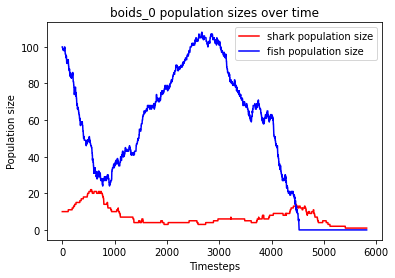

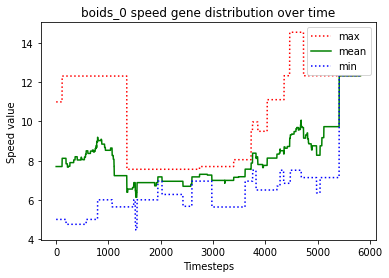

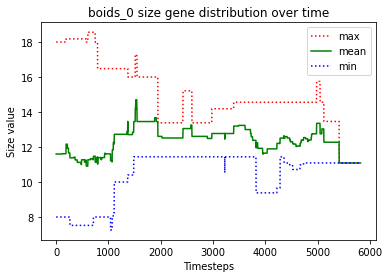

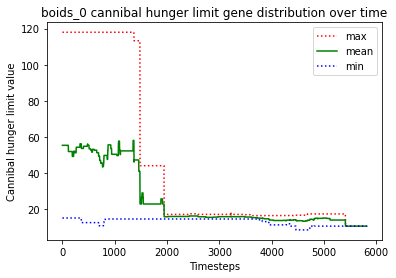

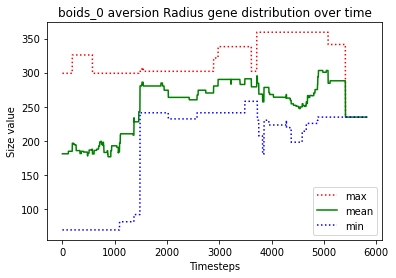

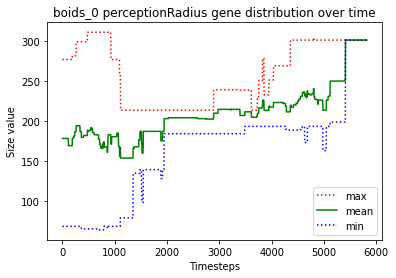

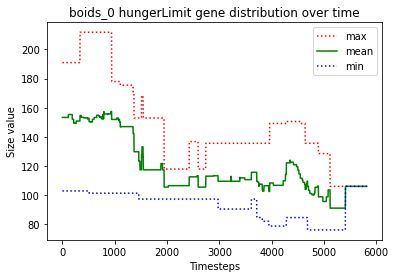





						BOIDS_1

predator_4 just gave birth to predator_10
predator_1 just gave birth to predator_11
predator_11 just gave birth to predator_12
predator_6 just gave birth to predator_13
predator_12 starved to death
predator_13 just gave birth to predator_14
predator_11 ate the carcass of predator_12_carcass
predator_7 just gave birth to predator_15
predator_11 starved to death
predator_13 ate the carcass of predator_11_carcass
predator_5 just gave birth to predator_16
predator_8 just gave birth to predator_17
predator_16 just gave birth to predator_18
predator_10 starved to death
predator_4 ate the carcass of predator_10_carcass
predator_0 just gave birth to predator_19
predator_16 starved to death
predator_18 starved to death
predator_1 ate the carcass of predator_18_carcass
predator_9 ate the carcass of predator_16_carcass
predator_13 just gave birth to predator_20
predator_0 starved to death
predator_4 ate the carcass of predator_0_carcass
predator_19 starved to death
predator_13 

predator_37 just gave birth to predator_65
predator_45 starved to death
predator_64 starved to death
predator_63 starved to death
predator_37 ate the carcass of predator_64_carcass
predator_65 starved to death
predator_37 ate the carcass of predator_65_carcass
predator_37 ate the carcass of predator_63_carcass
predator_37 ate the carcass of predator_45_carcass
predator_37 starved to death


finished this run because predators went extinct
Fish left: 0
Sharks left: 0
Dead sharks: 66
Timesteps passed: 9732
Fish went extinct at timestep 6685
Sharks went extinct at timestep 9732


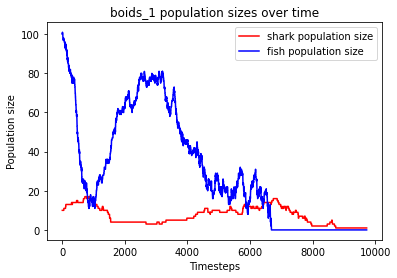

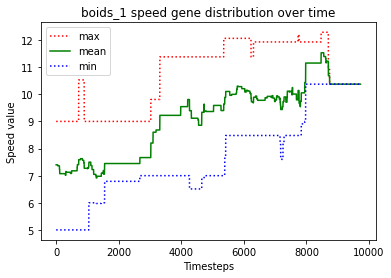

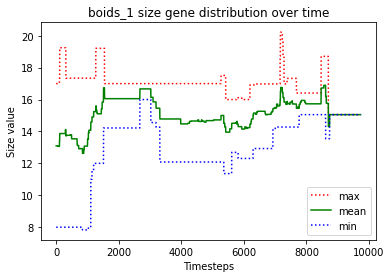

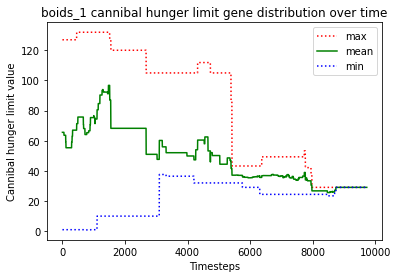

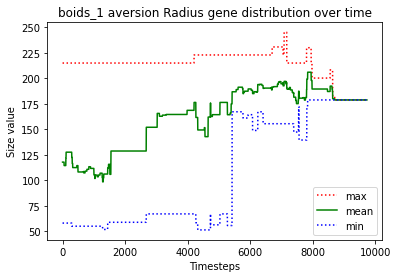

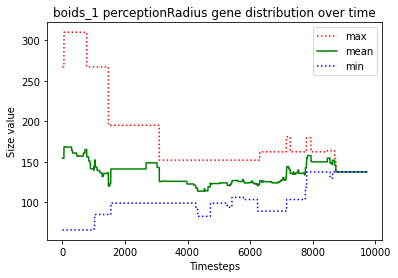

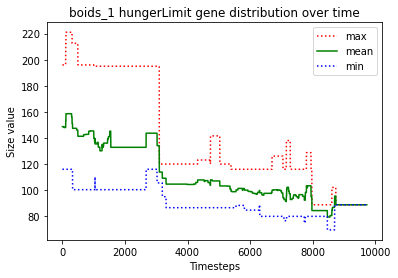





						BOIDS_2

predator_8 just gave birth to predator_10
predator_1 just gave birth to predator_11
predator_7 just gave birth to predator_12
predator_1 killed predator_6
predator_11 just gave birth to predator_13
predator_1 killed predator_9
predator_10 just gave birth to predator_14
predator_11 starved to death
predator_14 ate the carcass of predator_11_carcass
predator_0 just gave birth to predator_15
predator_12 just gave birth to predator_16
predator_12 starved to death
predator_16 ate the carcass of predator_12_carcass
predator_13 starved to death
predator_8 starved to death
predator_10 just gave birth to predator_17
predator_2 ate the carcass of predator_13_carcass
predator_7 starved to death
predator_0 ate the carcass of predator_8_carcass
predator_17 ate the carcass of predator_7_carcass
predator_10 starved to death
predator_16 starved to death
predator_1 ate the carcass of predator_16_carcass
predator_17 ate the carcass of predator_10_carcass
predator_15 killed predator_5


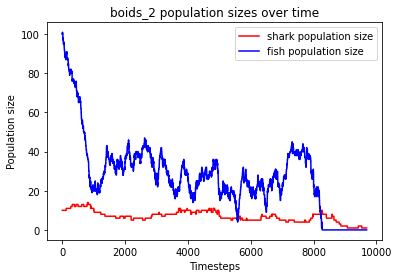

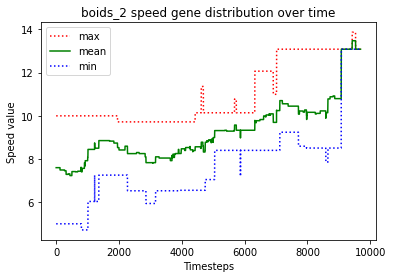

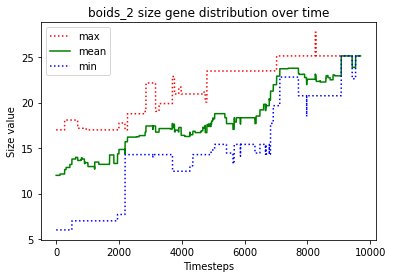

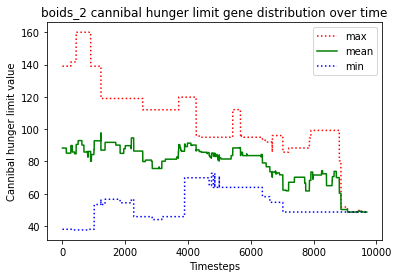

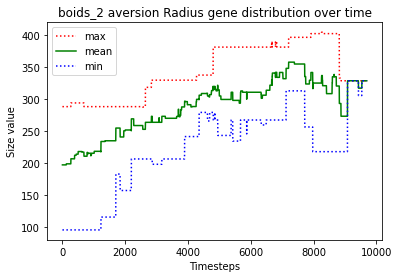

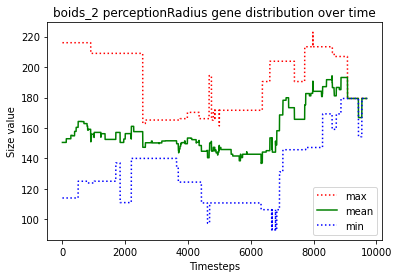

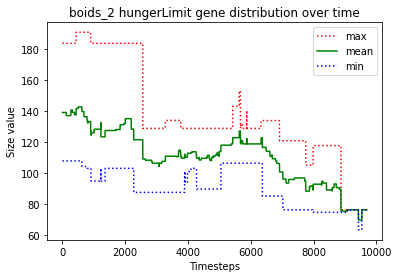





						BOIDS_3

predator_9 just gave birth to predator_10
predator_7 just gave birth to predator_11
predator_7 just gave birth to predator_12
predator_10 just gave birth to predator_13
predator_13 just gave birth to predator_14
predator_14 killed predator_0
predator_10 starved to death
predator_1 ate the carcass of predator_10_carcass
predator_12 starved to death
predator_13 starved to death
predator_2 ate the carcass of predator_12_carcass
predator_4 just gave birth to predator_15
predator_2 ate the carcass of predator_13_carcass
predator_8 just gave birth to predator_16
predator_7 starved to death
predator_14 starved to death
predator_15 ate the carcass of predator_7_carcass
predator_8 ate the carcass of predator_14_carcass
predator_9 starved to death
predator_4 ate the carcass of predator_9_carcass
predator_2 just gave birth to predator_17
predator_11 starved to death
predator_8 killed predator_3
predator_15 ate the carcass of predator_11_carcass
predator_8 just gave birth to pre

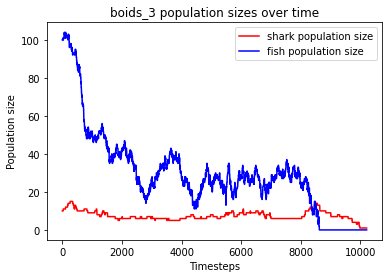

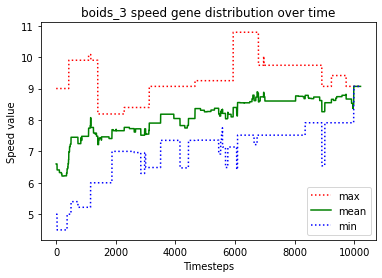

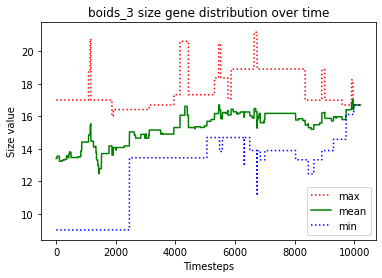

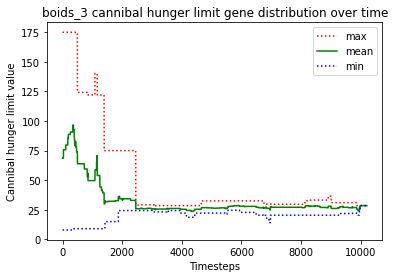

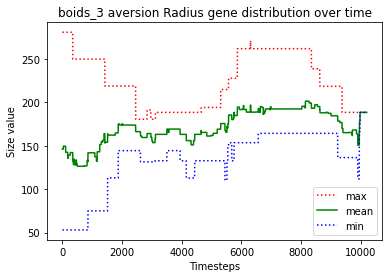

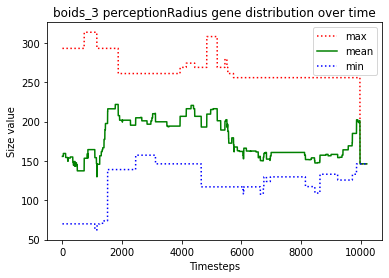

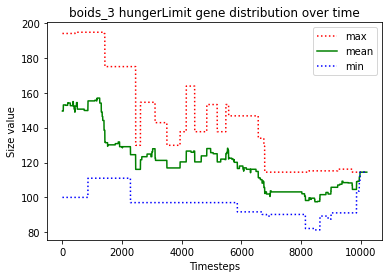





						BOIDS_4

predator_9 just gave birth to predator_10
predator_5 just gave birth to predator_11
predator_11 just gave birth to predator_12
predator_12 killed predator_3
predator_7 just gave birth to predator_13
predator_6 just gave birth to predator_14
predator_11 starved to death
predator_10 starved to death
predator_9 ate the carcass of predator_10_carcass
predator_7 ate the carcass of predator_11_carcass
predator_12 starved to death
predator_8 ate the carcass of predator_12_carcass
predator_6 just gave birth to predator_15
predator_5 starved to death
predator_13 just gave birth to predator_16
predator_8 ate the carcass of predator_5_carcass
predator_6 just gave birth to predator_17
predator_6 killed predator_16
predator_9 starved to death
predator_0 just gave birth to predator_18
predator_15 ate the carcass of predator_9_carcass
predator_13 starved to death
predator_17 killed predator_7
predator_6 ate the carcass of predator_13_carcass
predator_18 starved to death
predator_15

predator_8 just gave birth to predator_69
predator_68 ate the carcass of predator_54_carcass
predator_65 starved to death
predator_69 starved to death
predator_8 starved to death
predator_55 ate the carcass of predator_69_carcass
predator_50 ate the carcass of predator_8_carcass
predator_55 ate the carcass of predator_65_carcass
predator_64 starved to death
predator_55 ate the carcass of predator_64_carcass
predator_68 starved to death
predator_55 ate the carcass of predator_68_carcass
predator_55 ate the carcass of predator_66_carcass
predator_50 starved to death
predator_55 just gave birth to predator_70
predator_70 ate the carcass of predator_50_carcass
predator_55 starved to death
predator_70 starved to death


finished this run because predators went extinct
Fish left: 0
Sharks left: 0
Dead sharks: 71
Timesteps passed: 11792
Fish went extinct at timestep 9692
Sharks went extinct at timestep 11792


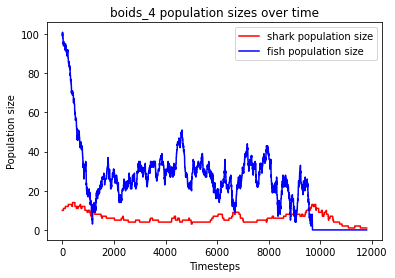

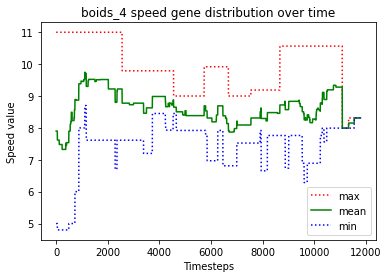

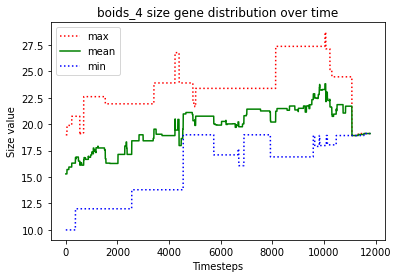

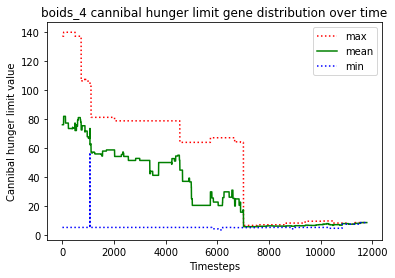

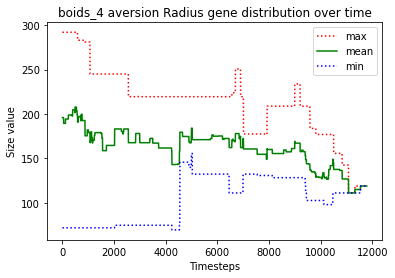

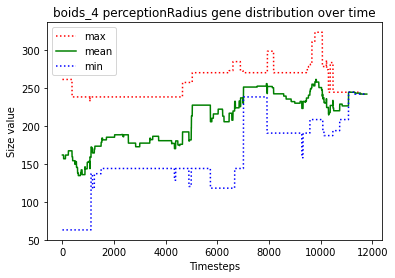

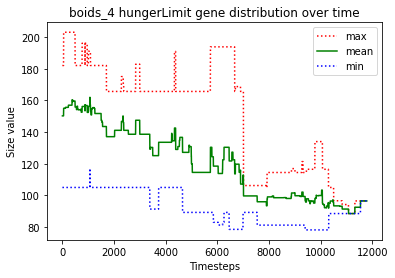





						BOIDS_5

predator_1 just gave birth to predator_10
predator_8 just gave birth to predator_11
predator_11 just gave birth to predator_12
predator_8 killed predator_10
predator_12 killed predator_4
predator_8 killed predator_5
predator_12 starved to death
predator_3 ate the carcass of predator_12_carcass
predator_8 just gave birth to predator_13
predator_2 just gave birth to predator_14
predator_14 just gave birth to predator_15
predator_11 starved to death
predator_8 ate the carcass of predator_11_carcass
predator_15 just gave birth to predator_16
predator_13 just gave birth to predator_17
predator_13 killed predator_7
predator_16 starved to death
predator_15 starved to death
predator_13 starved to death
predator_8 ate the carcass of predator_15_carcass
predator_0 ate the carcass of predator_13_carcass
predator_14 starved to death
predator_1 just gave birth to predator_18
predator_6 ate the carcass of predator_14_carcass
predator_1 starved to death
predator_18 starved to death

predator_67 starved to death
predator_69 ate the carcass of predator_57_carcass
predator_65 ate the carcass of predator_67_carcass
predator_50 starved to death
predator_48 ate the carcass of predator_50_carcass
predator_66 just gave birth to predator_70
predator_66 just gave birth to predator_71
predator_65 killed predator_71
predator_70 just gave birth to predator_72
predator_61 starved to death
predator_69 just gave birth to predator_73
predator_70 just gave birth to predator_74
predator_74 starved to death
predator_70 starved to death
predator_66 ate the carcass of predator_70_carcass
predator_72 ate the carcass of predator_74_carcass
predator_65 ate the carcass of predator_61_carcass
predator_69 starved to death
predator_72 ate the carcass of predator_69_carcass
predator_48 just gave birth to predator_75
predator_75 starved to death
predator_73 ate the carcass of predator_75_carcass
predator_48 starved to death
predator_65 ate the carcass of predator_48_carcass
predator_65 just gav

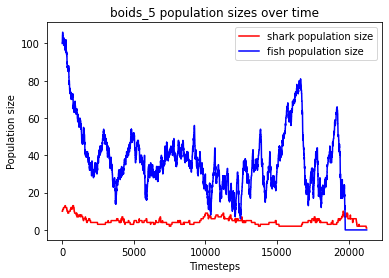

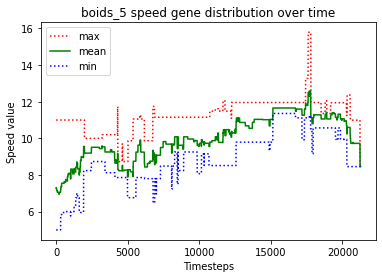

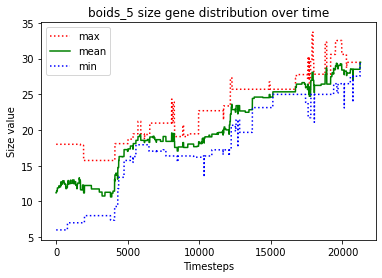

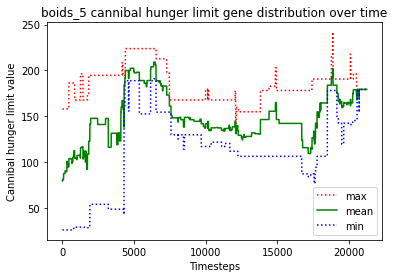

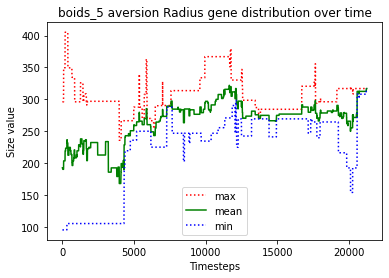

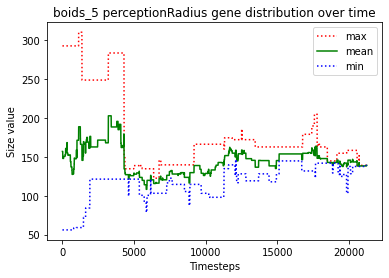

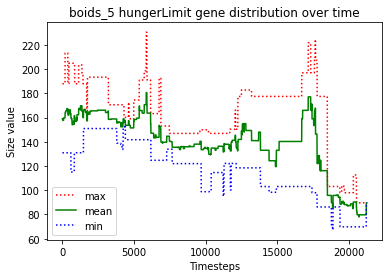





						BOIDS_6

predator_1 just gave birth to predator_10
predator_3 just gave birth to predator_11
predator_11 just gave birth to predator_12
predator_2 just gave birth to predator_13
predator_8 just gave birth to predator_14
predator_12 killed predator_8
predator_3 killed predator_4
predator_3 just gave birth to predator_15
predator_12 killed predator_14
predator_12 killed predator_7
predator_12 killed predator_0
predator_15 starved to death
predator_3 ate the carcass of predator_15_carcass
predator_1 just gave birth to predator_16
predator_13 starved to death
predator_16 ate the carcass of predator_13_carcass
predator_11 starved to death
predator_10 ate the carcass of predator_11_carcass
predator_2 starved to death
predator_3 starved to death
predator_16 just gave birth to predator_17
predator_5 ate the carcass of predator_3_carcass
predator_9 just gave birth to predator_18
predator_6 just gave birth to predator_19
predator_6 just gave birth to predator_20
predator_17 ate the car

predator_47 starved to death
predator_66 ate the carcass of predator_47_carcass
predator_66 starved to death


finished this run because predators went extinct
Fish left: 0
Sharks left: 0
Dead sharks: 67
Timesteps passed: 7205
Fish went extinct at timestep 6001
Sharks went extinct at timestep 7205


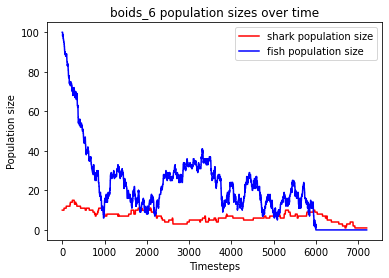

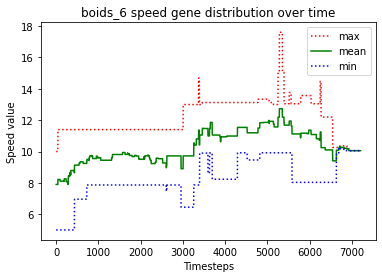

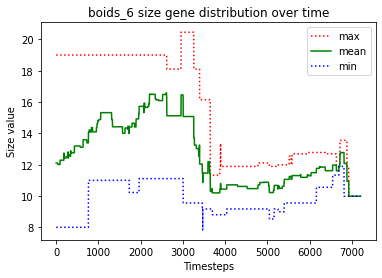

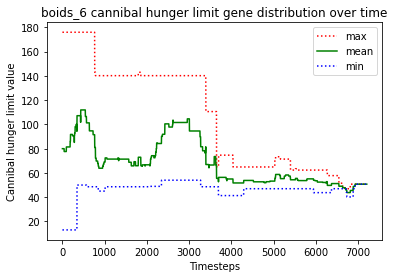

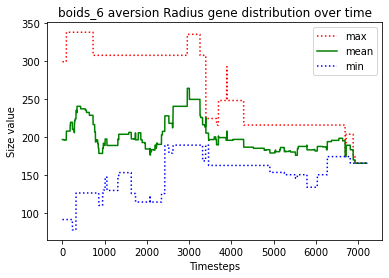

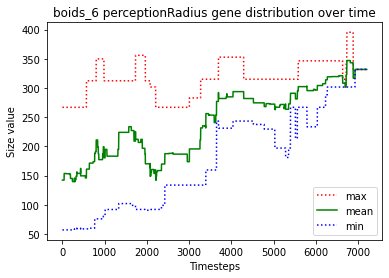

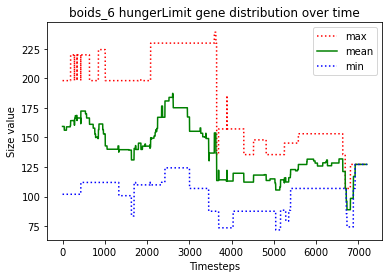





						BOIDS_7

predator_1 just gave birth to predator_10
predator_3 just gave birth to predator_11
predator_10 just gave birth to predator_12
predator_11 just gave birth to predator_13
predator_10 just gave birth to predator_14
predator_10 killed predator_9
predator_0 just gave birth to predator_15
predator_8 just gave birth to predator_16
predator_15 killed predator_2
predator_15 just gave birth to predator_17
predator_11 starved to death
predator_10 starved to death
predator_6 ate the carcass of predator_10_carcass
predator_12 starved to death
predator_17 killed predator_16
predator_0 ate the carcass of predator_12_carcass
predator_15 just gave birth to predator_18
predator_17 just gave birth to predator_19
predator_13 starved to death
predator_15 ate the carcass of predator_13_carcass
predator_0 killed predator_7
predator_14 ate the carcass of predator_11_carcass
predator_17 starved to death
predator_18 starved to death
predator_15 just gave birth to predator_20
predator_14 just

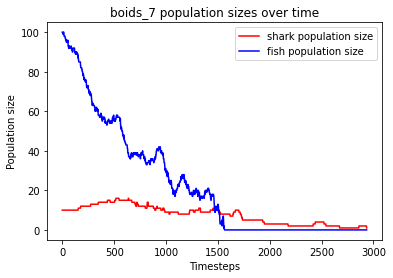

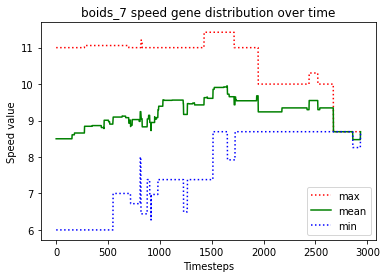

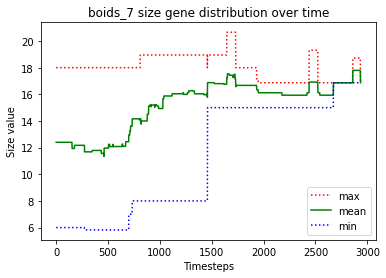

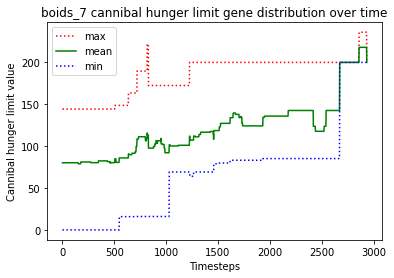

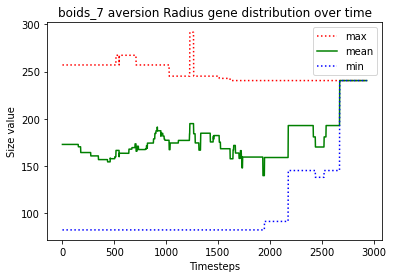

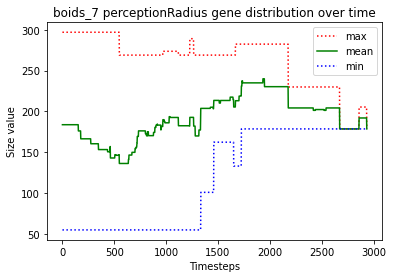

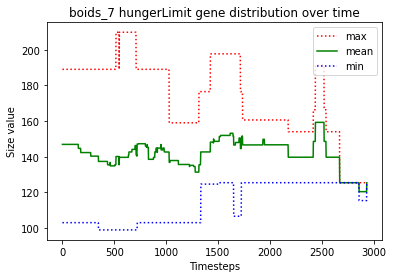





						BOIDS_8

predator_5 just gave birth to predator_10
predator_6 just gave birth to predator_11
predator_5 killed predator_8
predator_5 killed predator_2
predator_5 killed predator_7
predator_11 just gave birth to predator_12
predator_4 just gave birth to predator_13
predator_10 killed predator_13
predator_9 just gave birth to predator_14
predator_14 killed predator_3
predator_9 killed predator_0
predator_6 starved to death
predator_11 starved to death
predator_12 ate the carcass of predator_11_carcass
predator_4 ate the carcass of predator_6_carcass
predator_9 just gave birth to predator_15
predator_1 just gave birth to predator_16
predator_4 just gave birth to predator_17
predator_15 starved to death
predator_4 just gave birth to predator_18
predator_18 just gave birth to predator_19
predator_10 ate the carcass of predator_15_carcass
predator_10 just gave birth to predator_20
predator_19 starved to death
predator_14 ate the carcass of predator_19_carcass
predator_18 starved to

predator_63 ate the carcass of predator_58_carcass
predator_71 just gave birth to predator_72
predator_69 ate the carcass of predator_46_carcass
predator_71 starved to death
predator_72 starved to death
predator_70 ate the carcass of predator_72_carcass
predator_70 ate the carcass of predator_71_carcass
predator_67 just gave birth to predator_73
predator_67 starved to death
predator_73 starved to death
predator_63 ate the carcass of predator_67_carcass
predator_69 just gave birth to predator_74
predator_63 just gave birth to predator_75
predator_37 ate the carcass of predator_73_carcass
predator_69 just gave birth to predator_76
predator_74 starved to death
predator_75 ate the carcass of predator_74_carcass
predator_76 starved to death
predator_37 ate the carcass of predator_76_carcass
predator_69 starved to death
predator_75 ate the carcass of predator_69_carcass
predator_70 killed predator_37
predator_70 killed predator_63
predator_70 just gave birth to predator_77
predator_70 killed

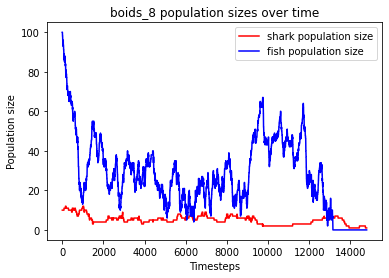

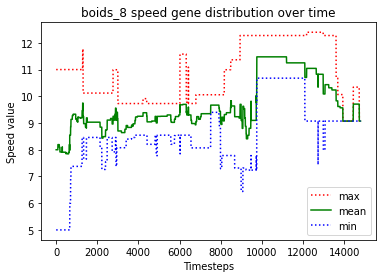

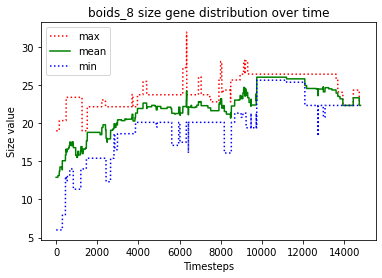

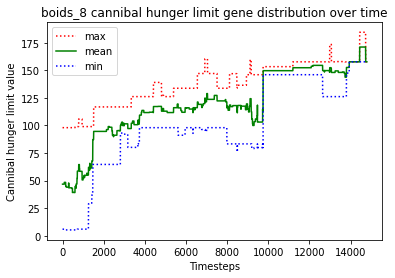

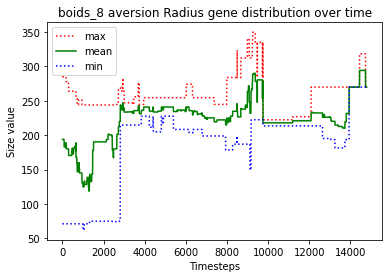

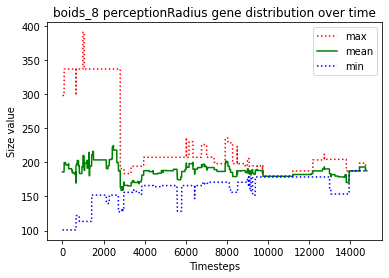

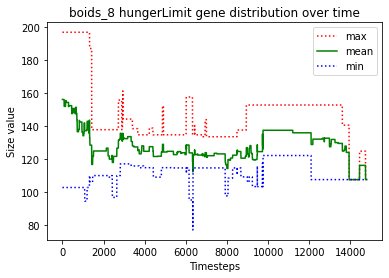





						BOIDS_9

predator_5 just gave birth to predator_10
predator_0 just gave birth to predator_11
predator_2 just gave birth to predator_12
predator_7 just gave birth to predator_13
predator_0 just gave birth to predator_14
predator_0 just gave birth to predator_15
predator_0 starved to death
predator_15 starved to death
predator_14 starved to death
predator_2 ate the carcass of predator_0_carcass
predator_12 ate the carcass of predator_14_carcass
predator_9 ate the carcass of predator_15_carcass
predator_11 starved to death
predator_13 ate the carcass of predator_11_carcass
predator_10 just gave birth to predator_16
predator_1 just gave birth to predator_17
predator_1 starved to death
predator_17 starved to death
predator_8 just gave birth to predator_18
predator_8 killed predator_18
predator_7 starved to death
predator_5 ate the carcass of predator_7_carcass
predator_5 ate the carcass of predator_17_carcass
predator_4 ate the carcass of predator_1_carcass
predator_4 just gave bi

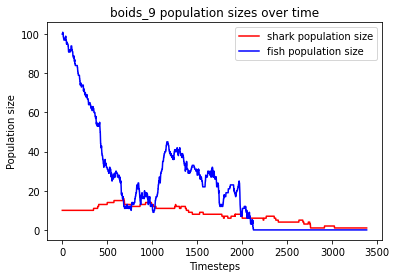

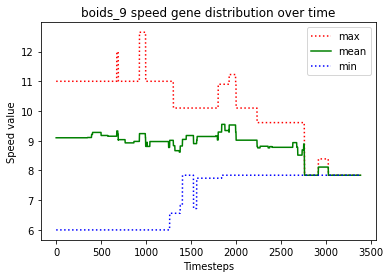

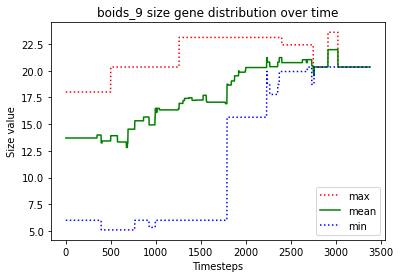

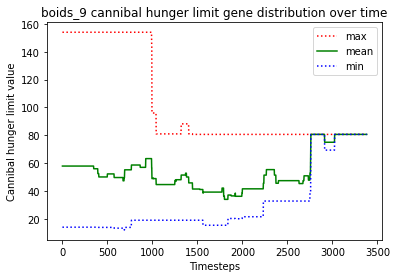

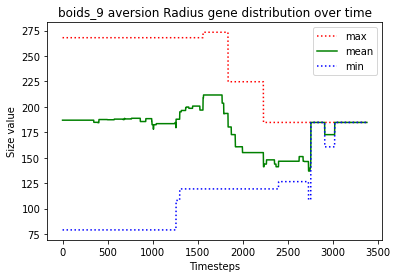

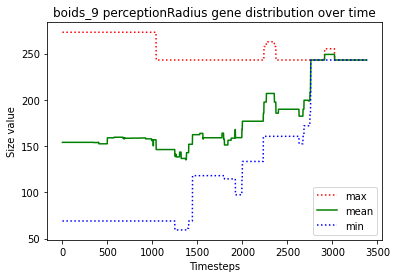

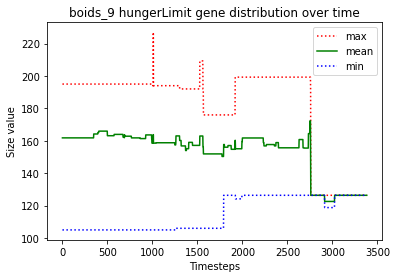





						BOIDS_10

predator_7 just gave birth to predator_10
predator_10 just gave birth to predator_11
predator_11 starved to death
predator_2 ate the carcass of predator_11_carcass
predator_3 just gave birth to predator_12
predator_10 starved to death
predator_0 just gave birth to predator_13
predator_3 ate the carcass of predator_10_carcass
predator_12 just gave birth to predator_14
predator_12 starved to death
predator_14 starved to death
predator_1 ate the carcass of predator_12_carcass
predator_3 ate the carcass of predator_14_carcass
predator_13 starved to death
predator_3 ate the carcass of predator_13_carcass
predator_3 just gave birth to predator_15
predator_0 starved to death
predator_9 ate the carcass of predator_0_carcass
predator_2 killed predator_4
predator_7 starved to death
predator_6 just gave birth to predator_16
predator_8 ate the carcass of predator_7_carcass
predator_15 starved to death
predator_16 ate the carcass of predator_15_carcass
predator_3 starved to deat

predator_65 just gave birth to predator_69
predator_67 just gave birth to predator_70
predator_67 just gave birth to predator_71
predator_68 starved to death
predator_66 ate the carcass of predator_68_carcass
predator_71 killed predator_69
predator_67 starved to death
predator_65 ate the carcass of predator_67_carcass
predator_65 starved to death
predator_52 just gave birth to predator_72
predator_71 just gave birth to predator_73
predator_73 starved to death
predator_71 ate the carcass of predator_73_carcass
predator_70 just gave birth to predator_74
predator_71 ate the carcass of predator_65_carcass
predator_52 just gave birth to predator_75
predator_70 just gave birth to predator_76
predator_70 just gave birth to predator_77
predator_75 starved to death
predator_71 killed predator_77
predator_74 just gave birth to predator_78
predator_66 ate the carcass of predator_75_carcass
predator_74 starved to death
predator_71 ate the carcass of predator_74_carcass
predator_76 just gave birth 

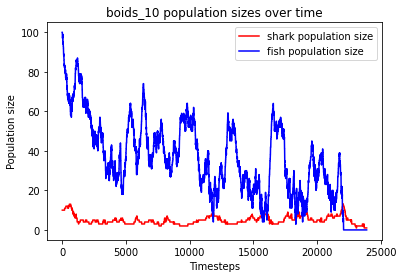

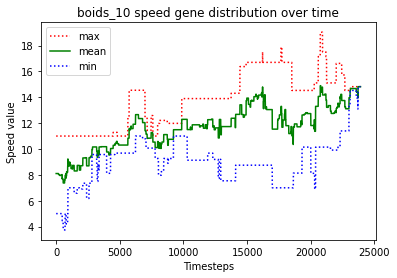

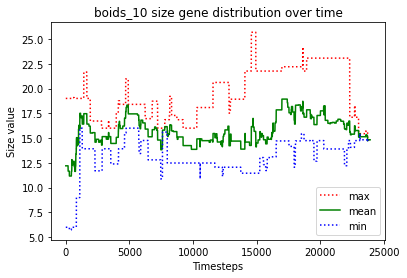

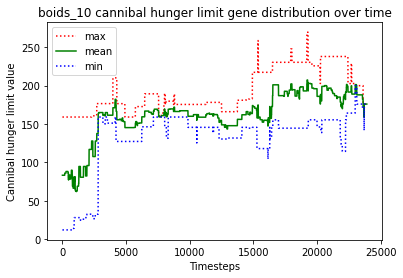

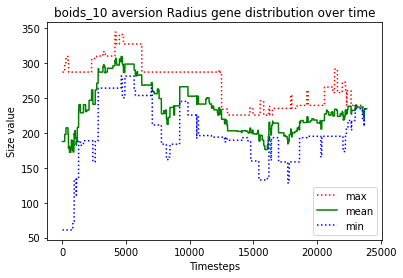

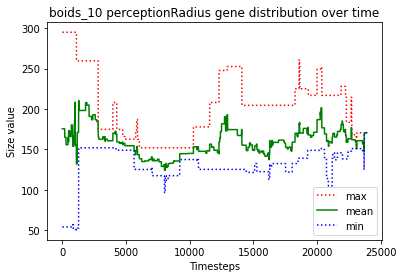

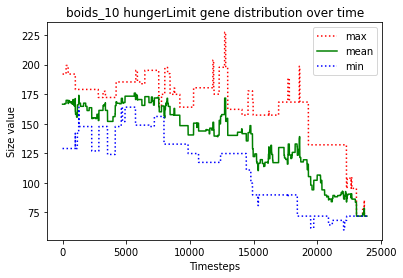





						BOIDS_11

predator_8 just gave birth to predator_10
predator_8 killed predator_5
predator_10 just gave birth to predator_11
predator_0 just gave birth to predator_12
predator_10 killed predator_9
predator_3 just gave birth to predator_13
predator_4 just gave birth to predator_14
predator_10 killed predator_12
predator_10 killed predator_6
predator_0 just gave birth to predator_15
predator_8 just gave birth to predator_16
predator_10 killed predator_4
predator_0 just gave birth to predator_17
predator_7 just gave birth to predator_18
predator_16 just gave birth to predator_19
predator_14 just gave birth to predator_20
no fish to move
predator_0 starved to death
predator_7 ate the carcass of predator_0_carcass
predator_2 starved to death
predator_18 ate the carcass of predator_2_carcass
predator_15 starved to death
predator_16 ate the carcass of predator_15_carcass
predator_17 starved to death
predator_7 ate the carcass of predator_17_carcass
predator_8 killed predator_14
preda

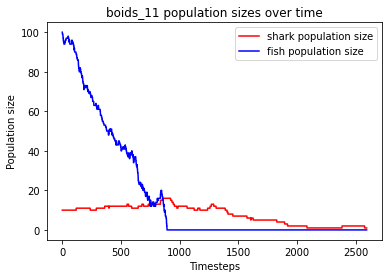

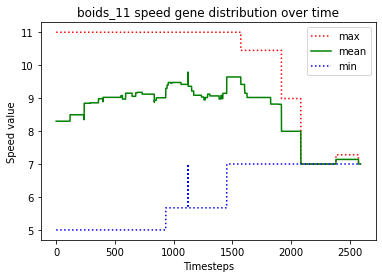

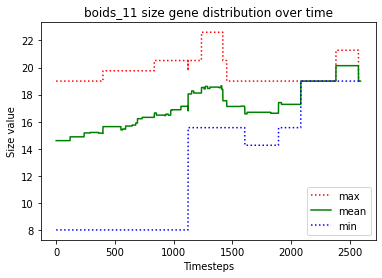

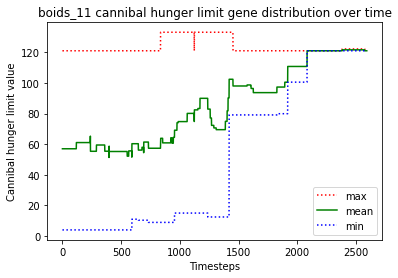

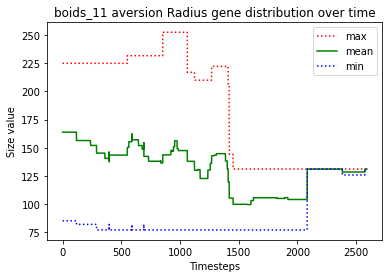

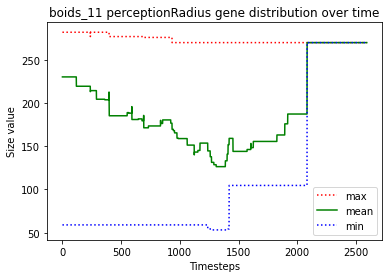

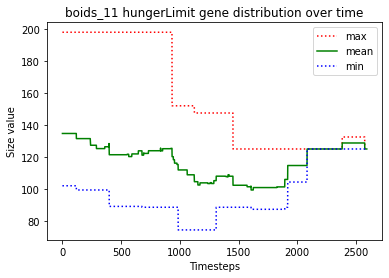





						BOIDS_12

predator_1 just gave birth to predator_10
predator_1 just gave birth to predator_11
predator_6 just gave birth to predator_12
predator_12 killed predator_10
predator_12 killed predator_0
predator_7 just gave birth to predator_13
predator_8 just gave birth to predator_14
predator_13 just gave birth to predator_15
predator_6 killed predator_3
predator_4 just gave birth to predator_16
predator_16 just gave birth to predator_17
predator_1 just gave birth to predator_18
predator_15 starved to death
predator_14 just gave birth to predator_19
predator_12 ate the carcass of predator_15_carcass
predator_14 starved to death
predator_19 starved to death
predator_17 starved to death
predator_13 starved to death
predator_9 ate the carcass of predator_14_carcass
predator_9 ate the carcass of predator_17_carcass
predator_9 ate the carcass of predator_19_carcass
predator_6 ate the carcass of predator_13_carcass
predator_8 starved to death
predator_12 ate the carcass of predator_8_c

predator_65 just gave birth to predator_73
predator_62 starved to death
predator_65 starved to death
predator_59 ate the carcass of predator_65_carcass
predator_31 just gave birth to predator_74
predator_73 ate the carcass of predator_62_carcass
predator_40 starved to death
predator_72 just gave birth to predator_75
predator_72 starved to death
predator_75 starved to death
predator_63 starved to death
predator_66 ate the carcass of predator_40_carcass
predator_73 ate the carcass of predator_63_carcass
predator_70 ate the carcass of predator_72_carcass
predator_73 ate the carcass of predator_75_carcass
predator_66 just gave birth to predator_76
predator_73 just gave birth to predator_77
predator_66 just gave birth to predator_78
predator_74 just gave birth to predator_79
predator_74 starved to death
predator_79 starved to death
predator_77 ate the carcass of predator_79_carcass
predator_77 ate the carcass of predator_74_carcass
predator_70 starved to death
predator_31 ate the carcass of

predator_132 just gave birth to predator_137
predator_120 just gave birth to predator_138
predator_133 starved to death
predator_117 starved to death
predator_136 ate the carcass of predator_117_carcass
predator_120 ate the carcass of predator_133_carcass
predator_116 starved to death
predator_136 ate the carcass of predator_116_carcass
predator_137 just gave birth to predator_139
predator_121 just gave birth to predator_140
predator_130 just gave birth to predator_141
predator_137 just gave birth to predator_142
predator_136 just gave birth to predator_143
predator_143 just gave birth to predator_144
predator_139 just gave birth to predator_145
no fish to move
predator_132 just gave birth to predator_146
predator_143 starved to death
predator_132 ate the carcass of predator_143_carcass
predator_140 just gave birth to predator_147
predator_111 just gave birth to predator_148
predator_144 starved to death
predator_141 ate the carcass of predator_144_carcass
predator_131 just gave birth 

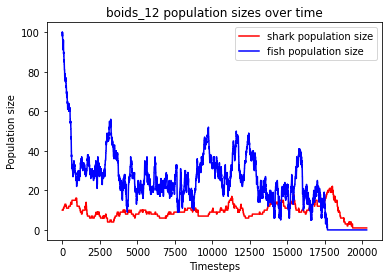

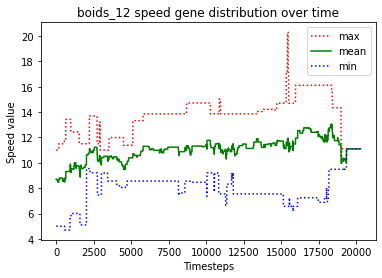

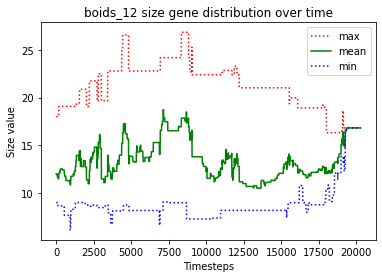

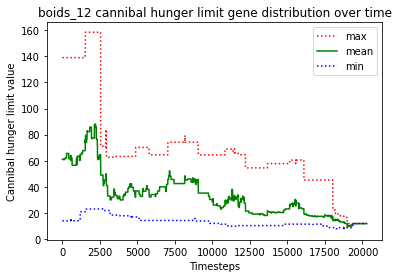

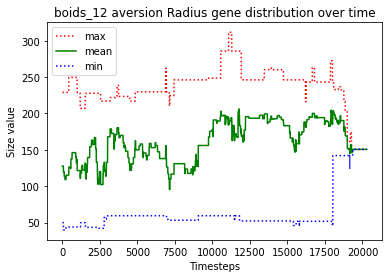

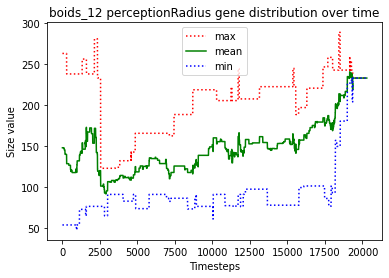

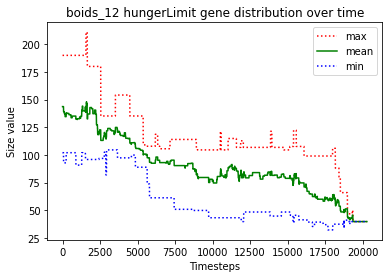





						BOIDS_13

predator_2 just gave birth to predator_10
predator_4 just gave birth to predator_11
predator_1 just gave birth to predator_12
predator_4 killed predator_12
predator_2 starved to death
predator_10 starved to death
predator_4 starved to death
predator_7 ate the carcass of predator_4_carcass
predator_8 just gave birth to predator_13
predator_5 ate the carcass of predator_2_carcass
predator_8 killed predator_6
predator_1 just gave birth to predator_14
predator_1 ate the carcass of predator_10_carcass
predator_5 just gave birth to predator_15
predator_14 starved to death
predator_1 ate the carcass of predator_14_carcass
predator_8 killed predator_1
predator_11 starved to death
predator_13 ate the carcass of predator_11_carcass
predator_3 starved to death
predator_13 ate the carcass of predator_3_carcass
predator_5 just gave birth to predator_16
predator_5 starved to death
predator_16 ate the carcass of predator_5_carcass
predator_9 just gave birth to predator_17
predator

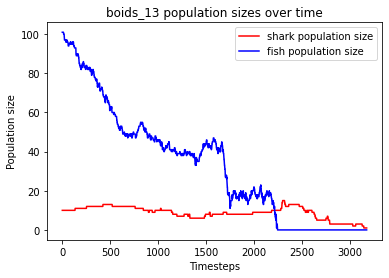

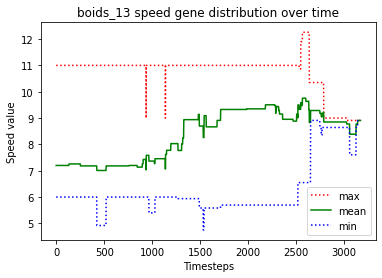

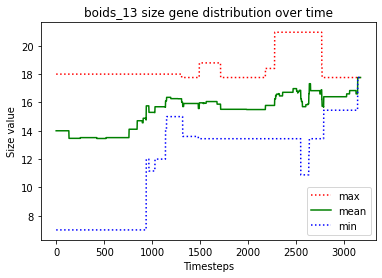

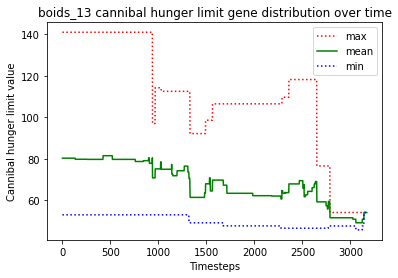

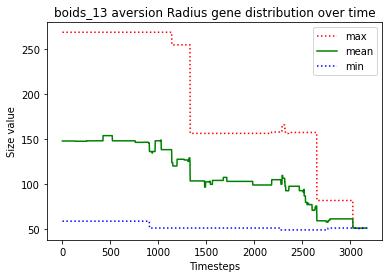

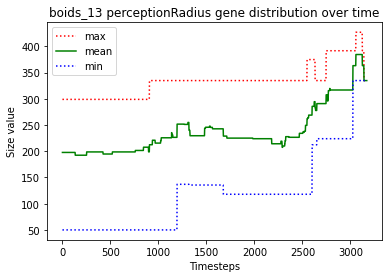

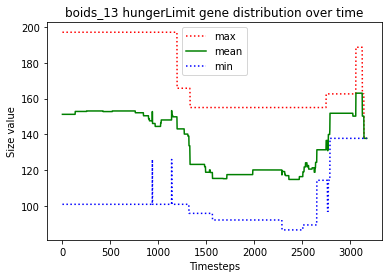





						BOIDS_14

predator_0 just gave birth to predator_10
predator_5 just gave birth to predator_11
predator_11 killed predator_7
predator_8 just gave birth to predator_12
predator_11 killed predator_10
predator_11 killed predator_2
predator_11 killed predator_0
predator_8 just gave birth to predator_13
predator_12 starved to death
predator_11 ate the carcass of predator_12_carcass
predator_8 starved to death
predator_13 starved to death
predator_9 ate the carcass of predator_8_carcass
predator_3 ate the carcass of predator_13_carcass
predator_4 just gave birth to predator_14
predator_9 just gave birth to predator_15
predator_14 just gave birth to predator_16
predator_3 just gave birth to predator_17
predator_14 starved to death
predator_16 starved to death
predator_5 ate the carcass of predator_14_carcass
predator_9 killed predator_1
predator_9 ate the carcass of predator_16_carcass
predator_4 starved to death
predator_3 ate the carcass of predator_4_carcass
predator_15 just gave 

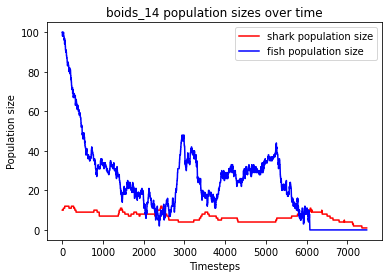

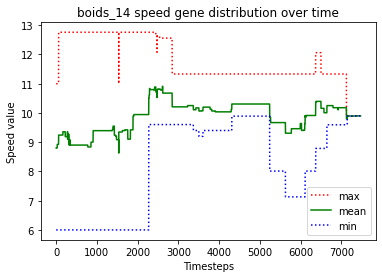

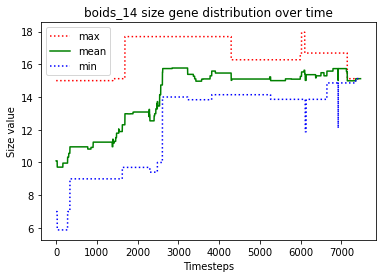

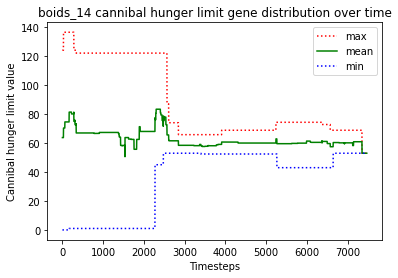

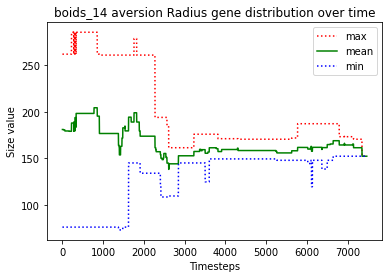

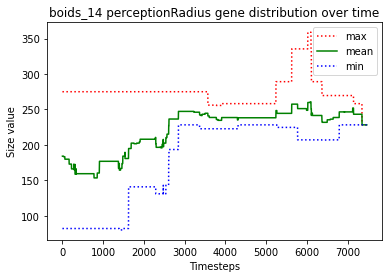

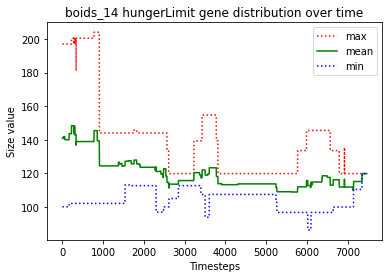





						BOIDS_15

predator_9 just gave birth to predator_10
predator_7 just gave birth to predator_11
predator_7 killed predator_11
predator_4 just gave birth to predator_12
predator_4 killed predator_12
predator_4 killed predator_8
predator_0 just gave birth to predator_13
predator_2 just gave birth to predator_14
predator_6 just gave birth to predator_15
predator_1 just gave birth to predator_16
predator_3 just gave birth to predator_17
predator_13 killed predator_17
predator_6 just gave birth to predator_18
predator_10 just gave birth to predator_19
predator_5 just gave birth to predator_20
predator_19 just gave birth to predator_21
predator_21 starved to death
predator_19 starved to death
predator_1 ate the carcass of predator_21_carcass
predator_2 just gave birth to predator_22
predator_1 ate the carcass of predator_19_carcass
predator_10 starved to death
predator_0 ate the carcass of predator_10_carcass
predator_6 starved to death
predator_22 ate the carcass of predator_6_carca

predator_56 ate the carcass of predator_68_carcass
predator_62 starved to death
predator_67 ate the carcass of predator_62_carcass
predator_71 just gave birth to predator_72
predator_70 just gave birth to predator_73
predator_56 starved to death
predator_73 ate the carcass of predator_56_carcass
predator_67 just gave birth to predator_74
no fish to move
predator_67 just gave birth to predator_75
predator_75 starved to death
predator_70 ate the carcass of predator_75_carcass
predator_67 starved to death
predator_74 ate the carcass of predator_67_carcass
predator_61 starved to death
predator_43 ate the carcass of predator_61_carcass
predator_74 just gave birth to predator_76
predator_72 just gave birth to predator_77
predator_73 starved to death
predator_70 ate the carcass of predator_73_carcass
predator_77 starved to death
predator_64 just gave birth to predator_78
predator_76 starved to death
predator_70 ate the carcass of predator_77_carcass
predator_72 starved to death
predator_78 at

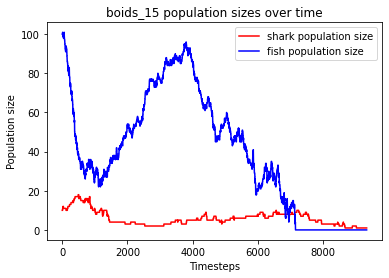

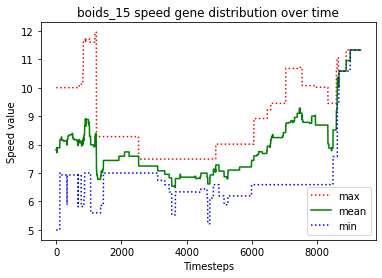

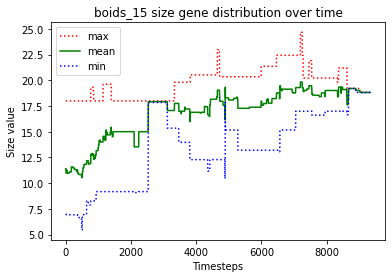

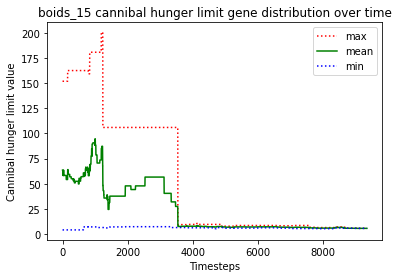

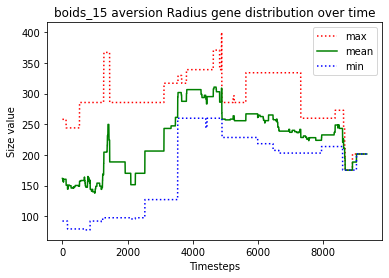

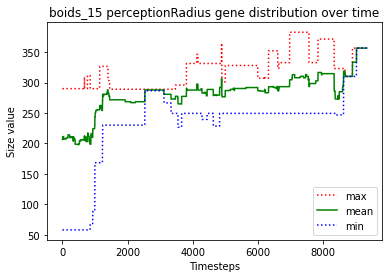

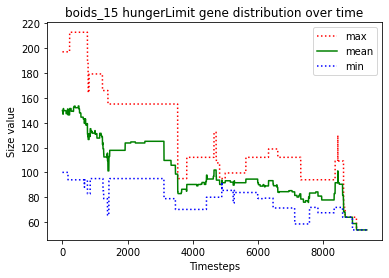





						BOIDS_16

predator_5 just gave birth to predator_10
predator_2 just gave birth to predator_11
predator_8 just gave birth to predator_12
predator_8 killed predator_4
predator_8 just gave birth to predator_13
predator_8 starved to death
predator_0 ate the carcass of predator_8_carcass
predator_7 just gave birth to predator_14
predator_13 killed predator_10
predator_12 starved to death
predator_0 ate the carcass of predator_12_carcass
predator_1 just gave birth to predator_15
predator_11 starved to death
predator_13 ate the carcass of predator_11_carcass
predator_0 just gave birth to predator_16
predator_2 starved to death
predator_6 ate the carcass of predator_2_carcass
predator_5 just gave birth to predator_17
predator_5 killed predator_17
predator_15 killed predator_3
predator_0 just gave birth to predator_18
predator_18 killed predator_16
predator_0 starved to death
predator_18 ate the carcass of predator_0_carcass
predator_1 starved to death
predator_13 starved to death
pre

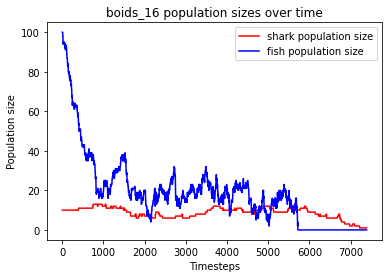

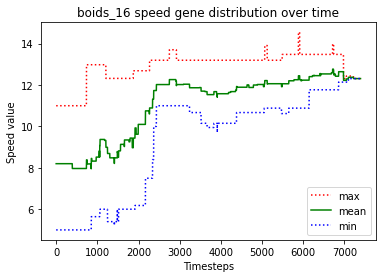

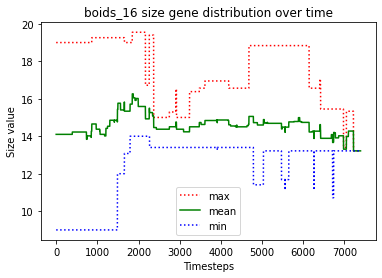

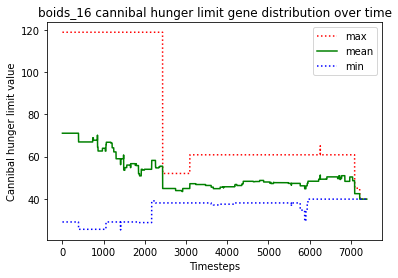

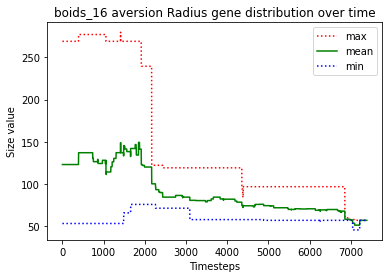

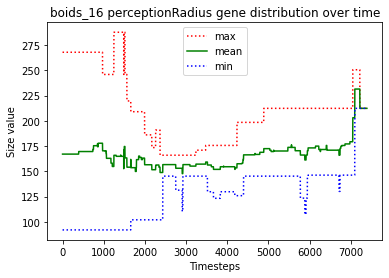

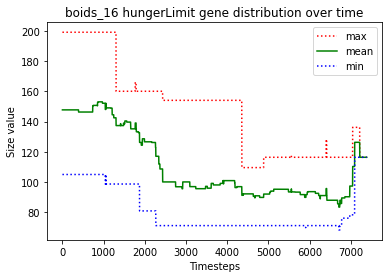





						BOIDS_17

predator_5 just gave birth to predator_10
predator_8 just gave birth to predator_11
predator_0 just gave birth to predator_12
predator_11 just gave birth to predator_13
predator_12 just gave birth to predator_14
predator_12 killed predator_10
predator_8 just gave birth to predator_15
predator_11 starved to death
predator_15 just gave birth to predator_16
predator_5 ate the carcass of predator_11_carcass
predator_7 just gave birth to predator_17
predator_12 starved to death
predator_1 just gave birth to predator_18
predator_14 ate the carcass of predator_12_carcass
predator_15 just gave birth to predator_19
predator_8 just gave birth to predator_20
predator_14 starved to death
predator_0 ate the carcass of predator_14_carcass
predator_19 starved to death
predator_8 ate the carcass of predator_19_carcass
predator_13 starved to death
predator_15 starved to death
predator_20 ate the carcass of predator_15_carcass
predator_5 ate the carcass of predator_13_carcass
predato

predator_44 starved to death
predator_70 just gave birth to predator_73
predator_67 ate the carcass of predator_44_carcass
predator_73 starved to death
predator_72 just gave birth to predator_74
predator_70 starved to death
predator_59 ate the carcass of predator_73_carcass
predator_63 ate the carcass of predator_70_carcass
predator_72 starved to death
predator_74 starved to death
predator_69 just gave birth to predator_75
predator_71 starved to death
predator_75 ate the carcass of predator_71_carcass
predator_59 ate the carcass of predator_74_carcass
predator_59 ate the carcass of predator_72_carcass
predator_67 just gave birth to predator_76
predator_47 just gave birth to predator_77
predator_77 just gave birth to predator_78
predator_40 just gave birth to predator_79
predator_76 just gave birth to predator_80
predator_67 just gave birth to predator_81
predator_47 starved to death
predator_69 ate the carcass of predator_47_carcass
predator_59 starved to death
predator_40 starved to d

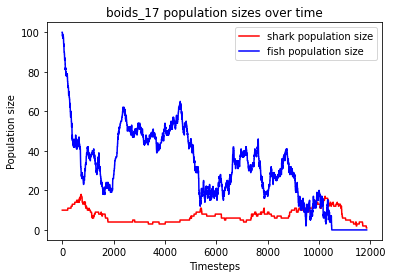

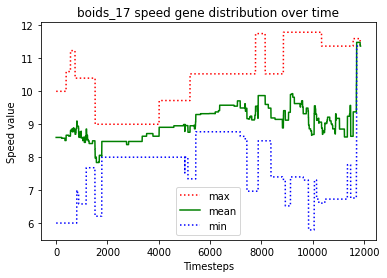

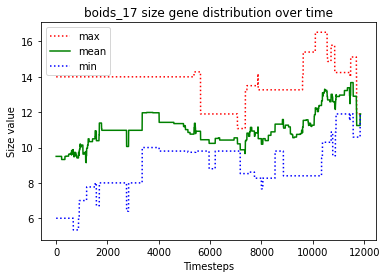

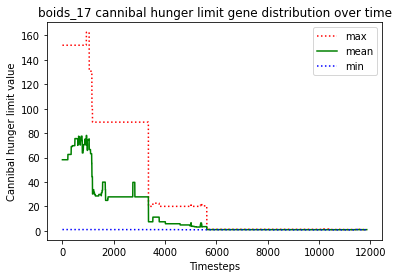

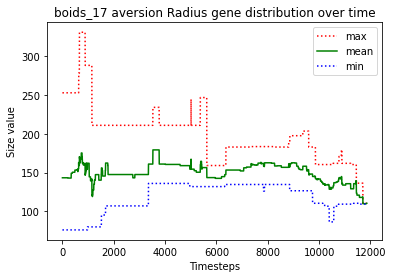

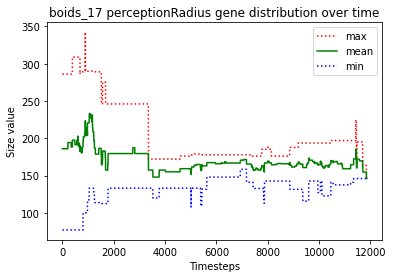

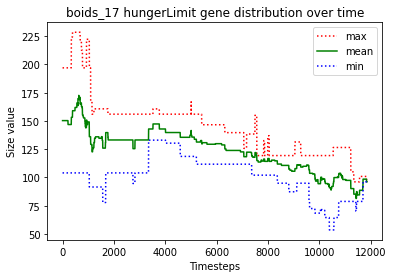





						BOIDS_18

predator_1 just gave birth to predator_10
predator_4 just gave birth to predator_11
predator_11 killed predator_3
predator_0 just gave birth to predator_12
predator_7 just gave birth to predator_13
predator_1 just gave birth to predator_14
predator_4 killed predator_7
predator_14 just gave birth to predator_15
predator_14 starved to death
predator_1 ate the carcass of predator_14_carcass
predator_15 starved to death
predator_10 ate the carcass of predator_15_carcass
predator_12 just gave birth to predator_16
predator_5 just gave birth to predator_17
predator_16 just gave birth to predator_18
predator_2 just gave birth to predator_19
predator_9 just gave birth to predator_20
predator_8 just gave birth to predator_21
predator_9 just gave birth to predator_22
predator_13 starved to death
predator_1 starved to death
predator_9 ate the carcass of predator_1_carcass
predator_4 ate the carcass of predator_13_carcass
predator_0 just gave birth to predator_23
predator_10 sta

predator_16 starved to death
predator_61 ate the carcass of predator_16_carcass
predator_69 just gave birth to predator_70
predator_69 starved to death
predator_70 starved to death
predator_67 starved to death
predator_68 ate the carcass of predator_70_carcass
predator_68 ate the carcass of predator_69_carcass
predator_62 starved to death
predator_60 starved to death
predator_68 ate the carcass of predator_67_carcass
predator_61 just gave birth to predator_71
predator_71 just gave birth to predator_72
predator_68 ate the carcass of predator_62_carcass
predator_61 just gave birth to predator_73
predator_71 ate the carcass of predator_60_carcass
predator_61 just gave birth to predator_74
predator_61 starved to death
predator_74 starved to death
predator_73 ate the carcass of predator_61_carcass
predator_68 ate the carcass of predator_74_carcass
predator_72 just gave birth to predator_75
predator_75 starved to death
predator_68 ate the carcass of predator_75_carcass
predator_73 starved to

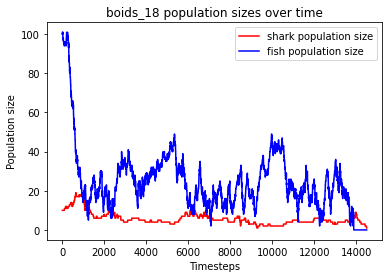

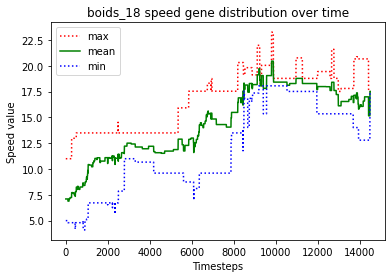

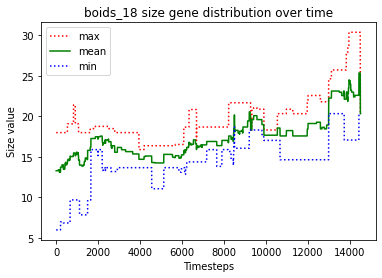

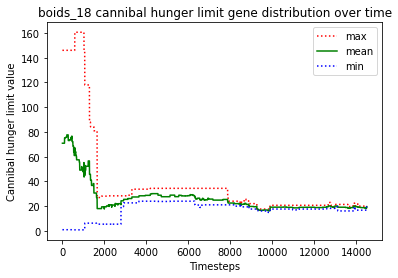

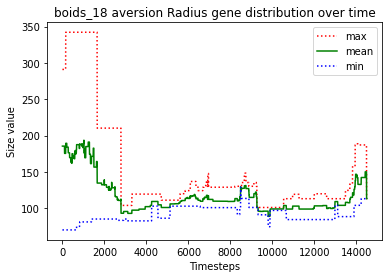

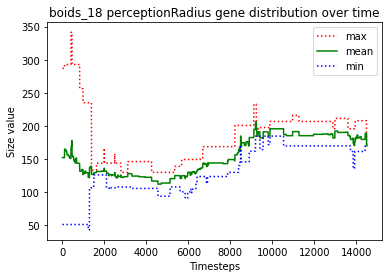

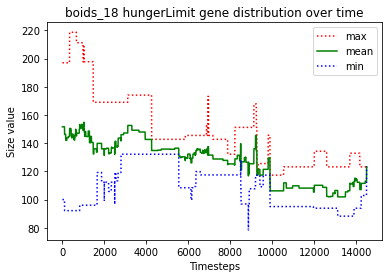





						BOIDS_19

predator_4 just gave birth to predator_10
predator_0 just gave birth to predator_11
predator_6 just gave birth to predator_12
predator_1 just gave birth to predator_13
predator_11 just gave birth to predator_14
predator_1 just gave birth to predator_15
predator_11 just gave birth to predator_16
predator_1 killed predator_4
predator_15 killed predator_16
predator_14 starved to death
predator_5 just gave birth to predator_17
predator_2 just gave birth to predator_18
predator_5 ate the carcass of predator_14_carcass
predator_5 killed predator_3
predator_5 killed predator_10
predator_15 killed predator_9
predator_17 killed predator_6
predator_5 killed predator_7
predator_11 starved to death
predator_1 ate the carcass of predator_11_carcass
predator_17 killed predator_2
predator_0 just gave birth to predator_19
predator_17 killed predator_12
predator_5 killed predator_18
predator_17 killed predator_19
predator_17 killed predator_0
predator_1 just gave birth to predator_2

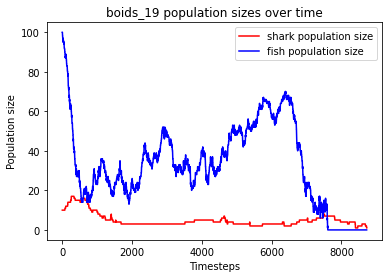

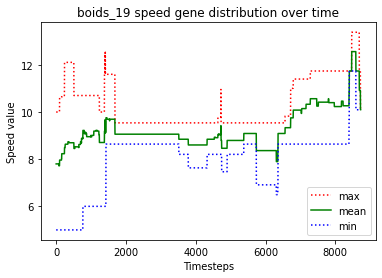

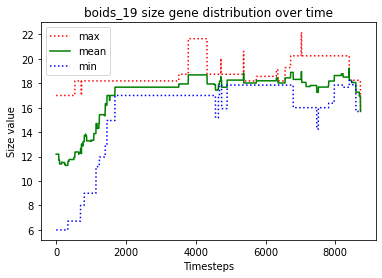

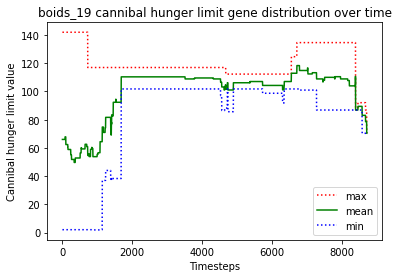

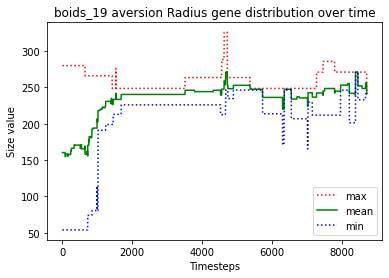

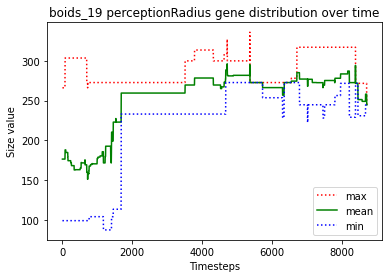

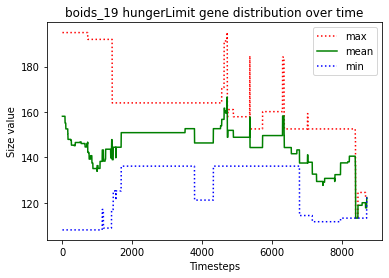





						BOIDS_20

predator_2 just gave birth to predator_10
predator_6 just gave birth to predator_11
predator_10 killed predator_1
predator_2 killed predator_3
predator_6 just gave birth to predator_12
predator_2 killed predator_11
predator_9 just gave birth to predator_13
predator_7 just gave birth to predator_14
predator_0 just gave birth to predator_15
predator_10 just gave birth to predator_16
predator_10 starved to death
predator_16 ate the carcass of predator_10_carcass
predator_6 starved to death
predator_0 ate the carcass of predator_6_carcass
predator_8 just gave birth to predator_17
predator_2 killed predator_12
predator_15 starved to death
predator_16 starved to death
predator_13 ate the carcass of predator_15_carcass
predator_5 ate the carcass of predator_16_carcass
predator_14 starved to death
predator_13 ate the carcass of predator_14_carcass
predator_2 killed predator_9
predator_0 starved to death
predator_8 just gave birth to predator_18
predator_7 starved to death
p

predator_55 just gave birth to predator_73
predator_73 ate the carcass of predator_65_carcass
predator_70 starved to death
predator_73 ate the carcass of predator_70_carcass
predator_48 just gave birth to predator_74
predator_73 just gave birth to predator_75
predator_55 just gave birth to predator_76
predator_75 just gave birth to predator_77
predator_55 just gave birth to predator_78
predator_78 just gave birth to predator_79
predator_78 starved to death
predator_77 starved to death
predator_79 starved to death
predator_55 starved to death
predator_76 starved to death
predator_72 ate the carcass of predator_55_carcass
predator_72 just gave birth to predator_80
predator_27 ate the carcass of predator_76_carcass
predator_73 just gave birth to predator_81
predator_69 ate the carcass of predator_77_carcass
predator_58 ate the carcass of predator_79_carcass
predator_58 ate the carcass of predator_78_carcass
predator_73 just gave birth to predator_82
predator_48 just gave birth to predator

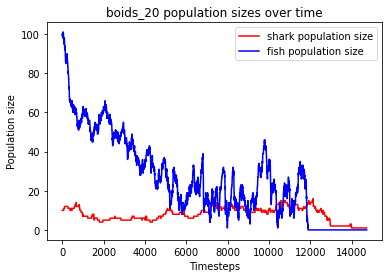

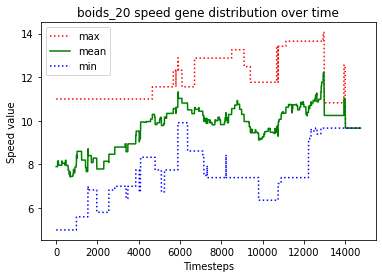

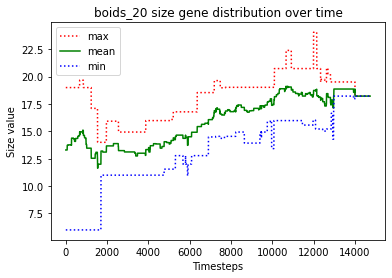

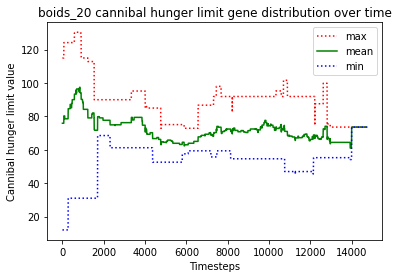

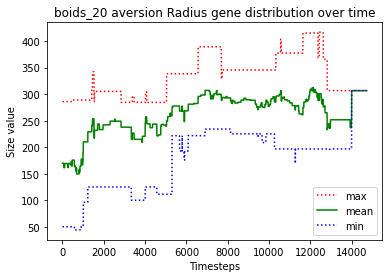

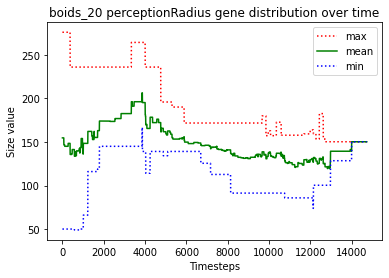

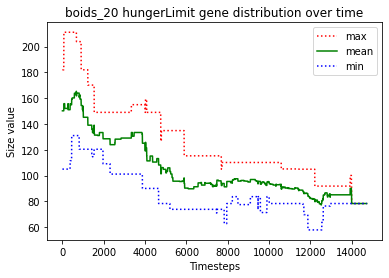





						BOIDS_21

predator_0 killed predator_3
predator_0 killed predator_9
predator_1 just gave birth to predator_10
predator_4 just gave birth to predator_11
predator_4 just gave birth to predator_12
predator_2 just gave birth to predator_13
predator_1 just gave birth to predator_14
predator_0 just gave birth to predator_15
predator_12 starved to death
predator_1 just gave birth to predator_16
predator_8 ate the carcass of predator_12_carcass
predator_16 starved to death
predator_14 starved to death
predator_1 starved to death
predator_0 ate the carcass of predator_16_carcass
predator_2 ate the carcass of predator_1_carcass
predator_15 ate the carcass of predator_14_carcass
predator_13 starved to death
predator_2 ate the carcass of predator_13_carcass
predator_4 starved to death
predator_10 killed predator_5
predator_0 ate the carcass of predator_4_carcass
predator_11 starved to death
predator_15 ate the carcass of predator_11_carcass
predator_15 killed predator_8
predator_15 just 

predator_54 starved to death
predator_66 ate the carcass of predator_54_carcass
predator_66 starved to death


finished this run because predators went extinct
Fish left: 0
Sharks left: 0
Dead sharks: 70
Timesteps passed: 10053
Fish went extinct at timestep 8286
Sharks went extinct at timestep 10053


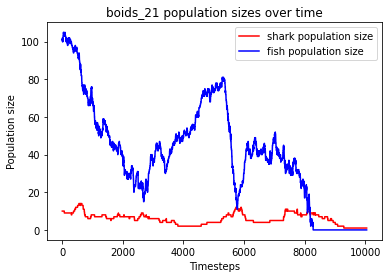

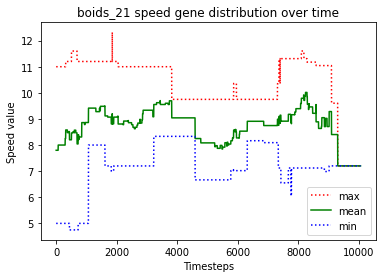

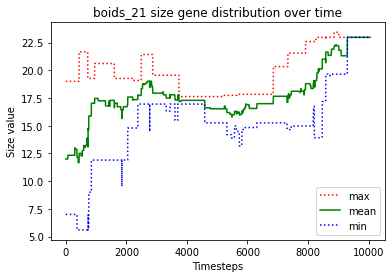

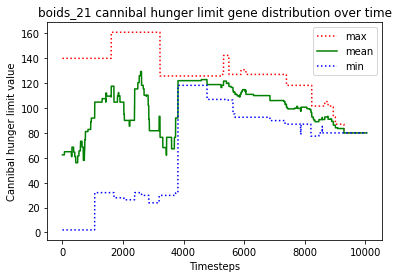

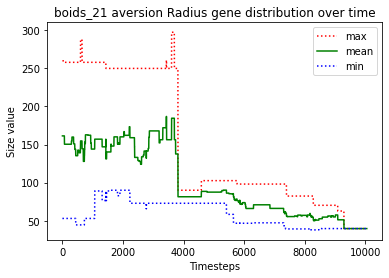

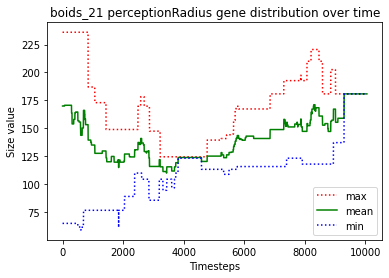

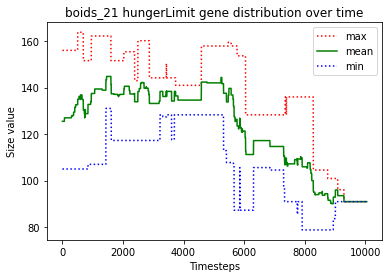





						BOIDS_22

predator_0 just gave birth to predator_10
predator_2 just gave birth to predator_11
predator_8 just gave birth to predator_12
predator_11 just gave birth to predator_13
predator_7 just gave birth to predator_14
predator_3 just gave birth to predator_15
predator_13 starved to death
predator_11 ate the carcass of predator_13_carcass
predator_9 killed predator_2
predator_1 just gave birth to predator_16
predator_11 starved to death
predator_6 ate the carcass of predator_11_carcass
predator_8 starved to death
predator_7 just gave birth to predator_17
predator_4 ate the carcass of predator_8_carcass
predator_17 starved to death
predator_14 just gave birth to predator_18
predator_7 starved to death
predator_3 just gave birth to predator_19
predator_0 ate the carcass of predator_7_carcass
predator_12 starved to death
predator_10 ate the carcass of predator_12_carcass
predator_0 ate the carcass of predator_17_carcass
predator_14 starved to death
predator_18 starved to death

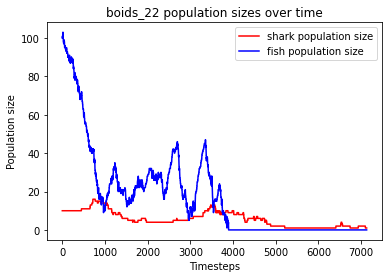

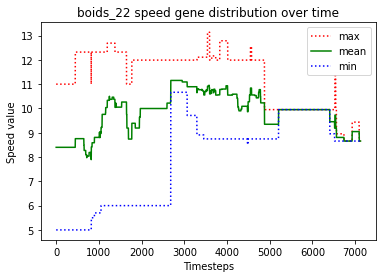

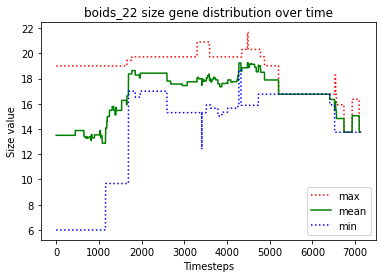

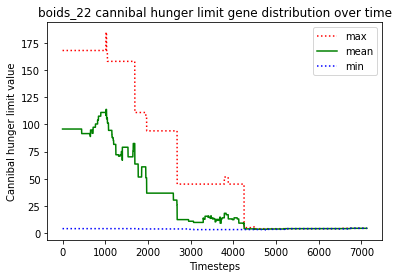

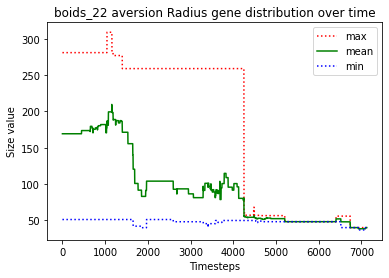

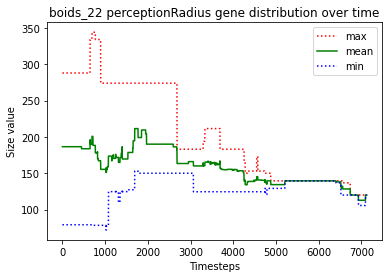

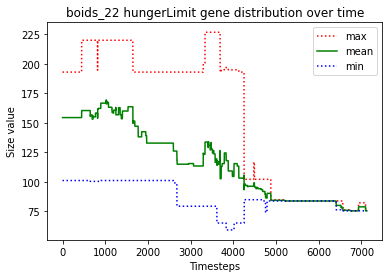





						BOIDS_23

predator_8 just gave birth to predator_10
predator_5 just gave birth to predator_11
predator_4 just gave birth to predator_12
predator_11 killed predator_4
predator_11 killed predator_12
predator_2 just gave birth to predator_13
predator_5 killed predator_1
predator_11 killed predator_13
predator_5 killed predator_2
predator_11 just gave birth to predator_14
predator_8 just gave birth to predator_15
predator_5 killed predator_10
predator_14 killed predator_15
predator_11 killed predator_8
predator_5 just gave birth to predator_16
predator_3 killed predator_0
predator_3 killed predator_6
predator_7 just gave birth to predator_17
predator_14 just gave birth to predator_18
predator_7 just gave birth to predator_19
predator_7 just gave birth to predator_20
predator_18 starved to death
predator_7 ate the carcass of predator_18_carcass
predator_20 starved to death
predator_17 just gave birth to predator_21
predator_14 ate the carcass of predator_20_carcass
predator_21 sta

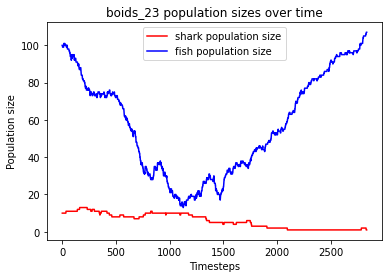

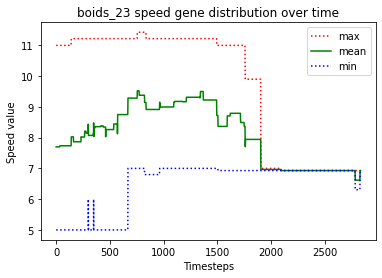

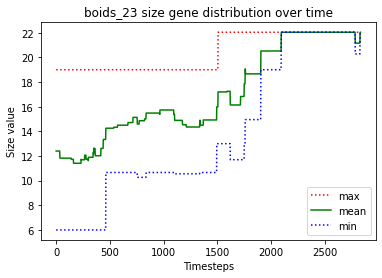

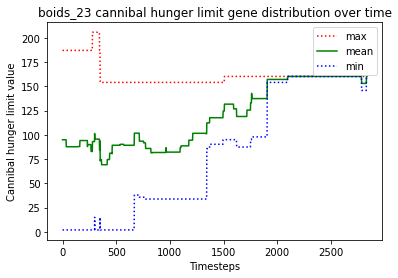

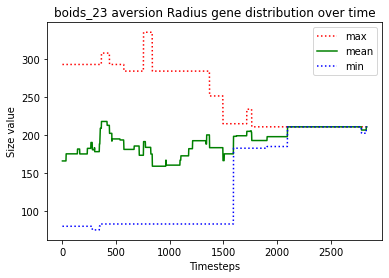

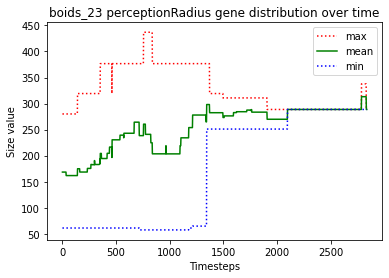

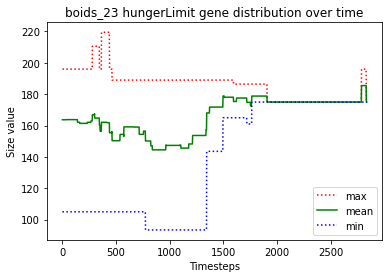





						BOIDS_24

predator_7 killed predator_4
predator_7 just gave birth to predator_10
predator_5 just gave birth to predator_11
predator_2 just gave birth to predator_12
predator_8 just gave birth to predator_13
predator_5 just gave birth to predator_14
predator_0 just gave birth to predator_15
predator_15 just gave birth to predator_16
predator_10 killed predator_2
predator_10 killed predator_12
predator_10 killed predator_14
predator_7 just gave birth to predator_17
predator_5 just gave birth to predator_18
predator_17 killed predator_13
predator_5 starved to death
predator_18 starved to death
predator_11 ate the carcass of predator_5_carcass
predator_16 ate the carcass of predator_18_carcass
predator_11 just gave birth to predator_19
predator_17 starved to death
predator_0 ate the carcass of predator_17_carcass
predator_10 starved to death
predator_7 starved to death
predator_6 ate the carcass of predator_7_carcass
predator_3 ate the carcass of predator_10_carcass
predator_19 s

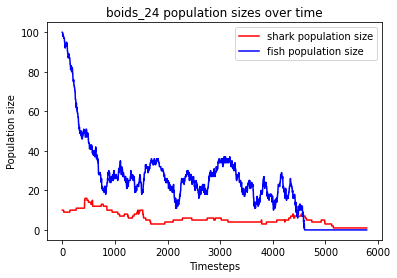

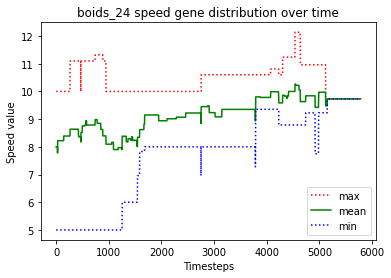

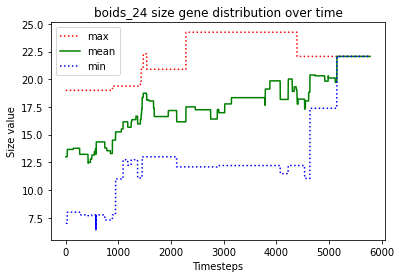

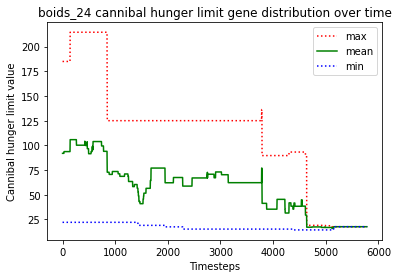

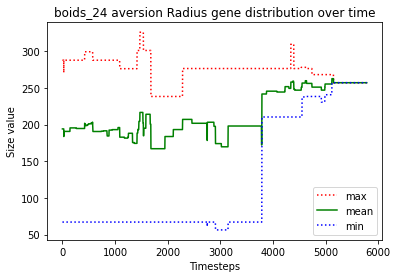

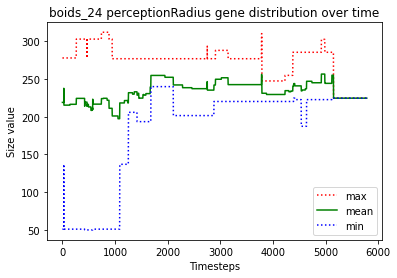

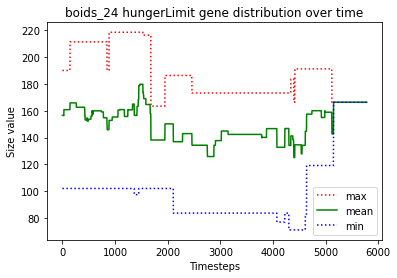





						BOIDS_25

predator_3 just gave birth to predator_10
predator_10 killed predator_2
predator_10 killed predator_6
predator_10 killed predator_7
predator_0 just gave birth to predator_11
predator_0 killed predator_1
predator_11 killed predator_9
predator_0 killed predator_5
predator_11 killed predator_8
predator_0 killed predator_4
predator_11 killed predator_3
predator_10 just gave birth to predator_12
predator_0 killed predator_12
predator_11 just gave birth to predator_13
predator_13 killed predator_10
predator_0 just gave birth to predator_14
predator_14 just gave birth to predator_15
predator_13 starved to death
predator_15 ate the carcass of predator_13_carcass
predator_11 just gave birth to predator_16
no fish to move
predator_15 just gave birth to predator_17
predator_16 starved to death
predator_11 starved to death
predator_14 ate the carcass of predator_16_carcass
predator_15 starved to death
predator_17 starved to death
predator_14 ate the carcass of predator_17_carca

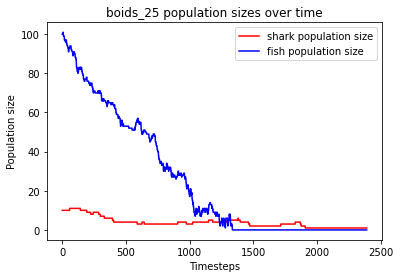

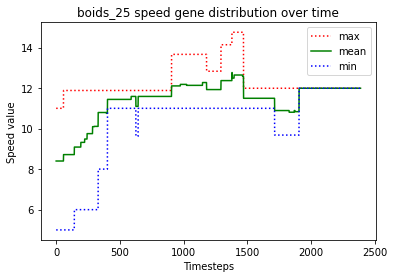

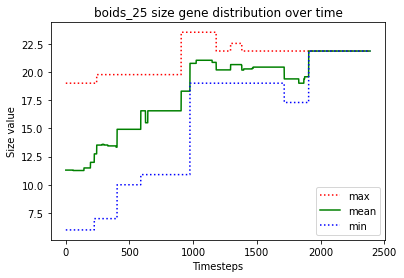

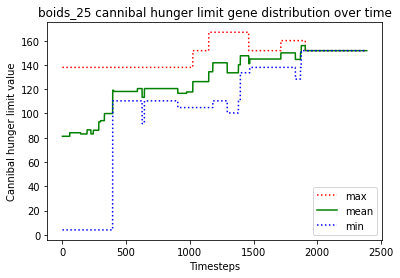

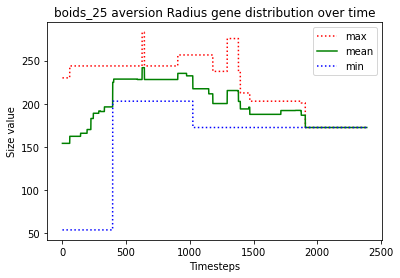

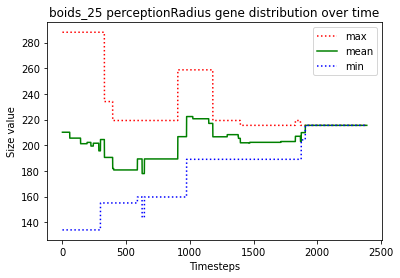

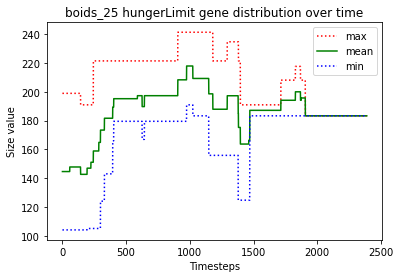





						BOIDS_26

predator_8 just gave birth to predator_10
predator_8 just gave birth to predator_11
predator_2 just gave birth to predator_12
predator_8 just gave birth to predator_13
predator_13 starved to death
predator_1 ate the carcass of predator_13_carcass
predator_8 starved to death
predator_11 starved to death
predator_0 ate the carcass of predator_8_carcass
predator_12 just gave birth to predator_14
predator_9 ate the carcass of predator_11_carcass
predator_12 starved to death
predator_1 ate the carcass of predator_12_carcass
predator_14 starved to death
predator_2 just gave birth to predator_15
predator_5 just gave birth to predator_16
predator_6 just gave birth to predator_17
predator_16 killed predator_3
predator_2 starved to death
predator_15 starved to death
predator_1 ate the carcass of predator_2_carcass
predator_16 killed predator_17
predator_10 just gave birth to predator_18
predator_16 ate the carcass of predator_14_carcass
predator_10 starved to death
predator_1

predator_62 just gave birth to predator_72
predator_72 just gave birth to predator_73
predator_69 killed predator_73
predator_55 just gave birth to predator_74
predator_70 starved to death
predator_55 ate the carcass of predator_70_carcass
predator_74 just gave birth to predator_75
no fish to move
predator_75 starved to death
predator_55 ate the carcass of predator_75_carcass
predator_57 just gave birth to predator_76
predator_69 just gave birth to predator_77
predator_62 starved to death
predator_55 ate the carcass of predator_62_carcass
predator_74 starved to death
predator_71 ate the carcass of predator_74_carcass
predator_77 just gave birth to predator_78
predator_57 starved to death
predator_72 starved to death
predator_69 ate the carcass of predator_57_carcass
predator_55 ate the carcass of predator_72_carcass
predator_76 starved to death
predator_77 starved to death
predator_78 starved to death
predator_69 ate the carcass of predator_78_carcass
predator_69 ate the carcass of pre

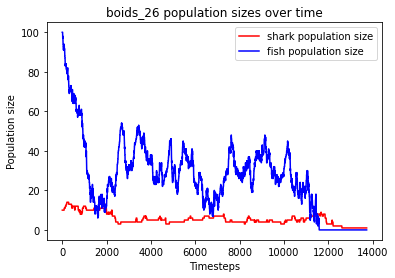

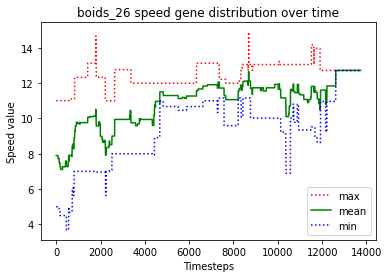

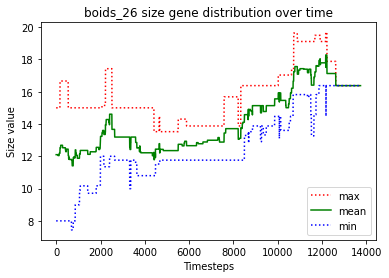

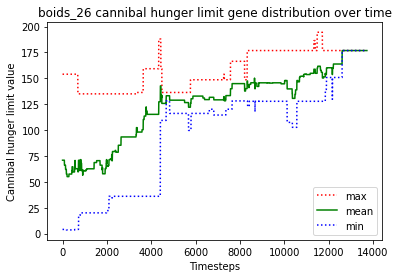

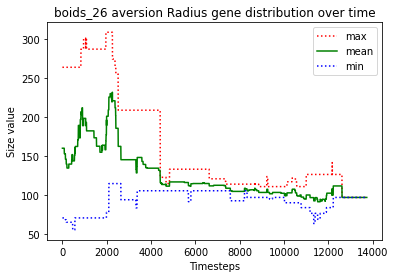

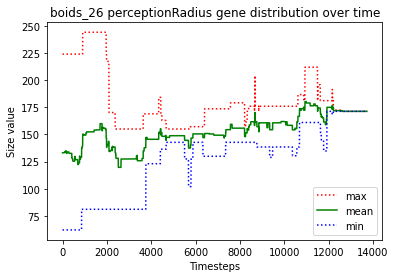

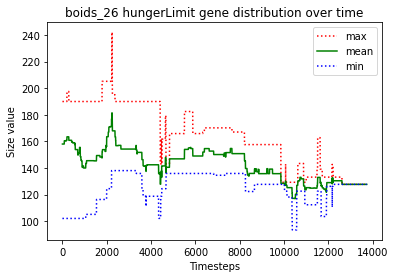





						BOIDS_27

predator_7 just gave birth to predator_10
predator_5 just gave birth to predator_11
predator_5 killed predator_6
predator_11 killed predator_1
predator_7 killed predator_9
predator_10 killed predator_2
predator_3 just gave birth to predator_12
predator_5 killed predator_8
predator_4 just gave birth to predator_13
predator_10 just gave birth to predator_14
predator_12 just gave birth to predator_15
predator_13 killed predator_12
predator_15 just gave birth to predator_16
predator_14 starved to death
predator_10 ate the carcass of predator_14_carcass
predator_0 just gave birth to predator_17
predator_16 killed predator_3
predator_15 starved to death
predator_5 ate the carcass of predator_15_carcass
predator_16 starved to death
predator_4 ate the carcass of predator_16_carcass
predator_5 just gave birth to predator_18
predator_13 just gave birth to predator_19
predator_13 killed predator_19
predator_13 starved to death
predator_0 ate the carcass of predator_13_carcass


predator_37 starved to death
predator_54 ate the carcass of predator_37_carcass
predator_72 starved to death
predator_66 ate the carcass of predator_72_carcass
predator_69 just gave birth to predator_73
predator_42 just gave birth to predator_74
predator_65 just gave birth to predator_75
predator_71 starved to death
predator_74 starved to death
predator_42 starved to death
predator_69 starved to death
predator_65 ate the carcass of predator_69_carcass
predator_75 killed predator_73
predator_65 ate the carcass of predator_71_carcass
predator_66 just gave birth to predator_76
predator_66 just gave birth to predator_77
predator_76 killed predator_77
predator_65 ate the carcass of predator_42_carcass
predator_65 ate the carcass of predator_74_carcass
predator_54 starved to death
predator_66 ate the carcass of predator_54_carcass
predator_65 just gave birth to predator_78
predator_78 just gave birth to predator_79
predator_66 starved to death
predator_76 ate the carcass of predator_66_carca

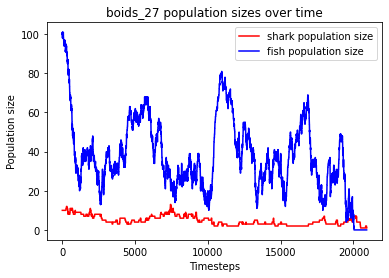

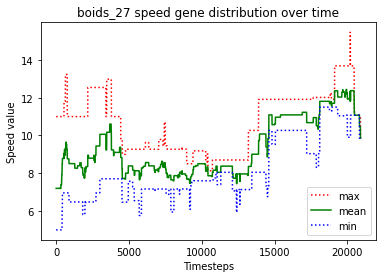

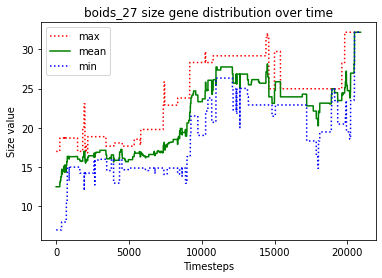

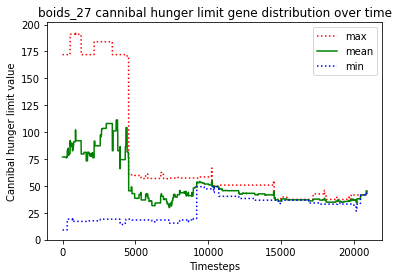

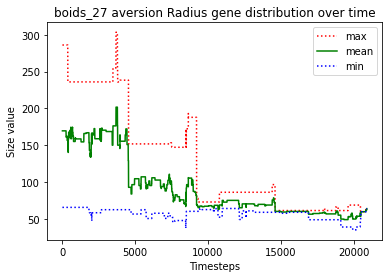

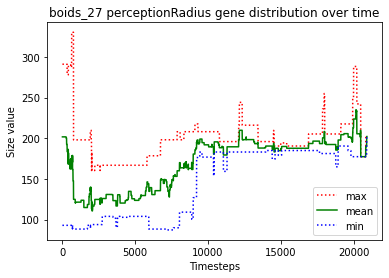

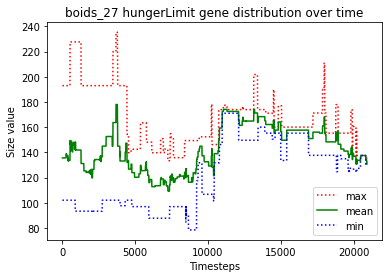





						BOIDS_28

predator_2 just gave birth to predator_10
predator_8 just gave birth to predator_11
predator_9 just gave birth to predator_12
predator_7 just gave birth to predator_13
predator_10 starved to death
predator_12 ate the carcass of predator_10_carcass
predator_2 starved to death
predator_7 killed predator_9
predator_5 just gave birth to predator_14
predator_8 just gave birth to predator_15
predator_1 ate the carcass of predator_2_carcass
predator_1 just gave birth to predator_16
predator_5 killed predator_12
predator_8 starved to death
predator_15 starved to death
predator_1 ate the carcass of predator_8_carcass
predator_1 ate the carcass of predator_15_carcass
predator_3 just gave birth to predator_17
predator_14 just gave birth to predator_18
predator_18 killed predator_11
predator_4 just gave birth to predator_19
predator_3 just gave birth to predator_20
predator_16 starved to death
predator_13 starved to death
predator_14 ate the carcass of predator_13_carcass
preda

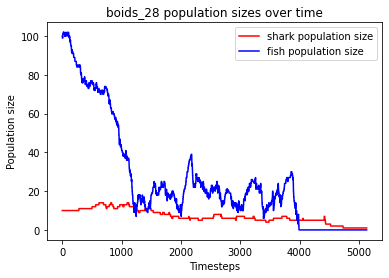

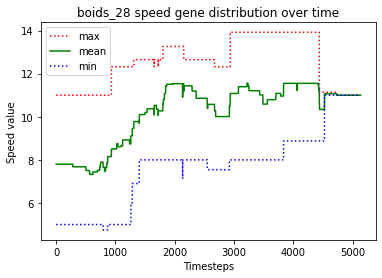

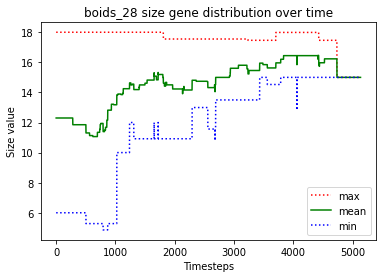

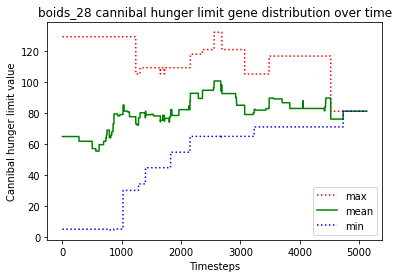

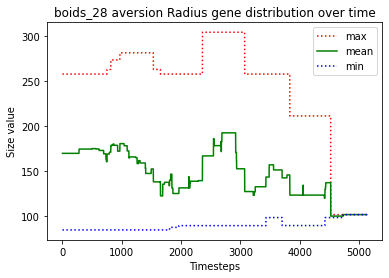

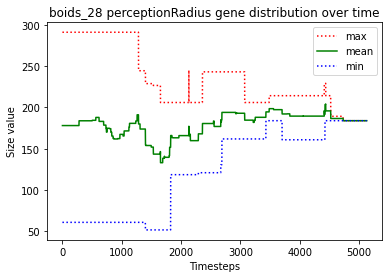

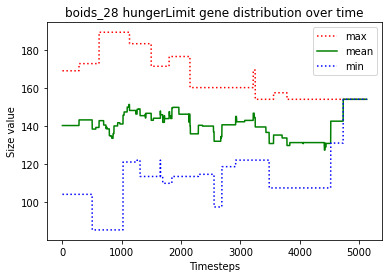





						BOIDS_29

predator_5 just gave birth to predator_10
predator_7 just gave birth to predator_11
predator_10 killed predator_0
predator_10 killed predator_4
predator_9 just gave birth to predator_12
predator_9 just gave birth to predator_13
predator_12 just gave birth to predator_14
predator_6 just gave birth to predator_15
predator_10 just gave birth to predator_16
predator_12 just gave birth to predator_17
predator_12 killed predator_15
predator_3 killed predator_11
predator_9 starved to death
predator_13 ate the carcass of predator_9_carcass
predator_3 just gave birth to predator_18
predator_14 starved to death
predator_10 ate the carcass of predator_14_carcass
predator_6 starved to death
predator_2 ate the carcass of predator_6_carcass
predator_16 starved to death
predator_12 ate the carcass of predator_16_carcass
predator_10 starved to death
predator_12 ate the carcass of predator_10_carcass
predator_1 just gave birth to predator_19
predator_19 killed predator_7
predator_17

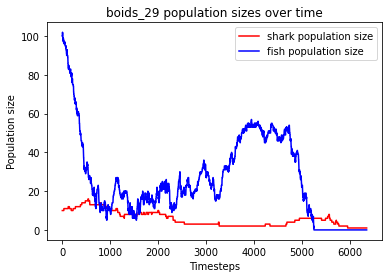

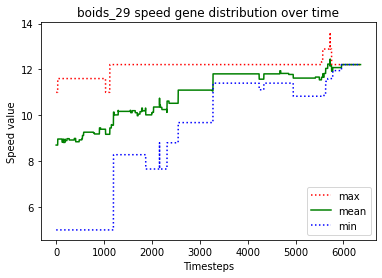

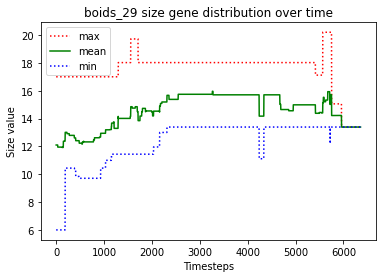

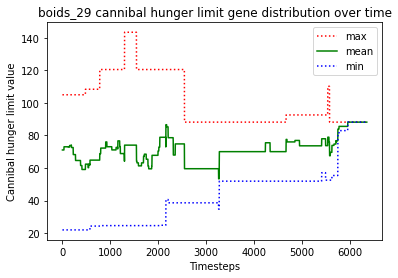

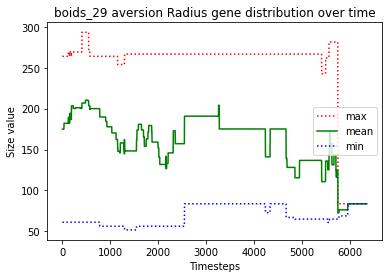

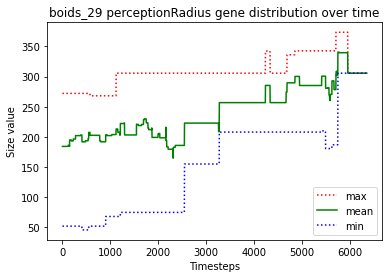

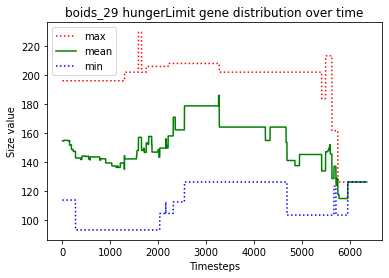





						BOIDS_30

predator_2 just gave birth to predator_10
predator_5 just gave birth to predator_11
predator_1 just gave birth to predator_12
predator_2 just gave birth to predator_13
predator_7 killed predator_6
predator_0 just gave birth to predator_14
predator_14 just gave birth to predator_15
predator_13 starved to death
predator_7 ate the carcass of predator_13_carcass
predator_10 just gave birth to predator_16
predator_12 killed predator_9
predator_2 starved to death
predator_7 ate the carcass of predator_2_carcass
predator_15 starved to death
predator_0 ate the carcass of predator_15_carcass
predator_4 just gave birth to predator_17
predator_14 starved to death
predator_11 ate the carcass of predator_14_carcass
predator_12 just gave birth to predator_18
predator_0 starved to death
predator_11 ate the carcass of predator_0_carcass
predator_10 starved to death
predator_7 ate the carcass of predator_10_carcass
predator_1 just gave birth to predator_19
predator_1 killed predator

predator_76 just gave birth to predator_81
predator_40 killed predator_80
predator_70 just gave birth to predator_82
predator_82 starved to death
predator_70 starved to death
predator_81 starved to death
predator_41 ate the carcass of predator_81_carcass
predator_49 ate the carcass of predator_70_carcass
predator_79 ate the carcass of predator_82_carcass
predator_65 just gave birth to predator_83
predator_65 starved to death
predator_83 starved to death
predator_79 just gave birth to predator_84
predator_76 starved to death
predator_43 ate the carcass of predator_76_carcass
predator_72 ate the carcass of predator_65_carcass
predator_40 ate the carcass of predator_83_carcass
predator_74 starved to death
predator_79 ate the carcass of predator_74_carcass
predator_84 just gave birth to predator_85
predator_85 starved to death
predator_40 ate the carcass of predator_85_carcass
predator_37 just gave birth to predator_86
predator_86 starved to death
predator_57 ate the carcass of predator_86

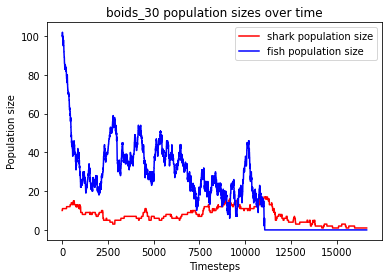

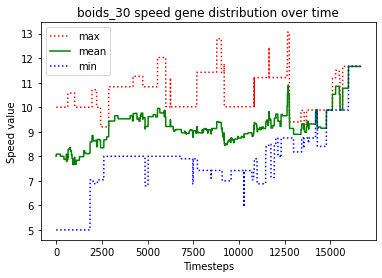

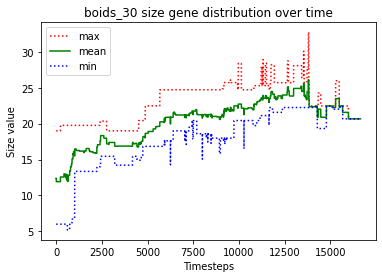

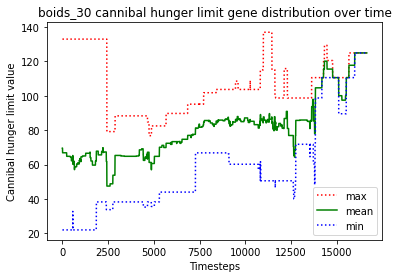

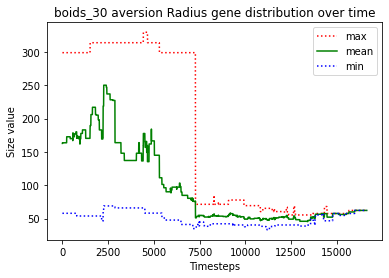

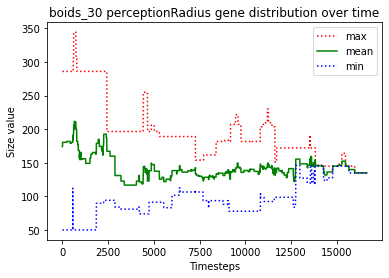

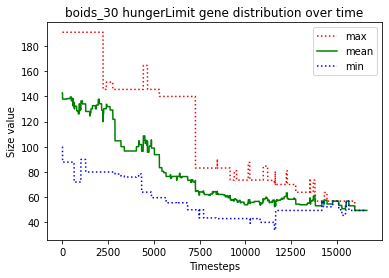





						BOIDS_31

predator_9 just gave birth to predator_10
predator_5 just gave birth to predator_11
predator_8 just gave birth to predator_12
predator_10 just gave birth to predator_13
predator_8 killed predator_4
predator_12 killed predator_2
predator_11 just gave birth to predator_14
predator_13 just gave birth to predator_15
predator_15 starved to death
predator_13 starved to death
predator_12 killed predator_5
predator_14 starved to death
predator_8 ate the carcass of predator_15_carcass
predator_8 ate the carcass of predator_13_carcass
predator_7 ate the carcass of predator_14_carcass
predator_11 just gave birth to predator_16
predator_16 starved to death
predator_11 ate the carcass of predator_16_carcass
predator_8 killed predator_9
predator_12 killed predator_11
predator_7 just gave birth to predator_17
predator_12 just gave birth to predator_18
predator_0 just gave birth to predator_19
predator_10 starved to death
predator_12 ate the carcass of predator_10_carcass
predator_

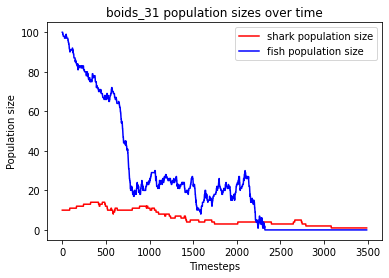

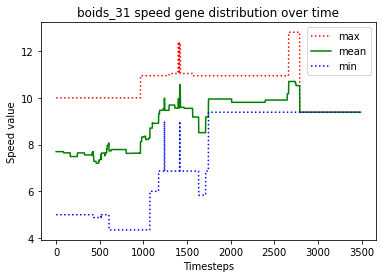

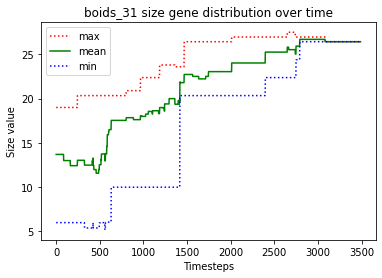

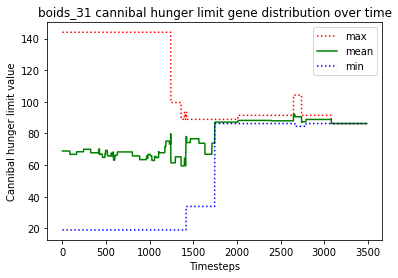

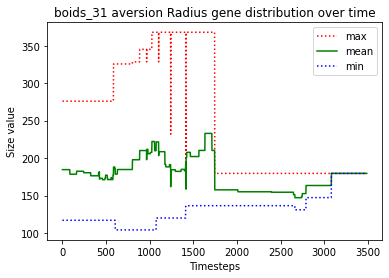

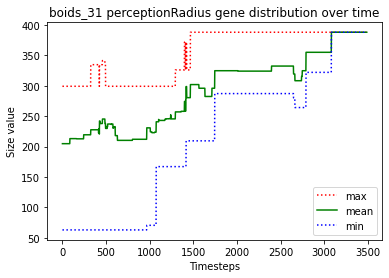

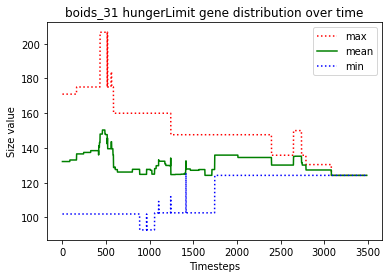





						BOIDS_32

predator_1 just gave birth to predator_10
predator_2 just gave birth to predator_11
predator_9 just gave birth to predator_12
predator_11 just gave birth to predator_13
predator_2 just gave birth to predator_14
predator_2 killed predator_3
predator_0 just gave birth to predator_15
predator_11 killed predator_9
predator_14 killed predator_6
predator_13 just gave birth to predator_16
predator_11 just gave birth to predator_17
predator_11 killed predator_12
predator_16 starved to death
predator_17 just gave birth to predator_18
predator_11 ate the carcass of predator_16_carcass
predator_15 just gave birth to predator_19
predator_18 killed predator_10
predator_17 killed predator_0
predator_13 starved to death
predator_5 ate the carcass of predator_13_carcass
predator_2 starved to death
predator_14 ate the carcass of predator_2_carcass
predator_15 starved to death
predator_7 just gave birth to predator_20
predator_18 killed predator_1
predator_18 just gave birth to preda

predator_75 starved to death
predator_68 starved to death
predator_56 just gave birth to predator_76
predator_73 ate the carcass of predator_75_carcass
predator_74 ate the carcass of predator_68_carcass
predator_56 just gave birth to predator_77
predator_64 just gave birth to predator_78
predator_78 killed predator_66
predator_78 killed predator_56
predator_74 starved to death
predator_78 just gave birth to predator_79
predator_76 ate the carcass of predator_74_carcass
predator_77 just gave birth to predator_80
predator_77 killed predator_80
predator_78 just gave birth to predator_81
predator_78 killed predator_81
predator_73 just gave birth to predator_82
predator_78 killed predator_76
predator_78 just gave birth to predator_83
predator_78 killed predator_82
predator_78 just gave birth to predator_84
predator_84 killed predator_64
predator_77 starved to death
no fish to move
predator_83 just gave birth to predator_85
predator_73 ate the carcass of predator_77_carcass
predator_84 starv

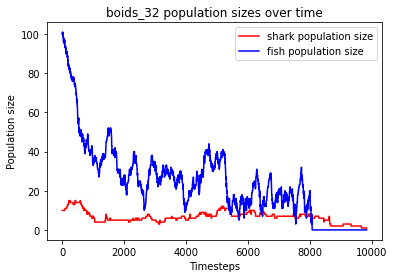

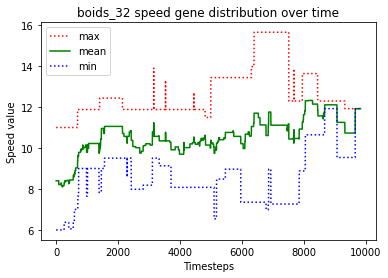

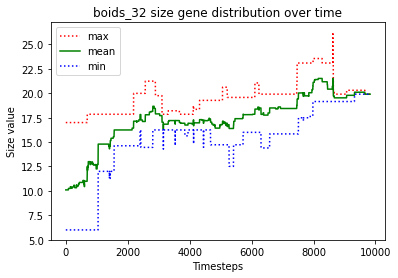

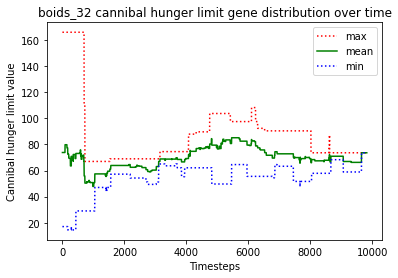

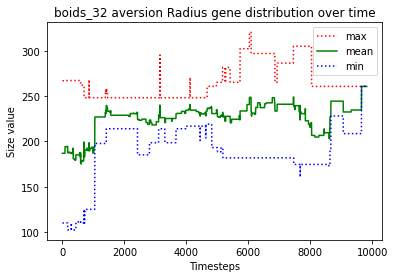

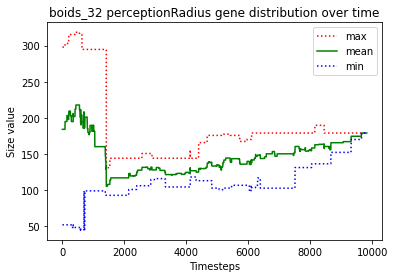

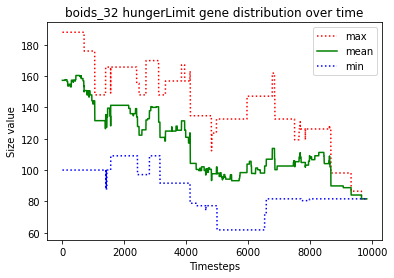





						BOIDS_33

predator_8 just gave birth to predator_10
predator_7 just gave birth to predator_11
predator_8 just gave birth to predator_12
predator_8 just gave birth to predator_13
predator_12 starved to death
predator_13 starved to death
predator_8 starved to death
predator_11 ate the carcass of predator_13_carcass
predator_10 ate the carcass of predator_12_carcass
predator_4 ate the carcass of predator_8_carcass
predator_2 just gave birth to predator_14
predator_2 killed predator_14
predator_11 just gave birth to predator_15
predator_3 just gave birth to predator_16
predator_11 starved to death
predator_15 starved to death
predator_7 starved to death
predator_1 ate the carcass of predator_15_carcass
predator_2 ate the carcass of predator_11_carcass
predator_2 ate the carcass of predator_7_carcass
predator_16 starved to death
predator_4 ate the carcass of predator_16_carcass
predator_4 just gave birth to predator_17
predator_3 starved to death
predator_4 ate the carcass of pred

predator_68 just gave birth to predator_79
predator_69 ate the carcass of predator_76_carcass
predator_65 just gave birth to predator_80
predator_67 just gave birth to predator_81
predator_59 starved to death
predator_78 ate the carcass of predator_59_carcass
predator_58 just gave birth to predator_82
predator_72 starved to death
predator_68 just gave birth to predator_83
predator_77 ate the carcass of predator_72_carcass
predator_67 starved to death
predator_82 just gave birth to predator_84
predator_49 ate the carcass of predator_67_carcass
predator_75 just gave birth to predator_85
predator_65 ate the carcass of predator_74_carcass
predator_81 killed predator_78
predator_83 starved to death
predator_82 starved to death
predator_84 starved to death
predator_66 just gave birth to predator_86
predator_80 starved to death
predator_79 starved to death
predator_69 just gave birth to predator_87
predator_23 starved to death
predator_58 just gave birth to predator_88
predator_85 ate the car

predator_129 just gave birth to predator_134
predator_129 killed predator_134
predator_45 just gave birth to predator_135
predator_132 just gave birth to predator_136
predator_61 starved to death
predator_103 ate the carcass of predator_61_carcass
predator_104 just gave birth to predator_137
predator_131 just gave birth to predator_138
predator_112 just gave birth to predator_139
predator_132 starved to death
predator_105 starved to death
predator_136 starved to death
predator_137 just gave birth to predator_140
predator_81 just gave birth to predator_141
predator_139 ate the carcass of predator_132_carcass
predator_129 starved to death
predator_141 ate the carcass of predator_129_carcass
predator_89 just gave birth to predator_142
predator_123 starved to death
predator_133 ate the carcass of predator_123_carcass
predator_45 just gave birth to predator_143
predator_142 ate the carcass of predator_136_carcass
predator_62 starved to death
predator_137 ate the carcass of predator_105_carc

predator_204 ate the carcass of predator_193_carcass
predator_150 starved to death
predator_174 killed predator_199
predator_146 starved to death
predator_197 just gave birth to predator_206
predator_200 starved to death
predator_205 ate the carcass of predator_200_carcass
predator_171 ate the carcass of predator_146_carcass
predator_195 just gave birth to predator_207
predator_177 just gave birth to predator_208
predator_189 ate the carcass of predator_150_carcass
predator_166 just gave birth to predator_209
predator_197 starved to death
predator_185 just gave birth to predator_210
predator_177 starved to death
predator_174 ate the carcass of predator_197_carcass
predator_115 ate the carcass of predator_177_carcass
predator_166 just gave birth to predator_211
predator_207 just gave birth to predator_212
predator_205 killed predator_204
predator_171 killed predator_211
predator_201 killed predator_141
predator_208 just gave birth to predator_213
predator_185 just gave birth to predator

predator_262 ate the carcass of predator_174_carcass
predator_223 just gave birth to predator_269
predator_244 starved to death
predator_264 ate the carcass of predator_244_carcass
predator_226 ate the carcass of predator_267_carcass
predator_235 just gave birth to predator_270
predator_264 just gave birth to predator_271
predator_268 starved to death
predator_263 starved to death
predator_239 ate the carcass of predator_268_carcass
predator_235 ate the carcass of predator_263_carcass
predator_270 killed predator_201
predator_248 starved to death
predator_250 just gave birth to predator_272
predator_264 ate the carcass of predator_248_carcass
predator_243 just gave birth to predator_273
predator_219 just gave birth to predator_274
predator_250 killed predator_223
predator_271 just gave birth to predator_275
predator_272 starved to death
predator_269 starved to death
predator_218 ate the carcass of predator_272_carcass
predator_270 just gave birth to predator_276
predator_276 just gave 

predator_322 starved to death
predator_321 ate the carcass of predator_322_carcass
predator_328 just gave birth to predator_329
predator_329 starved to death
predator_327 starved to death
predator_328 starved to death
predator_264 ate the carcass of predator_327_carcass
predator_312 just gave birth to predator_330
predator_312 killed predator_330
predator_303 ate the carcass of predator_329_carcass
predator_298 ate the carcass of predator_328_carcass
predator_298 just gave birth to predator_331
predator_292 starved to death
predator_239 just gave birth to predator_332
predator_311 just gave birth to predator_333
predator_260 just gave birth to predator_334
predator_321 ate the carcass of predator_292_carcass
predator_326 just gave birth to predator_335
predator_326 killed predator_335
predator_324 starved to death
predator_298 ate the carcass of predator_324_carcass
predator_321 just gave birth to predator_336
predator_278 just gave birth to predator_337
predator_207 just gave birth to

predator_386 just gave birth to predator_392
predator_386 killed predator_392
predator_390 just gave birth to predator_393
predator_350 just gave birth to predator_394
predator_350 killed predator_394
predator_273 just gave birth to predator_395
predator_393 starved to death
predator_390 ate the carcass of predator_393_carcass
predator_356 starved to death
predator_366 ate the carcass of predator_356_carcass
predator_273 just gave birth to predator_396
predator_390 just gave birth to predator_397
predator_378 starved to death
predator_372 ate the carcass of predator_378_carcass
predator_350 killed predator_395
predator_386 just gave birth to predator_398
predator_364 just gave birth to predator_399
predator_397 starved to death
predator_380 ate the carcass of predator_397_carcass
predator_273 just gave birth to predator_400
predator_371 just gave birth to predator_401
predator_396 just gave birth to predator_402
predator_398 killed predator_366
predator_402 starved to death
predator_39

predator_446 starved to death
predator_447 ate the carcass of predator_446_carcass
predator_442 starved to death
predator_449 ate the carcass of predator_442_carcass
predator_438 just gave birth to predator_450
predator_384 starved to death
predator_437 ate the carcass of predator_384_carcass
predator_418 killed predator_447
predator_430 just gave birth to predator_451
predator_448 just gave birth to predator_452
predator_437 just gave birth to predator_453
predator_332 just gave birth to predator_454
predator_448 starved to death
predator_452 starved to death
predator_449 just gave birth to predator_455
predator_449 killed predator_455
predator_438 ate the carcass of predator_452_carcass
predator_332 starved to death
predator_454 starved to death
predator_385 starved to death
predator_451 ate the carcass of predator_448_carcass
predator_438 ate the carcass of predator_332_carcass
predator_418 ate the carcass of predator_454_carcass
predator_430 starved to death
predator_450 ate the ca

predator_453 starved to death
predator_499 starved to death
predator_487 ate the carcass of predator_453_carcass
predator_476 ate the carcass of predator_499_carcass
predator_473 just gave birth to predator_505
predator_473 killed predator_505
predator_504 just gave birth to predator_506
predator_504 killed predator_506
predator_497 just gave birth to predator_507
predator_507 just gave birth to predator_508
predator_503 starved to death
predator_486 just gave birth to predator_509
predator_508 starved to death
predator_487 ate the carcass of predator_503_carcass
predator_502 ate the carcass of predator_508_carcass
predator_509 starved to death
predator_463 ate the carcass of predator_501_carcass
predator_418 ate the carcass of predator_509_carcass
predator_504 just gave birth to predator_510
predator_486 starved to death
predator_497 ate the carcass of predator_486_carcass
predator_498 just gave birth to predator_511
predator_511 killed predator_510
predator_504 starved to death
preda

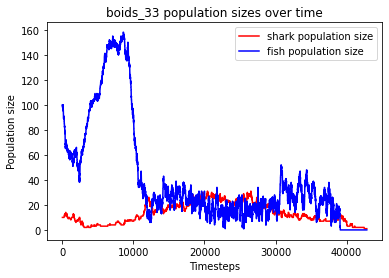

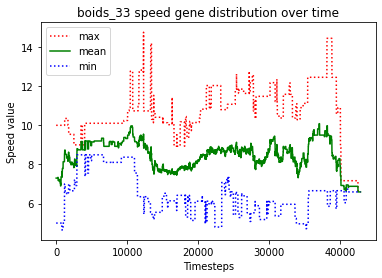

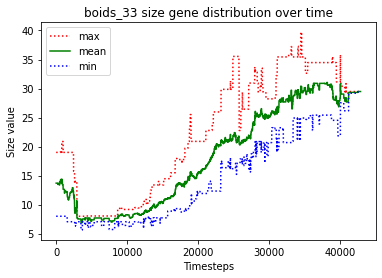

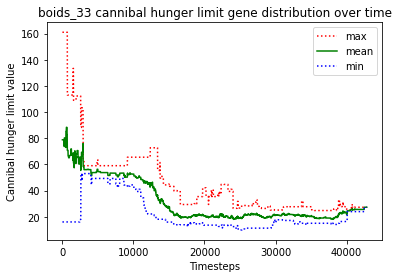

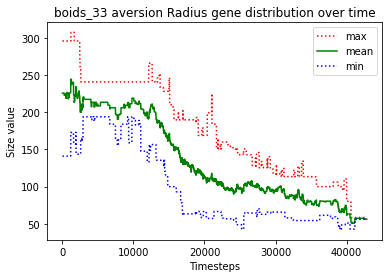

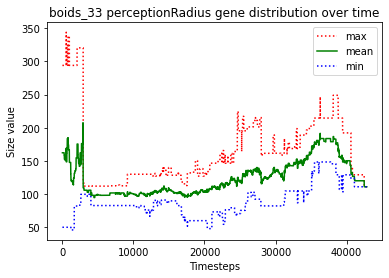

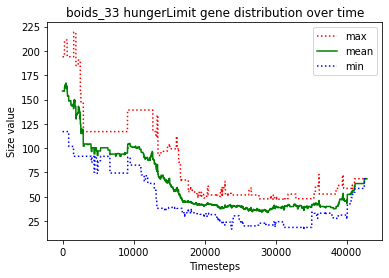





						BOIDS_34

predator_1 just gave birth to predator_10
predator_2 just gave birth to predator_11
predator_1 just gave birth to predator_12
predator_0 just gave birth to predator_13
predator_3 killed predator_10
predator_0 just gave birth to predator_14
predator_12 starved to death
predator_3 ate the carcass of predator_12_carcass
predator_1 starved to death
predator_0 just gave birth to predator_15
predator_3 ate the carcass of predator_1_carcass
predator_13 just gave birth to predator_16
predator_2 starved to death
predator_8 ate the carcass of predator_2_carcass
predator_15 starved to death
predator_11 starved to death
predator_0 ate the carcass of predator_15_carcass
predator_4 ate the carcass of predator_11_carcass
predator_14 just gave birth to predator_17
predator_17 starved to death
predator_14 starved to death
predator_5 ate the carcass of predator_17_carcass
predator_0 ate the carcass of predator_14_carcass
predator_7 just gave birth to predator_18
predator_16 just gave

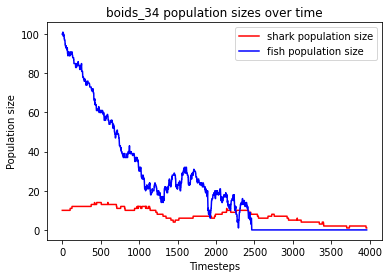

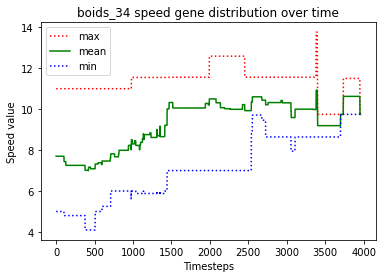

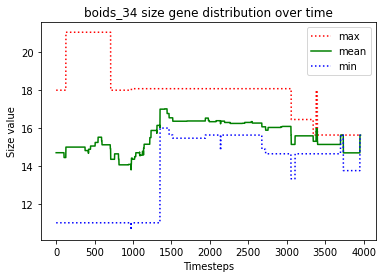

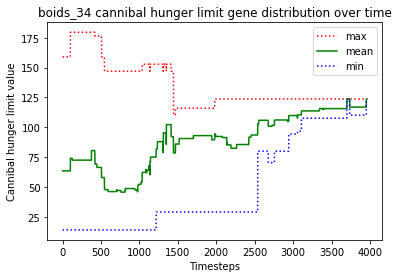

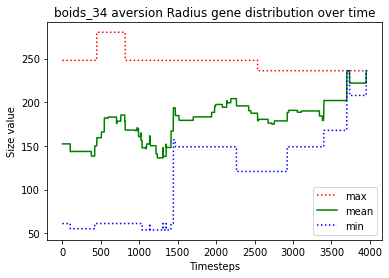

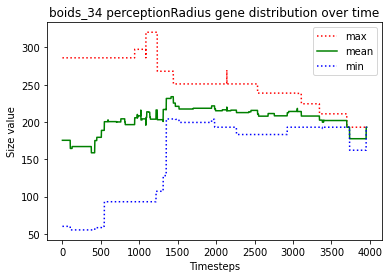

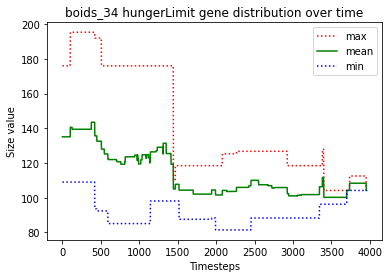





						BOIDS_35

predator_8 just gave birth to predator_10
predator_9 just gave birth to predator_11
predator_1 just gave birth to predator_12
predator_8 starved to death
predator_10 ate the carcass of predator_8_carcass
predator_5 starved to death
predator_10 ate the carcass of predator_5_carcass
predator_2 killed predator_10
predator_3 just gave birth to predator_13
predator_11 just gave birth to predator_14
predator_14 killed predator_7
predator_0 just gave birth to predator_15
predator_4 just gave birth to predator_16
predator_12 just gave birth to predator_17
predator_0 killed predator_13
predator_2 just gave birth to predator_18
predator_15 killed predator_3
predator_18 starved to death
predator_2 starved to death
predator_9 ate the carcass of predator_2_carcass
predator_16 ate the carcass of predator_18_carcass
predator_4 starved to death
predator_17 ate the carcass of predator_4_carcass
predator_15 killed predator_16
predator_9 just gave birth to predator_19
predator_0 starv

predator_46 ate the carcass of predator_64_carcass
predator_54 starved to death
predator_46 just gave birth to predator_68
predator_68 just gave birth to predator_69
predator_68 killed predator_69
predator_46 starved to death
predator_68 ate the carcass of predator_54_carcass
predator_68 starved to death


finished this run because predators went extinct
Fish left: 0
Sharks left: 0
Dead sharks: 70
Timesteps passed: 9073
Fish went extinct at timestep 7182
Sharks went extinct at timestep 9073


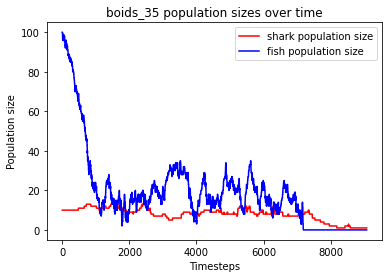

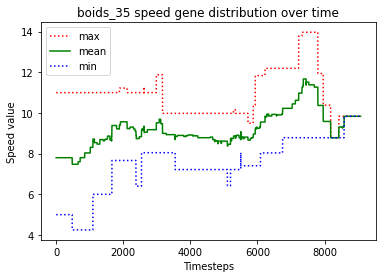

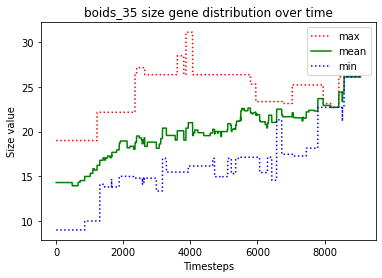

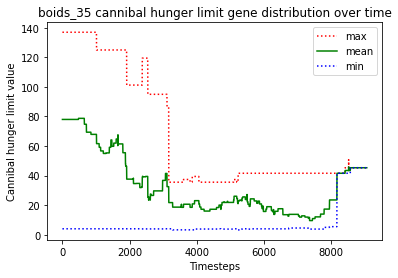

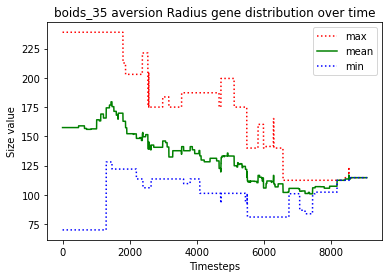

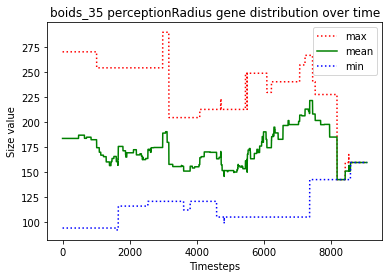

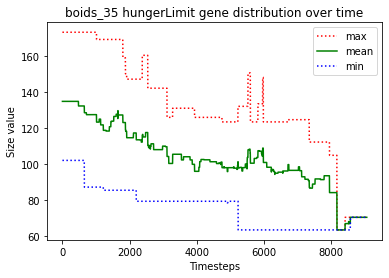





						BOIDS_36

predator_2 just gave birth to predator_10
predator_2 killed predator_0
predator_8 just gave birth to predator_11
predator_10 killed predator_8
predator_10 killed predator_3
predator_1 just gave birth to predator_12
predator_9 just gave birth to predator_13
predator_13 killed predator_1
predator_13 killed predator_12
predator_11 just gave birth to predator_14
predator_6 just gave birth to predator_15
predator_14 starved to death
predator_11 ate the carcass of predator_14_carcass
predator_9 killed predator_11
predator_9 killed predator_4
predator_13 just gave birth to predator_16
predator_16 killed predator_5
predator_16 just gave birth to predator_17
predator_17 killed predator_7
predator_17 killed predator_15
predator_13 just gave birth to predator_18
predator_18 starved to death
predator_9 ate the carcass of predator_18_carcass
predator_17 just gave birth to predator_19
predator_13 just gave birth to predator_20
predator_20 starved to death
predator_13 starved to d

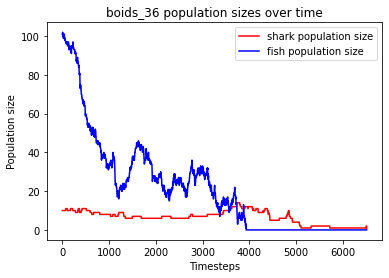

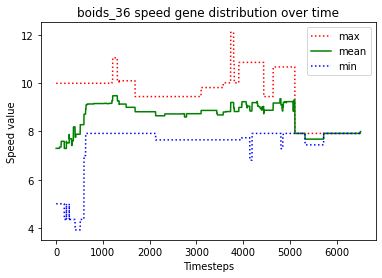

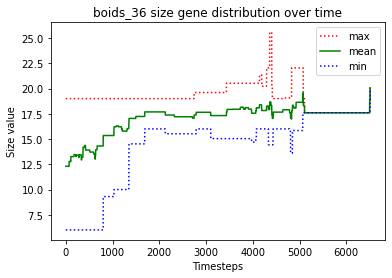

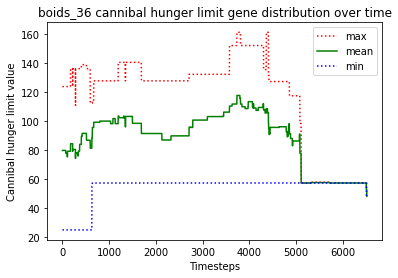

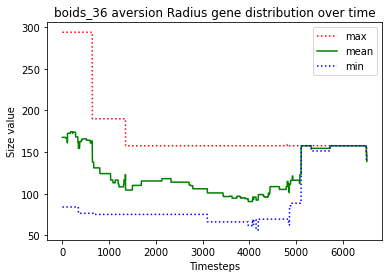

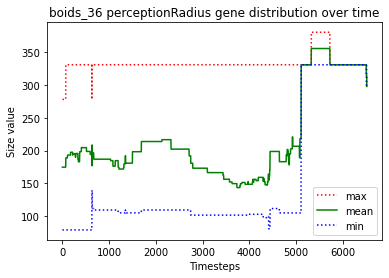

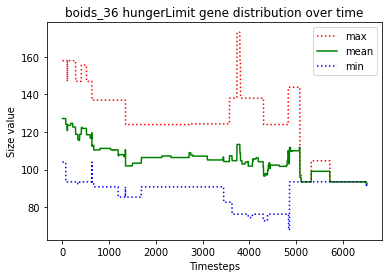





						BOIDS_37

predator_7 just gave birth to predator_10
predator_0 just gave birth to predator_11
predator_5 just gave birth to predator_12
predator_3 just gave birth to predator_13
predator_8 just gave birth to predator_14
predator_3 just gave birth to predator_15
predator_12 killed predator_15
predator_0 just gave birth to predator_16
predator_11 just gave birth to predator_17
predator_6 just gave birth to predator_18
predator_5 just gave birth to predator_19
predator_11 starved to death
predator_17 starved to death
predator_0 ate the carcass of predator_17_carcass
predator_16 ate the carcass of predator_11_carcass
predator_10 starved to death
predator_18 ate the carcass of predator_10_carcass
predator_7 starved to death
predator_0 just gave birth to predator_20
predator_8 ate the carcass of predator_7_carcass
predator_20 starved to death
predator_0 starved to death
predator_18 just gave birth to predator_21
predator_8 just gave birth to predator_22
predator_2 ate the carcass o

predator_66 ate the carcass of predator_69_carcass
predator_68 starved to death
predator_66 ate the carcass of predator_68_carcass
predator_66 just gave birth to predator_70
predator_70 just gave birth to predator_71
predator_67 just gave birth to predator_72
predator_70 just gave birth to predator_73
predator_70 just gave birth to predator_74
predator_73 starved to death
predator_66 just gave birth to predator_75
predator_70 starved to death
predator_72 starved to death
predator_67 ate the carcass of predator_73_carcass
predator_74 ate the carcass of predator_70_carcass
predator_74 just gave birth to predator_76
predator_71 ate the carcass of predator_72_carcass
predator_76 just gave birth to predator_77
predator_77 starved to death
predator_76 ate the carcass of predator_77_carcass
predator_74 just gave birth to predator_78
predator_78 just gave birth to predator_79
predator_79 starved to death
predator_67 ate the carcass of predator_79_carcass
predator_74 starved to death
predator_7

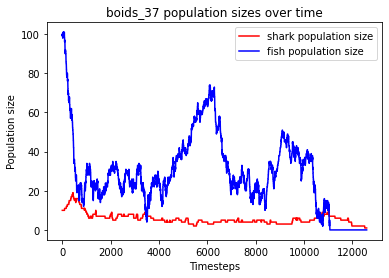

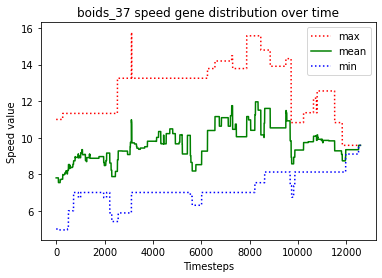

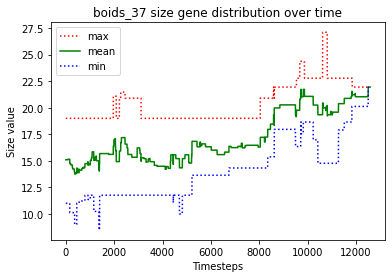

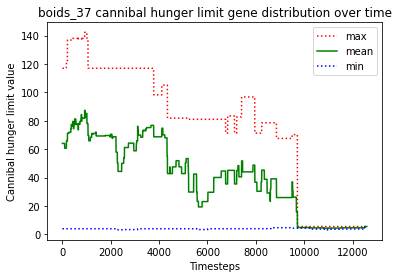

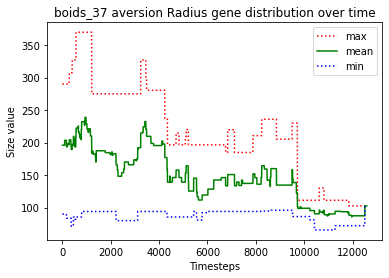

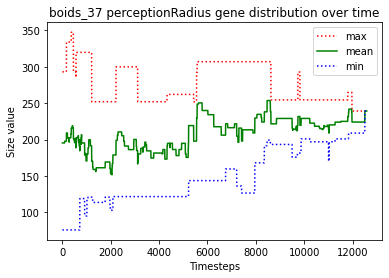

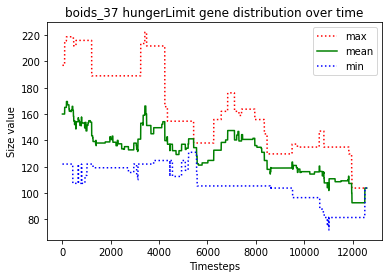





						BOIDS_38

predator_6 just gave birth to predator_10
predator_8 just gave birth to predator_11
predator_6 just gave birth to predator_12
predator_6 starved to death
predator_12 starved to death
predator_8 ate the carcass of predator_12_carcass
predator_9 ate the carcass of predator_6_carcass
predator_11 starved to death
predator_7 ate the carcass of predator_11_carcass
predator_10 just gave birth to predator_13
predator_7 just gave birth to predator_14
predator_0 starved to death
predator_8 just gave birth to predator_15
predator_10 starved to death
predator_14 ate the carcass of predator_0_carcass
predator_7 starved to death
predator_14 ate the carcass of predator_7_carcass
predator_3 ate the carcass of predator_10_carcass
predator_8 just gave birth to predator_16
predator_8 just gave birth to predator_17
predator_17 starved to death
predator_8 starved to death
predator_16 starved to death
predator_2 starved to death
predator_15 ate the carcass of predator_8_carcass
predator_

predator_63 just gave birth to predator_70
predator_62 just gave birth to predator_71
predator_66 just gave birth to predator_72
predator_66 just gave birth to predator_73
predator_63 starved to death
predator_27 ate the carcass of predator_63_carcass
predator_70 starved to death
predator_73 starved to death
predator_66 ate the carcass of predator_73_carcass
predator_61 ate the carcass of predator_70_carcass
predator_72 starved to death
predator_57 ate the carcass of predator_72_carcass
predator_61 just gave birth to predator_74
predator_67 starved to death
predator_66 ate the carcass of predator_67_carcass
predator_71 starved to death
predator_62 starved to death
predator_74 ate the carcass of predator_62_carcass
predator_44 ate the carcass of predator_71_carcass
predator_61 starved to death
predator_44 ate the carcass of predator_61_carcass
predator_44 just gave birth to predator_75
predator_66 starved to death
predator_44 ate the carcass of predator_66_carcass
predator_75 killed pre

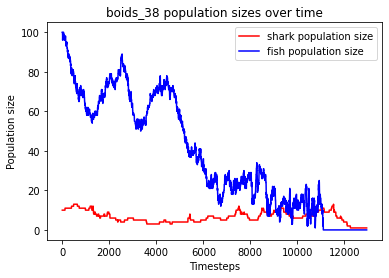

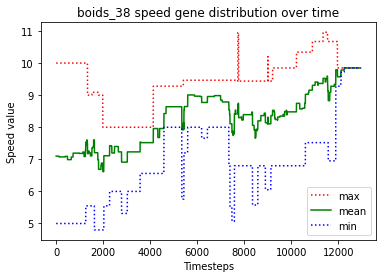

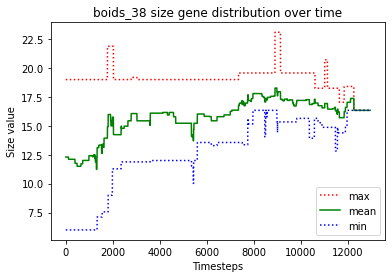

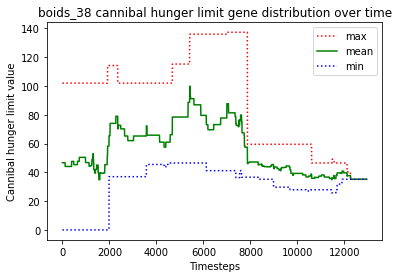

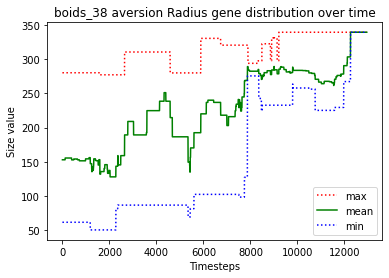

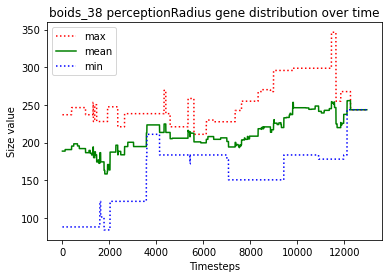

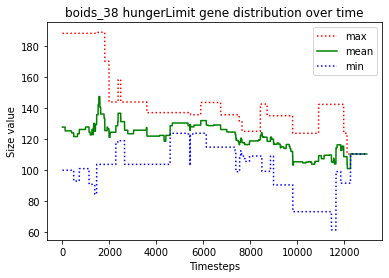





						BOIDS_39

predator_3 just gave birth to predator_10
predator_6 just gave birth to predator_11
predator_6 just gave birth to predator_12
predator_4 just gave birth to predator_13
predator_11 killed predator_5
predator_2 killed predator_13
predator_12 just gave birth to predator_14
predator_7 just gave birth to predator_15
predator_4 starved to death
predator_7 killed predator_6
predator_12 ate the carcass of predator_4_carcass
predator_7 killed predator_11
predator_7 killed predator_9
predator_12 starved to death
predator_15 killed predator_14
predator_8 just gave birth to predator_16
predator_2 ate the carcass of predator_12_carcass
predator_10 just gave birth to predator_17
predator_7 just gave birth to predator_18
predator_0 just gave birth to predator_19
predator_0 killed predator_19
predator_7 just gave birth to predator_20
predator_7 just gave birth to predator_21
predator_8 just gave birth to predator_22
predator_22 starved to death
predator_8 starved to death
predator_

predator_64 starved to death
predator_46 ate the carcass of predator_64_carcass
predator_68 starved to death
predator_46 starved to death
predator_60 ate the carcass of predator_68_carcass
predator_60 ate the carcass of predator_46_carcass
predator_60 just gave birth to predator_69
predator_69 just gave birth to predator_70
predator_69 killed predator_70
predator_69 just gave birth to predator_71
predator_69 just gave birth to predator_72
predator_72 starved to death
predator_69 starved to death
predator_71 ate the carcass of predator_69_carcass
predator_71 just gave birth to predator_73
predator_73 ate the carcass of predator_72_carcass
predator_71 starved to death
predator_73 ate the carcass of predator_71_carcass
predator_60 just gave birth to predator_74
predator_60 just gave birth to predator_75
predator_74 just gave birth to predator_76
predator_74 starved to death
predator_76 ate the carcass of predator_74_carcass
predator_75 starved to death
predator_73 ate the carcass of preda

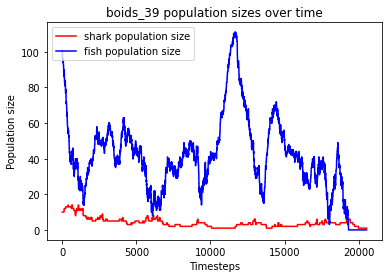

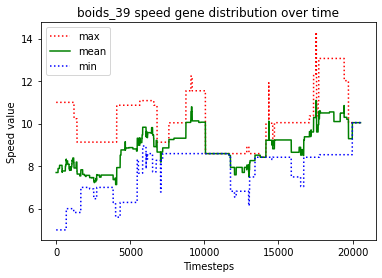

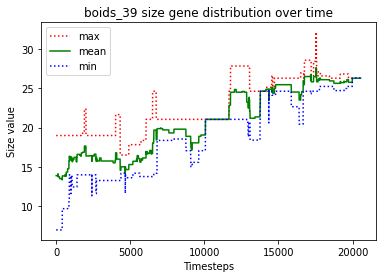

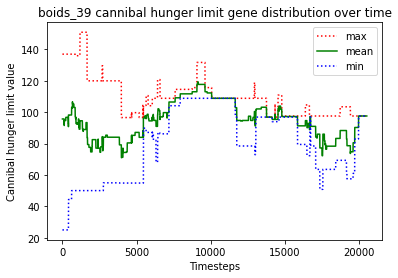

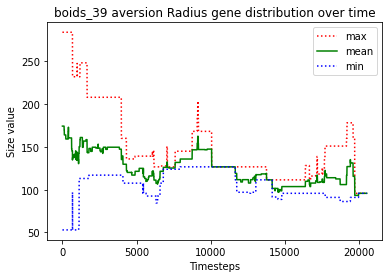

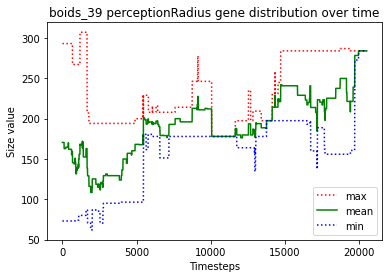

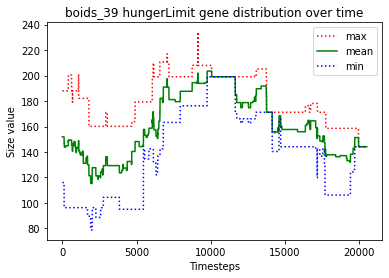





						BOIDS_40

predator_1 just gave birth to predator_10
predator_4 just gave birth to predator_11
predator_1 killed predator_9
predator_10 killed predator_8
predator_10 killed predator_2
predator_1 killed predator_3
predator_1 killed predator_5
predator_0 just gave birth to predator_12
predator_0 killed predator_12
predator_1 just gave birth to predator_13
predator_0 just gave birth to predator_14
predator_4 just gave birth to predator_15
predator_6 just gave birth to predator_16
predator_14 starved to death
predator_4 ate the carcass of predator_14_carcass
predator_0 starved to death
predator_4 just gave birth to predator_17
predator_13 starved to death
predator_10 ate the carcass of predator_13_carcass
predator_17 ate the carcass of predator_0_carcass
predator_10 just gave birth to predator_18
predator_10 killed predator_15
predator_10 just gave birth to predator_19
predator_19 killed predator_18
predator_17 starved to death
predator_10 ate the carcass of predator_17_carcass
pr

predator_70 starved to death
predator_47 ate the carcass of predator_70_carcass
predator_52 starved to death
predator_63 just gave birth to predator_73
predator_64 starved to death
predator_60 starved to death
predator_72 ate the carcass of predator_64_carcass
predator_66 starved to death
predator_69 ate the carcass of predator_66_carcass
predator_61 starved to death
predator_69 ate the carcass of predator_60_carcass
predator_63 starved to death
predator_47 ate the carcass of predator_61_carcass
predator_72 ate the carcass of predator_63_carcass
predator_73 starved to death
predator_69 just gave birth to predator_74
predator_72 just gave birth to predator_75
predator_74 ate the carcass of predator_52_carcass
predator_69 starved to death
predator_47 ate the carcass of predator_69_carcass
predator_74 starved to death
predator_47 ate the carcass of predator_74_carcass
predator_72 starved to death
predator_75 starved to death
predator_47 ate the carcass of predator_72_carcass
predator_47 j

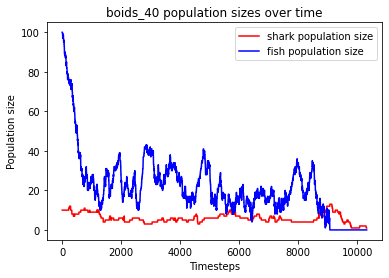

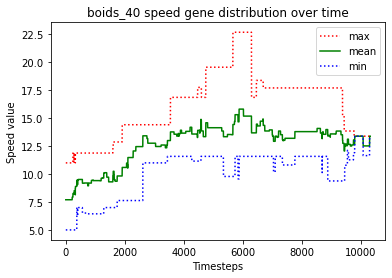

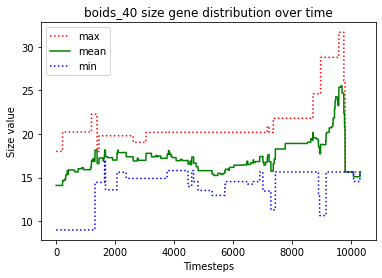

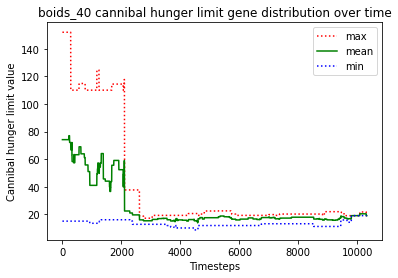

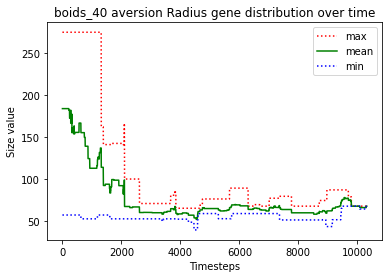

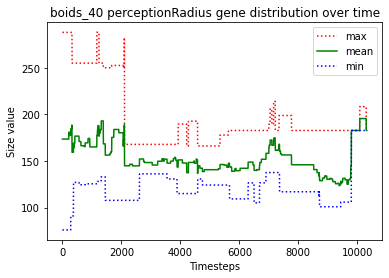

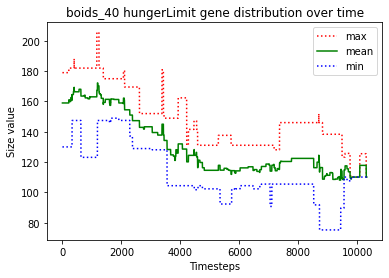





						BOIDS_41

predator_1 just gave birth to predator_10
predator_4 just gave birth to predator_11
predator_7 just gave birth to predator_12
predator_11 just gave birth to predator_13
predator_8 just gave birth to predator_14
predator_10 just gave birth to predator_15
predator_15 starved to death
predator_0 just gave birth to predator_16
predator_2 ate the carcass of predator_15_carcass
predator_10 starved to death
predator_5 ate the carcass of predator_10_carcass
predator_14 just gave birth to predator_17
predator_1 starved to death
predator_11 ate the carcass of predator_1_carcass
predator_17 starved to death
predator_14 starved to death
predator_6 ate the carcass of predator_17_carcass
predator_0 ate the carcass of predator_14_carcass
predator_12 just gave birth to predator_18
predator_11 just gave birth to predator_19
predator_16 killed predator_3
predator_13 starved to death
predator_18 starved to death
predator_2 ate the carcass of predator_13_carcass
predator_5 ate the carc

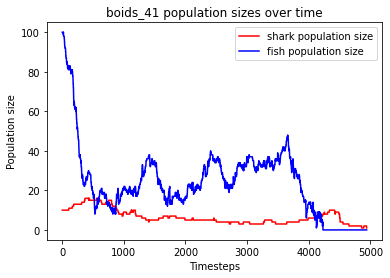

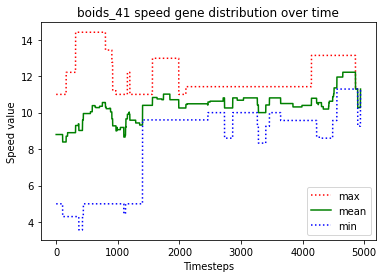

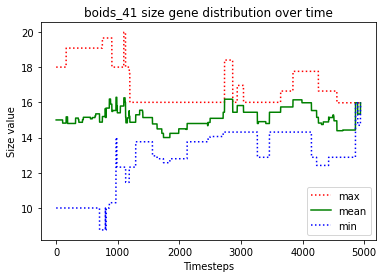

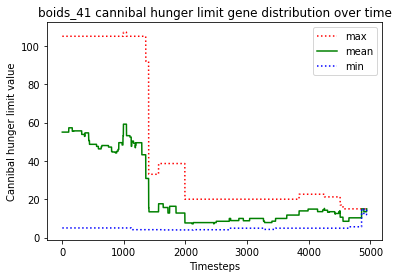

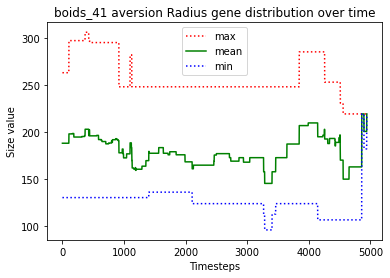

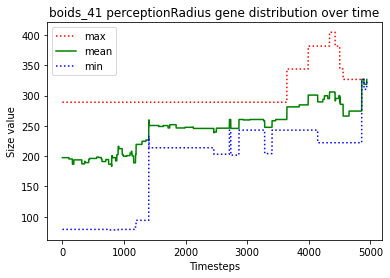

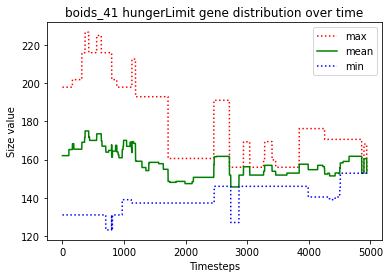





						BOIDS_42

predator_2 just gave birth to predator_10
predator_6 just gave birth to predator_11
predator_4 just gave birth to predator_12
predator_8 just gave birth to predator_13
predator_8 killed predator_13
predator_1 just gave birth to predator_14
predator_7 just gave birth to predator_15
predator_9 just gave birth to predator_16
predator_14 just gave birth to predator_17
predator_11 starved to death
predator_4 ate the carcass of predator_11_carcass
predator_16 just gave birth to predator_18
predator_18 just gave birth to predator_19
predator_8 starved to death
predator_0 ate the carcass of predator_8_carcass
predator_6 starved to death
predator_12 just gave birth to predator_20
predator_15 starved to death
predator_7 ate the carcass of predator_15_carcass
predator_0 ate the carcass of predator_6_carcass
predator_10 killed predator_9
predator_18 starved to death
predator_19 starved to death
predator_7 ate the carcass of predator_18_carcass
predator_0 ate the carcass of pred

predator_70 starved to death
predator_57 just gave birth to predator_72
predator_53 ate the carcass of predator_70_carcass
predator_69 starved to death
predator_57 starved to death
no fish to move
predator_58 just gave birth to predator_73
predator_72 starved to death
predator_66 ate the carcass of predator_72_carcass
predator_73 ate the carcass of predator_57_carcass
predator_73 ate the carcass of predator_69_carcass
predator_66 killed predator_73
predator_58 just gave birth to predator_74
predator_65 starved to death
predator_74 ate the carcass of predator_65_carcass
predator_66 starved to death
predator_58 starved to death
predator_74 ate the carcass of predator_58_carcass
predator_53 starved to death
predator_74 ate the carcass of predator_66_carcass
predator_71 just gave birth to predator_75
predator_74 ate the carcass of predator_53_carcass
predator_75 killed predator_50
predator_71 starved to death
predator_74 ate the carcass of predator_71_carcass
predator_75 starved to death
p

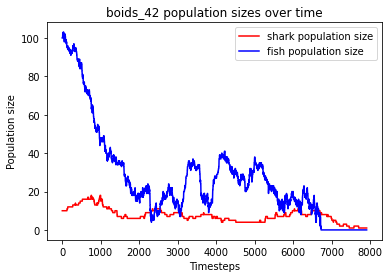

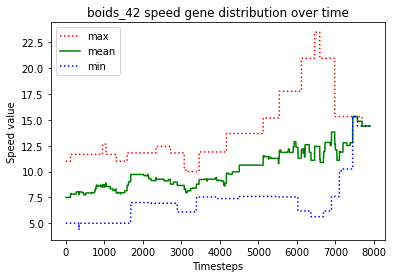

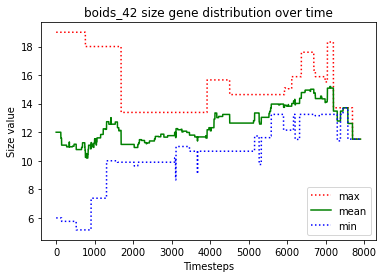

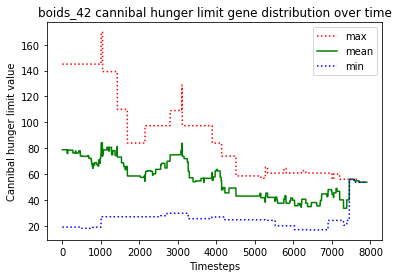

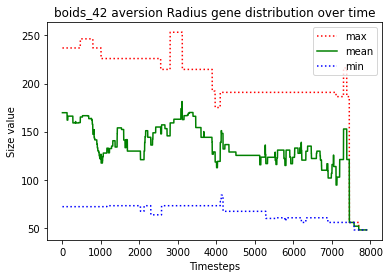

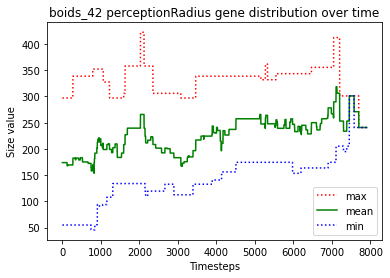

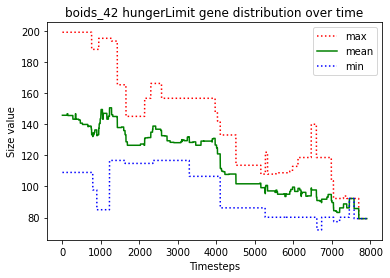





						BOIDS_43

predator_4 just gave birth to predator_10
predator_4 just gave birth to predator_11
predator_0 just gave birth to predator_12
predator_10 just gave birth to predator_13
predator_12 killed predator_1
predator_0 killed predator_5
predator_12 just gave birth to predator_14
predator_14 killed predator_3
predator_2 just gave birth to predator_15
predator_4 killed predator_6
predator_7 just gave birth to predator_16
predator_0 just gave birth to predator_17
predator_4 just gave birth to predator_18
predator_17 killed predator_9
predator_4 starved to death
predator_18 starved to death
predator_17 ate the carcass of predator_18_carcass
predator_0 ate the carcass of predator_4_carcass
predator_12 starved to death
predator_0 ate the carcass of predator_12_carcass
predator_14 killed predator_7
predator_17 starved to death
predator_0 ate the carcass of predator_17_carcass
predator_16 starved to death
predator_8 starved to death
predator_0 ate the carcass of predator_8_carcass
p

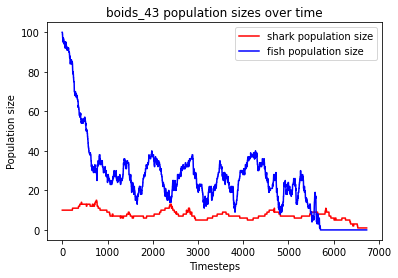

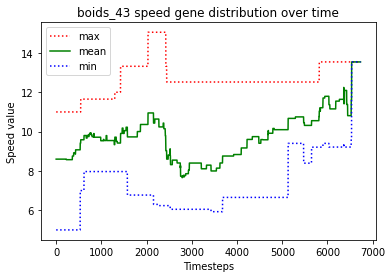

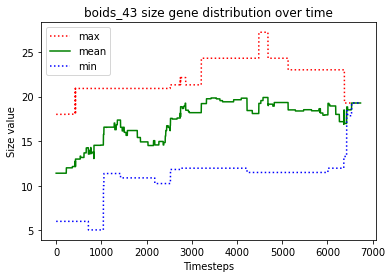

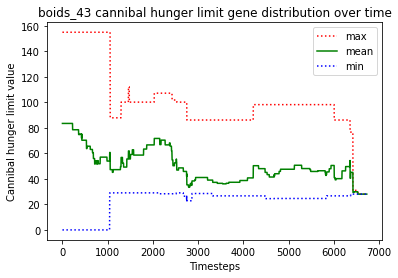

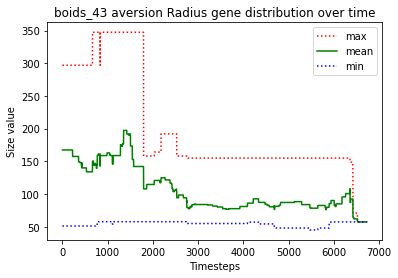

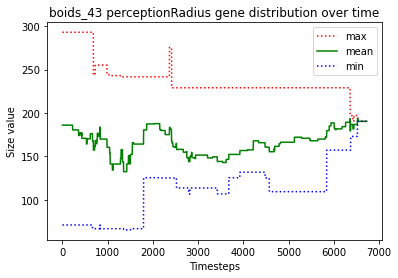

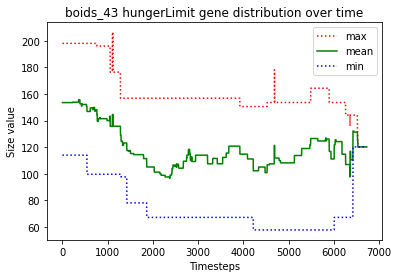





						BOIDS_44

predator_7 just gave birth to predator_10
predator_7 killed predator_10
predator_2 just gave birth to predator_11
predator_11 killed predator_5
predator_2 killed predator_0
predator_8 just gave birth to predator_12
predator_6 just gave birth to predator_13
predator_12 just gave birth to predator_14
predator_9 just gave birth to predator_15
predator_1 just gave birth to predator_16
predator_9 just gave birth to predator_17
predator_9 just gave birth to predator_18
predator_14 starved to death
predator_3 just gave birth to predator_19
predator_4 killed predator_18
predator_9 starved to death
predator_17 starved to death
predator_2 ate the carcass of predator_17_carcass
predator_8 ate the carcass of predator_9_carcass
predator_16 just gave birth to predator_20
predator_15 starved to death
predator_19 just gave birth to predator_21
predator_13 ate the carcass of predator_14_carcass
predator_20 starved to death
predator_7 starved to death
predator_16 ate the carcass of p

predator_58 ate the carcass of predator_64_carcass
predator_58 just gave birth to predator_67
predator_67 starved to death
predator_58 ate the carcass of predator_67_carcass
predator_58 just gave birth to predator_68
predator_58 just gave birth to predator_69
predator_69 just gave birth to predator_70
predator_58 starved to death
predator_70 ate the carcass of predator_58_carcass
predator_70 just gave birth to predator_71
predator_68 just gave birth to predator_72
predator_72 just gave birth to predator_73
predator_73 just gave birth to predator_74
predator_74 killed predator_70
predator_74 starved to death
predator_72 ate the carcass of predator_74_carcass
predator_73 starved to death
predator_72 ate the carcass of predator_73_carcass
predator_71 just gave birth to predator_75
predator_69 starved to death
predator_75 ate the carcass of predator_69_carcass
predator_72 starved to death
predator_68 ate the carcass of predator_72_carcass
predator_71 just gave birth to predator_76
predator

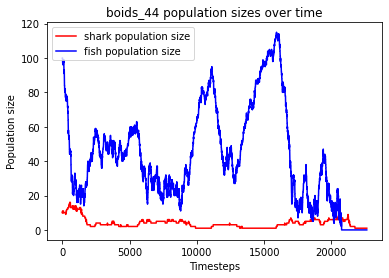

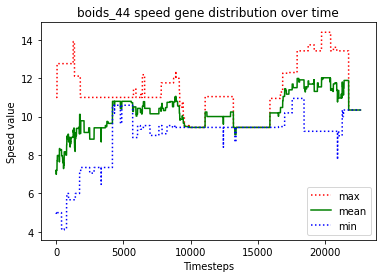

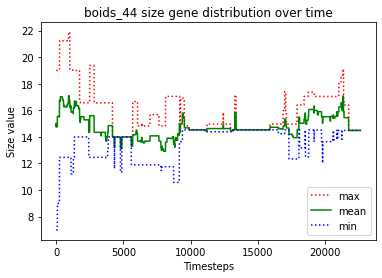

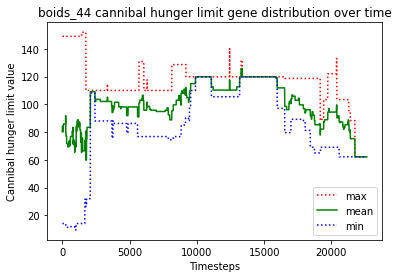

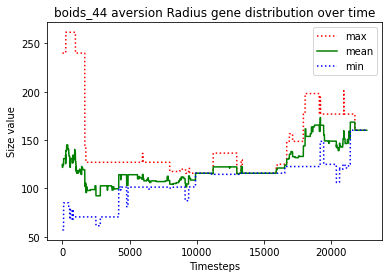

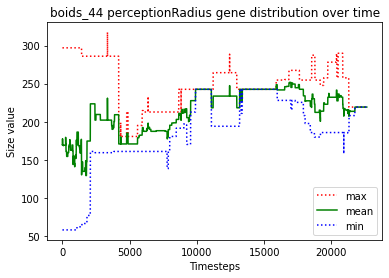

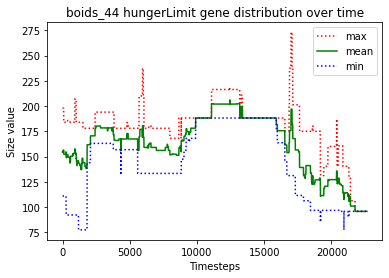





						BOIDS_45

predator_2 just gave birth to predator_10
predator_2 killed predator_0
predator_10 killed predator_1
predator_2 killed predator_6
predator_7 just gave birth to predator_11
predator_9 just gave birth to predator_12
predator_10 killed predator_4
predator_2 just gave birth to predator_13
predator_2 killed predator_5
predator_2 killed predator_11
predator_13 killed predator_7
predator_2 killed predator_3
predator_8 just gave birth to predator_14
predator_9 starved to death
predator_14 ate the carcass of predator_9_carcass
predator_12 starved to death
predator_13 ate the carcass of predator_12_carcass
predator_10 just gave birth to predator_15
predator_8 starved to death
predator_13 ate the carcass of predator_8_carcass
predator_15 just gave birth to predator_16
predator_14 starved to death
predator_16 ate the carcass of predator_14_carcass
predator_2 just gave birth to predator_17
predator_17 just gave birth to predator_18
predator_2 just gave birth to predator_19
preda

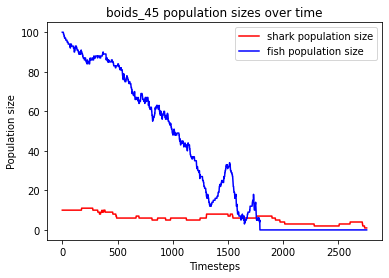

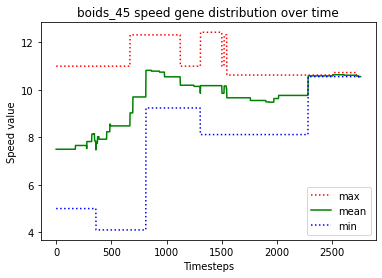

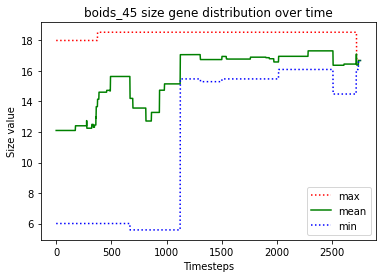

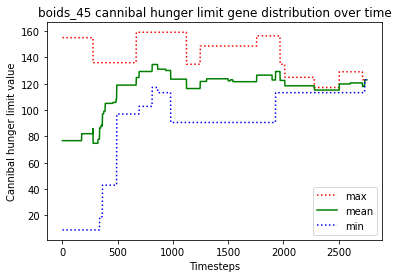

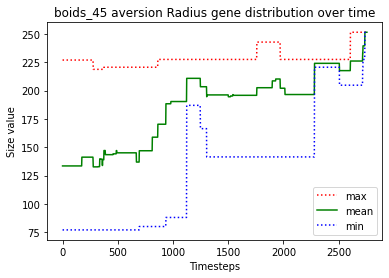

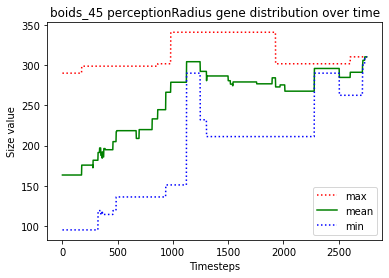

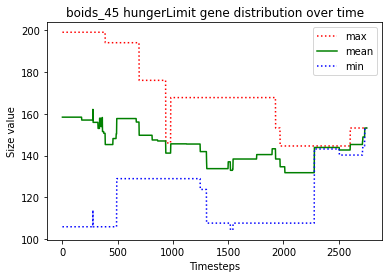





						BOIDS_46

predator_3 just gave birth to predator_10
predator_3 just gave birth to predator_11
predator_3 killed predator_5
predator_10 killed predator_9
predator_7 just gave birth to predator_12
predator_2 just gave birth to predator_13
predator_12 just gave birth to predator_14
predator_11 just gave birth to predator_15
predator_15 killed predator_3
predator_15 killed predator_7
predator_15 killed predator_13
predator_15 killed predator_12
predator_11 starved to death
predator_4 ate the carcass of predator_11_carcass
predator_15 starved to death
predator_10 ate the carcass of predator_15_carcass
predator_6 killed predator_2
predator_10 killed predator_1
predator_4 just gave birth to predator_16
predator_10 just gave birth to predator_17
predator_6 just gave birth to predator_18
predator_8 just gave birth to predator_19
predator_18 just gave birth to predator_20
predator_17 just gave birth to predator_21
predator_20 killed predator_16
predator_18 killed predator_8
predator_10

predator_72 ate the carcass of predator_70_carcass
predator_74 ate the carcass of predator_73_carcass
predator_75 starved to death
predator_54 starved to death
predator_46 ate the carcass of predator_75_carcass
predator_71 ate the carcass of predator_54_carcass
predator_72 just gave birth to predator_76
predator_76 starved to death
predator_72 starved to death
predator_74 ate the carcass of predator_76_carcass
predator_60 just gave birth to predator_77
predator_43 ate the carcass of predator_72_carcass
predator_74 just gave birth to predator_78
predator_74 just gave birth to predator_79
predator_77 just gave birth to predator_80
no fish to move
predator_77 starved to death
predator_43 ate the carcass of predator_77_carcass
predator_80 starved to death
predator_74 just gave birth to predator_81
predator_74 ate the carcass of predator_80_carcass
predator_74 just gave birth to predator_82
predator_81 starved to death
predator_43 ate the carcass of predator_81_carcass
predator_82 starved t

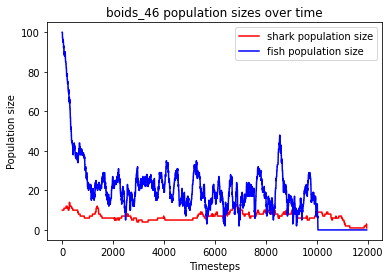

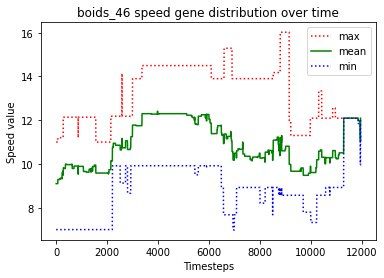

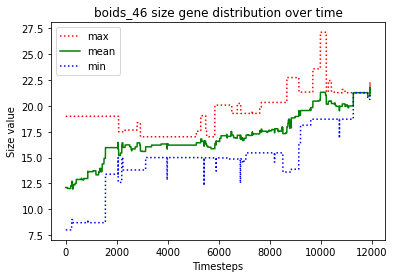

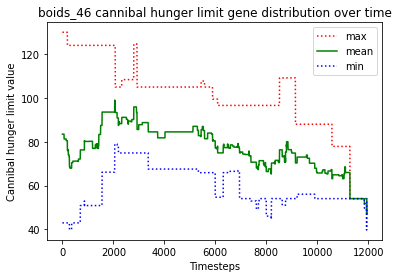

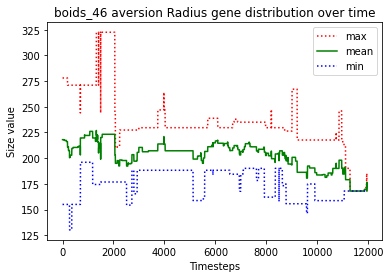

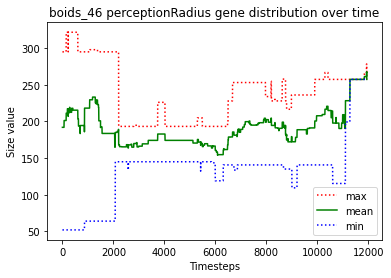

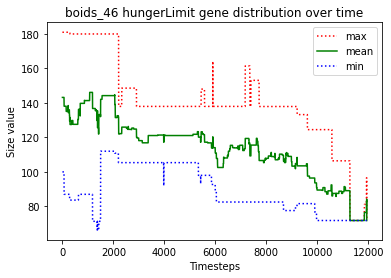





						BOIDS_47

predator_8 just gave birth to predator_10
predator_0 just gave birth to predator_11
predator_0 killed predator_5
predator_1 just gave birth to predator_12
predator_12 just gave birth to predator_13
predator_12 just gave birth to predator_14
predator_2 just gave birth to predator_15
predator_6 just gave birth to predator_16
predator_6 just gave birth to predator_17
predator_0 just gave birth to predator_18
predator_15 just gave birth to predator_19
predator_3 just gave birth to predator_20
predator_1 just gave birth to predator_21
predator_3 killed predator_18
predator_13 just gave birth to predator_22
predator_0 just gave birth to predator_23
predator_0 starved to death
predator_23 starved to death
predator_9 ate the carcass of predator_23_carcass
predator_11 starved to death
predator_13 just gave birth to predator_24
predator_6 just gave birth to predator_25
predator_16 ate the carcass of predator_11_carcass
predator_20 just gave birth to predator_26
predator_21 ju

predator_73 just gave birth to predator_75
predator_73 starved to death
predator_75 starved to death
predator_63 ate the carcass of predator_75_carcass
predator_72 ate the carcass of predator_73_carcass
predator_58 starved to death
predator_71 just gave birth to predator_76
predator_74 just gave birth to predator_77
predator_69 just gave birth to predator_78
predator_71 ate the carcass of predator_58_carcass
predator_72 just gave birth to predator_79
predator_74 starved to death
predator_77 starved to death
predator_69 ate the carcass of predator_77_carcass
predator_76 just gave birth to predator_80
predator_78 just gave birth to predator_81
predator_49 starved to death
predator_76 ate the carcass of predator_74_carcass
predator_80 starved to death
predator_76 ate the carcass of predator_80_carcass
predator_43 ate the carcass of predator_49_carcass
predator_72 starved to death
predator_79 ate the carcass of predator_72_carcass
predator_35 just gave birth to predator_82
predator_63 just

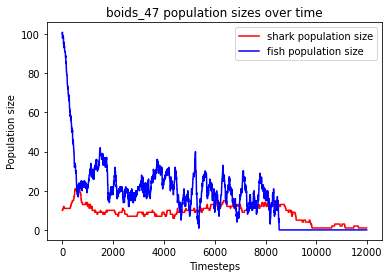

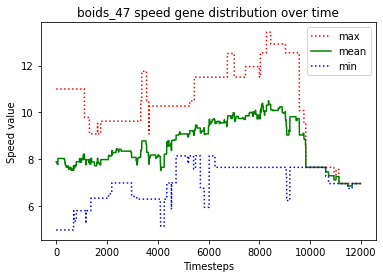

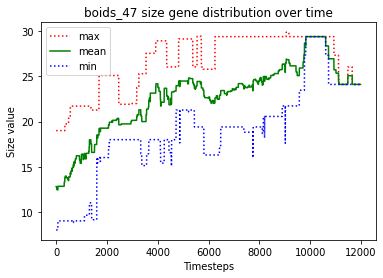

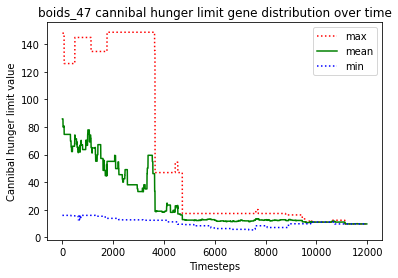

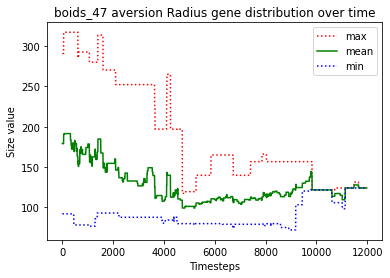

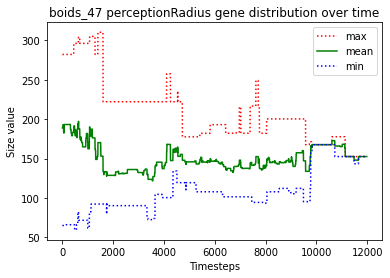

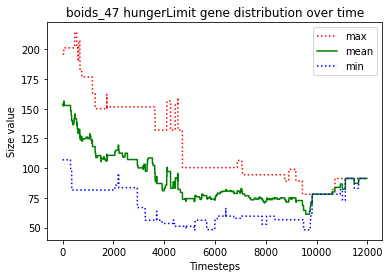





						BOIDS_48

predator_1 just gave birth to predator_10
predator_2 killed predator_8
predator_3 just gave birth to predator_11
predator_2 killed predator_0
predator_9 just gave birth to predator_12
predator_9 killed predator_7
predator_11 starved to death
predator_10 ate the carcass of predator_11_carcass
predator_9 just gave birth to predator_13
predator_3 starved to death
predator_1 just gave birth to predator_14
predator_4 ate the carcass of predator_3_carcass
predator_12 starved to death
predator_9 just gave birth to predator_15
predator_5 just gave birth to predator_16
predator_5 ate the carcass of predator_12_carcass
predator_9 starved to death
predator_4 ate the carcass of predator_9_carcass
predator_15 starved to death
predator_4 ate the carcass of predator_15_carcass
predator_2 just gave birth to predator_17
predator_1 starved to death
predator_17 ate the carcass of predator_1_carcass
predator_17 just gave birth to predator_18
predator_16 starved to death
predator_10 jus

predator_57 just gave birth to predator_67
predator_54 starved to death
predator_61 starved to death
predator_67 starved to death
predator_57 starved to death
predator_56 ate the carcass of predator_57_carcass
predator_56 ate the carcass of predator_54_carcass
predator_56 just gave birth to predator_68
predator_68 starved to death
predator_56 starved to death


finished this run because predators went extinct
Fish left: 0
Sharks left: 0
Dead sharks: 69
Timesteps passed: 8206
Fish went extinct at timestep 7146
Sharks went extinct at timestep 8206


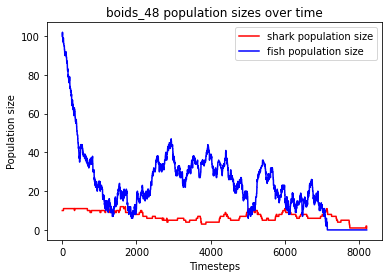

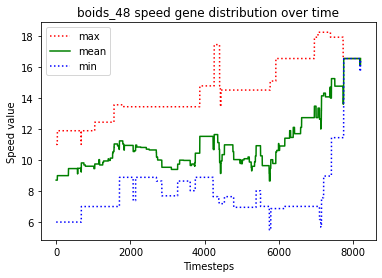

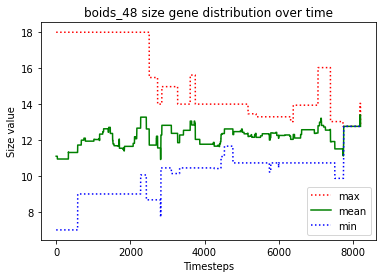

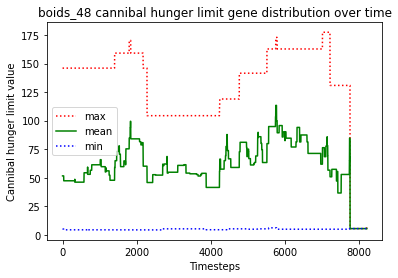

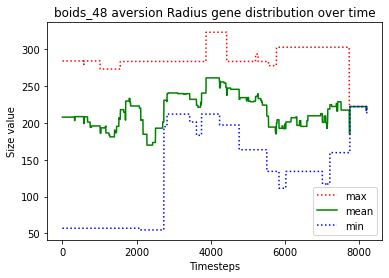

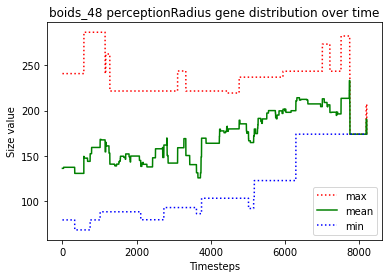

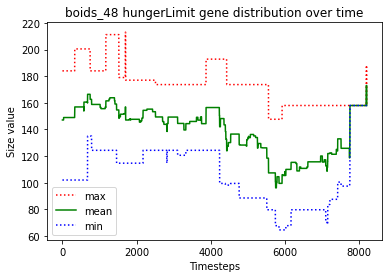





						BOIDS_49

predator_2 just gave birth to predator_10
predator_2 just gave birth to predator_11
predator_2 killed predator_9
predator_7 just gave birth to predator_12
predator_7 killed predator_6
predator_7 just gave birth to predator_13
predator_10 just gave birth to predator_14
predator_5 just gave birth to predator_15
predator_14 starved to death
predator_15 killed predator_11
predator_10 starved to death
predator_12 ate the carcass of predator_14_carcass
predator_12 ate the carcass of predator_10_carcass
predator_8 just gave birth to predator_16
predator_15 killed predator_16
predator_0 just gave birth to predator_17
predator_15 just gave birth to predator_18
predator_5 killed predator_13
predator_1 just gave birth to predator_19
predator_18 killed predator_8
predator_18 killed predator_4
predator_15 killed predator_7
predator_18 killed predator_2
predator_15 killed predator_1
predator_3 just gave birth to predator_20
predator_18 killed predator_17
predator_20 just gave bir

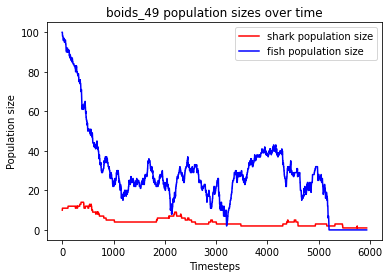

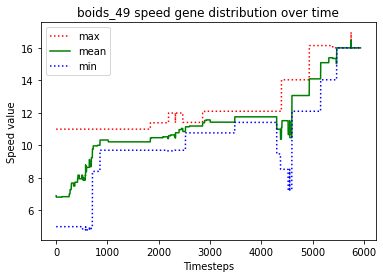

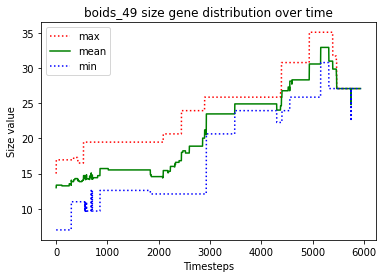

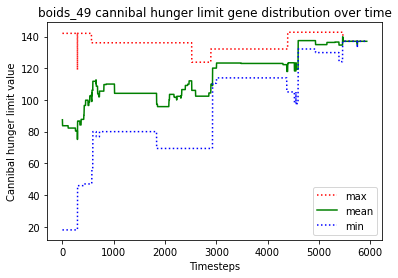

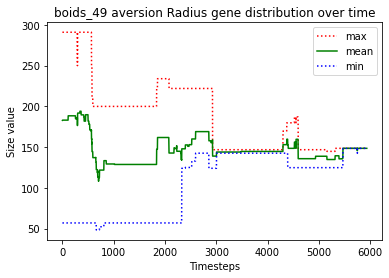

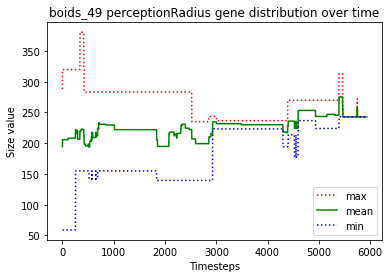

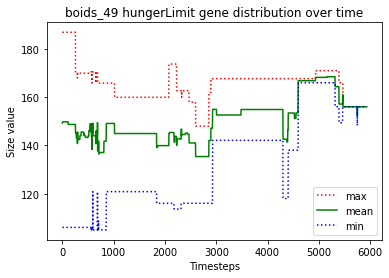





						BOIDS_50

predator_0 just gave birth to predator_10
predator_0 just gave birth to predator_11
predator_3 just gave birth to predator_12
predator_2 just gave birth to predator_13
predator_13 killed predator_8
predator_11 just gave birth to predator_14
predator_2 killed predator_6
predator_13 killed predator_4
predator_13 just gave birth to predator_15
predator_1 just gave birth to predator_16
predator_1 killed predator_16
predator_0 starved to death
predator_5 ate the carcass of predator_0_carcass
predator_1 just gave birth to predator_17
predator_14 starved to death
predator_11 ate the carcass of predator_14_carcass
predator_11 just gave birth to predator_18
predator_3 just gave birth to predator_19
predator_1 just gave birth to predator_20
predator_3 starved to death
predator_15 ate the carcass of predator_3_carcass
predator_18 starved to death
predator_5 just gave birth to predator_21
predator_2 ate the carcass of predator_18_carcass
predator_7 just gave birth to predator_2

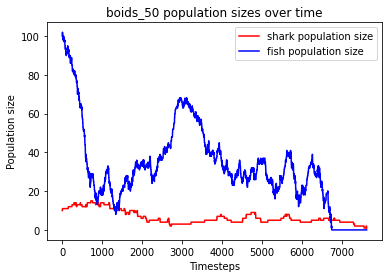

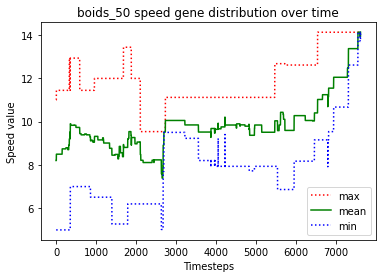

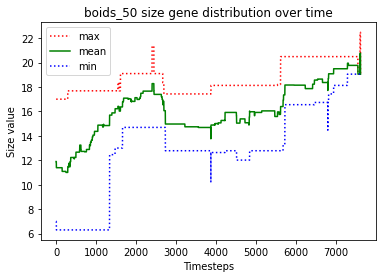

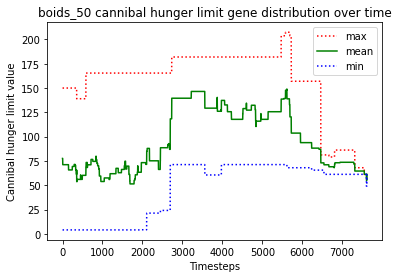

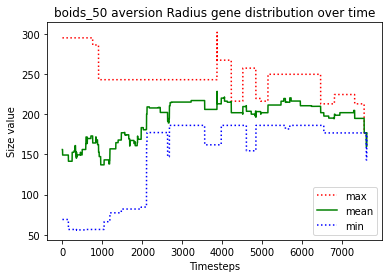

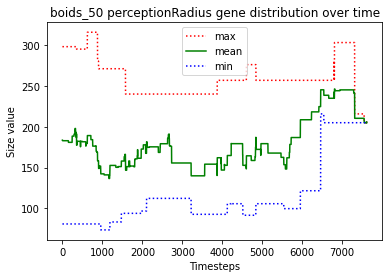

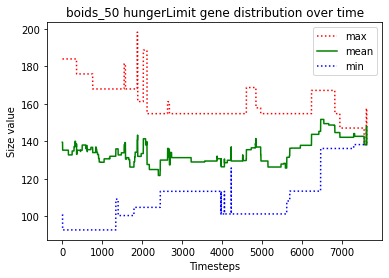





						BOIDS_51

predator_7 just gave birth to predator_10
predator_3 just gave birth to predator_11
predator_3 killed predator_8
predator_3 just gave birth to predator_12
predator_3 killed predator_0
predator_9 just gave birth to predator_13
predator_9 killed predator_13
predator_11 just gave birth to predator_14
predator_11 starved to death
predator_14 starved to death
predator_10 ate the carcass of predator_11_carcass
predator_2 ate the carcass of predator_14_carcass
predator_12 starved to death
predator_4 ate the carcass of predator_12_carcass
predator_6 just gave birth to predator_15
predator_4 just gave birth to predator_16
predator_15 killed predator_5
predator_6 just gave birth to predator_17
predator_6 killed predator_4
predator_6 killed predator_16
predator_7 just gave birth to predator_18
predator_17 killed predator_3
predator_17 killed predator_1
predator_10 just gave birth to predator_19
predator_9 starved to death
predator_18 ate the carcass of predator_9_carcass
preda

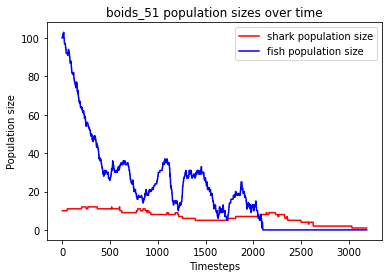

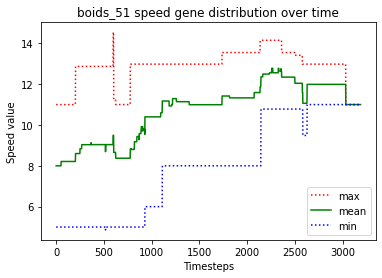

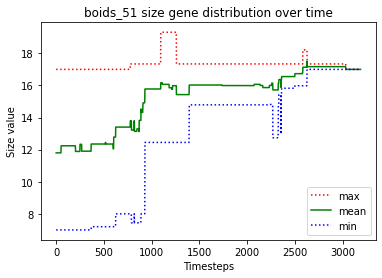

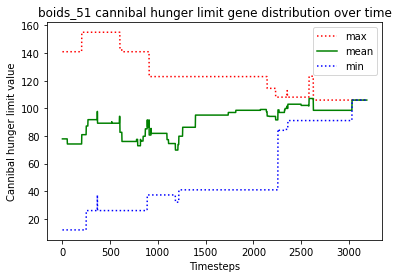

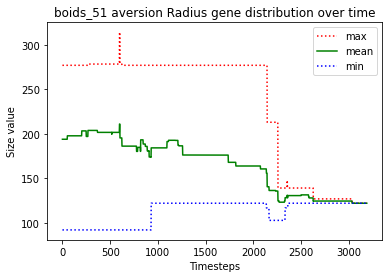

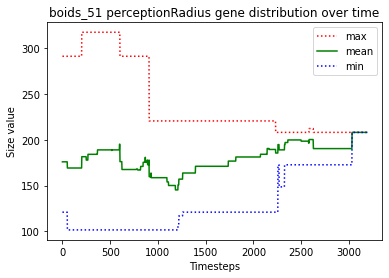

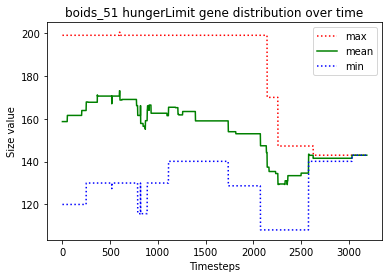





						BOIDS_52

predator_2 just gave birth to predator_10
predator_3 just gave birth to predator_11
predator_9 just gave birth to predator_12
predator_8 just gave birth to predator_13
predator_13 killed predator_7
predator_3 killed predator_12
predator_13 killed predator_10
predator_8 just gave birth to predator_14
predator_0 just gave birth to predator_15
predator_3 just gave birth to predator_16
predator_8 killed predator_1
predator_15 killed predator_2
predator_14 starved to death
predator_16 ate the carcass of predator_14_carcass
predator_0 just gave birth to predator_17
predator_15 killed predator_9
predator_11 just gave birth to predator_18
predator_15 killed predator_4
predator_11 starved to death
predator_17 starved to death
predator_18 starved to death
predator_13 ate the carcass of predator_17_carcass
predator_8 ate the carcass of predator_11_carcass
predator_0 starved to death
predator_8 ate the carcass of predator_18_carcass
predator_8 ate the carcass of predator_0_carc

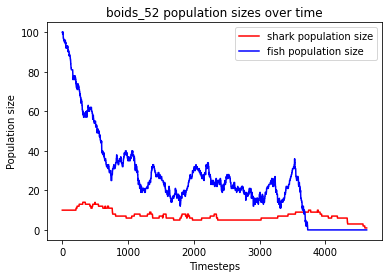

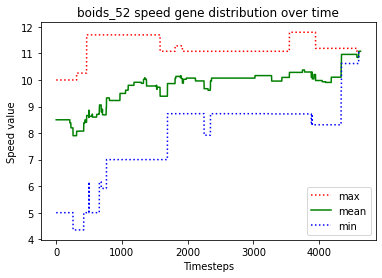

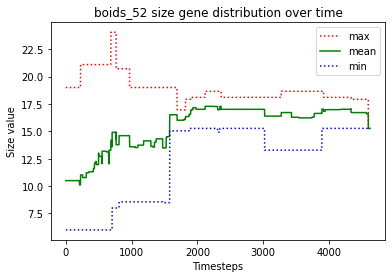

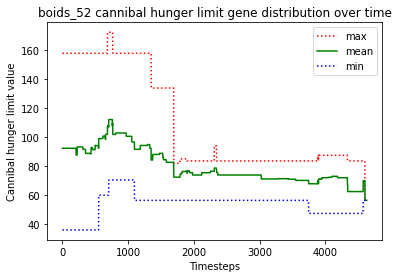

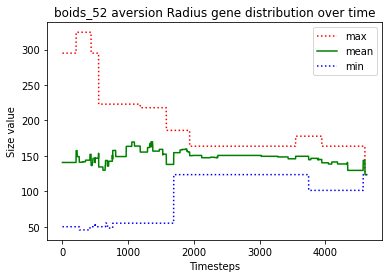

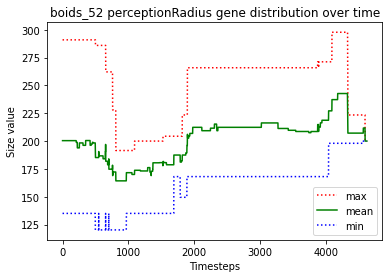

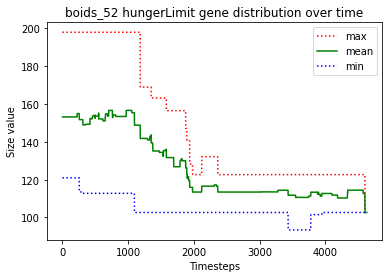





						BOIDS_53

predator_0 just gave birth to predator_10
predator_8 just gave birth to predator_11
predator_7 just gave birth to predator_12
predator_9 just gave birth to predator_13
predator_2 just gave birth to predator_14
predator_13 just gave birth to predator_15
predator_3 just gave birth to predator_16
predator_3 just gave birth to predator_17
predator_1 just gave birth to predator_18
predator_10 just gave birth to predator_19
predator_17 killed predator_12
predator_1 killed predator_15
predator_5 just gave birth to predator_20
predator_19 starved to death
predator_10 starved to death
predator_1 ate the carcass of predator_10_carcass
predator_18 ate the carcass of predator_19_carcass
predator_1 killed predator_16
predator_6 just gave birth to predator_21
predator_1 killed predator_21
predator_1 killed predator_6
predator_14 starved to death
predator_11 starved to death
predator_3 killed predator_8
predator_7 ate the carcass of predator_14_carcass
predator_13 ate the carcass 

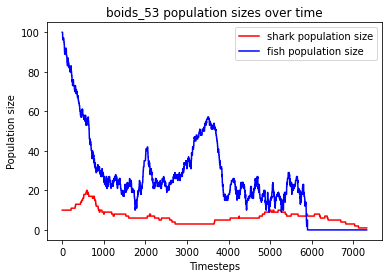

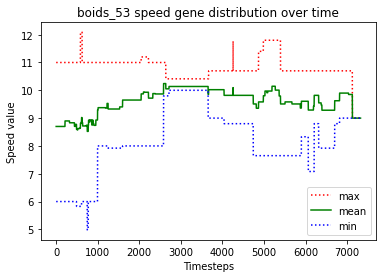

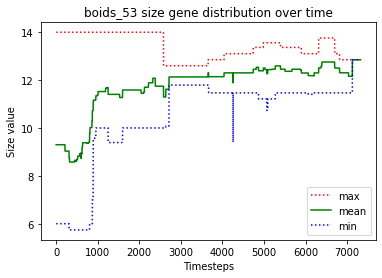

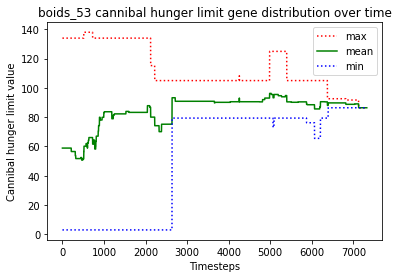

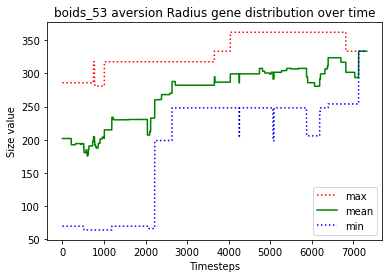

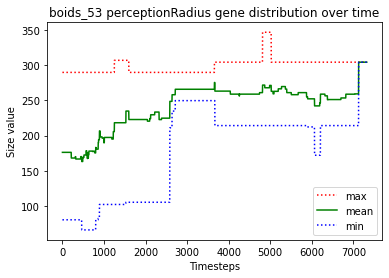

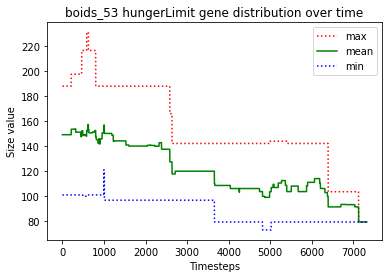





						BOIDS_54

predator_8 just gave birth to predator_10
predator_1 just gave birth to predator_11
predator_8 just gave birth to predator_12
predator_6 just gave birth to predator_13
predator_8 starved to death
predator_4 just gave birth to predator_14
predator_12 ate the carcass of predator_8_carcass
predator_1 just gave birth to predator_15
predator_1 starved to death
predator_15 starved to death
predator_5 ate the carcass of predator_15_carcass
predator_10 starved to death
predator_12 ate the carcass of predator_10_carcass
predator_11 ate the carcass of predator_1_carcass
predator_4 killed predator_14
predator_4 killed predator_13
predator_6 starved to death
predator_9 ate the carcass of predator_6_carcass
predator_4 killed predator_5
predator_7 just gave birth to predator_16
predator_16 just gave birth to predator_17
predator_4 killed predator_0
predator_4 killed predator_16
predator_4 killed predator_17
predator_12 just gave birth to predator_18
predator_18 starved to death
p

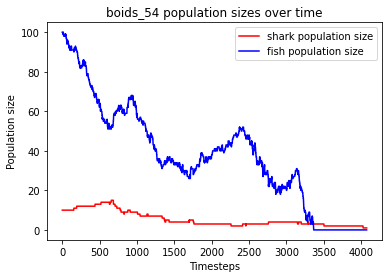

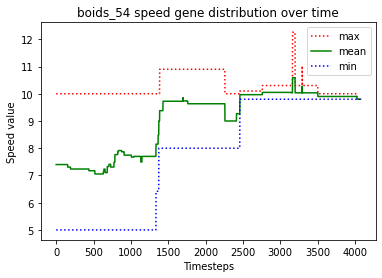

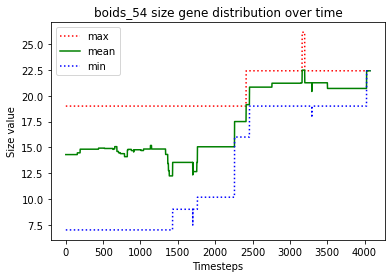

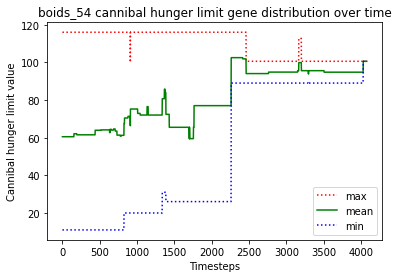

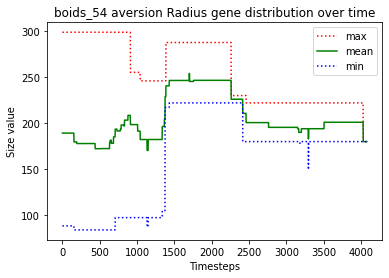

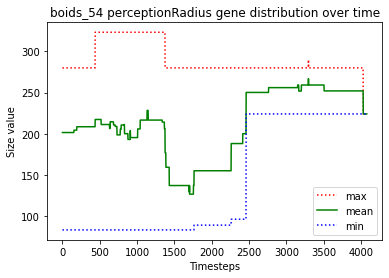

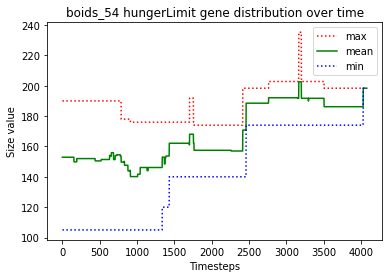





						BOIDS_55

predator_2 just gave birth to predator_10
predator_9 just gave birth to predator_11
predator_1 just gave birth to predator_12
predator_0 just gave birth to predator_13
predator_9 killed predator_6
predator_13 just gave birth to predator_14
predator_13 killed predator_8
predator_10 just gave birth to predator_15
predator_7 just gave birth to predator_16
predator_14 just gave birth to predator_17
predator_0 just gave birth to predator_18
predator_0 just gave birth to predator_19
predator_14 starved to death
predator_17 starved to death
predator_12 starved to death
predator_9 ate the carcass of predator_14_carcass
predator_7 ate the carcass of predator_12_carcass
predator_5 ate the carcass of predator_17_carcass
predator_19 starved to death
predator_18 ate the carcass of predator_19_carcass
predator_0 starved to death
predator_18 ate the carcass of predator_0_carcass
predator_15 starved to death
predator_10 starved to death
predator_2 just gave birth to predator_20
pre

predator_70 killed predator_69
predator_70 killed predator_55
predator_58 just gave birth to predator_72
predator_44 just gave birth to predator_73
predator_44 killed predator_73
predator_65 starved to death
predator_66 ate the carcass of predator_65_carcass
predator_58 starved to death
predator_62 ate the carcass of predator_58_carcass
predator_71 starved to death
predator_68 just gave birth to predator_74
predator_70 ate the carcass of predator_71_carcass
predator_70 just gave birth to predator_75
predator_66 starved to death
predator_68 ate the carcass of predator_66_carcass
predator_75 killed predator_44
predator_68 just gave birth to predator_76
predator_62 just gave birth to predator_77
predator_74 starved to death
predator_76 ate the carcass of predator_74_carcass
predator_75 killed predator_62
predator_70 just gave birth to predator_78
predator_75 just gave birth to predator_79
predator_75 killed predator_76
predator_79 killed predator_77
predator_75 killed predator_68
predator

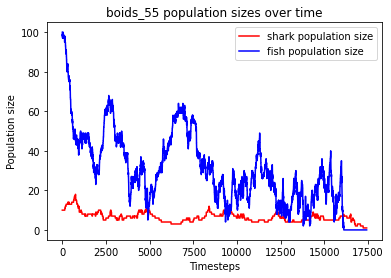

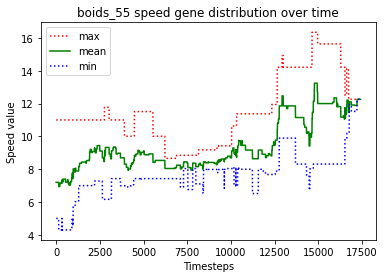

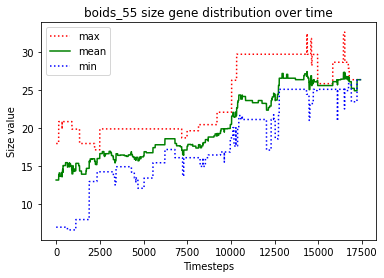

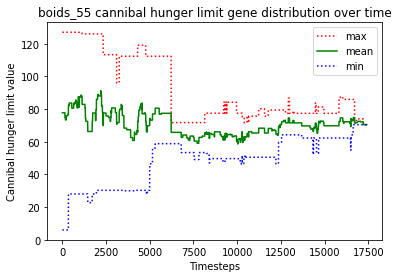

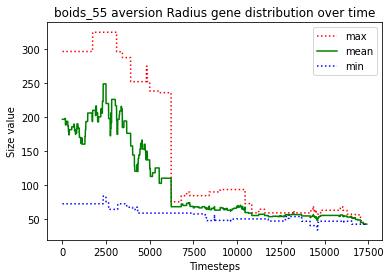

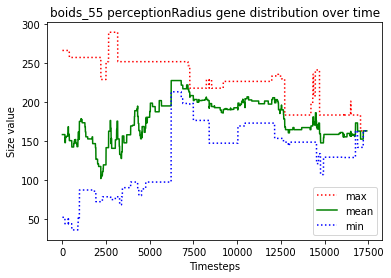

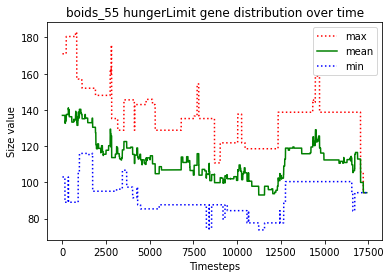





						BOIDS_56

predator_2 just gave birth to predator_10
predator_9 just gave birth to predator_11
predator_11 killed predator_4
predator_10 just gave birth to predator_12
predator_8 killed predator_10
predator_5 just gave birth to predator_13
predator_12 starved to death
predator_11 ate the carcass of predator_12_carcass
predator_3 just gave birth to predator_14
predator_9 just gave birth to predator_15
predator_11 just gave birth to predator_16
predator_16 starved to death
predator_11 ate the carcass of predator_16_carcass
predator_11 just gave birth to predator_17
predator_9 just gave birth to predator_18
predator_11 starved to death
predator_17 ate the carcass of predator_11_carcass
predator_8 just gave birth to predator_19
predator_18 starved to death
predator_15 starved to death
predator_9 ate the carcass of predator_15_carcass
predator_9 just gave birth to predator_20
predator_20 ate the carcass of predator_18_carcass
predator_1 just gave birth to predator_21
predator_7 jus

predator_57 starved to death
predator_67 starved to death
predator_50 ate the carcass of predator_57_carcass
predator_50 ate the carcass of predator_67_carcass
predator_60 starved to death
predator_65 starved to death
predator_62 just gave birth to predator_68
predator_50 ate the carcass of predator_65_carcass
predator_62 starved to death
predator_50 starved to death
predator_68 starved to death


finished this run because predators went extinct
Fish left: 0
Sharks left: 0
Dead sharks: 69
Timesteps passed: 12660
Fish went extinct at timestep 11661
Sharks went extinct at timestep 12660


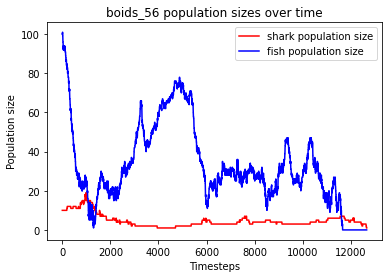

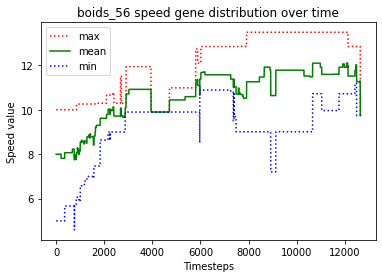

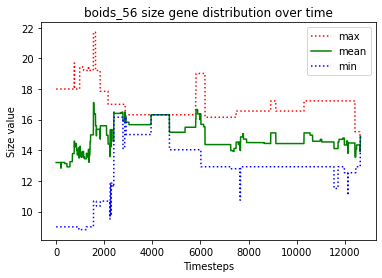

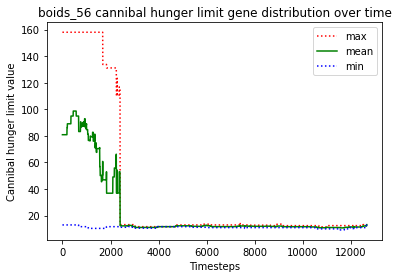

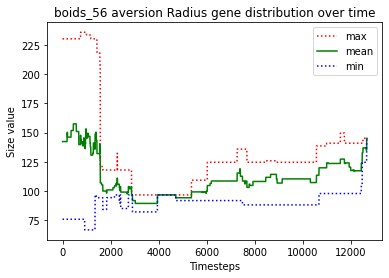

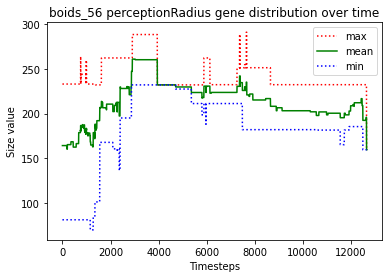

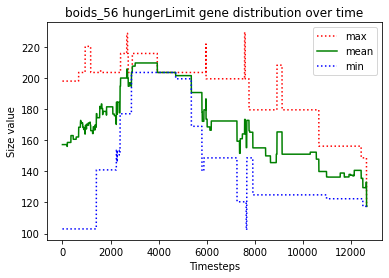





						BOIDS_57

predator_6 just gave birth to predator_10
predator_8 just gave birth to predator_11
predator_8 killed predator_9
predator_11 just gave birth to predator_12
predator_4 just gave birth to predator_13
predator_12 just gave birth to predator_14
predator_13 just gave birth to predator_15
predator_10 just gave birth to predator_16
predator_3 just gave birth to predator_17
predator_17 killed predator_0
predator_16 starved to death
predator_4 ate the carcass of predator_16_carcass
predator_17 killed predator_15
predator_13 starved to death
predator_14 starved to death
predator_17 ate the carcass of predator_14_carcass
predator_12 ate the carcass of predator_13_carcass
predator_10 starved to death
predator_12 ate the carcass of predator_10_carcass
predator_3 just gave birth to predator_18
predator_18 killed predator_6
predator_8 starved to death
predator_18 ate the carcass of predator_8_carcass
predator_4 just gave birth to predator_19
predator_12 starved to death
predator_4

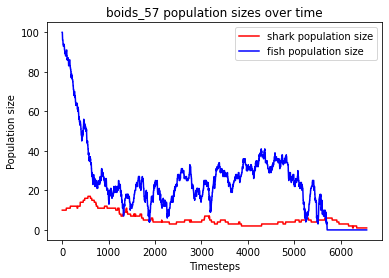

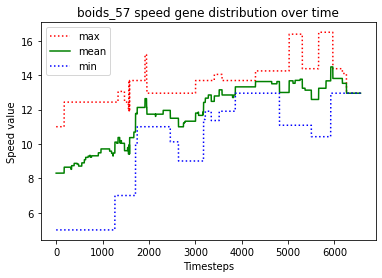

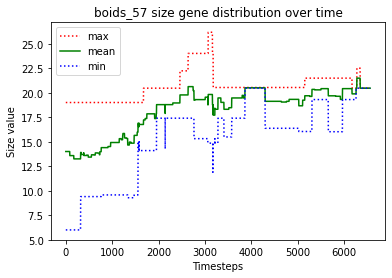

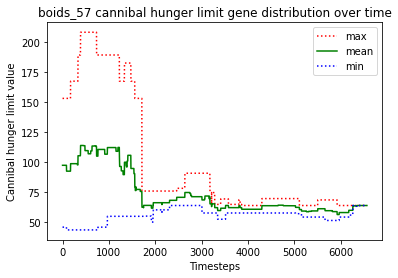

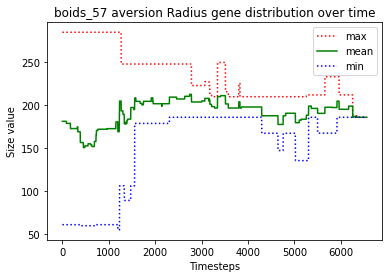

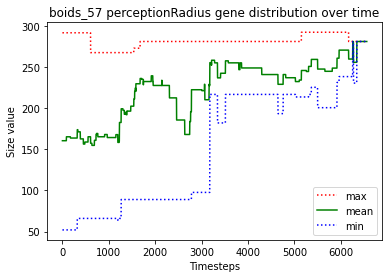

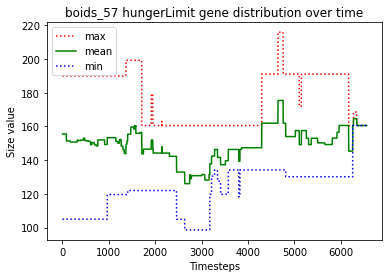





						BOIDS_58

predator_3 just gave birth to predator_10
predator_3 just gave birth to predator_11
predator_3 killed predator_5
predator_1 just gave birth to predator_12
predator_3 killed predator_0
predator_6 killed predator_9
predator_6 killed predator_7
predator_1 just gave birth to predator_13
predator_10 just gave birth to predator_14
predator_8 just gave birth to predator_15
predator_13 starved to death
predator_6 ate the carcass of predator_13_carcass
predator_10 just gave birth to predator_16
predator_8 starved to death
predator_3 ate the carcass of predator_8_carcass
predator_1 starved to death
predator_10 just gave birth to predator_17
predator_10 killed predator_4
predator_12 ate the carcass of predator_1_carcass
predator_2 just gave birth to predator_18
predator_17 starved to death
predator_16 killed predator_11
predator_3 ate the carcass of predator_17_carcass
predator_10 killed predator_2
predator_10 killed predator_18
predator_14 just gave birth to predator_19
preda

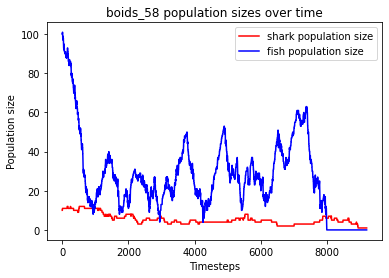

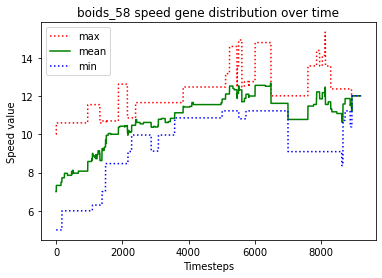

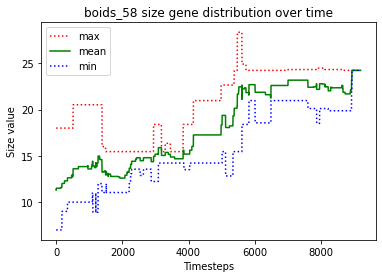

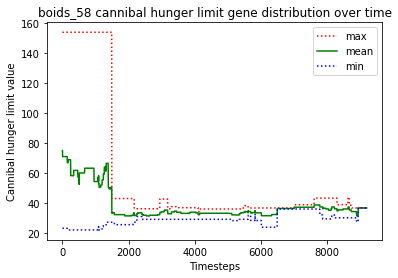

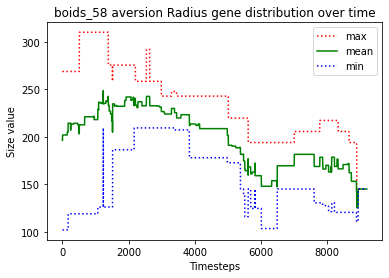

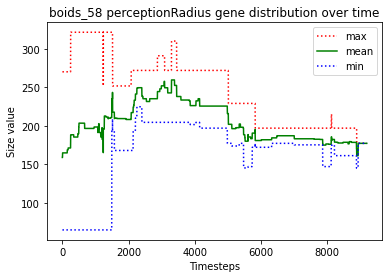

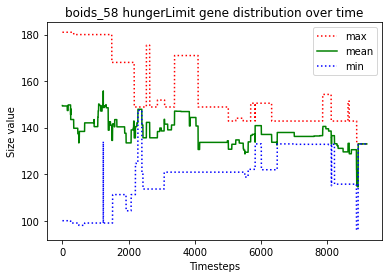





						BOIDS_59

predator_9 just gave birth to predator_10
predator_1 just gave birth to predator_11
predator_9 just gave birth to predator_12
predator_2 just gave birth to predator_13
predator_4 just gave birth to predator_14
predator_14 just gave birth to predator_15
predator_14 killed predator_13
predator_12 just gave birth to predator_16
predator_16 starved to death
predator_14 killed predator_11
predator_8 ate the carcass of predator_16_carcass
predator_8 just gave birth to predator_17
predator_12 starved to death
predator_1 just gave birth to predator_18
predator_7 ate the carcass of predator_12_carcass
predator_1 starved to death
predator_18 starved to death
predator_9 ate the carcass of predator_18_carcass
predator_15 starved to death
predator_14 ate the carcass of predator_15_carcass
predator_7 ate the carcass of predator_1_carcass
predator_4 just gave birth to predator_19
predator_4 killed predator_3
predator_9 starved to death
predator_2 starved to death
predator_14 ate t

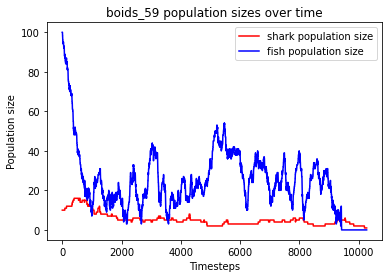

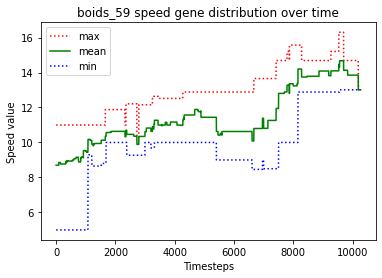

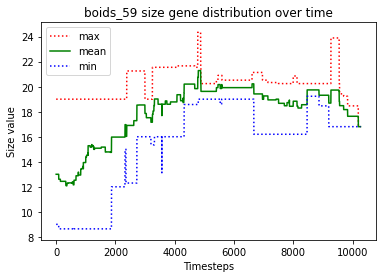

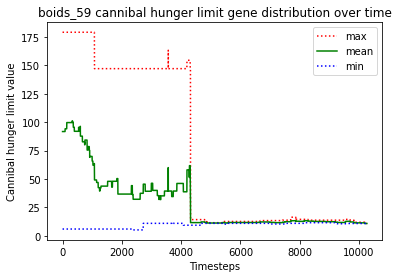

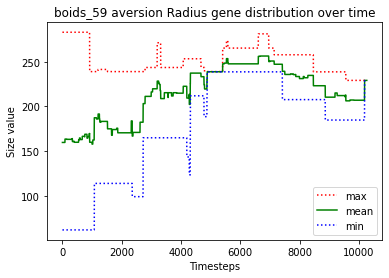

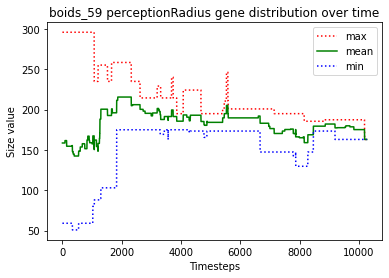

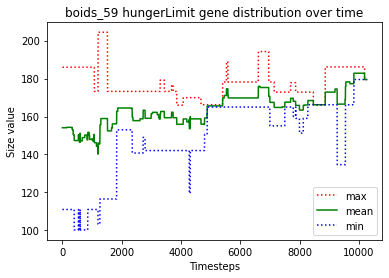





						BOIDS_60

predator_5 just gave birth to predator_10
predator_5 just gave birth to predator_11
predator_6 just gave birth to predator_12
predator_9 just gave birth to predator_13
predator_9 killed predator_13
predator_3 just gave birth to predator_14
predator_6 just gave birth to predator_15
predator_12 killed predator_11
predator_12 killed predator_5
predator_6 just gave birth to predator_16
predator_15 just gave birth to predator_17
predator_0 just gave birth to predator_18
predator_15 just gave birth to predator_19
predator_16 starved to death
predator_17 starved to death
predator_9 ate the carcass of predator_16_carcass
predator_0 ate the carcass of predator_17_carcass
predator_19 starved to death
predator_8 ate the carcass of predator_19_carcass
predator_14 killed predator_1
predator_0 just gave birth to predator_20
predator_15 starved to death
predator_18 just gave birth to predator_21
predator_14 just gave birth to predator_22
predator_10 starved to death
predator_9 ate

predator_68 just gave birth to predator_71
predator_71 just gave birth to predator_72
predator_60 ate the carcass of predator_69_carcass
predator_53 starved to death
predator_72 starved to death
predator_71 starved to death
predator_38 just gave birth to predator_73
predator_60 ate the carcass of predator_72_carcass
predator_60 ate the carcass of predator_71_carcass
predator_68 starved to death
predator_60 ate the carcass of predator_68_carcass
predator_38 ate the carcass of predator_53_carcass
predator_73 starved to death
predator_38 ate the carcass of predator_73_carcass
predator_38 killed predator_60
predator_38 starved to death


finished this run because predators went extinct
Fish left: 0
Sharks left: 0
Dead sharks: 74
Timesteps passed: 9572
Fish went extinct at timestep 6879
Sharks went extinct at timestep 9572


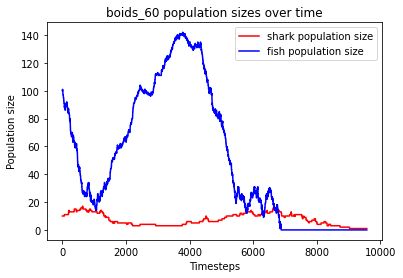

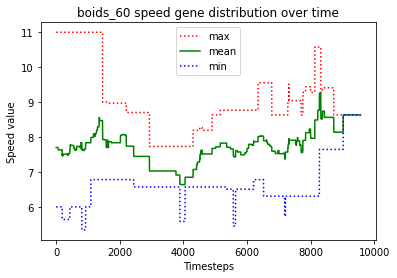

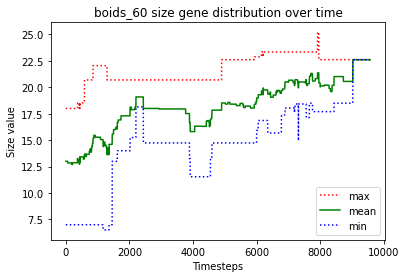

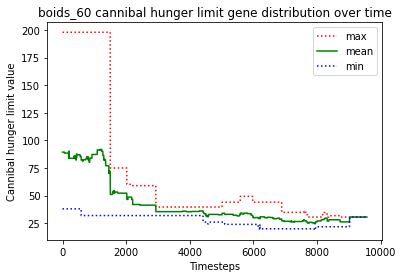

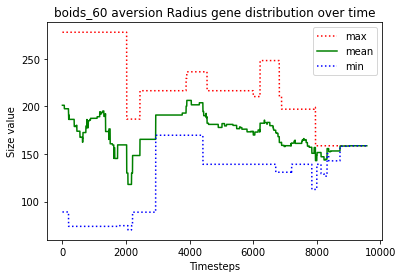

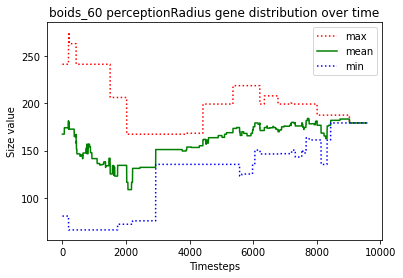

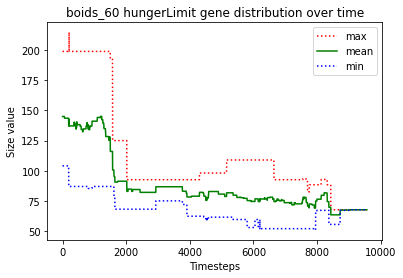





						BOIDS_61

predator_9 just gave birth to predator_10
predator_8 just gave birth to predator_11
predator_7 just gave birth to predator_12
predator_9 just gave birth to predator_13
predator_9 just gave birth to predator_14
predator_7 killed predator_1
predator_13 just gave birth to predator_15
predator_12 just gave birth to predator_16
predator_9 starved to death
predator_16 starved to death
predator_12 starved to death
predator_15 ate the carcass of predator_9_carcass
predator_6 ate the carcass of predator_12_carcass
predator_10 ate the carcass of predator_16_carcass
predator_13 starved to death
predator_10 ate the carcass of predator_13_carcass
predator_4 just gave birth to predator_17
predator_14 starved to death
predator_15 killed predator_7
predator_15 just gave birth to predator_18
predator_15 starved to death
predator_18 starved to death
predator_6 ate the carcass of predator_15_carcass
predator_2 just gave birth to predator_19
predator_10 ate the carcass of predator_14_c

predator_68 just gave birth to predator_69
predator_69 starved to death
predator_68 ate the carcass of predator_69_carcass
predator_68 just gave birth to predator_70
predator_67 starved to death
predator_70 ate the carcass of predator_67_carcass
predator_68 just gave birth to predator_71
predator_70 ate the carcass of predator_66_carcass
predator_65 starved to death
predator_63 ate the carcass of predator_65_carcass
predator_63 just gave birth to predator_72
predator_63 starved to death
predator_72 starved to death
predator_70 just gave birth to predator_73
predator_70 killed predator_71
predator_73 ate the carcass of predator_72_carcass
predator_73 ate the carcass of predator_63_carcass
predator_68 starved to death
predator_73 ate the carcass of predator_68_carcass
predator_70 just gave birth to predator_74
predator_74 just gave birth to predator_75
predator_73 just gave birth to predator_76
predator_70 just gave birth to predator_77
predator_75 starved to death
predator_74 ate the ca

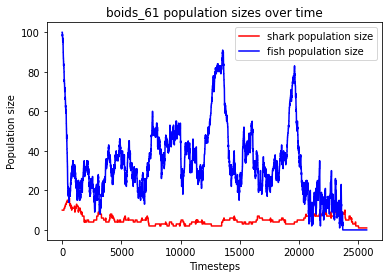

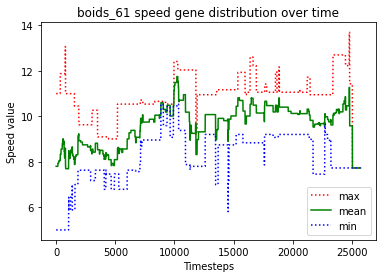

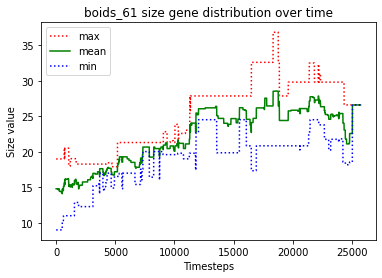

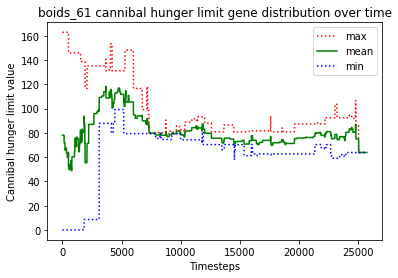

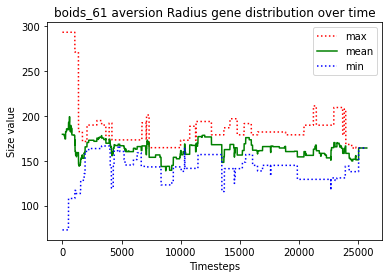

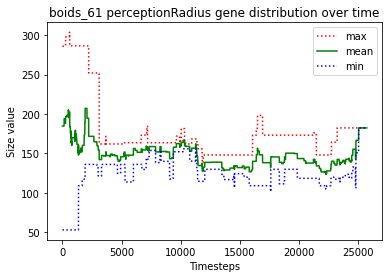

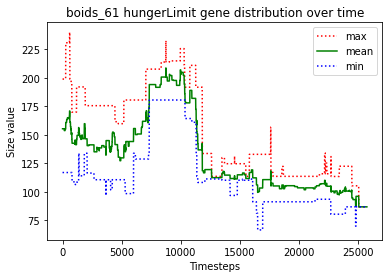





						BOIDS_62

predator_3 just gave birth to predator_10
predator_5 just gave birth to predator_11
predator_1 just gave birth to predator_12
predator_10 killed predator_6
predator_3 just gave birth to predator_13
predator_2 just gave birth to predator_14
predator_13 starved to death
predator_1 ate the carcass of predator_13_carcass
predator_12 killed predator_9
predator_3 starved to death
predator_1 ate the carcass of predator_3_carcass
predator_7 just gave birth to predator_15
predator_11 starved to death
predator_14 ate the carcass of predator_11_carcass
predator_4 just gave birth to predator_16
predator_5 starved to death
predator_2 ate the carcass of predator_5_carcass
predator_8 just gave birth to predator_17
predator_8 just gave birth to predator_18
predator_4 killed predator_0
predator_4 killed predator_7
predator_8 starved to death
predator_1 just gave birth to predator_19
predator_18 starved to death
predator_16 killed predator_17
predator_16 ate the carcass of predator_8

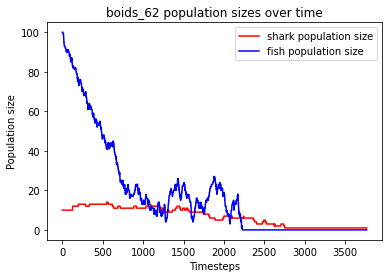

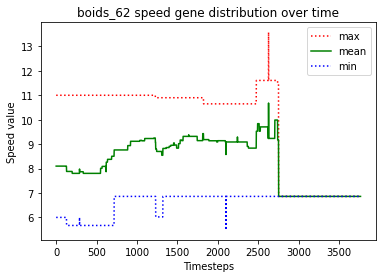

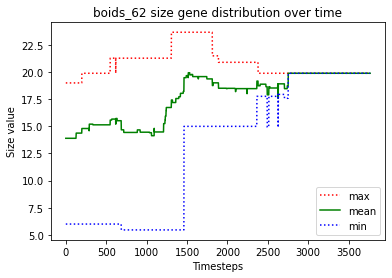

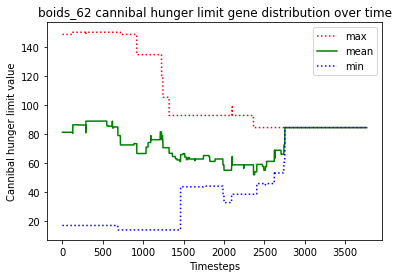

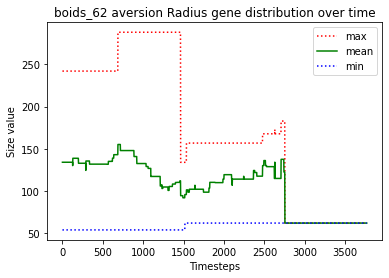

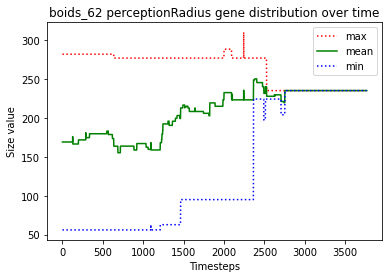

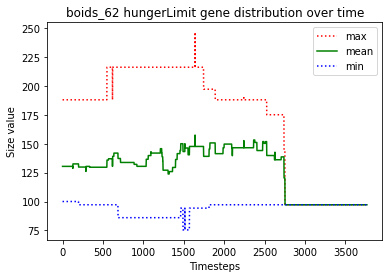





						BOIDS_63

predator_6 just gave birth to predator_10
predator_0 just gave birth to predator_11
predator_6 just gave birth to predator_12
predator_10 just gave birth to predator_13
predator_12 starved to death
predator_8 ate the carcass of predator_12_carcass
predator_1 just gave birth to predator_14
predator_8 just gave birth to predator_15
predator_0 just gave birth to predator_16
predator_10 starved to death
predator_8 ate the carcass of predator_10_carcass
predator_6 starved to death
predator_9 killed predator_3
predator_4 ate the carcass of predator_6_carcass
predator_16 starved to death
predator_2 ate the carcass of predator_16_carcass
predator_5 just gave birth to predator_17
predator_5 killed predator_17
predator_7 just gave birth to predator_18
predator_0 starved to death
predator_14 ate the carcass of predator_0_carcass
predator_13 starved to death
predator_8 ate the carcass of predator_13_carcass
predator_11 starved to death
predator_7 starved to death
predator_18 at

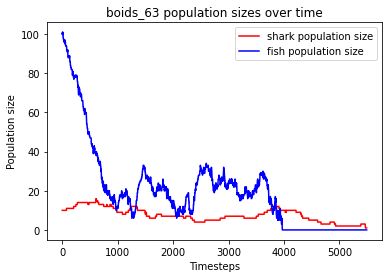

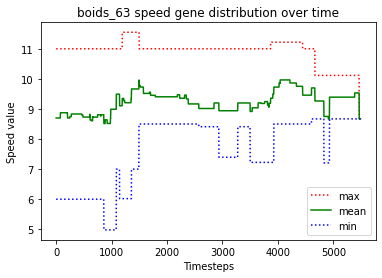

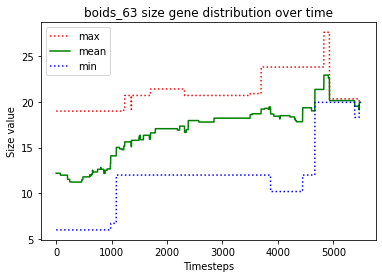

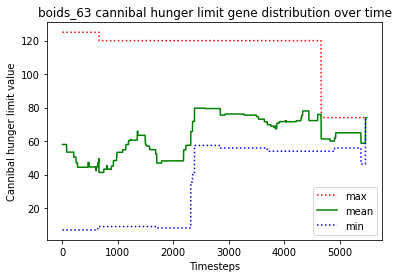

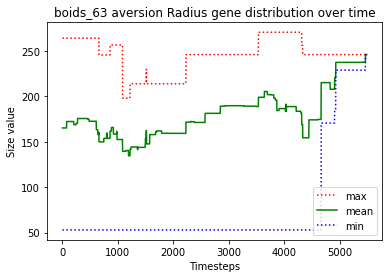

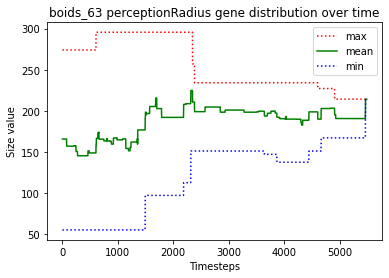

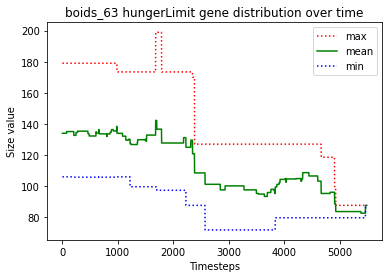





						BOIDS_64

predator_8 just gave birth to predator_10
predator_7 just gave birth to predator_11
predator_7 killed predator_3
predator_11 killed predator_9
predator_7 killed predator_0
predator_7 killed predator_6
predator_1 just gave birth to predator_12
predator_8 just gave birth to predator_13
predator_5 just gave birth to predator_14
predator_14 just gave birth to predator_15
predator_7 killed predator_12
predator_13 just gave birth to predator_16
predator_13 killed predator_16
predator_8 just gave birth to predator_17
predator_11 starved to death
predator_4 ate the carcass of predator_11_carcass
predator_15 starved to death
predator_5 ate the carcass of predator_15_carcass
predator_13 starved to death
predator_2 just gave birth to predator_18
predator_10 starved to death
predator_7 ate the carcass of predator_13_carcass
predator_8 starved to death
predator_14 ate the carcass of predator_8_carcass
predator_18 starved to death
predator_17 starved to death
predator_2 starved t

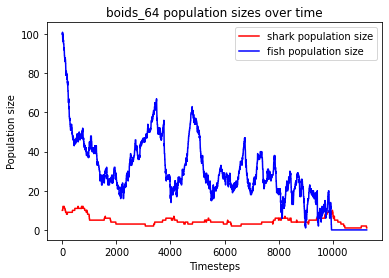

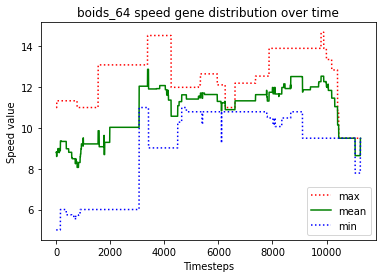

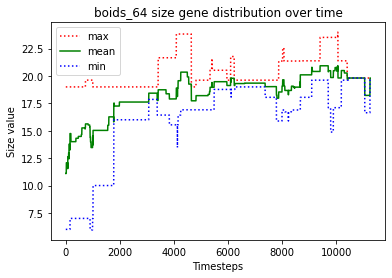

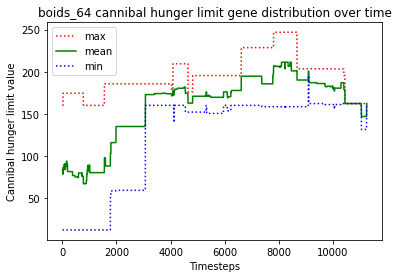

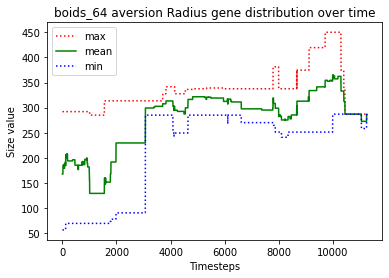

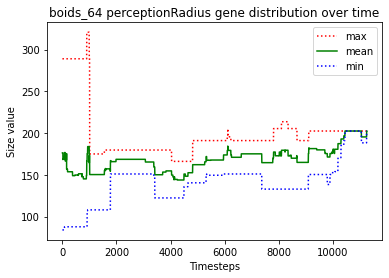

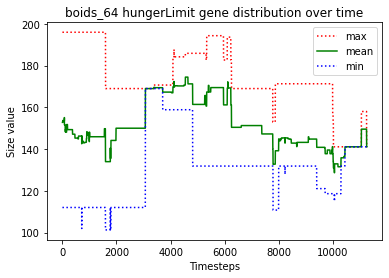





						BOIDS_65

predator_6 just gave birth to predator_10
predator_4 just gave birth to predator_11
predator_5 just gave birth to predator_12
predator_6 starved to death
predator_2 ate the carcass of predator_6_carcass
predator_11 just gave birth to predator_13
predator_8 just gave birth to predator_14
predator_11 just gave birth to predator_15
predator_4 just gave birth to predator_16
predator_10 starved to death
predator_15 starved to death
predator_13 ate the carcass of predator_15_carcass
predator_11 ate the carcass of predator_10_carcass
predator_11 starved to death
predator_4 ate the carcass of predator_11_carcass
predator_12 starved to death
predator_4 just gave birth to predator_17
predator_16 ate the carcass of predator_12_carcass
predator_5 just gave birth to predator_18
predator_14 just gave birth to predator_19
predator_18 starved to death
predator_5 starved to death
predator_3 starved to death
predator_0 ate the carcass of predator_5_carcass
predator_9 ate the carcass 

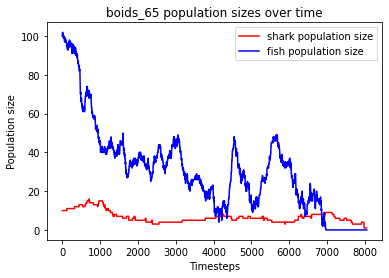

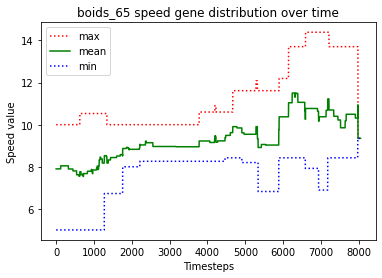

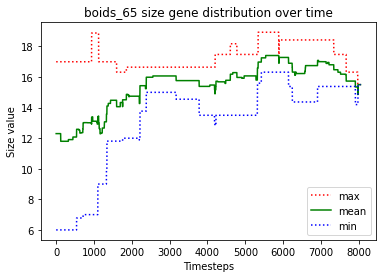

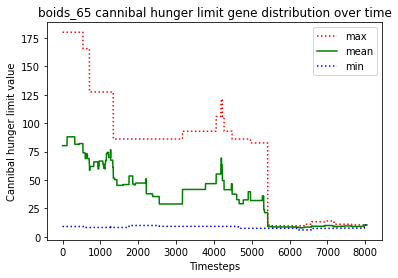

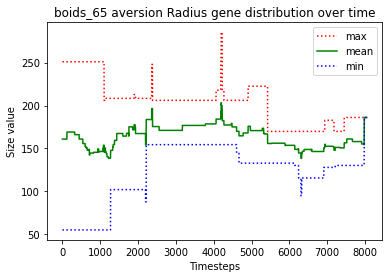

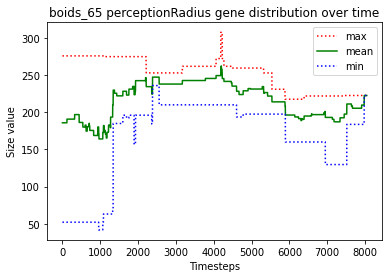

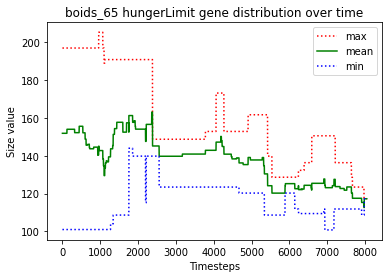





						BOIDS_66

predator_7 just gave birth to predator_10
predator_10 just gave birth to predator_11
predator_1 just gave birth to predator_12
predator_0 just gave birth to predator_13
predator_0 just gave birth to predator_14
predator_10 starved to death
predator_7 ate the carcass of predator_10_carcass
predator_11 starved to death
predator_3 ate the carcass of predator_11_carcass
predator_9 just gave birth to predator_15
predator_14 starved to death
predator_15 just gave birth to predator_16
predator_6 ate the carcass of predator_14_carcass
predator_7 killed predator_4
predator_0 starved to death
predator_16 starved to death
predator_7 ate the carcass of predator_0_carcass
predator_15 starved to death
predator_5 ate the carcass of predator_15_carcass
predator_6 ate the carcass of predator_16_carcass
predator_1 just gave birth to predator_17
predator_2 just gave birth to predator_18
predator_12 starved to death
predator_18 just gave birth to predator_19
predator_7 just gave birth 

predator_58 ate the carcass of predator_69_carcass
predator_56 just gave birth to predator_70
predator_42 ate the carcass of predator_66_carcass
predator_70 starved to death
predator_61 ate the carcass of predator_70_carcass
predator_68 just gave birth to predator_71
predator_68 killed predator_71
predator_56 starved to death
predator_42 just gave birth to predator_72
predator_67 just gave birth to predator_73
predator_72 starved to death
predator_68 ate the carcass of predator_72_carcass
predator_73 ate the carcass of predator_56_carcass
predator_65 starved to death
predator_68 just gave birth to predator_74
predator_58 ate the carcass of predator_65_carcass
predator_42 starved to death
predator_29 just gave birth to predator_75
predator_29 ate the carcass of predator_42_carcass
predator_68 starved to death
predator_61 ate the carcass of predator_68_carcass
predator_60 just gave birth to predator_76
predator_76 just gave birth to predator_77
predator_74 starved to death
predator_77 st

predator_118 starved to death
predator_122 ate the carcass of predator_118_carcass
predator_103 just gave birth to predator_125
predator_103 starved to death
predator_125 starved to death
predator_89 ate the carcass of predator_107_carcass
predator_89 just gave birth to predator_126
predator_89 ate the carcass of predator_103_carcass
predator_126 ate the carcass of predator_125_carcass
predator_89 just gave birth to predator_127
predator_126 killed predator_127
predator_89 starved to death
predator_122 starved to death
predator_126 starved to death


finished this run because predators went extinct
Fish left: 0
Sharks left: 0
Dead sharks: 128
Timesteps passed: 13725
Fish went extinct at timestep 10950
Sharks went extinct at timestep 13725


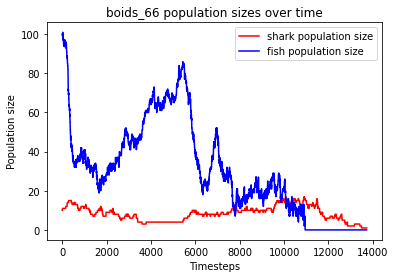

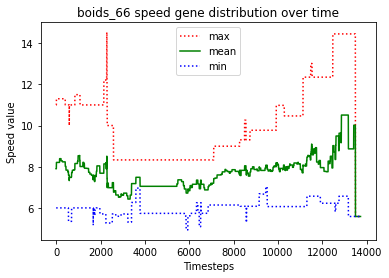

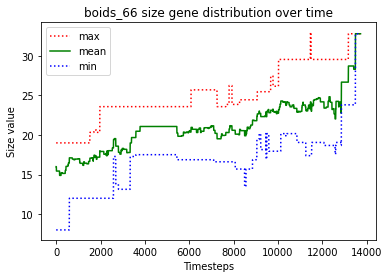

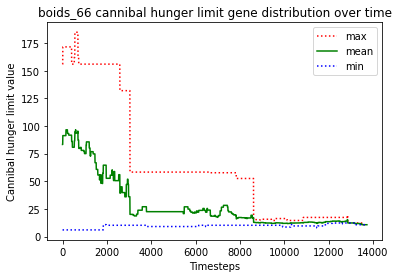

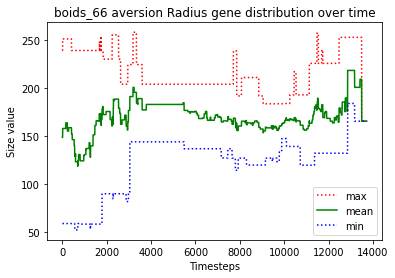

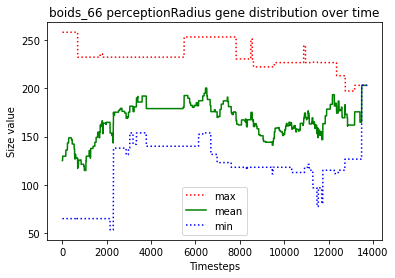

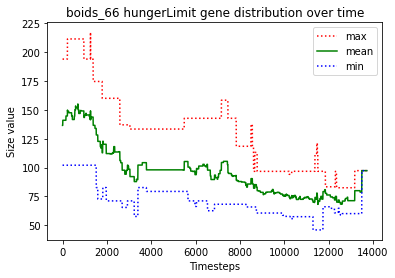





						BOIDS_67

predator_0 killed predator_9
predator_3 just gave birth to predator_10
predator_5 just gave birth to predator_11
predator_11 just gave birth to predator_12
predator_1 just gave birth to predator_13
predator_5 just gave birth to predator_14
predator_11 starved to death
predator_1 just gave birth to predator_15
predator_5 ate the carcass of predator_11_carcass
predator_1 just gave birth to predator_16
predator_13 just gave birth to predator_17
predator_12 starved to death
predator_1 ate the carcass of predator_12_carcass
predator_14 just gave birth to predator_18
predator_14 starved to death
predator_18 starved to death
predator_0 ate the carcass of predator_18_carcass
predator_0 ate the carcass of predator_14_carcass
predator_2 just gave birth to predator_19
predator_1 killed predator_7
predator_17 starved to death
predator_3 starved to death
predator_13 ate the carcass of predator_3_carcass
predator_16 starved to death
predator_0 ate the carcass of predator_17_carca

predator_69 starved to death
predator_72 starved to death
predator_45 ate the carcass of predator_63_carcass
predator_46 ate the carcass of predator_72_carcass
predator_73 just gave birth to predator_75
predator_46 ate the carcass of predator_69_carcass
predator_73 starved to death
predator_46 ate the carcass of predator_73_carcass
predator_75 starved to death
predator_67 ate the carcass of predator_75_carcass
predator_66 starved to death
predator_46 ate the carcass of predator_66_carcass
predator_46 just gave birth to predator_76
predator_68 just gave birth to predator_77
predator_46 killed predator_77
predator_64 just gave birth to predator_78
predator_68 starved to death
predator_45 ate the carcass of predator_68_carcass
predator_62 just gave birth to predator_79
predator_64 starved to death
no fish to move
predator_78 starved to death
predator_67 ate the carcass of predator_64_carcass
predator_76 ate the carcass of predator_78_carcass
predator_45 just gave birth to predator_80
pred

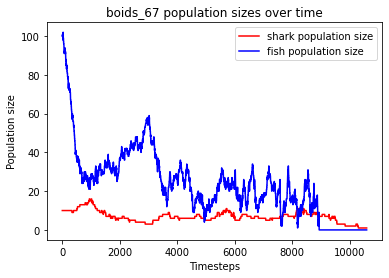

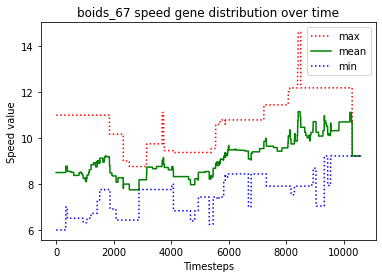

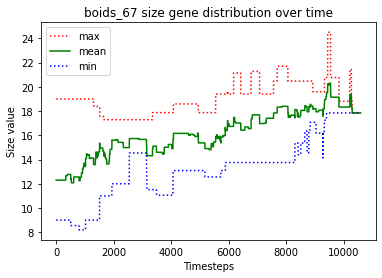

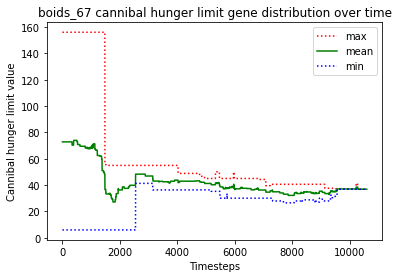

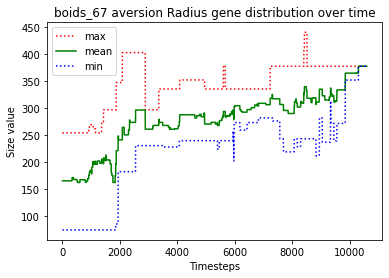

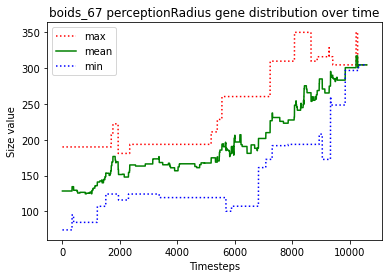

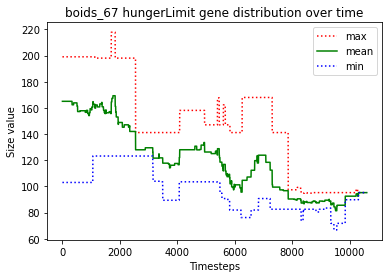





						BOIDS_68

predator_3 just gave birth to predator_10
predator_0 just gave birth to predator_11
predator_11 just gave birth to predator_12
predator_7 just gave birth to predator_13
predator_3 just gave birth to predator_14
predator_12 starved to death
predator_9 ate the carcass of predator_12_carcass
predator_11 starved to death
predator_7 just gave birth to predator_15
predator_4 just gave birth to predator_16
predator_9 just gave birth to predator_17
predator_17 just gave birth to predator_18
predator_1 just gave birth to predator_19
predator_9 ate the carcass of predator_11_carcass
predator_0 just gave birth to predator_20
predator_0 starved to death
predator_20 starved to death
predator_17 just gave birth to predator_21
predator_7 starved to death
predator_14 ate the carcass of predator_20_carcass
predator_15 starved to death
predator_19 ate the carcass of predator_7_carcass
predator_14 ate the carcass of predator_0_carcass
predator_5 killed predator_4
predator_2 ate the ca

predator_65 ate the carcass of predator_53_carcass
predator_57 just gave birth to predator_68
predator_65 just gave birth to predator_69
predator_43 starved to death
predator_64 ate the carcass of predator_43_carcass
predator_68 starved to death
predator_64 ate the carcass of predator_68_carcass
predator_57 starved to death
predator_65 ate the carcass of predator_57_carcass
predator_60 starved to death
predator_65 ate the carcass of predator_60_carcass
predator_69 starved to death
predator_61 just gave birth to predator_70
predator_64 ate the carcass of predator_69_carcass
predator_61 starved to death
predator_70 starved to death
predator_64 just gave birth to predator_71
predator_65 starved to death
predator_64 starved to death
predator_71 ate the carcass of predator_64_carcass
predator_71 ate the carcass of predator_70_carcass
predator_71 ate the carcass of predator_61_carcass
predator_71 just gave birth to predator_72
predator_72 starved to death
predator_71 starved to death


finis

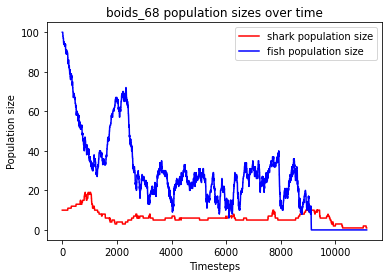

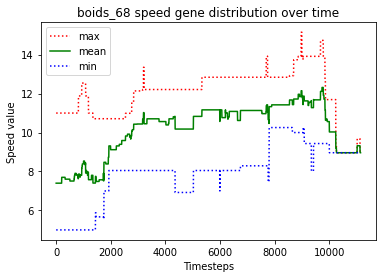

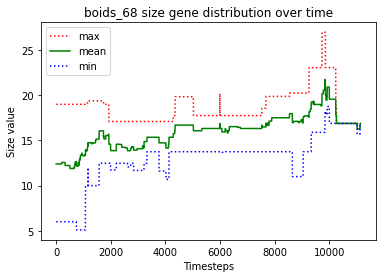

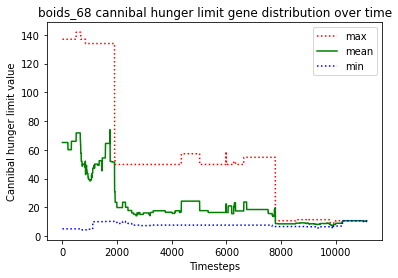

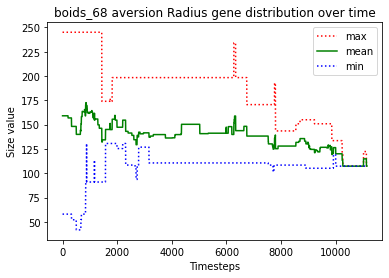

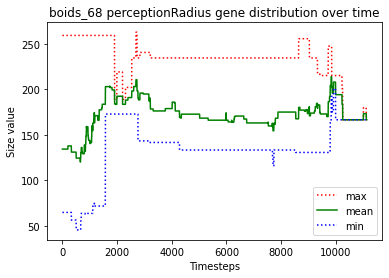

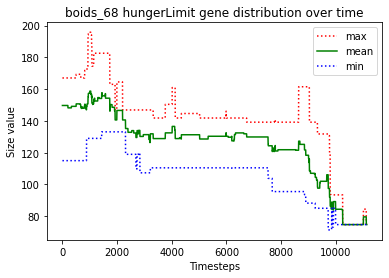





						BOIDS_69

predator_3 just gave birth to predator_10
predator_10 just gave birth to predator_11
predator_3 just gave birth to predator_12
predator_6 just gave birth to predator_13
predator_8 just gave birth to predator_14
predator_7 just gave birth to predator_15
predator_13 just gave birth to predator_16
predator_8 starved to death
predator_3 ate the carcass of predator_8_carcass
predator_11 starved to death
predator_14 starved to death
predator_1 ate the carcass of predator_11_carcass
predator_3 ate the carcass of predator_14_carcass
predator_12 just gave birth to predator_17
predator_15 just gave birth to predator_18
predator_15 starved to death
predator_18 starved to death
predator_9 ate the carcass of predator_18_carcass
predator_0 ate the carcass of predator_15_carcass
predator_7 starved to death
predator_4 ate the carcass of predator_7_carcass
predator_13 starved to death
predator_17 starved to death
predator_4 ate the carcass of predator_13_carcass
predator_16 starved 

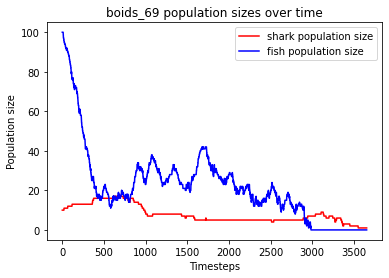

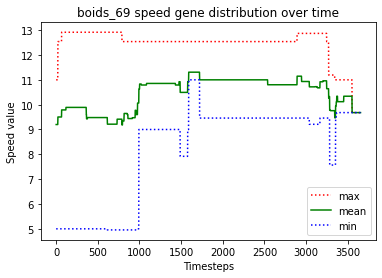

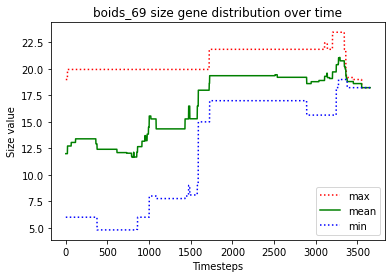

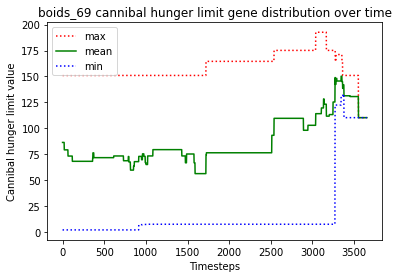

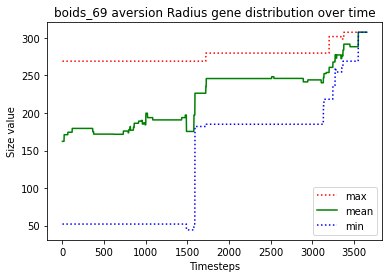

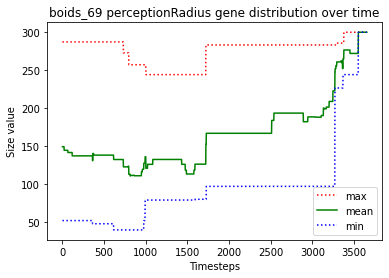

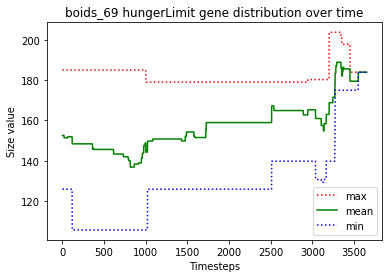





						BOIDS_70

predator_1 just gave birth to predator_10
predator_10 just gave birth to predator_11
predator_1 just gave birth to predator_12
predator_7 just gave birth to predator_13
predator_2 killed predator_8
predator_2 killed predator_5
predator_2 just gave birth to predator_14
predator_2 killed predator_11
predator_1 starved to death
predator_14 ate the carcass of predator_1_carcass
predator_13 starved to death
predator_10 starved to death
predator_9 ate the carcass of predator_10_carcass
predator_7 starved to death
predator_12 starved to death
predator_2 ate the carcass of predator_12_carcass
predator_4 ate the carcass of predator_7_carcass
predator_4 ate the carcass of predator_13_carcass
predator_2 just gave birth to predator_15
predator_15 killed predator_4
predator_9 starved to death
predator_3 ate the carcass of predator_9_carcass
predator_15 just gave birth to predator_16
predator_16 killed predator_0
predator_6 just gave birth to predator_17
predator_16 killed predat

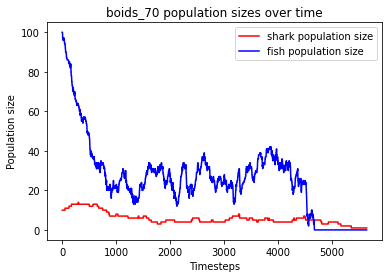

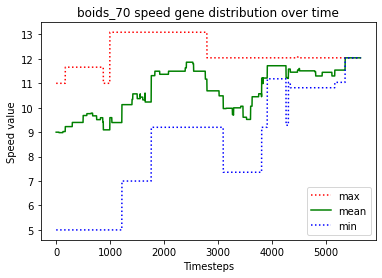

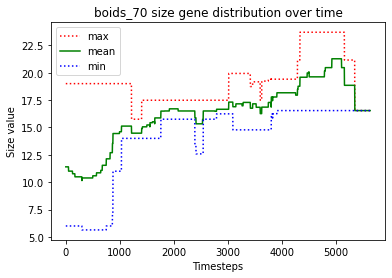

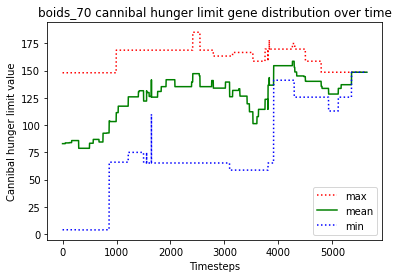

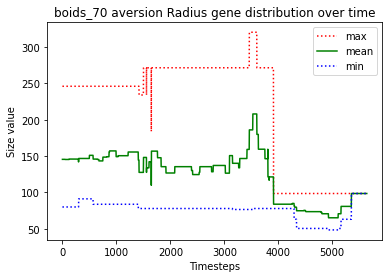

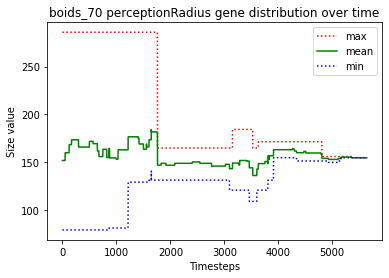

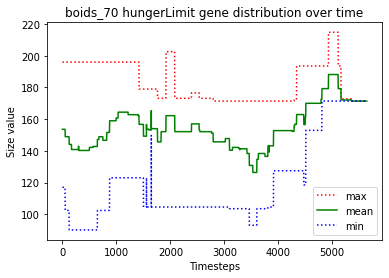





						BOIDS_71

predator_4 just gave birth to predator_10
predator_0 just gave birth to predator_11
predator_11 just gave birth to predator_12
predator_5 just gave birth to predator_13
predator_9 just gave birth to predator_14
predator_11 killed predator_5
predator_9 just gave birth to predator_15
predator_9 killed predator_15
predator_9 killed predator_12
predator_11 killed predator_2
predator_9 killed predator_8
predator_0 just gave birth to predator_16
predator_4 just gave birth to predator_17
predator_10 just gave birth to predator_18
predator_4 starved to death
predator_14 just gave birth to predator_19
predator_11 ate the carcass of predator_4_carcass
predator_19 just gave birth to predator_20
predator_20 killed predator_3
predator_17 starved to death
predator_19 killed predator_11
predator_16 starved to death
predator_9 killed predator_13
predator_18 starved to death
predator_19 killed predator_6
predator_10 starved to death
predator_14 ate the carcass of predator_10_carcass

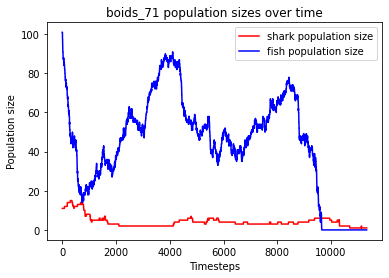

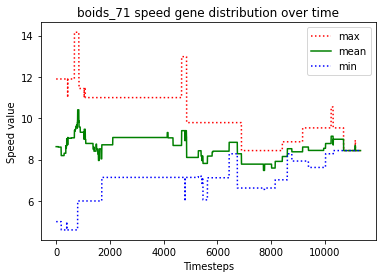

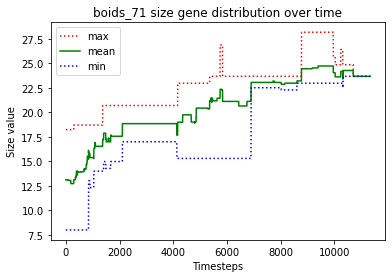

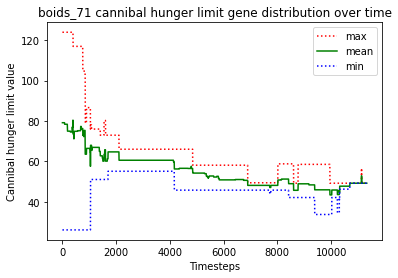

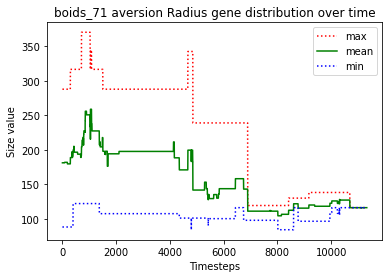

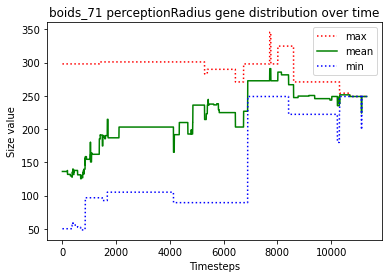

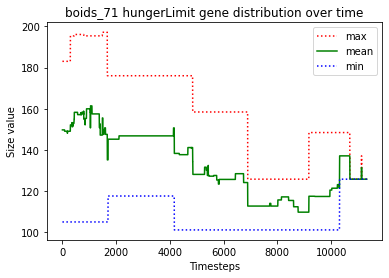





						BOIDS_72

predator_2 just gave birth to predator_10
predator_1 just gave birth to predator_11
predator_2 just gave birth to predator_12
predator_10 just gave birth to predator_13
predator_13 just gave birth to predator_14
predator_14 just gave birth to predator_15
predator_13 starved to death
predator_15 starved to death
predator_14 ate the carcass of predator_15_carcass
predator_2 ate the carcass of predator_13_carcass
predator_3 just gave birth to predator_16
predator_14 starved to death
predator_5 ate the carcass of predator_14_carcass
predator_0 just gave birth to predator_17
predator_10 starved to death
predator_2 just gave birth to predator_18
predator_5 ate the carcass of predator_10_carcass
predator_4 just gave birth to predator_19
predator_11 killed predator_6
predator_18 starved to death
predator_1 ate the carcass of predator_18_carcass
predator_5 just gave birth to predator_20
predator_4 just gave birth to predator_21
predator_2 starved to death
predator_21 ate the

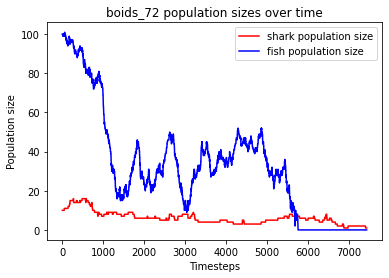

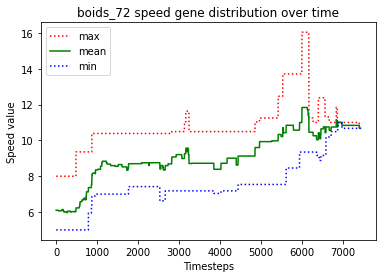

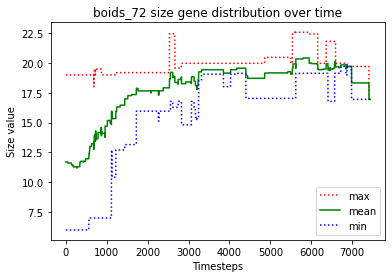

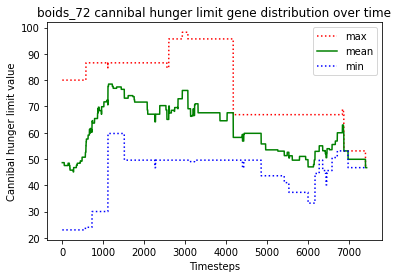

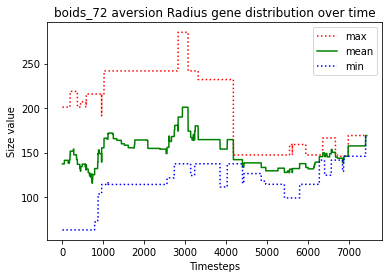

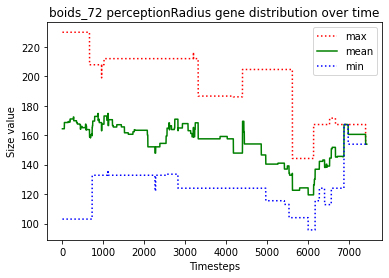

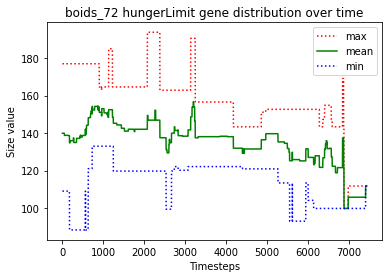





						BOIDS_73

predator_3 just gave birth to predator_10
predator_1 just gave birth to predator_11
predator_11 killed predator_10
predator_11 killed predator_3
predator_6 just gave birth to predator_12
predator_6 killed predator_2
predator_12 killed predator_5
predator_11 just gave birth to predator_13
predator_0 just gave birth to predator_14
predator_11 starved to death
predator_8 ate the carcass of predator_11_carcass
predator_13 starved to death
predator_9 ate the carcass of predator_13_carcass
predator_1 starved to death
predator_6 just gave birth to predator_15
predator_4 ate the carcass of predator_1_carcass
predator_15 killed predator_9
predator_15 killed predator_0
predator_15 killed predator_4
predator_15 killed predator_14
predator_6 just gave birth to predator_16
predator_12 just gave birth to predator_17
predator_6 killed predator_16
predator_15 starved to death
predator_17 ate the carcass of predator_15_carcass
predator_8 just gave birth to predator_18
predator_17 ju

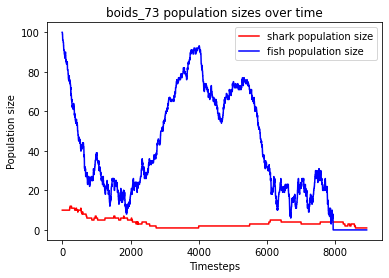

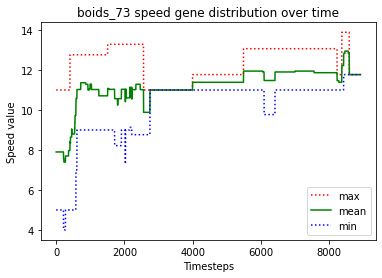

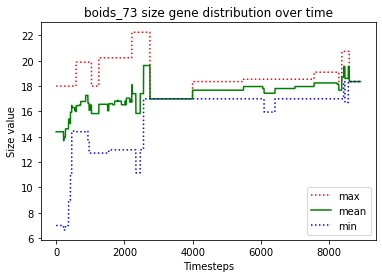

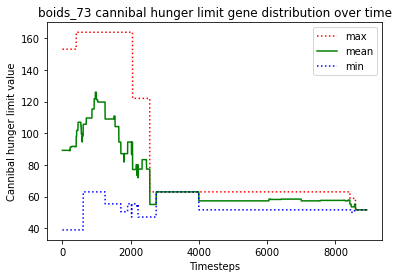

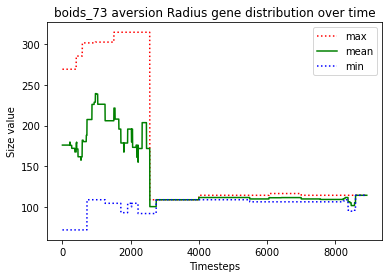

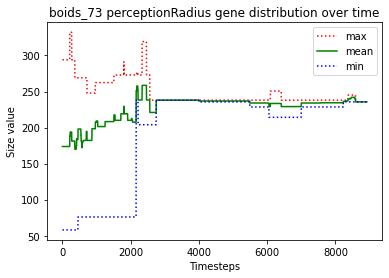

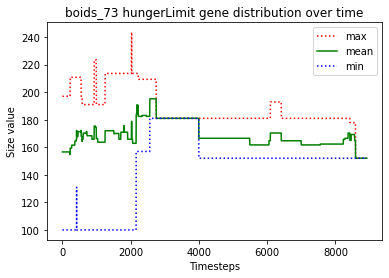





						BOIDS_74

predator_6 just gave birth to predator_10
predator_6 killed predator_5
predator_6 just gave birth to predator_11
predator_10 killed predator_2
predator_7 just gave birth to predator_12
predator_11 just gave birth to predator_13
predator_3 killed predator_7
predator_11 starved to death
predator_3 ate the carcass of predator_11_carcass
predator_10 just gave birth to predator_14
predator_12 starved to death
predator_1 ate the carcass of predator_12_carcass
predator_4 starved to death
predator_14 ate the carcass of predator_4_carcass
predator_13 killed predator_8
predator_14 just gave birth to predator_15
predator_10 starved to death
predator_9 ate the carcass of predator_10_carcass
predator_13 starved to death
predator_15 starved to death
predator_14 starved to death
predator_3 ate the carcass of predator_15_carcass
predator_3 ate the carcass of predator_14_carcass
predator_9 ate the carcass of predator_13_carcass
predator_1 just gave birth to predator_16
predator_9 ju

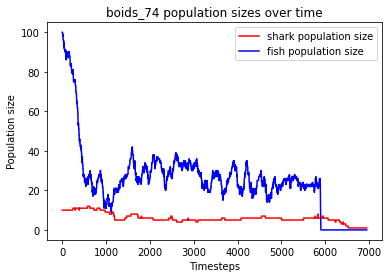

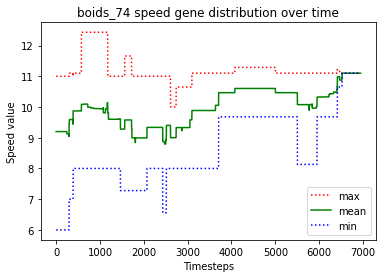

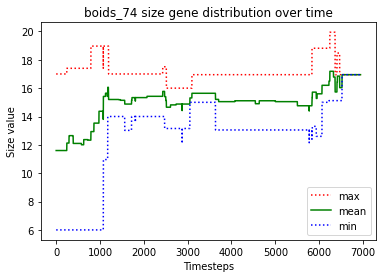

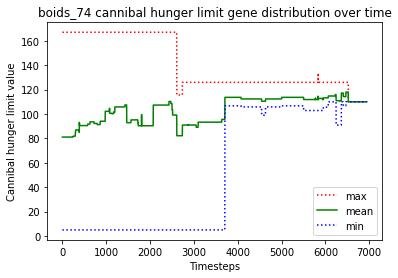

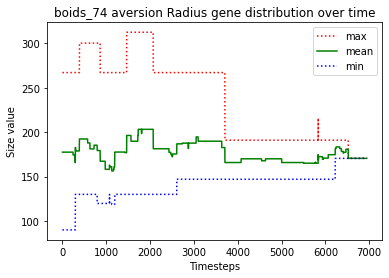

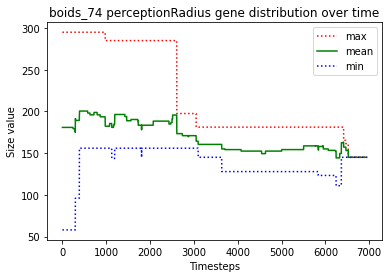

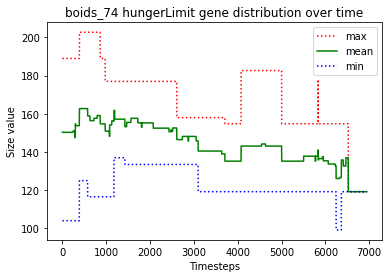





						BOIDS_75

predator_8 just gave birth to predator_10
predator_10 just gave birth to predator_11
predator_1 just gave birth to predator_12
predator_6 just gave birth to predator_13
predator_6 just gave birth to predator_14
predator_0 just gave birth to predator_15
predator_11 killed predator_4
predator_14 just gave birth to predator_16
predator_16 starved to death
predator_14 starved to death
predator_6 starved to death
predator_15 just gave birth to predator_17
predator_13 just gave birth to predator_18
predator_13 ate the carcass of predator_16_carcass
predator_3 ate the carcass of predator_14_carcass
predator_7 ate the carcass of predator_6_carcass
predator_17 killed predator_2
predator_18 starved to death
predator_1 ate the carcass of predator_18_carcass
predator_8 just gave birth to predator_19
predator_19 just gave birth to predator_20
predator_10 just gave birth to predator_21
predator_10 just gave birth to predator_22
predator_21 starved to death
predator_10 starved to 

predator_65 starved to death
predator_69 just gave birth to predator_72
predator_72 starved to death
predator_49 just gave birth to predator_73
predator_61 ate the carcass of predator_65_carcass
predator_69 ate the carcass of predator_72_carcass
predator_68 just gave birth to predator_74
predator_74 starved to death
predator_68 starved to death
predator_71 starved to death
predator_59 ate the carcass of predator_68_carcass
predator_60 ate the carcass of predator_71_carcass
predator_59 ate the carcass of predator_74_carcass
predator_73 starved to death
predator_56 ate the carcass of predator_73_carcass
predator_62 just gave birth to predator_75
predator_69 just gave birth to predator_76
predator_60 just gave birth to predator_77
predator_77 just gave birth to predator_78
predator_49 just gave birth to predator_79
predator_62 just gave birth to predator_80
predator_80 just gave birth to predator_81
predator_79 just gave birth to predator_82
predator_69 killed predator_78
predator_80 star

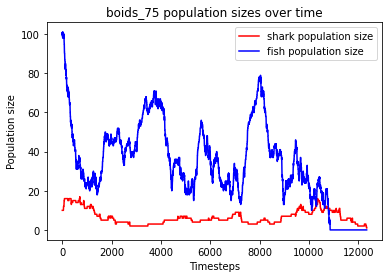

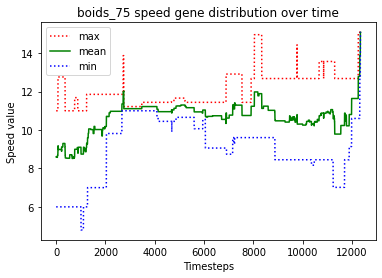

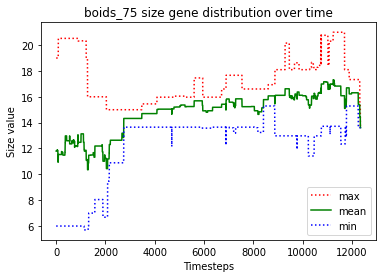

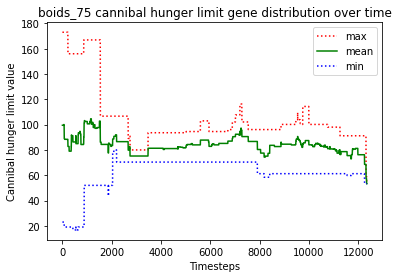

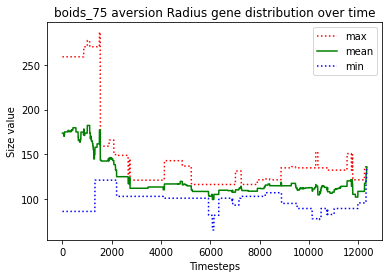

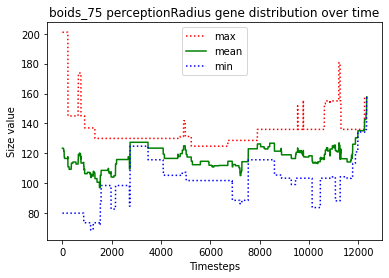

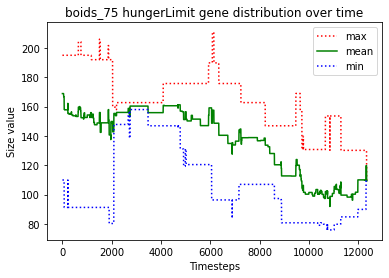





						BOIDS_76

predator_9 just gave birth to predator_10
predator_4 just gave birth to predator_11
predator_9 killed predator_10
predator_1 killed predator_2
predator_0 just gave birth to predator_12
predator_8 just gave birth to predator_13
predator_12 just gave birth to predator_14
predator_4 just gave birth to predator_15
predator_1 killed predator_14
predator_12 starved to death
predator_13 just gave birth to predator_16
predator_5 ate the carcass of predator_12_carcass
predator_9 starved to death
predator_1 ate the carcass of predator_9_carcass
predator_4 starved to death
predator_3 ate the carcass of predator_4_carcass
predator_11 just gave birth to predator_17
predator_16 just gave birth to predator_18
predator_16 killed predator_7
predator_1 just gave birth to predator_19
predator_18 starved to death
predator_16 starved to death
predator_15 ate the carcass of predator_18_carcass
predator_13 starved to death
predator_15 ate the carcass of predator_16_carcass
predator_1 just

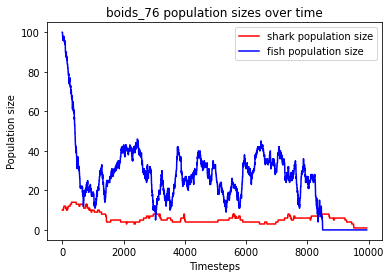

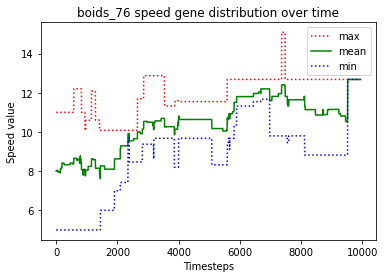

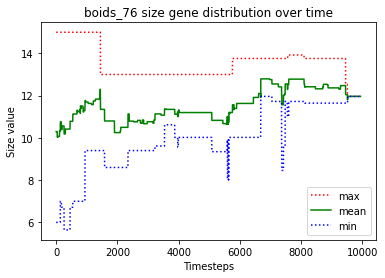

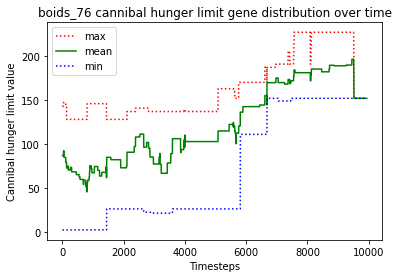

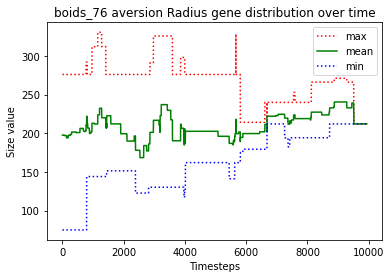

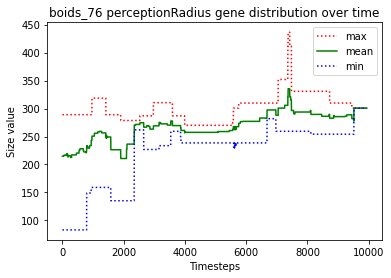

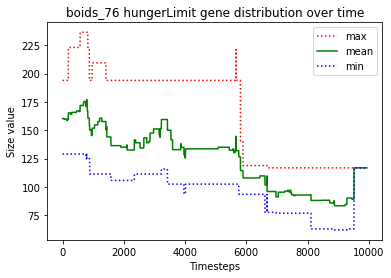





						BOIDS_77

predator_2 just gave birth to predator_10
predator_1 just gave birth to predator_11
predator_6 just gave birth to predator_12
predator_1 killed predator_2
predator_1 killed predator_4
predator_10 just gave birth to predator_13
predator_11 killed predator_5
predator_1 killed predator_8
predator_6 just gave birth to predator_14
predator_12 just gave birth to predator_15
predator_11 starved to death
predator_12 starved to death
predator_15 starved to death
predator_10 ate the carcass of predator_11_carcass
predator_7 ate the carcass of predator_12_carcass
predator_7 ate the carcass of predator_15_carcass
predator_6 starved to death
predator_14 ate the carcass of predator_6_carcass
predator_0 just gave birth to predator_16
predator_0 just gave birth to predator_17
predator_9 just gave birth to predator_18
predator_17 just gave birth to predator_19
predator_19 just gave birth to predator_20
predator_19 starved to death
predator_20 starved to death
predator_17 starved to 

predator_54 just gave birth to predator_71
predator_41 just gave birth to predator_72
predator_66 starved to death
predator_41 ate the carcass of predator_66_carcass
predator_69 just gave birth to predator_73
predator_68 starved to death
predator_58 ate the carcass of predator_68_carcass
predator_71 just gave birth to predator_74
predator_72 just gave birth to predator_75
predator_75 just gave birth to predator_76
predator_69 just gave birth to predator_77
predator_54 just gave birth to predator_78
predator_71 just gave birth to predator_79
predator_79 starved to death
predator_71 ate the carcass of predator_79_carcass
predator_74 starved to death
predator_77 starved to death
predator_69 starved to death
predator_71 ate the carcass of predator_69_carcass
predator_72 ate the carcass of predator_74_carcass
predator_41 ate the carcass of predator_77_carcass
predator_78 starved to death
predator_54 starved to death
predator_49 ate the carcass of predator_54_carcass
predator_58 just gave bi

predator_129 starved to death
predator_76 just gave birth to predator_133
predator_60 ate the carcass of predator_129_carcass
predator_128 starved to death
predator_131 ate the carcass of predator_128_carcass
predator_76 starved to death
predator_122 ate the carcass of predator_76_carcass
predator_132 starved to death
predator_131 ate the carcass of predator_132_carcass
predator_133 just gave birth to predator_134
predator_134 starved to death
predator_133 starved to death
predator_83 ate the carcass of predator_133_carcass
predator_126 ate the carcass of predator_134_carcass
predator_112 just gave birth to predator_135
predator_60 just gave birth to predator_136
predator_125 starved to death
predator_60 ate the carcass of predator_125_carcass
predator_85 just gave birth to predator_137
predator_104 just gave birth to predator_138
predator_122 just gave birth to predator_139
predator_138 starved to death
predator_139 ate the carcass of predator_138_carcass
predator_137 just gave birth 

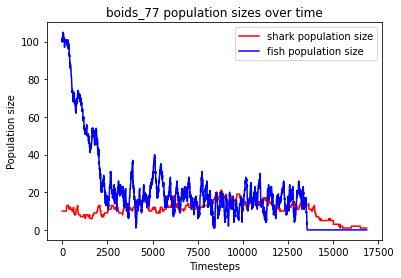

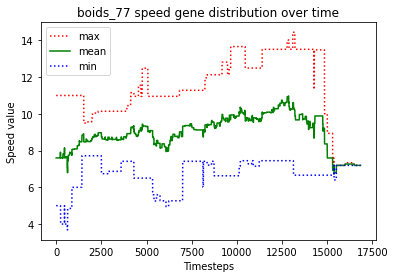

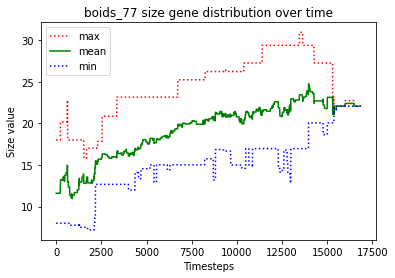

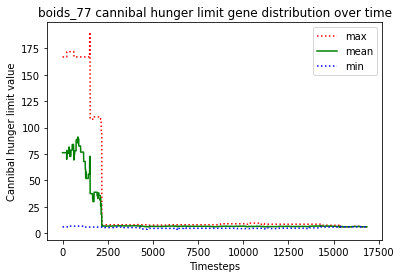

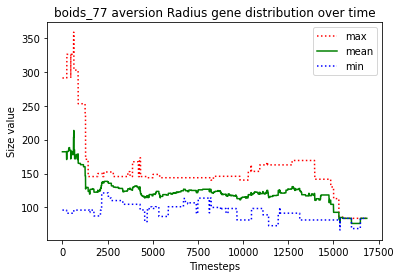

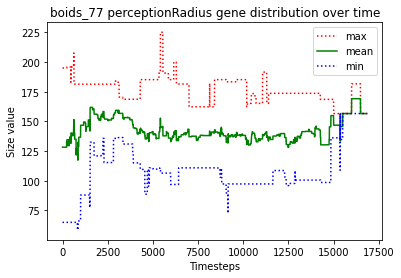

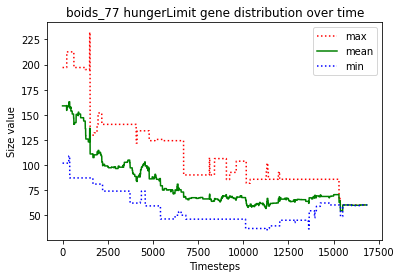





						BOIDS_78

predator_3 just gave birth to predator_10
predator_3 killed predator_10
predator_3 killed predator_9
predator_3 killed predator_8
predator_1 just gave birth to predator_11
predator_1 just gave birth to predator_12
predator_0 just gave birth to predator_13
predator_2 just gave birth to predator_14
predator_3 just gave birth to predator_15
predator_5 just gave birth to predator_16
predator_16 killed predator_4
predator_3 just gave birth to predator_17
predator_3 killed predator_6
predator_2 just gave birth to predator_18
predator_7 just gave birth to predator_19
predator_7 just gave birth to predator_20
predator_2 just gave birth to predator_21
predator_17 starved to death
predator_2 starved to death
predator_21 starved to death
predator_7 ate the carcass of predator_2_carcass
predator_0 ate the carcass of predator_21_carcass
predator_3 starved to death
predator_1 starved to death
predator_18 just gave birth to predator_22
predator_20 starved to death
predator_12 star

predator_65 just gave birth to predator_70
predator_70 starved to death
predator_65 starved to death
predator_54 ate the carcass of predator_65_carcass
predator_54 ate the carcass of predator_70_carcass
predator_57 just gave birth to predator_71
predator_57 just gave birth to predator_72
predator_62 just gave birth to predator_73
predator_73 starved to death
predator_62 starved to death
predator_67 ate the carcass of predator_73_carcass
predator_72 just gave birth to predator_74
predator_74 starved to death
predator_71 ate the carcass of predator_74_carcass
predator_67 just gave birth to predator_75
predator_72 starved to death
predator_67 ate the carcass of predator_72_carcass
predator_54 just gave birth to predator_76
predator_67 just gave birth to predator_77
predator_75 ate the carcass of predator_62_carcass
predator_75 just gave birth to predator_78
predator_57 starved to death
predator_76 ate the carcass of predator_57_carcass
predator_77 starved to death
predator_63 just gave bi

predator_113 just gave birth to predator_128
predator_113 starved to death
predator_128 ate the carcass of predator_113_carcass
predator_128 ate the carcass of predator_119_carcass
predator_128 starved to death


finished this run because predators went extinct
Fish left: 0
Sharks left: 0
Dead sharks: 129
Timesteps passed: 20558
Fish went extinct at timestep 18181
Sharks went extinct at timestep 20558


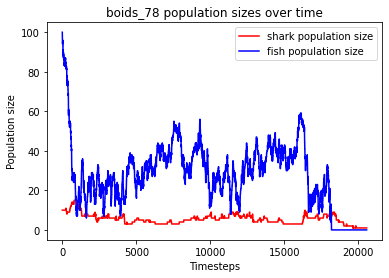

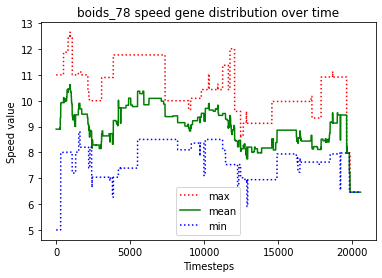

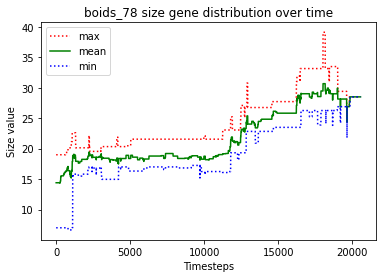

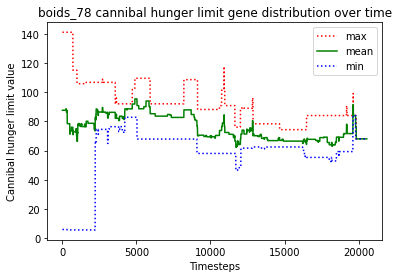

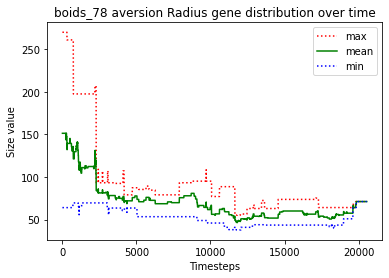

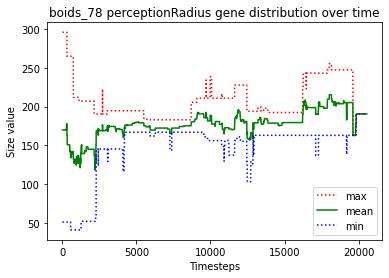

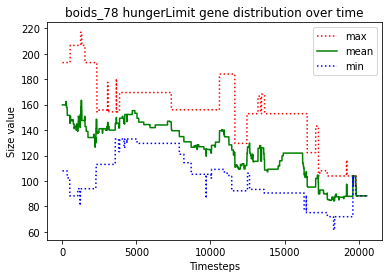





						BOIDS_79

predator_8 just gave birth to predator_10
predator_5 just gave birth to predator_11
predator_10 just gave birth to predator_12
predator_12 killed predator_8
predator_0 just gave birth to predator_13
predator_5 just gave birth to predator_14
predator_10 killed predator_1
predator_14 killed predator_7
predator_14 killed predator_9
predator_10 just gave birth to predator_15
predator_2 just gave birth to predator_16
predator_12 starved to death
predator_10 starved to death
predator_14 killed predator_6
predator_11 ate the carcass of predator_10_carcass
predator_11 ate the carcass of predator_12_carcass
predator_11 just gave birth to predator_17
predator_15 starved to death
predator_4 ate the carcass of predator_15_carcass
predator_11 just gave birth to predator_18
predator_17 killed predator_5
predator_18 starved to death
predator_11 ate the carcass of predator_18_carcass
predator_16 just gave birth to predator_19
predator_2 just gave birth to predator_20
predator_17 ju

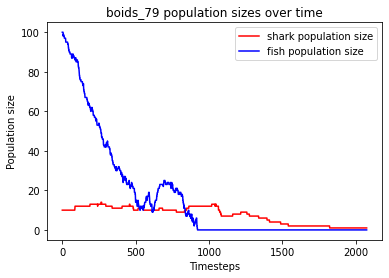

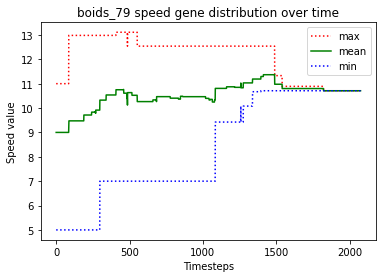

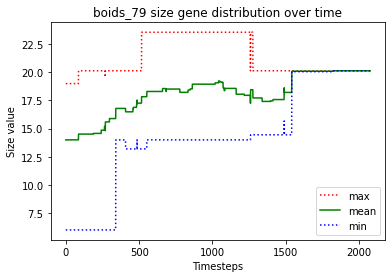

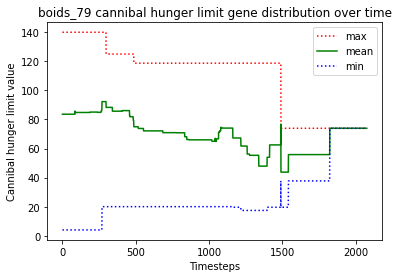

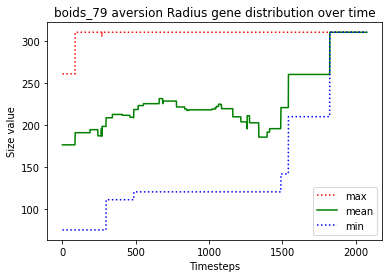

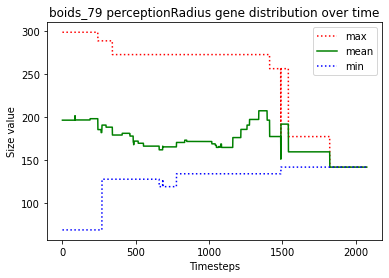

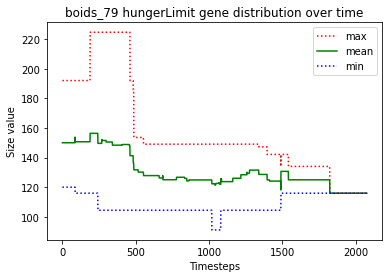





						BOIDS_80

predator_2 just gave birth to predator_10
predator_2 just gave birth to predator_11
predator_9 just gave birth to predator_12
predator_1 just gave birth to predator_13
predator_9 just gave birth to predator_14
predator_11 starved to death
predator_1 ate the carcass of predator_11_carcass
predator_10 just gave birth to predator_15
predator_9 just gave birth to predator_16
predator_9 starved to death
predator_16 starved to death
predator_3 ate the carcass of predator_9_carcass
predator_13 ate the carcass of predator_16_carcass
predator_12 just gave birth to predator_17
predator_2 starved to death
predator_10 ate the carcass of predator_2_carcass
predator_14 starved to death
predator_10 just gave birth to predator_18
predator_7 ate the carcass of predator_14_carcass
predator_15 starved to death
predator_6 ate the carcass of predator_15_carcass
predator_17 just gave birth to predator_19
predator_17 just gave birth to predator_20
predator_20 starved to death
predator_17 

predator_66 ate the carcass of predator_67_carcass
predator_58 starved to death
predator_26 ate the carcass of predator_58_carcass
predator_61 just gave birth to predator_69
predator_62 just gave birth to predator_70
predator_59 starved to death
predator_26 ate the carcass of predator_59_carcass
predator_61 just gave birth to predator_71
predator_61 just gave birth to predator_72
predator_71 starved to death
predator_72 starved to death
predator_62 ate the carcass of predator_71_carcass
predator_61 starved to death
predator_54 ate the carcass of predator_61_carcass
predator_69 ate the carcass of predator_72_carcass
predator_69 just gave birth to predator_73
predator_62 just gave birth to predator_74
predator_62 just gave birth to predator_75
predator_73 starved to death
predator_70 just gave birth to predator_76
predator_74 starved to death
predator_75 ate the carcass of predator_73_carcass
predator_62 just gave birth to predator_77
predator_62 starved to death
predator_77 starved to d

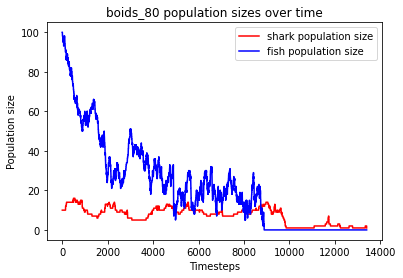

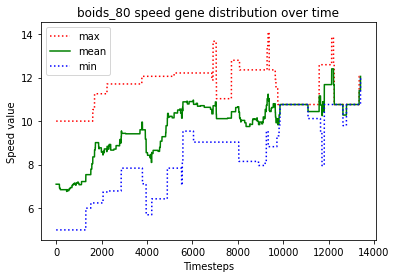

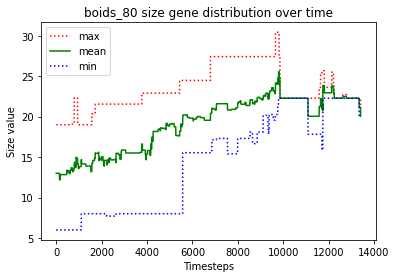

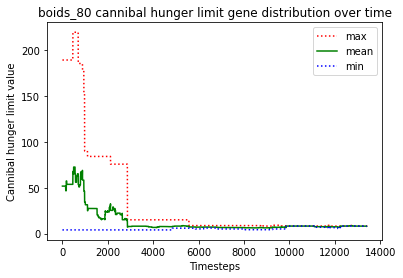

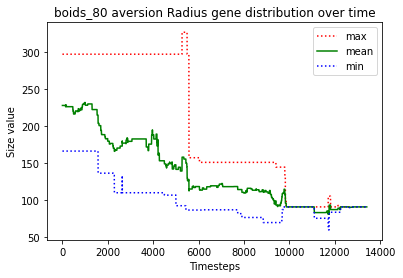

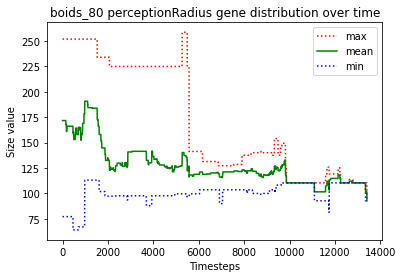

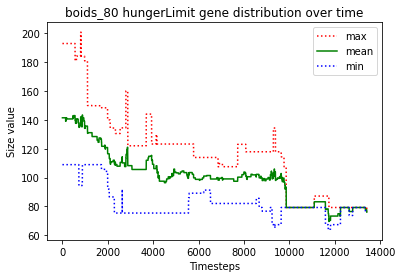





						BOIDS_81

predator_1 just gave birth to predator_10
predator_3 just gave birth to predator_11
predator_11 just gave birth to predator_12
predator_2 just gave birth to predator_13
predator_4 just gave birth to predator_14
predator_12 killed predator_0
predator_6 just gave birth to predator_15
predator_13 just gave birth to predator_16
predator_6 killed predator_8
predator_6 just gave birth to predator_17
predator_13 just gave birth to predator_18
predator_6 killed predator_14
predator_16 just gave birth to predator_19
predator_1 just gave birth to predator_20
predator_16 starved to death
predator_13 starved to death
predator_18 starved to death
predator_7 ate the carcass of predator_18_carcass
predator_2 ate the carcass of predator_16_carcass
predator_11 ate the carcass of predator_13_carcass
predator_10 starved to death
predator_5 ate the carcass of predator_10_carcass
predator_20 starved to death
predator_1 starved to death
predator_6 ate the carcass of predator_20_carcass
p

predator_71 just gave birth to predator_75
predator_48 just gave birth to predator_76
predator_75 starved to death
predator_62 ate the carcass of predator_75_carcass
predator_74 starved to death
predator_70 starved to death
predator_63 ate the carcass of predator_70_carcass
predator_61 ate the carcass of predator_74_carcass
predator_71 starved to death
predator_76 ate the carcass of predator_71_carcass
predator_68 starved to death
predator_61 just gave birth to predator_77
predator_48 just gave birth to predator_78
predator_62 starved to death
predator_61 just gave birth to predator_79
predator_63 ate the carcass of predator_62_carcass
predator_78 killed predator_76
predator_73 just gave birth to predator_80
predator_79 just gave birth to predator_81
predator_48 starved to death
predator_61 ate the carcass of predator_48_carcass
predator_72 starved to death
predator_78 ate the carcass of predator_72_carcass
predator_79 starved to death
predator_63 ate the carcass of predator_68_carcass

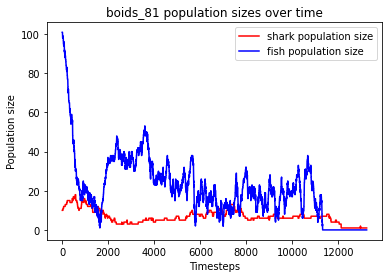

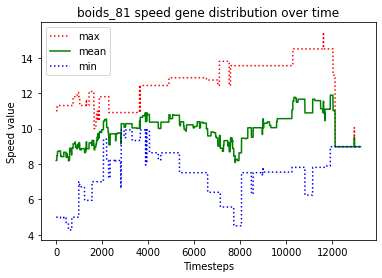

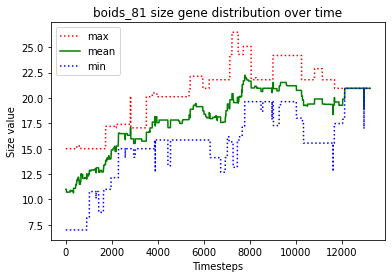

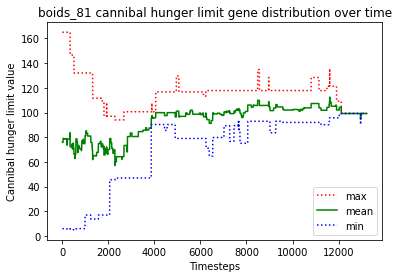

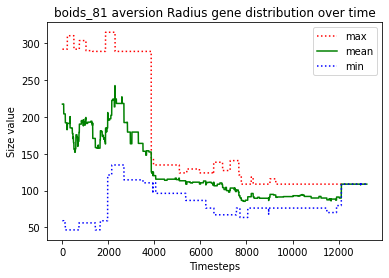

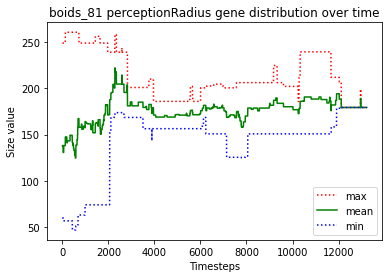

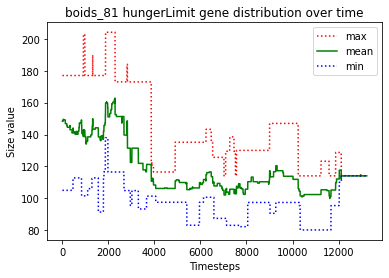





						BOIDS_82

predator_3 just gave birth to predator_10
predator_8 just gave birth to predator_11
predator_2 just gave birth to predator_12
predator_5 just gave birth to predator_13
predator_4 just gave birth to predator_14
predator_6 just gave birth to predator_15
predator_3 just gave birth to predator_16
predator_4 just gave birth to predator_17
predator_13 just gave birth to predator_18
predator_13 just gave birth to predator_19
predator_1 killed predator_7
predator_16 starved to death
predator_2 ate the carcass of predator_16_carcass
predator_3 starved to death
predator_13 killed predator_12
predator_13 killed predator_0
predator_15 ate the carcass of predator_3_carcass
predator_17 starved to death
predator_2 starved to death
predator_4 starved to death
predator_18 ate the carcass of predator_17_carcass
predator_15 ate the carcass of predator_4_carcass
predator_1 ate the carcass of predator_2_carcass
predator_10 starved to death
predator_14 ate the carcass of predator_10_carc

predator_66 just gave birth to predator_69
predator_63 just gave birth to predator_70
predator_67 just gave birth to predator_71
predator_66 just gave birth to predator_72
predator_72 just gave birth to predator_73
predator_72 starved to death
predator_68 just gave birth to predator_74
predator_71 ate the carcass of predator_72_carcass
predator_73 starved to death
predator_67 ate the carcass of predator_73_carcass
predator_74 starved to death
predator_68 starved to death
predator_70 ate the carcass of predator_68_carcass
predator_66 ate the carcass of predator_74_carcass
predator_63 killed predator_66
predator_41 just gave birth to predator_75
predator_41 just gave birth to predator_76
predator_76 just gave birth to predator_77
predator_63 killed predator_65
predator_76 killed predator_71
predator_77 starved to death
predator_75 ate the carcass of predator_77_carcass
predator_76 killed predator_67
predator_41 starved to death
predator_69 ate the carcass of predator_41_carcass
predator_

predator_123 just gave birth to predator_132
predator_124 just gave birth to predator_133
predator_118 killed predator_128
predator_127 starved to death
predator_132 just gave birth to predator_134
predator_107 starved to death
predator_118 ate the carcass of predator_107_carcass
predator_132 ate the carcass of predator_127_carcass
predator_118 just gave birth to predator_135
predator_123 just gave birth to predator_136
predator_133 just gave birth to predator_137
predator_118 starved to death
predator_136 starved to death
predator_123 starved to death
predator_133 ate the carcass of predator_123_carcass
predator_137 ate the carcass of predator_136_carcass
predator_135 starved to death
predator_132 starved to death
predator_133 ate the carcass of predator_132_carcass
predator_124 ate the carcass of predator_118_carcass
predator_137 starved to death
predator_133 just gave birth to predator_138
predator_134 ate the carcass of predator_135_carcass
predator_138 just gave birth to predator_

predator_188 starved to death
predator_191 starved to death
predator_186 starved to death
predator_178 ate the carcass of predator_191_carcass
predator_178 just gave birth to predator_192
predator_178 ate the carcass of predator_186_carcass
predator_178 just gave birth to predator_193
predator_178 killed predator_193
predator_178 ate the carcass of predator_188_carcass
predator_185 just gave birth to predator_194
predator_185 starved to death
predator_194 just gave birth to predator_195
predator_195 starved to death
predator_192 ate the carcass of predator_195_carcass
predator_194 ate the carcass of predator_185_carcass
predator_178 just gave birth to predator_196
predator_196 just gave birth to predator_197
predator_196 killed predator_197
predator_178 starved to death
predator_196 just gave birth to predator_198
predator_196 just gave birth to predator_199
predator_198 just gave birth to predator_200
predator_199 ate the carcass of predator_178_carcass
predator_196 starved to death
p

predator_248 ate the carcass of predator_252_carcass
predator_254 just gave birth to predator_255
predator_249 just gave birth to predator_256
predator_255 starved to death
predator_256 just gave birth to predator_257
predator_254 starved to death
predator_251 just gave birth to predator_258
predator_251 killed predator_258
predator_256 starved to death
predator_253 ate the carcass of predator_254_carcass
predator_257 ate the carcass of predator_256_carcass
predator_245 just gave birth to predator_259
predator_237 just gave birth to predator_260
predator_237 killed predator_260
predator_257 ate the carcass of predator_255_carcass
predator_251 just gave birth to predator_261
predator_249 just gave birth to predator_262
predator_261 starved to death
predator_245 ate the carcass of predator_261_carcass
predator_262 just gave birth to predator_263
predator_263 starved to death
predator_262 starved to death
predator_237 ate the carcass of predator_262_carcass
predator_236 ate the carcass of

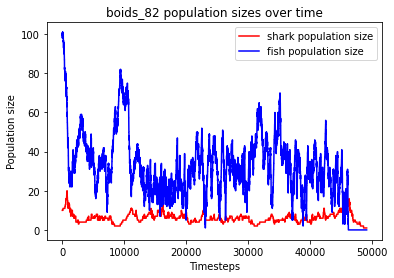

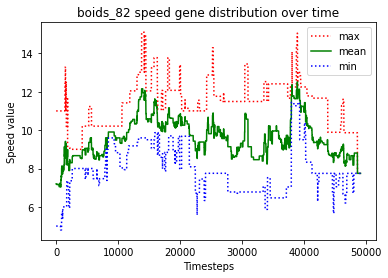

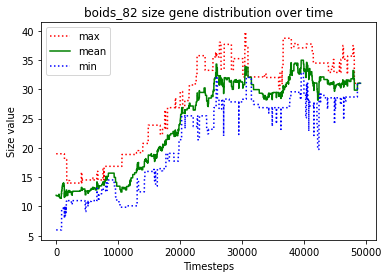

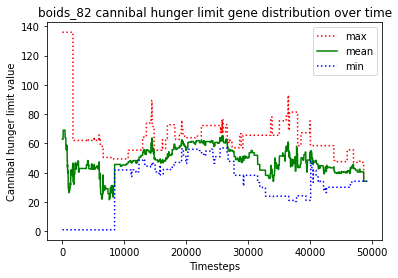

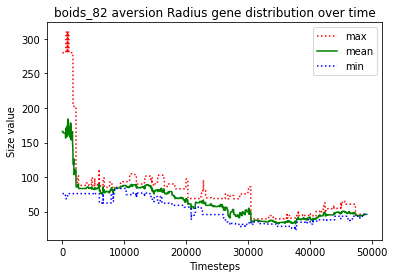

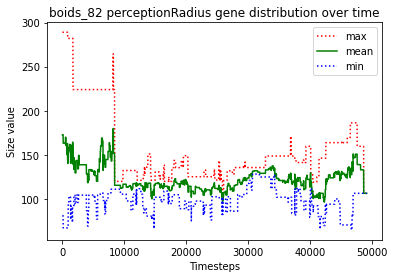

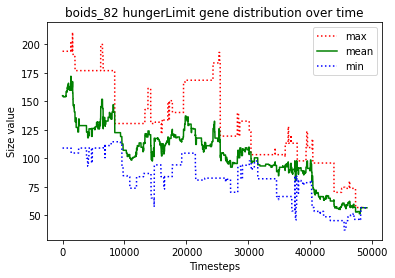





						BOIDS_83

predator_5 just gave birth to predator_10
predator_6 just gave birth to predator_11
predator_8 just gave birth to predator_12
predator_11 just gave birth to predator_13
predator_4 killed predator_3
predator_6 killed predator_13
predator_7 just gave birth to predator_14
predator_4 killed predator_1
predator_0 just gave birth to predator_15
predator_0 killed predator_5
predator_7 just gave birth to predator_16
predator_0 killed predator_2
predator_15 killed predator_6
predator_0 killed predator_11
predator_16 starved to death
predator_7 starved to death
predator_0 ate the carcass of predator_16_carcass
predator_9 just gave birth to predator_17
predator_12 starved to death
predator_15 ate the carcass of predator_7_carcass
predator_17 ate the carcass of predator_12_carcass
predator_8 starved to death
predator_4 ate the carcass of predator_8_carcass
predator_10 starved to death
predator_4 ate the carcass of predator_10_carcass
predator_14 starved to death
predator_0 ate 

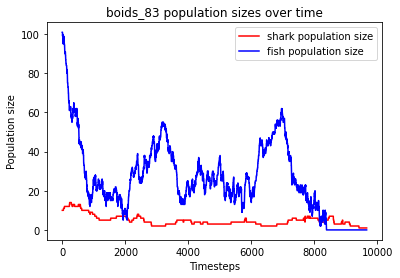

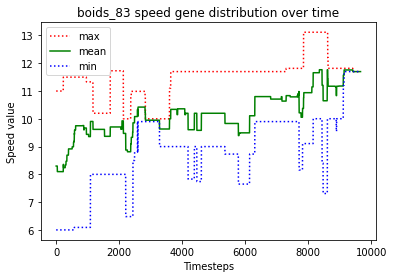

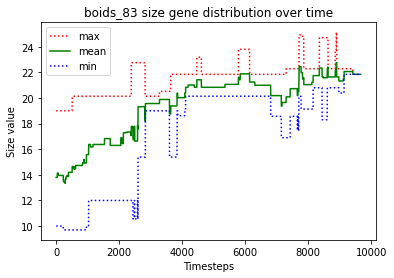

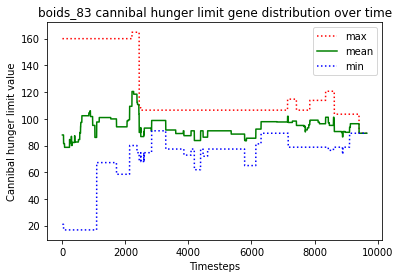

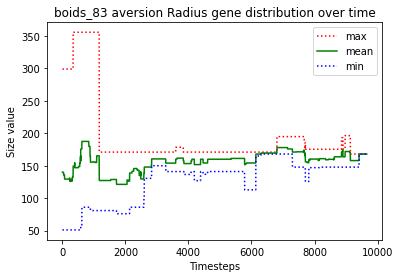

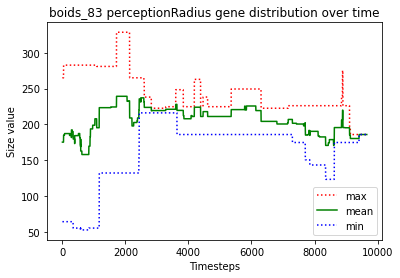

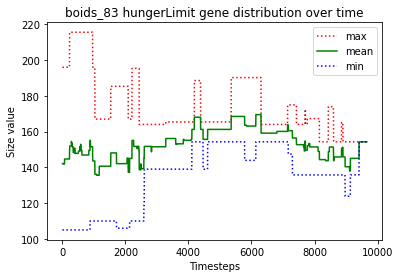





						BOIDS_84

predator_8 just gave birth to predator_10
predator_4 just gave birth to predator_11
predator_8 just gave birth to predator_12
predator_8 killed predator_3
predator_10 just gave birth to predator_13
predator_8 just gave birth to predator_14
predator_4 just gave birth to predator_15
predator_10 killed predator_7
predator_13 killed predator_11
predator_8 killed predator_0
predator_4 just gave birth to predator_16
predator_8 just gave birth to predator_17
predator_17 killed predator_2
predator_8 starved to death
predator_17 ate the carcass of predator_8_carcass
predator_4 starved to death
predator_14 starved to death
predator_13 ate the carcass of predator_14_carcass
predator_16 starved to death
predator_12 ate the carcass of predator_16_carcass
predator_15 ate the carcass of predator_4_carcass
predator_15 starved to death
predator_1 ate the carcass of predator_15_carcass
predator_6 just gave birth to predator_18
predator_17 just gave birth to predator_19
predator_17 ju

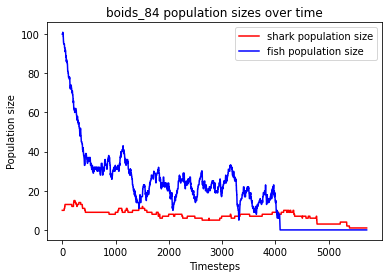

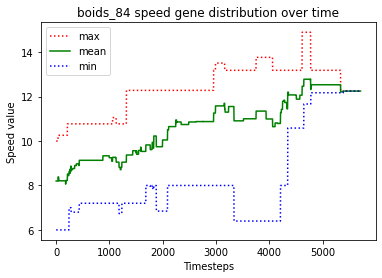

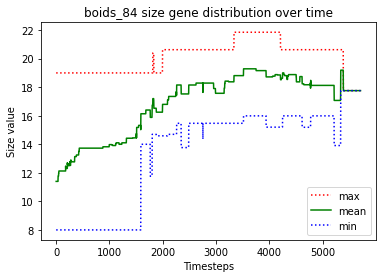

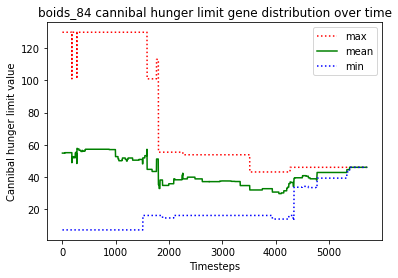

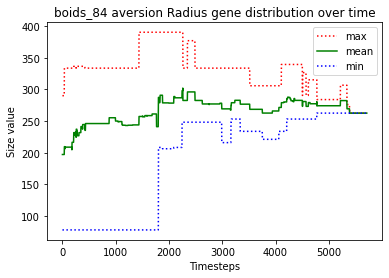

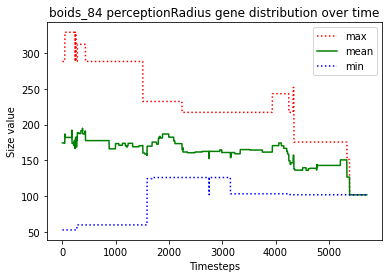

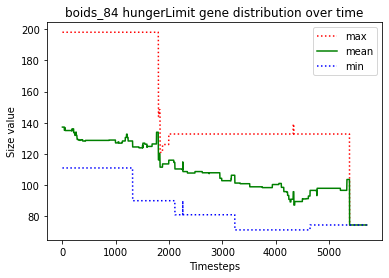





						BOIDS_85

predator_3 just gave birth to predator_10
predator_10 just gave birth to predator_11
predator_6 just gave birth to predator_12
predator_3 just gave birth to predator_13
predator_10 just gave birth to predator_14
predator_4 just gave birth to predator_15
predator_15 killed predator_13
predator_10 starved to death
predator_14 ate the carcass of predator_10_carcass
predator_3 starved to death
predator_11 starved to death
predator_8 ate the carcass of predator_11_carcass
predator_5 ate the carcass of predator_3_carcass
predator_9 just gave birth to predator_16
predator_6 just gave birth to predator_17
predator_14 starved to death
predator_0 ate the carcass of predator_14_carcass
predator_8 just gave birth to predator_18
predator_2 just gave birth to predator_19
predator_6 starved to death
predator_9 starved to death
predator_18 ate the carcass of predator_6_carcass
predator_12 starved to death
predator_19 starved to death
predator_2 starved to death
predator_15 ate the 

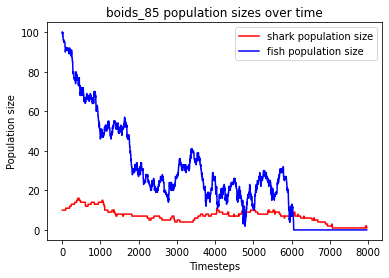

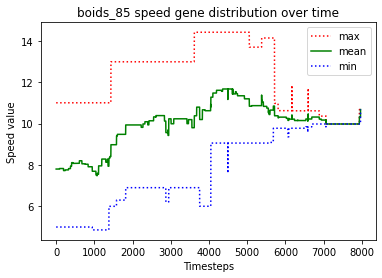

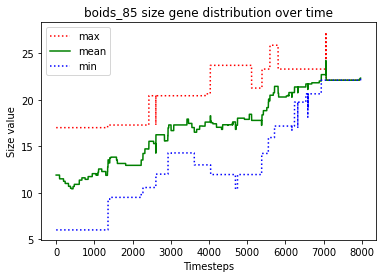

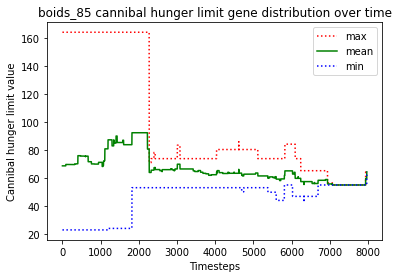

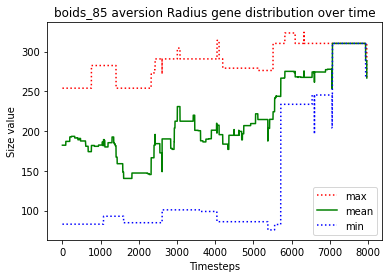

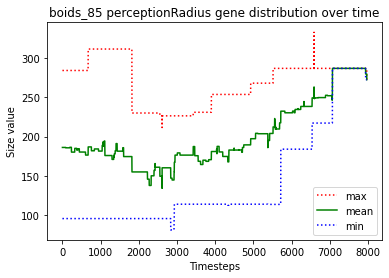

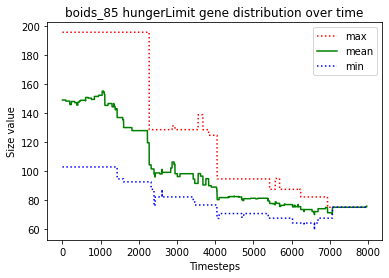





						BOIDS_86

predator_3 just gave birth to predator_10
predator_10 killed predator_1
predator_0 just gave birth to predator_11
predator_3 just gave birth to predator_12
predator_6 just gave birth to predator_13
predator_7 killed predator_13
predator_10 just gave birth to predator_14
predator_5 just gave birth to predator_15
predator_7 just gave birth to predator_16
predator_9 just gave birth to predator_17
predator_7 killed predator_6
predator_15 just gave birth to predator_18
predator_3 killed predator_2
predator_11 starved to death
predator_18 starved to death
predator_9 ate the carcass of predator_11_carcass
predator_15 ate the carcass of predator_18_carcass
predator_14 just gave birth to predator_19
predator_15 just gave birth to predator_20
predator_15 starved to death
predator_17 ate the carcass of predator_15_carcass
predator_5 just gave birth to predator_21
predator_20 starved to death
predator_5 starved to death
predator_21 starved to death
predator_17 ate the carcass o

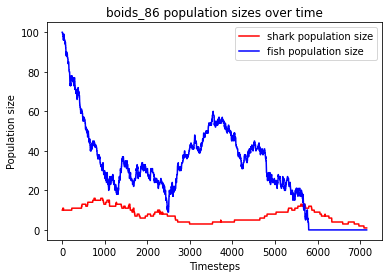

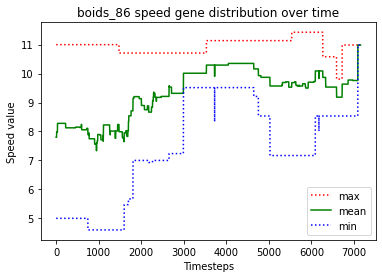

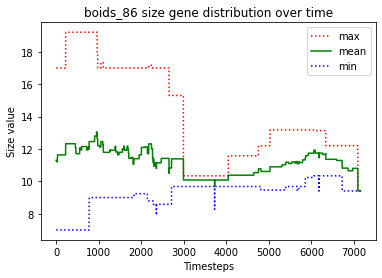

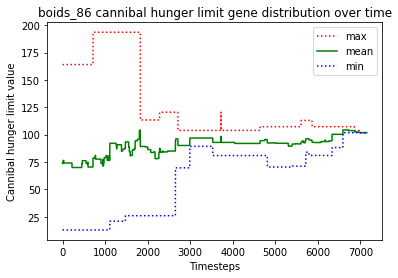

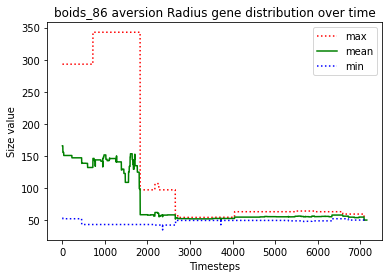

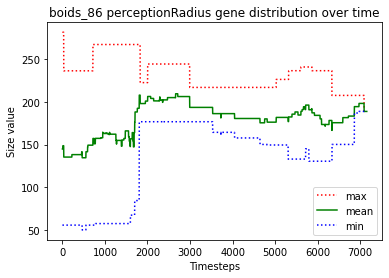

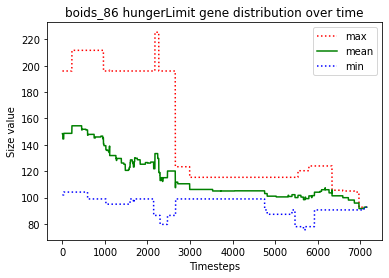





						BOIDS_87

predator_8 just gave birth to predator_10
predator_0 just gave birth to predator_11
predator_8 just gave birth to predator_12
predator_1 just gave birth to predator_13
predator_11 just gave birth to predator_14
predator_12 starved to death
predator_8 starved to death
predator_13 ate the carcass of predator_8_carcass
predator_5 just gave birth to predator_15
predator_1 ate the carcass of predator_12_carcass
predator_0 just gave birth to predator_16
predator_13 killed predator_10
predator_14 starved to death
predator_11 starved to death
predator_13 just gave birth to predator_17
predator_13 killed predator_7
predator_1 ate the carcass of predator_11_carcass
predator_6 just gave birth to predator_18
predator_16 just gave birth to predator_19
predator_16 starved to death
predator_19 starved to death
predator_1 ate the carcass of predator_14_carcass
predator_17 killed predator_9
predator_0 starved to death
predator_1 ate the carcass of predator_16_carcass
predator_1 ate 

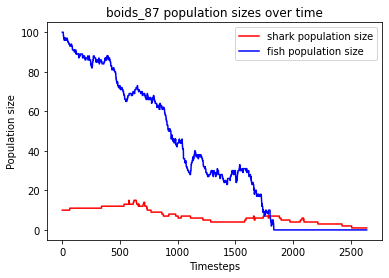

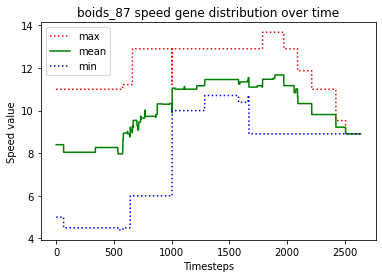

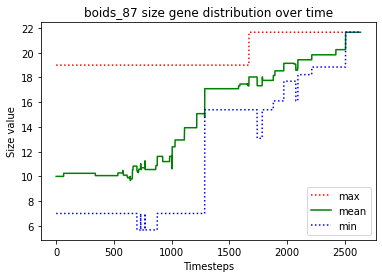

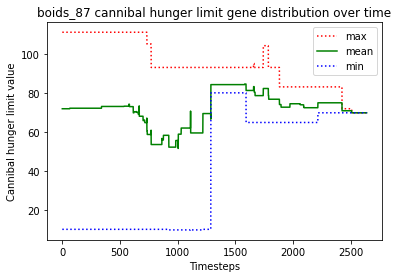

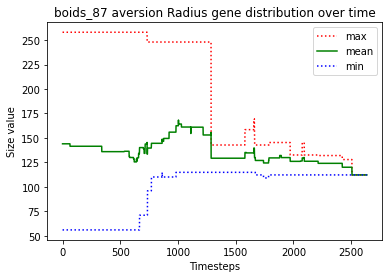

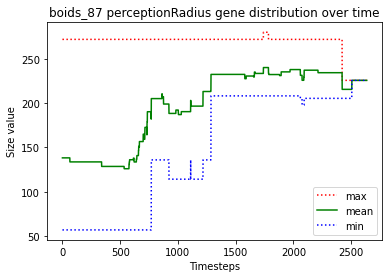

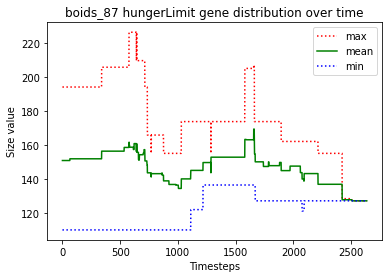





						BOIDS_88

predator_6 just gave birth to predator_10
predator_0 just gave birth to predator_11
predator_8 just gave birth to predator_12
predator_2 killed predator_3
predator_5 just gave birth to predator_13
predator_13 just gave birth to predator_14
predator_13 just gave birth to predator_15
predator_0 killed predator_5
predator_2 just gave birth to predator_16
predator_0 killed predator_8
predator_1 just gave birth to predator_17
predator_15 starved to death
predator_13 ate the carcass of predator_15_carcass
predator_1 just gave birth to predator_18
predator_1 killed predator_18
predator_1 just gave birth to predator_19
predator_13 starved to death
predator_14 starved to death
predator_1 ate the carcass of predator_13_carcass
predator_11 starved to death
predator_9 just gave birth to predator_20
predator_19 ate the carcass of predator_11_carcass
predator_9 ate the carcass of predator_14_carcass
predator_1 starved to death
predator_19 ate the carcass of predator_1_carcass
pre

predator_64 just gave birth to predator_70
predator_66 just gave birth to predator_71
predator_70 just gave birth to predator_72
predator_70 just gave birth to predator_73
predator_71 starved to death
predator_66 starved to death
predator_64 ate the carcass of predator_71_carcass
predator_59 just gave birth to predator_74
predator_64 just gave birth to predator_75
predator_59 starved to death
predator_75 ate the carcass of predator_66_carcass
predator_74 ate the carcass of predator_59_carcass
predator_73 starved to death
predator_70 killed predator_57
predator_64 just gave birth to predator_76
predator_70 ate the carcass of predator_73_carcass
predator_72 starved to death
predator_65 starved to death
predator_75 ate the carcass of predator_72_carcass
predator_40 ate the carcass of predator_65_carcass
predator_76 starved to death
predator_70 just gave birth to predator_77
predator_77 ate the carcass of predator_76_carcass
predator_40 just gave birth to predator_78
predator_77 just gave 

predator_130 starved to death
predator_127 starved to death
predator_91 ate the carcass of predator_127_carcass
predator_85 just gave birth to predator_134
predator_134 ate the carcass of predator_130_carcass
predator_129 starved to death
predator_110 ate the carcass of predator_129_carcass
predator_118 just gave birth to predator_135
predator_118 starved to death
predator_135 starved to death
predator_91 just gave birth to predator_136
predator_128 just gave birth to predator_137
predator_128 starved to death
predator_92 ate the carcass of predator_118_carcass
predator_85 starved to death
predator_133 ate the carcass of predator_128_carcass
predator_136 ate the carcass of predator_85_carcass
predator_137 just gave birth to predator_138
predator_92 ate the carcass of predator_135_carcass
predator_137 starved to death
predator_138 starved to death
predator_136 ate the carcass of predator_137_carcass
predator_91 ate the carcass of predator_138_carcass
predator_132 starved to death
predat

predator_189 ate the carcass of predator_191_carcass
predator_148 just gave birth to predator_192
predator_179 ate the carcass of predator_187_carcass
predator_148 ate the carcass of predator_190_carcass
predator_189 just gave birth to predator_193
predator_183 just gave birth to predator_194
predator_166 just gave birth to predator_195
predator_193 starved to death
predator_185 ate the carcass of predator_193_carcass
predator_192 just gave birth to predator_196
predator_189 just gave birth to predator_197
predator_192 starved to death
predator_196 starved to death
predator_183 ate the carcass of predator_192_carcass
predator_197 starved to death
predator_189 starved to death
predator_195 killed predator_194
predator_159 ate the carcass of predator_196_carcass
predator_179 just gave birth to predator_198
predator_195 ate the carcass of predator_189_carcass
predator_183 ate the carcass of predator_197_carcass
predator_159 just gave birth to predator_199
predator_198 starved to death
pre

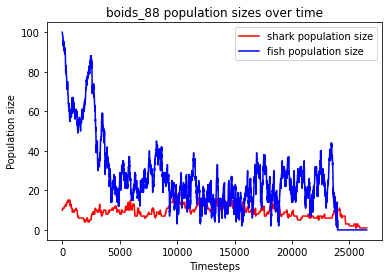

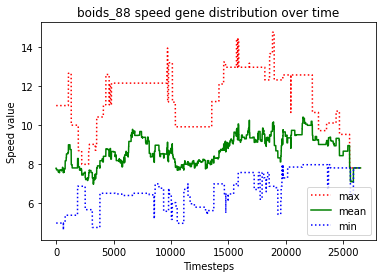

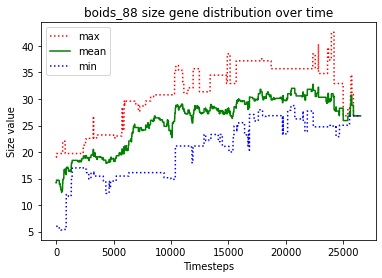

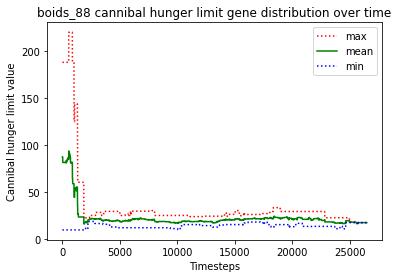

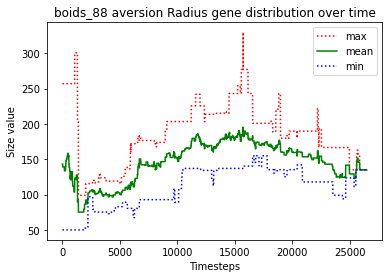

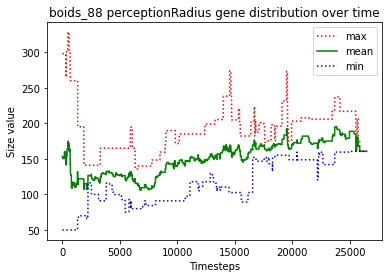

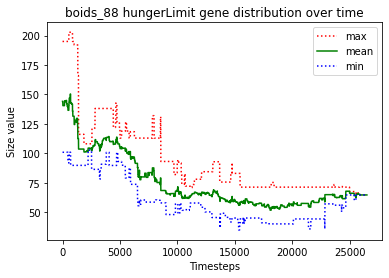





						BOIDS_89

predator_7 just gave birth to predator_10
predator_1 just gave birth to predator_11
predator_7 killed predator_10
predator_11 just gave birth to predator_12
predator_7 killed predator_8
predator_2 just gave birth to predator_13
predator_2 killed predator_13
predator_11 killed predator_0
predator_5 just gave birth to predator_14
predator_11 killed predator_6
predator_11 killed predator_5
predator_11 just gave birth to predator_15
predator_7 killed predator_14
predator_12 just gave birth to predator_16
predator_7 starved to death
predator_15 starved to death
predator_12 ate the carcass of predator_7_carcass
predator_4 starved to death
predator_2 ate the carcass of predator_4_carcass
predator_12 ate the carcass of predator_15_carcass
predator_16 just gave birth to predator_17
predator_17 starved to death
predator_2 ate the carcass of predator_17_carcass
predator_1 just gave birth to predator_18
predator_16 starved to death
predator_1 ate the carcass of predator_16_carc

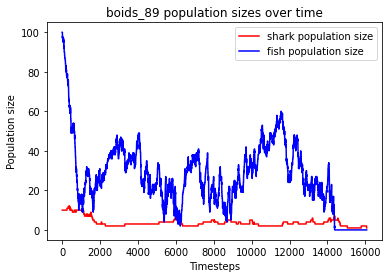

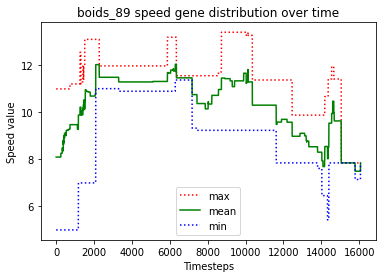

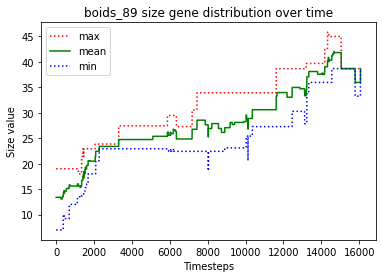

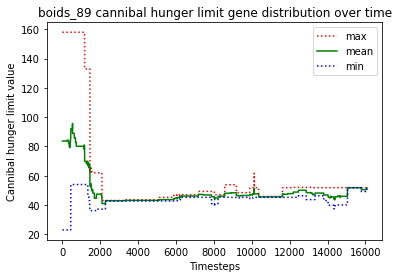

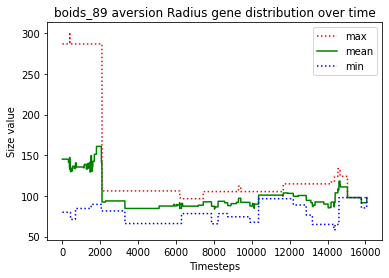

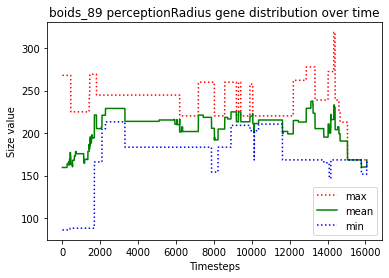

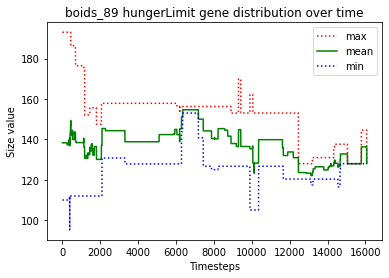





						BOIDS_90

predator_2 just gave birth to predator_10
predator_9 just gave birth to predator_11
predator_0 just gave birth to predator_12
predator_1 just gave birth to predator_13
predator_2 just gave birth to predator_14
predator_1 just gave birth to predator_15
predator_9 just gave birth to predator_16
predator_8 just gave birth to predator_17
predator_9 starved to death
predator_16 ate the carcass of predator_9_carcass
predator_1 just gave birth to predator_18
predator_1 starved to death
predator_18 starved to death
predator_3 ate the carcass of predator_1_carcass
predator_15 starved to death
predator_13 starved to death
predator_17 ate the carcass of predator_13_carcass
predator_16 ate the carcass of predator_15_carcass
predator_11 starved to death
predator_14 starved to death
predator_10 ate the carcass of predator_11_carcass
predator_17 ate the carcass of predator_14_carcass
predator_17 ate the carcass of predator_18_carcass
predator_0 starved to death
predator_2 starved 

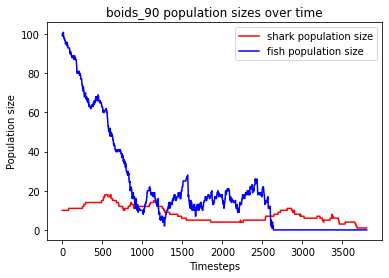

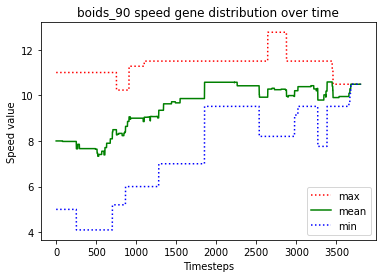

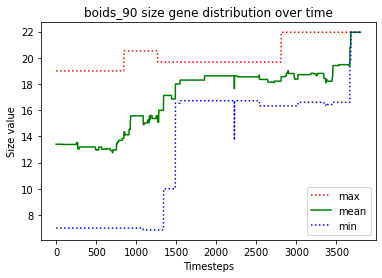

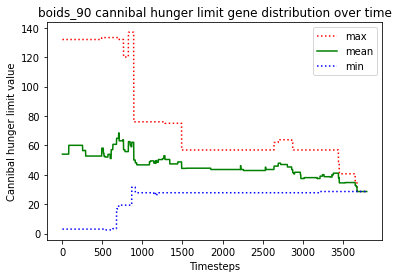

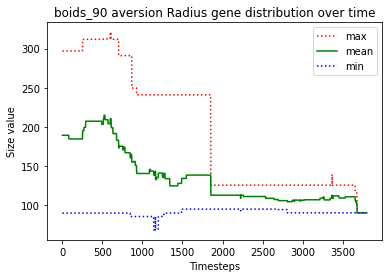

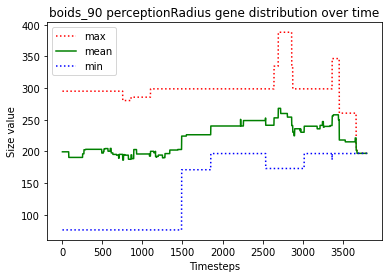

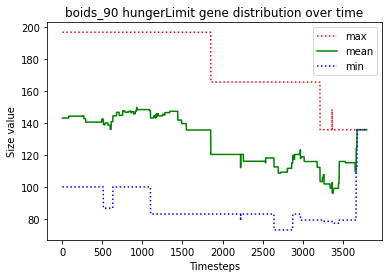





						BOIDS_91

predator_9 just gave birth to predator_10
predator_2 just gave birth to predator_11
predator_5 just gave birth to predator_12
predator_6 just gave birth to predator_13
predator_5 killed predator_0
predator_6 just gave birth to predator_14
predator_3 just gave birth to predator_15
predator_5 killed predator_9
predator_2 just gave birth to predator_16
predator_5 killed predator_10
predator_16 just gave birth to predator_17
predator_14 starved to death
predator_17 starved to death
predator_16 starved to death
no fish to move
predator_2 ate the carcass of predator_14_carcass
predator_11 ate the carcass of predator_17_carcass
predator_7 ate the carcass of predator_16_carcass
predator_12 just gave birth to predator_18
predator_4 killed predator_5
predator_13 starved to death
predator_12 starved to death
predator_18 starved to death
predator_1 ate the carcass of predator_18_carcass
predator_2 starved to death
predator_11 ate the carcass of predator_2_carcass
predator_7 ate

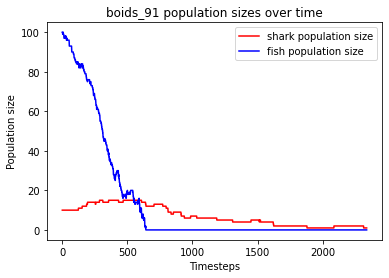

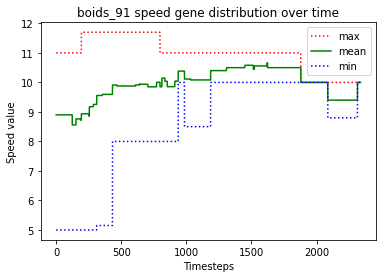

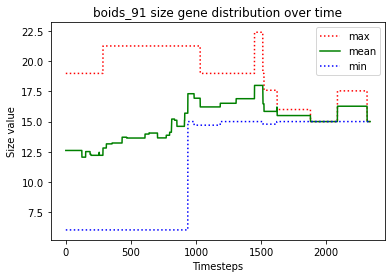

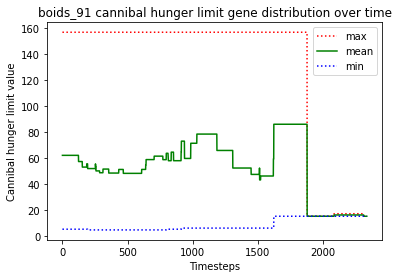

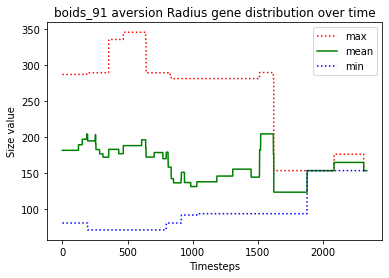

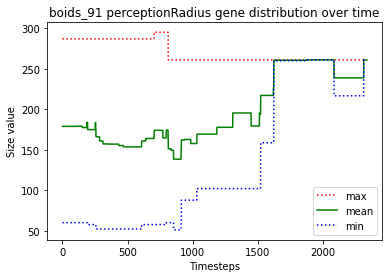

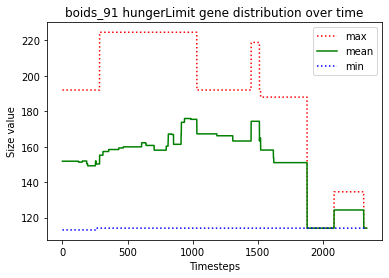





						BOIDS_92

predator_4 just gave birth to predator_10
predator_6 just gave birth to predator_11
predator_10 just gave birth to predator_12
predator_11 just gave birth to predator_13
predator_4 just gave birth to predator_14
predator_5 just gave birth to predator_15
predator_2 just gave birth to predator_16
predator_10 just gave birth to predator_17
predator_1 just gave birth to predator_18
predator_1 just gave birth to predator_19
predator_19 killed predator_15
predator_5 just gave birth to predator_20
predator_20 starved to death
predator_4 just gave birth to predator_21
predator_5 starved to death
predator_12 killed predator_16
predator_19 ate the carcass of predator_5_carcass
predator_19 ate the carcass of predator_20_carcass
predator_13 starved to death
predator_21 just gave birth to predator_22
predator_21 killed predator_8
predator_22 starved to death
predator_4 ate the carcass of predator_13_carcass
predator_3 just gave birth to predator_23
predator_6 just gave birth to 

predator_55 just gave birth to predator_74
predator_74 killed predator_65
predator_55 killed predator_67
predator_55 killed predator_73
predator_69 starved to death
predator_72 ate the carcass of predator_69_carcass
predator_70 starved to death
predator_74 ate the carcass of predator_70_carcass
predator_74 killed predator_48
predator_74 killed predator_44
predator_47 just gave birth to predator_75
predator_71 just gave birth to predator_76
predator_55 just gave birth to predator_77
predator_74 killed predator_77
predator_72 starved to death
predator_55 ate the carcass of predator_72_carcass
predator_74 just gave birth to predator_78
predator_74 killed predator_78
predator_75 just gave birth to predator_79
predator_75 starved to death
predator_74 ate the carcass of predator_75_carcass
predator_79 killed predator_47
predator_79 just gave birth to predator_80
predator_79 just gave birth to predator_81
predator_79 starved to death
predator_55 ate the carcass of predator_79_carcass
predator

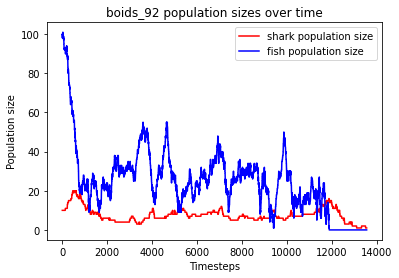

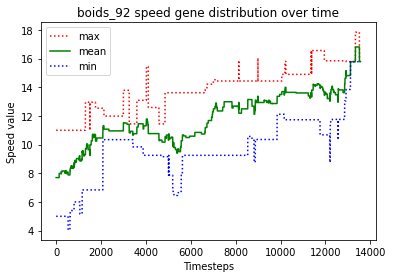

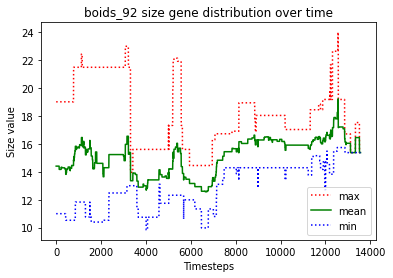

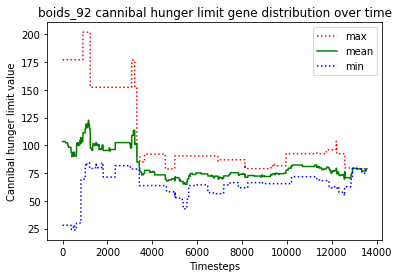

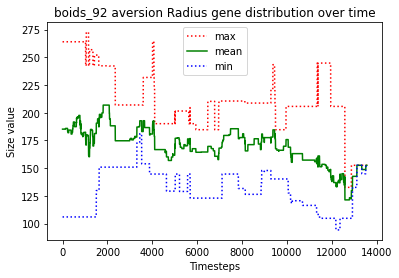

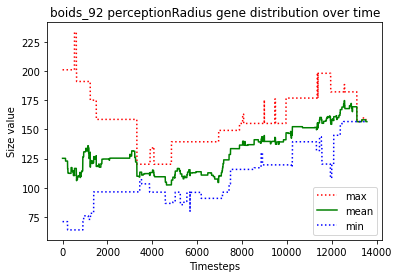

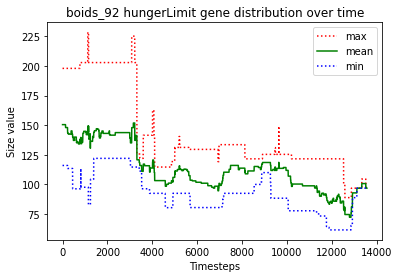





						BOIDS_93

predator_1 just gave birth to predator_10
predator_8 just gave birth to predator_11
predator_2 just gave birth to predator_12
predator_0 just gave birth to predator_13
predator_11 killed predator_4
predator_11 killed predator_9
predator_11 just gave birth to predator_14
predator_11 just gave birth to predator_15
predator_8 killed predator_7
predator_11 starved to death
predator_3 ate the carcass of predator_11_carcass
predator_14 starved to death
predator_15 starved to death
predator_8 just gave birth to predator_16
predator_8 killed predator_16
predator_13 ate the carcass of predator_15_carcass
predator_13 ate the carcass of predator_14_carcass
predator_8 killed predator_10
predator_6 just gave birth to predator_17
predator_2 starved to death
predator_8 ate the carcass of predator_2_carcass
predator_12 starved to death
predator_13 ate the carcass of predator_12_carcass
predator_5 just gave birth to predator_18
predator_5 starved to death
predator_18 ate the carcass

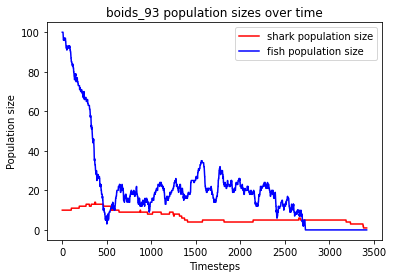

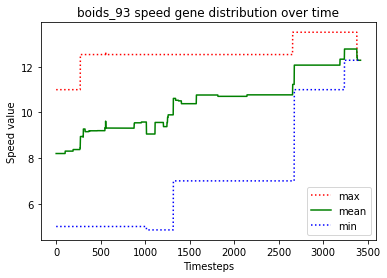

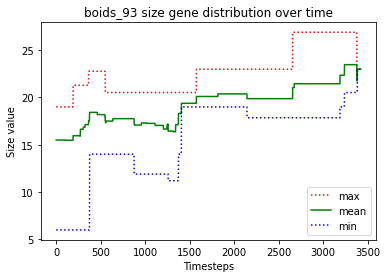

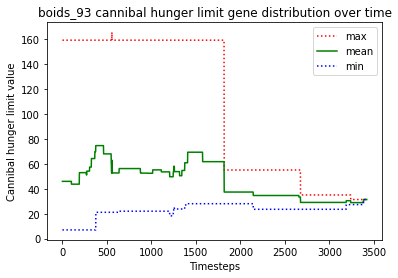

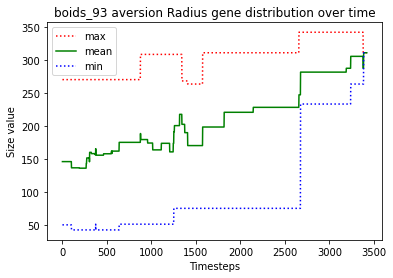

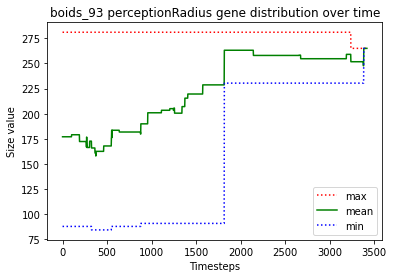

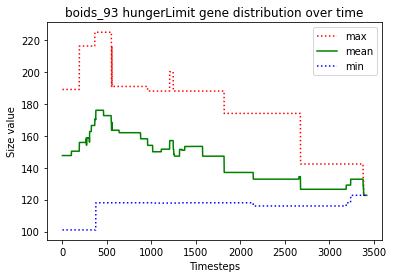





						BOIDS_94

predator_5 just gave birth to predator_10
predator_10 just gave birth to predator_11
predator_11 just gave birth to predator_12
predator_12 killed predator_10
predator_12 just gave birth to predator_13
predator_12 starved to death
predator_11 starved to death
predator_7 ate the carcass of predator_12_carcass
predator_4 ate the carcass of predator_11_carcass
predator_2 just gave birth to predator_14
predator_13 starved to death
predator_4 ate the carcass of predator_13_carcass
predator_3 just gave birth to predator_15
predator_14 starved to death
predator_2 ate the carcass of predator_14_carcass
predator_4 just gave birth to predator_16
predator_16 killed predator_5
predator_4 killed predator_6
predator_0 just gave birth to predator_17
predator_16 killed predator_3
predator_2 starved to death
predator_8 ate the carcass of predator_2_carcass
predator_4 killed predator_1
predator_16 just gave birth to predator_18
predator_0 starved to death
predator_16 killed predator_

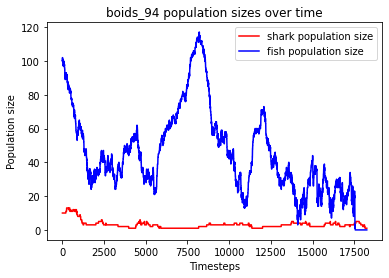

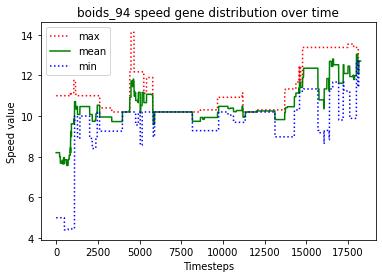

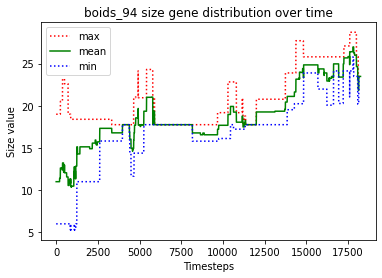

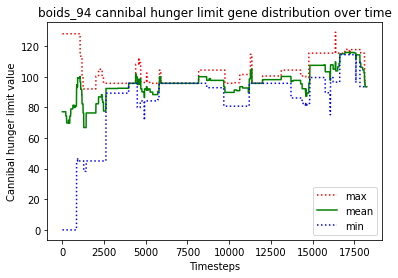

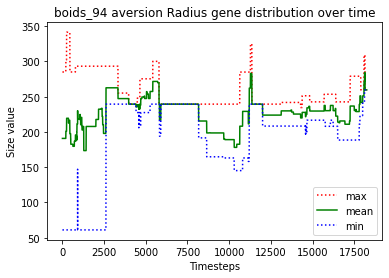

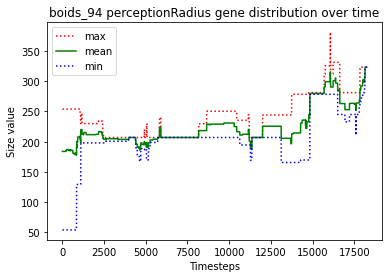

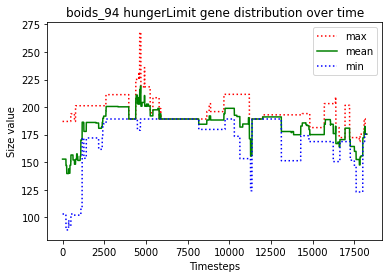





						BOIDS_95

predator_0 just gave birth to predator_10
predator_10 just gave birth to predator_11
predator_3 just gave birth to predator_12
predator_9 just gave birth to predator_13
predator_2 just gave birth to predator_14
predator_11 starved to death
predator_7 ate the carcass of predator_11_carcass
predator_10 starved to death
predator_9 ate the carcass of predator_10_carcass
predator_4 just gave birth to predator_15
predator_2 starved to death
predator_9 just gave birth to predator_16
predator_14 starved to death
predator_3 ate the carcass of predator_2_carcass
predator_7 just gave birth to predator_17
predator_12 just gave birth to predator_18
predator_6 ate the carcass of predator_14_carcass
predator_12 starved to death
predator_8 starved to death
predator_18 starved to death
predator_0 ate the carcass of predator_8_carcass
predator_3 ate the carcass of predator_18_carcass
predator_3 ate the carcass of predator_12_carcass
predator_9 killed predator_5
predator_16 just gave 

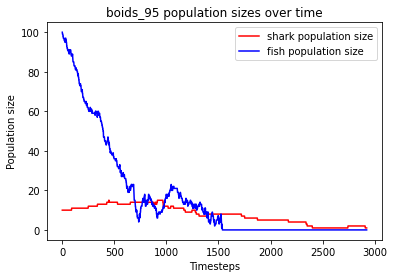

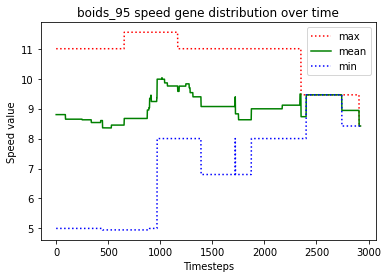

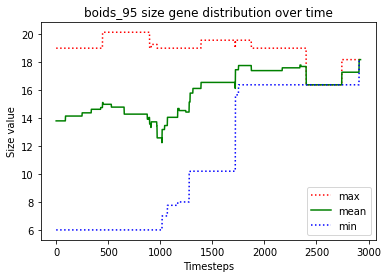

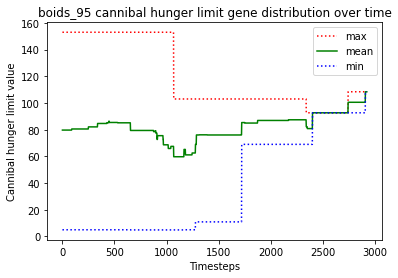

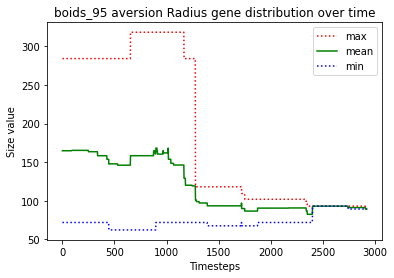

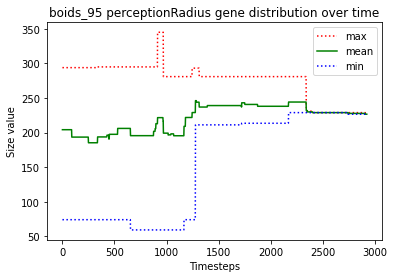

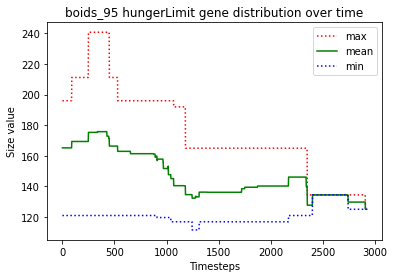





						BOIDS_96

predator_6 just gave birth to predator_10
predator_5 just gave birth to predator_11
predator_11 killed predator_0
predator_10 killed predator_7
predator_1 just gave birth to predator_12
predator_5 killed predator_8
predator_5 killed predator_1
predator_2 just gave birth to predator_13
predator_4 just gave birth to predator_14
predator_14 just gave birth to predator_15
predator_10 just gave birth to predator_16
predator_14 just gave birth to predator_17
predator_11 killed predator_13
predator_16 killed predator_2
predator_15 killed predator_5
predator_17 killed predator_3
predator_9 just gave birth to predator_18
predator_14 starved to death
predator_16 ate the carcass of predator_14_carcass
predator_4 just gave birth to predator_19
predator_10 killed predator_12
predator_15 starved to death
predator_10 ate the carcass of predator_15_carcass
predator_17 killed predator_18
predator_17 starved to death
predator_9 ate the carcass of predator_17_carcass
predator_16 just 

predator_71 killed predator_48
predator_59 starved to death
predator_69 just gave birth to predator_75
predator_73 ate the carcass of predator_59_carcass
predator_66 just gave birth to predator_76
predator_72 starved to death
predator_73 ate the carcass of predator_72_carcass
predator_76 just gave birth to predator_77
predator_75 just gave birth to predator_78
predator_71 just gave birth to predator_79
predator_69 starved to death
predator_79 ate the carcass of predator_69_carcass
predator_66 just gave birth to predator_80
predator_75 just gave birth to predator_81
predator_81 starved to death
predator_75 starved to death
no fish to move
predator_77 just gave birth to predator_82
predator_80 ate the carcass of predator_75_carcass
predator_78 starved to death
predator_80 ate the carcass of predator_81_carcass
predator_82 starved to death
predator_77 starved to death
predator_74 ate the carcass of predator_82_carcass
predator_71 just gave birth to predator_83
predator_83 starved to death

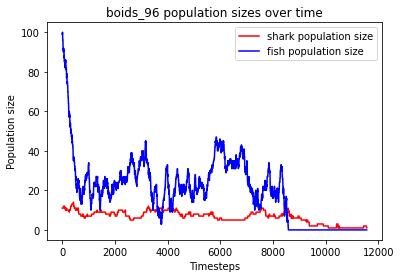

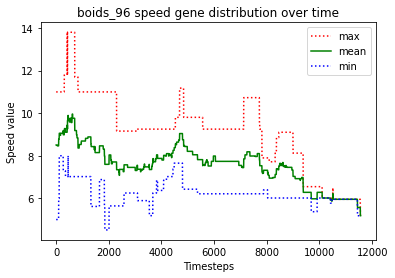

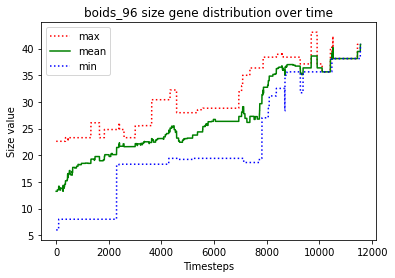

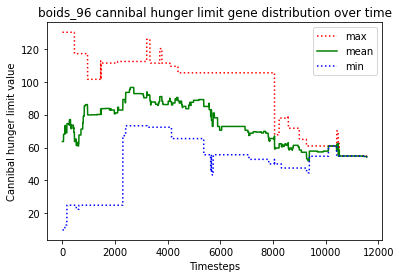

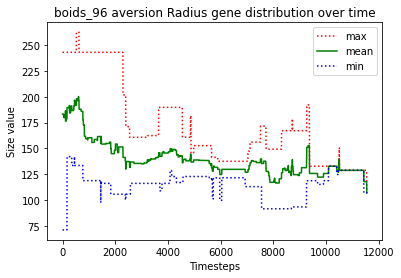

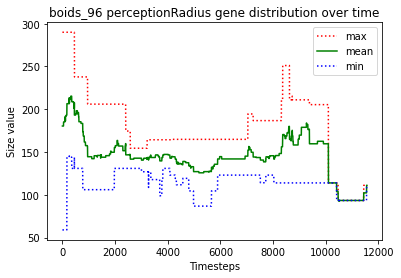

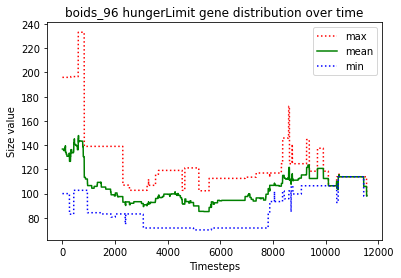





						BOIDS_97

predator_0 just gave birth to predator_10
predator_2 just gave birth to predator_11
predator_10 killed predator_1
predator_9 just gave birth to predator_12
predator_10 killed predator_5
predator_10 just gave birth to predator_13
predator_10 killed predator_13
predator_2 killed predator_8
predator_6 just gave birth to predator_14
predator_2 just gave birth to predator_15
predator_15 just gave birth to predator_16
predator_4 just gave birth to predator_17
predator_9 starved to death
predator_12 ate the carcass of predator_9_carcass
predator_16 starved to death
predator_10 ate the carcass of predator_16_carcass
predator_0 starved to death
predator_12 starved to death
predator_2 starved to death
predator_11 ate the carcass of predator_0_carcass
predator_14 ate the carcass of predator_12_carcass
predator_17 ate the carcass of predator_2_carcass
predator_15 starved to death
predator_17 ate the carcass of predator_15_carcass
predator_6 just gave birth to predator_18
predat

predator_66 just gave birth to predator_71
predator_70 just gave birth to predator_72
predator_70 just gave birth to predator_73
predator_73 starved to death
predator_60 ate the carcass of predator_73_carcass
predator_66 starved to death
predator_71 just gave birth to predator_74
predator_41 ate the carcass of predator_66_carcass
predator_74 just gave birth to predator_75
predator_46 just gave birth to predator_76
predator_76 just gave birth to predator_77
predator_74 killed predator_41
predator_77 starved to death
predator_76 starved to death
predator_75 ate the carcass of predator_77_carcass
predator_75 ate the carcass of predator_76_carcass
predator_46 starved to death
predator_71 ate the carcass of predator_46_carcass
predator_75 just gave birth to predator_78
predator_78 just gave birth to predator_79
predator_75 just gave birth to predator_80
predator_80 starved to death
predator_75 just gave birth to predator_81
predator_78 starved to death
predator_75 starved to death
predator_

predator_127 starved to death
predator_106 ate the carcass of predator_129_carcass
predator_130 starved to death
predator_106 ate the carcass of predator_130_carcass
predator_106 just gave birth to predator_131
predator_92 starved to death
predator_131 ate the carcass of predator_127_carcass
predator_131 ate the carcass of predator_92_carcass
predator_106 just gave birth to predator_132
predator_132 starved to death
predator_106 starved to death
predator_131 ate the carcass of predator_132_carcass
predator_131 ate the carcass of predator_106_carcass
predator_131 just gave birth to predator_133
predator_131 starved to death
predator_133 ate the carcass of predator_131_carcass
predator_133 starved to death


finished this run because predators went extinct
Fish left: 0
Sharks left: 0
Dead sharks: 134
Timesteps passed: 19825
Fish went extinct at timestep 16050
Sharks went extinct at timestep 19825


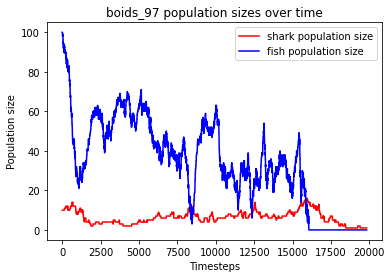

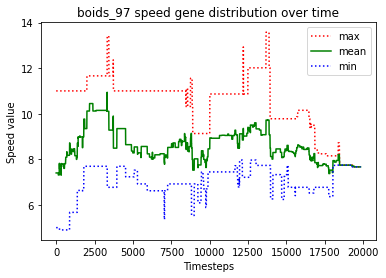

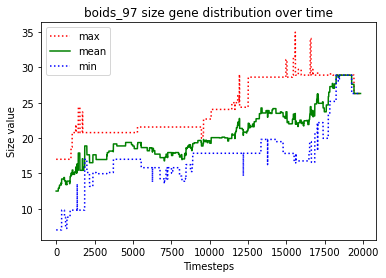

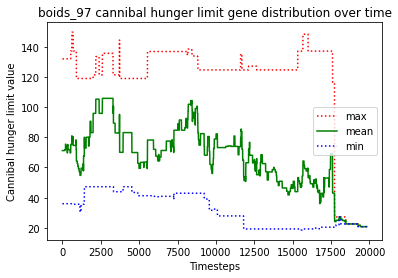

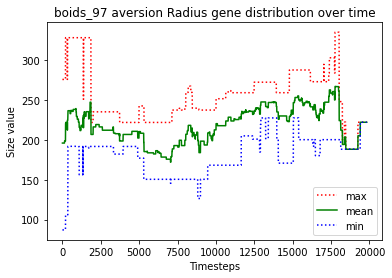

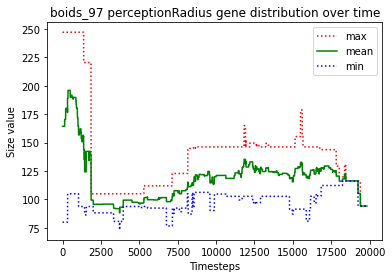

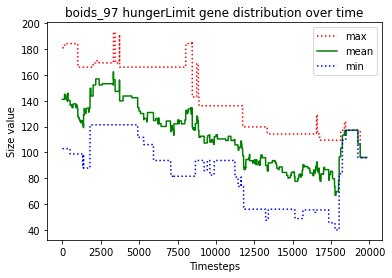





						BOIDS_98

predator_9 just gave birth to predator_10
predator_10 just gave birth to predator_11
predator_0 just gave birth to predator_12
predator_1 just gave birth to predator_13
predator_11 just gave birth to predator_14
predator_7 just gave birth to predator_15
predator_7 just gave birth to predator_16
predator_13 just gave birth to predator_17
predator_17 just gave birth to predator_18
predator_7 killed predator_0
predator_7 killed predator_6
predator_13 just gave birth to predator_19
predator_14 just gave birth to predator_20
predator_20 starved to death
predator_11 starved to death
predator_14 starved to death
predator_15 ate the carcass of predator_11_carcass
predator_3 ate the carcass of predator_14_carcass
predator_10 starved to death
predator_7 ate the carcass of predator_10_carcass
predator_2 just gave birth to predator_21
predator_5 ate the carcass of predator_20_carcass
predator_21 just gave birth to predator_22
predator_16 killed predator_4
predator_17 starved to

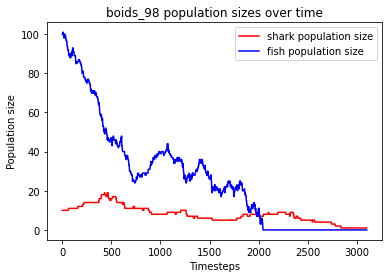

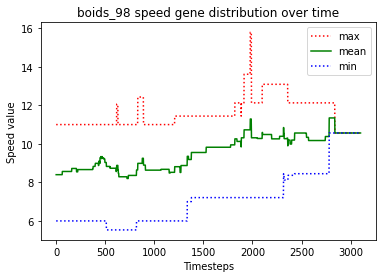

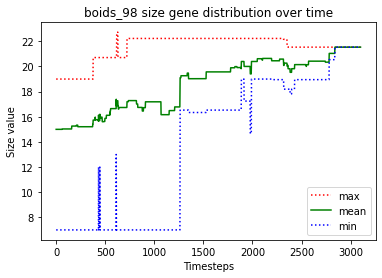

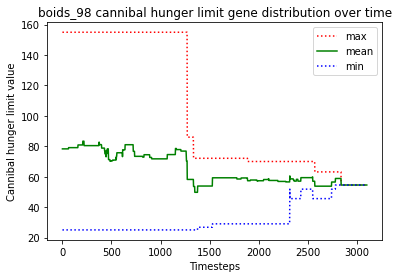

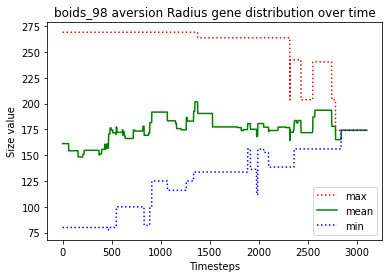

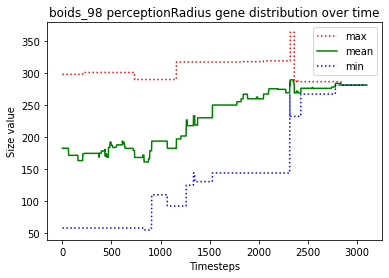

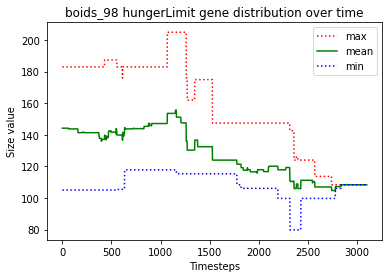





						BOIDS_99

predator_8 just gave birth to predator_10
predator_0 just gave birth to predator_11
predator_10 just gave birth to predator_12
predator_0 killed predator_7
predator_11 just gave birth to predator_13
predator_11 just gave birth to predator_14
predator_13 killed predator_6
predator_12 starved to death
predator_10 starved to death
predator_11 ate the carcass of predator_12_carcass
predator_11 ate the carcass of predator_10_carcass
predator_14 just gave birth to predator_15
predator_5 just gave birth to predator_16
predator_3 just gave birth to predator_17
predator_8 starved to death
predator_13 starved to death
predator_4 ate the carcass of predator_8_carcass
predator_11 ate the carcass of predator_13_carcass
predator_15 just gave birth to predator_18
predator_9 starved to death
predator_15 just gave birth to predator_19
predator_18 ate the carcass of predator_9_carcass
predator_1 just gave birth to predator_20
no fish to move
predator_16 starved to death
predator_5 st

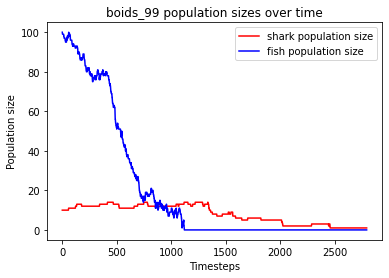

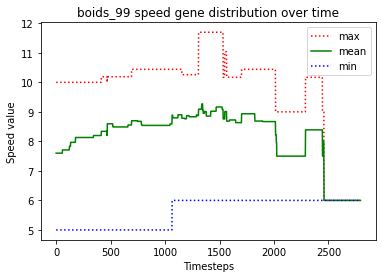

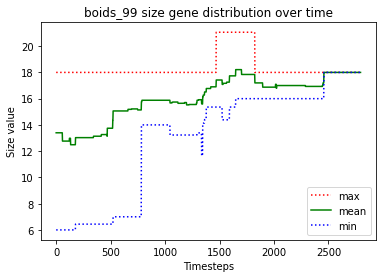

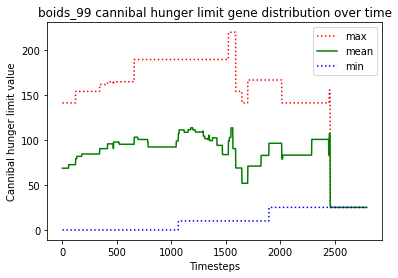

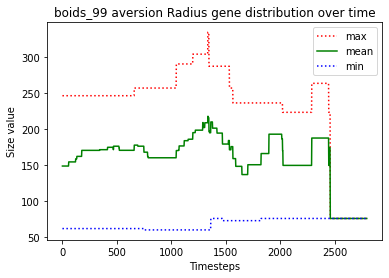

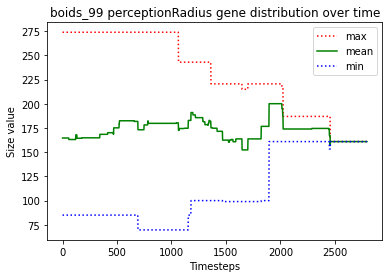

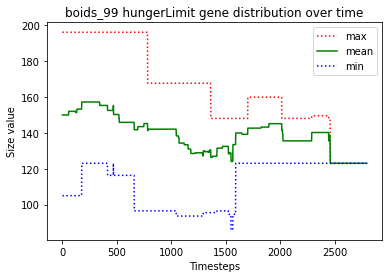





						SOLO_0

predator_8 just gave birth to predator_10
predator_8 just gave birth to predator_11
predator_5 just gave birth to predator_12
predator_6 just gave birth to predator_13
predator_4 just gave birth to predator_14
predator_4 killed predator_7
predator_14 killed predator_0
predator_1 just gave birth to predator_15
predator_4 killed predator_2
predator_11 just gave birth to predator_16
predator_3 just gave birth to predator_17
predator_16 starved to death
predator_11 ate the carcass of predator_16_carcass
predator_13 starved to death
predator_6 ate the carcass of predator_13_carcass
predator_14 killed predator_5
predator_1 just gave birth to predator_18
predator_6 starved to death
predator_3 ate the carcass of predator_6_carcass
predator_1 starved to death
predator_17 ate the carcass of predator_1_carcass
predator_14 killed predator_15
predator_18 starved to death
predator_8 ate the carcass of predator_18_carcass
predator_11 starved to death
predator_10 ate the carcass of p

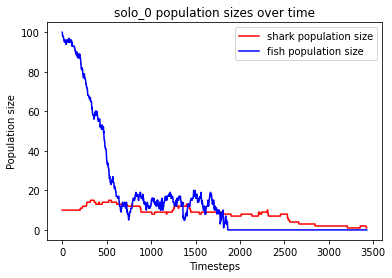

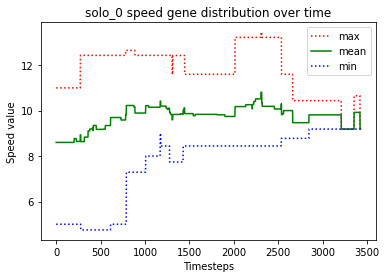

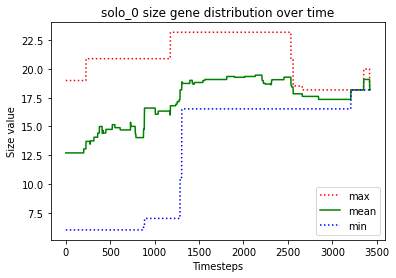

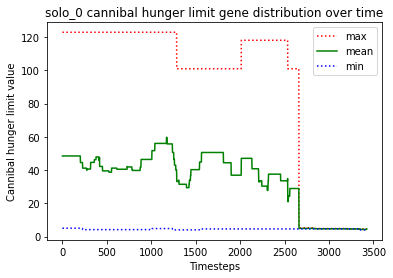

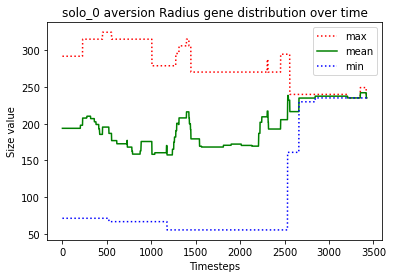

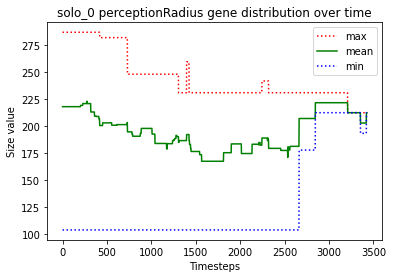

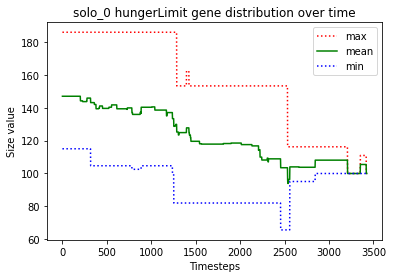





						SOLO_1

predator_5 just gave birth to predator_10
predator_3 just gave birth to predator_11
predator_5 killed predator_1
predator_10 killed predator_4
predator_5 killed predator_9
predator_5 killed predator_11
predator_6 just gave birth to predator_12
predator_0 just gave birth to predator_13
predator_5 just gave birth to predator_14
predator_8 just gave birth to predator_15
predator_5 just gave birth to predator_16
predator_13 just gave birth to predator_17
predator_12 just gave birth to predator_18
predator_12 killed predator_18
predator_6 starved to death
predator_7 just gave birth to predator_19
predator_15 ate the carcass of predator_6_carcass
predator_12 starved to death
predator_3 starved to death
predator_7 ate the carcass of predator_3_carcass
predator_8 killed predator_2
predator_13 ate the carcass of predator_12_carcass
predator_15 just gave birth to predator_20
predator_15 just gave birth to predator_21
predator_21 just gave birth to predator_22
predator_21 just g

predator_64 just gave birth to predator_74
predator_74 just gave birth to predator_75
predator_73 starved to death
predator_60 starved to death
predator_74 ate the carcass of predator_73_carcass
predator_74 ate the carcass of predator_60_carcass
predator_67 killed predator_75
predator_69 just gave birth to predator_76
predator_72 just gave birth to predator_77
predator_72 killed predator_77
predator_57 starved to death
predator_76 ate the carcass of predator_57_carcass
predator_76 just gave birth to predator_78
predator_67 killed predator_74
predator_64 just gave birth to predator_79
predator_72 starved to death
predator_79 ate the carcass of predator_72_carcass
predator_76 killed predator_78
predator_58 starved to death
predator_38 ate the carcass of predator_58_carcass
predator_69 just gave birth to predator_80
predator_79 just gave birth to predator_81
predator_79 killed predator_81
predator_70 just gave birth to predator_82
predator_69 just gave birth to predator_83
predator_64 jus

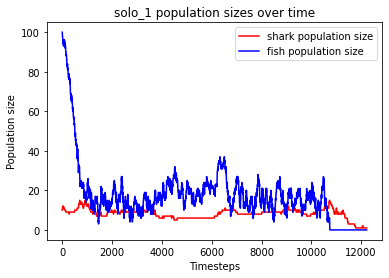

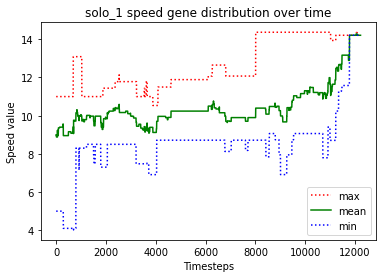

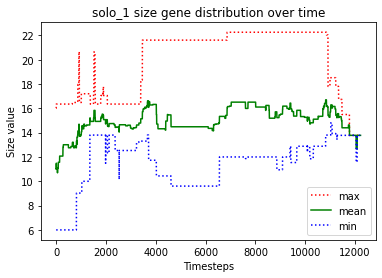

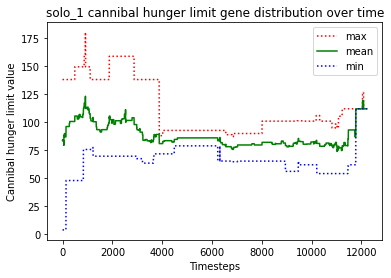

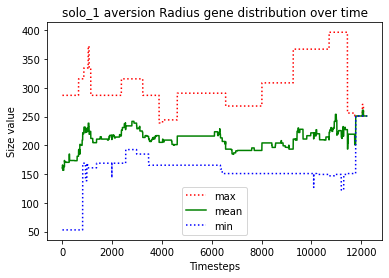

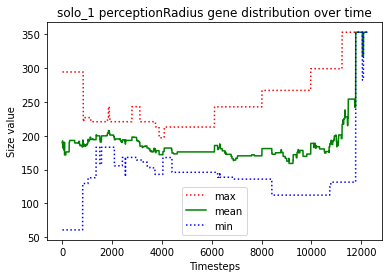

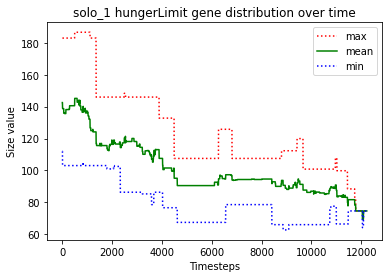





						SOLO_2

predator_4 just gave birth to predator_10
predator_7 just gave birth to predator_11
predator_9 just gave birth to predator_12
predator_10 just gave birth to predator_13
predator_7 just gave birth to predator_14
predator_14 just gave birth to predator_15
predator_2 just gave birth to predator_16
predator_8 just gave birth to predator_17
predator_7 starved to death
predator_3 just gave birth to predator_18
predator_15 starved to death
predator_3 ate the carcass of predator_7_carcass
predator_17 just gave birth to predator_19
predator_12 just gave birth to predator_20
predator_18 ate the carcass of predator_15_carcass
predator_13 starved to death
predator_2 just gave birth to predator_21
predator_3 ate the carcass of predator_13_carcass
predator_21 starved to death
predator_2 starved to death
predator_3 ate the carcass of predator_21_carcass
predator_16 just gave birth to predator_22
predator_3 ate the carcass of predator_2_carcass
predator_22 starved to death
predator_1

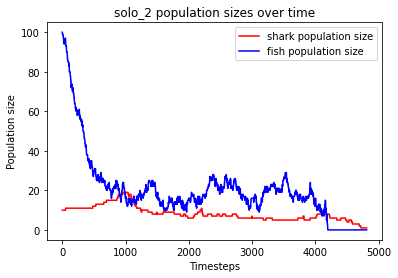

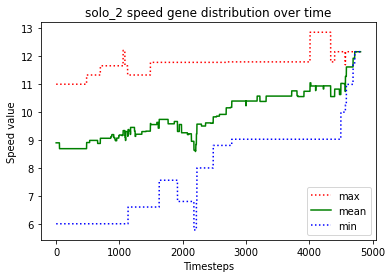

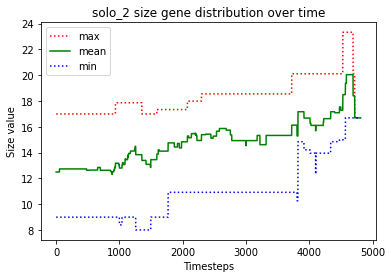

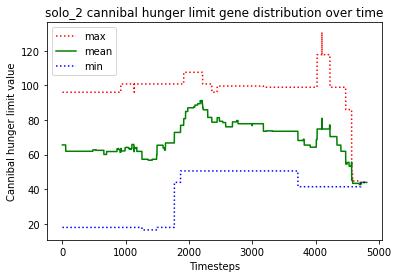

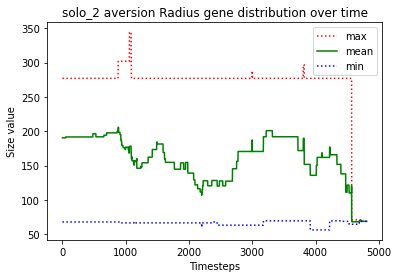

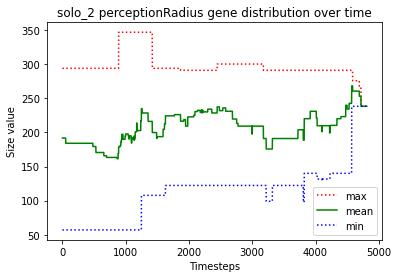

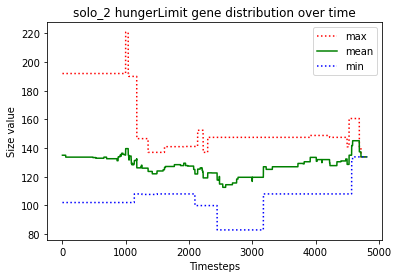





						SOLO_3

predator_5 just gave birth to predator_10
predator_9 just gave birth to predator_11
predator_3 just gave birth to predator_12
predator_3 just gave birth to predator_13
predator_13 killed predator_4
predator_13 killed predator_2
predator_9 killed predator_8
predator_3 killed predator_10
predator_3 starved to death
predator_7 ate the carcass of predator_3_carcass
predator_5 starved to death
predator_0 ate the carcass of predator_5_carcass
predator_13 killed predator_7
predator_6 just gave birth to predator_14
predator_6 killed predator_0
predator_13 starved to death
predator_9 just gave birth to predator_15
predator_12 ate the carcass of predator_13_carcass
predator_6 killed predator_1
predator_9 starved to death
predator_15 starved to death
predator_11 ate the carcass of predator_9_carcass
predator_12 ate the carcass of predator_15_carcass
predator_11 starved to death
predator_12 ate the carcass of predator_11_carcass
predator_6 just gave birth to predator_16
predator_

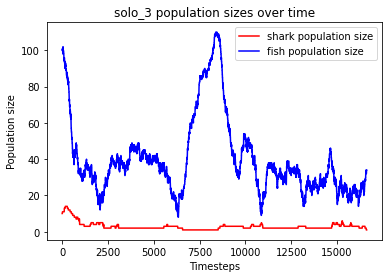

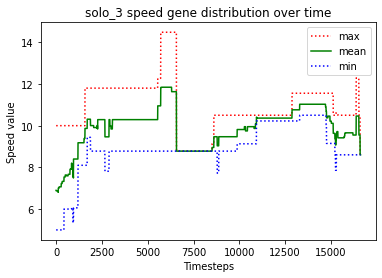

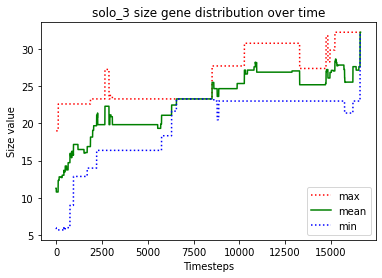

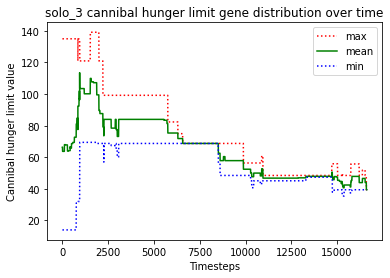

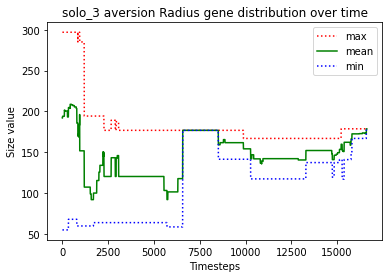

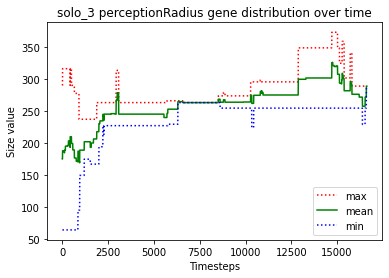

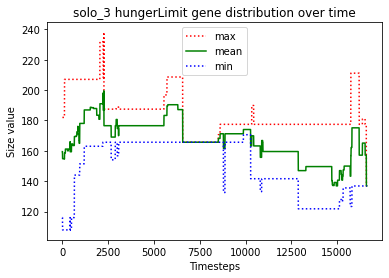





						SOLO_4

predator_3 just gave birth to predator_10
predator_3 killed predator_8
predator_3 killed predator_5
predator_10 just gave birth to predator_11
predator_0 just gave birth to predator_12
predator_6 just gave birth to predator_13
predator_6 killed predator_13
predator_11 just gave birth to predator_14
predator_6 just gave birth to predator_15
predator_0 just gave birth to predator_16
predator_10 starved to death
predator_3 ate the carcass of predator_10_carcass
predator_14 just gave birth to predator_17
predator_15 starved to death
predator_12 just gave birth to predator_18
predator_4 ate the carcass of predator_15_carcass
predator_17 starved to death
predator_11 ate the carcass of predator_17_carcass
predator_6 starved to death
predator_9 ate the carcass of predator_6_carcass
predator_7 just gave birth to predator_19
predator_0 starved to death
predator_2 just gave birth to predator_20
predator_16 starved to death
predator_9 ate the carcass of predator_0_carcass
predato

predator_36 just gave birth to predator_73
no fish to move
predator_70 starved to death
predator_71 starved to death
predator_67 ate the carcass of predator_70_carcass
predator_40 killed predator_69
predator_54 ate the carcass of predator_71_carcass
predator_72 just gave birth to predator_74
predator_65 just gave birth to predator_75
predator_67 just gave birth to predator_76
predator_36 starved to death
predator_67 just gave birth to predator_77
predator_73 just gave birth to predator_78
predator_67 ate the carcass of predator_36_carcass
predator_73 starved to death
predator_78 starved to death
predator_75 ate the carcass of predator_73_carcass
predator_77 starved to death
predator_75 ate the carcass of predator_78_carcass
predator_75 ate the carcass of predator_77_carcass
predator_74 starved to death
predator_75 ate the carcass of predator_74_carcass
predator_58 just gave birth to predator_79
predator_58 killed predator_76
predator_54 just gave birth to predator_80
predator_72 starve

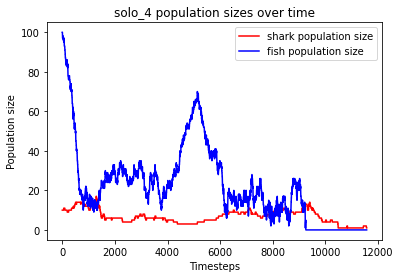

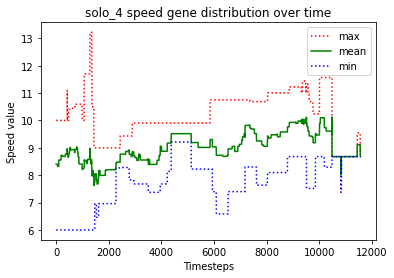

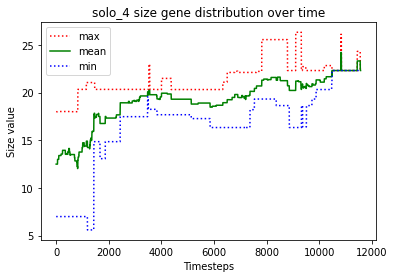

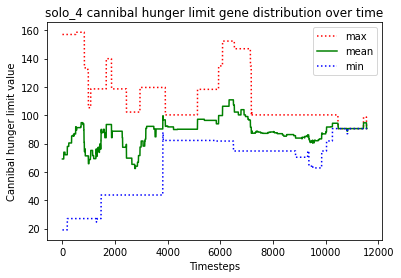

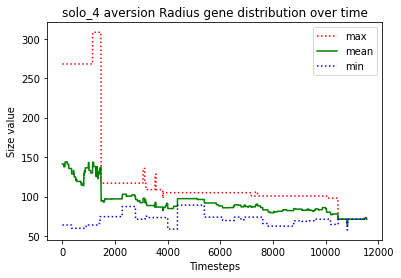

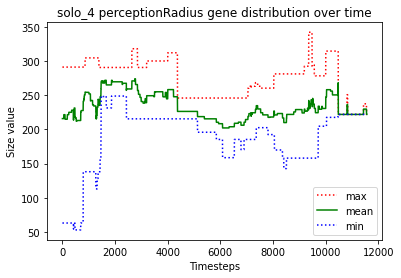

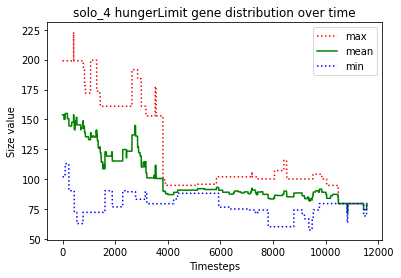





						SOLO_5

predator_7 just gave birth to predator_10
predator_5 just gave birth to predator_11
predator_9 just gave birth to predator_12
predator_10 killed predator_3
predator_9 just gave birth to predator_13
predator_13 just gave birth to predator_14
predator_0 just gave birth to predator_15
predator_13 starved to death
predator_0 killed predator_4
predator_15 just gave birth to predator_16
predator_7 ate the carcass of predator_13_carcass
predator_2 just gave birth to predator_17
predator_0 just gave birth to predator_18
predator_9 starved to death
predator_5 ate the carcass of predator_9_carcass
predator_17 just gave birth to predator_19
predator_16 just gave birth to predator_20
predator_12 starved to death
predator_17 starved to death
predator_14 starved to death
predator_19 starved to death
predator_5 ate the carcass of predator_14_carcass
predator_11 ate the carcass of predator_17_carcass
predator_15 just gave birth to predator_21
predator_11 ate the carcass of predator_1

predator_56 just gave birth to predator_68
predator_41 starved to death
predator_26 ate the carcass of predator_41_carcass
predator_68 starved to death
predator_56 just gave birth to predator_69
predator_56 ate the carcass of predator_68_carcass
no fish to move
predator_63 just gave birth to predator_70
predator_70 killed predator_26
predator_61 just gave birth to predator_71
predator_71 just gave birth to predator_72
predator_71 just gave birth to predator_73
predator_71 just gave birth to predator_74
predator_71 starved to death
predator_74 starved to death
predator_73 ate the carcass of predator_71_carcass
predator_73 ate the carcass of predator_74_carcass
predator_61 just gave birth to predator_75
predator_69 starved to death
predator_72 starved to death
predator_75 ate the carcass of predator_69_carcass
predator_56 ate the carcass of predator_72_carcass
predator_63 starved to death
predator_56 ate the carcass of predator_63_carcass
predator_70 starved to death
predator_61 starved 

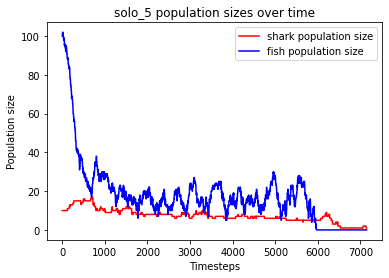

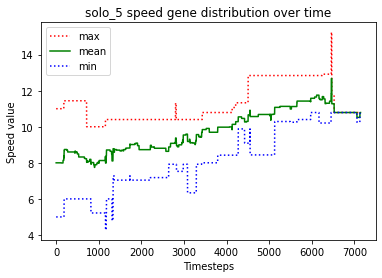

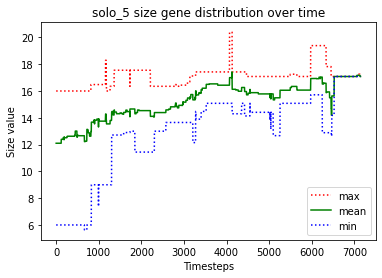

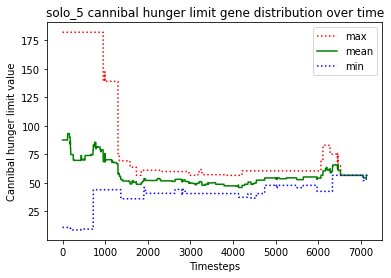

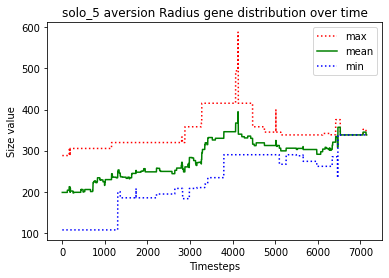

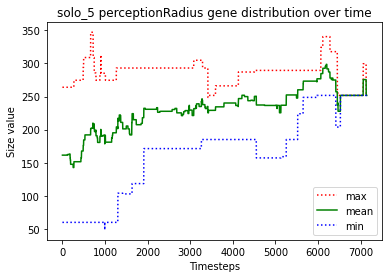

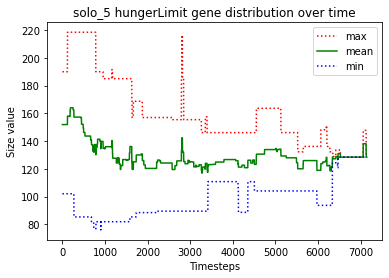





						SOLO_6

predator_8 just gave birth to predator_10
predator_6 just gave birth to predator_11
predator_11 just gave birth to predator_12
predator_12 killed predator_6
predator_11 just gave birth to predator_13
predator_9 just gave birth to predator_14
predator_1 just gave birth to predator_15
predator_12 killed predator_2
predator_14 just gave birth to predator_16
predator_0 just gave birth to predator_17
predator_13 just gave birth to predator_18
predator_8 just gave birth to predator_19
predator_3 just gave birth to predator_20
predator_1 just gave birth to predator_21
predator_1 killed predator_21
predator_18 killed predator_5
predator_18 killed predator_11
predator_13 starved to death
predator_14 ate the carcass of predator_13_carcass
predator_15 just gave birth to predator_22
predator_17 starved to death
predator_12 ate the carcass of predator_17_carcass
predator_3 just gave birth to predator_23
predator_18 killed predator_0
predator_16 starved to death
predator_12 ate the

predator_62 just gave birth to predator_70
predator_69 just gave birth to predator_71
predator_70 killed predator_69
predator_71 starved to death
predator_70 ate the carcass of predator_71_carcass
predator_62 just gave birth to predator_72
predator_70 just gave birth to predator_73
predator_72 just gave birth to predator_74
predator_62 starved to death
predator_70 ate the carcass of predator_62_carcass
predator_73 starved to death
predator_70 ate the carcass of predator_73_carcass
predator_72 just gave birth to predator_75
predator_75 just gave birth to predator_76
predator_75 killed predator_74
predator_76 starved to death
predator_75 ate the carcass of predator_76_carcass
predator_72 just gave birth to predator_77
predator_72 starved to death
predator_77 starved to death
predator_75 ate the carcass of predator_72_carcass
predator_75 just gave birth to predator_78
predator_78 ate the carcass of predator_77_carcass
predator_78 just gave birth to predator_79
predator_75 just gave birth 

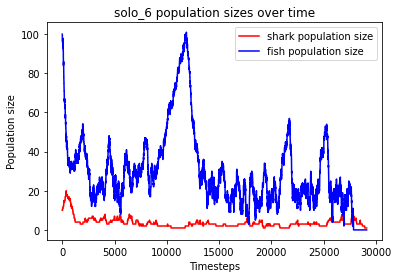

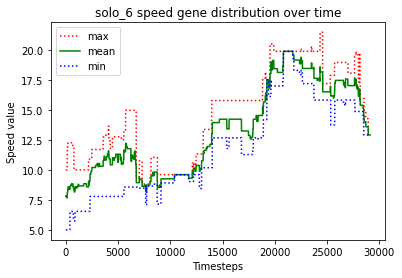

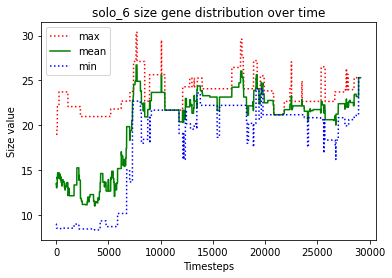

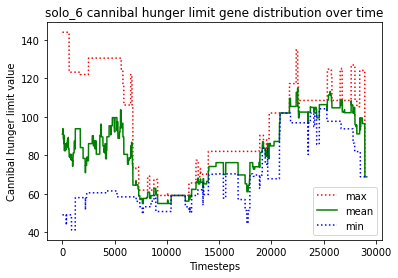

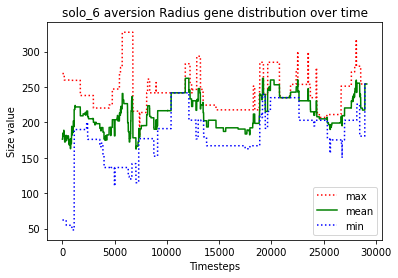

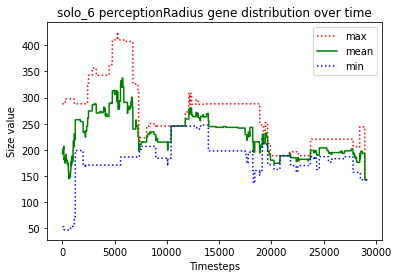

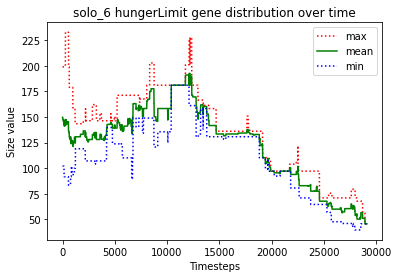





						SOLO_7

predator_3 just gave birth to predator_10
predator_10 killed predator_1
predator_3 killed predator_7
predator_5 just gave birth to predator_11
predator_5 just gave birth to predator_12
predator_0 just gave birth to predator_13
predator_13 just gave birth to predator_14
predator_8 just gave birth to predator_15
predator_14 starved to death
predator_8 just gave birth to predator_16
predator_15 ate the carcass of predator_14_carcass
predator_3 just gave birth to predator_17
no fish to move
predator_6 just gave birth to predator_18
predator_5 starved to death
predator_3 just gave birth to predator_19
predator_0 ate the carcass of predator_5_carcass
predator_19 starved to death
predator_3 starved to death
predator_17 starved to death
predator_8 starved to death
predator_16 starved to death
predator_10 ate the carcass of predator_8_carcass
predator_10 ate the carcass of predator_3_carcass
predator_10 ate the carcass of predator_17_carcass
predator_13 ate the carcass of pred

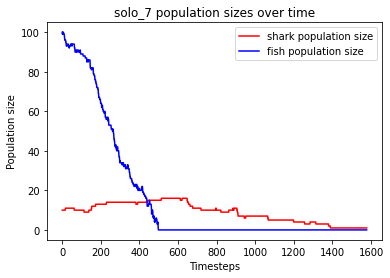

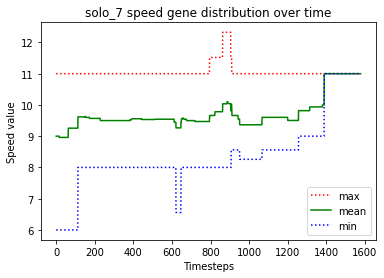

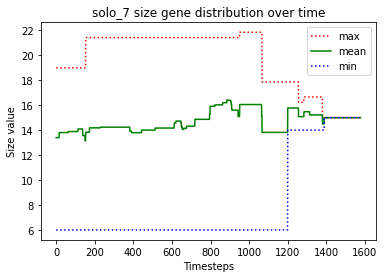

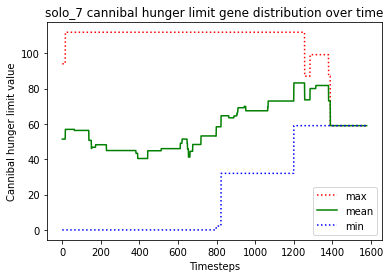

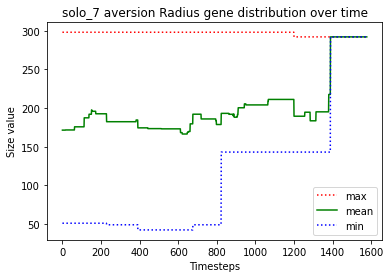

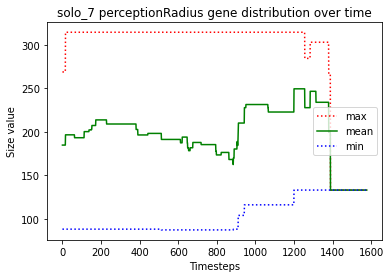

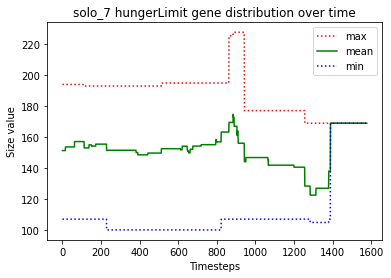





						SOLO_8

predator_6 just gave birth to predator_10
predator_10 just gave birth to predator_11
predator_3 just gave birth to predator_12
predator_11 starved to death
predator_4 ate the carcass of predator_11_carcass
predator_6 just gave birth to predator_13
predator_10 starved to death
predator_5 ate the carcass of predator_10_carcass
predator_8 just gave birth to predator_14
predator_6 starved to death
predator_12 ate the carcass of predator_6_carcass
predator_12 just gave birth to predator_15
predator_13 just gave birth to predator_16
predator_15 just gave birth to predator_17
predator_1 just gave birth to predator_18
predator_13 starved to death
predator_16 starved to death
predator_0 just gave birth to predator_19
predator_9 just gave birth to predator_20
predator_5 ate the carcass of predator_16_carcass
predator_5 ate the carcass of predator_13_carcass
predator_20 just gave birth to predator_21
predator_1 just gave birth to predator_22
predator_19 just gave birth to predat

predator_68 starved to death
predator_66 starved to death
predator_63 ate the carcass of predator_68_carcass
predator_65 ate the carcass of predator_66_carcass
predator_54 just gave birth to predator_69
predator_64 starved to death
predator_63 ate the carcass of predator_64_carcass
predator_65 starved to death
predator_49 ate the carcass of predator_65_carcass
predator_62 starved to death
predator_31 ate the carcass of predator_62_carcass
predator_67 just gave birth to predator_70
predator_70 starved to death
predator_67 starved to death
predator_63 ate the carcass of predator_67_carcass
predator_31 just gave birth to predator_71
predator_69 just gave birth to predator_72
predator_71 just gave birth to predator_73
predator_31 ate the carcass of predator_70_carcass
predator_72 starved to death
predator_69 starved to death
predator_54 ate the carcass of predator_72_carcass
predator_49 ate the carcass of predator_69_carcass
predator_2 just gave birth to predator_74
predator_71 starved to 

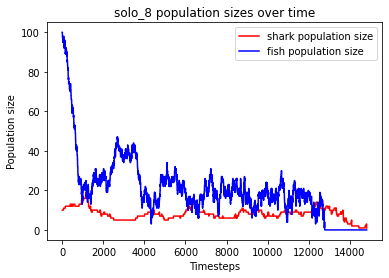

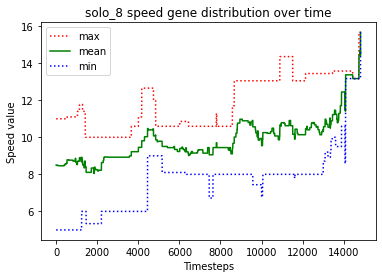

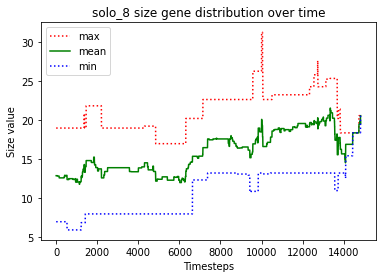

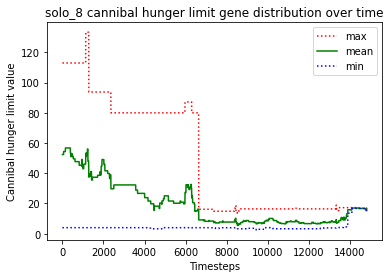

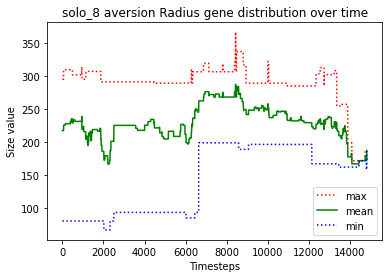

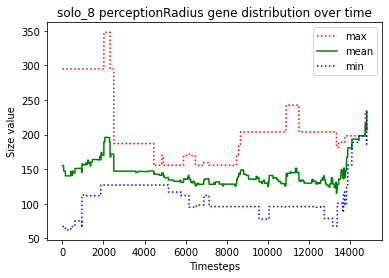

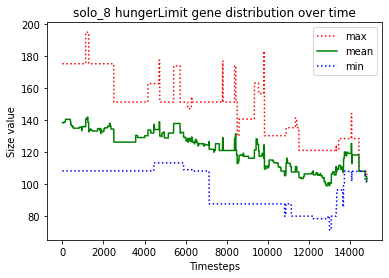





						SOLO_9

predator_6 just gave birth to predator_10
predator_6 killed predator_1
predator_6 killed predator_2
predator_6 killed predator_7
predator_10 killed predator_5
predator_6 killed predator_8
predator_9 just gave birth to predator_11
predator_6 killed predator_3
predator_9 starved to death
predator_11 ate the carcass of predator_9_carcass
predator_11 just gave birth to predator_12
predator_11 starved to death
predator_12 ate the carcass of predator_11_carcass
predator_10 starved to death
predator_0 ate the carcass of predator_10_carcass
predator_12 just gave birth to predator_13
predator_13 starved to death
predator_12 ate the carcass of predator_13_carcass
predator_6 just gave birth to predator_14
predator_12 just gave birth to predator_15
predator_15 starved to death
predator_12 ate the carcass of predator_15_carcass
predator_12 just gave birth to predator_16
predator_6 just gave birth to predator_17
predator_6 just gave birth to predator_18
predator_6 starved to death


predator_67 killed predator_60
predator_72 just gave birth to predator_73
predator_70 just gave birth to predator_74
predator_55 just gave birth to predator_75
predator_55 killed predator_75
predator_50 starved to death
predator_73 killed predator_74
predator_72 ate the carcass of predator_50_carcass
predator_70 starved to death
predator_55 ate the carcass of predator_70_carcass
predator_51 just gave birth to predator_76
predator_51 just gave birth to predator_77
predator_67 just gave birth to predator_78
predator_72 starved to death
predator_62 just gave birth to predator_79
predator_77 starved to death
predator_51 ate the carcass of predator_77_carcass
predator_76 starved to death
predator_62 ate the carcass of predator_72_carcass
predator_67 just gave birth to predator_80
predator_79 ate the carcass of predator_76_carcass
predator_55 just gave birth to predator_81
predator_78 killed predator_80
predator_78 just gave birth to predator_82
predator_52 just gave birth to predator_83
pre

predator_133 killed predator_117
predator_131 just gave birth to predator_134
predator_131 just gave birth to predator_135
predator_135 starved to death
predator_131 ate the carcass of predator_135_carcass
predator_134 starved to death
predator_111 just gave birth to predator_136
predator_133 just gave birth to predator_137
predator_132 ate the carcass of predator_134_carcass
predator_133 just gave birth to predator_138
predator_138 starved to death
predator_133 starved to death
predator_118 ate the carcass of predator_133_carcass
predator_136 starved to death
predator_82 just gave birth to predator_139
predator_82 ate the carcass of predator_136_carcass
predator_137 starved to death
predator_111 ate the carcass of predator_137_carcass
predator_82 ate the carcass of predator_138_carcass
predator_139 starved to death
predator_131 ate the carcass of predator_139_carcass
predator_82 just gave birth to predator_140
predator_131 killed predator_140
predator_118 just gave birth to predator_1

predator_115 ate the carcass of predator_185_carcass
predator_187 starved to death
predator_115 ate the carcass of predator_187_carcass
predator_193 just gave birth to predator_195
predator_195 starved to death
predator_193 ate the carcass of predator_195_carcass
predator_190 just gave birth to predator_196
predator_115 just gave birth to predator_197
predator_193 killed predator_197
predator_115 just gave birth to predator_198
predator_115 just gave birth to predator_199
predator_174 just gave birth to predator_200
predator_174 killed predator_200
predator_190 starved to death
predator_193 ate the carcass of predator_190_carcass
predator_193 just gave birth to predator_201
predator_194 just gave birth to predator_202
predator_202 killed predator_115
predator_199 starved to death
predator_174 just gave birth to predator_203
predator_201 starved to death
predator_198 ate the carcass of predator_199_carcass
predator_198 just gave birth to predator_204
predator_193 killed predator_196
pre

predator_223 just gave birth to predator_259
predator_241 ate the carcass of predator_238_carcass
predator_239 just gave birth to predator_260
predator_246 ate the carcass of predator_258_carcass
predator_250 just gave birth to predator_261
predator_250 just gave birth to predator_262
predator_241 just gave birth to predator_263
predator_250 just gave birth to predator_264
predator_264 killed predator_262
predator_250 starved to death
predator_259 ate the carcass of predator_250_carcass
predator_264 killed predator_263
predator_241 starved to death
predator_223 just gave birth to predator_265
predator_259 ate the carcass of predator_241_carcass
predator_246 just gave birth to predator_266
predator_251 just gave birth to predator_267
predator_266 just gave birth to predator_268
predator_264 killed predator_268
predator_267 just gave birth to predator_269
predator_253 just gave birth to predator_270
predator_266 starved to death
predator_269 just gave birth to predator_271
predator_265 k

predator_319 starved to death
predator_295 just gave birth to predator_323
predator_314 starved to death
predator_292 ate the carcass of predator_314_carcass
predator_260 ate the carcass of predator_319_carcass
predator_323 starved to death
predator_260 just gave birth to predator_324
predator_285 ate the carcass of predator_323_carcass
predator_302 starved to death
predator_276 just gave birth to predator_325
predator_260 ate the carcass of predator_302_carcass
predator_325 starved to death
predator_276 starved to death
predator_307 starved to death
predator_324 ate the carcass of predator_276_carcass
predator_295 ate the carcass of predator_307_carcass
predator_295 just gave birth to predator_326
predator_292 just gave birth to predator_327
predator_324 ate the carcass of predator_325_carcass
predator_326 just gave birth to predator_328
predator_328 starved to death
predator_295 just gave birth to predator_329
predator_326 starved to death
predator_285 ate the carcass of predator_328

predator_375 starved to death
predator_380 starved to death
predator_379 ate the carcass of predator_371_carcass
predator_379 just gave birth to predator_381
predator_381 ate the carcass of predator_375_carcass
predator_379 ate the carcass of predator_380_carcass
predator_381 just gave birth to predator_382
predator_381 starved to death
predator_382 starved to death
predator_379 ate the carcass of predator_381_carcass
predator_379 ate the carcass of predator_382_carcass
predator_379 starved to death


finished this run because predators went extinct
Fish left: 0
Sharks left: 0
Dead sharks: 383
Timesteps passed: 54974
Fish went extinct at timestep 52183
Sharks went extinct at timestep 54974


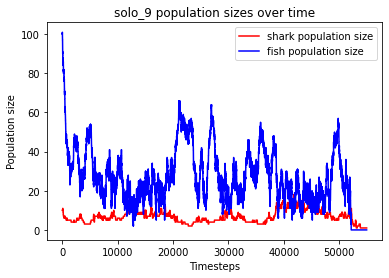

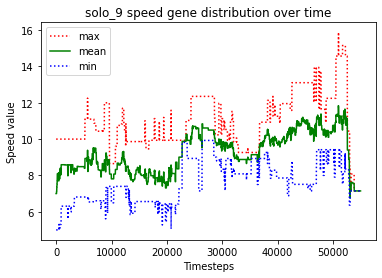

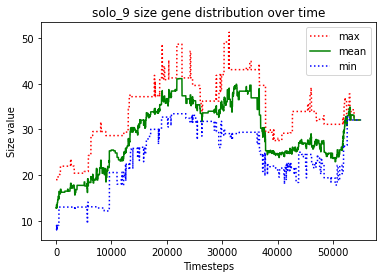

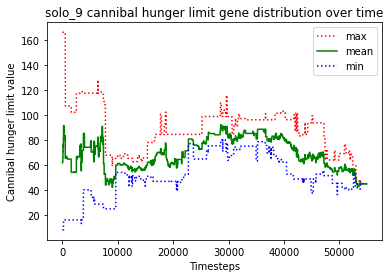

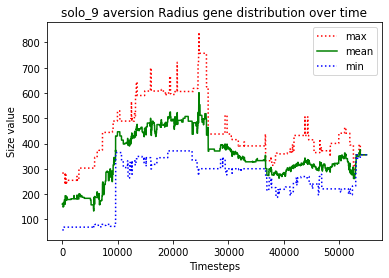

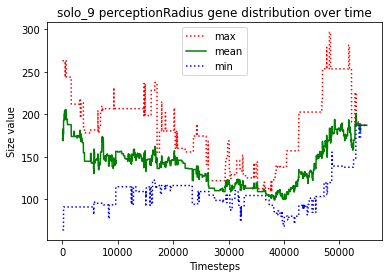

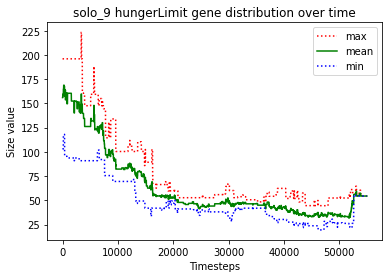





						SOLO_10

predator_1 just gave birth to predator_10
predator_10 just gave birth to predator_11
predator_8 just gave birth to predator_12
predator_2 killed predator_6
predator_4 just gave birth to predator_13
predator_1 just gave birth to predator_14
predator_11 just gave birth to predator_15
predator_14 starved to death
predator_0 ate the carcass of predator_14_carcass
predator_10 starved to death
predator_1 starved to death
predator_15 starved to death
predator_4 ate the carcass of predator_10_carcass
predator_11 just gave birth to predator_16
predator_13 ate the carcass of predator_1_carcass
predator_16 starved to death
predator_11 starved to death
predator_7 ate the carcass of predator_15_carcass
predator_8 starved to death
predator_4 ate the carcass of predator_11_carcass
predator_4 ate the carcass of predator_16_carcass
predator_5 just gave birth to predator_17
predator_0 just gave birth to predator_18
predator_13 starved to death
predator_5 killed predator_2
predator_0 a

predator_67 killed predator_63
predator_69 starved to death
predator_67 ate the carcass of predator_69_carcass
predator_66 just gave birth to predator_70
predator_70 starved to death
predator_66 starved to death
predator_59 ate the carcass of predator_70_carcass
predator_58 ate the carcass of predator_66_carcass
predator_59 just gave birth to predator_71
predator_59 just gave birth to predator_72
predator_59 just gave birth to predator_73
predator_58 starved to death
predator_67 ate the carcass of predator_58_carcass
predator_59 just gave birth to predator_74
predator_73 killed predator_74
predator_67 just gave birth to predator_75
predator_59 starved to death
predator_75 starved to death
predator_71 ate the carcass of predator_59_carcass
predator_67 ate the carcass of predator_75_carcass
predator_72 just gave birth to predator_76
predator_54 just gave birth to predator_77
predator_73 just gave birth to predator_78
predator_73 starved to death
predator_78 starved to death
predator_67 a

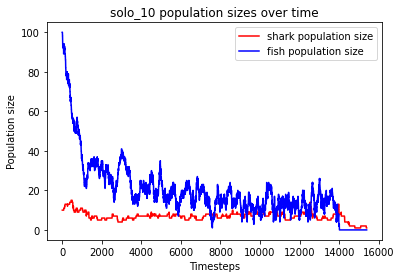

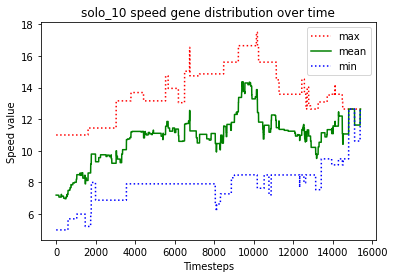

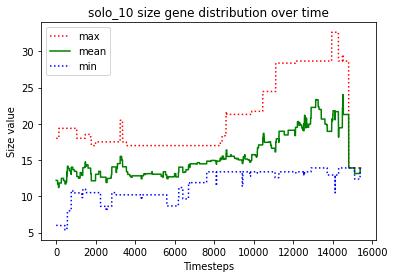

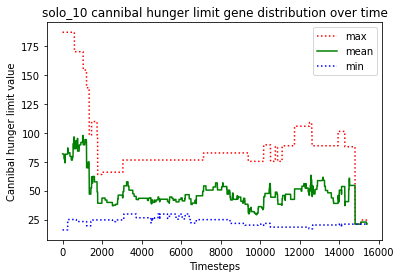

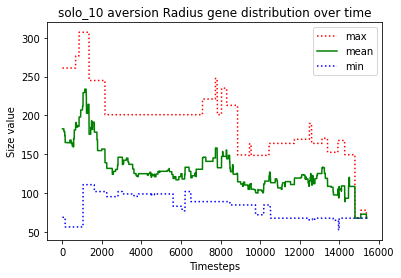

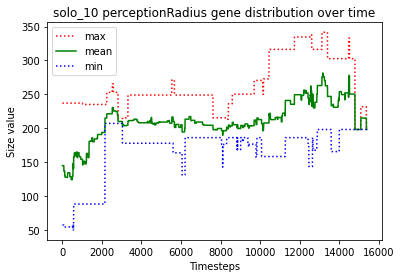

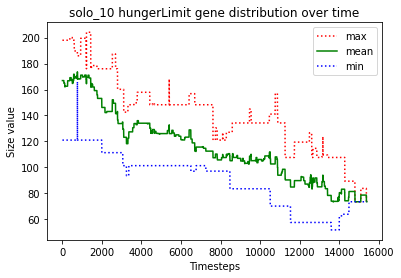





						SOLO_11

predator_1 just gave birth to predator_10
predator_5 just gave birth to predator_11
predator_3 just gave birth to predator_12
predator_8 just gave birth to predator_13
predator_11 just gave birth to predator_14
predator_3 killed predator_14
predator_3 just gave birth to predator_15
predator_3 killed predator_5
predator_15 killed predator_8
predator_11 starved to death
predator_7 ate the carcass of predator_11_carcass
predator_15 killed predator_10
predator_13 starved to death
predator_6 ate the carcass of predator_13_carcass
predator_1 just gave birth to predator_16
predator_16 just gave birth to predator_17
predator_17 starved to death
predator_1 ate the carcass of predator_17_carcass
predator_16 starved to death
predator_2 just gave birth to predator_18
predator_0 ate the carcass of predator_16_carcass
predator_1 starved to death
predator_3 killed predator_18
predator_12 ate the carcass of predator_1_carcass
predator_12 just gave birth to predator_19
predator_12 ki

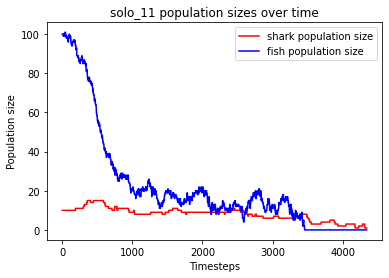

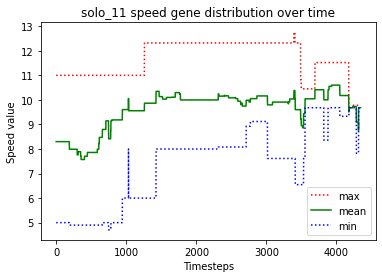

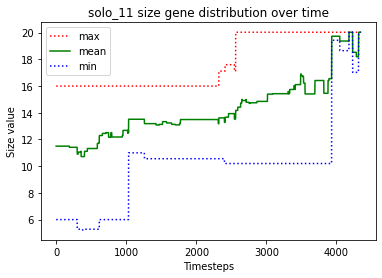

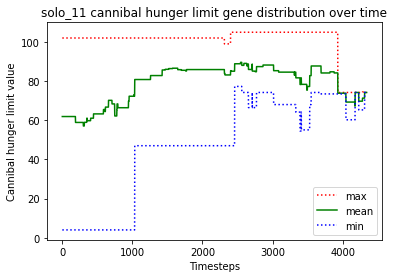

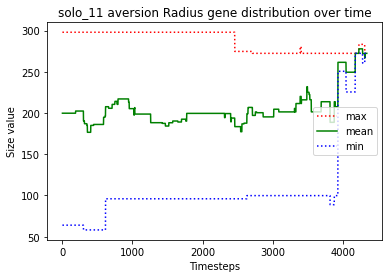

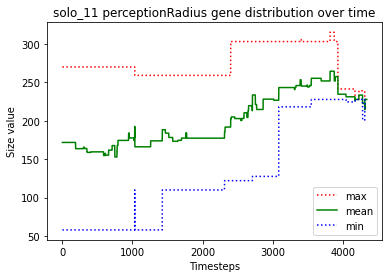

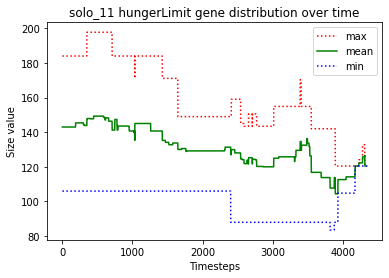





						SOLO_12

predator_2 just gave birth to predator_10
predator_6 just gave birth to predator_11
predator_1 just gave birth to predator_12
predator_10 just gave birth to predator_13
predator_12 killed predator_11
predator_1 just gave birth to predator_14
predator_14 killed predator_5
predator_10 just gave birth to predator_15
predator_12 killed predator_3
predator_10 starved to death
predator_14 ate the carcass of predator_10_carcass
predator_15 starved to death
predator_12 killed predator_6
predator_0 ate the carcass of predator_15_carcass
predator_1 starved to death
predator_4 ate the carcass of predator_1_carcass
predator_14 killed predator_2
predator_12 killed predator_13
predator_14 starved to death
predator_12 ate the carcass of predator_14_carcass
predator_12 killed predator_7
predator_8 starved to death
predator_4 ate the carcass of predator_8_carcass
predator_12 just gave birth to predator_16
predator_9 just gave birth to predator_17
predator_0 just gave birth to predato

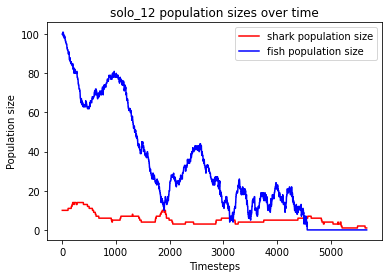

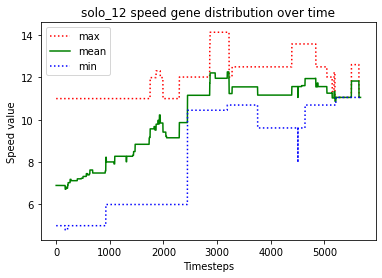

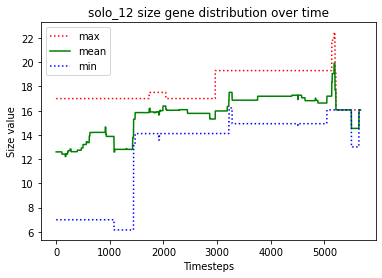

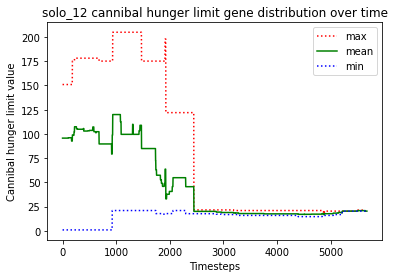

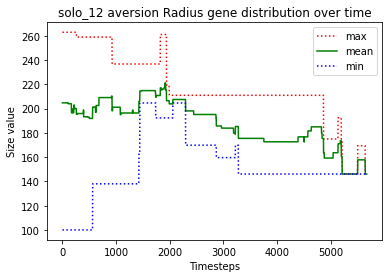

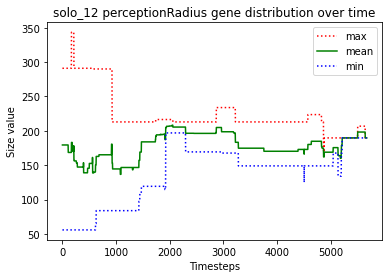

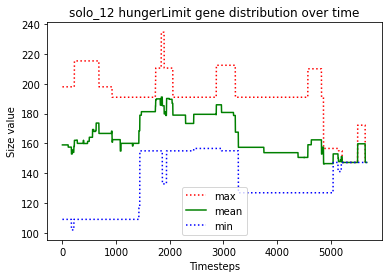





						SOLO_13

predator_7 just gave birth to predator_10
predator_9 just gave birth to predator_11
predator_2 just gave birth to predator_12
predator_6 just gave birth to predator_13
predator_2 killed predator_12
predator_13 killed predator_3
predator_8 just gave birth to predator_14
predator_6 killed predator_5
predator_9 just gave birth to predator_15
predator_15 killed predator_2
predator_0 just gave birth to predator_16
predator_9 killed predator_8
predator_15 killed predator_16
predator_4 just gave birth to predator_17
predator_15 killed predator_14
predator_9 starved to death
predator_10 ate the carcass of predator_9_carcass
predator_17 just gave birth to predator_18
predator_7 just gave birth to predator_19
predator_6 starved to death
predator_17 killed predator_10
predator_15 ate the carcass of predator_6_carcass
predator_0 starved to death
predator_17 ate the carcass of predator_0_carcass
predator_11 just gave birth to predator_20
predator_17 killed predator_13
predator_20

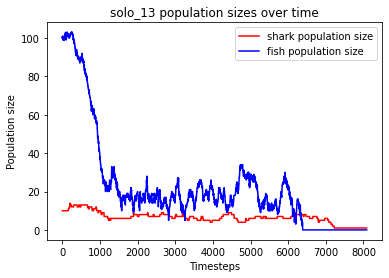

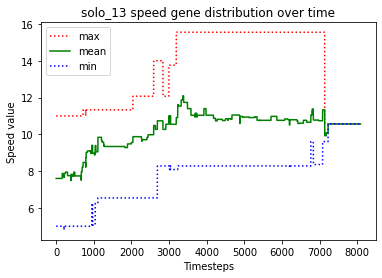

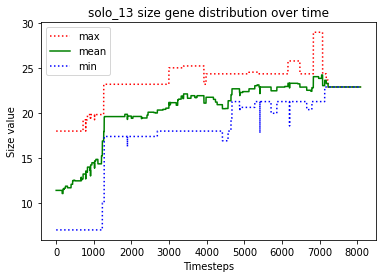

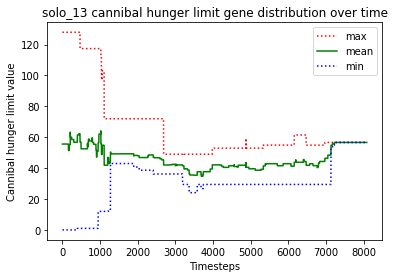

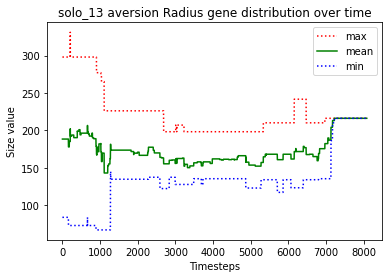

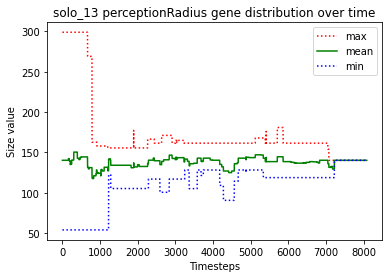

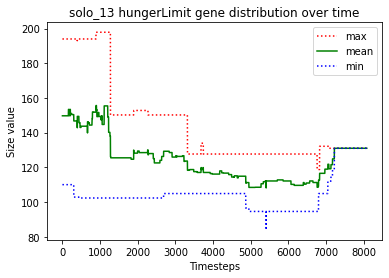





						SOLO_14

predator_0 just gave birth to predator_10
predator_10 just gave birth to predator_11
predator_8 just gave birth to predator_12
predator_10 just gave birth to predator_13
predator_13 just gave birth to predator_14
predator_10 just gave birth to predator_15
predator_10 starved to death
predator_15 starved to death
predator_14 starved to death
predator_13 starved to death
predator_0 ate the carcass of predator_15_carcass
predator_4 ate the carcass of predator_13_carcass
predator_7 ate the carcass of predator_10_carcass
predator_4 ate the carcass of predator_14_carcass
predator_11 just gave birth to predator_16
predator_12 just gave birth to predator_17
predator_16 starved to death
predator_11 ate the carcass of predator_16_carcass
predator_11 just gave birth to predator_18
predator_17 starved to death
predator_12 starved to death
predator_18 starved to death
predator_1 ate the carcass of predator_12_carcass
predator_9 ate the carcass of predator_18_carcass
predator_11 s

predator_63 just gave birth to predator_66
predator_65 starved to death
predator_60 ate the carcass of predator_65_carcass
predator_63 starved to death
predator_60 ate the carcass of predator_63_carcass
predator_53 just gave birth to predator_67
predator_66 starved to death
predator_60 ate the carcass of predator_66_carcass
predator_67 just gave birth to predator_68
predator_53 starved to death
predator_60 ate the carcass of predator_53_carcass
predator_68 killed predator_56
predator_60 just gave birth to predator_69
predator_68 starved to death
predator_69 ate the carcass of predator_68_carcass
predator_69 just gave birth to predator_70
predator_69 just gave birth to predator_71
predator_60 just gave birth to predator_72
predator_71 killed predator_72
predator_60 just gave birth to predator_73
predator_73 starved to death
predator_70 ate the carcass of predator_73_carcass
predator_60 just gave birth to predator_74
predator_74 starved to death
predator_60 ate the carcass of predator_74

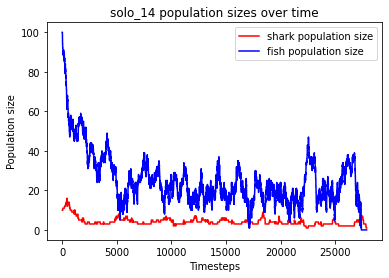

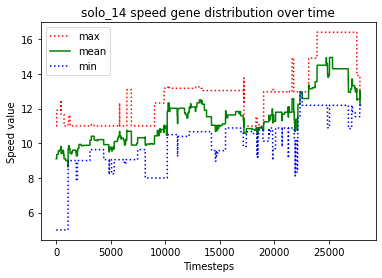

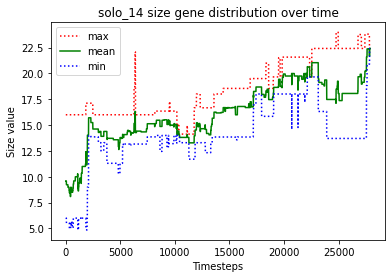

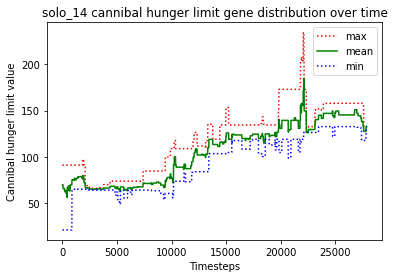

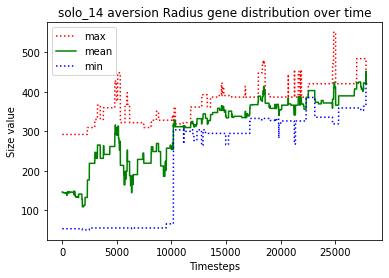

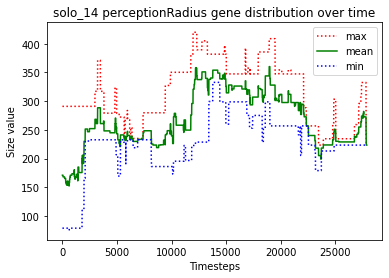

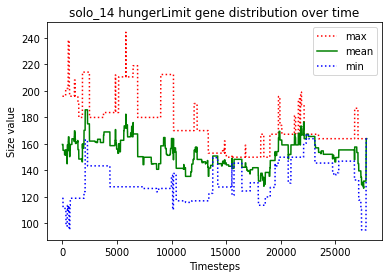





						SOLO_15

predator_7 just gave birth to predator_10
predator_10 killed predator_9
predator_4 just gave birth to predator_11
predator_7 just gave birth to predator_12
predator_7 killed predator_2
predator_10 killed predator_4
predator_3 just gave birth to predator_13
predator_10 killed predator_5
predator_7 just gave birth to predator_14
predator_14 starved to death
predator_7 starved to death
predator_10 ate the carcass of predator_7_carcass
predator_11 ate the carcass of predator_14_carcass
predator_10 killed predator_8
predator_12 just gave birth to predator_15
predator_15 just gave birth to predator_16
predator_12 starved to death
predator_16 starved to death
predator_3 ate the carcass of predator_12_carcass
predator_15 ate the carcass of predator_16_carcass
predator_15 starved to death
predator_10 ate the carcass of predator_15_carcass
predator_3 just gave birth to predator_17
predator_10 just gave birth to predator_18
predator_3 starved to death
predator_13 ate the carcas

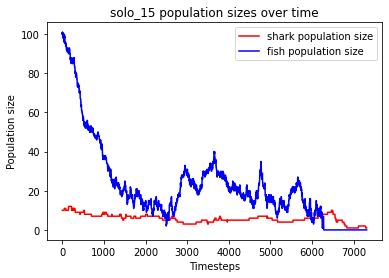

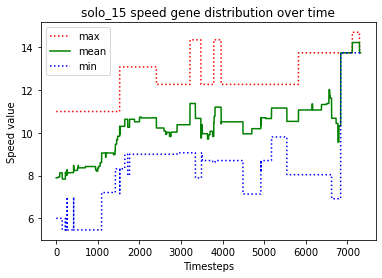

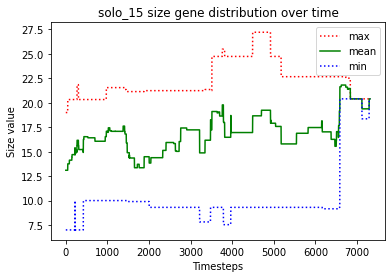

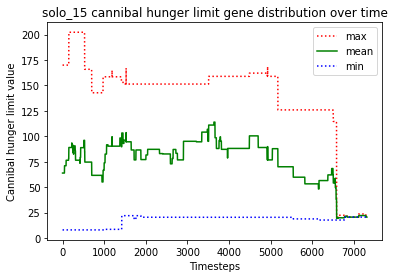

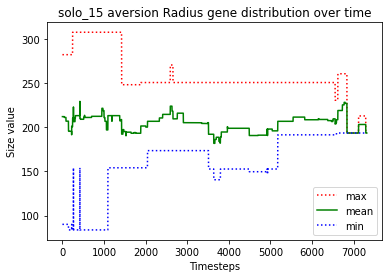

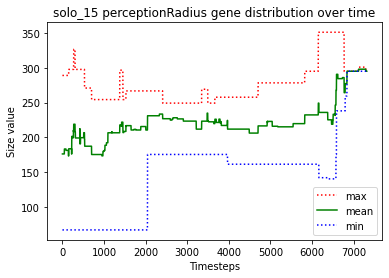

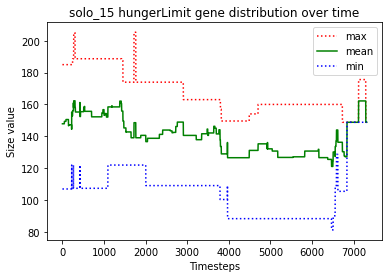





						SOLO_16

predator_4 just gave birth to predator_10
predator_4 killed predator_1
predator_9 killed predator_10
predator_9 killed predator_8
predator_3 just gave birth to predator_11
predator_2 just gave birth to predator_12
predator_11 killed predator_4
predator_5 just gave birth to predator_13
predator_5 just gave birth to predator_14
predator_6 starved to death
predator_5 ate the carcass of predator_6_carcass
predator_11 starved to death
predator_3 ate the carcass of predator_11_carcass
predator_0 starved to death
predator_2 just gave birth to predator_15
predator_14 starved to death
predator_3 ate the carcass of predator_0_carcass
predator_12 ate the carcass of predator_14_carcass
predator_15 starved to death
predator_5 ate the carcass of predator_15_carcass
predator_13 killed predator_7
predator_5 just gave birth to predator_16
predator_16 starved to death
predator_5 ate the carcass of predator_16_carcass
predator_3 starved to death
predator_13 ate the carcass of predator_

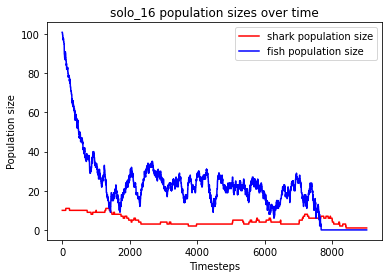

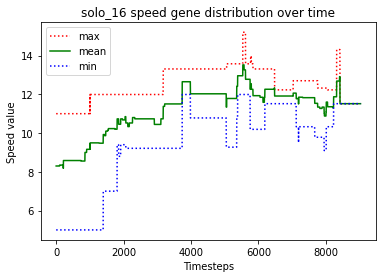

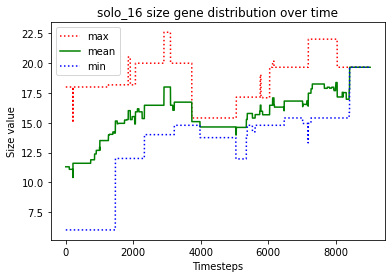

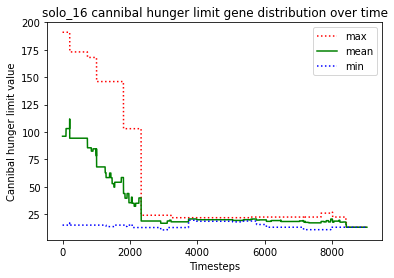

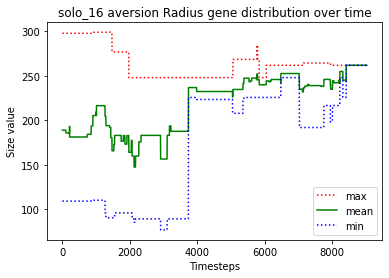

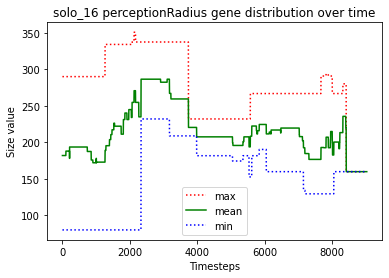

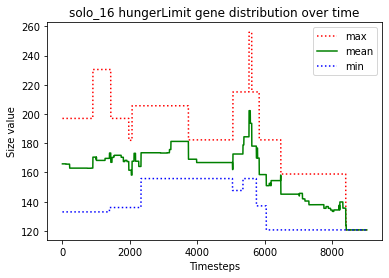





						SOLO_17

predator_0 just gave birth to predator_10
predator_2 just gave birth to predator_11
predator_9 just gave birth to predator_12
predator_1 just gave birth to predator_13
predator_12 killed predator_6
predator_12 just gave birth to predator_14
predator_0 just gave birth to predator_15
predator_0 just gave birth to predator_16
predator_5 just gave birth to predator_17
predator_14 killed predator_4
predator_16 starved to death
predator_12 just gave birth to predator_18
predator_15 just gave birth to predator_19
predator_12 ate the carcass of predator_16_carcass
predator_18 starved to death
predator_0 starved to death
predator_8 ate the carcass of predator_18_carcass
predator_17 just gave birth to predator_20
predator_14 ate the carcass of predator_0_carcass
predator_14 killed predator_1
predator_15 starved to death
predator_14 ate the carcass of predator_15_carcass
predator_12 starved to death
predator_8 ate the carcass of predator_12_carcass
predator_14 starved to death


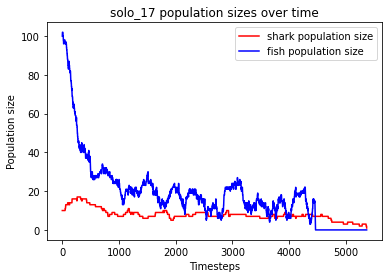

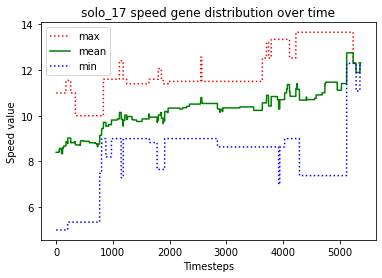

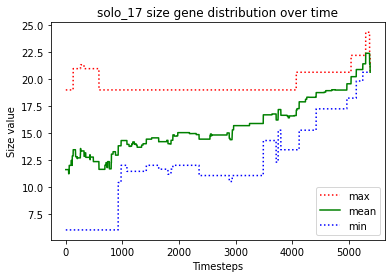

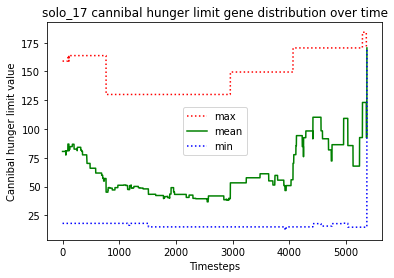

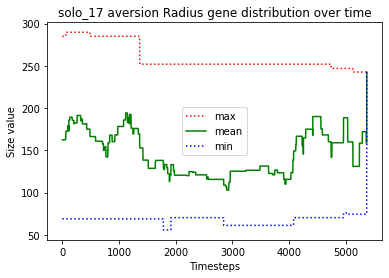

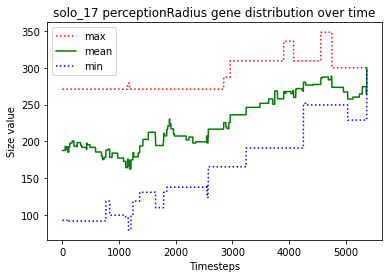

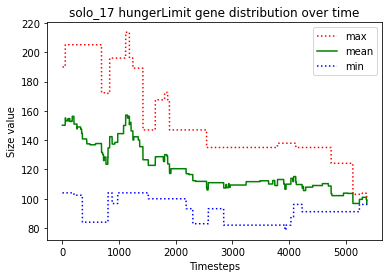





						SOLO_18

predator_2 just gave birth to predator_10
predator_7 just gave birth to predator_11
predator_2 killed predator_3
predator_6 just gave birth to predator_12
predator_2 killed predator_9
predator_8 just gave birth to predator_13
predator_8 killed predator_5
predator_13 just gave birth to predator_14
predator_2 killed predator_12
predator_11 just gave birth to predator_15
predator_7 just gave birth to predator_16
predator_1 just gave birth to predator_17
predator_14 starved to death
predator_7 ate the carcass of predator_14_carcass
predator_11 starved to death
predator_16 ate the carcass of predator_11_carcass
predator_2 just gave birth to predator_18
predator_15 starved to death
predator_17 ate the carcass of predator_15_carcass
predator_2 killed predator_4
predator_16 starved to death
predator_17 ate the carcass of predator_16_carcass
predator_2 killed predator_0
predator_7 starved to death
predator_13 starved to death
predator_8 just gave birth to predator_19
predator

predator_74 starved to death
predator_75 ate the carcass of predator_74_carcass
predator_31 starved to death
predator_64 ate the carcass of predator_31_carcass
predator_73 starved to death
predator_45 ate the carcass of predator_73_carcass
predator_66 just gave birth to predator_77
predator_68 starved to death
predator_76 ate the carcass of predator_68_carcass
predator_75 starved to death
predator_77 ate the carcass of predator_75_carcass
predator_69 just gave birth to predator_78
predator_69 killed predator_78
predator_64 killed predator_76
predator_45 just gave birth to predator_79
predator_64 just gave birth to predator_80
predator_79 just gave birth to predator_81
predator_56 starved to death
predator_66 starved to death
predator_79 ate the carcass of predator_66_carcass
predator_80 ate the carcass of predator_56_carcass
predator_77 starved to death
predator_45 ate the carcass of predator_77_carcass
predator_69 starved to death
predator_71 ate the carcass of predator_69_carcass
pre

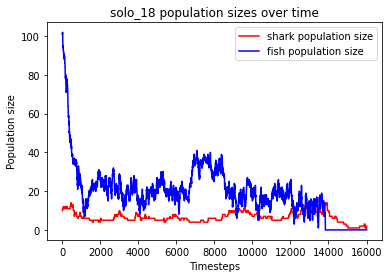

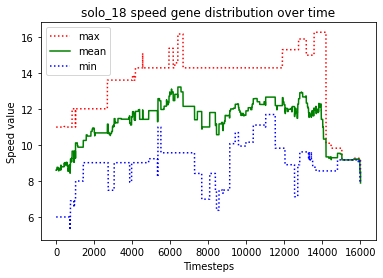

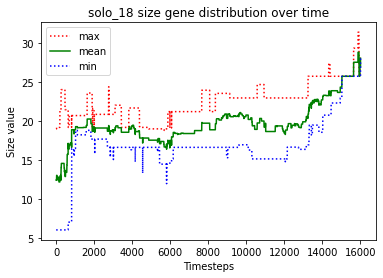

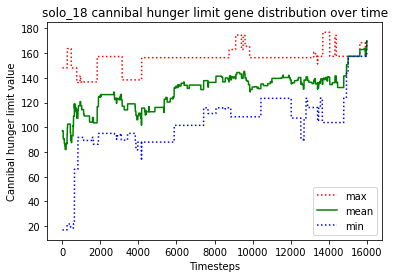

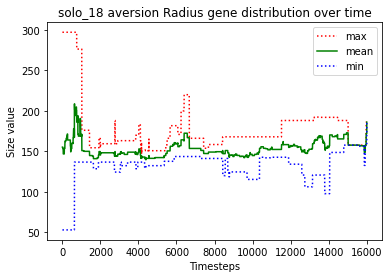

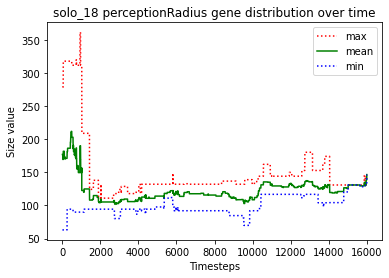

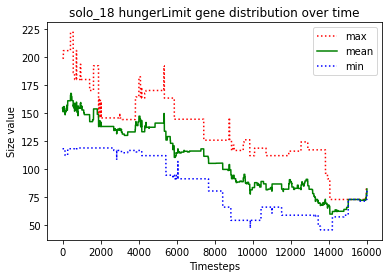





						SOLO_19

predator_7 just gave birth to predator_10
predator_10 just gave birth to predator_11
predator_0 just gave birth to predator_12
predator_11 starved to death
predator_8 ate the carcass of predator_11_carcass
predator_7 just gave birth to predator_13
predator_0 killed predator_2
predator_10 starved to death
predator_7 just gave birth to predator_14
predator_7 killed predator_6
predator_1 just gave birth to predator_15
predator_15 killed predator_5
predator_3 just gave birth to predator_16
predator_14 starved to death
predator_16 just gave birth to predator_17
predator_15 ate the carcass of predator_14_carcass
predator_4 ate the carcass of predator_10_carcass
predator_7 just gave birth to predator_18
predator_18 starved to death
predator_17 starved to death
predator_7 ate the carcass of predator_18_carcass
predator_16 starved to death
predator_3 ate the carcass of predator_16_carcass
predator_3 ate the carcass of predator_17_carcass
predator_15 killed predator_13
predato

predator_68 just gave birth to predator_69
predator_69 starved to death
predator_66 just gave birth to predator_70
predator_37 ate the carcass of predator_69_carcass
predator_53 just gave birth to predator_71
predator_70 starved to death
predator_66 ate the carcass of predator_70_carcass
predator_59 just gave birth to predator_72
predator_47 just gave birth to predator_73
predator_73 killed predator_37
predator_47 killed predator_66
predator_47 just gave birth to predator_74
predator_73 killed predator_72
predator_74 killed predator_59
predator_74 killed predator_71
predator_74 killed predator_53
predator_73 just gave birth to predator_75
predator_75 killed predator_47
predator_74 killed predator_68
predator_74 just gave birth to predator_76
predator_76 killed predator_65
predator_73 just gave birth to predator_77
predator_77 just gave birth to predator_78
predator_76 just gave birth to predator_79
predator_75 just gave birth to predator_80
predator_76 just gave birth to predator_81
pr

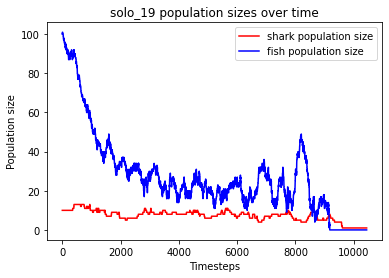

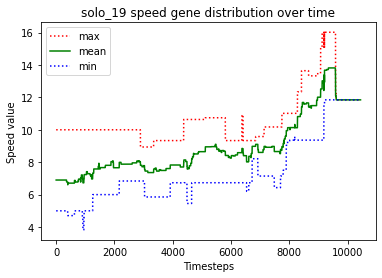

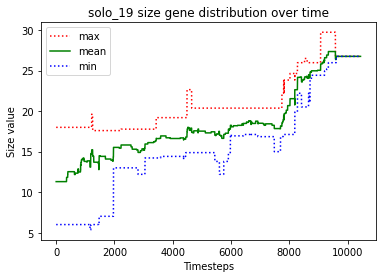

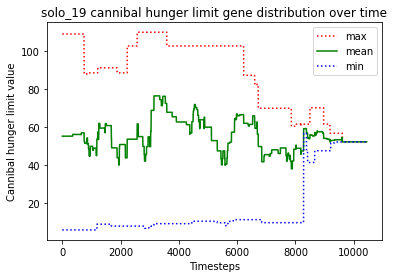

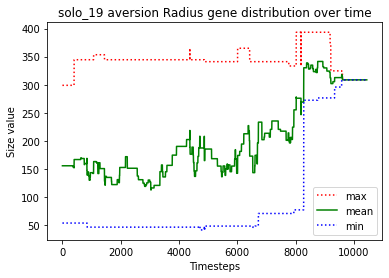

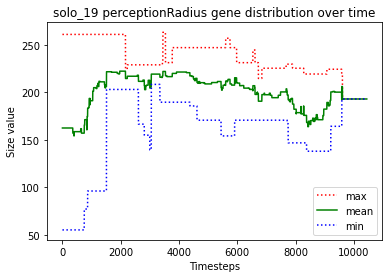

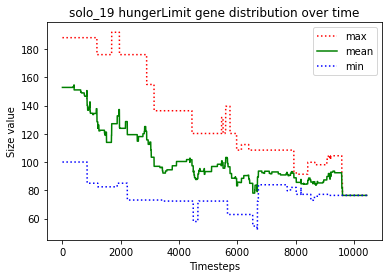





						SOLO_20

predator_0 just gave birth to predator_10
predator_10 just gave birth to predator_11
predator_2 just gave birth to predator_12
predator_11 just gave birth to predator_13
predator_2 killed predator_3
predator_4 just gave birth to predator_14
predator_11 killed predator_1
predator_14 just gave birth to predator_15
predator_4 killed predator_9
predator_13 starved to death
predator_4 killed predator_7
predator_2 ate the carcass of predator_13_carcass
predator_6 just gave birth to predator_16
predator_10 starved to death
predator_4 killed predator_12
predator_15 ate the carcass of predator_10_carcass
predator_11 starved to death
predator_14 ate the carcass of predator_11_carcass
predator_14 just gave birth to predator_17
predator_16 just gave birth to predator_18
predator_16 just gave birth to predator_19
predator_17 starved to death
predator_16 starved to death
predator_19 ate the carcass of predator_16_carcass
predator_5 ate the carcass of predator_17_carcass
predator_1

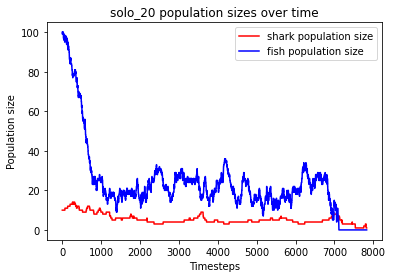

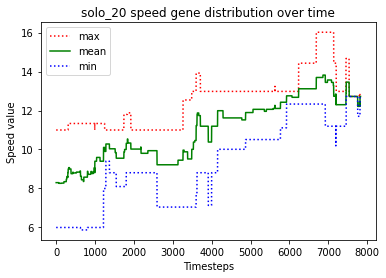

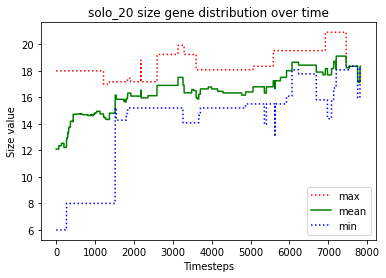

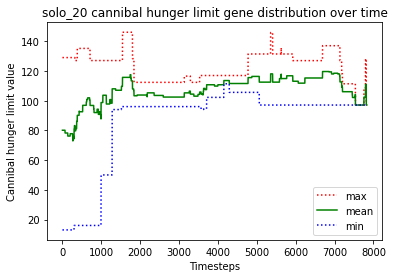

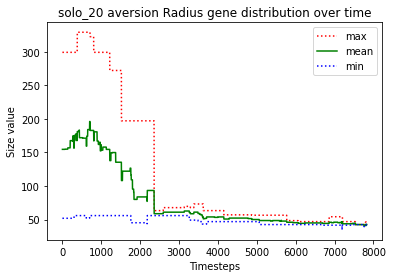

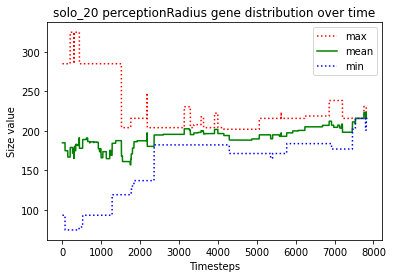

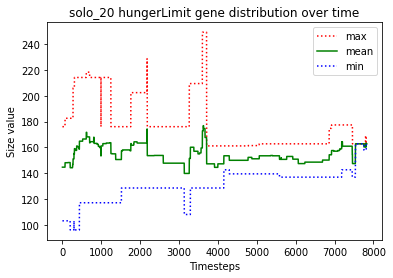





						SOLO_21

predator_1 just gave birth to predator_10
predator_10 killed predator_9
predator_2 just gave birth to predator_11
predator_10 just gave birth to predator_12
predator_1 killed predator_7
predator_10 just gave birth to predator_13
predator_11 starved to death
predator_0 ate the carcass of predator_11_carcass
predator_5 just gave birth to predator_14
predator_2 starved to death
predator_0 just gave birth to predator_15
predator_0 ate the carcass of predator_2_carcass
predator_10 just gave birth to predator_16
predator_16 just gave birth to predator_17
predator_16 starved to death
predator_1 ate the carcass of predator_16_carcass
predator_17 starved to death
predator_6 ate the carcass of predator_17_carcass
predator_13 starved to death
predator_0 ate the carcass of predator_13_carcass
predator_14 killed predator_6
predator_14 killed predator_0
predator_14 killed predator_15
predator_5 killed predator_4
predator_3 just gave birth to predator_18
predator_3 just gave birth 

predator_68 just gave birth to predator_73
predator_53 just gave birth to predator_74
predator_59 just gave birth to predator_75
predator_72 starved to death
predator_73 killed predator_33
predator_73 just gave birth to predator_76
predator_45 starved to death
predator_73 ate the carcass of predator_72_carcass
predator_59 ate the carcass of predator_45_carcass
predator_73 killed predator_75
predator_59 just gave birth to predator_77
predator_68 just gave birth to predator_78
predator_76 just gave birth to predator_79
predator_79 starved to death
predator_77 just gave birth to predator_80
predator_76 starved to death
predator_59 ate the carcass of predator_76_carcass
predator_66 just gave birth to predator_81
predator_78 just gave birth to predator_82
predator_68 starved to death
predator_59 ate the carcass of predator_79_carcass
predator_73 ate the carcass of predator_68_carcass
predator_77 starved to death
predator_73 ate the carcass of predator_77_carcass
predator_78 starved to death

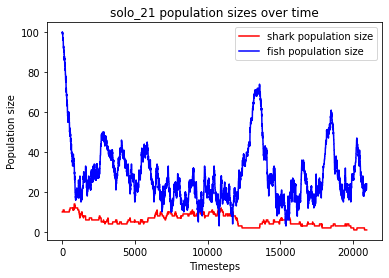

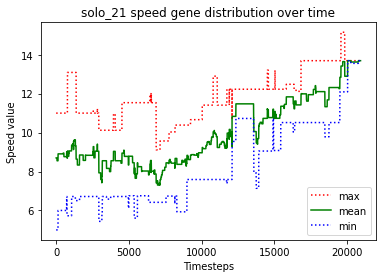

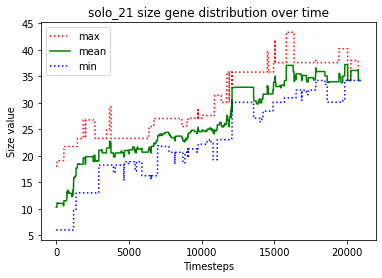

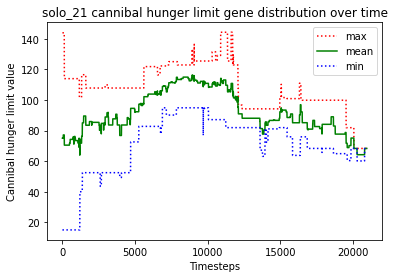

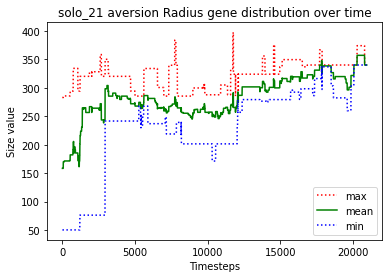

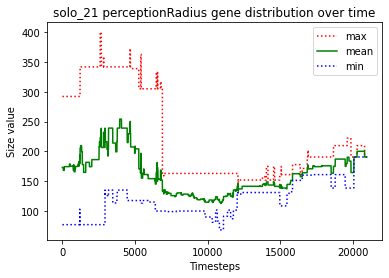

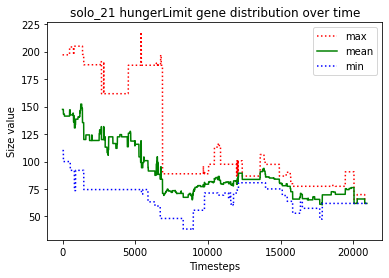





						SOLO_22

predator_1 just gave birth to predator_10
predator_1 just gave birth to predator_11
predator_10 just gave birth to predator_12
predator_7 just gave birth to predator_13
predator_12 starved to death
predator_0 ate the carcass of predator_12_carcass
predator_13 just gave birth to predator_14
predator_11 starved to death
predator_14 just gave birth to predator_15
predator_2 ate the carcass of predator_11_carcass
predator_10 starved to death
predator_2 ate the carcass of predator_10_carcass
predator_1 just gave birth to predator_16
predator_1 starved to death
predator_16 starved to death
predator_0 ate the carcass of predator_16_carcass
predator_14 ate the carcass of predator_1_carcass
predator_3 just gave birth to predator_17
predator_8 just gave birth to predator_18
predator_15 starved to death
predator_2 ate the carcass of predator_15_carcass
predator_2 just gave birth to predator_19
predator_13 starved to death
predator_18 killed predator_14
predator_2 ate the carcas

predator_52 just gave birth to predator_72
predator_60 just gave birth to predator_73
predator_62 starved to death
predator_60 ate the carcass of predator_62_carcass
predator_52 starved to death
predator_47 starved to death
predator_71 ate the carcass of predator_52_carcass
predator_61 just gave birth to predator_74
predator_66 just gave birth to predator_75
predator_72 just gave birth to predator_76
predator_72 starved to death
predator_76 starved to death
predator_75 ate the carcass of predator_72_carcass
predator_75 ate the carcass of predator_76_carcass
predator_66 ate the carcass of predator_47_carcass
predator_73 just gave birth to predator_77
predator_50 starved to death
predator_77 starved to death
predator_73 starved to death
predator_67 starved to death
predator_66 ate the carcass of predator_73_carcass
predator_71 starved to death
predator_74 starved to death
predator_64 ate the carcass of predator_71_carcass
predator_64 ate the carcass of predator_77_carcass
predator_61 sta

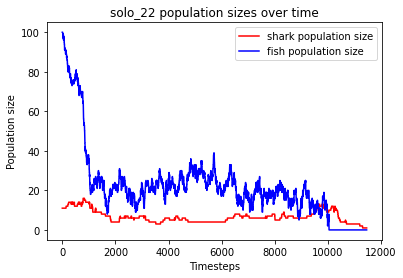

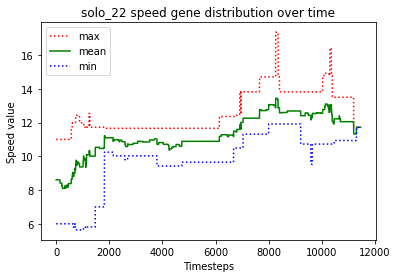

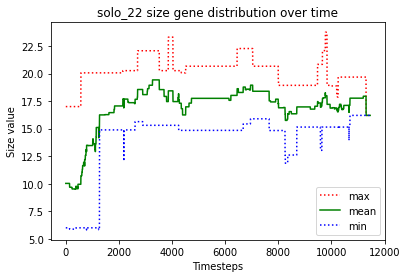

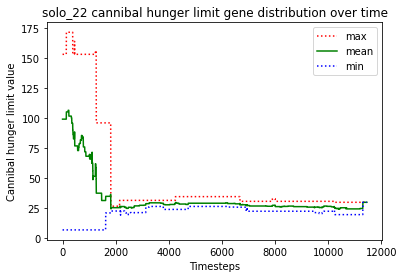

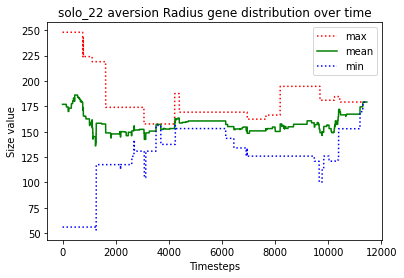

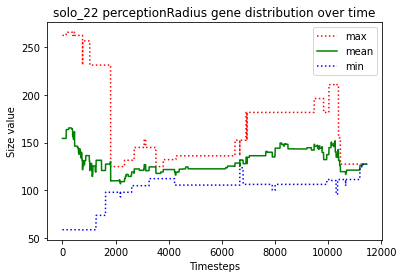

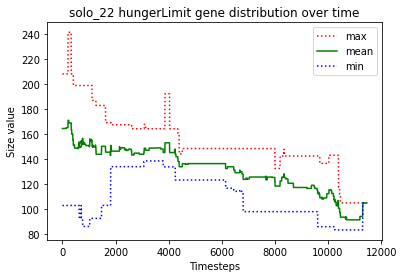





						SOLO_23

predator_8 just gave birth to predator_10
predator_2 just gave birth to predator_11
predator_8 killed predator_2
predator_6 killed predator_3
predator_6 killed predator_7
predator_1 just gave birth to predator_12
predator_1 just gave birth to predator_13
predator_4 killed predator_10
predator_6 killed predator_5
predator_4 killed predator_11
predator_6 killed predator_0
predator_6 just gave birth to predator_14
predator_13 starved to death
predator_14 ate the carcass of predator_13_carcass
predator_8 starved to death
predator_4 ate the carcass of predator_8_carcass
predator_14 starved to death
predator_6 starved to death
predator_9 ate the carcass of predator_14_carcass
predator_1 ate the carcass of predator_6_carcass
predator_4 just gave birth to predator_15
predator_9 just gave birth to predator_16
predator_1 starved to death
predator_15 ate the carcass of predator_1_carcass
predator_9 just gave birth to predator_17
predator_16 just gave birth to predator_18
predat

predator_66 starved to death
predator_65 ate the carcass of predator_63_carcass
predator_68 ate the carcass of predator_66_carcass
predator_69 starved to death
predator_68 ate the carcass of predator_69_carcass
predator_62 starved to death
predator_55 starved to death
predator_65 ate the carcass of predator_62_carcass
predator_65 ate the carcass of predator_55_carcass
predator_68 starved to death
predator_65 just gave birth to predator_70
predator_70 ate the carcass of predator_68_carcass
predator_65 starved to death
predator_70 just gave birth to predator_71
predator_70 ate the carcass of predator_65_carcass
predator_71 starved to death
predator_70 just gave birth to predator_72
predator_72 starved to death
predator_70 starved to death


finished this run because predators went extinct
Fish left: 0
Sharks left: 0
Dead sharks: 73
Timesteps passed: 15119
Fish went extinct at timestep 14360
Sharks went extinct at timestep 15119


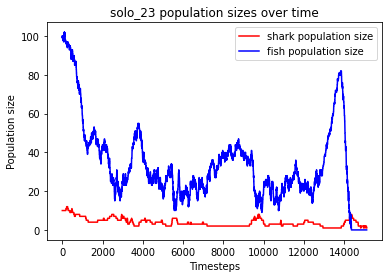

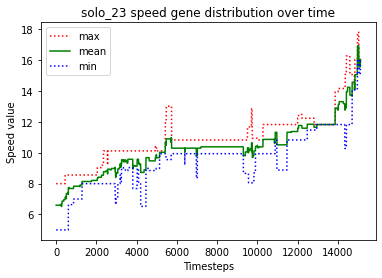

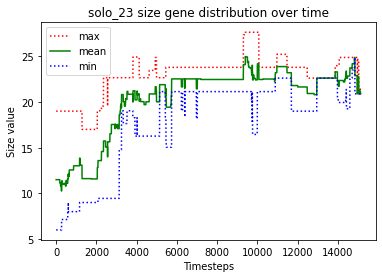

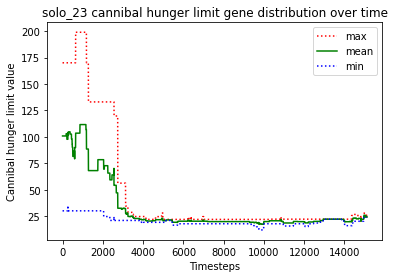

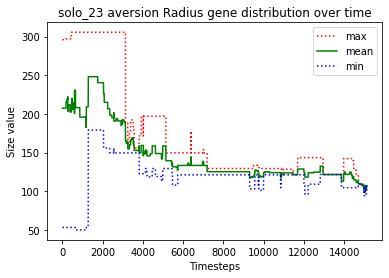

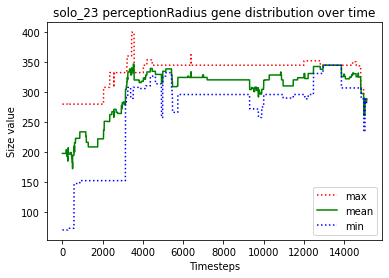

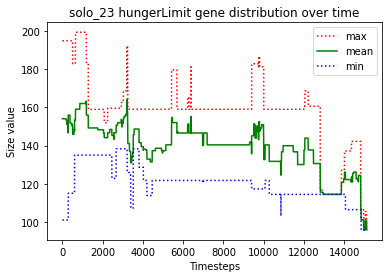





						SOLO_24

predator_0 just gave birth to predator_10
predator_6 just gave birth to predator_11
predator_6 just gave birth to predator_12
predator_5 just gave birth to predator_13
predator_3 just gave birth to predator_14
predator_5 just gave birth to predator_15
predator_12 starved to death
predator_5 ate the carcass of predator_12_carcass
predator_6 starved to death
predator_9 ate the carcass of predator_6_carcass
predator_1 killed predator_10
predator_5 just gave birth to predator_16
predator_5 killed predator_0
predator_16 starved to death
predator_5 ate the carcass of predator_16_carcass
predator_11 just gave birth to predator_17
predator_17 starved to death
predator_3 ate the carcass of predator_17_carcass
predator_15 just gave birth to predator_18
predator_18 starved to death
predator_5 ate the carcass of predator_18_carcass
predator_11 starved to death
predator_15 starved to death
predator_4 ate the carcass of predator_15_carcass
predator_13 ate the carcass of predator_1

predator_68 just gave birth to predator_73
predator_72 starved to death
predator_71 starved to death
predator_39 ate the carcass of predator_72_carcass
predator_69 ate the carcass of predator_71_carcass
predator_62 just gave birth to predator_74
predator_62 killed predator_74
predator_65 just gave birth to predator_75
predator_73 just gave birth to predator_76
predator_76 just gave birth to predator_77
predator_62 just gave birth to predator_78
predator_65 just gave birth to predator_79
predator_73 starved to death
predator_76 ate the carcass of predator_73_carcass
predator_79 starved to death
predator_62 starved to death
predator_77 starved to death
predator_59 ate the carcass of predator_62_carcass
predator_78 starved to death
predator_59 ate the carcass of predator_78_carcass
predator_59 ate the carcass of predator_79_carcass
predator_39 ate the carcass of predator_77_carcass
predator_65 just gave birth to predator_80
predator_80 just gave birth to predator_81
predator_39 just gave 

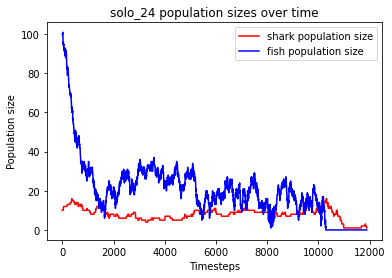

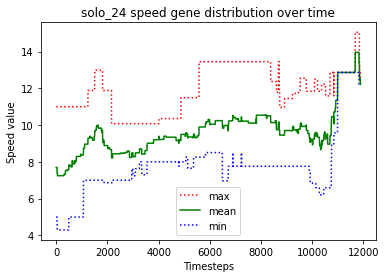

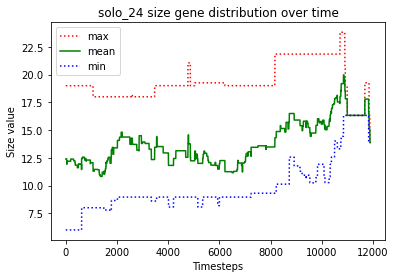

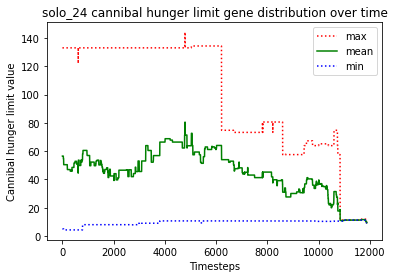

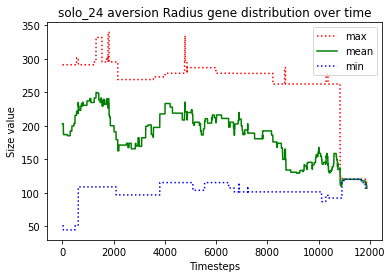

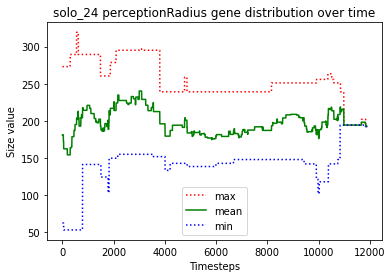

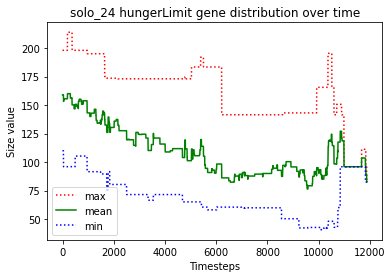





						SOLO_25

predator_9 just gave birth to predator_10
predator_10 just gave birth to predator_11
predator_1 just gave birth to predator_12
predator_9 just gave birth to predator_13
predator_2 just gave birth to predator_14
predator_11 starved to death
predator_5 ate the carcass of predator_11_carcass
predator_5 just gave birth to predator_15
predator_12 killed predator_0
predator_4 starved to death
predator_13 starved to death
predator_8 just gave birth to predator_16
predator_9 ate the carcass of predator_4_carcass
predator_2 ate the carcass of predator_13_carcass
predator_8 just gave birth to predator_17
predator_12 killed predator_7
predator_5 just gave birth to predator_18
predator_10 starved to death
predator_2 ate the carcass of predator_10_carcass
predator_12 starved to death
predator_15 ate the carcass of predator_12_carcass
predator_3 starved to death
predator_9 ate the carcass of predator_3_carcass
predator_9 just gave birth to predator_19
predator_18 just gave birth t

predator_60 ate the carcass of predator_64_carcass
predator_54 starved to death
predator_69 ate the carcass of predator_54_carcass
predator_69 just gave birth to predator_70
predator_68 starved to death
predator_65 ate the carcass of predator_68_carcass
predator_70 killed predator_67
predator_70 killed predator_60
predator_43 starved to death
predator_63 ate the carcass of predator_43_carcass
predator_70 killed predator_63
predator_69 just gave birth to predator_71
predator_65 just gave birth to predator_72
predator_69 just gave birth to predator_73
predator_70 just gave birth to predator_74
predator_71 just gave birth to predator_75
predator_74 just gave birth to predator_76
predator_71 just gave birth to predator_77
predator_71 starved to death
predator_77 ate the carcass of predator_71_carcass
predator_69 just gave birth to predator_78
predator_77 just gave birth to predator_79
predator_75 killed predator_79
predator_76 starved to death
predator_74 starved to death
predator_69 ate t

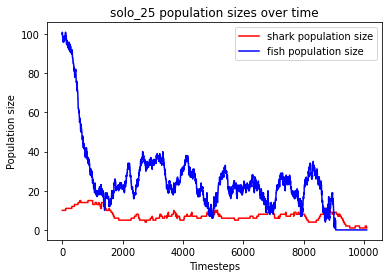

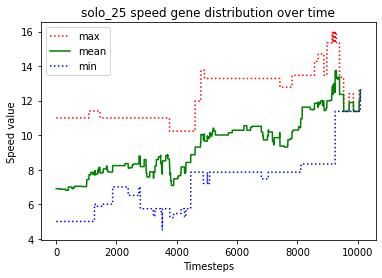

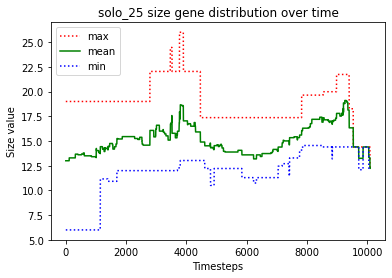

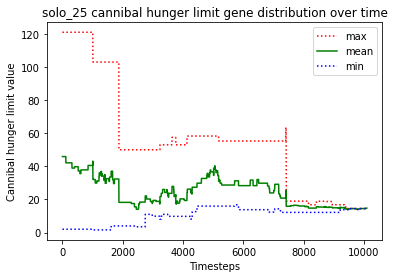

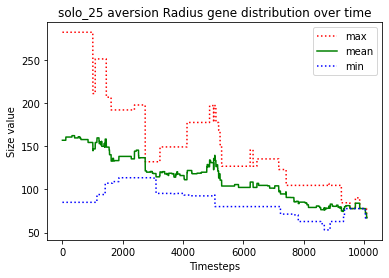

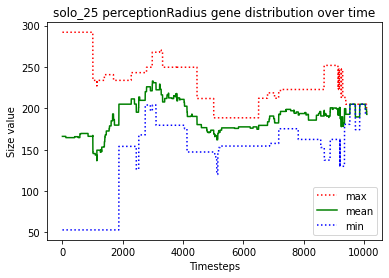

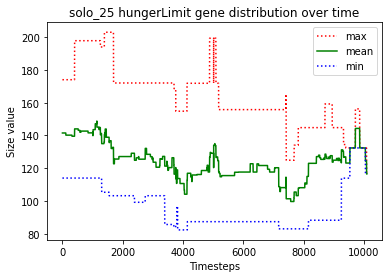





						SOLO_26

predator_1 just gave birth to predator_10
predator_2 just gave birth to predator_11
predator_1 just gave birth to predator_12
predator_5 just gave birth to predator_13
predator_6 just gave birth to predator_14
predator_6 killed predator_4
predator_1 killed predator_7
predator_8 just gave birth to predator_15
predator_14 killed predator_2
predator_12 starved to death
predator_6 killed predator_9
predator_0 just gave birth to predator_16
predator_8 killed predator_11
predator_8 just gave birth to predator_17
predator_14 ate the carcass of predator_12_carcass
predator_6 just gave birth to predator_18
predator_6 killed predator_3
predator_16 just gave birth to predator_19
predator_6 killed predator_0
predator_15 just gave birth to predator_20
predator_18 starved to death
predator_14 ate the carcass of predator_18_carcass
predator_1 just gave birth to predator_21
predator_1 killed predator_21
predator_6 starved to death
predator_8 ate the carcass of predator_6_carcass
pre

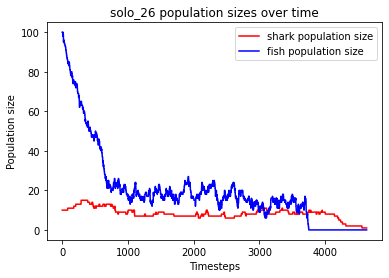

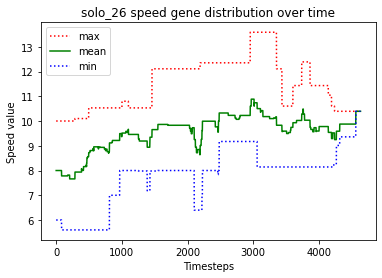

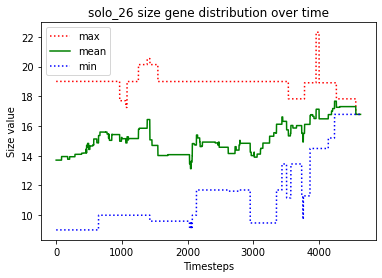

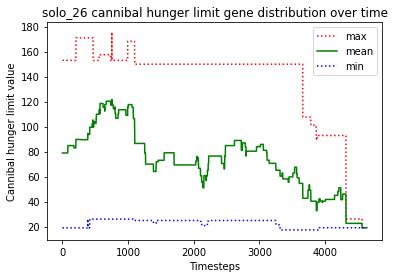

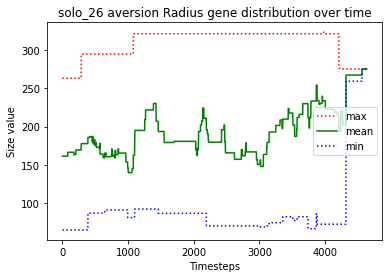

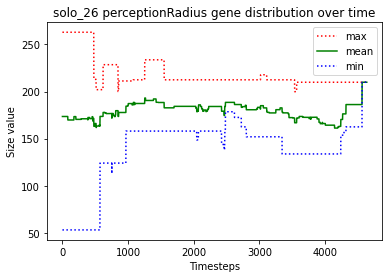

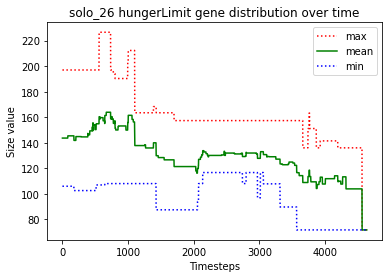





						SOLO_27

predator_4 just gave birth to predator_10
predator_4 killed predator_9
predator_10 just gave birth to predator_11
predator_11 just gave birth to predator_12
predator_10 just gave birth to predator_13
predator_2 just gave birth to predator_14
predator_10 starved to death
predator_4 killed predator_11
predator_14 killed predator_5
predator_12 ate the carcass of predator_10_carcass
predator_14 killed predator_4
predator_13 starved to death
predator_0 ate the carcass of predator_13_carcass
predator_2 killed predator_0
predator_2 killed predator_12
predator_8 just gave birth to predator_15
predator_2 killed predator_8
predator_2 killed predator_15
predator_2 killed predator_7
predator_2 just gave birth to predator_16
predator_6 just gave birth to predator_17
predator_17 just gave birth to predator_18
predator_2 just gave birth to predator_19
predator_17 starved to death
predator_3 ate the carcass of predator_17_carcass
predator_18 starved to death
predator_6 ate the carca

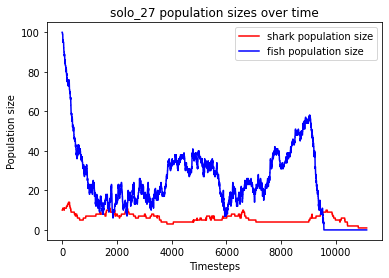

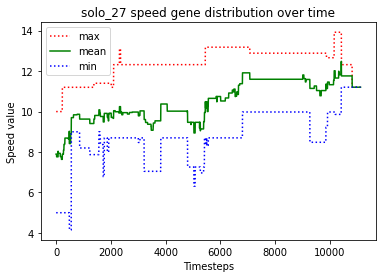

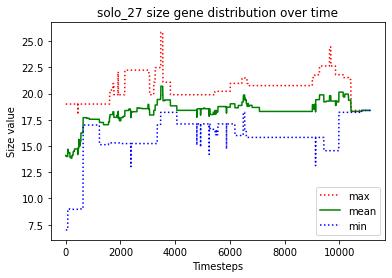

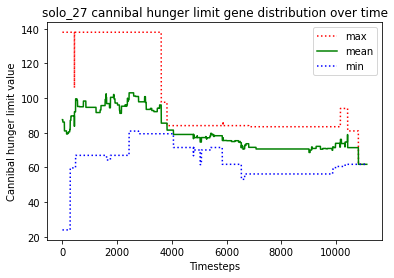

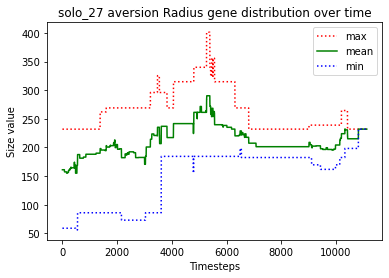

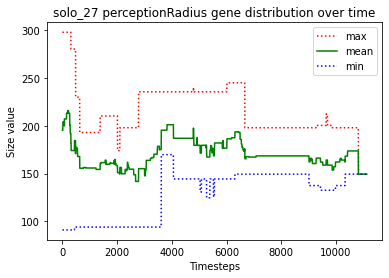

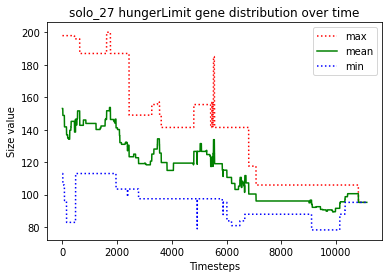





						SOLO_28

predator_2 just gave birth to predator_10
predator_7 just gave birth to predator_11
predator_7 just gave birth to predator_12
predator_5 just gave birth to predator_13
predator_5 killed predator_7
predator_12 starved to death
predator_5 killed predator_11
predator_0 ate the carcass of predator_12_carcass
predator_5 just gave birth to predator_14
predator_0 just gave birth to predator_15
predator_6 just gave birth to predator_16
predator_9 just gave birth to predator_17
predator_5 just gave birth to predator_18
predator_2 just gave birth to predator_19
predator_10 starved to death
predator_0 just gave birth to predator_20
predator_1 ate the carcass of predator_10_carcass
predator_0 killed predator_17
predator_2 starved to death
predator_19 starved to death
predator_4 ate the carcass of predator_2_carcass
predator_16 ate the carcass of predator_19_carcass
predator_20 killed predator_3
predator_15 just gave birth to predator_21
predator_6 just gave birth to predator_22


predator_67 ate the carcass of predator_62_carcass
predator_44 just gave birth to predator_73
predator_67 killed predator_73
predator_39 starved to death
predator_44 just gave birth to predator_74
predator_74 ate the carcass of predator_39_carcass
predator_74 just gave birth to predator_75
predator_69 starved to death
predator_59 ate the carcass of predator_69_carcass
predator_74 just gave birth to predator_76
predator_59 just gave birth to predator_77
predator_75 just gave birth to predator_78
predator_75 just gave birth to predator_79
predator_79 starved to death
predator_75 starved to death
predator_76 ate the carcass of predator_75_carcass
predator_56 ate the carcass of predator_79_carcass
predator_78 starved to death
predator_67 just gave birth to predator_80
predator_44 ate the carcass of predator_78_carcass
predator_63 just gave birth to predator_81
predator_63 starved to death
predator_81 starved to death
predator_77 ate the carcass of predator_63_carcass
predator_80 ate the ca

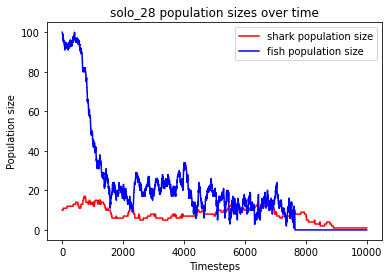

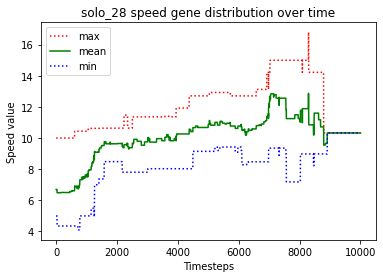

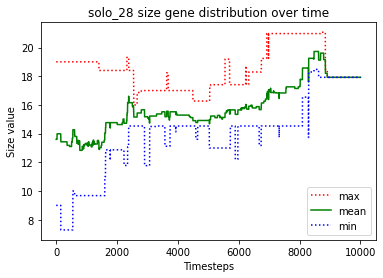

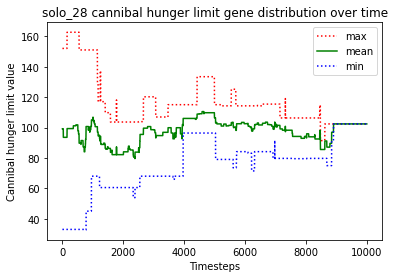

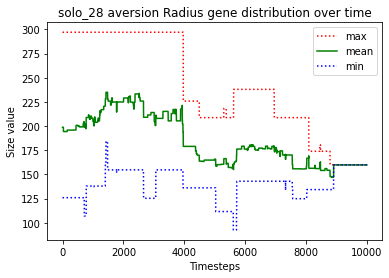

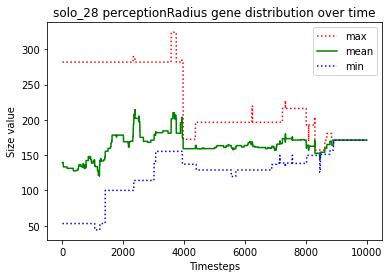

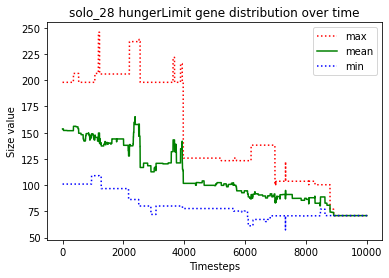





						SOLO_29

predator_2 killed predator_9
predator_2 killed predator_4
predator_2 just gave birth to predator_10
predator_2 killed predator_10
predator_0 just gave birth to predator_11
predator_1 just gave birth to predator_12
predator_2 starved to death
predator_0 just gave birth to predator_13
predator_11 ate the carcass of predator_2_carcass
predator_8 starved to death
predator_1 ate the carcass of predator_8_carcass
predator_12 just gave birth to predator_14
predator_14 killed predator_6
predator_12 starved to death
predator_11 ate the carcass of predator_12_carcass
predator_13 killed predator_5
predator_13 just gave birth to predator_15
predator_13 starved to death
predator_7 ate the carcass of predator_13_carcass
predator_15 killed predator_1
predator_14 just gave birth to predator_16
predator_16 starved to death
predator_3 ate the carcass of predator_16_carcass
predator_3 starved to death
predator_11 ate the carcass of predator_3_carcass
predator_15 starved to death
predat

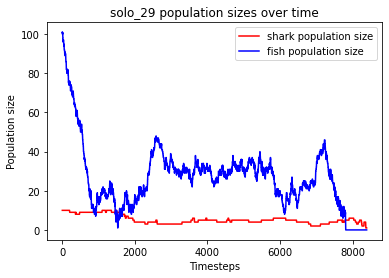

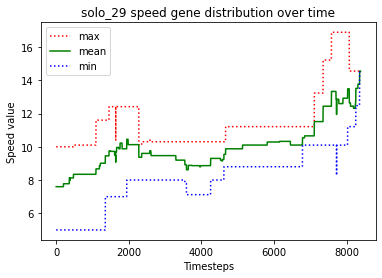

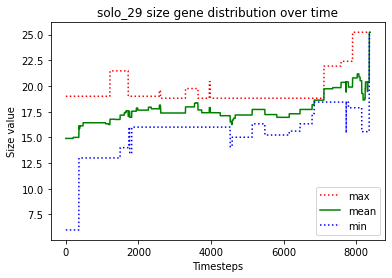

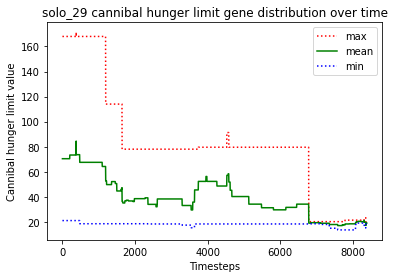

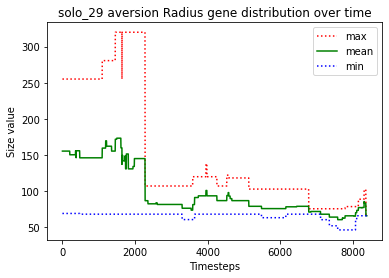

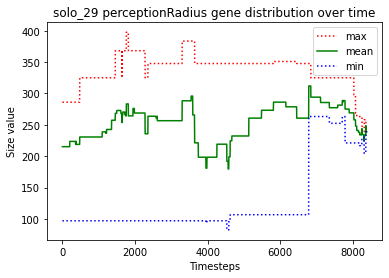

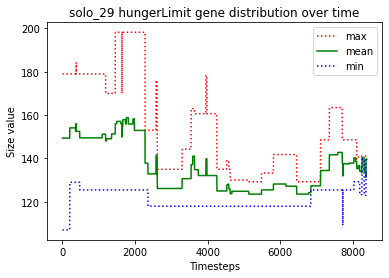





						SOLO_30

predator_0 just gave birth to predator_10
predator_2 just gave birth to predator_11
predator_10 just gave birth to predator_12
predator_7 just gave birth to predator_13
predator_5 just gave birth to predator_14
predator_2 just gave birth to predator_15
predator_15 starved to death
predator_2 ate the carcass of predator_15_carcass
predator_11 starved to death
predator_7 just gave birth to predator_16
predator_7 ate the carcass of predator_11_carcass
predator_10 starved to death
predator_2 ate the carcass of predator_10_carcass
predator_2 starved to death
predator_14 just gave birth to predator_17
predator_9 ate the carcass of predator_2_carcass
predator_0 starved to death
predator_5 starved to death
predator_8 just gave birth to predator_18
predator_12 starved to death
no fish to move
predator_9 ate the carcass of predator_12_carcass
predator_4 ate the carcass of predator_0_carcass
predator_14 starved to death
predator_18 ate the carcass of predator_5_carcass
predator

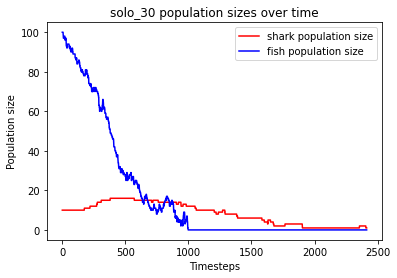

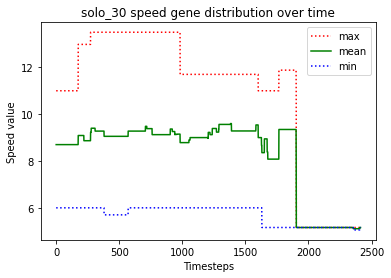

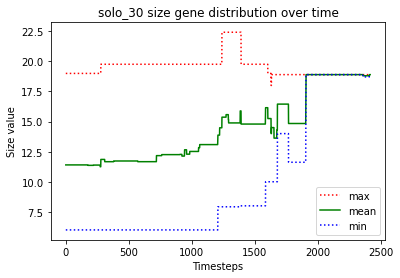

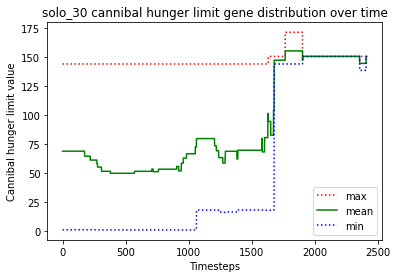

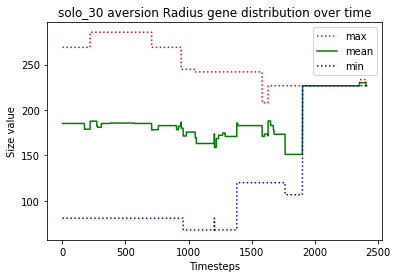

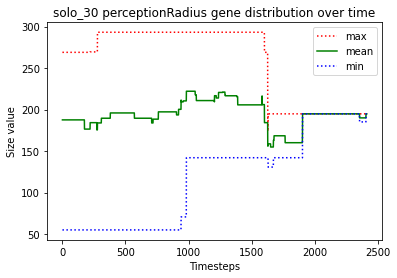

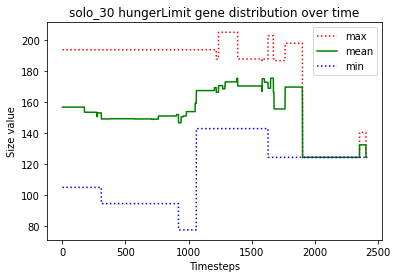





						SOLO_31

predator_3 just gave birth to predator_10
predator_5 just gave birth to predator_11
predator_6 just gave birth to predator_12
predator_5 just gave birth to predator_13
predator_11 just gave birth to predator_14
predator_14 starved to death
predator_11 ate the carcass of predator_14_carcass
predator_5 starved to death
predator_13 starved to death
predator_1 just gave birth to predator_15
predator_2 ate the carcass of predator_13_carcass
predator_0 ate the carcass of predator_5_carcass
predator_11 starved to death
predator_3 starved to death
predator_10 starved to death
predator_4 ate the carcass of predator_3_carcass
predator_8 ate the carcass of predator_11_carcass
predator_7 ate the carcass of predator_10_carcass
predator_8 just gave birth to predator_16
predator_12 just gave birth to predator_17
predator_12 killed predator_17
predator_0 just gave birth to predator_18
predator_7 just gave birth to predator_19
predator_12 starved to death
predator_6 starved to death


predator_62 just gave birth to predator_68
predator_66 just gave birth to predator_69
predator_66 just gave birth to predator_70
predator_59 starved to death
predator_70 starved to death
predator_63 ate the carcass of predator_70_carcass
predator_66 ate the carcass of predator_59_carcass
predator_66 just gave birth to predator_71
predator_68 starved to death
predator_71 ate the carcass of predator_68_carcass
predator_66 just gave birth to predator_72
predator_72 starved to death
predator_66 starved to death
predator_63 ate the carcass of predator_72_carcass
predator_71 ate the carcass of predator_66_carcass
predator_69 just gave birth to predator_73
predator_69 killed predator_73
predator_60 just gave birth to predator_74
predator_62 just gave birth to predator_75
predator_60 just gave birth to predator_76
predator_63 just gave birth to predator_77
predator_62 just gave birth to predator_78
predator_74 starved to death
predator_76 starved to death
predator_63 ate the carcass of predato

predator_127 starved to death
predator_107 ate the carcass of predator_126_carcass
predator_125 ate the carcass of predator_128_carcass
predator_115 ate the carcass of predator_129_carcass
predator_125 just gave birth to predator_130
predator_125 killed predator_130
predator_122 starved to death
predator_124 ate the carcass of predator_122_carcass
predator_106 ate the carcass of predator_127_carcass
predator_115 just gave birth to predator_131
predator_131 starved to death
predator_107 just gave birth to predator_132
predator_115 ate the carcass of predator_131_carcass
predator_123 starved to death
predator_107 ate the carcass of predator_123_carcass
predator_132 just gave birth to predator_133
predator_133 just gave birth to predator_134
predator_125 starved to death
predator_134 starved to death
predator_106 ate the carcass of predator_134_carcass
predator_124 starved to death
predator_115 just gave birth to predator_135
predator_115 ate the carcass of predator_125_carcass
predator_1

predator_182 just gave birth to predator_188
predator_186 starved to death
predator_185 just gave birth to predator_189
predator_184 just gave birth to predator_190
predator_190 just gave birth to predator_191
predator_173 starved to death
predator_185 just gave birth to predator_192
predator_182 just gave birth to predator_193
predator_189 starved to death
predator_185 starved to death
predator_192 starved to death
predator_193 ate the carcass of predator_189_carcass
predator_181 ate the carcass of predator_185_carcass
predator_188 starved to death
predator_157 ate the carcass of predator_173_carcass
predator_183 ate the carcass of predator_186_carcass
predator_182 starved to death
predator_181 ate the carcass of predator_192_carcass
predator_190 just gave birth to predator_194
predator_194 starved to death
predator_187 just gave birth to predator_195
predator_190 starved to death
predator_187 ate the carcass of predator_182_carcass
predator_195 starved to death
predator_184 just gave

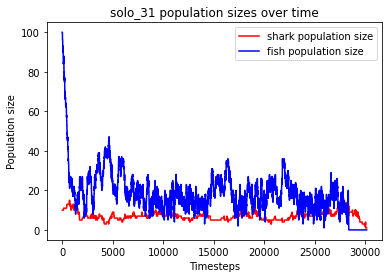

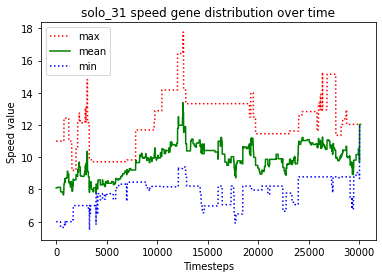

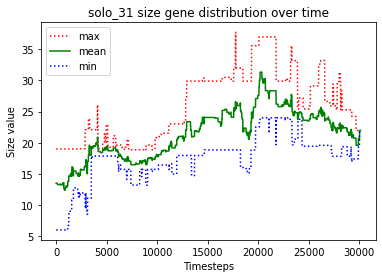

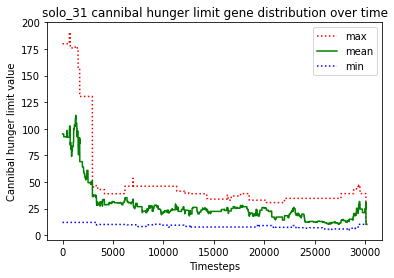

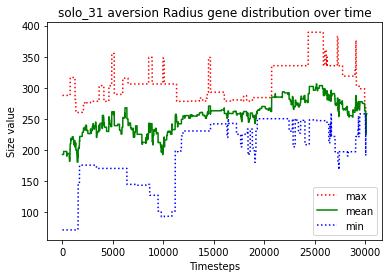

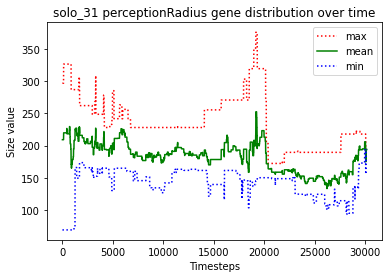

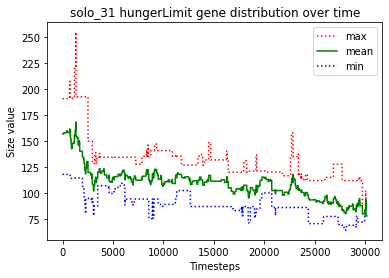





						SOLO_32

predator_0 just gave birth to predator_10
predator_2 just gave birth to predator_11
predator_3 just gave birth to predator_12
predator_1 just gave birth to predator_13
predator_5 just gave birth to predator_14
predator_11 just gave birth to predator_15
predator_14 just gave birth to predator_16
predator_15 just gave birth to predator_17
predator_15 just gave birth to predator_18
predator_10 just gave birth to predator_19
predator_6 just gave birth to predator_20
predator_11 killed predator_16
predator_15 starved to death
predator_18 starved to death
predator_4 ate the carcass of predator_15_carcass
predator_17 just gave birth to predator_21
predator_17 starved to death
predator_21 starved to death
predator_6 ate the carcass of predator_21_carcass
predator_6 ate the carcass of predator_18_carcass
predator_6 ate the carcass of predator_17_carcass
predator_19 just gave birth to predator_22
predator_13 just gave birth to predator_23
predator_11 starved to death
predator_

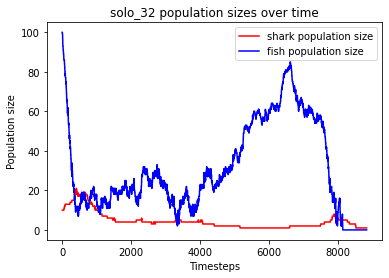

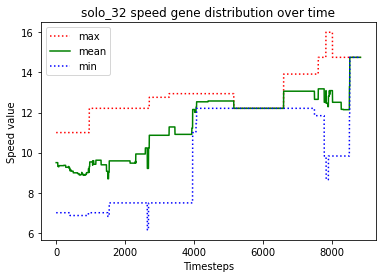

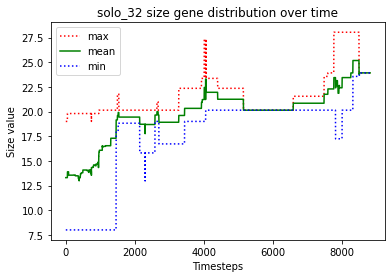

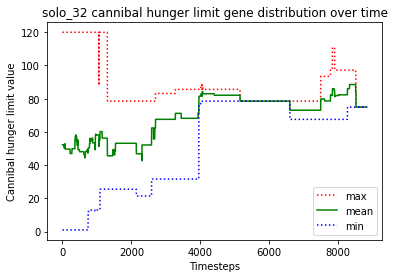

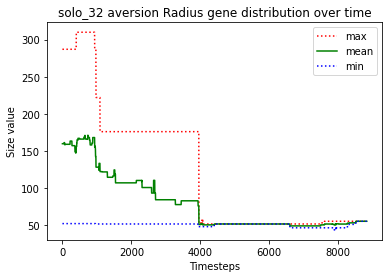

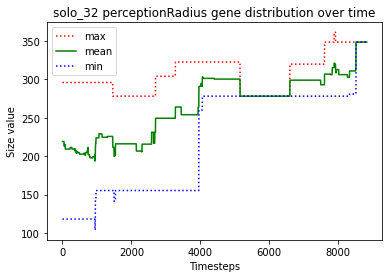

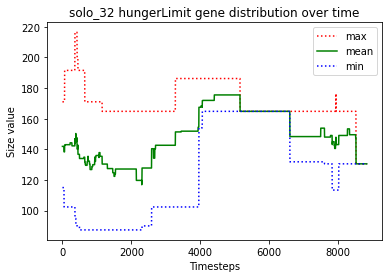





						SOLO_33

predator_8 just gave birth to predator_10
predator_4 just gave birth to predator_11
predator_8 killed predator_3
predator_9 just gave birth to predator_12
predator_9 killed predator_6
predator_7 just gave birth to predator_13
predator_1 just gave birth to predator_14
predator_5 just gave birth to predator_15
predator_7 just gave birth to predator_16
predator_8 starved to death
predator_10 starved to death
predator_14 ate the carcass of predator_10_carcass
predator_9 ate the carcass of predator_8_carcass
predator_7 just gave birth to predator_17
predator_16 starved to death
predator_2 ate the carcass of predator_16_carcass
predator_15 just gave birth to predator_18
predator_17 starved to death
predator_7 ate the carcass of predator_17_carcass
predator_4 just gave birth to predator_19
predator_11 just gave birth to predator_20
predator_11 starved to death
predator_18 starved to death
predator_13 starved to death
predator_4 ate the carcass of predator_11_carcass
predato

predator_70 ate the carcass of predator_64_carcass
predator_60 just gave birth to predator_71
predator_60 just gave birth to predator_72
predator_71 starved to death
predator_72 starved to death
predator_60 ate the carcass of predator_72_carcass
predator_68 ate the carcass of predator_71_carcass
predator_70 just gave birth to predator_73
predator_70 just gave birth to predator_74
predator_74 just gave birth to predator_75
predator_75 starved to death
predator_70 ate the carcass of predator_75_carcass
predator_74 starved to death
predator_68 just gave birth to predator_76
predator_73 starved to death
predator_70 ate the carcass of predator_73_carcass
predator_76 ate the carcass of predator_74_carcass
predator_60 just gave birth to predator_77
predator_77 starved to death
predator_60 starved to death
predator_68 ate the carcass of predator_77_carcass
predator_70 ate the carcass of predator_60_carcass
predator_76 just gave birth to predator_78
predator_76 killed predator_78
predator_76 ju

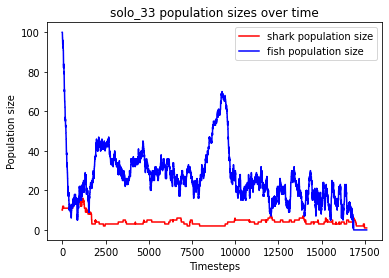

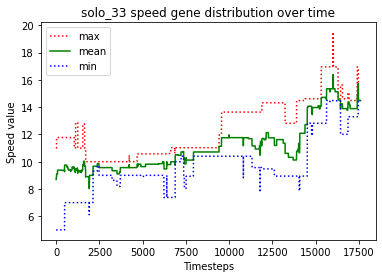

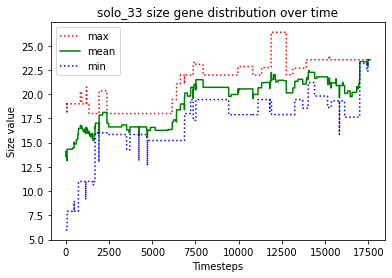

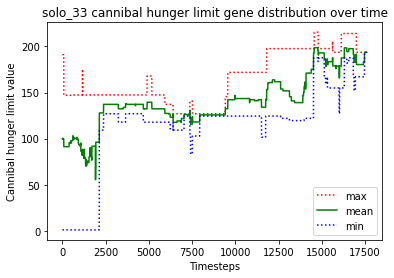

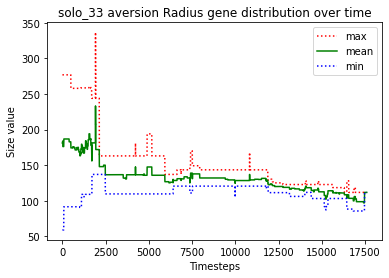

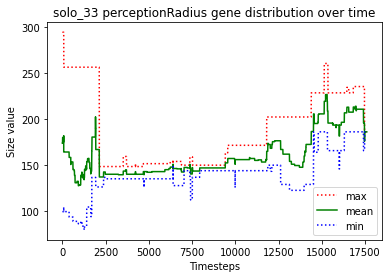

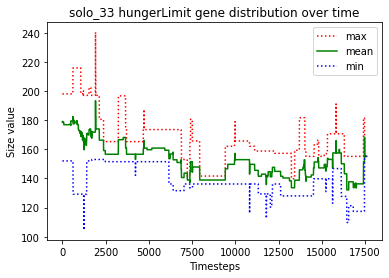





						SOLO_34

predator_8 just gave birth to predator_10
predator_2 just gave birth to predator_11
predator_11 killed predator_0
predator_5 just gave birth to predator_12
predator_4 just gave birth to predator_13
predator_13 just gave birth to predator_14
predator_8 just gave birth to predator_15
predator_12 just gave birth to predator_16
predator_13 starved to death
predator_8 ate the carcass of predator_13_carcass
predator_14 starved to death
predator_15 killed predator_1
predator_5 ate the carcass of predator_14_carcass
predator_8 just gave birth to predator_17
predator_4 starved to death
predator_10 ate the carcass of predator_4_carcass
predator_16 starved to death
predator_8 ate the carcass of predator_16_carcass
predator_12 starved to death
predator_9 ate the carcass of predator_12_carcass
predator_15 starved to death
predator_6 ate the carcass of predator_15_carcass
predator_11 just gave birth to predator_18
predator_7 just gave birth to predator_19
predator_17 starved to de

predator_44 ate the carcass of predator_60_carcass
predator_70 starved to death
predator_52 just gave birth to predator_77
predator_52 killed predator_77
predator_73 starved to death
predator_76 starved to death
predator_62 ate the carcass of predator_73_carcass
predator_57 ate the carcass of predator_76_carcass
predator_71 ate the carcass of predator_70_carcass
predator_75 starved to death
predator_52 just gave birth to predator_78
predator_63 starved to death
predator_52 ate the carcass of predator_63_carcass
predator_69 starved to death
predator_57 ate the carcass of predator_75_carcass
predator_71 starved to death
predator_52 just gave birth to predator_79
predator_79 starved to death
predator_52 ate the carcass of predator_79_carcass
predator_78 starved to death
predator_62 ate the carcass of predator_69_carcass
predator_44 just gave birth to predator_80
predator_44 killed predator_80
predator_65 ate the carcass of predator_71_carcass
predator_52 killed predator_57
predator_52 jus

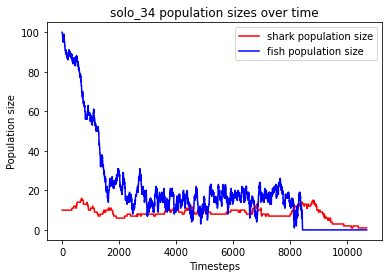

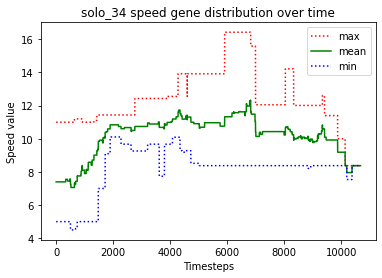

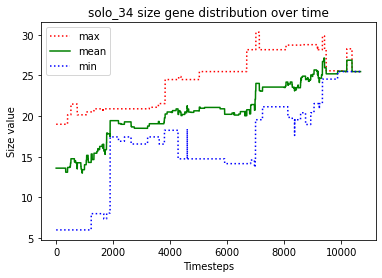

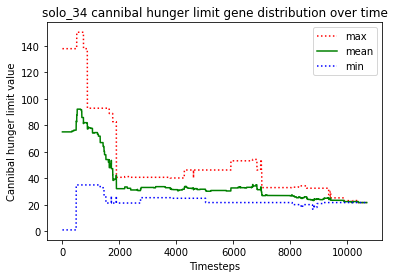

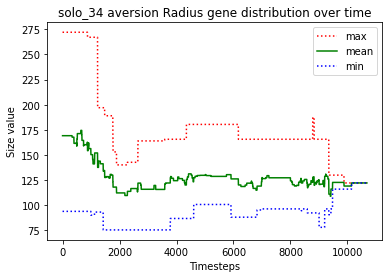

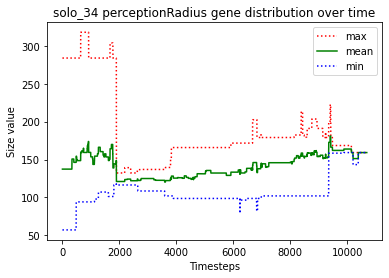

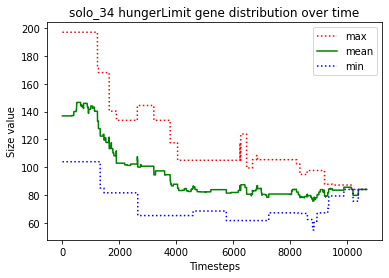





						SOLO_35

predator_2 just gave birth to predator_10
predator_7 just gave birth to predator_11
predator_3 just gave birth to predator_12
predator_10 killed predator_1
predator_2 killed predator_11
predator_2 just gave birth to predator_13
predator_3 killed predator_8
predator_13 killed predator_5
predator_2 just gave birth to predator_14
predator_10 killed predator_12
predator_2 killed predator_6
predator_10 killed predator_3
predator_14 starved to death
predator_2 ate the carcass of predator_14_carcass
predator_10 killed predator_7
predator_2 killed predator_4
predator_2 just gave birth to predator_15
predator_15 starved to death
predator_9 ate the carcass of predator_15_carcass
predator_2 just gave birth to predator_16
predator_2 killed predator_16
predator_13 starved to death
predator_10 ate the carcass of predator_13_carcass
predator_0 just gave birth to predator_17
predator_0 just gave birth to predator_18
predator_17 just gave birth to predator_19
predator_19 just gave bi

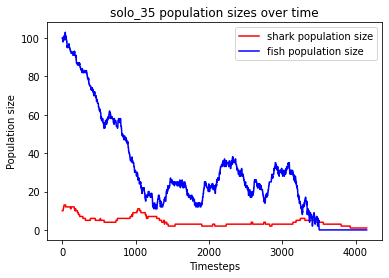

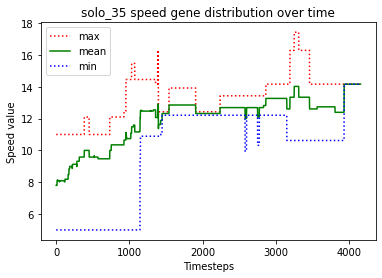

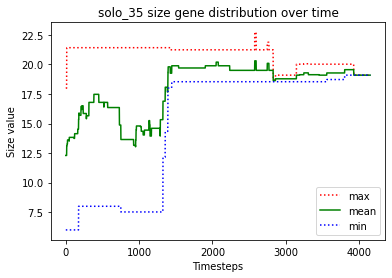

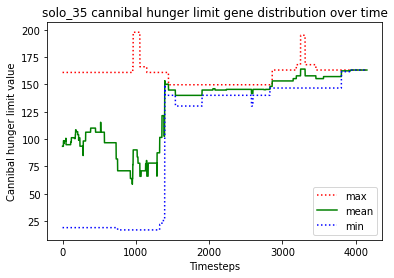

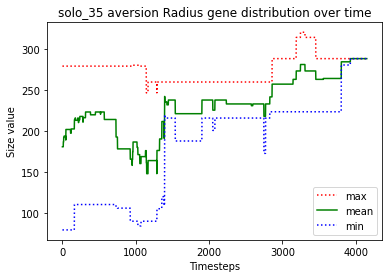

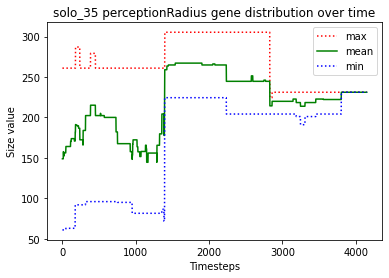

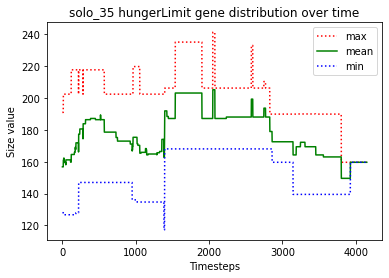





						SOLO_36

predator_6 just gave birth to predator_10
predator_8 just gave birth to predator_11
predator_8 killed predator_3
predator_8 just gave birth to predator_12
predator_11 killed predator_6
predator_1 just gave birth to predator_13
predator_10 just gave birth to predator_14
predator_12 just gave birth to predator_15
predator_12 killed predator_7
predator_8 killed predator_13
predator_15 killed predator_14
predator_12 just gave birth to predator_16
predator_8 killed predator_9
predator_16 killed predator_2
predator_8 just gave birth to predator_17
predator_10 starved to death
predator_15 ate the carcass of predator_10_carcass
predator_17 killed predator_5
predator_8 just gave birth to predator_18
predator_16 killed predator_4
predator_8 starved to death
predator_17 ate the carcass of predator_8_carcass
predator_1 just gave birth to predator_19
predator_11 just gave birth to predator_20
predator_18 starved to death
predator_1 ate the carcass of predator_18_carcass
predator_

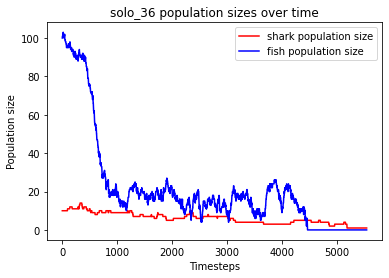

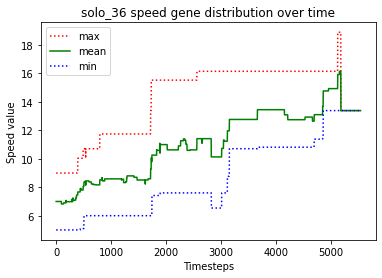

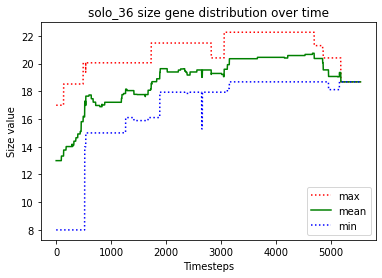

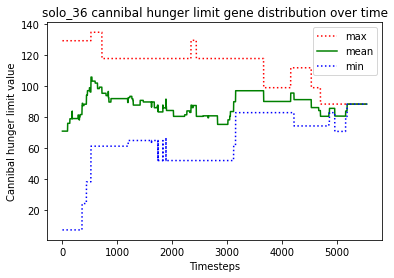

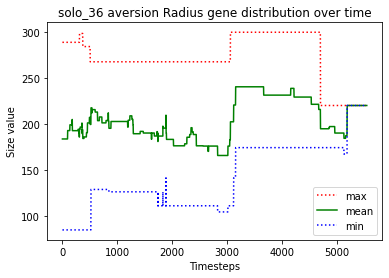

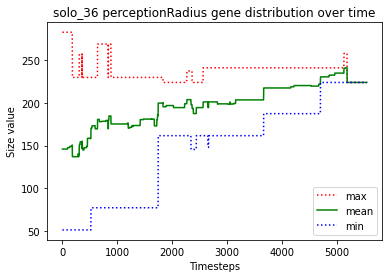

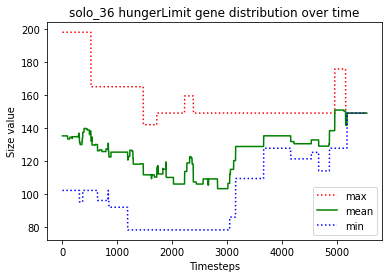





						SOLO_37

predator_4 just gave birth to predator_10
predator_6 just gave birth to predator_11
predator_1 just gave birth to predator_12
predator_4 just gave birth to predator_13
predator_6 killed predator_9
predator_3 just gave birth to predator_14
predator_4 killed predator_2
predator_14 killed predator_5
predator_3 killed predator_12
predator_8 just gave birth to predator_15
predator_10 just gave birth to predator_16
predator_13 starved to death
predator_10 starved to death
predator_1 ate the carcass of predator_13_carcass
predator_16 starved to death
predator_4 ate the carcass of predator_10_carcass
predator_1 just gave birth to predator_17
predator_1 ate the carcass of predator_16_carcass
predator_14 killed predator_1
predator_14 killed predator_17
predator_8 just gave birth to predator_18
predator_6 just gave birth to predator_19
predator_7 just gave birth to predator_20
predator_14 killed predator_18
predator_4 starved to death
predator_14 ate the carcass of predator_4_c

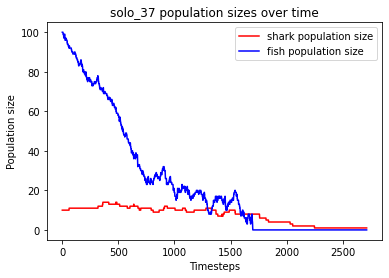

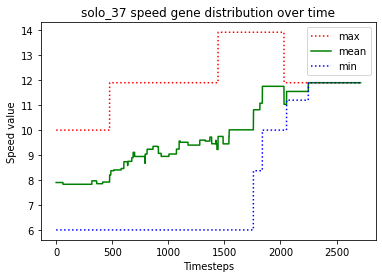

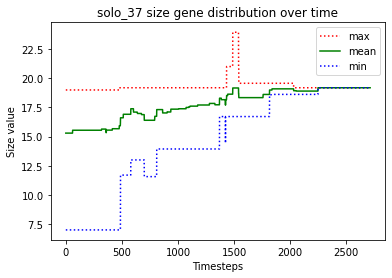

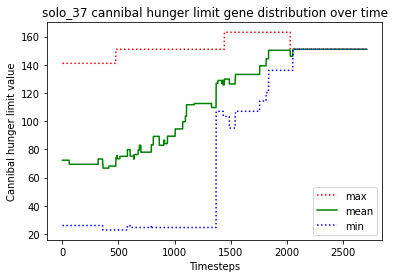

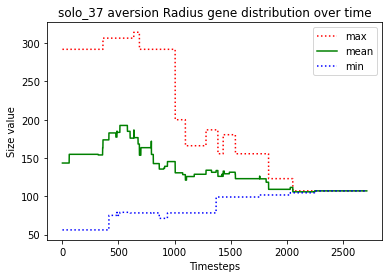

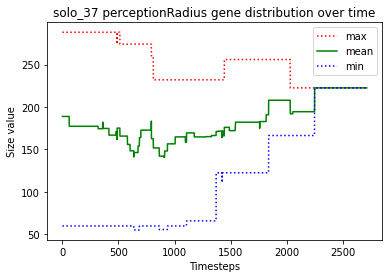

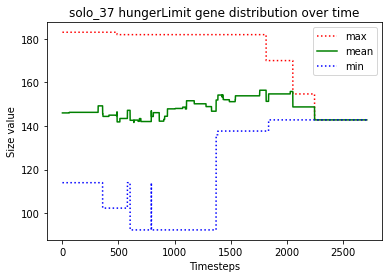





						SOLO_38

predator_7 just gave birth to predator_10
predator_4 just gave birth to predator_11
predator_11 killed predator_6
predator_4 killed predator_0
predator_8 just gave birth to predator_12
predator_4 just gave birth to predator_13
predator_10 starved to death
predator_7 ate the carcass of predator_10_carcass
predator_11 killed predator_7
predator_9 just gave birth to predator_14
predator_11 killed predator_12
predator_4 killed predator_8
predator_13 killed predator_1
predator_11 just gave birth to predator_15
predator_11 killed predator_3
predator_15 killed predator_2
predator_11 killed predator_9
predator_15 killed predator_14
predator_4 just gave birth to predator_16
predator_16 just gave birth to predator_17
predator_15 just gave birth to predator_18
predator_4 just gave birth to predator_19
predator_17 just gave birth to predator_20
predator_20 just gave birth to predator_21
predator_21 just gave birth to predator_22
predator_21 starved to death
predator_16 ate the c

predator_60 ate the carcass of predator_74_carcass
predator_60 ate the carcass of predator_55_carcass
predator_60 ate the carcass of predator_64_carcass
predator_61 starved to death
predator_60 ate the carcass of predator_61_carcass
predator_60 starved to death


finished this run because predators went extinct
Fish left: 0
Sharks left: 0
Dead sharks: 75
Timesteps passed: 12212
Fish went extinct at timestep 10302
Sharks went extinct at timestep 12212


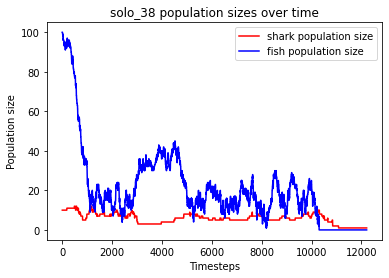

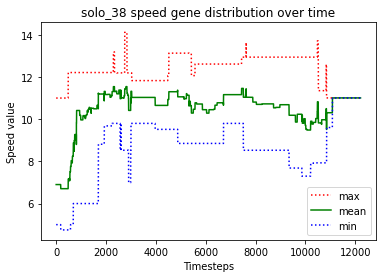

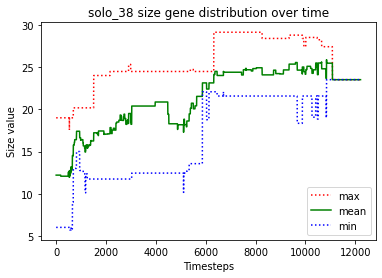

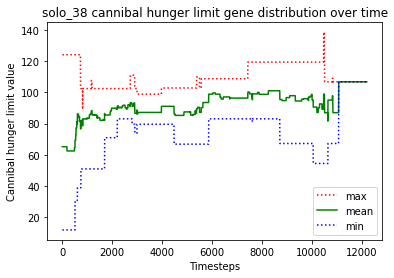

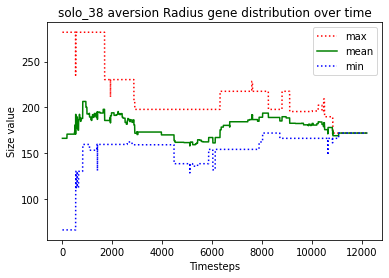

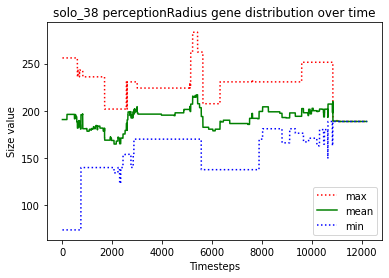

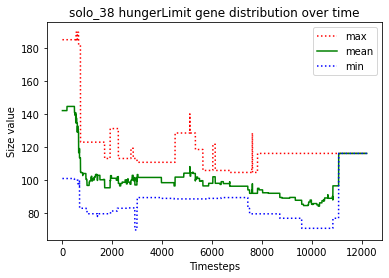





						SOLO_39

predator_8 just gave birth to predator_10
predator_10 killed predator_4
predator_1 just gave birth to predator_11
predator_1 just gave birth to predator_12
predator_0 just gave birth to predator_13
predator_11 killed predator_7
predator_6 just gave birth to predator_14
predator_10 killed predator_0
predator_8 killed predator_13
predator_3 just gave birth to predator_15
predator_12 just gave birth to predator_16
predator_8 just gave birth to predator_17
predator_16 just gave birth to predator_18
predator_15 just gave birth to predator_19
predator_1 just gave birth to predator_20
predator_20 starved to death
predator_1 ate the carcass of predator_20_carcass
predator_17 starved to death
predator_10 ate the carcass of predator_17_carcass
predator_6 starved to death
predator_1 just gave birth to predator_21
predator_11 ate the carcass of predator_6_carcass
predator_21 starved to death
predator_1 ate the carcass of predator_21_carcass
predator_8 starved to death
predator_1

predator_59 starved to death
predator_69 ate the carcass of predator_59_carcass
predator_71 starved to death
predator_65 ate the carcass of predator_71_carcass
predator_69 just gave birth to predator_73
predator_69 starved to death
predator_70 just gave birth to predator_74
predator_74 killed predator_58
predator_57 ate the carcass of predator_69_carcass
predator_72 just gave birth to predator_75
predator_70 just gave birth to predator_76
predator_74 killed predator_76
predator_70 starved to death
predator_75 ate the carcass of predator_70_carcass
predator_72 just gave birth to predator_77
predator_75 just gave birth to predator_78
predator_78 just gave birth to predator_79
predator_79 just gave birth to predator_80
predator_79 starved to death
predator_80 ate the carcass of predator_79_carcass
predator_75 just gave birth to predator_81
predator_74 just gave birth to predator_82
predator_75 starved to death
predator_81 starved to death
no fish to move
predator_73 starved to death
preda

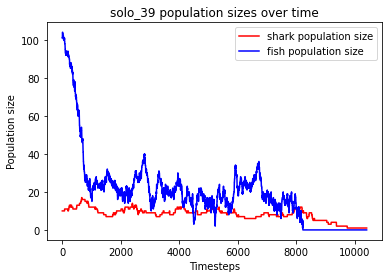

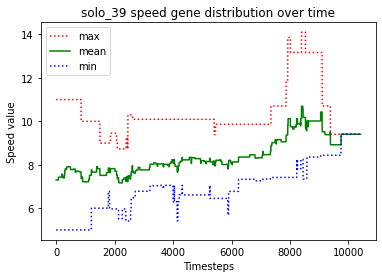

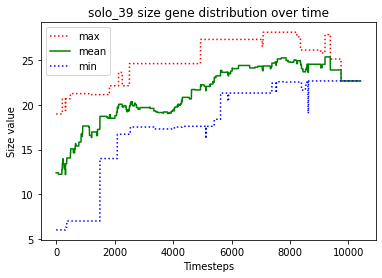

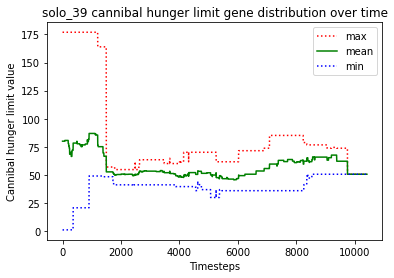

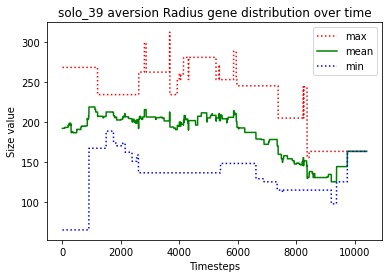

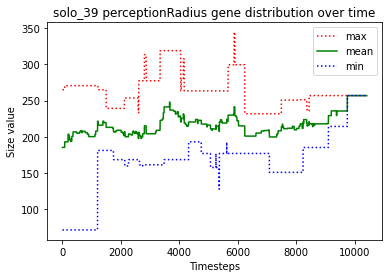

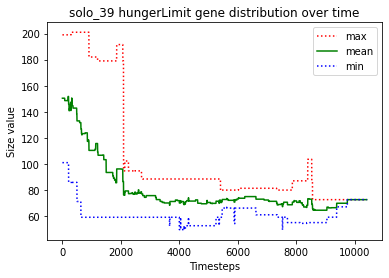





						SOLO_40

predator_2 just gave birth to predator_10
predator_6 killed predator_8
predator_3 just gave birth to predator_11
predator_6 killed predator_2
predator_3 just gave birth to predator_12
predator_3 just gave birth to predator_13
predator_11 killed predator_4
predator_5 just gave birth to predator_14
predator_12 starved to death
predator_6 killed predator_10
predator_13 starved to death
predator_14 ate the carcass of predator_12_carcass
predator_3 starved to death
predator_5 killed predator_1
predator_6 ate the carcass of predator_3_carcass
predator_0 ate the carcass of predator_13_carcass
predator_5 just gave birth to predator_15
predator_9 just gave birth to predator_16
predator_14 just gave birth to predator_17
predator_5 killed predator_16
predator_15 starved to death
predator_14 ate the carcass of predator_15_carcass
predator_7 starved to death
predator_5 killed predator_17
predator_14 ate the carcass of predator_7_carcass
predator_5 just gave birth to predator_18
p

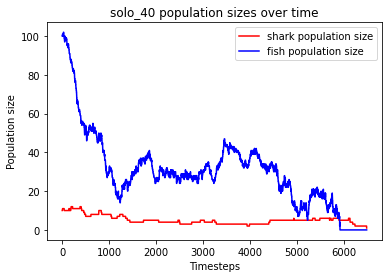

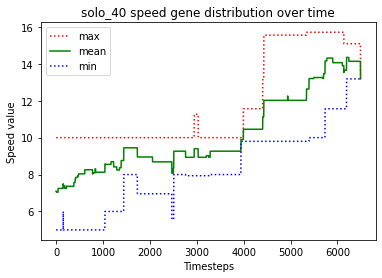

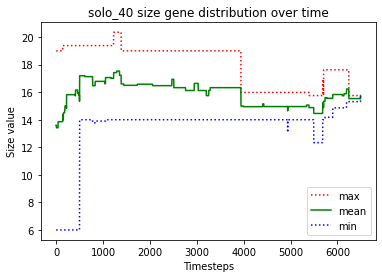

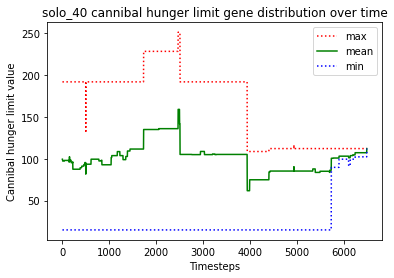

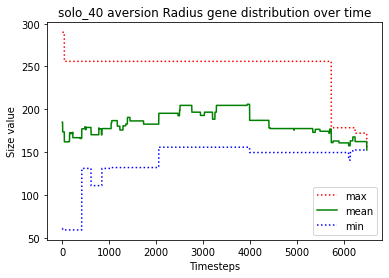

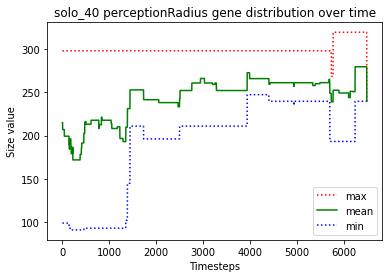

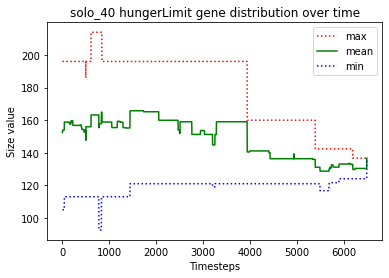





						SOLO_41

predator_7 just gave birth to predator_10
predator_4 just gave birth to predator_11
predator_5 just gave birth to predator_12
predator_10 starved to death
predator_7 ate the carcass of predator_10_carcass
predator_3 just gave birth to predator_13
predator_5 starved to death
predator_8 just gave birth to predator_14
predator_9 ate the carcass of predator_5_carcass
predator_1 just gave birth to predator_15
predator_12 starved to death
predator_7 ate the carcass of predator_12_carcass
predator_15 just gave birth to predator_16
predator_4 starved to death
predator_13 ate the carcass of predator_4_carcass
predator_15 killed predator_8
predator_7 just gave birth to predator_17
predator_11 starved to death
predator_3 ate the carcass of predator_11_carcass
predator_15 just gave birth to predator_18
predator_16 starved to death
predator_17 starved to death
predator_7 ate the carcass of predator_17_carcass
predator_15 ate the carcass of predator_16_carcass
predator_18 just gav

predator_63 ate the carcass of predator_64_carcass
predator_63 ate the carcass of predator_68_carcass
predator_66 just gave birth to predator_69
predator_69 starved to death
predator_63 ate the carcass of predator_69_carcass
predator_66 starved to death
predator_63 ate the carcass of predator_66_carcass
predator_63 just gave birth to predator_70
predator_63 just gave birth to predator_71
predator_70 killed predator_71
predator_63 just gave birth to predator_72
predator_72 just gave birth to predator_73
predator_73 starved to death
predator_72 ate the carcass of predator_73_carcass
predator_70 starved to death
predator_63 ate the carcass of predator_70_carcass
predator_63 just gave birth to predator_74
predator_74 starved to death
predator_63 ate the carcass of predator_74_carcass
predator_72 just gave birth to predator_75
predator_75 just gave birth to predator_76
predator_63 just gave birth to predator_77
predator_77 starved to death
predator_63 ate the carcass of predator_77_carcass


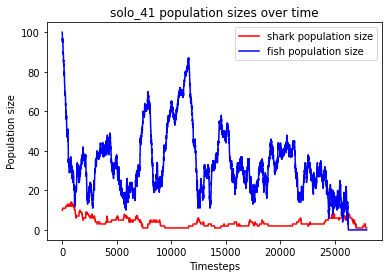

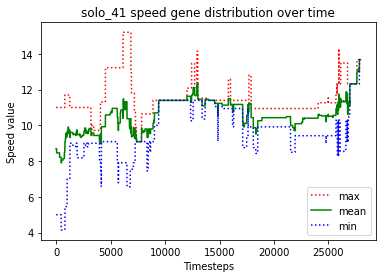

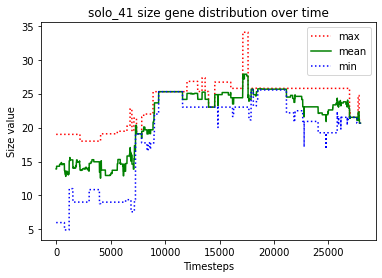

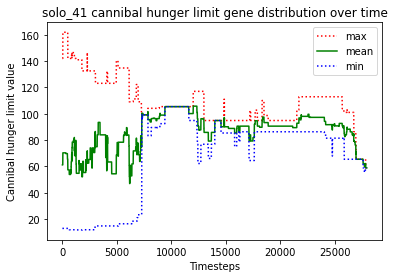

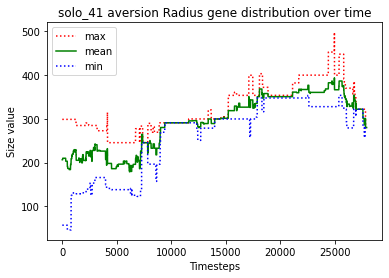

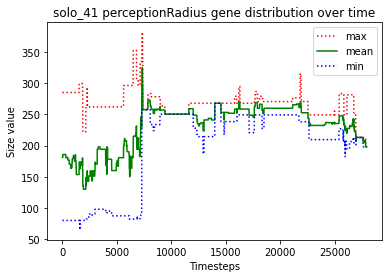

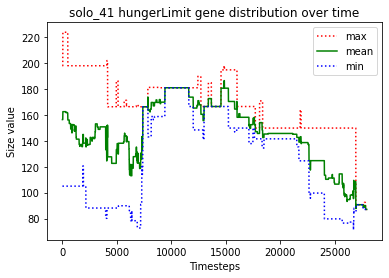





						SOLO_42

predator_7 just gave birth to predator_10
predator_4 killed predator_2
predator_5 just gave birth to predator_11
predator_9 just gave birth to predator_12
predator_10 just gave birth to predator_13
predator_9 killed predator_13
predator_12 killed predator_10
predator_4 killed predator_0
predator_9 killed predator_5
predator_12 killed predator_6
predator_12 killed predator_3
predator_9 just gave birth to predator_14
predator_12 killed predator_7
predator_9 killed predator_11
predator_1 just gave birth to predator_15
predator_1 just gave birth to predator_16
predator_4 just gave birth to predator_17
predator_4 just gave birth to predator_18
predator_9 killed predator_18
predator_12 just gave birth to predator_19
predator_12 just gave birth to predator_20
predator_1 just gave birth to predator_21
predator_1 killed predator_21
predator_14 just gave birth to predator_22
predator_22 killed predator_1
predator_4 starved to death
predator_16 ate the carcass of predator_4_car

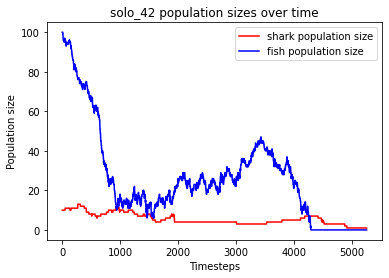

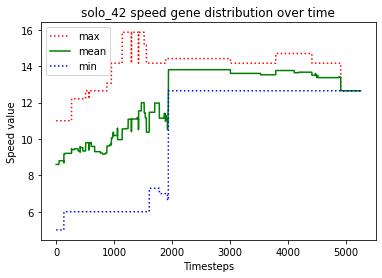

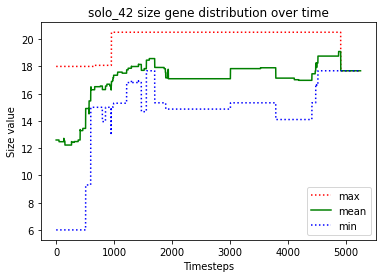

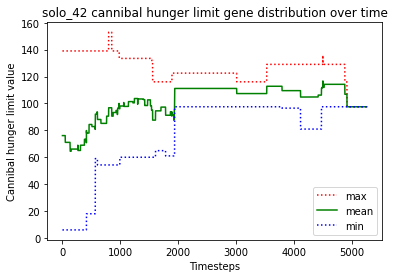

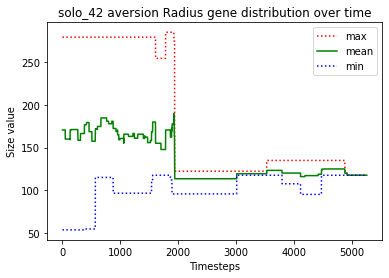

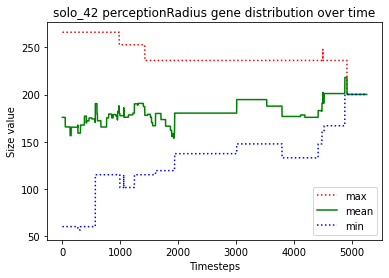

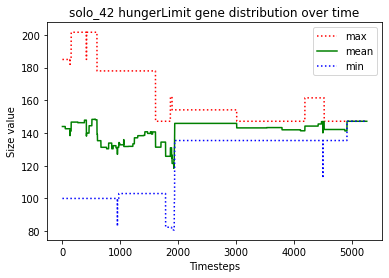





						SOLO_43

predator_3 just gave birth to predator_10
predator_2 just gave birth to predator_11
predator_3 just gave birth to predator_12
predator_8 just gave birth to predator_13
predator_0 just gave birth to predator_14
predator_3 just gave birth to predator_15
predator_3 starved to death
predator_15 starved to death
predator_9 ate the carcass of predator_3_carcass
predator_14 ate the carcass of predator_15_carcass
predator_5 just gave birth to predator_16
predator_8 just gave birth to predator_17
predator_9 just gave birth to predator_18
predator_5 killed predator_2
predator_17 killed predator_18
predator_12 just gave birth to predator_19
predator_17 killed predator_10
predator_12 starved to death
predator_5 killed predator_11
predator_19 starved to death
predator_5 just gave birth to predator_20
predator_1 ate the carcass of predator_12_carcass
predator_16 just gave birth to predator_21
predator_14 ate the carcass of predator_19_carcass
predator_6 just gave birth to predator

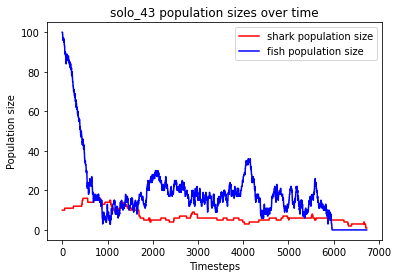

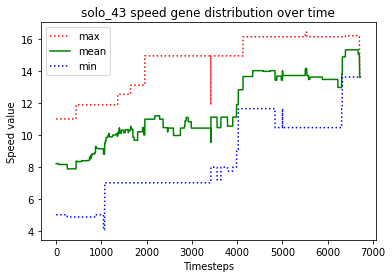

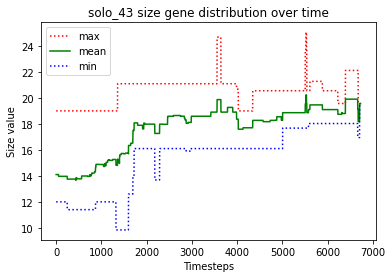

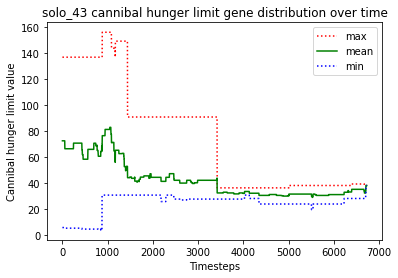

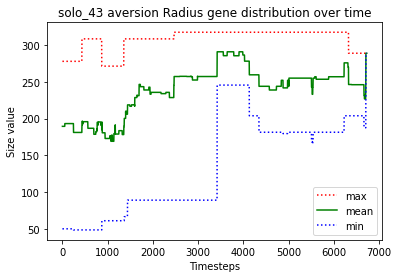

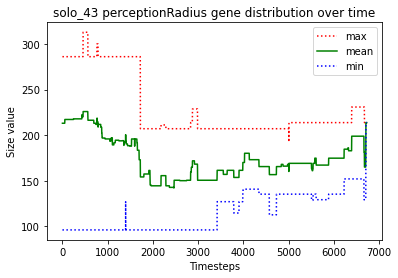

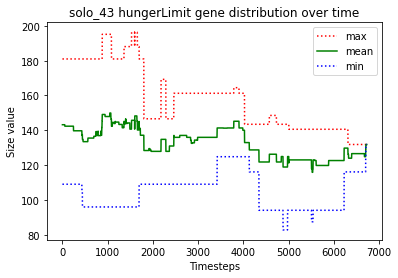





						SOLO_44

predator_5 killed predator_0
predator_9 just gave birth to predator_10
predator_5 killed predator_10
predator_7 just gave birth to predator_11
predator_9 starved to death
predator_11 just gave birth to predator_12
predator_4 ate the carcass of predator_9_carcass
predator_12 killed predator_6
predator_11 starved to death
predator_1 ate the carcass of predator_11_carcass
predator_12 just gave birth to predator_13
predator_2 just gave birth to predator_14
predator_13 starved to death
predator_8 just gave birth to predator_15
predator_14 just gave birth to predator_16
predator_12 starved to death
predator_14 starved to death
predator_16 starved to death
predator_2 starved to death
predator_7 ate the carcass of predator_2_carcass
predator_8 ate the carcass of predator_14_carcass
predator_8 ate the carcass of predator_16_carcass
predator_3 ate the carcass of predator_13_carcass
predator_4 ate the carcass of predator_12_carcass
predator_7 killed predator_1
predator_5 just g

predator_57 ate the carcass of predator_69_carcass
predator_59 ate the carcass of predator_64_carcass
predator_45 just gave birth to predator_70
predator_21 just gave birth to predator_71
predator_57 starved to death
predator_70 starved to death
predator_45 starved to death
predator_21 ate the carcass of predator_57_carcass
predator_21 ate the carcass of predator_70_carcass
predator_65 starved to death
predator_21 ate the carcass of predator_65_carcass
predator_71 starved to death
predator_59 just gave birth to predator_72
predator_35 just gave birth to predator_73
predator_59 starved to death
predator_72 starved to death
predator_21 ate the carcass of predator_45_carcass
predator_35 starved to death
predator_73 starved to death
predator_21 ate the carcass of predator_35_carcass
predator_21 ate the carcass of predator_73_carcass
predator_21 ate the carcass of predator_71_carcass
predator_21 ate the carcass of predator_72_carcass
predator_21 ate the carcass of predator_59_carcass
predat

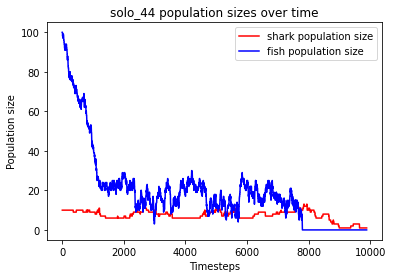

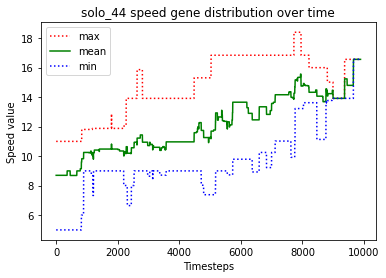

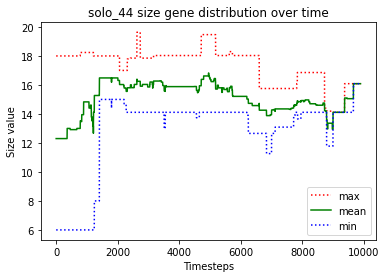

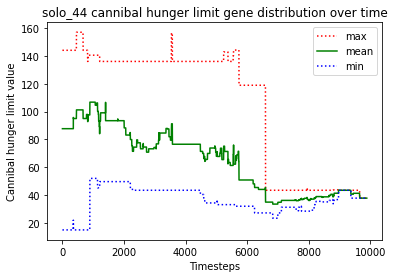

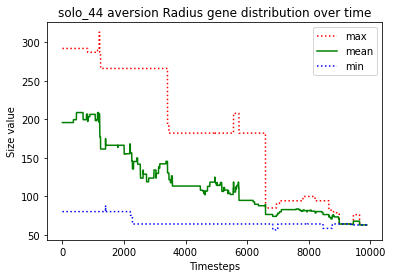

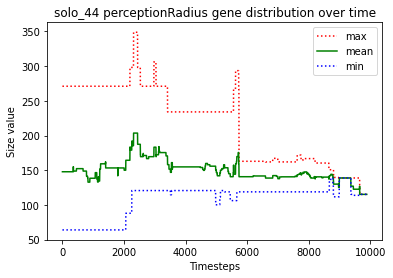

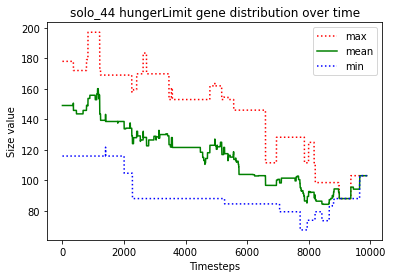





						SOLO_45

predator_7 just gave birth to predator_10
predator_5 just gave birth to predator_11
predator_4 just gave birth to predator_12
predator_4 killed predator_12
predator_0 just gave birth to predator_13
predator_5 just gave birth to predator_14
predator_10 just gave birth to predator_15
predator_2 just gave birth to predator_16
predator_15 just gave birth to predator_17
predator_7 killed predator_6
predator_15 starved to death
predator_7 ate the carcass of predator_15_carcass
predator_10 starved to death
predator_17 ate the carcass of predator_10_carcass
predator_14 just gave birth to predator_18
predator_8 just gave birth to predator_19
predator_1 just gave birth to predator_20
predator_14 starved to death
predator_17 ate the carcass of predator_14_carcass
predator_8 just gave birth to predator_21
predator_8 just gave birth to predator_22
predator_18 starved to death
predator_9 just gave birth to predator_23
predator_16 starved to death
predator_5 ate the carcass of pred

predator_52 starved to death
predator_74 killed predator_71
predator_72 ate the carcass of predator_52_carcass
predator_73 starved to death
predator_75 just gave birth to predator_76
predator_63 ate the carcass of predator_73_carcass
predator_76 starved to death
predator_67 ate the carcass of predator_76_carcass
predator_70 starved to death
predator_72 ate the carcass of predator_70_carcass
predator_75 starved to death
predator_67 ate the carcass of predator_75_carcass
predator_42 just gave birth to predator_77
predator_77 starved to death
predator_42 starved to death
predator_67 ate the carcass of predator_77_carcass
predator_69 ate the carcass of predator_42_carcass
predator_11 starved to death
predator_67 ate the carcass of predator_11_carcass
predator_72 just gave birth to predator_78
predator_72 just gave birth to predator_79
predator_67 just gave birth to predator_80
predator_74 just gave birth to predator_81
predator_72 just gave birth to predator_82
predator_63 just gave birth 

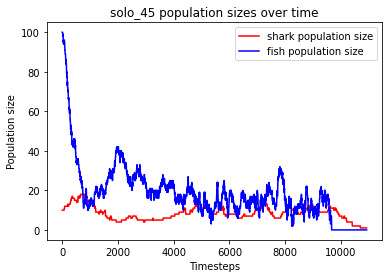

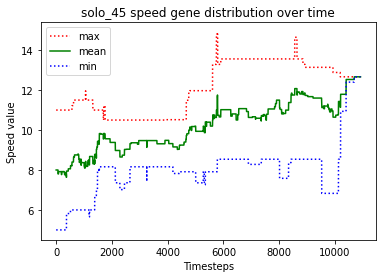

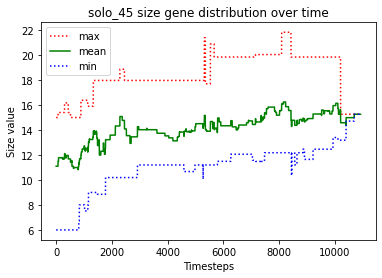

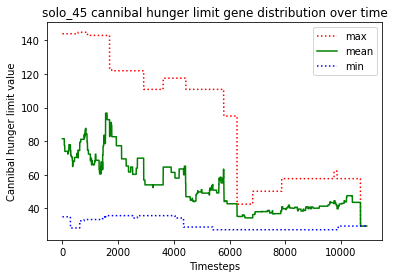

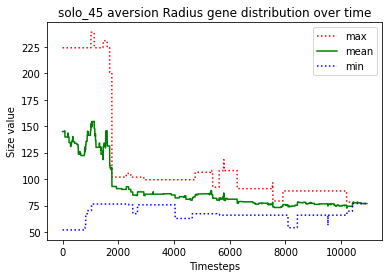

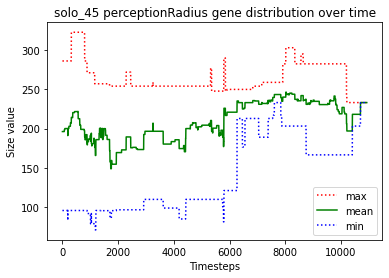

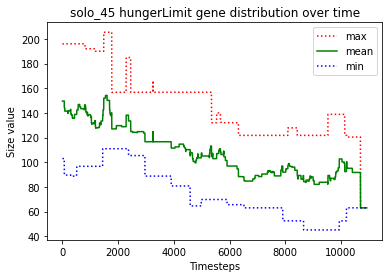





						SOLO_46

predator_4 just gave birth to predator_10
predator_10 just gave birth to predator_11
predator_10 killed predator_5
predator_0 just gave birth to predator_12
predator_0 just gave birth to predator_13
predator_11 starved to death
predator_4 ate the carcass of predator_11_carcass
predator_10 starved to death
predator_2 ate the carcass of predator_10_carcass
predator_9 just gave birth to predator_14
predator_8 just gave birth to predator_15
predator_15 killed predator_1
predator_4 starved to death
predator_0 ate the carcass of predator_4_carcass
predator_15 just gave birth to predator_16
predator_6 just gave birth to predator_17
predator_13 starved to death
predator_0 ate the carcass of predator_13_carcass
predator_17 just gave birth to predator_18
predator_0 killed predator_2
predator_16 starved to death
predator_15 ate the carcass of predator_16_carcass
predator_17 starved to death
predator_18 starved to death
predator_3 ate the carcass of predator_17_carcass
predator_

predator_67 starved to death
predator_72 ate the carcass of predator_67_carcass
predator_72 just gave birth to predator_73
predator_73 starved to death
predator_72 starved to death
predator_66 ate the carcass of predator_72_carcass
predator_71 ate the carcass of predator_73_carcass
predator_66 just gave birth to predator_74
predator_71 just gave birth to predator_75
predator_74 just gave birth to predator_76
predator_74 just gave birth to predator_77
predator_77 just gave birth to predator_78
predator_78 starved to death
predator_77 ate the carcass of predator_78_carcass
predator_74 starved to death
predator_66 ate the carcass of predator_74_carcass
predator_66 just gave birth to predator_79
predator_76 just gave birth to predator_80
predator_79 just gave birth to predator_81
predator_76 just gave birth to predator_82
predator_82 starved to death
predator_76 ate the carcass of predator_82_carcass
predator_71 just gave birth to predator_83
predator_80 killed predator_79
predator_80 just

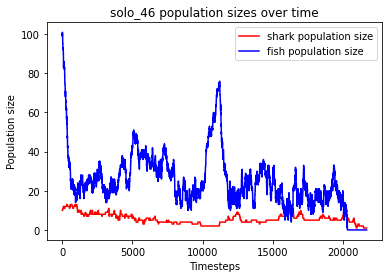

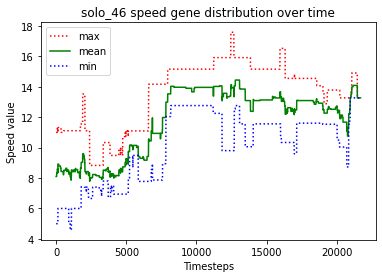

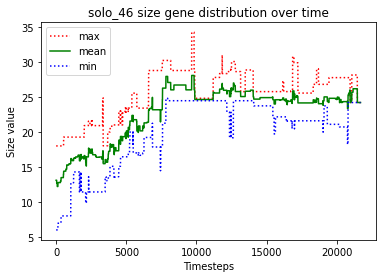

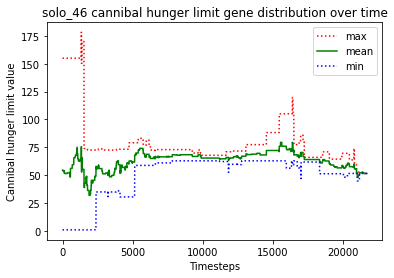

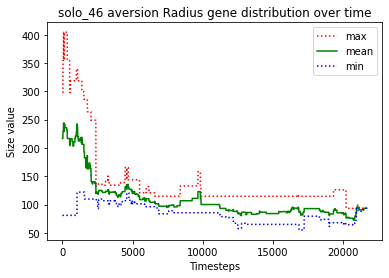

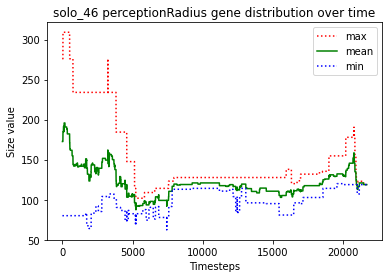

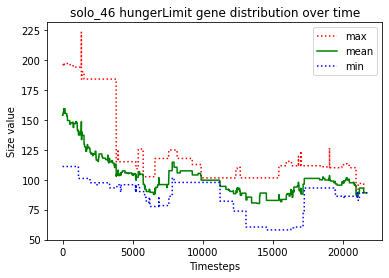





						SOLO_47

predator_9 just gave birth to predator_10
predator_0 just gave birth to predator_11
predator_0 just gave birth to predator_12
predator_3 just gave birth to predator_13
predator_12 just gave birth to predator_14
predator_14 starved to death
predator_9 just gave birth to predator_15
predator_7 just gave birth to predator_16
predator_12 starved to death
predator_9 ate the carcass of predator_12_carcass
predator_10 just gave birth to predator_17
predator_4 just gave birth to predator_18
predator_10 ate the carcass of predator_14_carcass
predator_0 starved to death
predator_1 ate the carcass of predator_0_carcass
predator_15 starved to death
predator_1 ate the carcass of predator_15_carcass
predator_10 killed predator_8
predator_17 starved to death
predator_7 ate the carcass of predator_17_carcass
predator_13 just gave birth to predator_19
predator_11 starved to death
predator_16 starved to death
predator_13 ate the carcass of predator_11_carcass
predator_7 starved to dea

predator_65 starved to death
predator_62 just gave birth to predator_68
predator_62 killed predator_68
predator_62 just gave birth to predator_69
predator_63 ate the carcass of predator_65_carcass
predator_62 just gave birth to predator_70
predator_70 starved to death
predator_58 ate the carcass of predator_70_carcass
predator_62 starved to death
predator_31 ate the carcass of predator_62_carcass
predator_69 just gave birth to predator_71
predator_71 starved to death
predator_69 ate the carcass of predator_71_carcass
predator_58 just gave birth to predator_72
predator_58 just gave birth to predator_73
predator_73 just gave birth to predator_74
predator_74 killed predator_72
predator_74 killed predator_69
predator_73 killed predator_63
predator_73 just gave birth to predator_75
predator_74 killed predator_75
predator_74 starved to death
predator_73 starved to death
predator_31 ate the carcass of predator_74_carcass
predator_31 just gave birth to predator_76
predator_58 ate the carcass o

predator_133 just gave birth to predator_136
predator_129 starved to death
predator_126 just gave birth to predator_137
predator_119 starved to death
predator_132 ate the carcass of predator_119_carcass
predator_135 starved to death
predator_122 ate the carcass of predator_135_carcass
predator_136 ate the carcass of predator_129_carcass
predator_137 starved to death
predator_126 killed predator_132
predator_133 just gave birth to predator_138
predator_118 ate the carcass of predator_137_carcass
predator_133 starved to death
predator_126 ate the carcass of predator_133_carcass
predator_124 just gave birth to predator_139
predator_138 killed predator_122
predator_126 just gave birth to predator_140
predator_126 killed predator_124
predator_126 killed predator_134
predator_140 starved to death
predator_128 starved to death
predator_118 ate the carcass of predator_140_carcass
predator_126 ate the carcass of predator_128_carcass
predator_139 just gave birth to predator_141
predator_139 just

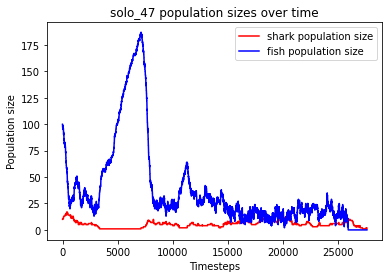

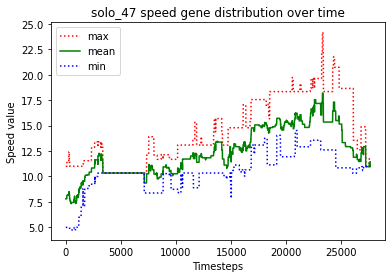

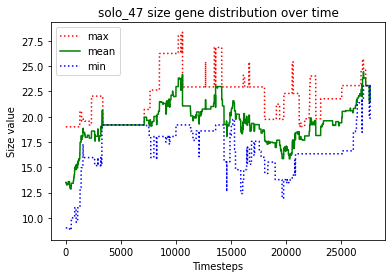

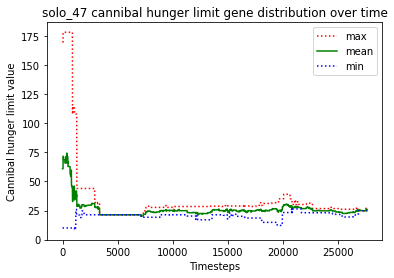

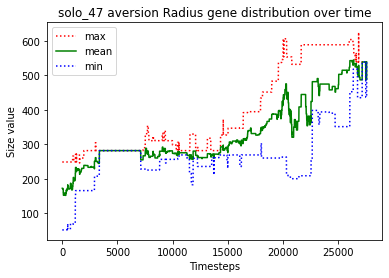

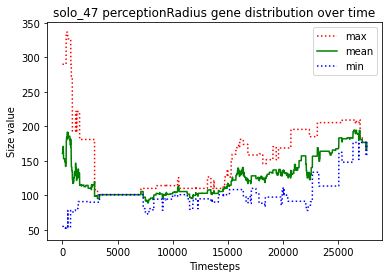

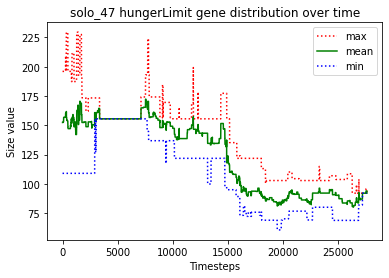





						SOLO_48

predator_6 just gave birth to predator_10
predator_8 just gave birth to predator_11
predator_6 just gave birth to predator_12
predator_3 just gave birth to predator_13
predator_3 killed predator_2
predator_12 starved to death
predator_8 just gave birth to predator_14
predator_1 ate the carcass of predator_12_carcass
predator_7 just gave birth to predator_15
predator_1 just gave birth to predator_16
predator_13 just gave birth to predator_17
predator_11 killed predator_4
predator_14 just gave birth to predator_18
predator_10 starved to death
predator_17 ate the carcass of predator_10_carcass
predator_14 starved to death
predator_18 starved to death
predator_6 starved to death
predator_16 ate the carcass of predator_14_carcass
predator_1 ate the carcass of predator_6_carcass
predator_16 ate the carcass of predator_18_carcass
predator_17 killed predator_0
predator_8 starved to death
predator_5 just gave birth to predator_19
predator_15 just gave birth to predator_20
pre

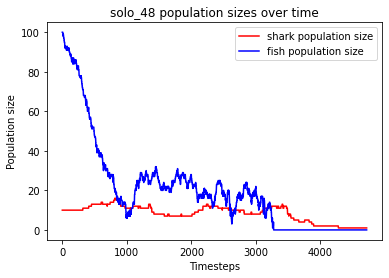

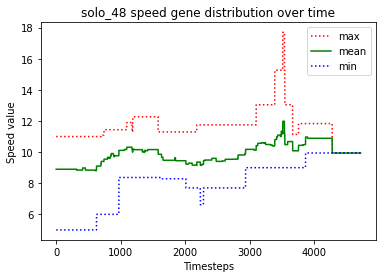

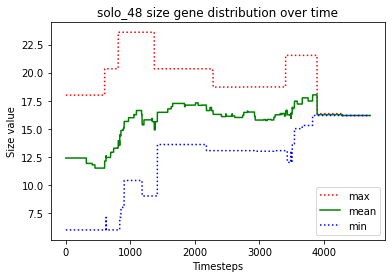

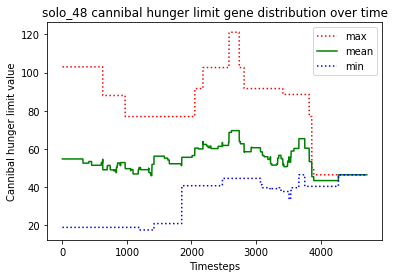

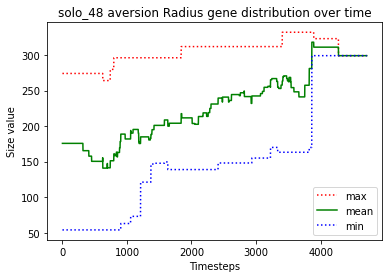

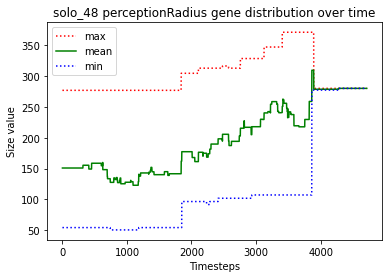

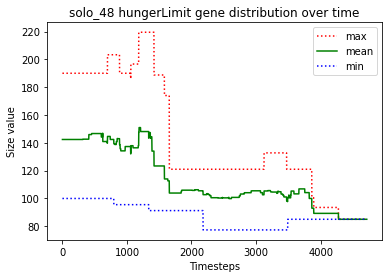





						SOLO_49

predator_3 just gave birth to predator_10
predator_2 just gave birth to predator_11
predator_4 just gave birth to predator_12
predator_12 just gave birth to predator_13
predator_4 just gave birth to predator_14
predator_10 just gave birth to predator_15
predator_3 killed predator_4
predator_5 just gave birth to predator_16
predator_3 just gave birth to predator_17
predator_17 killed predator_13
predator_16 killed predator_1
predator_14 just gave birth to predator_18
predator_3 killed predator_18
predator_8 just gave birth to predator_19
predator_17 killed predator_0
predator_3 killed predator_14
predator_17 killed predator_7
predator_6 just gave birth to predator_20
predator_19 just gave birth to predator_21
predator_3 just gave birth to predator_22
predator_21 starved to death
predator_20 ate the carcass of predator_21_carcass
predator_19 starved to death
predator_3 starved to death
predator_12 just gave birth to predator_23
predator_6 ate the carcass of predator_3_

predator_67 starved to death
predator_65 ate the carcass of predator_67_carcass
predator_70 just gave birth to predator_74
predator_70 starved to death
predator_74 starved to death
predator_71 starved to death
predator_60 ate the carcass of predator_70_carcass
predator_73 starved to death
predator_57 just gave birth to predator_75
predator_57 ate the carcass of predator_74_carcass
predator_69 starved to death
predator_57 ate the carcass of predator_71_carcass
predator_57 ate the carcass of predator_73_carcass
predator_60 ate the carcass of predator_69_carcass
predator_75 just gave birth to predator_76
predator_76 just gave birth to predator_77
predator_65 just gave birth to predator_78
predator_77 starved to death
predator_57 just gave birth to predator_79
predator_76 starved to death
predator_59 just gave birth to predator_80
predator_59 ate the carcass of predator_77_carcass
predator_59 ate the carcass of predator_76_carcass
predator_78 starved to death
predator_65 starved to death
p

predator_125 starved to death
predator_112 ate the carcass of predator_125_carcass
predator_130 starved to death
predator_112 ate the carcass of predator_128_carcass
predator_112 ate the carcass of predator_130_carcass
predator_112 just gave birth to predator_131
predator_112 just gave birth to predator_132
predator_131 just gave birth to predator_133
predator_131 just gave birth to predator_134
predator_134 just gave birth to predator_135
predator_134 starved to death
predator_135 ate the carcass of predator_134_carcass
predator_135 killed predator_112
predator_131 starved to death
predator_133 ate the carcass of predator_131_carcass
predator_135 starved to death
predator_133 just gave birth to predator_136
predator_133 killed predator_136
predator_133 ate the carcass of predator_135_carcass
predator_132 just gave birth to predator_137
predator_132 starved to death
predator_137 starved to death
predator_133 ate the carcass of predator_137_carcass
predator_133 ate the carcass of predat

predator_187 starved to death
predator_175 just gave birth to predator_189
predator_186 ate the carcass of predator_187_carcass
predator_175 starved to death
predator_189 starved to death
predator_188 just gave birth to predator_190
predator_188 ate the carcass of predator_189_carcass
predator_190 starved to death
predator_186 ate the carcass of predator_175_carcass
predator_188 starved to death
predator_186 ate the carcass of predator_190_carcass
predator_186 ate the carcass of predator_188_carcass
predator_186 just gave birth to predator_191
predator_191 just gave birth to predator_192
predator_186 just gave birth to predator_193
predator_186 starved to death
predator_193 ate the carcass of predator_186_carcass
predator_192 just gave birth to predator_194
predator_192 killed predator_194
predator_193 killed predator_191
predator_193 just gave birth to predator_195
predator_195 just gave birth to predator_196
predator_196 starved to death
predator_195 just gave birth to predator_197
p

predator_216 just gave birth to predator_253
predator_250 just gave birth to predator_254
predator_254 starved to death
predator_250 starved to death
predator_216 ate the carcass of predator_254_carcass
predator_239 just gave birth to predator_255
predator_216 ate the carcass of predator_250_carcass
predator_216 just gave birth to predator_256
predator_253 starved to death
predator_249 ate the carcass of predator_253_carcass
predator_249 just gave birth to predator_257
predator_238 starved to death
predator_257 starved to death
predator_249 starved to death
predator_247 ate the carcass of predator_257_carcass
predator_251 ate the carcass of predator_249_carcass
predator_256 ate the carcass of predator_238_carcass
predator_216 just gave birth to predator_258
predator_258 killed predator_255
predator_258 just gave birth to predator_259
predator_259 killed predator_247
predator_239 just gave birth to predator_260
predator_259 starved to death
predator_258 ate the carcass of predator_259_c

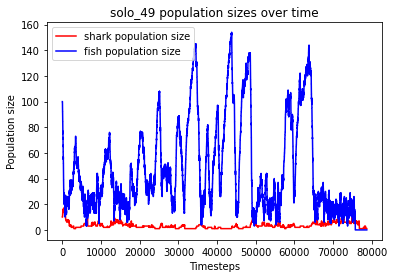

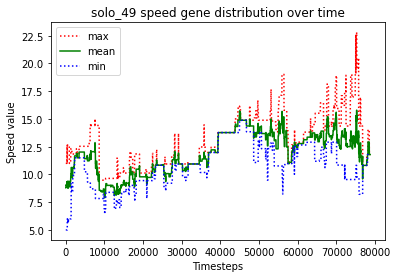

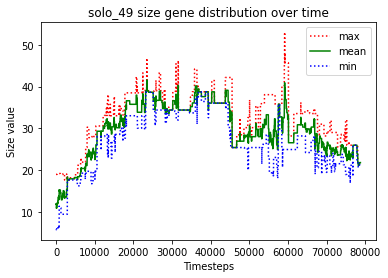

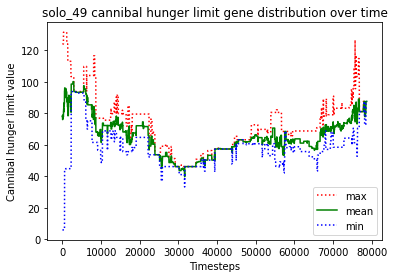

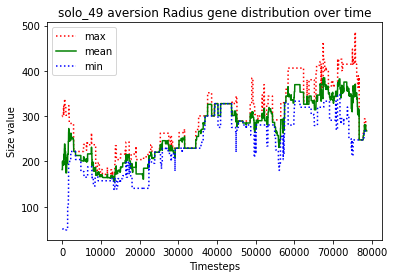

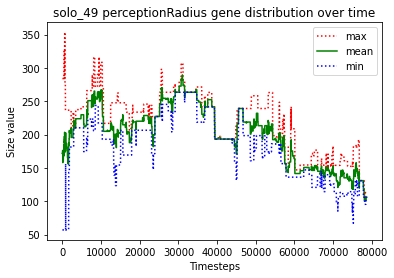

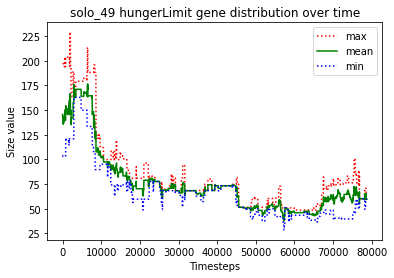





						SOLO_50

predator_1 killed predator_0
predator_5 just gave birth to predator_10
predator_6 just gave birth to predator_11
predator_1 just gave birth to predator_12
predator_12 killed predator_11
predator_8 just gave birth to predator_13
predator_1 killed predator_6
predator_13 just gave birth to predator_14
predator_10 just gave birth to predator_15
predator_14 killed predator_4
predator_15 starved to death
predator_10 ate the carcass of predator_15_carcass
predator_10 starved to death
predator_13 just gave birth to predator_16
predator_16 starved to death
predator_13 ate the carcass of predator_16_carcass
predator_5 ate the carcass of predator_10_carcass
predator_12 just gave birth to predator_17
predator_13 starved to death
predator_8 ate the carcass of predator_13_carcass
predator_17 starved to death
predator_8 ate the carcass of predator_17_carcass
predator_7 killed predator_12
predator_7 killed predator_1
predator_3 starved to death
predator_14 ate the carcass of predato

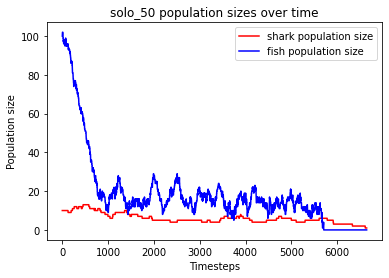

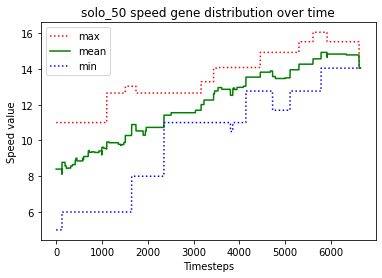

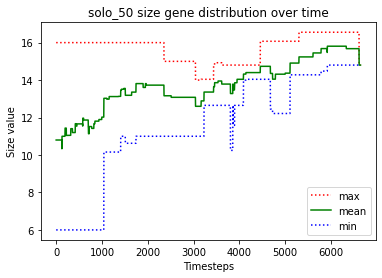

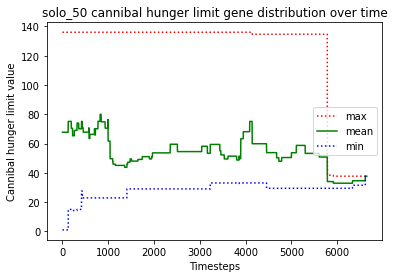

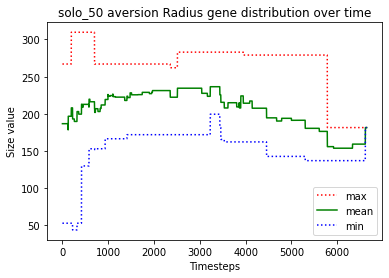

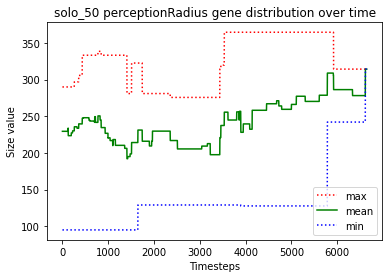

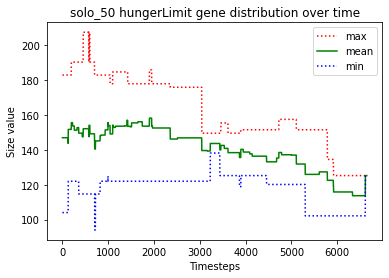





						SOLO_51

predator_8 just gave birth to predator_10
predator_6 just gave birth to predator_11
predator_9 just gave birth to predator_12
predator_5 killed predator_3
predator_5 killed predator_2
predator_12 killed predator_10
predator_5 killed predator_8
predator_9 just gave birth to predator_13
predator_6 just gave birth to predator_14
predator_9 just gave birth to predator_15
predator_15 starved to death
predator_9 ate the carcass of predator_15_carcass
predator_14 just gave birth to predator_16
predator_0 just gave birth to predator_17
predator_14 starved to death
predator_9 starved to death
predator_16 starved to death
predator_6 ate the carcass of predator_14_carcass
predator_12 ate the carcass of predator_9_carcass
predator_11 ate the carcass of predator_16_carcass
predator_13 starved to death
predator_6 ate the carcass of predator_13_carcass
predator_4 just gave birth to predator_18
predator_4 killed predator_12
predator_17 just gave birth to predator_19
predator_4 kille

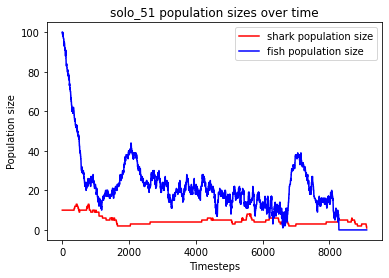

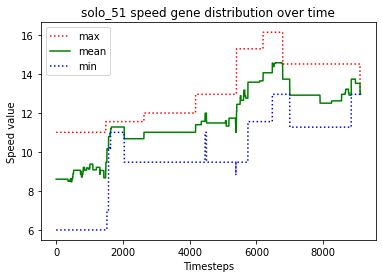

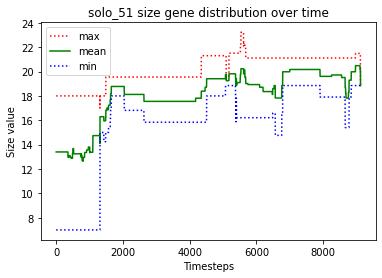

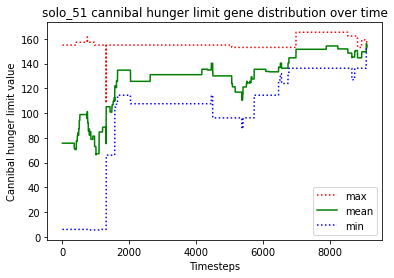

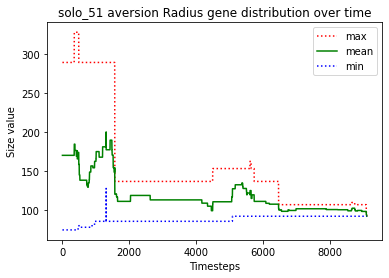

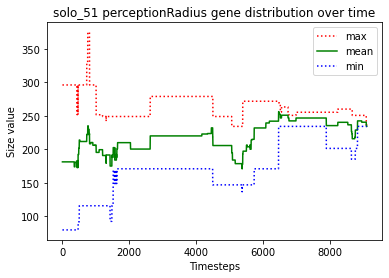

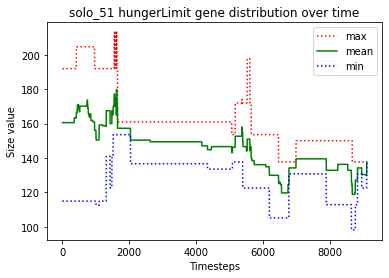





						SOLO_52

predator_9 just gave birth to predator_10
predator_3 just gave birth to predator_11
predator_9 just gave birth to predator_12
predator_12 just gave birth to predator_13
predator_12 starved to death
predator_1 just gave birth to predator_14
predator_13 starved to death
predator_10 ate the carcass of predator_12_carcass
predator_11 just gave birth to predator_15
predator_0 ate the carcass of predator_13_carcass
predator_2 just gave birth to predator_16
predator_10 killed predator_4
predator_9 starved to death
predator_1 ate the carcass of predator_9_carcass
predator_14 just gave birth to predator_17
predator_1 killed predator_10
predator_2 just gave birth to predator_18
predator_11 starved to death
predator_16 ate the carcass of predator_11_carcass
predator_15 starved to death
predator_2 ate the carcass of predator_15_carcass
predator_6 just gave birth to predator_19
predator_3 starved to death
predator_6 ate the carcass of predator_3_carcass
predator_18 starved to dea

predator_63 ate the carcass of predator_54_carcass
predator_64 starved to death
predator_65 ate the carcass of predator_64_carcass
predator_57 just gave birth to predator_67
predator_65 starved to death
predator_63 ate the carcass of predator_65_carcass
predator_67 just gave birth to predator_68
predator_57 starved to death
predator_67 ate the carcass of predator_57_carcass
predator_68 starved to death
predator_67 starved to death
predator_63 ate the carcass of predator_67_carcass
predator_63 ate the carcass of predator_68_carcass
predator_63 starved to death


finished this run because predators went extinct
Fish left: 0
Sharks left: 0
Dead sharks: 69
Timesteps passed: 12937
Fish went extinct at timestep 11682
Sharks went extinct at timestep 12937


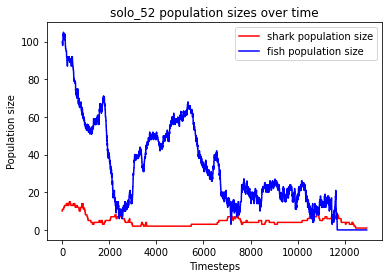

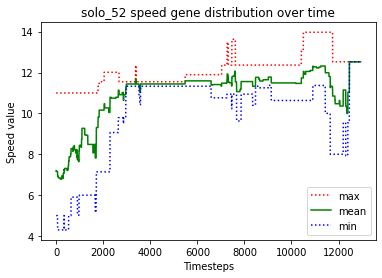

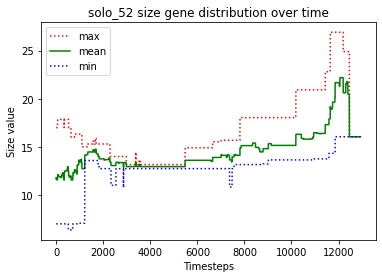

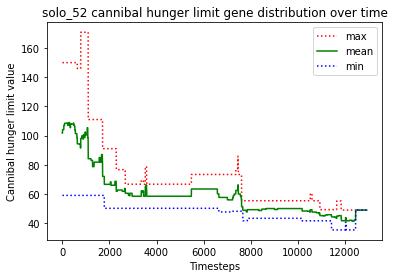

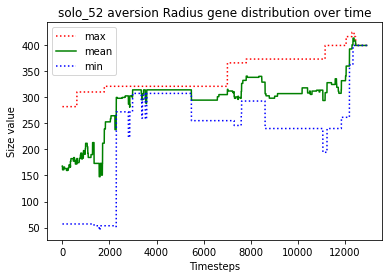

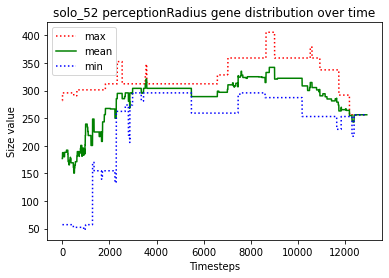

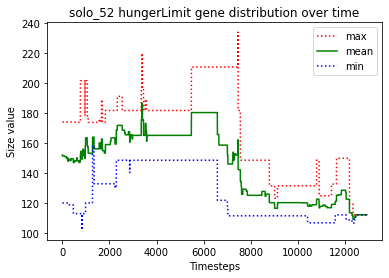





						SOLO_53

predator_0 just gave birth to predator_10
predator_3 just gave birth to predator_11
predator_3 killed predator_7
predator_10 just gave birth to predator_12
predator_3 killed predator_2
predator_0 just gave birth to predator_13
predator_9 just gave birth to predator_14
predator_3 just gave birth to predator_15
predator_3 killed predator_1
predator_4 just gave birth to predator_16
predator_4 just gave birth to predator_17
predator_16 just gave birth to predator_18
predator_3 killed predator_6
predator_10 just gave birth to predator_19
predator_8 just gave birth to predator_20
predator_12 just gave birth to predator_21
predator_0 starved to death
predator_18 just gave birth to predator_22
predator_12 ate the carcass of predator_0_carcass
predator_8 killed predator_4
predator_15 starved to death
predator_8 ate the carcass of predator_15_carcass
predator_18 starved to death
predator_20 killed predator_17
predator_9 ate the carcass of predator_18_carcass
predator_16 starve

predator_59 starved to death
predator_44 ate the carcass of predator_59_carcass
predator_72 starved to death
predator_69 ate the carcass of predator_72_carcass
predator_67 starved to death
predator_50 just gave birth to predator_74
predator_50 just gave birth to predator_75
predator_71 just gave birth to predator_76
predator_76 starved to death
predator_71 starved to death
predator_74 just gave birth to predator_77
predator_69 just gave birth to predator_78
predator_78 ate the carcass of predator_76_carcass
predator_19 ate the carcass of predator_67_carcass
predator_78 ate the carcass of predator_71_carcass
predator_31 just gave birth to predator_79
predator_56 starved to death
predator_77 ate the carcass of predator_56_carcass
predator_50 just gave birth to predator_80
predator_50 just gave birth to predator_81
predator_79 just gave birth to predator_82
predator_44 just gave birth to predator_83
predator_75 just gave birth to predator_84
predator_79 starved to death
predator_82 starve

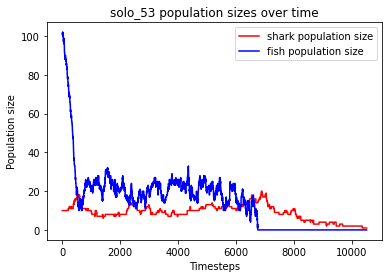

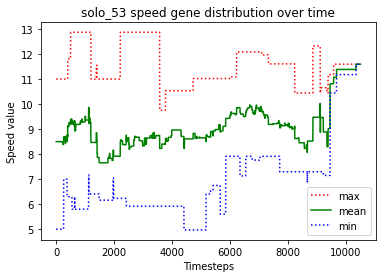

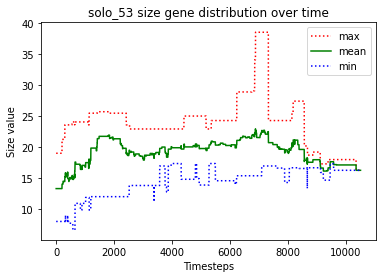

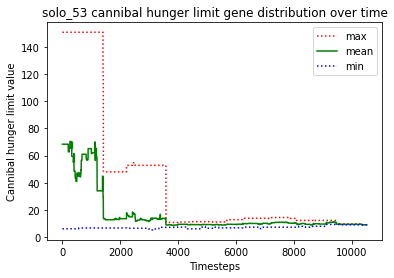

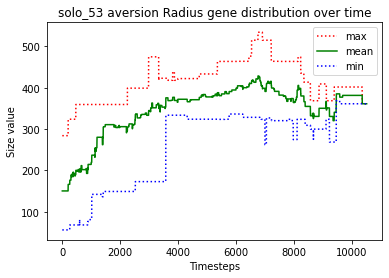

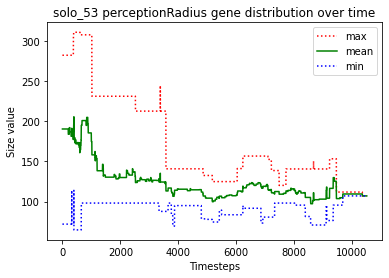

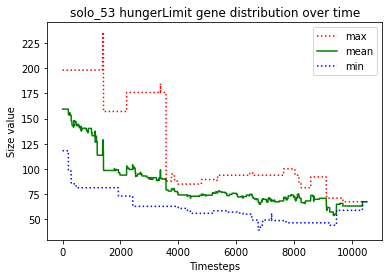





						SOLO_54

predator_5 just gave birth to predator_10
predator_7 just gave birth to predator_11
predator_5 just gave birth to predator_12
predator_11 just gave birth to predator_13
predator_10 just gave birth to predator_14
predator_13 just gave birth to predator_15
predator_9 just gave birth to predator_16
predator_12 starved to death
predator_15 starved to death
predator_13 starved to death
predator_1 ate the carcass of predator_12_carcass
predator_11 ate the carcass of predator_13_carcass
predator_11 ate the carcass of predator_15_carcass
predator_16 just gave birth to predator_17
predator_5 starved to death
predator_7 just gave birth to predator_18
predator_0 ate the carcass of predator_5_carcass
predator_2 just gave birth to predator_19
predator_2 killed predator_19
predator_14 starved to death
predator_11 starved to death
predator_7 starved to death
predator_18 just gave birth to predator_20
predator_10 starved to death
predator_20 ate the carcass of predator_7_carcass
pre

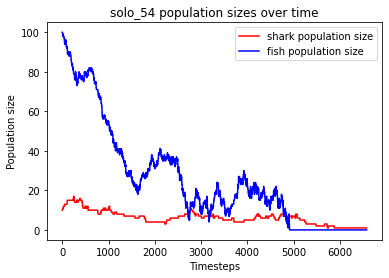

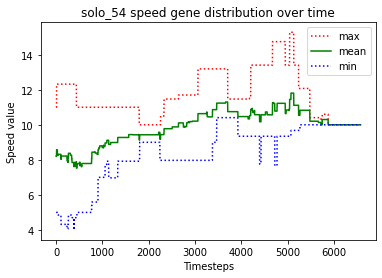

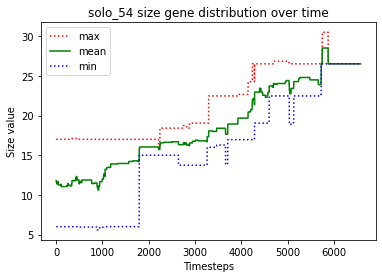

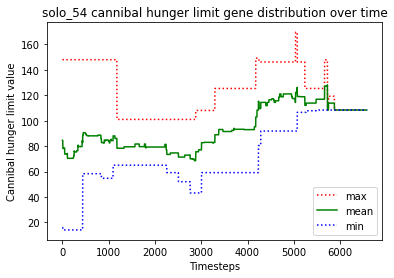

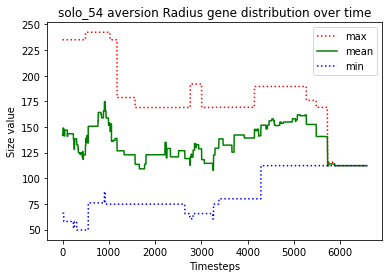

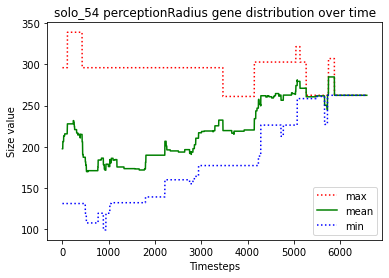

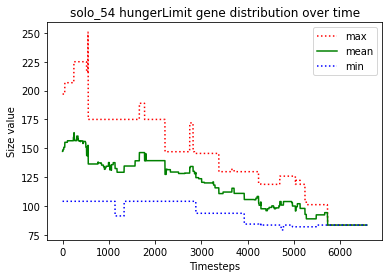





						SOLO_55

predator_7 just gave birth to predator_10
predator_10 just gave birth to predator_11
predator_10 just gave birth to predator_12
predator_12 killed predator_11
predator_12 just gave birth to predator_13
predator_10 starved to death
predator_12 ate the carcass of predator_10_carcass
predator_1 killed predator_3
predator_12 starved to death
predator_0 ate the carcass of predator_12_carcass
predator_5 just gave birth to predator_14
predator_7 just gave birth to predator_15
predator_13 starved to death
predator_7 ate the carcass of predator_13_carcass
predator_8 just gave birth to predator_16
predator_0 just gave birth to predator_17
predator_5 just gave birth to predator_18
predator_15 just gave birth to predator_19
predator_6 just gave birth to predator_20
predator_19 just gave birth to predator_21
predator_21 starved to death
predator_15 ate the carcass of predator_21_carcass
predator_19 starved to death
predator_8 just gave birth to predator_22
predator_15 ate the car

predator_66 just gave birth to predator_71
predator_70 just gave birth to predator_72
predator_69 just gave birth to predator_73
predator_70 just gave birth to predator_74
predator_72 starved to death
predator_74 starved to death
predator_70 starved to death
predator_66 ate the carcass of predator_70_carcass
predator_68 ate the carcass of predator_74_carcass
predator_47 ate the carcass of predator_72_carcass
predator_69 starved to death
predator_66 ate the carcass of predator_69_carcass
predator_68 just gave birth to predator_75
predator_55 just gave birth to predator_76
predator_75 just gave birth to predator_77
predator_71 just gave birth to predator_78
predator_77 starved to death
predator_71 ate the carcass of predator_77_carcass
predator_66 starved to death
predator_76 ate the carcass of predator_66_carcass
predator_75 starved to death
predator_78 ate the carcass of predator_75_carcass
predator_78 just gave birth to predator_79
predator_78 killed predator_79
predator_73 starved to

predator_112 just gave birth to predator_134
predator_60 just gave birth to predator_135
predator_135 killed predator_133
no fish to move
predator_132 starved to death
predator_135 ate the carcass of predator_132_carcass
predator_134 just gave birth to predator_136
predator_60 starved to death
predator_134 ate the carcass of predator_60_carcass
predator_131 starved to death
predator_135 ate the carcass of predator_131_carcass
predator_136 just gave birth to predator_137
predator_137 starved to death
predator_136 starved to death
predator_111 just gave birth to predator_138
predator_113 ate the carcass of predator_136_carcass
predator_134 just gave birth to predator_139
predator_135 ate the carcass of predator_137_carcass
predator_139 starved to death
predator_134 ate the carcass of predator_139_carcass
predator_88 starved to death
predator_112 ate the carcass of predator_88_carcass
predator_111 starved to death
predator_138 starved to death
predator_112 ate the carcass of predator_138_

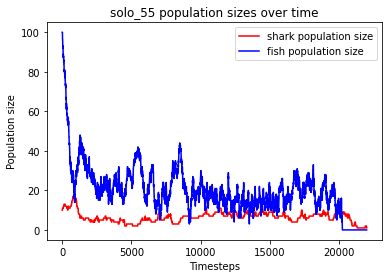

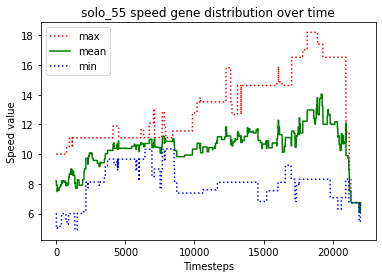

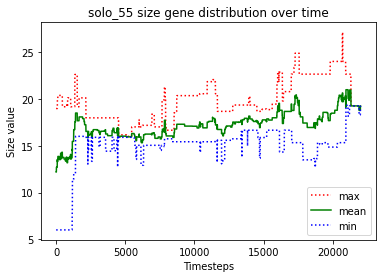

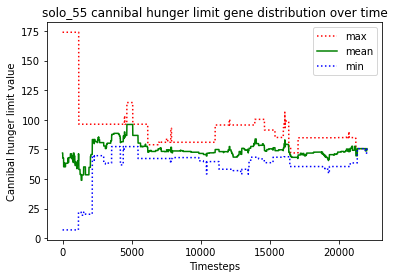

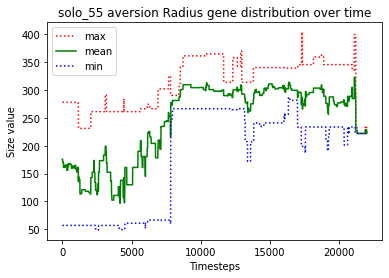

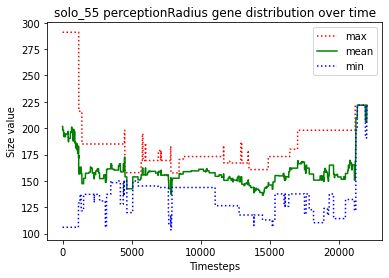

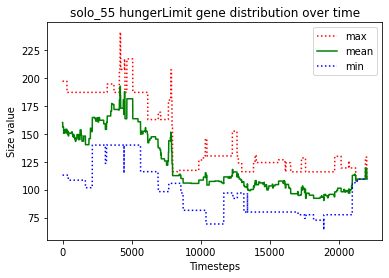





						SOLO_56

predator_8 just gave birth to predator_10
predator_0 just gave birth to predator_11
predator_1 just gave birth to predator_12
predator_4 just gave birth to predator_13
predator_1 killed predator_11
predator_10 just gave birth to predator_14
predator_4 just gave birth to predator_15
predator_8 just gave birth to predator_16
predator_15 killed predator_3
predator_2 just gave birth to predator_17
predator_17 killed predator_0
predator_4 starved to death
predator_1 just gave birth to predator_18
predator_5 ate the carcass of predator_4_carcass
predator_6 just gave birth to predator_19
predator_15 starved to death
predator_7 ate the carcass of predator_15_carcass
predator_9 just gave birth to predator_20
predator_16 just gave birth to predator_21
predator_21 killed predator_17
predator_13 just gave birth to predator_22
predator_13 starved to death
predator_22 starved to death
predator_9 ate the carcass of predator_13_carcass
predator_16 killed predator_19
predator_9 ate t

predator_71 ate the carcass of predator_72_carcass
predator_71 ate the carcass of predator_69_carcass
predator_70 starved to death
predator_53 ate the carcass of predator_70_carcass
predator_41 just gave birth to predator_73
predator_53 just gave birth to predator_74
predator_53 starved to death
predator_74 just gave birth to predator_75
predator_63 just gave birth to predator_76
predator_63 just gave birth to predator_77
predator_74 starved to death
predator_77 ate the carcass of predator_74_carcass
predator_71 ate the carcass of predator_53_carcass
predator_73 starved to death
predator_77 just gave birth to predator_78
predator_71 ate the carcass of predator_73_carcass
predator_71 just gave birth to predator_79
predator_41 just gave birth to predator_80
predator_75 just gave birth to predator_81
predator_71 just gave birth to predator_82
predator_41 just gave birth to predator_83
predator_81 just gave birth to predator_84
predator_83 just gave birth to predator_85
predator_85 killed 

predator_129 ate the carcass of predator_131_carcass
predator_132 just gave birth to predator_133
predator_129 just gave birth to predator_134
predator_129 just gave birth to predator_135
predator_100 just gave birth to predator_136
predator_133 starved to death
predator_132 just gave birth to predator_137
predator_128 ate the carcass of predator_133_carcass
predator_137 starved to death
predator_132 starved to death
predator_134 ate the carcass of predator_137_carcass
predator_129 ate the carcass of predator_132_carcass
predator_128 just gave birth to predator_138
predator_128 killed predator_129
predator_136 just gave birth to predator_139
predator_138 just gave birth to predator_140
predator_140 starved to death
predator_138 starved to death
predator_134 ate the carcass of predator_138_carcass
predator_136 starved to death
predator_135 ate the carcass of predator_136_carcass
predator_134 ate the carcass of predator_140_carcass
predator_139 starved to death
predator_134 ate the carca

predator_193 starved to death
predator_194 ate the carcass of predator_193_carcass
predator_191 starved to death
predator_194 just gave birth to predator_195
predator_149 ate the carcass of predator_191_carcass
predator_189 just gave birth to predator_196
predator_196 just gave birth to predator_197
predator_194 just gave birth to predator_198
predator_197 starved to death
predator_196 starved to death
predator_149 ate the carcass of predator_197_carcass
predator_189 starved to death
predator_194 ate the carcass of predator_196_carcass
predator_198 just gave birth to predator_199
predator_199 starved to death
predator_164 ate the carcass of predator_199_carcass
predator_195 ate the carcass of predator_189_carcass
predator_198 just gave birth to predator_200
predator_200 starved to death
predator_198 starved to death
predator_149 ate the carcass of predator_198_carcass
predator_149 ate the carcass of predator_200_carcass
predator_195 starved to death
predator_194 ate the carcass of pred

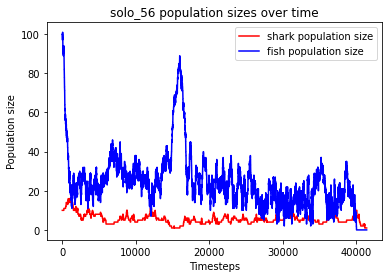

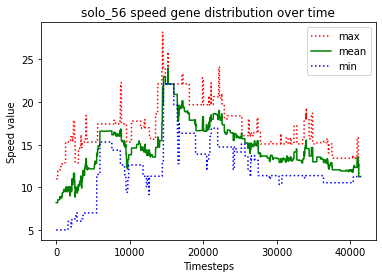

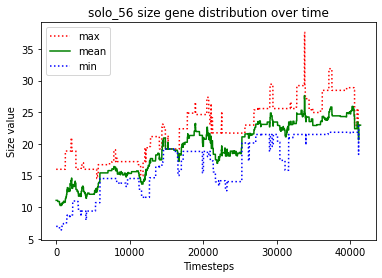

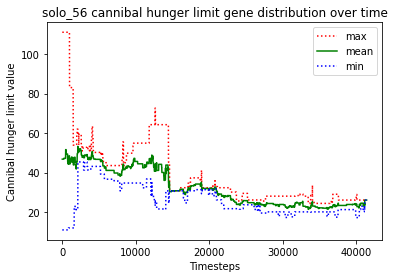

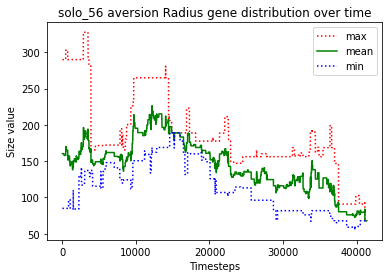

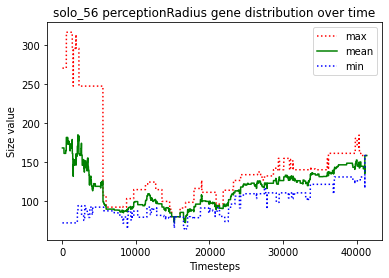

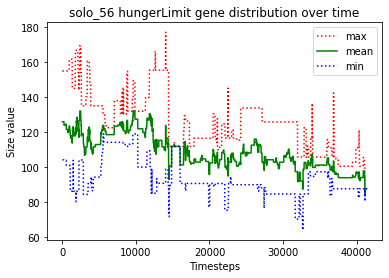





						SOLO_57

predator_2 just gave birth to predator_10
predator_10 just gave birth to predator_11
predator_10 killed predator_11
predator_9 just gave birth to predator_12
predator_2 just gave birth to predator_13
predator_10 starved to death
predator_12 ate the carcass of predator_10_carcass
predator_1 just gave birth to predator_14
predator_2 starved to death
predator_7 just gave birth to predator_15
predator_0 ate the carcass of predator_2_carcass
predator_0 just gave birth to predator_16
predator_1 starved to death
predator_13 starved to death
predator_4 just gave birth to predator_17
predator_0 ate the carcass of predator_13_carcass
predator_5 ate the carcass of predator_1_carcass
predator_15 just gave birth to predator_18
predator_12 just gave birth to predator_19
predator_5 just gave birth to predator_20
predator_15 just gave birth to predator_21
predator_18 just gave birth to predator_22
predator_14 starved to death
predator_19 starved to death
predator_12 ate the carcass 

predator_72 starved to death
predator_66 starved to death
predator_74 ate the carcass of predator_72_carcass
predator_76 ate the carcass of predator_66_carcass
predator_37 just gave birth to predator_77
predator_32 just gave birth to predator_78
predator_73 just gave birth to predator_79
predator_52 just gave birth to predator_80
predator_46 just gave birth to predator_81
predator_76 just gave birth to predator_82
predator_78 just gave birth to predator_83
predator_79 just gave birth to predator_84
predator_79 killed predator_84
predator_73 killed predator_74
predator_62 just gave birth to predator_85
predator_18 starved to death
predator_77 starved to death
predator_65 ate the carcass of predator_18_carcass
predator_79 ate the carcass of predator_77_carcass
predator_52 starved to death
predator_82 ate the carcass of predator_52_carcass
predator_37 just gave birth to predator_86
predator_86 starved to death
predator_37 starved to death
predator_73 just gave birth to predator_87
no fish

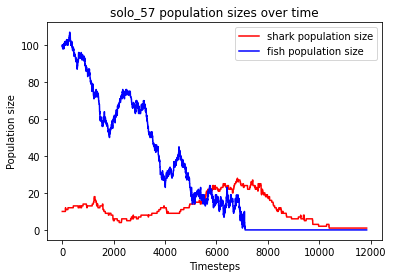

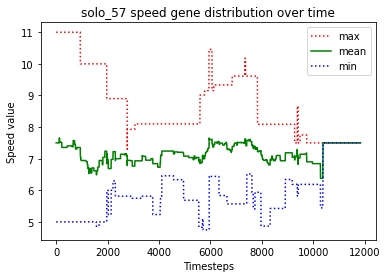

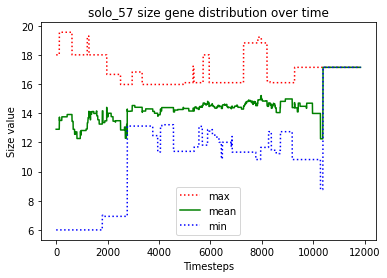

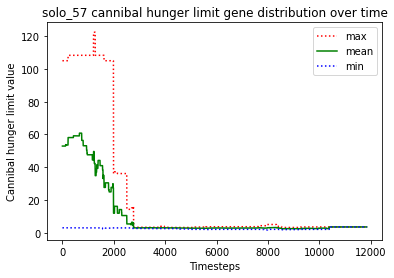

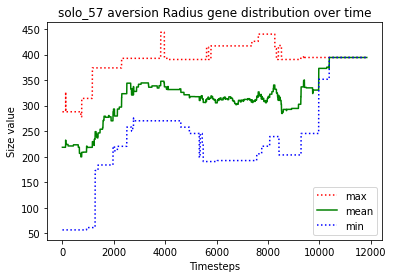

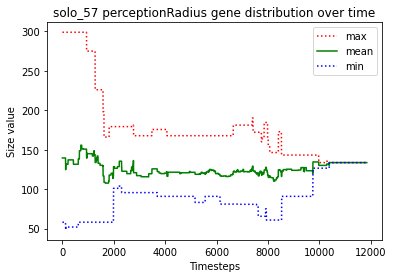

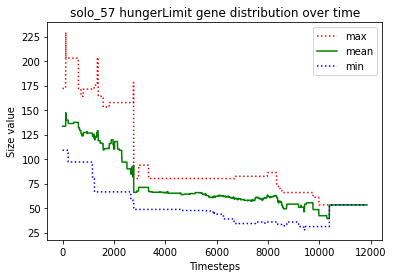





						SOLO_58

predator_9 just gave birth to predator_10
predator_0 just gave birth to predator_11
predator_0 just gave birth to predator_12
predator_9 just gave birth to predator_13
predator_4 just gave birth to predator_14
predator_11 just gave birth to predator_15
predator_4 just gave birth to predator_16
predator_12 just gave birth to predator_17
predator_17 killed predator_13
predator_5 just gave birth to predator_18
predator_9 starved to death
predator_1 just gave birth to predator_19
predator_12 killed predator_14
predator_15 killed predator_10
predator_5 just gave birth to predator_20
predator_6 ate the carcass of predator_9_carcass
predator_4 starved to death
predator_12 ate the carcass of predator_4_carcass
predator_7 just gave birth to predator_21
predator_12 killed predator_6
predator_8 just gave birth to predator_22
predator_2 just gave birth to predator_23
predator_22 just gave birth to predator_24
predator_15 just gave birth to predator_25
predator_5 starved to death

predator_61 ate the carcass of predator_71_carcass
predator_61 just gave birth to predator_73
predator_61 starved to death
predator_58 ate the carcass of predator_61_carcass
predator_70 just gave birth to predator_74
predator_70 starved to death
predator_74 starved to death
predator_73 ate the carcass of predator_74_carcass
predator_50 ate the carcass of predator_70_carcass
predator_67 starved to death
predator_73 ate the carcass of predator_67_carcass
predator_73 just gave birth to predator_75
predator_75 killed predator_59
predator_73 just gave birth to predator_76
predator_75 killed predator_76
predator_58 just gave birth to predator_77
predator_75 just gave birth to predator_78
predator_78 starved to death
predator_77 ate the carcass of predator_78_carcass
predator_75 starved to death
predator_73 ate the carcass of predator_75_carcass
predator_77 just gave birth to predator_79
predator_77 just gave birth to predator_80
predator_77 starved to death
predator_50 just gave birth to pre

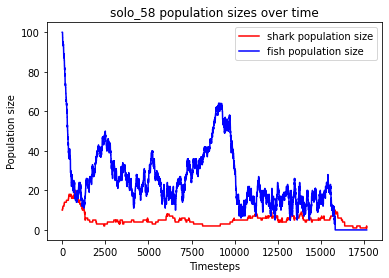

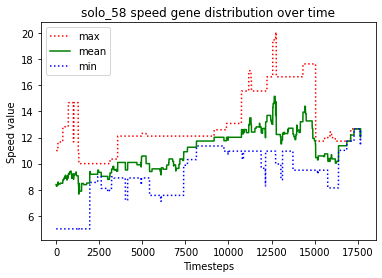

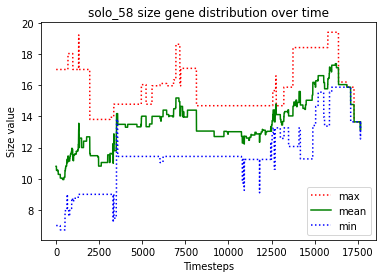

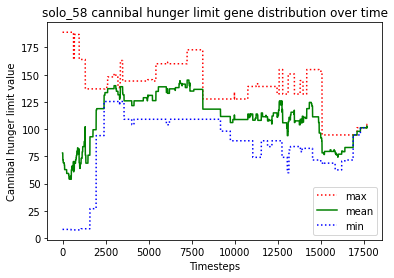

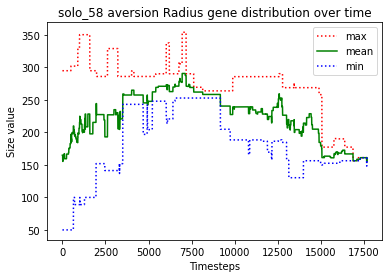

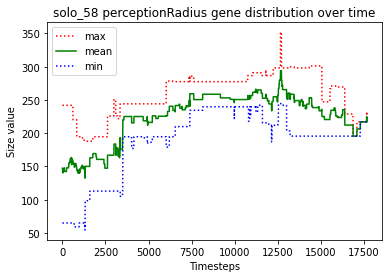

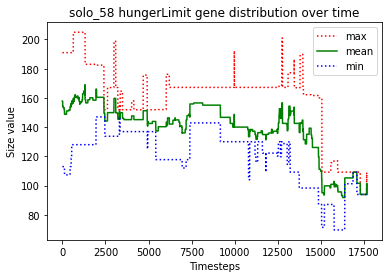





						SOLO_59

predator_2 just gave birth to predator_10
predator_3 just gave birth to predator_11
predator_11 just gave birth to predator_12
predator_9 just gave birth to predator_13
predator_6 just gave birth to predator_14
predator_9 just gave birth to predator_15
predator_2 just gave birth to predator_16
predator_11 starved to death
predator_5 ate the carcass of predator_11_carcass
predator_0 just gave birth to predator_17
predator_9 starved to death
predator_17 just gave birth to predator_18
predator_13 ate the carcass of predator_9_carcass
predator_16 just gave birth to predator_19
predator_12 starved to death
predator_16 starved to death
predator_5 ate the carcass of predator_12_carcass
predator_19 starved to death
predator_2 ate the carcass of predator_16_carcass
predator_2 ate the carcass of predator_19_carcass
predator_2 just gave birth to predator_20
predator_3 starved to death
predator_10 ate the carcass of predator_3_carcass
predator_17 starved to death
predator_15 sta

predator_63 starved to death
predator_28 ate the carcass of predator_63_carcass
predator_65 starved to death
predator_39 ate the carcass of predator_65_carcass
predator_60 just gave birth to predator_69
predator_60 just gave birth to predator_70
predator_62 starved to death
predator_28 just gave birth to predator_71
predator_55 ate the carcass of predator_62_carcass
predator_70 starved to death
predator_60 ate the carcass of predator_70_carcass
predator_71 just gave birth to predator_72
predator_64 just gave birth to predator_73
predator_73 just gave birth to predator_74
predator_72 starved to death
predator_60 ate the carcass of predator_72_carcass
predator_60 just gave birth to predator_75
predator_60 just gave birth to predator_76
predator_60 starved to death
predator_76 starved to death
predator_39 ate the carcass of predator_76_carcass
predator_28 ate the carcass of predator_60_carcass
predator_71 starved to death
predator_28 just gave birth to predator_77
predator_39 ate the carc

predator_114 ate the carcass of predator_109_carcass
predator_114 just gave birth to predator_122
predator_122 just gave birth to predator_123
predator_81 starved to death
predator_96 ate the carcass of predator_81_carcass
predator_96 just gave birth to predator_124
predator_123 starved to death
predator_96 ate the carcass of predator_123_carcass
predator_122 starved to death
predator_114 starved to death
predator_124 starved to death
predator_96 ate the carcass of predator_122_carcass
predator_96 just gave birth to predator_125
predator_125 starved to death
predator_96 starved to death


finished this run because predators went extinct
Fish left: 0
Sharks left: 0
Dead sharks: 126
Timesteps passed: 12457
Fish went extinct at timestep 9747
Sharks went extinct at timestep 12457


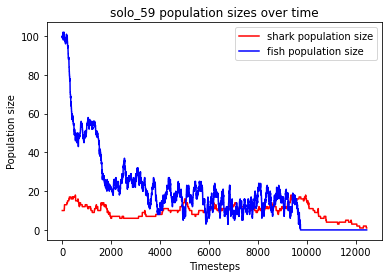

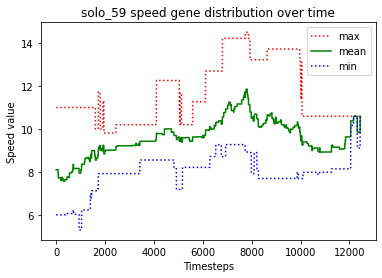

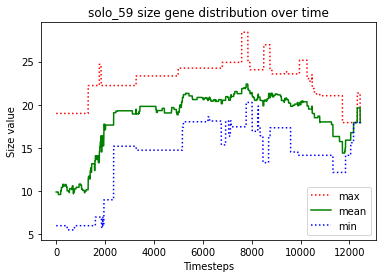

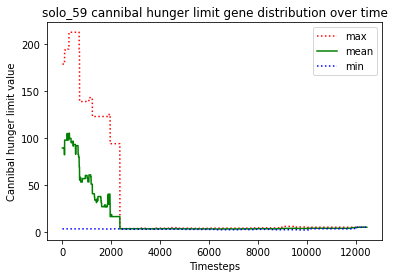

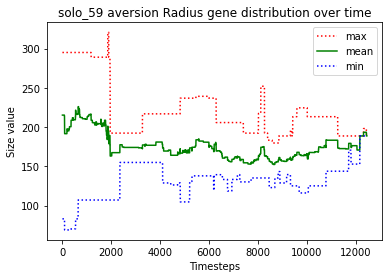

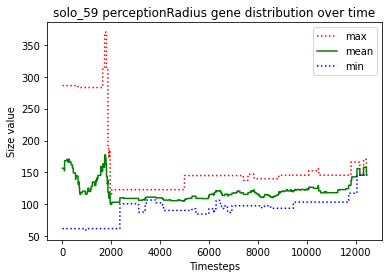

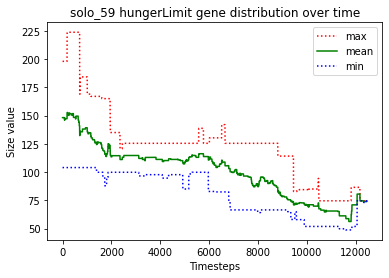





						SOLO_60

predator_1 just gave birth to predator_10
predator_9 just gave birth to predator_11
predator_11 killed predator_6
predator_10 just gave birth to predator_12
predator_0 just gave birth to predator_13
predator_8 just gave birth to predator_14
predator_13 killed predator_2
predator_3 just gave birth to predator_15
predator_10 starved to death
predator_3 just gave birth to predator_16
predator_12 starved to death
predator_11 ate the carcass of predator_12_carcass
predator_13 ate the carcass of predator_10_carcass
predator_0 killed predator_9
predator_0 killed predator_7
predator_13 killed predator_1
predator_8 just gave birth to predator_17
predator_14 starved to death
predator_17 ate the carcass of predator_14_carcass
predator_8 starved to death
predator_13 just gave birth to predator_18
predator_17 starved to death
predator_5 ate the carcass of predator_8_carcass
predator_18 just gave birth to predator_19
predator_0 just gave birth to predator_20
predator_16 starved to

predator_62 starved to death
predator_71 ate the carcass of predator_62_carcass
predator_67 killed predator_72
predator_63 just gave birth to predator_74
predator_63 starved to death
predator_67 ate the carcass of predator_63_carcass
predator_74 starved to death
predator_70 ate the carcass of predator_74_carcass
predator_70 just gave birth to predator_75
predator_64 starved to death
predator_49 ate the carcass of predator_64_carcass
predator_49 just gave birth to predator_76
predator_71 starved to death
predator_49 killed predator_73
predator_67 ate the carcass of predator_71_carcass
predator_67 just gave birth to predator_77
predator_49 killed predator_75
predator_76 just gave birth to predator_78
predator_49 killed predator_76
predator_78 just gave birth to predator_79
predator_77 killed predator_78
predator_77 starved to death
predator_70 ate the carcass of predator_77_carcass
predator_79 just gave birth to predator_80
predator_79 just gave birth to predator_81
predator_49 starved t

predator_136 starved to death
predator_131 ate the carcass of predator_136_carcass
predator_140 starved to death
predator_133 ate the carcass of predator_140_carcass
predator_101 starved to death
predator_133 ate the carcass of predator_101_carcass
predator_137 just gave birth to predator_141
predator_141 just gave birth to predator_142
predator_141 starved to death
predator_118 ate the carcass of predator_141_carcass
predator_106 just gave birth to predator_143
predator_116 starved to death
predator_142 ate the carcass of predator_116_carcass
predator_137 just gave birth to predator_144
predator_144 starved to death
predator_133 just gave birth to predator_145
predator_118 ate the carcass of predator_144_carcass
predator_142 just gave birth to predator_146
predator_145 starved to death
predator_143 ate the carcass of predator_145_carcass
predator_137 killed predator_146
predator_138 just gave birth to predator_147
predator_137 starved to death
predator_138 ate the carcass of predator_

predator_199 starved to death
predator_197 ate the carcass of predator_199_carcass
predator_180 ate the carcass of predator_196_carcass
predator_191 just gave birth to predator_200
predator_131 starved to death
predator_181 just gave birth to predator_201
predator_201 starved to death
predator_187 ate the carcass of predator_201_carcass
predator_191 ate the carcass of predator_131_carcass
predator_189 starved to death
predator_198 ate the carcass of predator_189_carcass
predator_181 starved to death
predator_198 ate the carcass of predator_181_carcass
predator_188 just gave birth to predator_202
predator_180 killed predator_198
predator_202 just gave birth to predator_203
predator_191 just gave birth to predator_204
predator_204 just gave birth to predator_205
predator_197 just gave birth to predator_206
predator_188 starved to death
predator_203 starved to death
predator_180 ate the carcass of predator_188_carcass
predator_200 just gave birth to predator_207
predator_197 just gave bir

predator_249 just gave birth to predator_256
predator_242 just gave birth to predator_257
predator_241 just gave birth to predator_258
predator_241 just gave birth to predator_259
predator_241 killed predator_235
predator_242 just gave birth to predator_260
predator_206 just gave birth to predator_261
predator_206 starved to death
predator_242 ate the carcass of predator_206_carcass
predator_261 starved to death
predator_259 starved to death
predator_257 starved to death
predator_260 ate the carcass of predator_261_carcass
predator_256 ate the carcass of predator_259_carcass
predator_255 just gave birth to predator_262
predator_249 starved to death
predator_248 ate the carcass of predator_249_carcass
predator_248 just gave birth to predator_263
predator_242 just gave birth to predator_264
predator_264 just gave birth to predator_265
predator_242 killed predator_265
predator_241 ate the carcass of predator_257_carcass
predator_264 starved to death
predator_242 ate the carcass of predato

predator_313 ate the carcass of predator_294_carcass
predator_313 just gave birth to predator_314
predator_287 starved to death
predator_314 just gave birth to predator_315
predator_291 ate the carcass of predator_300_carcass
predator_315 ate the carcass of predator_287_carcass
predator_315 just gave birth to predator_316
predator_315 just gave birth to predator_317
predator_315 starved to death
predator_317 ate the carcass of predator_315_carcass
predator_316 starved to death
predator_305 just gave birth to predator_318
predator_288 ate the carcass of predator_316_carcass
predator_305 starved to death
predator_318 starved to death
predator_313 ate the carcass of predator_318_carcass
predator_314 just gave birth to predator_319
predator_288 just gave birth to predator_320
predator_320 ate the carcass of predator_305_carcass
predator_317 just gave birth to predator_321
predator_288 just gave birth to predator_322
predator_322 starved to death
predator_314 ate the carcass of predator_322

predator_340 ate the carcass of predator_373_carcass
predator_372 just gave birth to predator_374
predator_343 ate the carcass of predator_369_carcass
predator_372 starved to death
predator_370 ate the carcass of predator_372_carcass
predator_370 just gave birth to predator_375
predator_355 just gave birth to predator_376
predator_347 just gave birth to predator_377
predator_343 just gave birth to predator_378
predator_378 killed predator_340
predator_355 just gave birth to predator_379
predator_377 starved to death
predator_347 ate the carcass of predator_377_carcass
predator_343 starved to death
predator_356 starved to death
predator_371 ate the carcass of predator_356_carcass
predator_370 just gave birth to predator_380
predator_355 ate the carcass of predator_343_carcass
predator_379 starved to death
predator_380 ate the carcass of predator_379_carcass
predator_374 starved to death
predator_370 ate the carcass of predator_374_carcass
predator_378 starved to death
predator_355 ate t

predator_425 starved to death
predator_427 starved to death
predator_389 just gave birth to predator_429
predator_424 ate the carcass of predator_427_carcass
predator_424 ate the carcass of predator_425_carcass
predator_424 just gave birth to predator_430
predator_389 just gave birth to predator_431
predator_430 just gave birth to predator_432
predator_430 just gave birth to predator_433
predator_432 starved to death
predator_389 just gave birth to predator_434
predator_389 just gave birth to predator_435
predator_434 killed predator_435
predator_434 ate the carcass of predator_432_carcass
predator_389 starved to death
predator_430 ate the carcass of predator_389_carcass
predator_424 starved to death
predator_433 ate the carcass of predator_424_carcass
predator_431 just gave birth to predator_436
predator_436 starved to death
predator_431 ate the carcass of predator_436_carcass
predator_431 just gave birth to predator_437
predator_429 starved to death
predator_433 ate the carcass of pr

predator_473 just gave birth to predator_493
predator_490 just gave birth to predator_494
predator_493 just gave birth to predator_495
no fish to move
predator_490 killed predator_495
predator_494 starved to death
predator_490 ate the carcass of predator_494_carcass
predator_486 just gave birth to predator_496
predator_493 starved to death
predator_490 ate the carcass of predator_493_carcass
predator_467 just gave birth to predator_497
predator_473 killed predator_496
predator_487 starved to death
predator_473 ate the carcass of predator_487_carcass
predator_467 just gave birth to predator_498
predator_449 just gave birth to predator_499
predator_499 starved to death
predator_449 ate the carcass of predator_499_carcass
predator_467 starved to death
predator_498 starved to death
predator_449 ate the carcass of predator_467_carcass
predator_491 starved to death
predator_497 starved to death
predator_486 starved to death
predator_480 ate the carcass of predator_491_carcass
predator_449 at

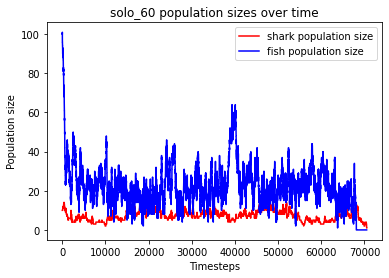

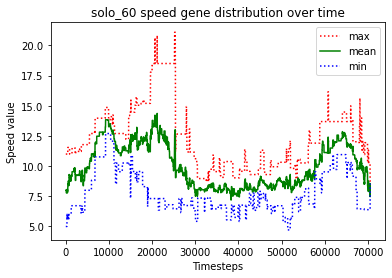

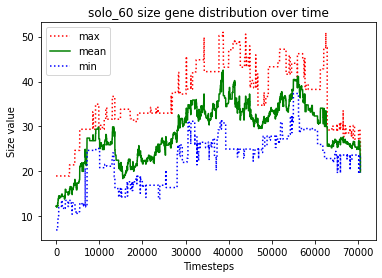

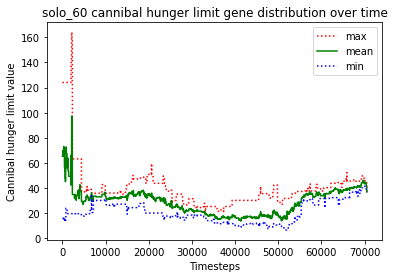

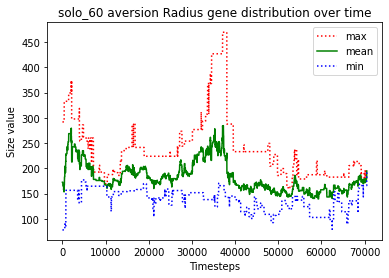

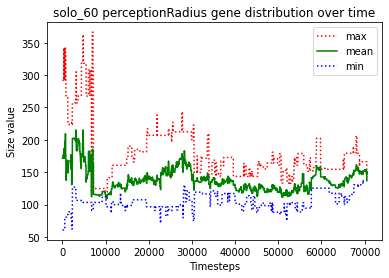

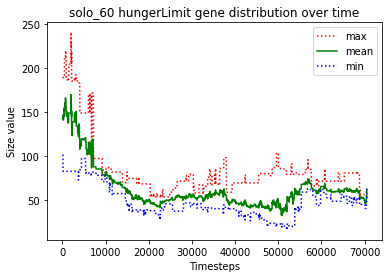





						SOLO_61

predator_0 just gave birth to predator_10
predator_6 just gave birth to predator_11
predator_11 just gave birth to predator_12
predator_11 killed predator_4
predator_8 just gave birth to predator_13
predator_0 just gave birth to predator_14
predator_12 killed predator_13
predator_14 just gave birth to predator_15
predator_14 starved to death
predator_15 starved to death
predator_1 ate the carcass of predator_15_carcass
predator_5 ate the carcass of predator_14_carcass
predator_11 just gave birth to predator_16
predator_0 starved to death
predator_3 just gave birth to predator_17
predator_17 ate the carcass of predator_0_carcass
predator_3 just gave birth to predator_18
predator_8 just gave birth to predator_19
predator_8 killed predator_2
predator_11 starved to death
predator_16 starved to death
predator_19 ate the carcass of predator_11_carcass
predator_12 killed predator_1
predator_6 just gave birth to predator_20
predator_17 ate the carcass of predator_16_carcass


predator_68 just gave birth to predator_70
predator_70 just gave birth to predator_71
predator_71 killed predator_66
predator_70 just gave birth to predator_72
predator_70 killed predator_72
predator_71 killed predator_68
predator_71 starved to death
predator_64 ate the carcass of predator_71_carcass
predator_64 just gave birth to predator_73
predator_73 just gave birth to predator_74
predator_73 starved to death
predator_70 ate the carcass of predator_73_carcass
predator_70 just gave birth to predator_75
predator_75 just gave birth to predator_76
predator_70 starved to death
predator_64 ate the carcass of predator_70_carcass
predator_75 starved to death
predator_76 starved to death
predator_74 ate the carcass of predator_76_carcass
predator_64 just gave birth to predator_77
predator_77 ate the carcass of predator_75_carcass
predator_77 just gave birth to predator_78
predator_64 just gave birth to predator_79
predator_79 starved to death
predator_74 ate the carcass of predator_79_carca

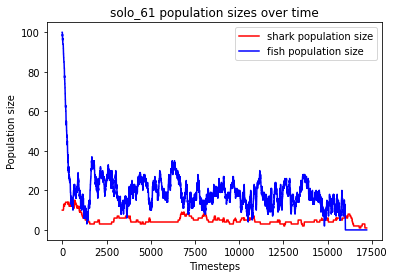

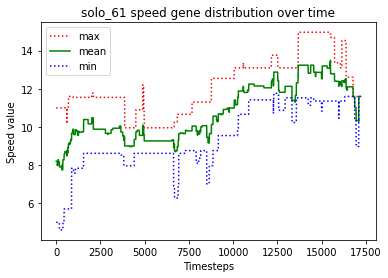

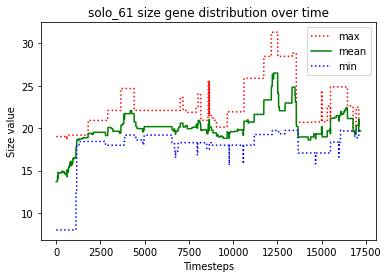

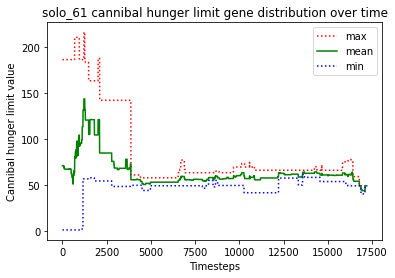

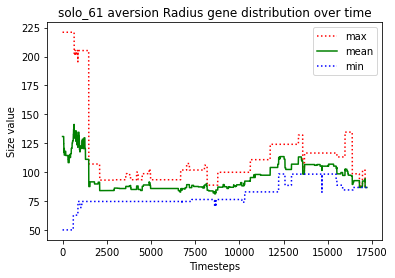

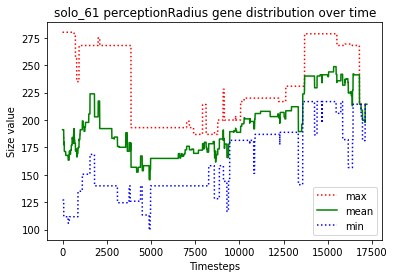

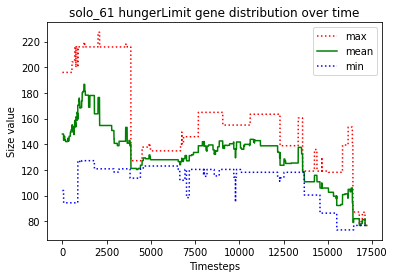





						SOLO_62

predator_2 just gave birth to predator_10
predator_3 just gave birth to predator_11
predator_0 just gave birth to predator_12
predator_5 just gave birth to predator_13
predator_3 just gave birth to predator_14
predator_11 just gave birth to predator_15
predator_14 starved to death
predator_0 just gave birth to predator_16
predator_1 ate the carcass of predator_14_carcass
predator_10 starved to death
predator_3 starved to death
predator_12 ate the carcass of predator_3_carcass
predator_11 starved to death
predator_15 starved to death
predator_4 ate the carcass of predator_15_carcass
predator_13 ate the carcass of predator_10_carcass
predator_4 just gave birth to predator_17
predator_4 ate the carcass of predator_11_carcass
predator_0 killed predator_7
predator_16 starved to death
predator_17 ate the carcass of predator_16_carcass
predator_12 just gave birth to predator_18
predator_0 killed predator_9
predator_2 starved to death
predator_4 ate the carcass of predator_2

predator_67 ate the carcass of predator_62_carcass
predator_66 starved to death
predator_67 ate the carcass of predator_66_carcass
predator_67 just gave birth to predator_69
predator_68 just gave birth to predator_70
predator_70 starved to death
predator_49 ate the carcass of predator_70_carcass
predator_68 just gave birth to predator_71
predator_71 just gave birth to predator_72
predator_72 starved to death
predator_68 starved to death
predator_49 ate the carcass of predator_68_carcass
predator_71 starved to death
predator_69 ate the carcass of predator_71_carcass
predator_69 ate the carcass of predator_72_carcass
predator_49 just gave birth to predator_73
predator_67 starved to death
predator_69 ate the carcass of predator_67_carcass
predator_73 starved to death
predator_69 ate the carcass of predator_73_carcass
predator_49 just gave birth to predator_74
predator_74 just gave birth to predator_75
predator_74 killed predator_75
predator_69 starved to death
predator_74 ate the carcass 

predator_116 ate the carcass of predator_127_carcass
predator_117 starved to death
predator_98 ate the carcass of predator_117_carcass
predator_116 just gave birth to predator_128
predator_116 just gave birth to predator_129
predator_116 starved to death
predator_129 starved to death
predator_126 ate the carcass of predator_116_carcass
predator_126 ate the carcass of predator_129_carcass
predator_128 just gave birth to predator_130
predator_130 starved to death
predator_128 ate the carcass of predator_130_carcass
predator_98 starved to death
predator_128 ate the carcass of predator_98_carcass
predator_126 just gave birth to predator_131
predator_131 just gave birth to predator_132
predator_132 just gave birth to predator_133
predator_133 starved to death
predator_132 ate the carcass of predator_133_carcass
predator_126 just gave birth to predator_134
predator_131 just gave birth to predator_135
predator_128 just gave birth to predator_136
predator_134 just gave birth to predator_137
pr

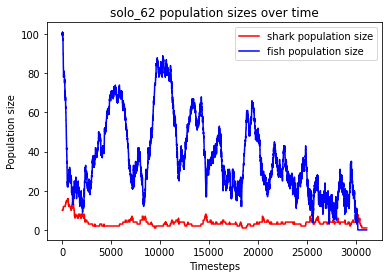

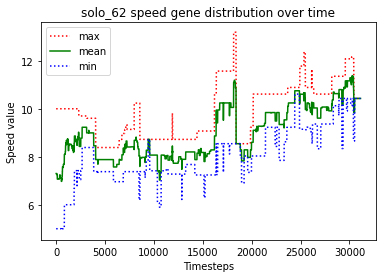

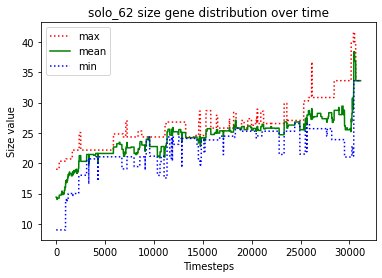

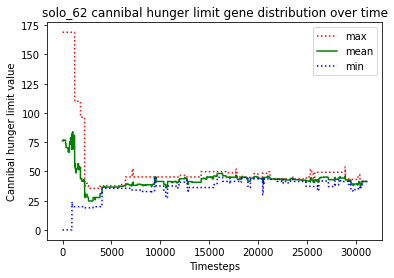

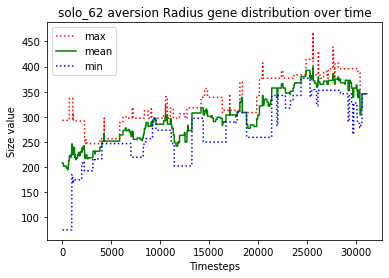

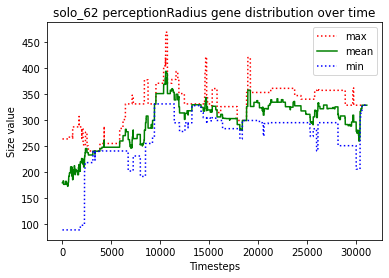

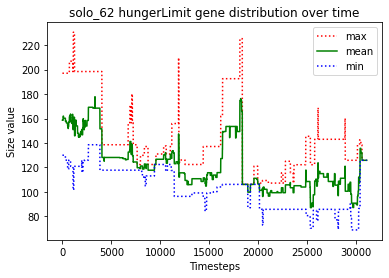





						SOLO_63

predator_1 just gave birth to predator_10
predator_5 just gave birth to predator_11
predator_10 just gave birth to predator_12
predator_9 just gave birth to predator_13
predator_9 just gave birth to predator_14
predator_13 killed predator_6
predator_9 killed predator_3
predator_9 killed predator_4
predator_13 killed predator_11
predator_9 killed predator_8
predator_12 starved to death
predator_9 killed predator_0
predator_7 just gave birth to predator_15
predator_10 starved to death
predator_7 just gave birth to predator_16
predator_9 killed predator_7
predator_9 killed predator_16
predator_9 killed predator_15
predator_14 ate the carcass of predator_12_carcass
predator_2 ate the carcass of predator_10_carcass
predator_1 just gave birth to predator_17
predator_17 starved to death
predator_1 ate the carcass of predator_17_carcass
predator_9 killed predator_1
predator_5 starved to death
predator_2 ate the carcass of predator_5_carcass
predator_13 just gave birth to pre

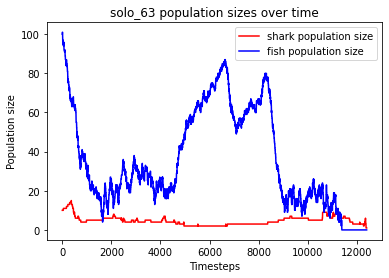

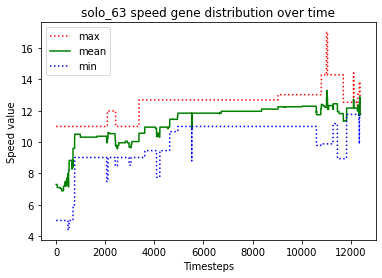

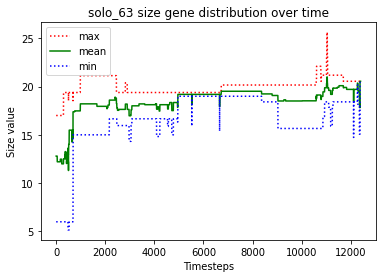

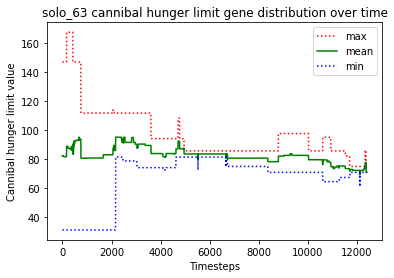

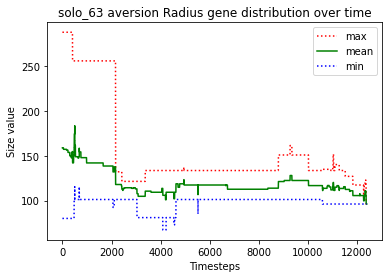

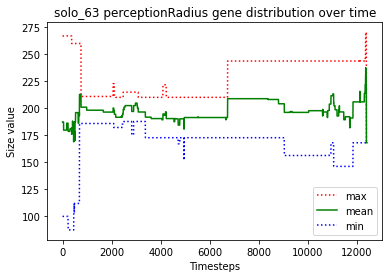

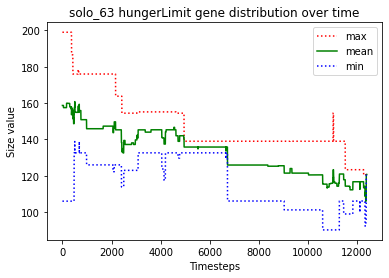





						SOLO_64

predator_1 just gave birth to predator_10
predator_3 just gave birth to predator_11
predator_1 killed predator_0
predator_10 killed predator_7
predator_10 killed predator_4
predator_10 killed predator_6
predator_1 killed predator_11
predator_3 starved to death
predator_1 ate the carcass of predator_3_carcass
predator_8 just gave birth to predator_12
predator_8 killed predator_12
predator_8 just gave birth to predator_13
predator_2 just gave birth to predator_14
predator_8 just gave birth to predator_15
predator_8 starved to death
predator_15 starved to death
predator_13 starved to death
predator_10 ate the carcass of predator_8_carcass
predator_2 ate the carcass of predator_13_carcass
predator_5 ate the carcass of predator_15_carcass
predator_14 just gave birth to predator_16
predator_16 starved to death
predator_14 ate the carcass of predator_16_carcass
predator_14 starved to death
predator_10 ate the carcass of predator_14_carcass
predator_1 just gave birth to pred

predator_40 ate the carcass of predator_49_carcass
predator_65 starved to death
predator_73 ate the carcass of predator_65_carcass
predator_61 starved to death
predator_72 ate the carcass of predator_61_carcass
predator_67 starved to death
predator_70 ate the carcass of predator_67_carcass
predator_73 just gave birth to predator_74
predator_74 just gave birth to predator_75
predator_75 starved to death
predator_74 just gave birth to predator_76
predator_74 ate the carcass of predator_75_carcass
predator_76 starved to death
predator_73 starved to death
predator_74 ate the carcass of predator_76_carcass
predator_40 just gave birth to predator_77
predator_72 ate the carcass of predator_73_carcass
predator_77 just gave birth to predator_78
predator_77 killed predator_78
predator_70 just gave birth to predator_79
predator_70 just gave birth to predator_80
predator_77 just gave birth to predator_81
predator_40 just gave birth to predator_82
predator_70 starved to death
predator_71 starved to

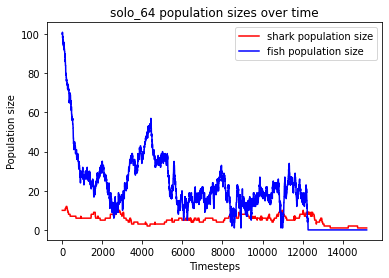

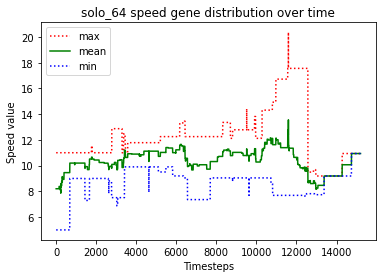

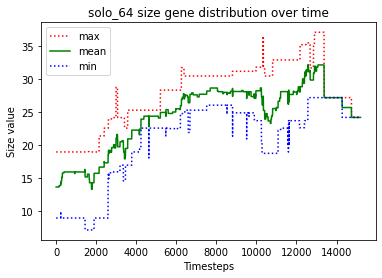

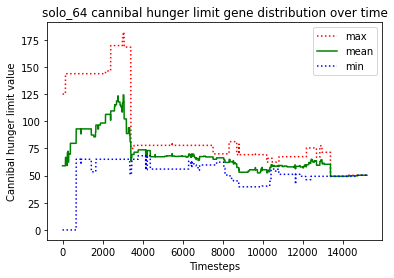

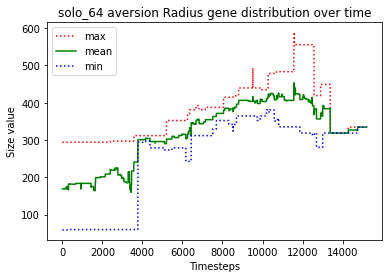

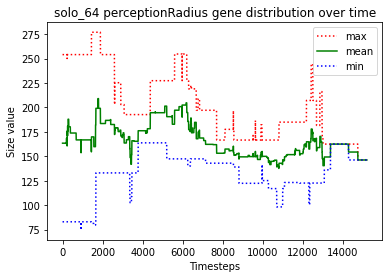

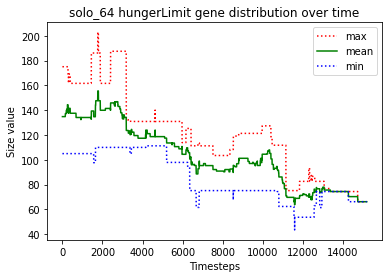





						SOLO_65

predator_8 killed predator_1
predator_9 just gave birth to predator_10
predator_9 just gave birth to predator_11
predator_3 just gave birth to predator_12
predator_5 just gave birth to predator_13
predator_9 starved to death
predator_11 starved to death
predator_10 ate the carcass of predator_9_carcass
predator_4 ate the carcass of predator_11_carcass
predator_12 just gave birth to predator_14
predator_8 killed predator_7
predator_0 just gave birth to predator_15
predator_5 starved to death
predator_8 killed predator_12
predator_10 ate the carcass of predator_5_carcass
predator_13 starved to death
predator_2 just gave birth to predator_16
predator_2 ate the carcass of predator_13_carcass
predator_14 starved to death
predator_10 ate the carcass of predator_14_carcass
predator_2 killed predator_4
predator_8 killed predator_16
predator_10 just gave birth to predator_17
predator_8 killed predator_3
predator_8 killed predator_0
predator_17 starved to death
predator_10 ate

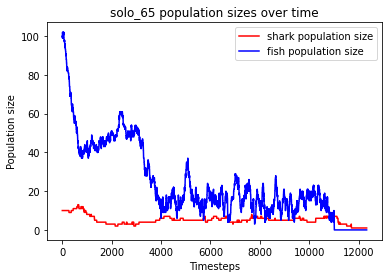

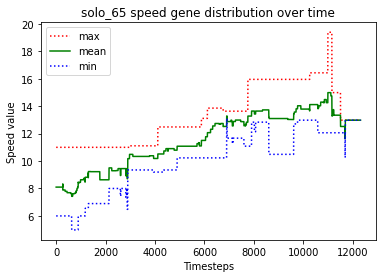

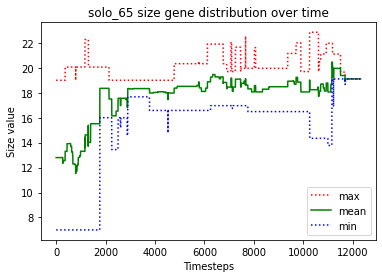

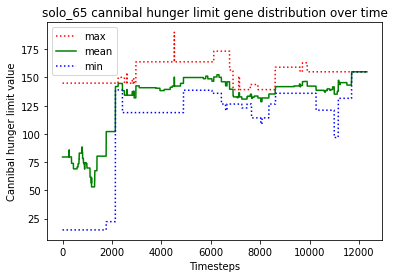

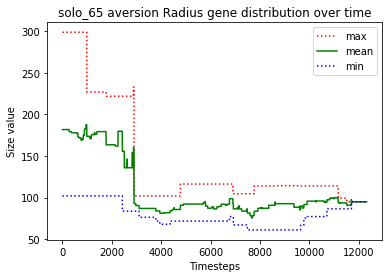

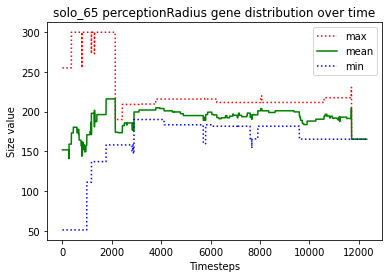

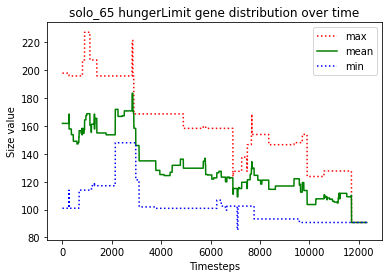





						SOLO_66

predator_0 just gave birth to predator_10
predator_9 just gave birth to predator_11
predator_8 just gave birth to predator_12
predator_0 starved to death
predator_9 just gave birth to predator_13
predator_7 ate the carcass of predator_0_carcass
predator_10 starved to death
predator_13 just gave birth to predator_14
predator_1 just gave birth to predator_15
predator_8 ate the carcass of predator_10_carcass
predator_12 starved to death
predator_8 ate the carcass of predator_12_carcass
predator_11 just gave birth to predator_16
predator_5 just gave birth to predator_17
predator_15 killed predator_7
predator_11 starved to death
predator_16 starved to death
predator_15 ate the carcass of predator_11_carcass
predator_13 starved to death
predator_8 ate the carcass of predator_13_carcass
predator_1 ate the carcass of predator_16_carcass
predator_4 just gave birth to predator_18
predator_4 just gave birth to predator_19
predator_8 just gave birth to predator_20
predator_14 st

predator_45 ate the carcass of predator_35_carcass
predator_71 starved to death
predator_72 ate the carcass of predator_71_carcass
predator_59 starved to death
predator_39 just gave birth to predator_73
predator_45 just gave birth to predator_74
predator_45 ate the carcass of predator_59_carcass
predator_58 starved to death
predator_73 starved to death
predator_39 starved to death
predator_69 ate the carcass of predator_73_carcass
predator_45 ate the carcass of predator_58_carcass
predator_74 starved to death
predator_70 just gave birth to predator_75
predator_45 ate the carcass of predator_39_carcass
predator_70 ate the carcass of predator_74_carcass
predator_72 starved to death
predator_69 just gave birth to predator_76
predator_75 starved to death
predator_45 ate the carcass of predator_75_carcass
predator_69 starved to death
predator_76 starved to death
predator_70 ate the carcass of predator_69_carcass
predator_45 ate the carcass of predator_72_carcass
predator_45 just gave birth 

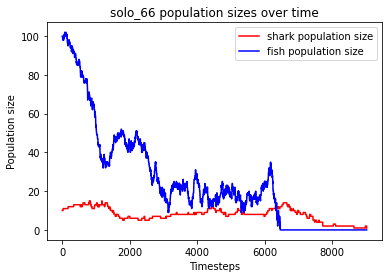

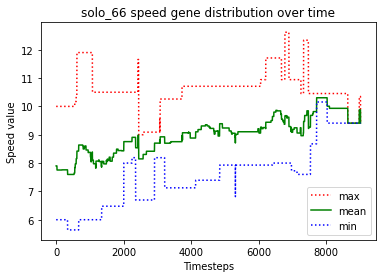

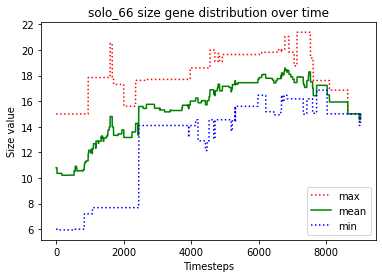

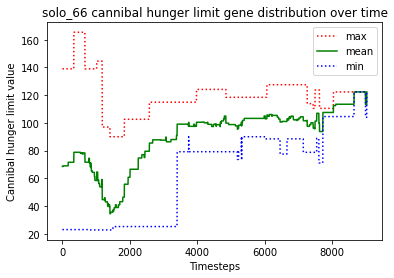

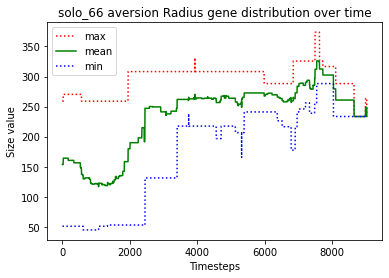

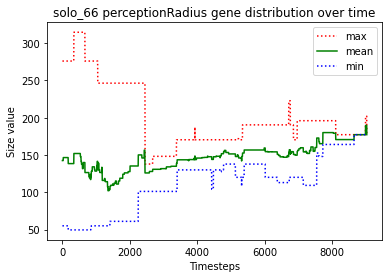

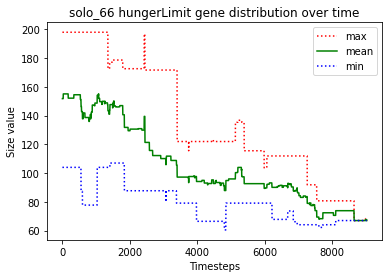





						SOLO_67

predator_5 just gave birth to predator_10
predator_7 just gave birth to predator_11
predator_3 just gave birth to predator_12
predator_1 just gave birth to predator_13
predator_3 killed predator_2
predator_13 killed predator_9
predator_8 just gave birth to predator_14
predator_10 killed predator_14
predator_13 just gave birth to predator_15
predator_0 just gave birth to predator_16
predator_11 just gave birth to predator_17
predator_12 just gave birth to predator_18
predator_13 starved to death
predator_8 just gave birth to predator_19
predator_3 ate the carcass of predator_13_carcass
predator_15 starved to death
predator_10 just gave birth to predator_20
predator_10 killed predator_20
predator_11 ate the carcass of predator_15_carcass
predator_7 just gave birth to predator_21
predator_7 killed predator_21
predator_18 starved to death
predator_1 starved to death
predator_17 ate the carcass of predator_1_carcass
predator_8 ate the carcass of predator_18_carcass
predat

predator_71 just gave birth to predator_72
predator_69 just gave birth to predator_73
predator_51 just gave birth to predator_74
predator_69 starved to death
predator_72 ate the carcass of predator_69_carcass
predator_68 starved to death
predator_51 ate the carcass of predator_68_carcass
predator_51 just gave birth to predator_75
predator_71 just gave birth to predator_76
predator_75 starved to death
predator_73 ate the carcass of predator_75_carcass
predator_76 starved to death
predator_71 ate the carcass of predator_76_carcass
predator_51 starved to death
predator_74 just gave birth to predator_77
predator_72 just gave birth to predator_78
predator_71 ate the carcass of predator_51_carcass
predator_72 just gave birth to predator_79
predator_74 just gave birth to predator_80
predator_79 just gave birth to predator_81
predator_79 killed predator_81
predator_74 starved to death
predator_78 ate the carcass of predator_74_carcass
predator_72 just gave birth to predator_82
predator_72 star

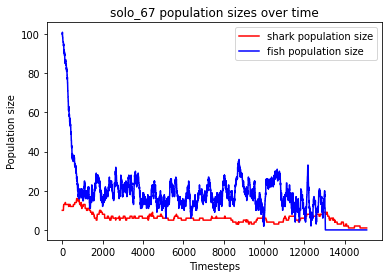

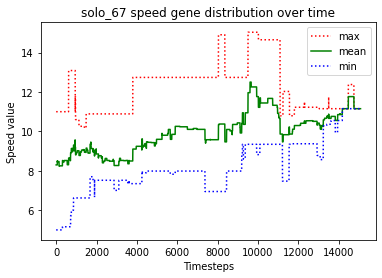

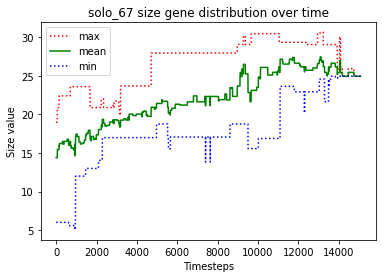

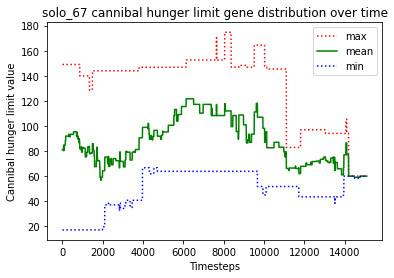

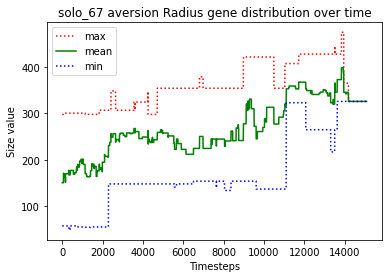

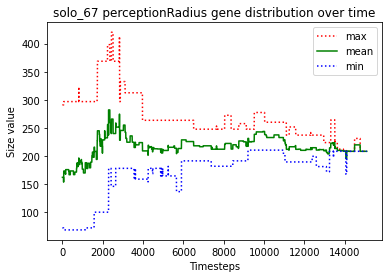

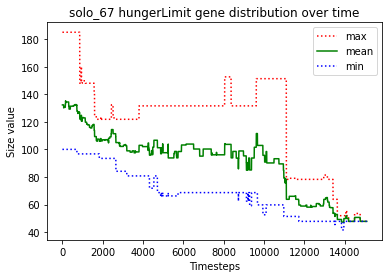





						SOLO_68

predator_6 just gave birth to predator_10
predator_6 just gave birth to predator_11
predator_11 just gave birth to predator_12
predator_2 just gave birth to predator_13
predator_10 just gave birth to predator_14
predator_11 starved to death
predator_12 starved to death
predator_13 ate the carcass of predator_12_carcass
predator_6 starved to death
predator_4 ate the carcass of predator_11_carcass
predator_2 ate the carcass of predator_6_carcass
predator_14 starved to death
predator_10 starved to death
predator_13 ate the carcass of predator_14_carcass
predator_7 ate the carcass of predator_10_carcass
predator_9 just gave birth to predator_15
predator_7 just gave birth to predator_16
predator_16 just gave birth to predator_17
predator_2 killed predator_15
predator_17 killed predator_7
predator_2 killed predator_3
predator_16 starved to death
predator_5 just gave birth to predator_18
predator_2 killed predator_9
predator_5 ate the carcass of predator_16_carcass
predator

predator_55 just gave birth to predator_76
predator_75 just gave birth to predator_77
predator_28 starved to death
predator_74 ate the carcass of predator_28_carcass
predator_72 starved to death
predator_77 starved to death
predator_68 ate the carcass of predator_72_carcass
predator_60 ate the carcass of predator_77_carcass
predator_76 starved to death
predator_55 ate the carcass of predator_76_carcass
predator_75 just gave birth to predator_78
predator_78 just gave birth to predator_79
predator_74 just gave birth to predator_80
predator_43 just gave birth to predator_81
predator_43 just gave birth to predator_82
predator_81 just gave birth to predator_83
predator_55 just gave birth to predator_84
predator_68 just gave birth to predator_85
predator_81 killed predator_75
predator_83 just gave birth to predator_86
predator_82 killed predator_44
predator_85 just gave birth to predator_87
predator_86 starved to death
predator_83 starved to death
predator_81 ate the carcass of predator_83_c

predator_99 just gave birth to predator_137
predator_133 killed predator_136
predator_131 just gave birth to predator_138
predator_131 just gave birth to predator_139
predator_131 starved to death
predator_139 starved to death
predator_133 ate the carcass of predator_139_carcass
predator_138 starved to death
predator_133 ate the carcass of predator_131_carcass
predator_99 ate the carcass of predator_138_carcass
predator_133 killed predator_134
predator_135 just gave birth to predator_140
predator_135 just gave birth to predator_141
predator_140 just gave birth to predator_142
predator_142 just gave birth to predator_143
no fish to move
predator_135 just gave birth to predator_144
predator_141 starved to death
predator_135 ate the carcass of predator_141_carcass
predator_143 starved to death
predator_140 ate the carcass of predator_143_carcass
predator_133 just gave birth to predator_145
predator_142 starved to death
predator_144 ate the carcass of predator_142_carcass
predator_99 just 

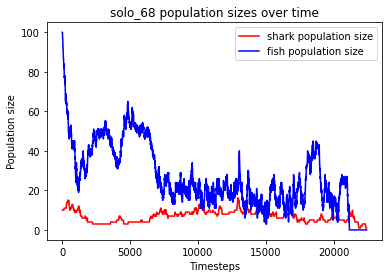

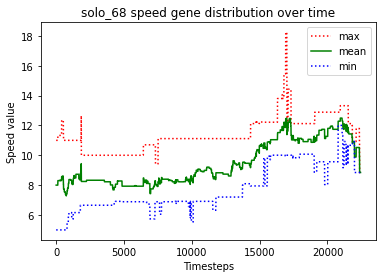

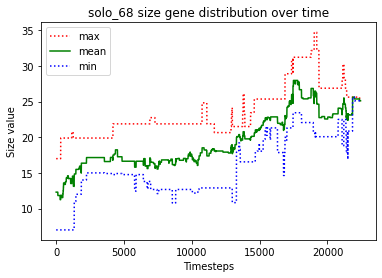

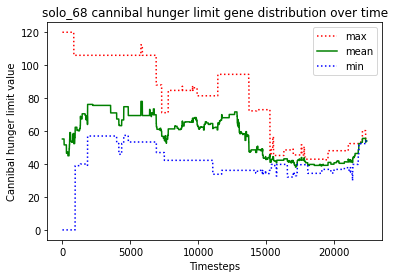

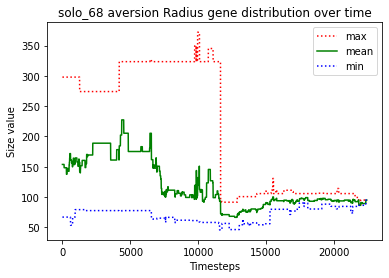

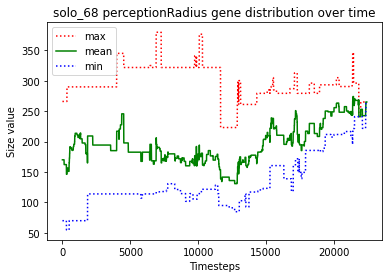

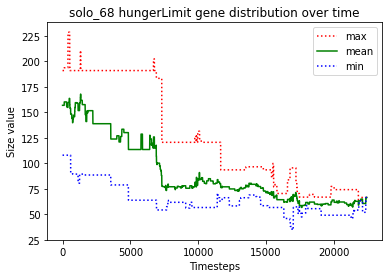





						SOLO_69

predator_0 just gave birth to predator_10
predator_3 just gave birth to predator_11
predator_11 just gave birth to predator_12
predator_0 starved to death
predator_10 starved to death
predator_3 ate the carcass of predator_0_carcass
predator_9 ate the carcass of predator_10_carcass
predator_2 just gave birth to predator_13
predator_13 starved to death
predator_5 ate the carcass of predator_13_carcass
predator_2 starved to death
predator_12 ate the carcass of predator_2_carcass
predator_11 starved to death
predator_3 ate the carcass of predator_11_carcass
predator_1 starved to death
predator_12 starved to death
predator_9 ate the carcass of predator_1_carcass
predator_6 ate the carcass of predator_12_carcass
predator_4 just gave birth to predator_14
predator_6 just gave birth to predator_15
predator_7 starved to death
predator_6 ate the carcass of predator_7_carcass
predator_6 killed predator_9
predator_15 just gave birth to predator_16
predator_14 just gave birth to 

predator_48 starved to death
predator_55 ate the carcass of predator_48_carcass
predator_61 just gave birth to predator_71
predator_64 just gave birth to predator_72
predator_34 starved to death
predator_67 ate the carcass of predator_34_carcass
predator_72 starved to death
predator_68 ate the carcass of predator_72_carcass
predator_64 starved to death
predator_67 just gave birth to predator_73
predator_55 ate the carcass of predator_64_carcass
predator_55 just gave birth to predator_74
predator_55 just gave birth to predator_75
predator_61 just gave birth to predator_76
predator_76 starved to death
predator_61 starved to death
predator_55 ate the carcass of predator_61_carcass
predator_74 ate the carcass of predator_76_carcass
predator_33 just gave birth to predator_77
predator_67 just gave birth to predator_78
predator_73 just gave birth to predator_79
predator_77 just gave birth to predator_80
predator_70 just gave birth to predator_81
predator_80 starved to death
predator_75 starve

predator_99 just gave birth to predator_134
predator_99 just gave birth to predator_135
predator_133 starved to death
predator_128 ate the carcass of predator_133_carcass
predator_105 killed predator_126
predator_124 killed predator_99
predator_105 just gave birth to predator_136
predator_115 starved to death
predator_124 ate the carcass of predator_115_carcass
predator_131 just gave birth to predator_137
predator_135 starved to death
predator_131 ate the carcass of predator_135_carcass
predator_128 killed predator_105
predator_129 just gave birth to predator_138
predator_129 starved to death
predator_131 ate the carcass of predator_129_carcass
predator_137 just gave birth to predator_139
predator_89 just gave birth to predator_140
predator_124 just gave birth to predator_141
predator_124 killed predator_141
predator_138 just gave birth to predator_142
predator_132 just gave birth to predator_143
predator_142 starved to death
predator_138 starved to death
predator_123 just gave birth t

predator_197 ate the carcass of predator_180_carcass
predator_174 just gave birth to predator_199
predator_192 starved to death
predator_198 just gave birth to predator_200
predator_195 starved to death
predator_179 ate the carcass of predator_195_carcass
predator_193 ate the carcass of predator_192_carcass
predator_155 starved to death
predator_174 ate the carcass of predator_155_carcass
predator_199 starved to death
predator_189 just gave birth to predator_201
predator_165 ate the carcass of predator_199_carcass
predator_198 starved to death
predator_201 starved to death
predator_189 starved to death
predator_197 ate the carcass of predator_198_carcass
predator_200 starved to death
predator_193 just gave birth to predator_202
predator_174 ate the carcass of predator_200_carcass
predator_193 ate the carcass of predator_201_carcass
predator_202 ate the carcass of predator_189_carcass
predator_202 killed predator_179
predator_202 killed predator_165
predator_197 starved to death
predato

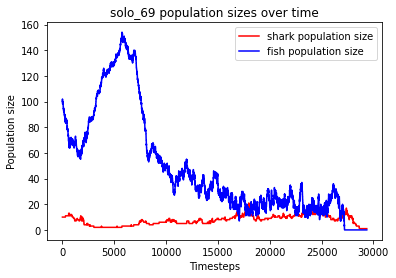

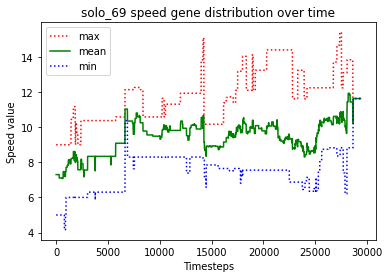

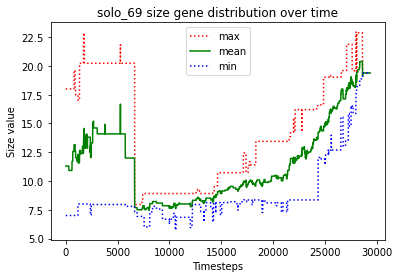

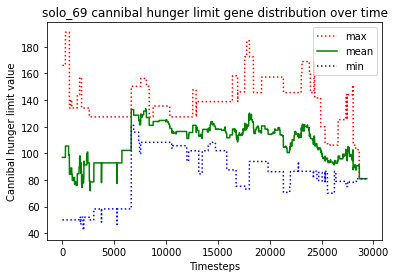

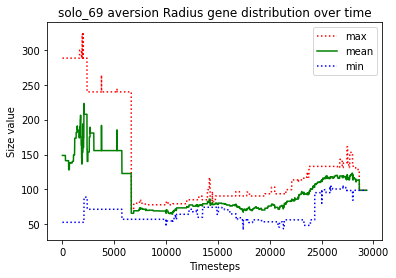

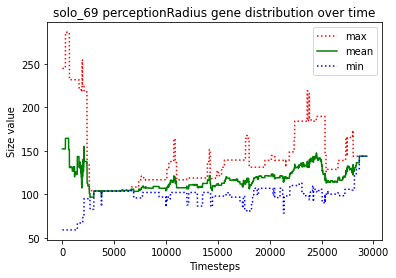

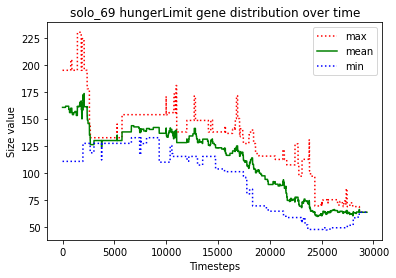





						SOLO_70

predator_8 just gave birth to predator_10
predator_3 just gave birth to predator_11
predator_11 killed predator_5
predator_3 killed predator_2
predator_11 killed predator_4
predator_6 killed predator_0
predator_11 killed predator_9
predator_8 just gave birth to predator_12
predator_3 killed predator_10
predator_3 killed predator_12
predator_3 just gave birth to predator_13
predator_3 killed predator_8
predator_3 just gave birth to predator_14
predator_13 killed predator_1
predator_14 killed predator_6
predator_3 just gave birth to predator_15
predator_13 killed predator_7
predator_13 starved to death
predator_15 ate the carcass of predator_13_carcass
predator_3 just gave birth to predator_16
predator_3 just gave birth to predator_17
predator_16 just gave birth to predator_18
predator_3 starved to death
predator_15 ate the carcass of predator_3_carcass
predator_18 starved to death
predator_15 ate the carcass of predator_18_carcass
predator_16 starved to death
predator

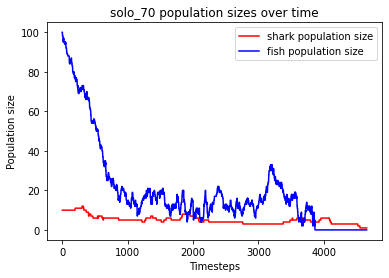

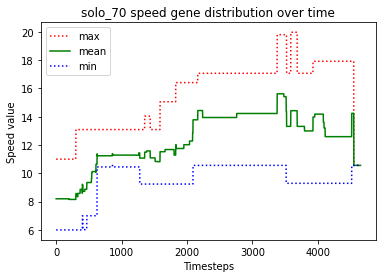

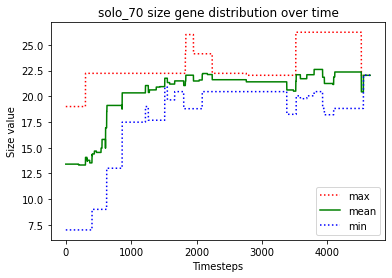

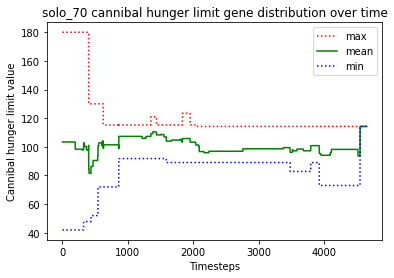

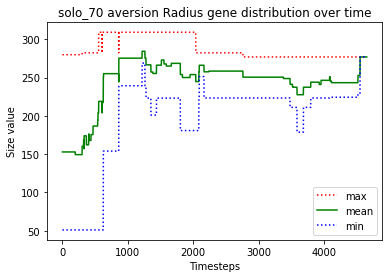

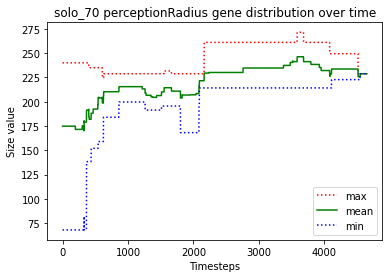

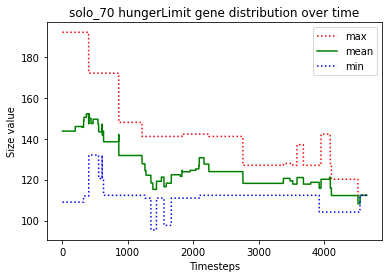





						SOLO_71

predator_9 just gave birth to predator_10
predator_9 just gave birth to predator_11
predator_10 killed predator_11
predator_3 just gave birth to predator_12
predator_7 just gave birth to predator_13
predator_2 just gave birth to predator_14
predator_9 starved to death
predator_6 just gave birth to predator_15
predator_5 ate the carcass of predator_9_carcass
predator_8 just gave birth to predator_16
predator_4 just gave birth to predator_17
predator_15 just gave birth to predator_18
predator_14 just gave birth to predator_19
predator_19 just gave birth to predator_20
predator_1 just gave birth to predator_21
predator_12 killed predator_18
predator_6 killed predator_5
predator_1 just gave birth to predator_22
predator_12 killed predator_16
predator_10 starved to death
predator_20 starved to death
predator_0 ate the carcass of predator_10_carcass
predator_19 starved to death
predator_1 ate the carcass of predator_20_carcass
predator_15 starved to death
predator_6 ate th

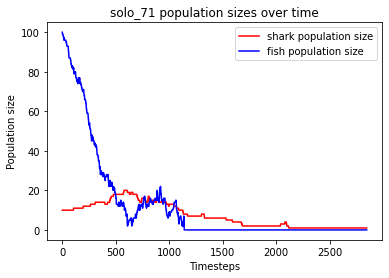

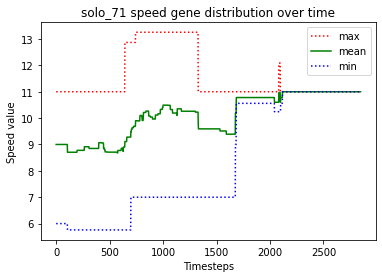

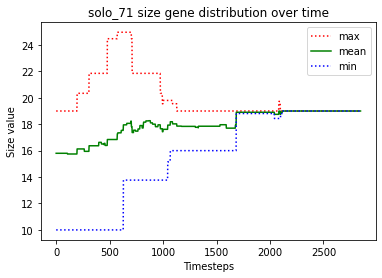

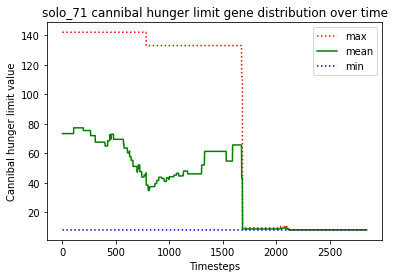

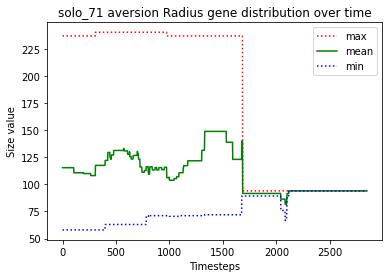

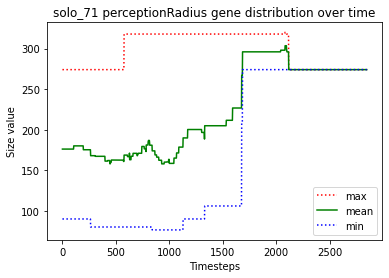

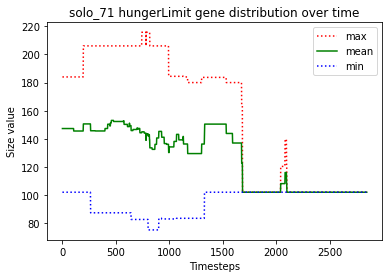





						SOLO_72

predator_3 just gave birth to predator_10
predator_0 just gave birth to predator_11
predator_2 just gave birth to predator_12
predator_0 killed predator_4
predator_0 killed predator_10
predator_2 just gave birth to predator_13
predator_5 just gave birth to predator_14
predator_7 just gave birth to predator_15
predator_1 just gave birth to predator_16
predator_13 killed predator_16
predator_0 killed predator_9
predator_5 just gave birth to predator_17
predator_13 starved to death
predator_8 ate the carcass of predator_13_carcass
predator_5 starved to death
predator_15 killed predator_3
predator_17 starved to death
predator_15 ate the carcass of predator_17_carcass
predator_14 just gave birth to predator_18
predator_11 ate the carcass of predator_5_carcass
predator_7 killed predator_1
predator_14 starved to death
predator_18 starved to death
predator_7 ate the carcass of predator_18_carcass
predator_2 starved to death
predator_6 ate the carcass of predator_2_carcass
pr

predator_66 just gave birth to predator_75
predator_66 just gave birth to predator_76
predator_73 starved to death
predator_66 starved to death
predator_41 ate the carcass of predator_66_carcass
predator_76 starved to death
predator_31 ate the carcass of predator_48_carcass
predator_75 starved to death
predator_31 just gave birth to predator_77
predator_31 just gave birth to predator_78
predator_77 ate the carcass of predator_73_carcass
predator_77 ate the carcass of predator_76_carcass
predator_52 just gave birth to predator_79
predator_41 ate the carcass of predator_75_carcass
predator_78 starved to death
predator_31 starved to death
predator_27 just gave birth to predator_80
predator_52 just gave birth to predator_81
predator_77 just gave birth to predator_82
predator_49 ate the carcass of predator_78_carcass
predator_27 ate the carcass of predator_31_carcass
predator_80 killed predator_77
predator_52 starved to death
predator_79 just gave birth to predator_83
predator_79 killed pre

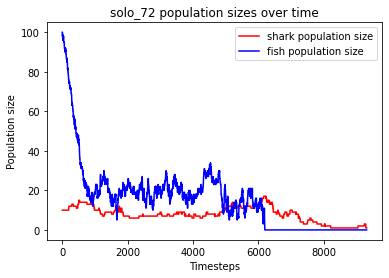

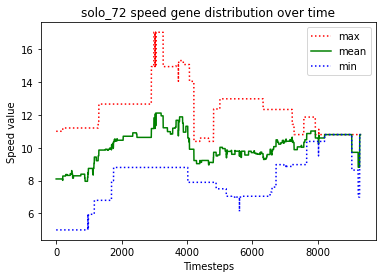

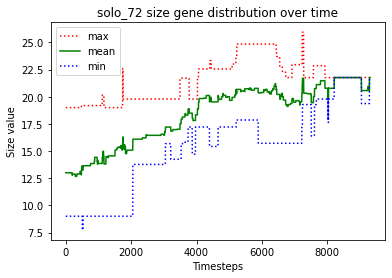

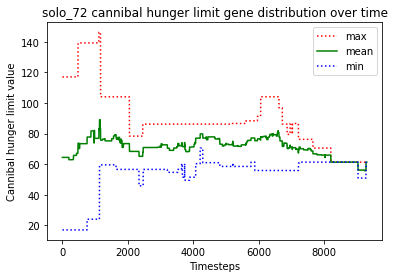

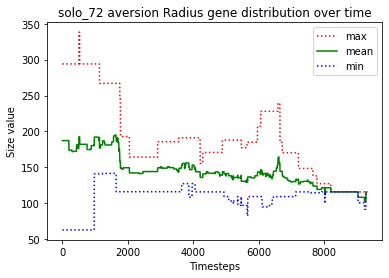

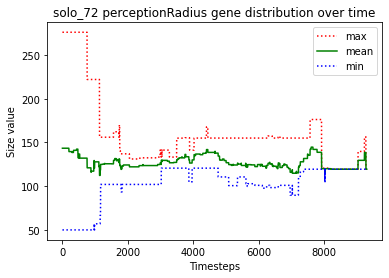

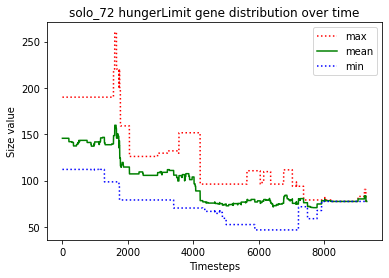





						SOLO_73

predator_0 just gave birth to predator_10
predator_2 just gave birth to predator_11
predator_7 just gave birth to predator_12
predator_2 killed predator_3
predator_7 killed predator_6
predator_11 killed predator_4
predator_12 just gave birth to predator_13
predator_5 just gave birth to predator_14
predator_10 starved to death
predator_7 just gave birth to predator_15
predator_7 ate the carcass of predator_10_carcass
predator_13 killed predator_8
predator_11 killed predator_1
predator_15 starved to death
predator_11 ate the carcass of predator_15_carcass
predator_7 just gave birth to predator_16
predator_16 starved to death
predator_9 ate the carcass of predator_16_carcass
predator_7 starved to death
predator_5 ate the carcass of predator_7_carcass
predator_14 just gave birth to predator_17
predator_5 just gave birth to predator_18
predator_5 killed predator_18
predator_13 just gave birth to predator_19
predator_17 just gave birth to predator_20
predator_9 just gave b

predator_68 just gave birth to predator_72
predator_68 just gave birth to predator_73
predator_71 just gave birth to predator_74
predator_74 just gave birth to predator_75
predator_75 starved to death
predator_74 ate the carcass of predator_75_carcass
predator_73 just gave birth to predator_76
predator_73 just gave birth to predator_77
predator_71 just gave birth to predator_78
predator_73 just gave birth to predator_79
predator_79 starved to death
predator_78 starved to death
predator_73 starved to death
predator_77 starved to death
predator_72 ate the carcass of predator_79_carcass
predator_74 ate the carcass of predator_78_carcass
predator_71 ate the carcass of predator_77_carcass
predator_72 just gave birth to predator_80
predator_71 ate the carcass of predator_73_carcass
predator_40 just gave birth to predator_81
predator_72 just gave birth to predator_82
predator_81 starved to death
predator_68 starved to death
predator_74 ate the carcass of predator_68_carcass
predator_67 just g

predator_106 just gave birth to predator_136
predator_136 starved to death
predator_106 starved to death
predator_135 just gave birth to predator_137
predator_137 just gave birth to predator_138
predator_138 ate the carcass of predator_106_carcass
predator_137 starved to death
predator_138 ate the carcass of predator_136_carcass
predator_135 ate the carcass of predator_137_carcass
predator_133 starved to death
predator_129 starved to death
predator_135 just gave birth to predator_139
predator_138 ate the carcass of predator_129_carcass
predator_99 ate the carcass of predator_133_carcass
predator_139 starved to death
predator_135 starved to death
predator_99 ate the carcass of predator_139_carcass
predator_134 ate the carcass of predator_135_carcass
predator_131 just gave birth to predator_140
predator_138 just gave birth to predator_141
predator_140 just gave birth to predator_142
predator_142 just gave birth to predator_143
predator_126 just gave birth to predator_144
predator_115 kil

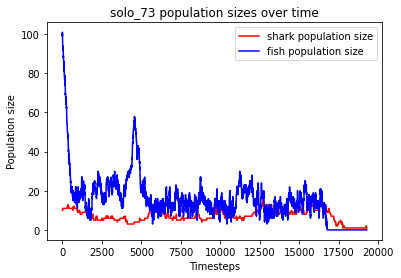

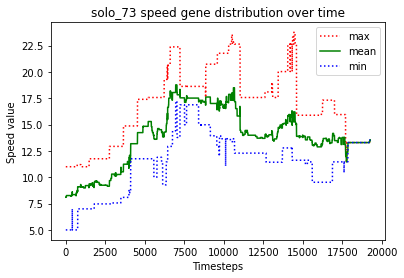

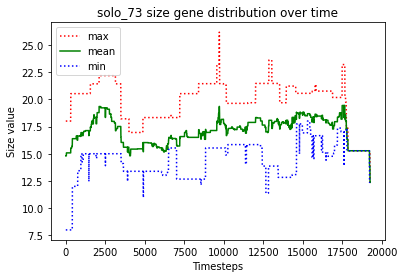

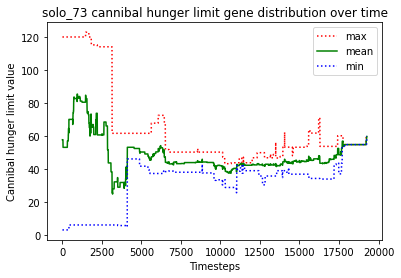

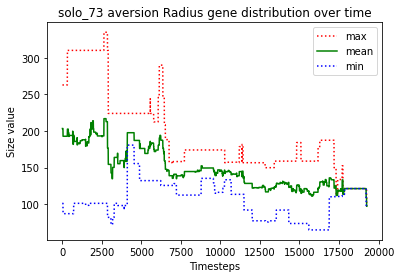

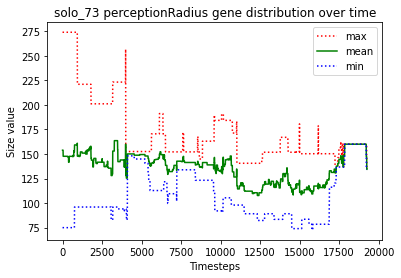

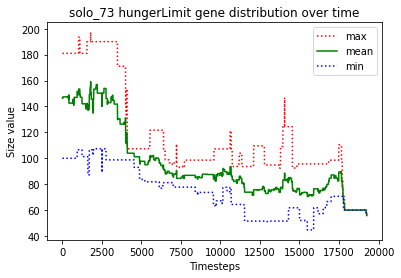





						SOLO_74

predator_0 just gave birth to predator_10
predator_1 just gave birth to predator_11
predator_10 just gave birth to predator_12
predator_6 just gave birth to predator_13
predator_1 just gave birth to predator_14
predator_10 killed predator_8
predator_12 killed predator_5
predator_14 starved to death
predator_1 starved to death
predator_4 ate the carcass of predator_1_carcass
predator_12 ate the carcass of predator_14_carcass
predator_7 just gave birth to predator_15
predator_13 starved to death
predator_12 ate the carcass of predator_13_carcass
predator_6 starved to death
predator_11 starved to death
predator_3 killed predator_15
predator_9 ate the carcass of predator_6_carcass
predator_12 just gave birth to predator_16
predator_7 just gave birth to predator_17
predator_7 ate the carcass of predator_11_carcass
predator_17 starved to death
predator_10 starved to death
predator_7 ate the carcass of predator_17_carcass
predator_12 ate the carcass of predator_10_carcass
p

predator_36 just gave birth to predator_70
predator_69 just gave birth to predator_71
predator_71 starved to death
predator_70 ate the carcass of predator_71_carcass
predator_70 just gave birth to predator_72
predator_70 killed predator_72
predator_69 just gave birth to predator_73
predator_36 just gave birth to predator_74
predator_36 killed predator_74
predator_70 starved to death
predator_62 ate the carcass of predator_70_carcass
predator_69 just gave birth to predator_75
predator_36 just gave birth to predator_76
predator_73 just gave birth to predator_77
predator_77 just gave birth to predator_78
predator_73 just gave birth to predator_79
predator_36 just gave birth to predator_80
predator_62 just gave birth to predator_81
predator_75 starved to death
predator_69 ate the carcass of predator_75_carcass
predator_80 starved to death
predator_81 ate the carcass of predator_80_carcass
predator_77 starved to death
predator_76 ate the carcass of predator_77_carcass
predator_78 just gave 

predator_108 ate the carcass of predator_133_carcass
predator_107 just gave birth to predator_136
predator_107 just gave birth to predator_137
predator_107 starved to death
predator_137 starved to death
predator_124 ate the carcass of predator_137_carcass
predator_132 ate the carcass of predator_107_carcass
predator_136 just gave birth to predator_138
predator_124 just gave birth to predator_139
predator_127 just gave birth to predator_140
predator_132 just gave birth to predator_141
predator_136 starved to death
predator_124 ate the carcass of predator_136_carcass
predator_135 just gave birth to predator_142
predator_127 starved to death
predator_124 ate the carcass of predator_127_carcass
predator_138 starved to death
predator_141 starved to death
predator_124 ate the carcass of predator_141_carcass
predator_140 ate the carcass of predator_138_carcass
predator_135 just gave birth to predator_143
predator_132 just gave birth to predator_144
predator_132 killed predator_144
predator_14

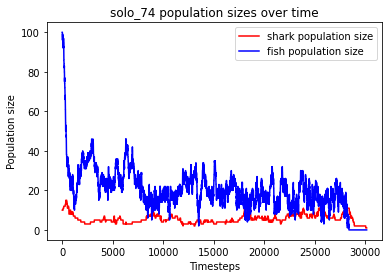

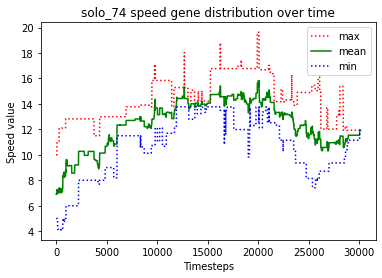

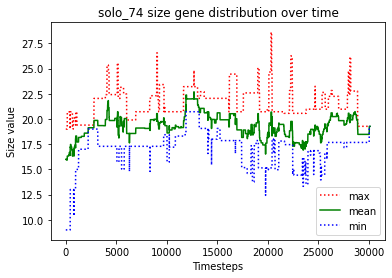

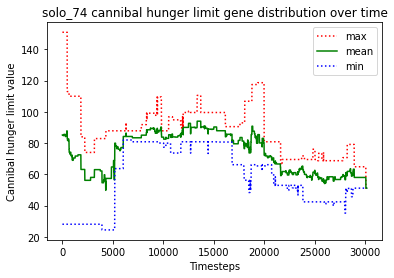

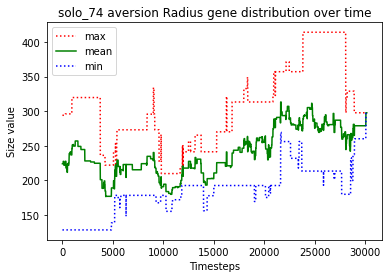

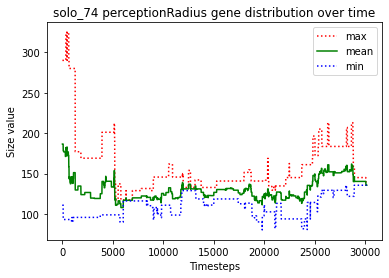

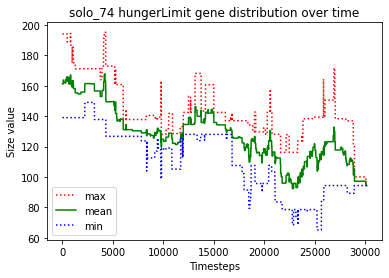





						SOLO_75

predator_8 just gave birth to predator_10
predator_5 just gave birth to predator_11
predator_11 killed predator_1
predator_11 killed predator_4
predator_9 just gave birth to predator_12
predator_8 starved to death
predator_10 ate the carcass of predator_8_carcass
predator_5 killed predator_2
predator_10 starved to death
predator_9 ate the carcass of predator_10_carcass
predator_5 just gave birth to predator_13
predator_11 just gave birth to predator_14
predator_11 just gave birth to predator_15
predator_9 starved to death
predator_13 ate the carcass of predator_9_carcass
predator_7 just gave birth to predator_16
predator_16 killed predator_14
predator_13 just gave birth to predator_17
predator_5 starved to death
predator_15 ate the carcass of predator_5_carcass
predator_16 killed predator_6
predator_7 killed predator_13
predator_0 just gave birth to predator_18
predator_16 killed predator_15
predator_16 killed predator_3
predator_7 starved to death
predator_16 ate th

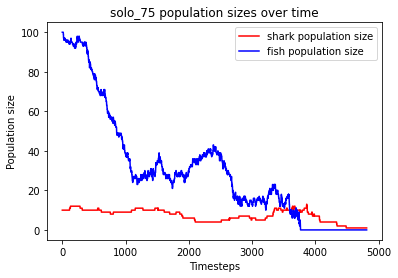

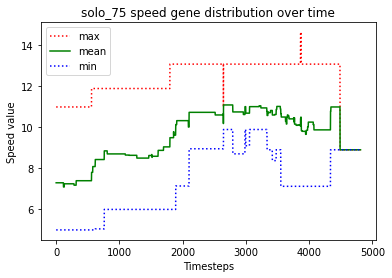

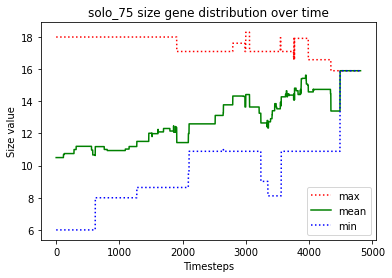

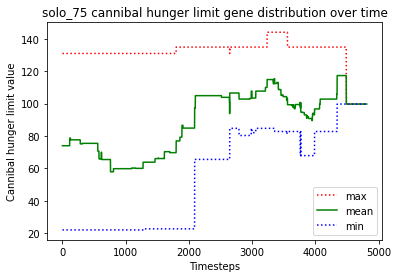

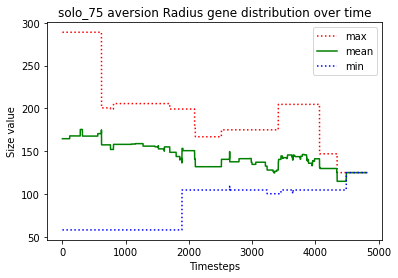

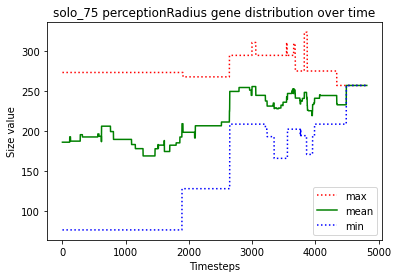

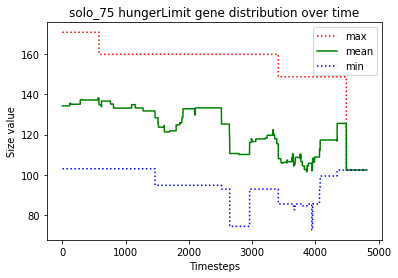





						SOLO_76

predator_2 just gave birth to predator_10
predator_8 just gave birth to predator_11
predator_1 just gave birth to predator_12
predator_2 starved to death
predator_10 starved to death
predator_8 just gave birth to predator_13
predator_1 ate the carcass of predator_10_carcass
predator_4 ate the carcass of predator_2_carcass
predator_6 killed predator_12
predator_5 just gave birth to predator_14
predator_5 killed predator_1
predator_5 just gave birth to predator_15
predator_13 just gave birth to predator_16
predator_9 just gave birth to predator_17
predator_0 just gave birth to predator_18
predator_5 killed predator_3
predator_5 just gave birth to predator_19
predator_17 just gave birth to predator_20
predator_13 killed predator_5
predator_4 just gave birth to predator_21
predator_19 starved to death
predator_13 ate the carcass of predator_19_carcass
predator_16 killed predator_14
predator_20 starved to death
predator_17 starved to death
predator_16 ate the carcass of p

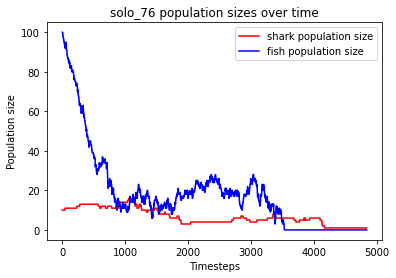

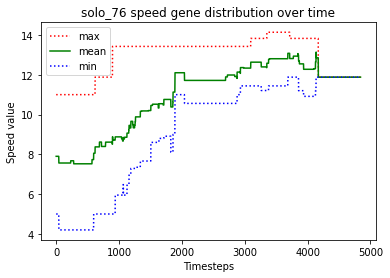

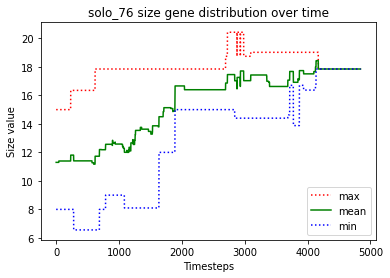

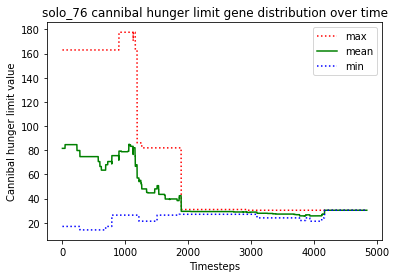

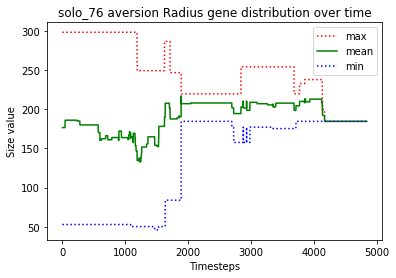

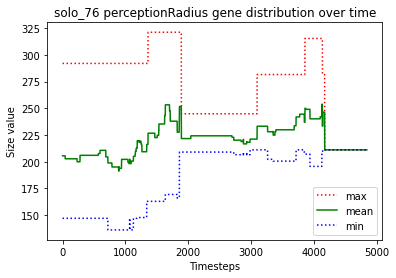

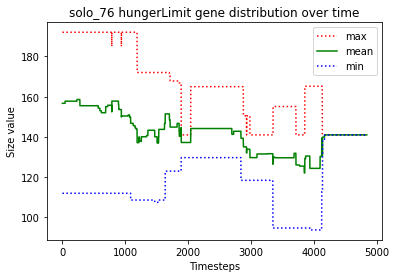





						SOLO_77

predator_8 just gave birth to predator_10
predator_7 killed predator_0
predator_9 just gave birth to predator_11
predator_2 just gave birth to predator_12
predator_12 just gave birth to predator_13
predator_6 just gave birth to predator_14
predator_2 just gave birth to predator_15
predator_15 killed predator_12
predator_13 killed predator_10
predator_13 killed predator_4
predator_7 just gave birth to predator_16
predator_3 just gave birth to predator_17
predator_5 just gave birth to predator_18
predator_13 killed predator_17
predator_9 just gave birth to predator_19
predator_2 killed predator_8
predator_1 just gave birth to predator_20
predator_15 killed predator_3
predator_7 killed predator_14
predator_5 just gave birth to predator_21
predator_13 killed predator_1
predator_16 killed predator_6
predator_7 killed predator_19
predator_15 killed predator_9
predator_21 killed predator_2
predator_11 starved to death
predator_21 ate the carcass of predator_11_carcass
preda

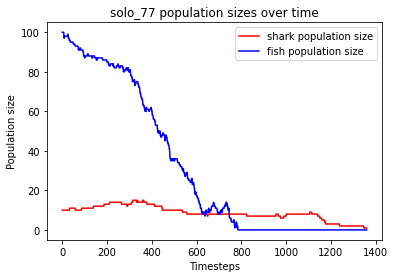

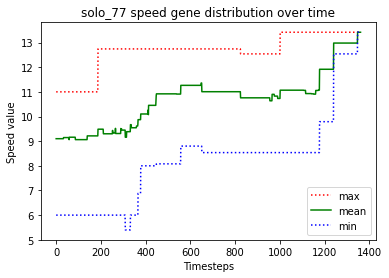

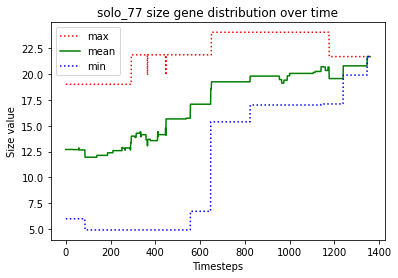

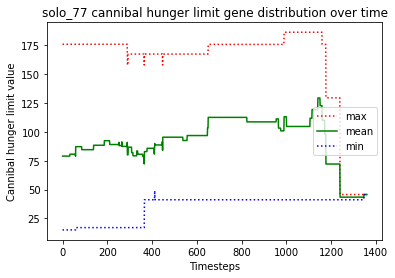

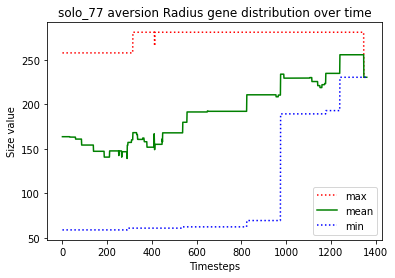

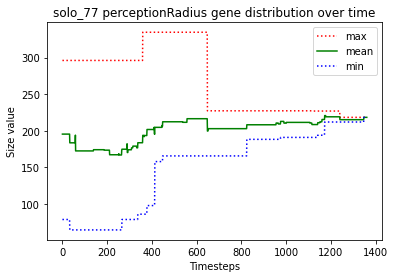

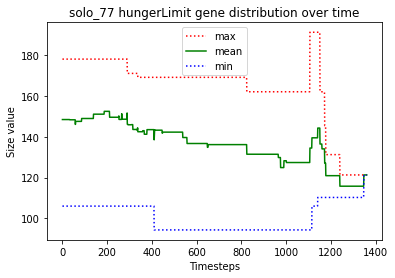





						SOLO_78

predator_9 just gave birth to predator_10
predator_2 just gave birth to predator_11
predator_2 just gave birth to predator_12
predator_9 just gave birth to predator_13
predator_10 killed predator_1
predator_12 starved to death
predator_10 ate the carcass of predator_12_carcass
predator_2 starved to death
predator_11 just gave birth to predator_14
predator_4 just gave birth to predator_15
predator_7 ate the carcass of predator_2_carcass
predator_3 just gave birth to predator_16
predator_14 just gave birth to predator_17
predator_11 starved to death
predator_17 starved to death
predator_14 ate the carcass of predator_17_carcass
predator_15 just gave birth to predator_18
predator_18 ate the carcass of predator_11_carcass
predator_3 just gave birth to predator_19
predator_3 killed predator_19
predator_4 just gave birth to predator_20
predator_14 starved to death
predator_6 ate the carcass of predator_14_carcass
predator_4 just gave birth to predator_21
predator_9 starved

predator_65 ate the carcass of predator_67_carcass
predator_59 just gave birth to predator_69
predator_69 just gave birth to predator_70
predator_68 starved to death
predator_70 ate the carcass of predator_68_carcass
predator_63 starved to death
predator_65 starved to death
predator_57 ate the carcass of predator_63_carcass
predator_69 ate the carcass of predator_65_carcass
predator_69 just gave birth to predator_71
predator_69 just gave birth to predator_72
predator_57 just gave birth to predator_73
predator_59 just gave birth to predator_74
predator_55 just gave birth to predator_75
predator_55 starved to death
predator_70 ate the carcass of predator_55_carcass
predator_70 just gave birth to predator_76
predator_70 killed predator_76
predator_73 just gave birth to predator_77
predator_74 starved to death
predator_71 just gave birth to predator_78
predator_71 killed predator_78
predator_77 ate the carcass of predator_74_carcass
predator_71 just gave birth to predator_79
predator_59 ju

predator_132 ate the carcass of predator_133_carcass
predator_117 just gave birth to predator_135
predator_117 killed predator_135
predator_116 starved to death
predator_95 ate the carcass of predator_116_carcass
predator_125 just gave birth to predator_136
predator_136 killed predator_132
predator_112 just gave birth to predator_137
predator_115 just gave birth to predator_138
predator_138 killed predator_95
predator_117 starved to death
predator_137 ate the carcass of predator_117_carcass
predator_138 just gave birth to predator_139
predator_115 just gave birth to predator_140
predator_131 just gave birth to predator_141
predator_134 just gave birth to predator_142
predator_139 just gave birth to predator_143
predator_131 starved to death
predator_139 ate the carcass of predator_131_carcass
predator_139 killed predator_122
predator_143 starved to death
predator_115 starved to death
predator_112 starved to death
predator_142 just gave birth to predator_144
predator_140 starved to deat

predator_193 ate the carcass of predator_192_carcass
predator_190 just gave birth to predator_195
predator_193 just gave birth to predator_196
predator_185 starved to death
predator_195 starved to death
predator_164 ate the carcass of predator_185_carcass
predator_190 starved to death
predator_193 ate the carcass of predator_195_carcass
predator_187 just gave birth to predator_197
predator_187 killed predator_197
predator_164 ate the carcass of predator_190_carcass
predator_196 starved to death
predator_164 ate the carcass of predator_196_carcass
predator_164 just gave birth to predator_198
predator_198 just gave birth to predator_199
predator_199 starved to death
predator_198 starved to death
predator_193 ate the carcass of predator_198_carcass
predator_187 ate the carcass of predator_199_carcass
predator_164 just gave birth to predator_200
predator_193 just gave birth to predator_201
predator_193 just gave birth to predator_202
predator_202 just gave birth to predator_203
predator_20

predator_253 just gave birth to predator_256
predator_256 starved to death
predator_248 ate the carcass of predator_256_carcass
predator_246 just gave birth to predator_257
predator_246 just gave birth to predator_258
predator_253 just gave birth to predator_259
predator_253 starved to death
predator_259 starved to death
predator_233 ate the carcass of predator_259_carcass
predator_255 just gave birth to predator_260
predator_254 ate the carcass of predator_253_carcass
predator_258 starved to death
predator_251 just gave birth to predator_261
predator_248 ate the carcass of predator_258_carcass
predator_251 starved to death
no fish to move
predator_257 just gave birth to predator_262
predator_255 just gave birth to predator_263
predator_248 ate the carcass of predator_251_carcass
predator_254 starved to death
predator_260 just gave birth to predator_264
predator_260 starved to death
predator_264 ate the carcass of predator_260_carcass
predator_257 starved to death
predator_262 starved 

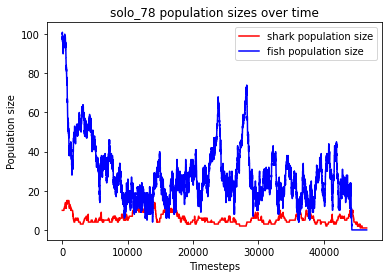

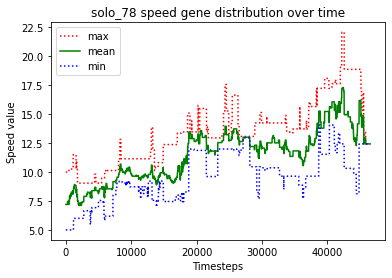

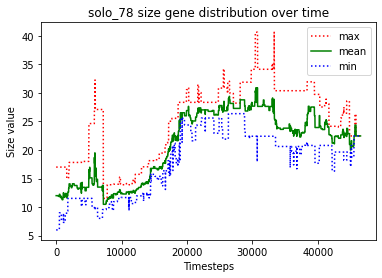

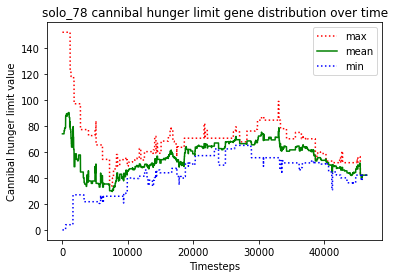

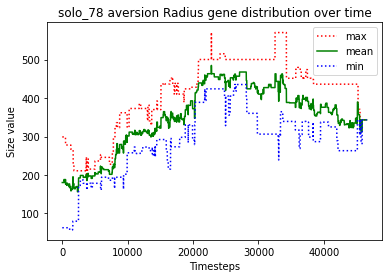

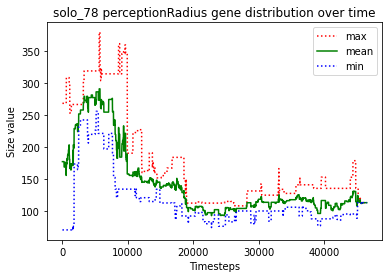

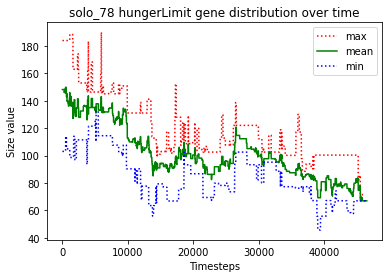





						SOLO_79

predator_1 just gave birth to predator_10
predator_1 just gave birth to predator_11
predator_8 just gave birth to predator_12
predator_3 just gave birth to predator_13
predator_4 just gave birth to predator_14
predator_8 killed predator_10
predator_1 starved to death
predator_4 ate the carcass of predator_1_carcass
predator_2 killed predator_6
predator_3 starved to death
predator_13 ate the carcass of predator_3_carcass
predator_7 just gave birth to predator_15
predator_0 just gave birth to predator_16
predator_2 killed predator_5
predator_15 starved to death
predator_0 ate the carcass of predator_15_carcass
predator_7 starved to death
predator_13 ate the carcass of predator_7_carcass
predator_2 just gave birth to predator_17
predator_13 starved to death
predator_14 starved to death
predator_0 ate the carcass of predator_14_carcass
predator_17 killed predator_11
predator_8 ate the carcass of predator_13_carcass
predator_12 starved to death
predator_4 ate the carcass 

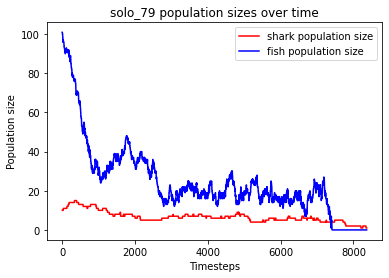

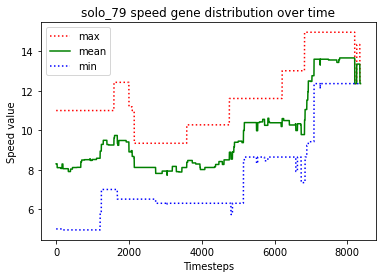

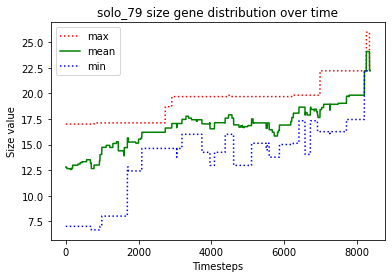

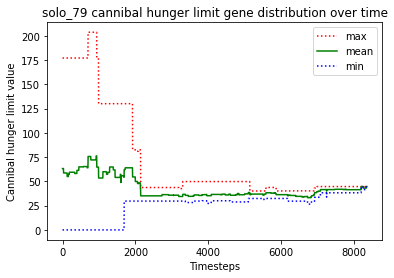

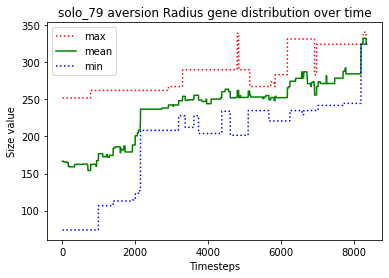

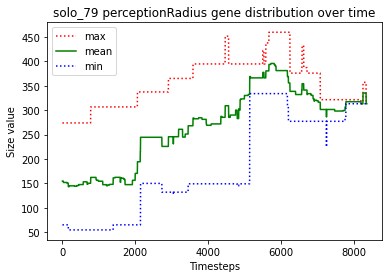

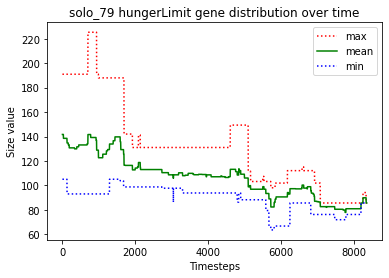





						SOLO_80

predator_4 just gave birth to predator_10
predator_10 killed predator_2
predator_4 killed predator_5
predator_10 killed predator_0
predator_10 killed predator_1
predator_4 killed predator_9
predator_6 just gave birth to predator_11
predator_7 just gave birth to predator_12
predator_4 just gave birth to predator_13
predator_10 just gave birth to predator_14
predator_14 killed predator_8
predator_14 killed predator_3
predator_13 killed predator_11
predator_4 killed predator_12
predator_10 just gave birth to predator_15
predator_4 just gave birth to predator_16
predator_15 starved to death
predator_10 starved to death
predator_7 ate the carcass of predator_10_carcass
predator_16 ate the carcass of predator_15_carcass
predator_13 killed predator_7
predator_14 starved to death
predator_13 killed predator_6
predator_4 just gave birth to predator_17
predator_17 just gave birth to predator_18
predator_18 starved to death
predator_17 starved to death
predator_16 starved to de

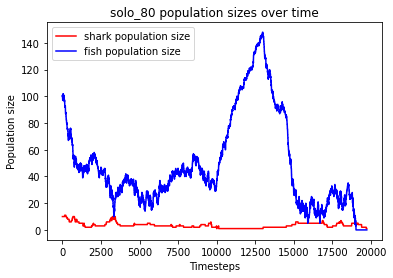

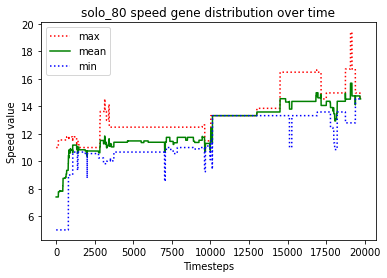

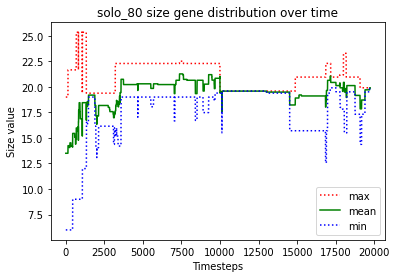

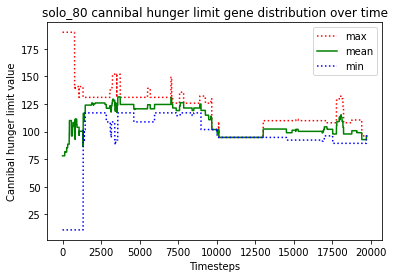

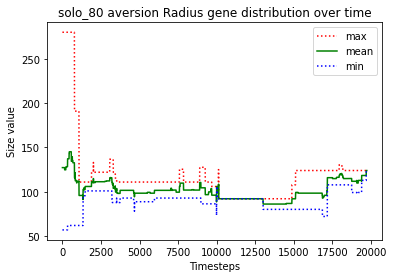

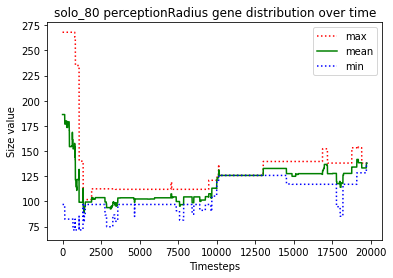

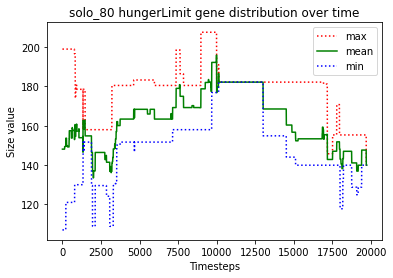





						SOLO_81

predator_3 just gave birth to predator_10
predator_10 just gave birth to predator_11
predator_5 just gave birth to predator_12
predator_12 just gave birth to predator_13
predator_7 just gave birth to predator_14
predator_12 just gave birth to predator_15
predator_9 just gave birth to predator_16
predator_15 starved to death
predator_12 starved to death
predator_0 ate the carcass of predator_12_carcass
predator_13 ate the carcass of predator_15_carcass
predator_1 just gave birth to predator_17
predator_8 just gave birth to predator_18
predator_13 just gave birth to predator_19
predator_16 starved to death
predator_19 killed predator_1
predator_9 just gave birth to predator_20
predator_2 ate the carcass of predator_16_carcass
predator_7 just gave birth to predator_21
predator_20 starved to death
predator_5 starved to death
predator_6 ate the carcass of predator_20_carcass
predator_9 starved to death
predator_10 ate the carcass of predator_5_carcass
predator_13 starved 

predator_63 ate the carcass of predator_71_carcass
predator_64 ate the carcass of predator_70_carcass
predator_60 just gave birth to predator_73
predator_68 just gave birth to predator_74
no fish to move
predator_68 just gave birth to predator_75
predator_75 starved to death
predator_74 ate the carcass of predator_75_carcass
predator_62 starved to death
predator_74 just gave birth to predator_76
predator_73 ate the carcass of predator_62_carcass
predator_68 starved to death
predator_61 ate the carcass of predator_68_carcass
predator_69 starved to death
predator_76 starved to death
predator_74 starved to death
predator_64 just gave birth to predator_77
predator_64 ate the carcass of predator_74_carcass
predator_77 starved to death
predator_64 ate the carcass of predator_77_carcass
predator_64 ate the carcass of predator_76_carcass
predator_57 starved to death
predator_73 ate the carcass of predator_57_carcass
predator_64 ate the carcass of predator_69_carcass
predator_61 just gave birth

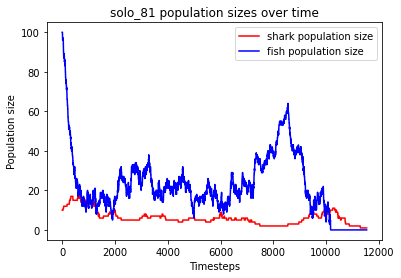

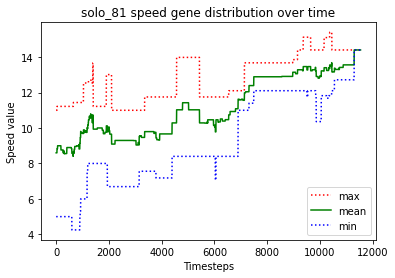

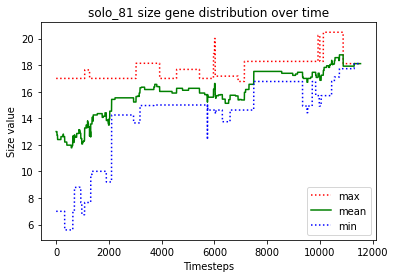

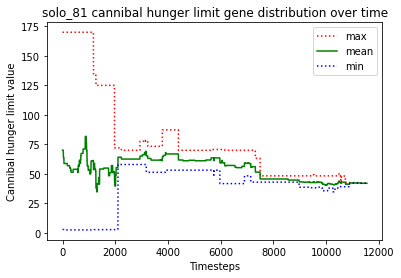

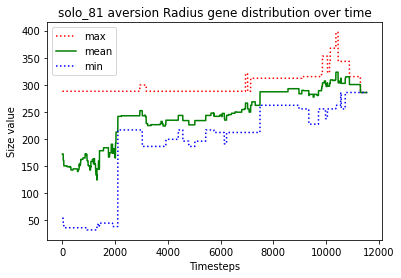

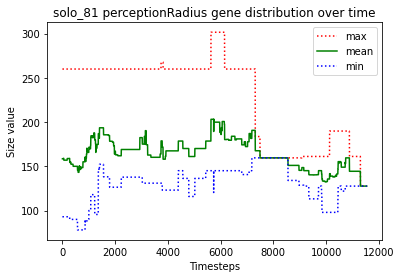

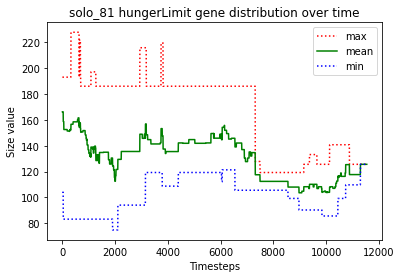





						SOLO_82

predator_7 just gave birth to predator_10
predator_0 just gave birth to predator_11
predator_6 just gave birth to predator_12
predator_4 just gave birth to predator_13
predator_3 just gave birth to predator_14
predator_14 just gave birth to predator_15
predator_3 killed predator_15
predator_5 just gave birth to predator_16
predator_5 killed predator_16
predator_0 just gave birth to predator_17
predator_7 starved to death
predator_10 ate the carcass of predator_7_carcass
predator_14 starved to death
predator_0 just gave birth to predator_18
predator_11 ate the carcass of predator_14_carcass
predator_18 just gave birth to predator_19
predator_19 killed predator_0
predator_18 starved to death
predator_3 ate the carcass of predator_18_carcass
predator_13 just gave birth to predator_20
predator_13 killed predator_20
predator_17 just gave birth to predator_21
predator_21 killed predator_5
predator_12 starved to death
predator_9 ate the carcass of predator_12_carcass
predat

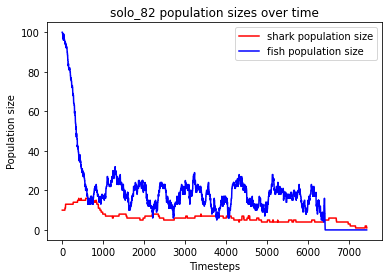

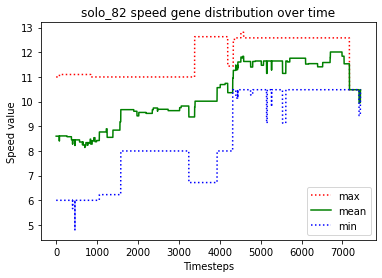

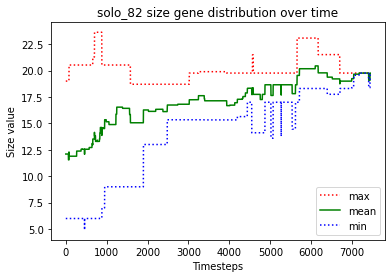

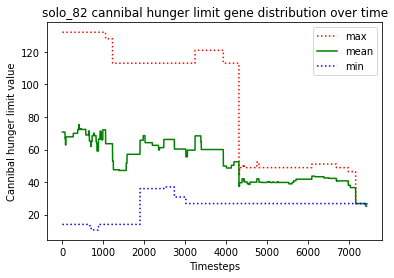

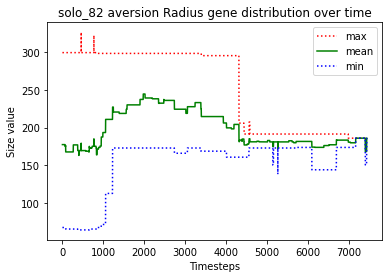

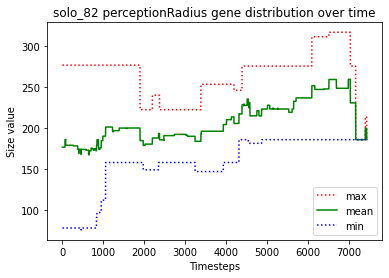

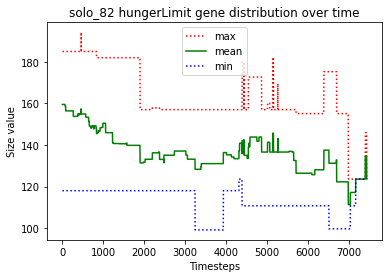





						SOLO_83

predator_1 just gave birth to predator_10
predator_7 just gave birth to predator_11
predator_3 just gave birth to predator_12
predator_0 just gave birth to predator_13
predator_13 killed predator_10
predator_5 just gave birth to predator_14
predator_6 just gave birth to predator_15
predator_14 just gave birth to predator_16
predator_13 killed predator_15
predator_0 killed predator_1
predator_16 killed predator_3
predator_16 killed predator_2
predator_5 just gave birth to predator_17
predator_0 killed predator_6
predator_17 killed predator_13
predator_14 starved to death
predator_12 just gave birth to predator_18
predator_12 starved to death
predator_18 starved to death
predator_8 ate the carcass of predator_18_carcass
predator_8 ate the carcass of predator_12_carcass
predator_8 just gave birth to predator_19
predator_4 ate the carcass of predator_14_carcass
predator_17 killed predator_7
predator_17 just gave birth to predator_20
predator_20 killed predator_8
predator

predator_36 starved to death
predator_69 ate the carcass of predator_36_carcass
predator_67 just gave birth to predator_73
predator_67 just gave birth to predator_74
predator_68 starved to death
predator_73 ate the carcass of predator_68_carcass
predator_67 starved to death
predator_74 ate the carcass of predator_67_carcass
predator_71 starved to death
predator_69 ate the carcass of predator_71_carcass
predator_74 starved to death
predator_54 ate the carcass of predator_74_carcass
predator_69 starved to death
predator_4 ate the carcass of predator_69_carcass
predator_57 starved to death
predator_54 ate the carcass of predator_57_carcass
predator_4 starved to death
predator_61 ate the carcass of predator_4_carcass
predator_73 starved to death
predator_54 ate the carcass of predator_73_carcass
predator_61 just gave birth to predator_75
predator_61 starved to death
predator_75 starved to death
predator_54 starved to death


finished this run because predators went extinct
Fish left: 0
Sha

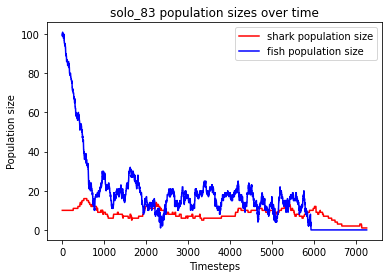

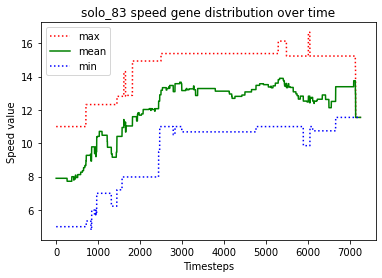

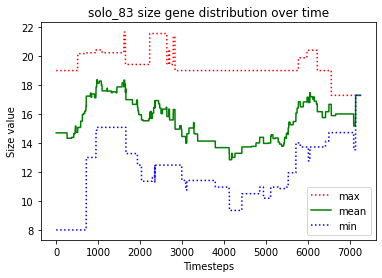

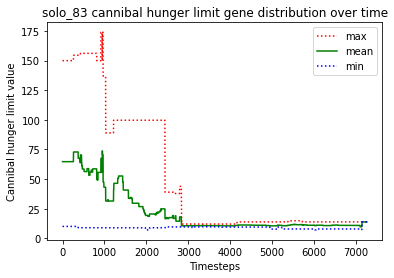

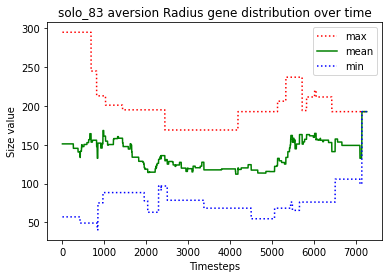

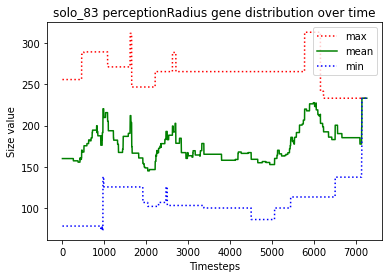

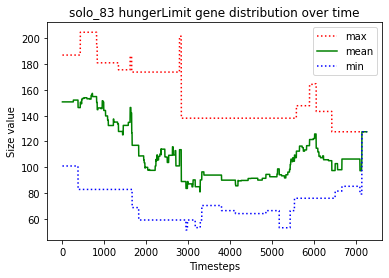





						SOLO_84

predator_7 just gave birth to predator_10
predator_10 killed predator_3
predator_10 killed predator_9
predator_7 killed predator_5
predator_10 killed predator_4
predator_2 just gave birth to predator_11
predator_7 just gave birth to predator_12
predator_1 just gave birth to predator_13
predator_10 killed predator_11
predator_10 killed predator_13
predator_10 killed predator_0
predator_12 starved to death
predator_7 just gave birth to predator_14
predator_10 ate the carcass of predator_12_carcass
predator_2 just gave birth to predator_15
predator_2 starved to death
predator_15 ate the carcass of predator_2_carcass
predator_7 just gave birth to predator_16
predator_7 killed predator_16
predator_1 starved to death
predator_8 ate the carcass of predator_1_carcass
predator_10 killed predator_6
predator_8 just gave birth to predator_17
predator_7 just gave birth to predator_18
predator_18 starved to death
predator_7 ate the carcass of predator_18_carcass
predator_8 starved

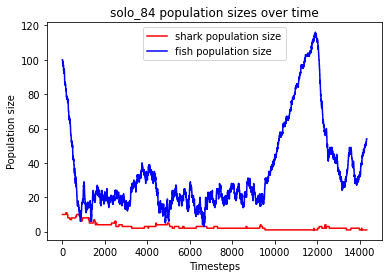

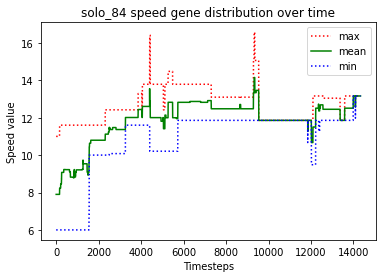

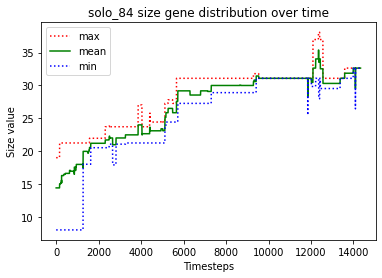

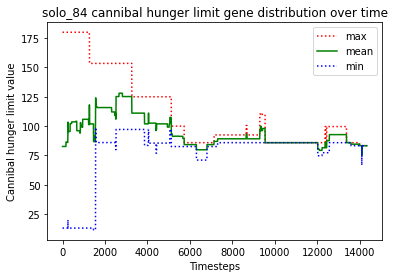

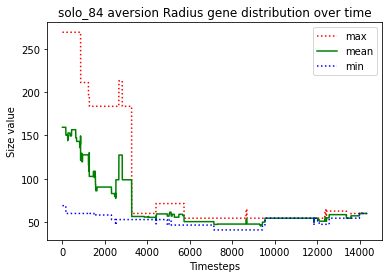

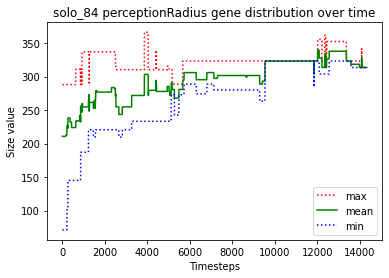

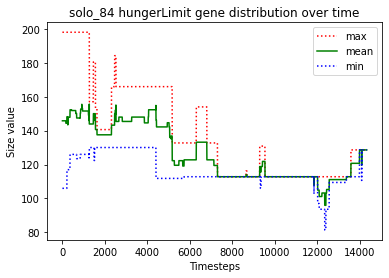





						SOLO_85

predator_2 just gave birth to predator_10
predator_6 just gave birth to predator_11
predator_11 just gave birth to predator_12
predator_2 just gave birth to predator_13
predator_12 starved to death
predator_4 ate the carcass of predator_12_carcass
predator_2 just gave birth to predator_14
predator_2 killed predator_14
predator_10 just gave birth to predator_15
predator_10 killed predator_15
predator_4 just gave birth to predator_16
predator_7 just gave birth to predator_17
predator_13 starved to death
predator_17 just gave birth to predator_18
predator_0 ate the carcass of predator_13_carcass
predator_18 starved to death
predator_9 ate the carcass of predator_18_carcass
predator_10 just gave birth to predator_19
predator_3 just gave birth to predator_20
predator_16 killed predator_7
predator_17 starved to death
predator_19 ate the carcass of predator_17_carcass
predator_11 just gave birth to predator_21
predator_21 starved to death
predator_10 just gave birth to pred

predator_71 just gave birth to predator_72
predator_62 starved to death
predator_70 starved to death
predator_72 ate the carcass of predator_70_carcass
predator_26 just gave birth to predator_73
predator_72 starved to death
predator_68 ate the carcass of predator_72_carcass
predator_57 just gave birth to predator_74
predator_74 just gave birth to predator_75
predator_73 starved to death
predator_67 ate the carcass of predator_73_carcass
predator_71 ate the carcass of predator_62_carcass
predator_68 just gave birth to predator_76
predator_75 killed predator_26
predator_67 just gave birth to predator_77
predator_57 starved to death
predator_71 just gave birth to predator_78
predator_74 just gave birth to predator_79
predator_56 just gave birth to predator_80
predator_77 ate the carcass of predator_57_carcass
predator_76 killed predator_80
predator_67 just gave birth to predator_81
predator_79 killed predator_56
predator_75 just gave birth to predator_82
predator_77 starved to death
preda

predator_120 just gave birth to predator_138
predator_125 just gave birth to predator_139
predator_137 killed predator_132
predator_137 killed predator_133
predator_129 starved to death
predator_137 just gave birth to predator_140
predator_136 starved to death
predator_115 ate the carcass of predator_136_carcass
predator_137 killed predator_126
predator_137 killed predator_111
predator_120 ate the carcass of predator_129_carcass
predator_137 killed predator_138
predator_131 starved to death
predator_137 just gave birth to predator_141
predator_141 killed predator_115
predator_139 ate the carcass of predator_131_carcass
predator_141 killed predator_120
predator_130 just gave birth to predator_142
predator_125 just gave birth to predator_143
no fish to move
predator_142 starved to death
predator_143 ate the carcass of predator_142_carcass
predator_137 just gave birth to predator_144
predator_137 killed predator_144
predator_143 just gave birth to predator_145
predator_143 killed predator

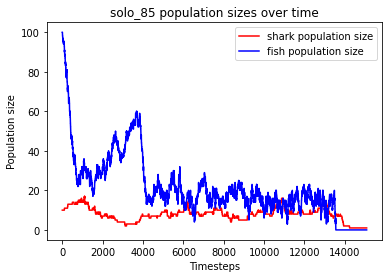

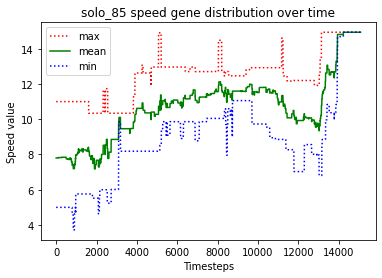

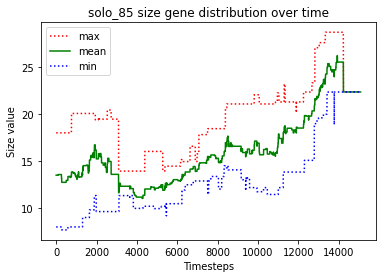

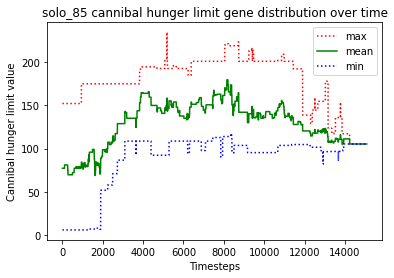

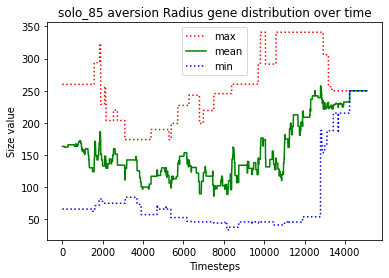

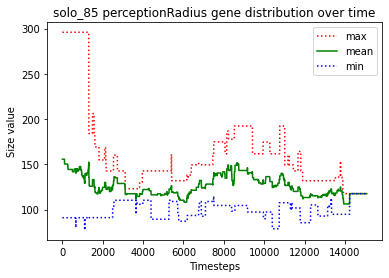

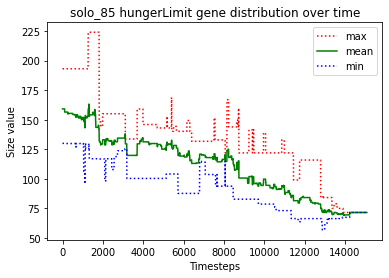





						SOLO_86

predator_3 just gave birth to predator_10
predator_7 just gave birth to predator_11
predator_1 just gave birth to predator_12
predator_6 just gave birth to predator_13
predator_12 killed predator_7
predator_12 killed predator_11
predator_12 killed predator_8
predator_9 just gave birth to predator_14
predator_9 killed predator_14
predator_0 just gave birth to predator_15
predator_15 killed predator_3
predator_15 killed predator_10
predator_5 just gave birth to predator_16
predator_15 killed predator_13
predator_16 starved to death
predator_5 starved to death
predator_1 ate the carcass of predator_16_carcass
predator_0 just gave birth to predator_17
predator_15 ate the carcass of predator_5_carcass
predator_15 just gave birth to predator_18
predator_17 killed predator_4
predator_17 starved to death
predator_18 starved to death
predator_1 ate the carcass of predator_18_carcass
predator_15 ate the carcass of predator_17_carcass
predator_0 starved to death
predator_1 ate 

predator_58 ate the carcass of predator_66_carcass
predator_61 just gave birth to predator_72
predator_72 starved to death
predator_61 starved to death
predator_71 starved to death
predator_46 ate the carcass of predator_61_carcass
predator_46 ate the carcass of predator_72_carcass
predator_46 just gave birth to predator_73
predator_73 ate the carcass of predator_71_carcass
predator_46 starved to death
predator_73 ate the carcass of predator_46_carcass
predator_64 starved to death
predator_73 ate the carcass of predator_64_carcass
predator_58 just gave birth to predator_74
predator_73 starved to death
predator_58 starved to death
predator_74 starved to death
predator_67 starved to death


finished this run because predators went extinct
Fish left: 0
Sharks left: 0
Dead sharks: 75
Timesteps passed: 8677
Fish went extinct at timestep 7895
Sharks went extinct at timestep 8677


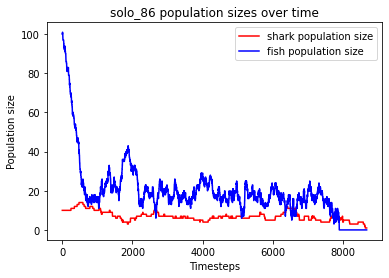

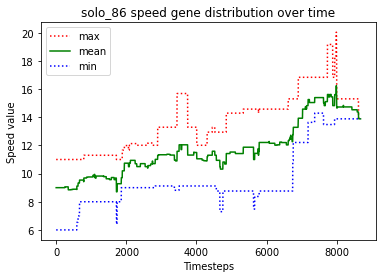

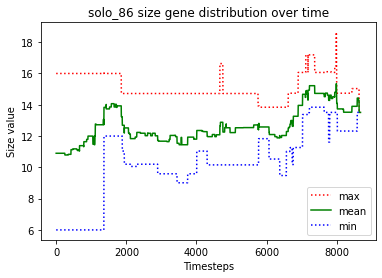

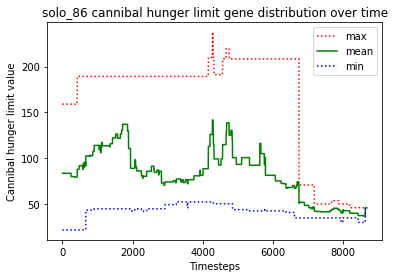

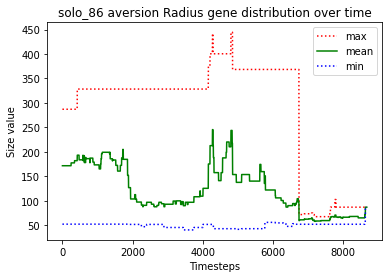

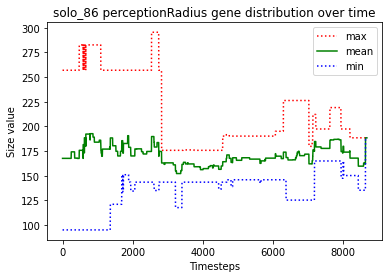

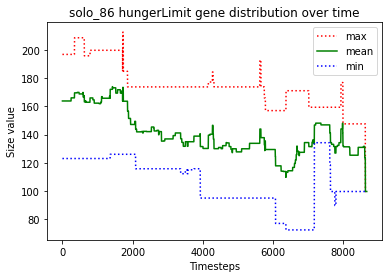





						SOLO_87

predator_4 just gave birth to predator_10
predator_7 just gave birth to predator_11
predator_7 killed predator_11
predator_7 killed predator_4
predator_7 killed predator_10
predator_7 killed predator_3
predator_7 killed predator_1
predator_7 killed predator_5
predator_7 killed predator_2
predator_0 just gave birth to predator_12
predator_0 starved to death
predator_12 starved to death
predator_7 ate the carcass of predator_0_carcass
predator_7 ate the carcass of predator_12_carcass
predator_6 just gave birth to predator_13
predator_6 just gave birth to predator_14
predator_14 just gave birth to predator_15
predator_8 just gave birth to predator_16
predator_15 just gave birth to predator_17
predator_14 just gave birth to predator_18
predator_8 starved to death
predator_17 just gave birth to predator_19
predator_14 ate the carcass of predator_8_carcass
predator_17 starved to death
predator_15 ate the carcass of predator_17_carcass
predator_14 just gave birth to predato

predator_7 just gave birth to predator_74
predator_61 killed predator_71
no fish to move
predator_70 just gave birth to predator_75
predator_70 killed predator_75
predator_72 starved to death
predator_57 ate the carcass of predator_72_carcass
predator_61 just gave birth to predator_76
predator_74 starved to death
predator_70 ate the carcass of predator_74_carcass
predator_73 just gave birth to predator_77
predator_76 starved to death
predator_61 starved to death
predator_57 ate the carcass of predator_76_carcass
predator_73 ate the carcass of predator_61_carcass
predator_59 just gave birth to predator_78
predator_7 starved to death
predator_78 ate the carcass of predator_7_carcass
predator_77 starved to death
predator_73 starved to death
predator_70 starved to death
predator_59 ate the carcass of predator_70_carcass
predator_57 ate the carcass of predator_77_carcass
predator_59 starved to death
predator_78 ate the carcass of predator_59_carcass
predator_78 just gave birth to predator_7

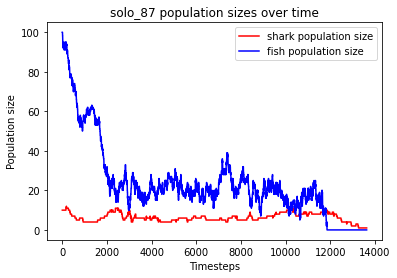

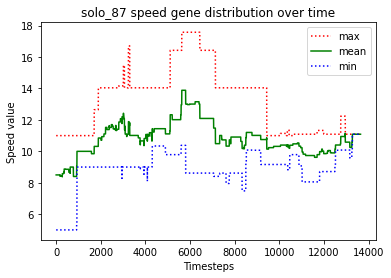

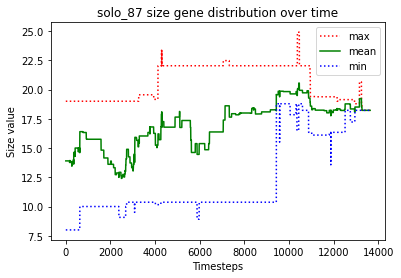

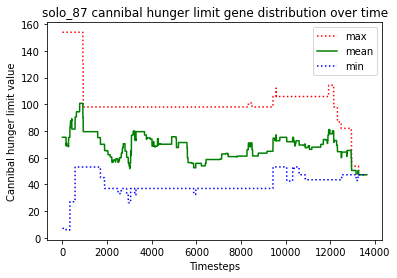

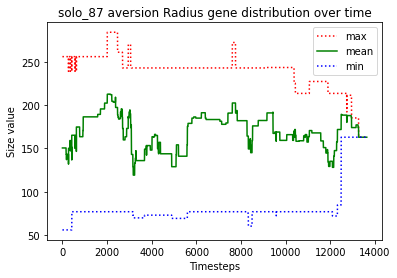

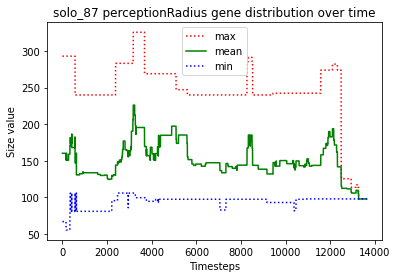

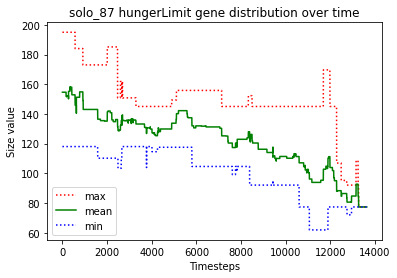





						SOLO_88

predator_1 just gave birth to predator_10
predator_9 just gave birth to predator_11
predator_0 just gave birth to predator_12
predator_10 just gave birth to predator_13
predator_4 just gave birth to predator_14
predator_10 just gave birth to predator_15
predator_10 killed predator_15
predator_10 just gave birth to predator_16
predator_10 killed predator_16
predator_9 just gave birth to predator_17
predator_1 just gave birth to predator_18
predator_2 just gave birth to predator_19
predator_9 starved to death
predator_13 ate the carcass of predator_9_carcass
predator_19 killed predator_13
predator_1 starved to death
predator_17 starved to death
predator_11 starved to death
predator_10 ate the carcass of predator_17_carcass
predator_6 ate the carcass of predator_11_carcass
predator_18 starved to death
predator_14 ate the carcass of predator_1_carcass
predator_0 starved to death
predator_10 ate the carcass of predator_18_carcass
predator_2 killed predator_5
predator_12 j

predator_68 starved to death
predator_69 starved to death
predator_34 ate the carcass of predator_73_carcass
predator_34 ate the carcass of predator_69_carcass
predator_61 starved to death
predator_57 ate the carcass of predator_68_carcass
predator_72 starved to death
predator_34 ate the carcass of predator_61_carcass
predator_34 ate the carcass of predator_72_carcass
predator_57 just gave birth to predator_74
predator_70 starved to death
predator_57 starved to death
predator_74 ate the carcass of predator_70_carcass
predator_74 ate the carcass of predator_57_carcass
predator_74 starved to death
predator_34 starved to death


finished this run because predators went extinct
Fish left: 0
Sharks left: 0
Dead sharks: 75
Timesteps passed: 13450
Fish went extinct at timestep 12652
Sharks went extinct at timestep 13450


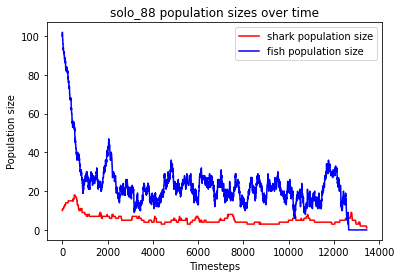

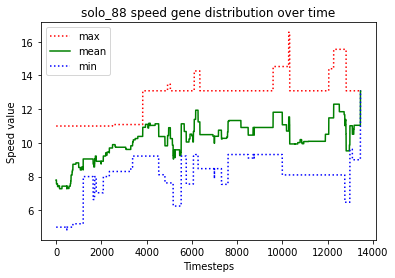

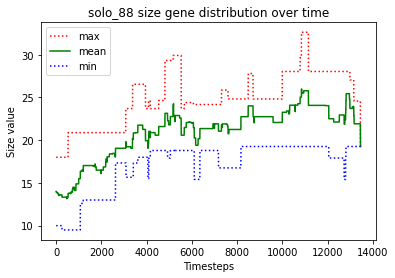

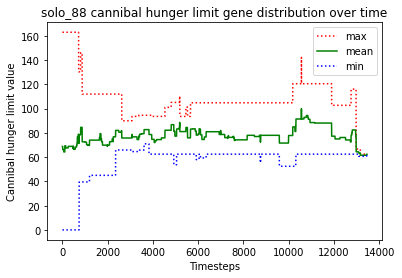

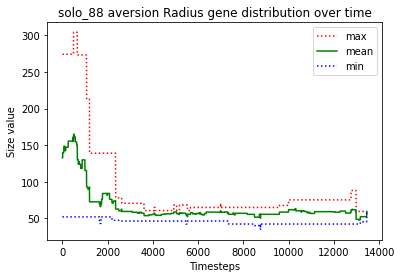

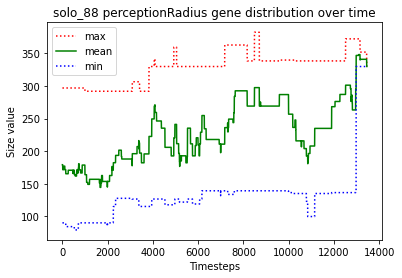

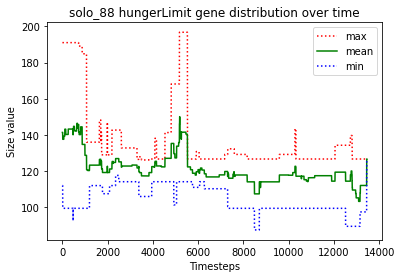





						SOLO_89

predator_9 just gave birth to predator_10
predator_6 just gave birth to predator_11
predator_11 just gave birth to predator_12
predator_7 just gave birth to predator_13
predator_2 just gave birth to predator_14
predator_8 just gave birth to predator_15
predator_9 just gave birth to predator_16
predator_9 killed predator_16
predator_10 just gave birth to predator_17
predator_10 killed predator_17
predator_2 just gave birth to predator_18
predator_9 just gave birth to predator_19
predator_2 killed predator_7
predator_2 killed predator_13
predator_11 starved to death
predator_12 starved to death
predator_14 ate the carcass of predator_12_carcass
predator_15 ate the carcass of predator_11_carcass
predator_9 starved to death
predator_14 ate the carcass of predator_9_carcass
predator_6 just gave birth to predator_20
predator_6 starved to death
predator_20 starved to death
predator_0 ate the carcass of predator_20_carcass
predator_0 ate the carcass of predator_6_carcass
pre

predator_68 ate the carcass of predator_72_carcass
predator_68 ate the carcass of predator_71_carcass
predator_52 ate the carcass of predator_60_carcass
predator_52 just gave birth to predator_73
predator_64 starved to death
predator_69 ate the carcass of predator_64_carcass
predator_73 just gave birth to predator_74
predator_74 starved to death
predator_73 starved to death
predator_52 starved to death
predator_68 ate the carcass of predator_74_carcass
predator_57 ate the carcass of predator_52_carcass
predator_57 ate the carcass of predator_73_carcass
predator_61 starved to death
predator_69 starved to death
predator_68 ate the carcass of predator_69_carcass
predator_68 ate the carcass of predator_61_carcass
predator_57 starved to death
predator_68 ate the carcass of predator_57_carcass
predator_68 starved to death


finished this run because predators went extinct
Fish left: 0
Sharks left: 0
Dead sharks: 75
Timesteps passed: 9391
Fish went extinct at timestep 7505
Sharks went extinct

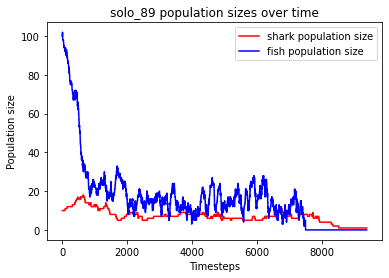

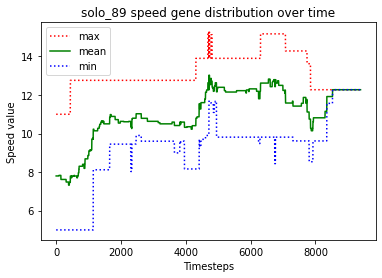

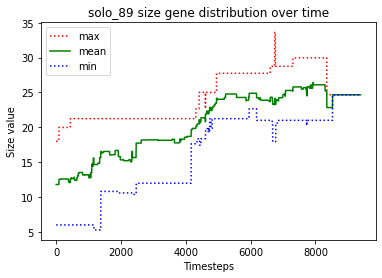

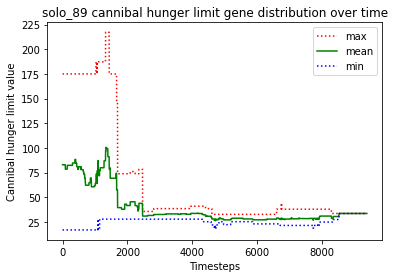

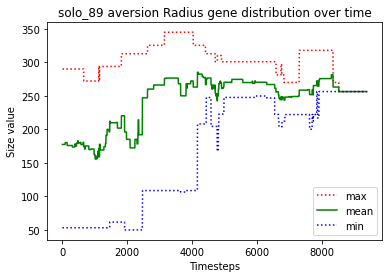

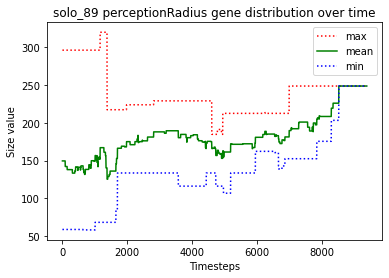

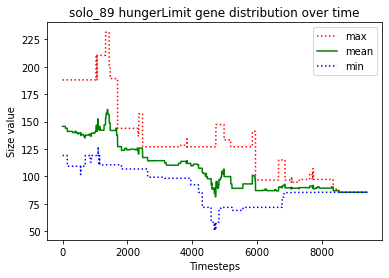





						SOLO_90

predator_5 just gave birth to predator_10
predator_3 just gave birth to predator_11
predator_7 just gave birth to predator_12
predator_12 just gave birth to predator_13
predator_2 just gave birth to predator_14
predator_8 just gave birth to predator_15
predator_1 just gave birth to predator_16
predator_13 just gave birth to predator_17
predator_17 just gave birth to predator_18
predator_18 starved to death
predator_17 starved to death
predator_7 just gave birth to predator_19
predator_13 starved to death
predator_9 just gave birth to predator_20
predator_9 ate the carcass of predator_13_carcass
predator_15 ate the carcass of predator_17_carcass
predator_12 starved to death
predator_15 ate the carcass of predator_18_carcass
predator_16 ate the carcass of predator_12_carcass
predator_20 killed predator_5
predator_11 starved to death
predator_14 just gave birth to predator_21
predator_0 ate the carcass of predator_11_carcass
predator_14 killed predator_15
predator_20 ki

predator_69 killed predator_70
predator_62 ate the carcass of predator_68_carcass
predator_69 killed predator_65
predator_57 just gave birth to predator_71
predator_57 starved to death
predator_71 starved to death
predator_64 ate the carcass of predator_71_carcass
predator_64 ate the carcass of predator_57_carcass
predator_64 just gave birth to predator_72
predator_64 starved to death
predator_69 ate the carcass of predator_64_carcass
predator_55 starved to death
predator_69 ate the carcass of predator_55_carcass
predator_72 starved to death
predator_67 just gave birth to predator_73
predator_67 just gave birth to predator_74
predator_73 ate the carcass of predator_72_carcass
predator_67 just gave birth to predator_75
predator_75 starved to death
predator_67 starved to death
predator_62 ate the carcass of predator_67_carcass
predator_69 ate the carcass of predator_75_carcass
predator_74 starved to death
predator_69 ate the carcass of predator_74_carcass
predator_73 just gave birth to p

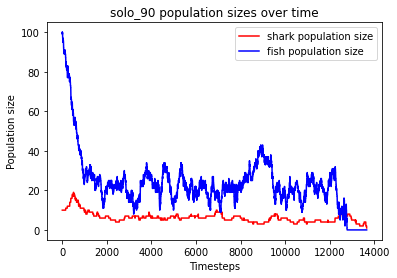

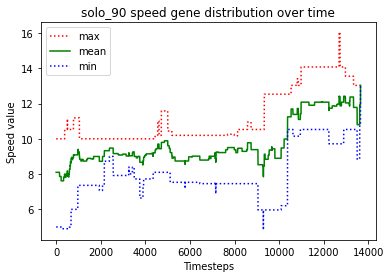

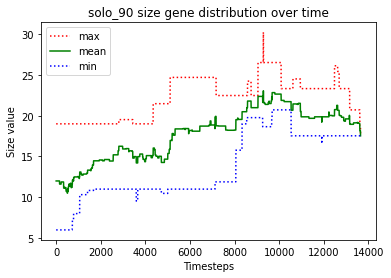

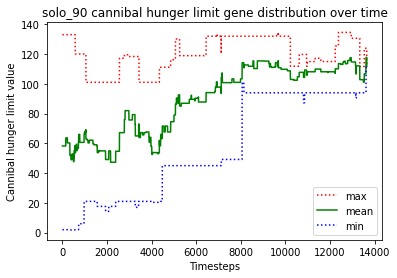

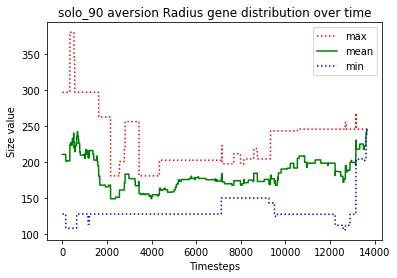

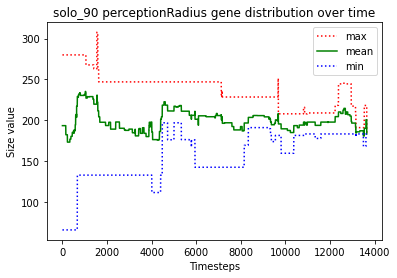

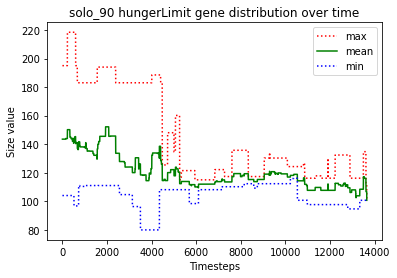





						SOLO_91

predator_9 just gave birth to predator_10
predator_5 just gave birth to predator_11
predator_8 just gave birth to predator_12
predator_0 just gave birth to predator_13
predator_9 starved to death
predator_10 starved to death
predator_4 ate the carcass of predator_9_carcass
predator_11 ate the carcass of predator_10_carcass
predator_13 just gave birth to predator_14
predator_11 killed predator_2
predator_0 just gave birth to predator_15
predator_8 just gave birth to predator_16
predator_5 just gave birth to predator_17
predator_16 killed predator_1
predator_14 starved to death
predator_4 ate the carcass of predator_14_carcass
predator_15 starved to death
predator_17 starved to death
predator_8 ate the carcass of predator_15_carcass
predator_5 starved to death
predator_13 starved to death
predator_6 ate the carcass of predator_13_carcass
predator_16 ate the carcass of predator_5_carcass
predator_0 starved to death
predator_4 ate the carcass of predator_17_carcass
preda

predator_64 starved to death
predator_68 starved to death
predator_67 just gave birth to predator_69
predator_62 ate the carcass of predator_64_carcass
predator_40 ate the carcass of predator_68_carcass
predator_69 just gave birth to predator_70
predator_61 just gave birth to predator_71
predator_69 starved to death
predator_70 ate the carcass of predator_69_carcass
predator_40 just gave birth to predator_72
predator_61 starved to death
predator_67 ate the carcass of predator_61_carcass
predator_71 starved to death
predator_67 ate the carcass of predator_71_carcass
predator_70 starved to death
predator_67 ate the carcass of predator_70_carcass
predator_67 just gave birth to predator_73
predator_72 just gave birth to predator_74
predator_74 starved to death
predator_72 ate the carcass of predator_74_carcass
predator_72 just gave birth to predator_75
predator_67 starved to death
predator_72 ate the carcass of predator_67_carcass
predator_62 just gave birth to predator_76
predator_75 star

predator_122 ate the carcass of predator_124_carcass
predator_123 starved to death
predator_118 ate the carcass of predator_123_carcass
predator_128 just gave birth to predator_129
predator_129 just gave birth to predator_130
predator_109 just gave birth to predator_131
predator_130 just gave birth to predator_132
predator_130 starved to death
predator_132 starved to death
predator_129 starved to death
predator_109 ate the carcass of predator_130_carcass
predator_109 ate the carcass of predator_132_carcass
predator_122 ate the carcass of predator_129_carcass
predator_121 just gave birth to predator_133
predator_122 just gave birth to predator_134
no fish to move
predator_128 starved to death
predator_111 ate the carcass of predator_128_carcass
predator_118 just gave birth to predator_135
predator_134 starved to death
predator_111 ate the carcass of predator_134_carcass
predator_118 starved to death
predator_135 starved to death
predator_122 starved to death
predator_133 ate the carcass

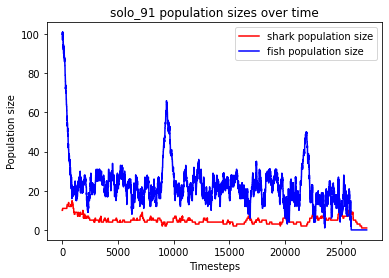

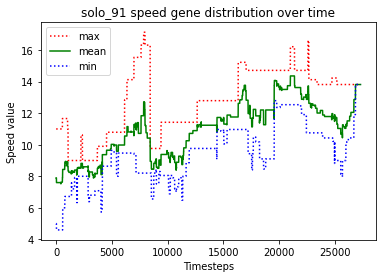

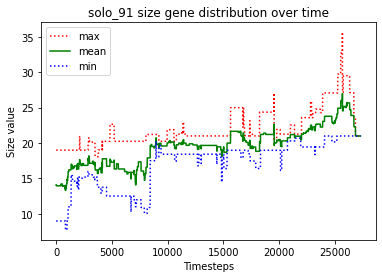

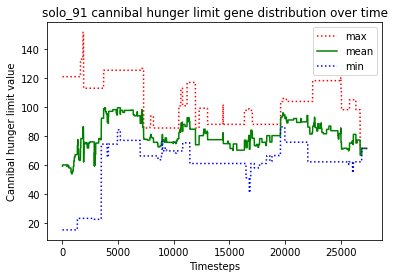

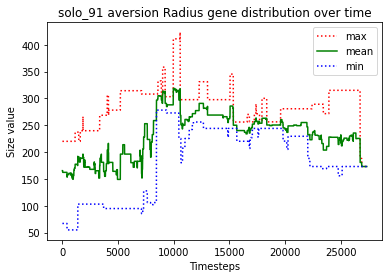

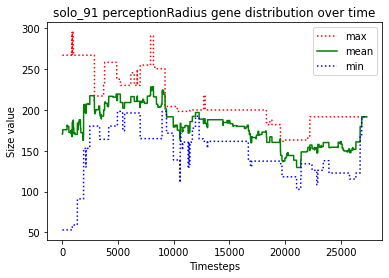

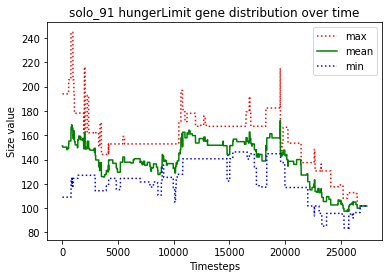





						SOLO_92

predator_7 just gave birth to predator_10
predator_6 just gave birth to predator_11
predator_6 just gave birth to predator_12
predator_7 just gave birth to predator_13
predator_6 starved to death
predator_11 starved to death
predator_12 starved to death
predator_9 ate the carcass of predator_6_carcass
predator_9 ate the carcass of predator_11_carcass
predator_13 ate the carcass of predator_12_carcass
predator_2 just gave birth to predator_14
predator_4 just gave birth to predator_15
predator_4 just gave birth to predator_16
predator_13 just gave birth to predator_17
predator_17 killed predator_5
predator_17 killed predator_14
predator_1 just gave birth to predator_18
predator_18 killed predator_4
predator_16 starved to death
predator_1 ate the carcass of predator_16_carcass
predator_18 killed predator_15
predator_17 killed predator_8
predator_13 starved to death
predator_18 ate the carcass of predator_13_carcass
predator_18 killed predator_2
predator_17 killed predat

predator_63 starved to death
predator_71 starved to death
predator_65 ate the carcass of predator_63_carcass
predator_60 ate the carcass of predator_71_carcass
predator_66 starved to death
predator_70 starved to death
predator_65 ate the carcass of predator_66_carcass
predator_52 ate the carcass of predator_70_carcass
predator_60 starved to death
predator_52 starved to death
predator_65 starved to death


finished this run because predators went extinct
Fish left: 0
Sharks left: 0
Dead sharks: 72
Timesteps passed: 10707
Fish went extinct at timestep 9849
Sharks went extinct at timestep 10707


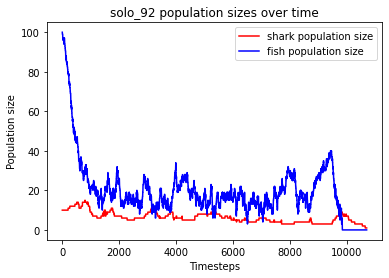

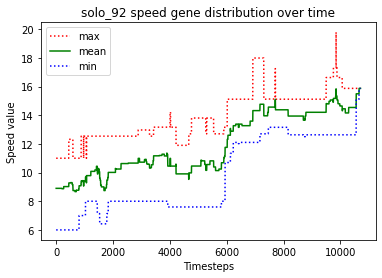

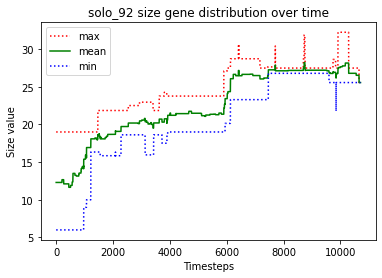

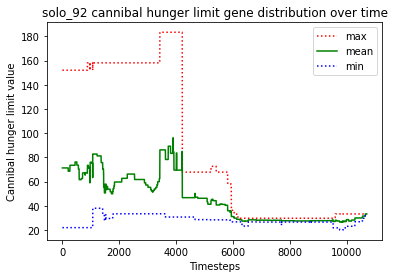

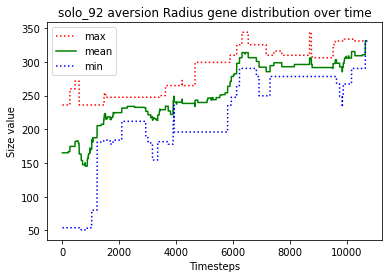

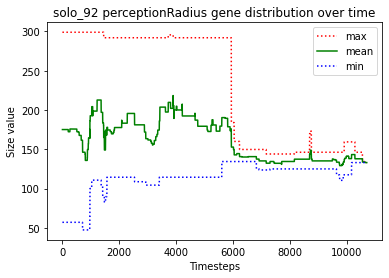

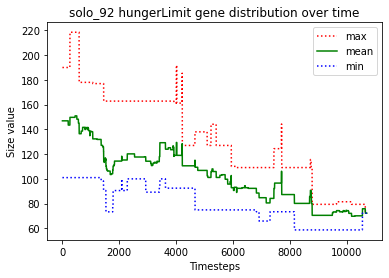





						SOLO_93

predator_5 just gave birth to predator_10
predator_5 just gave birth to predator_11
predator_0 just gave birth to predator_12
predator_4 just gave birth to predator_13
predator_11 starved to death
predator_9 ate the carcass of predator_11_carcass
predator_13 just gave birth to predator_14
predator_14 just gave birth to predator_15
predator_15 killed predator_5
predator_14 just gave birth to predator_16
predator_10 starved to death
predator_1 ate the carcass of predator_10_carcass
predator_16 starved to death
predator_13 killed predator_9
predator_15 killed predator_2
predator_14 starved to death
predator_8 ate the carcass of predator_16_carcass
predator_4 ate the carcass of predator_14_carcass
predator_3 just gave birth to predator_17
predator_15 killed predator_17
predator_6 just gave birth to predator_18
predator_6 killed predator_18
predator_15 killed predator_3
predator_15 just gave birth to predator_19
predator_0 starved to death
predator_1 ate the carcass of pr

predator_68 just gave birth to predator_76
predator_43 just gave birth to predator_77
predator_62 ate the carcass of predator_73_carcass
predator_46 just gave birth to predator_78
predator_77 starved to death
predator_71 starved to death
predator_62 ate the carcass of predator_71_carcass
predator_75 starved to death
predator_70 starved to death
predator_72 ate the carcass of predator_70_carcass
predator_43 just gave birth to predator_79
predator_76 starved to death
predator_63 just gave birth to predator_80
predator_79 ate the carcass of predator_76_carcass
predator_46 ate the carcass of predator_77_carcass
predator_80 just gave birth to predator_81
predator_62 ate the carcass of predator_75_carcass
predator_80 just gave birth to predator_82
predator_78 starved to death
predator_43 ate the carcass of predator_78_carcass
predator_63 just gave birth to predator_83
predator_80 starved to death
predator_82 starved to death
predator_81 starved to death
predator_72 ate the carcass of predato

predator_132 just gave birth to predator_137
predator_119 just gave birth to predator_138
predator_119 killed predator_138
predator_137 starved to death
predator_129 ate the carcass of predator_137_carcass
predator_135 just gave birth to predator_139
predator_139 starved to death
predator_135 starved to death
predator_132 ate the carcass of predator_135_carcass
predator_119 just gave birth to predator_140
predator_140 ate the carcass of predator_139_carcass
predator_140 just gave birth to predator_141
predator_129 killed predator_141
predator_106 just gave birth to predator_142
predator_132 just gave birth to predator_143
predator_143 starved to death
predator_132 starved to death
predator_142 ate the carcass of predator_132_carcass
predator_106 ate the carcass of predator_143_carcass
predator_119 just gave birth to predator_144
predator_119 just gave birth to predator_145
predator_119 just gave birth to predator_146
predator_146 starved to death
predator_145 just gave birth to predato

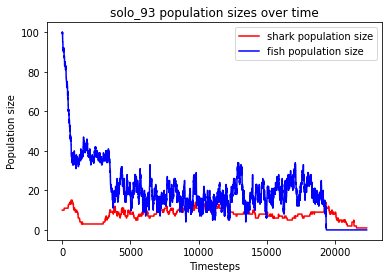

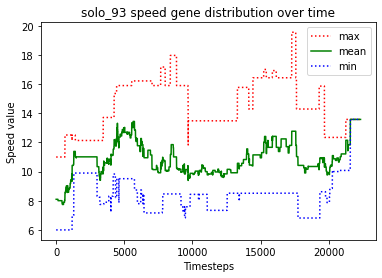

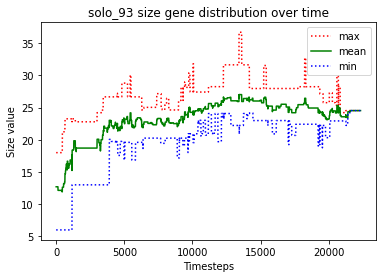

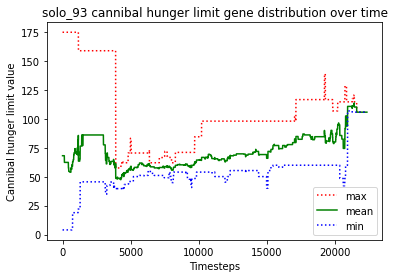

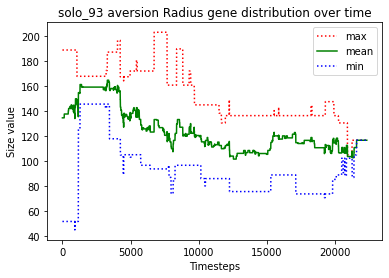

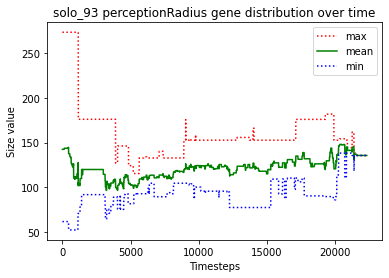

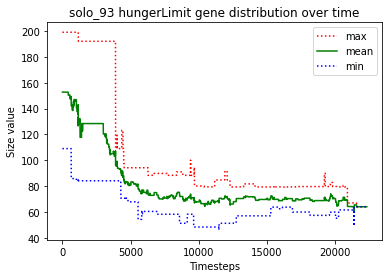





						SOLO_94

predator_9 just gave birth to predator_10
predator_1 just gave birth to predator_11
predator_10 just gave birth to predator_12
predator_5 just gave birth to predator_13
predator_10 killed predator_3
predator_8 just gave birth to predator_14
predator_12 just gave birth to predator_15
predator_5 just gave birth to predator_16
predator_2 just gave birth to predator_17
predator_15 starved to death
predator_14 just gave birth to predator_18
predator_4 ate the carcass of predator_15_carcass
predator_2 just gave birth to predator_19
predator_17 killed predator_19
predator_12 starved to death
predator_2 just gave birth to predator_20
predator_18 just gave birth to predator_21
predator_2 killed predator_8
predator_16 killed predator_14
predator_0 ate the carcass of predator_12_carcass
predator_18 starved to death
predator_21 just gave birth to predator_22
predator_21 starved to death
predator_4 ate the carcass of predator_18_carcass
predator_22 starved to death
predator_20 st

predator_68 just gave birth to predator_70
predator_54 starved to death
predator_58 starved to death
predator_50 ate the carcass of predator_58_carcass
predator_56 ate the carcass of predator_54_carcass
predator_66 starved to death
predator_70 ate the carcass of predator_66_carcass
predator_29 starved to death
predator_69 starved to death
predator_70 ate the carcass of predator_29_carcass
predator_68 ate the carcass of predator_69_carcass
predator_50 just gave birth to predator_71
predator_70 just gave birth to predator_72
predator_50 starved to death
predator_56 ate the carcass of predator_50_carcass
predator_68 just gave birth to predator_73
predator_71 just gave birth to predator_74
predator_73 starved to death
predator_68 ate the carcass of predator_73_carcass
predator_68 just gave birth to predator_75
predator_71 just gave birth to predator_76
no fish to move
predator_72 just gave birth to predator_77
predator_68 just gave birth to predator_78
predator_75 just gave birth to predat

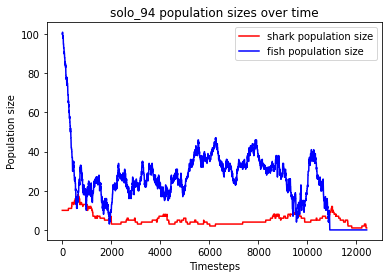

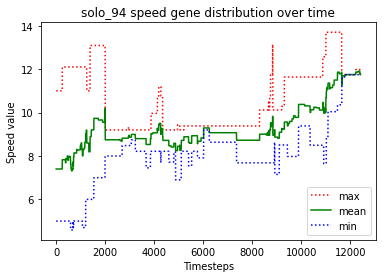

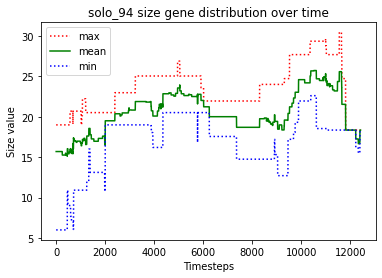

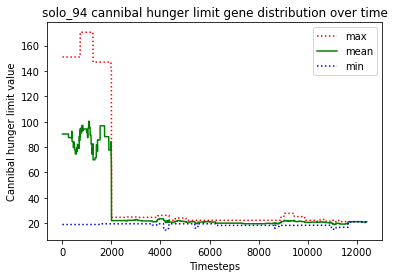

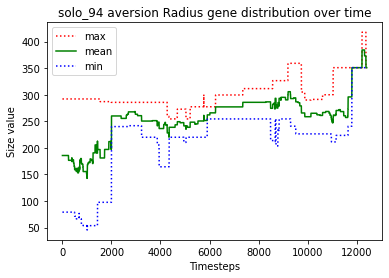

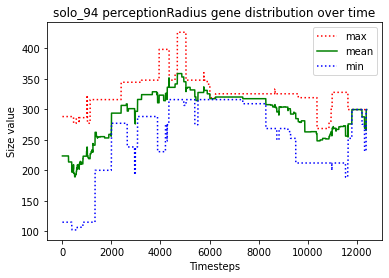

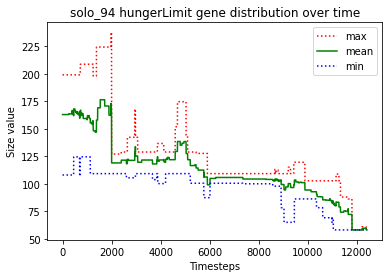





						SOLO_95

predator_5 just gave birth to predator_10
predator_2 just gave birth to predator_11
predator_11 killed predator_4
predator_11 killed predator_1
predator_3 just gave birth to predator_12
predator_11 killed predator_12
predator_11 killed predator_3
predator_11 killed predator_7
predator_11 just gave birth to predator_13
predator_8 just gave birth to predator_14
predator_10 starved to death
predator_6 ate the carcass of predator_10_carcass
predator_2 just gave birth to predator_15
predator_13 killed predator_15
predator_0 just gave birth to predator_16
predator_11 killed predator_16
predator_13 starved to death
predator_6 ate the carcass of predator_13_carcass
predator_0 just gave birth to predator_17
predator_5 starved to death
predator_11 starved to death
predator_17 ate the carcass of predator_11_carcass
predator_6 ate the carcass of predator_5_carcass
predator_8 starved to death
predator_9 ate the carcass of predator_8_carcass
predator_14 starved to death
predator_9

predator_73 starved to death
predator_63 ate the carcass of predator_73_carcass
predator_48 just gave birth to predator_75
predator_32 starved to death
predator_74 starved to death
predator_44 starved to death
predator_57 just gave birth to predator_76
predator_57 ate the carcass of predator_74_carcass
predator_72 starved to death
predator_75 killed predator_76
predator_66 ate the carcass of predator_44_carcass
predator_66 ate the carcass of predator_32_carcass
predator_66 ate the carcass of predator_72_carcass
predator_75 killed predator_65
predator_29 just gave birth to predator_77
predator_77 just gave birth to predator_78
predator_29 just gave birth to predator_79
predator_29 killed predator_79
predator_77 killed predator_63
predator_48 just gave birth to predator_80
predator_80 just gave birth to predator_81
predator_75 just gave birth to predator_82
predator_81 killed predator_48
predator_81 killed predator_57
predator_77 just gave birth to predator_83
predator_81 killed predator

predator_81 starved to death
predator_133 ate the carcass of predator_81_carcass
predator_77 just gave birth to predator_139
predator_118 starved to death
predator_52 just gave birth to predator_140
predator_140 killed predator_132
predator_52 just gave birth to predator_141
predator_140 killed predator_141
predator_133 ate the carcass of predator_118_carcass
predator_52 just gave birth to predator_142
predator_134 starved to death
predator_75 ate the carcass of predator_134_carcass
predator_52 starved to death
predator_117 ate the carcass of predator_52_carcass
predator_117 just gave birth to predator_143
predator_129 just gave birth to predator_144
predator_139 starved to death
predator_77 starved to death
predator_135 ate the carcass of predator_77_carcass
predator_137 ate the carcass of predator_139_carcass
predator_137 starved to death
predator_140 ate the carcass of predator_137_carcass
predator_129 just gave birth to predator_145
predator_145 starved to death
predator_129 starve

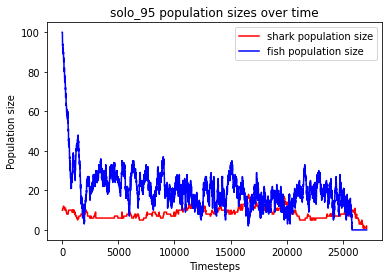

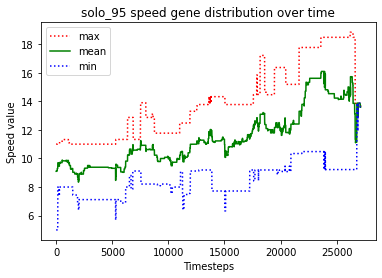

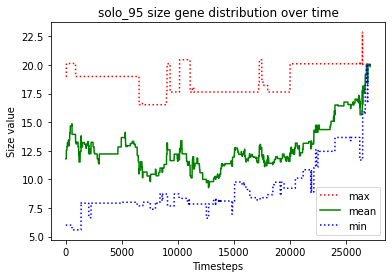

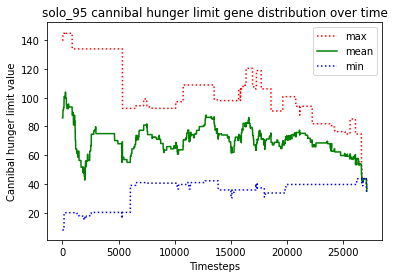

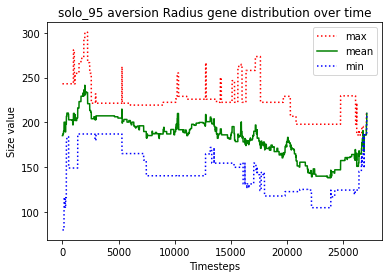

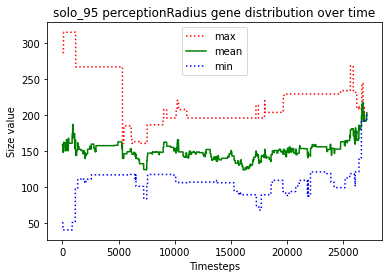

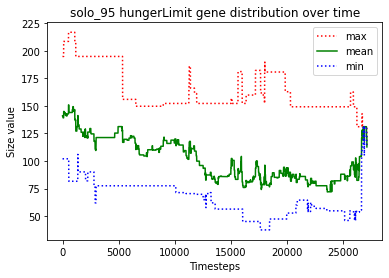





						SOLO_96

predator_8 just gave birth to predator_10
predator_9 just gave birth to predator_11
predator_0 just gave birth to predator_12
predator_11 just gave birth to predator_13
predator_7 just gave birth to predator_14
predator_0 just gave birth to predator_15
predator_7 killed predator_6
predator_14 killed predator_10
predator_7 just gave birth to predator_16
predator_7 killed predator_8
predator_7 killed predator_12
predator_15 starved to death
predator_0 starved to death
predator_14 just gave birth to predator_17
predator_2 ate the carcass of predator_0_carcass
predator_2 ate the carcass of predator_15_carcass
predator_4 just gave birth to predator_18
predator_1 just gave birth to predator_19
predator_11 starved to death
predator_17 killed predator_7
predator_16 starved to death
predator_1 ate the carcass of predator_11_carcass
predator_3 ate the carcass of predator_16_carcass
predator_14 just gave birth to predator_20
predator_13 starved to death
predator_14 just gave bi

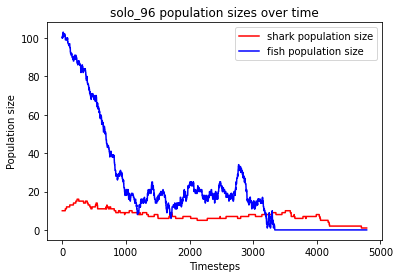

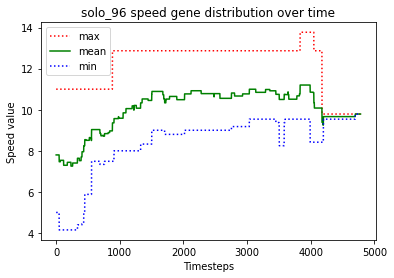

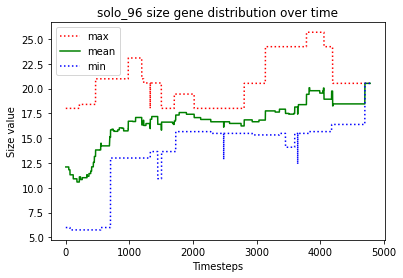

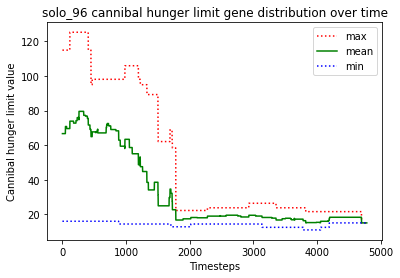

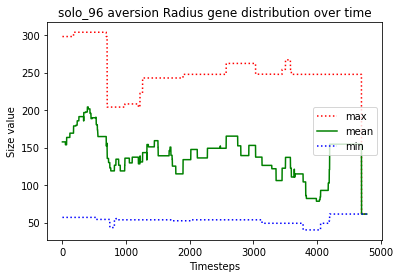

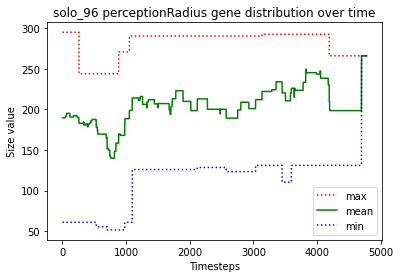

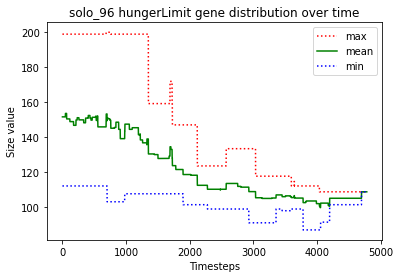





						SOLO_97

predator_9 just gave birth to predator_10
predator_10 killed predator_3
predator_9 killed predator_7
predator_0 just gave birth to predator_11
predator_10 killed predator_0
predator_10 just gave birth to predator_12
predator_9 killed predator_2
predator_10 killed predator_11
predator_12 killed predator_8
predator_10 just gave birth to predator_13
predator_12 just gave birth to predator_14
predator_14 killed predator_13
no fish to move
predator_4 just gave birth to predator_15
predator_4 killed predator_15
predator_4 just gave birth to predator_16
predator_12 just gave birth to predator_17
predator_16 starved to death
predator_9 ate the carcass of predator_16_carcass
predator_5 just gave birth to predator_18
predator_4 starved to death
predator_17 ate the carcass of predator_4_carcass
predator_14 starved to death
predator_5 ate the carcass of predator_14_carcass
predator_18 starved to death
predator_10 starved to death
predator_17 just gave birth to predator_19
predat

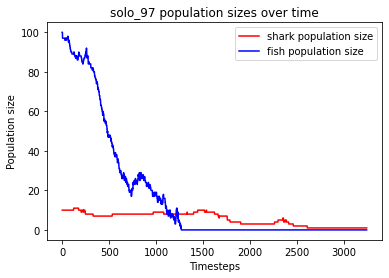

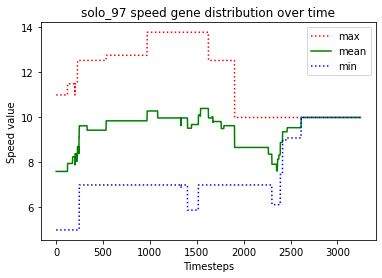

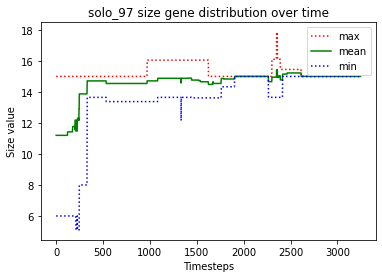

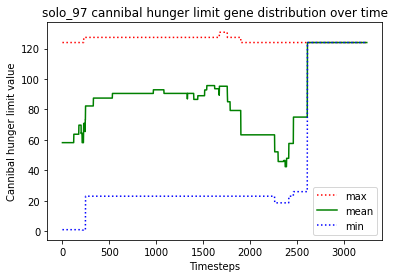

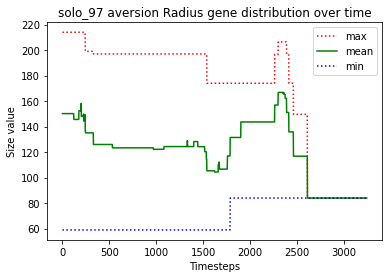

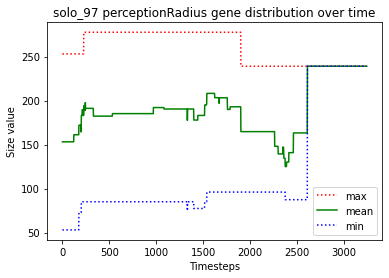

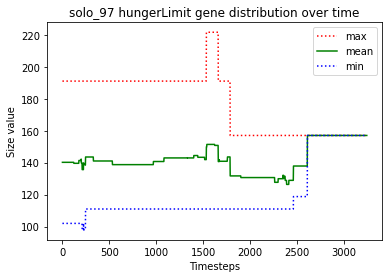





						SOLO_98

predator_7 just gave birth to predator_10
predator_7 killed predator_4
predator_3 just gave birth to predator_11
predator_10 just gave birth to predator_12
predator_10 just gave birth to predator_13
predator_10 just gave birth to predator_14
predator_14 killed predator_13
predator_3 just gave birth to predator_15
predator_14 just gave birth to predator_16
predator_11 just gave birth to predator_17
predator_14 starved to death
predator_16 starved to death
predator_9 ate the carcass of predator_14_carcass
predator_11 ate the carcass of predator_16_carcass
predator_10 starved to death
predator_2 ate the carcass of predator_10_carcass
predator_12 starved to death
predator_6 ate the carcass of predator_12_carcass
predator_9 killed predator_17
predator_7 killed predator_6
predator_3 just gave birth to predator_18
predator_18 starved to death
predator_3 starved to death
predator_9 ate the carcass of predator_3_carcass
predator_9 ate the carcass of predator_18_carcass
predat

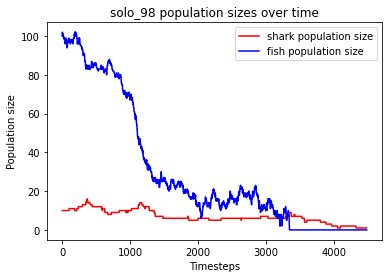

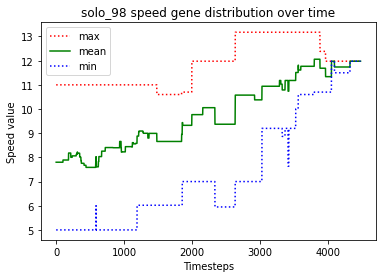

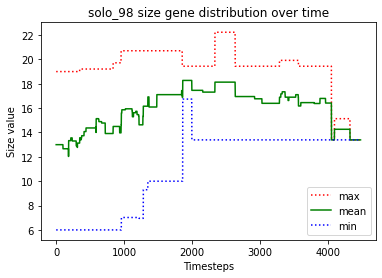

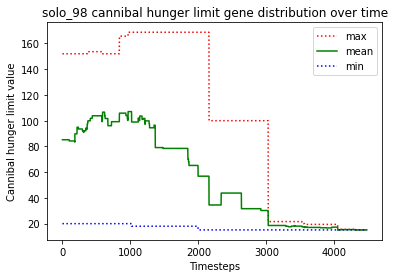

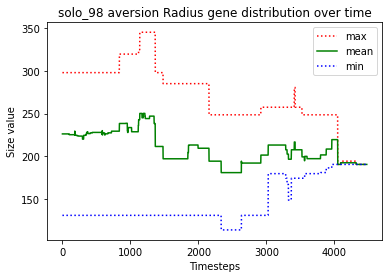

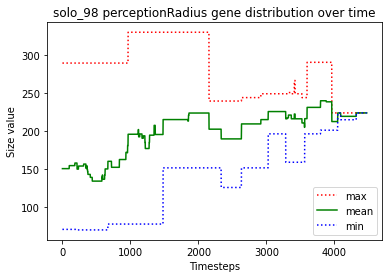

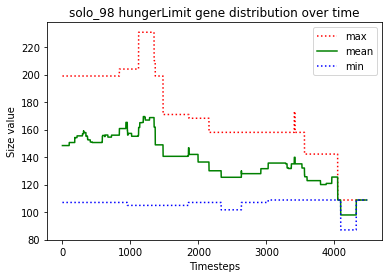





						SOLO_99

predator_3 just gave birth to predator_10
predator_9 just gave birth to predator_11
predator_3 killed predator_0
predator_7 just gave birth to predator_12
predator_12 just gave birth to predator_13
predator_5 just gave birth to predator_14
predator_4 just gave birth to predator_15
predator_12 just gave birth to predator_16
predator_13 starved to death
predator_12 ate the carcass of predator_13_carcass
predator_9 just gave birth to predator_17
predator_16 starved to death
predator_15 ate the carcass of predator_16_carcass
predator_9 starved to death
predator_4 ate the carcass of predator_9_carcass
predator_17 starved to death
predator_10 ate the carcass of predator_17_carcass
predator_1 just gave birth to predator_18
predator_18 killed predator_15
predator_11 starved to death
predator_18 ate the carcass of predator_11_carcass
predator_10 starved to death
predator_14 starved to death
predator_5 ate the carcass of predator_14_carcass
predator_3 ate the carcass of predat

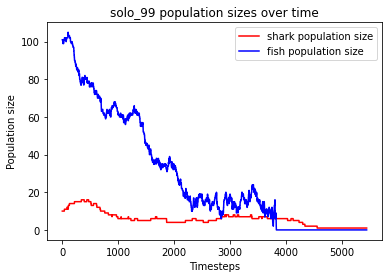

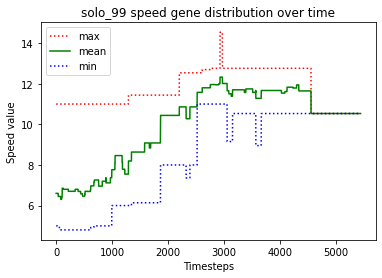

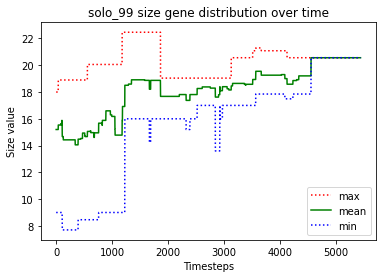

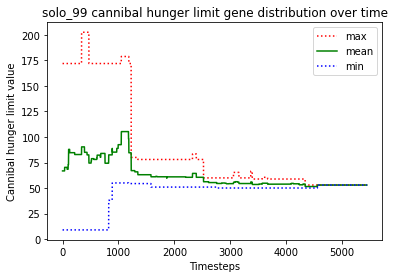

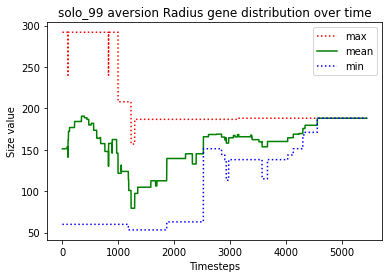

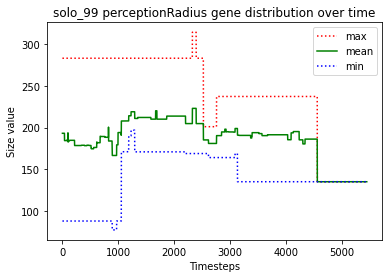

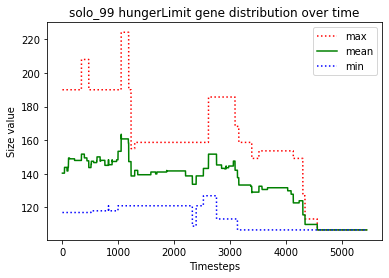

In [13]:
#### CONSTANTS ####
simulation_speed = 15
max_timesteps = 100000

### NUMBER OF AGENTS
#number of boids
num_boids = 100
#number of predators
num_preds = 10

### FISH BEHAVIOUR
#radius in which the fish swarm behaviour kicks in
perception_radius = 35
#minimum radius between each fish
minimum_radius = 25
#radius in which aversion behaviour kicks in
aversion_radius = 90

#### MAIN EXPERIMENT FUNCTION ####
def do_one_experiment(num_boids, perception_radius, minimum_radius, aversion_radius, num_preds, simulation_speed, max_timesteps, swarm_behavour, run_name):
    print(color.BOLD+f"\n\n\n\n\t\t\t\t\t\t{run_name.upper()}\n"+color.END)
    window = tk.Tk()
    canvas = initialise(window)
    count = Counter(max_timesteps) # run for 1000 time steps
    fishList = addFish(canvas, num_boids) ### Custom now taking num_boids as a parameter to be tuned
    predList = addPredators(canvas, num_preds) ### Custom adding preadtors
    moveFish(canvas,False, fishList, perception_radius, minimum_radius, aversion_radius, predList, simulation_speed, len(fishList), swarm_behaviour) ### Custom now taking perception and minimum radius as parameters to be tuned
    movePredators(canvas,window,count,predList, fishList, [], [], simulation_speed, len(predList), ([],[],[]), ([],[],[]), ([],[],[]), ([],[],[]), ([],[],[]), ([],[],[]), ([],[]), run_name, None, None) ### Custom moving predators
    writeTrackers(canvas, fishList, predList,count)
    window.mainloop()
    
    
#### running all experiments ####
# running with and without swarm behavour
for swarm_behaviour in (True, False):
    #running n experiments for each
    for i in range(num_of_experiments_for_each):
        run_name = ""
        run_name += f'boids_{i}' if swarm_behaviour else f'solo_{i}'
        do_one_experiment(num_boids, perception_radius, minimum_radius, aversion_radius, num_preds, simulation_speed, max_timesteps, swarm_behaviour, run_name)

# Inspecting totals from the experiments

## loading the stats from experiments

In [14]:
#loading the data for boids
boids_timesteps_passed=[]
boids_fish_extinct_timestep=[]
boids_shark_extinct_timestep=[]

boids_minMeanMax_speed=[]
boids_minMeanMax_size =[]
boids_minMeanMax_aversionRadius =[]
boids_minMeanMax_perceptionRadius =[]
boids_minMeanMax_hungerLimit =[]
boids_minMeanMax_canibalHunger =[]

boids_populationSizes=[]

for i in range(num_of_experiments_for_each):
    boids_timesteps_passed.append(pd.read_pickle(f"./boids_{i}/timesteps_passed.pickle"))
    boids_shark_extinct_timestep.append(pd.read_pickle(f"./boids_{i}/shark_extinct_timestep.pickle"))
    boids_fish_extinct_timestep.append(pd.read_pickle(f"./boids_{i}/fish_extinct_timestep.pickle"))

    boids_minMeanMax_speed.append(pd.read_pickle(f"./boids_{i}/minMeanMax_speed.pickle"))
    boids_minMeanMax_size.append(pd.read_pickle(f"./boids_{i}/minMeanMax_size.pickle"))
    boids_minMeanMax_aversionRadius.append(pd.read_pickle(f"./boids_{i}/minMeanMax_aversionRadius.pickle"))
    boids_minMeanMax_perceptionRadius.append(pd.read_pickle(f"./boids_{i}/minMeanMax_perceptionRadius.pickle"))
    boids_minMeanMax_hungerLimit.append(pd.read_pickle(f"./boids_{i}/minMeanMax_hungerLimit.pickle"))
    boids_minMeanMax_canibalHunger.append(pd.read_pickle(f"./boids_{i}/minMeanMax_canibalHunger.pickle"))
    
    boids_populationSizes.append(pd.read_pickle(f"./boids_{i}/populationSizes.pickle"))


    
    
    
#loading the data for solo
solo_timesteps_passed=[]
solo_fish_extinct_timestep=[]
solo_shark_extinct_timestep=[]

solo_minMeanMax_speed=[]
solo_minMeanMax_size =[]
solo_minMeanMax_aversionRadius =[]
solo_minMeanMax_perceptionRadius =[]
solo_minMeanMax_hungerLimit =[]
solo_minMeanMax_canibalHunger =[]

solo_populationSizes=[]

for i in range(num_of_experiments_for_each):
    solo_timesteps_passed.append(pd.read_pickle(f"./solo_{i}/timesteps_passed.pickle"))
    solo_shark_extinct_timestep.append(pd.read_pickle(f"./solo_{i}/shark_extinct_timestep.pickle"))
    solo_fish_extinct_timestep.append(pd.read_pickle(f"./solo_{i}/fish_extinct_timestep.pickle"))

    solo_minMeanMax_speed.append(pd.read_pickle(f"./solo_{i}/minMeanMax_speed.pickle"))
    solo_minMeanMax_size.append(pd.read_pickle(f"./solo_{i}/minMeanMax_size.pickle"))
    solo_minMeanMax_aversionRadius.append(pd.read_pickle(f"./solo_{i}/minMeanMax_aversionRadius.pickle"))
    solo_minMeanMax_perceptionRadius.append(pd.read_pickle(f"./solo_{i}/minMeanMax_perceptionRadius.pickle"))
    solo_minMeanMax_hungerLimit.append(pd.read_pickle(f"./solo_{i}/minMeanMax_hungerLimit.pickle"))
    solo_minMeanMax_canibalHunger.append(pd.read_pickle(f"./solo_{i}/minMeanMax_canibalHunger.pickle"))
    
    
    solo_populationSizes.append(pd.read_pickle(f"./solo_{i}/populationSizes.pickle"))

In [15]:
#making the directories if it doesn't already exist
if not os.path.exists('_all_solo/plots'):
    os.makedirs('_all_solo/plots')
if not os.path.exists('_all_boids/plots'):
    os.makedirs('_all_boids/plots')
if not os.path.exists('__boids_vs_solo/plots'):
    os.makedirs('__boids_vs_solo/plots')

## Inspecting population sizes over all experiments

### Solo population sizes

In [16]:
#getting the pred and fish popsizes
temp=pd.DataFrame(data = solo_populationSizes, columns = ["pred","fish"])
preds_popsizes = pd.DataFrame(data = temp["pred"].to_list()).replace(0, np.nan)
fish_popsizes = pd.DataFrame(data = temp["fish"].to_list())

In [17]:
# getting min/max/mean of all columns
min_fish = fish_popsizes.min()
max_fish = fish_popsizes.max()
mean_fish = fish_popsizes.mean()

min_shark = preds_popsizes.min()
max_shark = preds_popsizes.max()
mean_shark = preds_popsizes.mean()

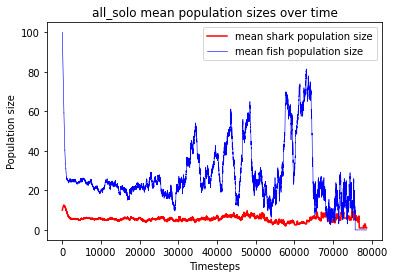

In [18]:
#plotting these for inspection of the experiments
fig = plt.figure()#figsize=(10,10))
ax = plt.axes()
plt.title("all_solo mean population sizes over time")
plt.xlabel("Timesteps")
plt.ylabel("Population size")
# plt.plot(max_shark, color='lime', linestyle='-', lw=0.4, label='max shark population size')
plt.plot(mean_shark, color='red', linestyle='-', label='mean shark population size')
# plt.plot(min_shark, color='magenta', linestyle='-', lw=0.4, label='min shark population size')

# plt.plot(max_fish, color='navy', linestyle=':', lw=0.2, label='max fish population size')
plt.plot(mean_fish, color='blue', linestyle='-', lw=0.6, label='mean fish population size')
# plt.plot(min_fish, color='darkolivegreen', linestyle=':', lw=0.2 label='min fish population size')

plt.legend()
plt.show()
fig.savefig('_all_solo/plots/_fish_vs_sharks_populations.png')
plt.close()

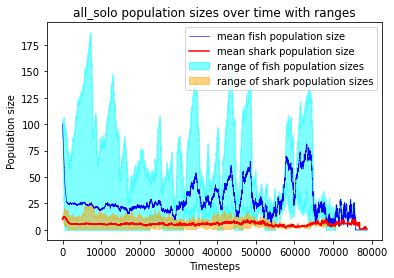

In [19]:
#plotting these for inspection of the experiments
fig = plt.figure()#figsize=(10,10))
ax = plt.axes()
plt.title("all_solo population sizes over time with ranges")
plt.xlabel("Timesteps")
plt.ylabel("Population size")

# plt.plot(max_fish, color='navy', linestyle=':', lw=0.2, label='max fish population size')
plt.plot(mean_fish, color='blue', linestyle='-', lw=0.6, label='mean fish population size')
# plt.plot(min_fish, color='darkolivegreen', linestyle=':', lw=0.2 label='min fish population size')
plt.fill_between(list(range(len(mean_fish))),min_fish, max_fish, color="cyan", alpha=.5, label='range of fish population sizes')

# plt.plot(max_shark, color='lime', linestyle='-', lw=0.4, label='max shark population size')
plt.plot(mean_shark, color='red', linestyle='-', label='mean shark population size')
# plt.plot(min_shark, color='magenta', linestyle='-', lw=0.4, label='min shark population size')
plt.fill_between(list(range(len(mean_fish))),min_shark, max_shark, color="orange", alpha=.5, label='range of shark population sizes')



plt.legend()
plt.show()
fig.savefig('_all_solo/plots/_fish_vs_sharks_populations_with_ranges.png')
plt.close()

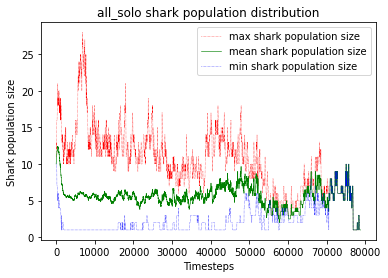

In [20]:
#plotting these for inspection of the experiments
fig = plt.figure()#figsize=(10,10))
ax = plt.axes()
plt.title("all_solo shark population distribution")
plt.xlabel("Timesteps")
plt.ylabel("Shark population size")
plt.plot(max_shark, color='r', linestyle=':', lw=0.5, label='max shark population size')
plt.plot(mean_shark, color='g', linestyle='-', lw=0.6, label='mean shark population size')
plt.plot(min_shark, color='b', linestyle=':', lw=0.5, label='min shark population size')

plt.legend()
plt.show()
fig.savefig('_all_solo/plots/sharks_populations.png')
plt.close()

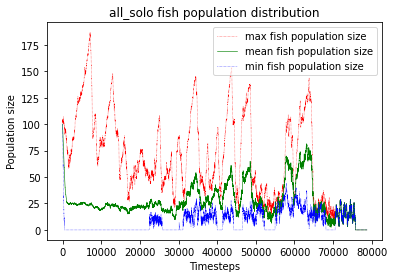

In [21]:
#plotting these for inspection of the experiments
fig = plt.figure()#figsize=(10,10))
ax = plt.axes()
plt.title("all_solo fish population distribution")
plt.xlabel("Timesteps")
plt.ylabel("Population size")


plt.plot(max_fish, color='r', linestyle=':', lw=0.5, label='max fish population size')
plt.plot(mean_fish, color='g', linestyle='-', lw=0.6, label='mean fish population size')
plt.plot(min_fish, color='b', linestyle=':', lw=0.5, label='min fish population size')

plt.legend()
plt.show()
fig.savefig('_all_solo/plots/fish_populations.png')
plt.close()

## Inspecting extinctions

In [22]:
#inspecting times of extinction

fish_never_went_extinct = solo_fish_extinct_timestep.count(None)
fish_no_none=solo_fish_extinct_timestep.copy()
while None in fish_no_none: fish_no_none.remove(None)

print("SOLO EXPERIMENT FISH EXTINCTION")
print("Minimum timesteps until fish went extinct is:",min(fish_no_none))
print("Mean timesteps until fish went extinct is:",round(np.mean(fish_no_none),2))
print("Max timesteps until fish went extinct is:",max(fish_no_none))
print("Median timesteps until fish went extinct is: ",round(np.median(fish_no_none),2))
print(f"Also, there were {fish_never_went_extinct} runs where fish never went extinct" if fish_never_went_extinct>0 else "Fish went extinct in every run" )




sharks_never_went_extinct = solo_shark_extinct_timestep.count(None)
sharks_no_none=solo_shark_extinct_timestep.copy()
while None in sharks_no_none: sharks_no_none.remove(None)

print("\nSOLO EXPERIMENT SHARK EXTINCTION")
print("Minimum timesteps until sharks went extinct is:",min(sharks_no_none))
print("Mean timesteps until sharks went extinct is:",np.mean(sharks_no_none))
print("Max timesteps until sharks went extinct is:",max(sharks_no_none))
print("Median timesteps until sharks went extinct is: ",round(np.median(sharks_no_none),2))
print(f"Also, there were {sharks_never_went_extinct} runs where sharks never went extinct" if sharks_never_went_extinct>0 else "Sharks went extinct in every run" )

SOLO EXPERIMENT FISH EXTINCTION
Minimum timesteps until fish went extinct is: 499
Mean timesteps until fish went extinct is: 12919.39
Max timesteps until fish went extinct is: 75762
Median timesteps until fish went extinct is:  9176.0
Also, there were 3 runs where fish never went extinct

SOLO EXPERIMENT SHARK EXTINCTION
Minimum timesteps until sharks went extinct is: 1361
Mean timesteps until sharks went extinct is: 14521.66
Max timesteps until sharks went extinct is: 78732
Median timesteps until sharks went extinct is:  11027.5
Sharks went extinct in every run


In [23]:
# REFERENCE : https://stackoverflow.com/questions/23461713/obtaining-values-used-in-boxplot-using-python-and-matplotlib

# function for annotating the box plots
def get_box_plot_data(labels, bp):
    rows_list = []

    for i in range(len(labels)):
        dict1 = {}
        dict1['label'] = labels[i].replace("\n", ": ")
        dict1['lower_whisker'] = bp['whiskers'][i*2].get_ydata()[1]
        dict1['lower_quartile'] = bp['boxes'][i].get_ydata()[1]
        dict1['median'] = bp['medians'][i].get_ydata()[1]
        dict1['mean'] = round(bp['means'][i].get_ydata()[0],2)
        dict1['upper_quartile'] = bp['boxes'][i].get_ydata()[2]
        dict1['upper_whisker'] = bp['whiskers'][(i*2)+1].get_ydata()[1]
        rows_list.append(dict1)

    return pd.DataFrame(rows_list)

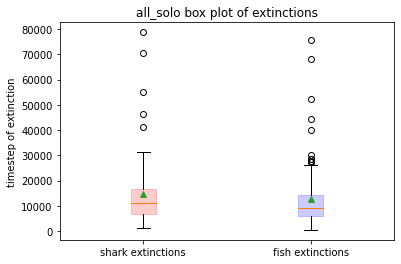

In [24]:
# box plot of extinctions
fig=plt.figure()
bp=plt.boxplot([sharks_no_none, fish_no_none], labels=["shark extinctions","fish extinctions"], showmeans=True, patch_artist=True)
i=0
for box in bp['boxes']:
    if i%2==1:
        box.set(color='blue', alpha=0.2) 
    else:
        box.set(color='red', alpha=0.2)
    i+=1

plt.ylabel("timestep of extinction")
plt.title("all_solo box plot of extinctions")
plt.show()
fig.savefig("_all_solo/plots/box_all_extinctions.png")

In [25]:
#just plotting without patch artist so below function works
bp=plt.boxplot([sharks_no_none, fish_no_none], labels=["solo\nshark extinctions","solo\nfish extinctions"], showmeans=True)
plt.close()
#getting the dataframe annotating the box plot
temp=get_box_plot_data(["solo\nshark extinctions","solo\nfish extinctions"], bp)
temp["max"]=[max(sharks_no_none),max(fish_no_none)]
temp["min"]=[min(sharks_no_none),min(fish_no_none)]
temp["number of runs without extinction"]=[solo_shark_extinct_timestep.count(None),solo_fish_extinct_timestep.count(None)]
temp

,label,lower_whisker,lower_quartile,median,mean,upper_quartile,upper_whisker,max,min,number of runs without extinction
0,solo: shark extinctions,1361.0,6708.25,11027.5,14521.66,16767.5,31140.0,78732,1361,0
1,solo: fish extinctions,499.0,5926.00,9176.0,12919.39,14360.0,26259.0,75762,499,3


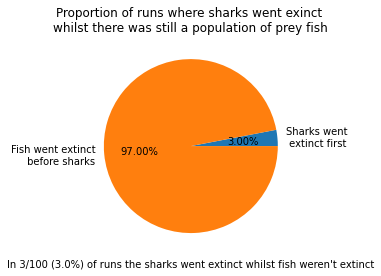

In [26]:
#Getting percentage of runs where sharks went extinct before fish
sharks_extinct_before_fish_counter=0
for i in range (num_of_experiments_for_each):
    if(solo_fish_extinct_timestep[i]==None and solo_shark_extinct_timestep[i]!=None):
        sharks_extinct_before_fish_counter+=1
        
fig = plt.figure()
counts=[sharks_extinct_before_fish_counter,num_of_experiments_for_each-sharks_extinct_before_fish_counter]
plt.pie(counts, labels = ["Sharks went\n extinct first", "Fish went extinct\n before sharks"], autopct='%1.2f%%')
plt.title("Proportion of runs where sharks went exinct \nwhilst there was still a population of prey fish")
plt.xlabel(f"In {str(sharks_extinct_before_fish_counter)}/{str(num_of_experiments_for_each)} ({str(round(sharks_extinct_before_fish_counter/num_of_experiments_for_each*100,2))}%) of runs the sharks went extinct whilst fish weren't extinct")
plt.show()
fig.savefig("_all_solo/plots/pie_shark_before_fish.png")
plt.close()

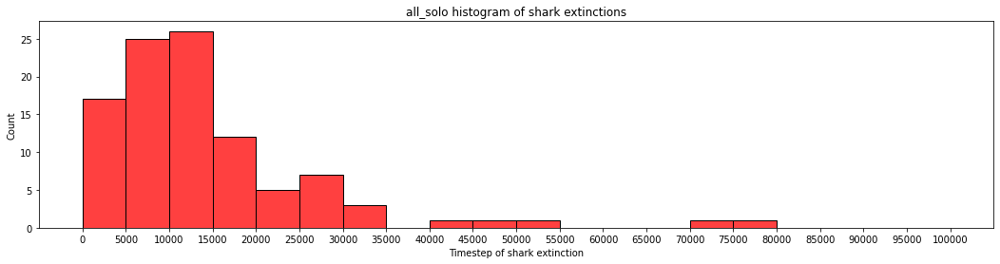

In [27]:
fig = plt.figure(figsize=(18,4))
ax=sns.histplot(data=sharks_no_none, bins=range(0,100001,5000), color = 'r')
ax.set_title("all_solo histogram of shark extinctions")
ax.set_xlabel("Timestep of shark extinction")
ax.set_xticks(range(0,100001,5000))
fig.savefig('_all_solo/plots/shark_extinctions.png')
plt.show()
plt.close()

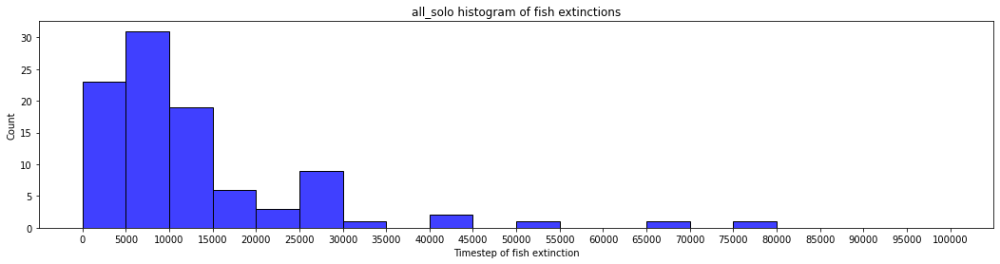

In [28]:
fig = plt.figure(figsize=(18,4))
ax=sns.histplot(data=fish_no_none, bins=range(0,100001,5000), color = 'b')
ax.set_title("all_solo histogram of fish extinctions")
ax.set_xlabel("Timestep of fish extinction")
ax.set_xticks(range(0,100001,5000))
fig.savefig('_all_solo/plots/fish_extinctions.png')
plt.show()
plt.close()

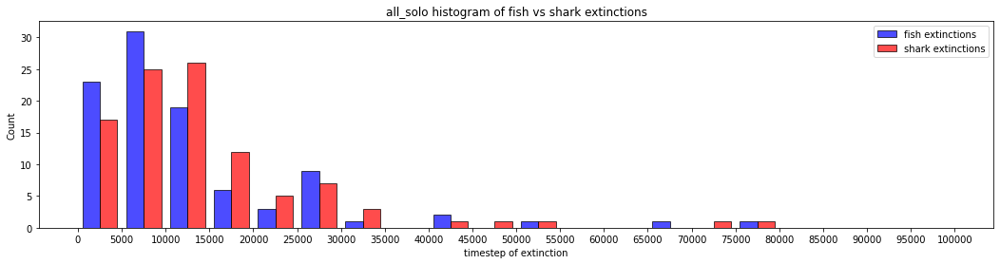

In [29]:
#plotting on top of each other
fig = plt.figure(figsize=(18,4))
plt.hist([fish_no_none, sharks_no_none], color=['b','r'], ec="k",alpha=0.7, bins=range(0,100001,5000))
plt.xticks(range(0,100001,5000))

handles = [Rectangle((0,0),1,1,color=c,ec="k", alpha=0.7) for c in ['b','r']]
labels=["fish extinctions","shark extinctions"]
plt.legend(handles, labels)

plt.title("all_solo histogram of fish vs shark extinctions")
plt.xlabel("timestep of extinction")
plt.ylabel("Count")


fig.savefig('_all_solo/plots/_all_extinctions.png')
plt.show()
plt.close()

### Boids population sizes

In [30]:
#getting the pred and fish popsizes
temp=pd.DataFrame(data = boids_populationSizes, columns = ["pred","fish"])
preds_popsizes = pd.DataFrame(data = temp["pred"].to_list()).replace(0, np.nan)
fish_popsizes = pd.DataFrame(data = temp["fish"].to_list())

In [31]:
# getting min/max/mean of all columns
min_fish = fish_popsizes.min()
max_fish = fish_popsizes.max()
mean_fish = fish_popsizes.mean()

min_shark = preds_popsizes.min()
max_shark = preds_popsizes.max()
mean_shark = preds_popsizes.mean()

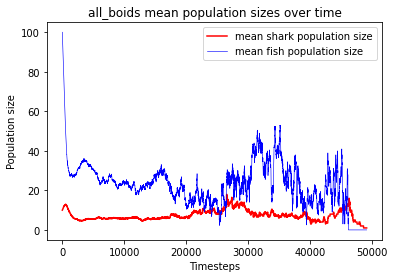

In [32]:
#plotting these for inspection of the experiments
fig = plt.figure()#figsize=(10,10))
ax = plt.axes()
plt.title("all_boids mean population sizes over time")
plt.xlabel("Timesteps")
plt.ylabel("Population size")
# plt.plot(max_shark, color='lime', linestyle='-', lw=0.4, label='max shark population size')
plt.plot(mean_shark, color='red', linestyle='-', label='mean shark population size')
# plt.plot(min_shark, color='magenta', linestyle='-', lw=0.4, label='min shark population size')

# plt.plot(max_fish, color='navy', linestyle=':', lw=0.2, label='max fish population size')
plt.plot(mean_fish, color='blue', linestyle='-', lw=0.6, label='mean fish population size')
# plt.plot(min_fish, color='darkolivegreen', linestyle=':', lw=0.2 label='min fish population size')

plt.legend()
plt.show()
fig.savefig('_all_boids/plots/_fish_vs_sharks_populations.png')
plt.close()

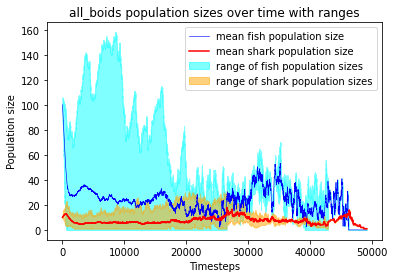

In [33]:
#plotting these for inspection of the experiments
fig = plt.figure()#figsize=(10,10))
ax = plt.axes()
plt.title("all_boids population sizes over time with ranges")
plt.xlabel("Timesteps")
plt.ylabel("Population size")

# plt.plot(max_fish, color='navy', linestyle=':', lw=0.2, label='max fish population size')
plt.plot(mean_fish, color='blue', linestyle='-', lw=0.6, label='mean fish population size')
# plt.plot(min_fish, color='darkolivegreen', linestyle=':', lw=0.2 label='min fish population size')
plt.fill_between(list(range(len(mean_fish))),min_fish, max_fish, color="cyan", alpha=.5, label='range of fish population sizes')

# plt.plot(max_shark, color='lime', linestyle='-', lw=0.4, label='max shark population size')
plt.plot(mean_shark, color='red', linestyle='-', label='mean shark population size')
# plt.plot(min_shark, color='magenta', linestyle='-', lw=0.4, label='min shark population size')
plt.fill_between(list(range(len(mean_fish))),min_shark, max_shark, color="orange", alpha=.5, label='range of shark population sizes')



plt.legend()
plt.show()
fig.savefig('_all_boids/plots/_fish_vs_sharks_populations_with_ranges.png')
plt.close()

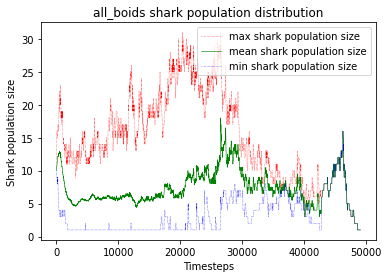

In [34]:
#plotting these for inspection of the experiments
fig = plt.figure()#figsize=(10,10))
ax = plt.axes()
plt.title("all_boids shark population distribution")
plt.xlabel("Timesteps")
plt.ylabel("Shark population size")
plt.plot(max_shark, color='r', linestyle=':', lw=0.5, label='max shark population size')
plt.plot(mean_shark, color='g', linestyle='-', lw=0.6, label='mean shark population size')
plt.plot(min_shark, color='b', linestyle=':', lw=0.5, label='min shark population size')

plt.legend()
plt.show()
fig.savefig('_all_boids/plots/sharks_populations.png')
plt.close()

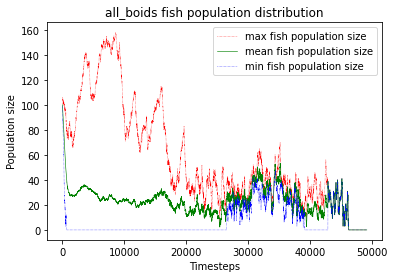

In [35]:
#plotting these for inspection of the experiments
fig = plt.figure()#figsize=(10,10))
ax = plt.axes()
plt.title("all_boids fish population distribution")
plt.xlabel("Timesteps")
plt.ylabel("Population size")


plt.plot(max_fish, color='r', linestyle=':', lw=0.5, label='max fish population size')
plt.plot(mean_fish, color='g', linestyle='-', lw=0.6, label='mean fish population size')
plt.plot(min_fish, color='b', linestyle=':', lw=0.5, label='min fish population size')

plt.legend()
plt.show()
fig.savefig('_all_boids/plots/fish_populations.png')
plt.close()

### Boids extinctions

In [36]:
#inspecting times of extinction

fish_never_went_extinct = boids_fish_extinct_timestep.count(None)
fish_no_none=boids_fish_extinct_timestep.copy()
while None in fish_no_none: fish_no_none.remove(None)

print("BOIDS EXPERIMENT FISH EXTINCTION")
print("Minimum timesteps until fish went extinct is:",min(fish_no_none))
print("Mean timesteps until fish went extinct is:",round(np.mean(fish_no_none), 2))
print("Max timesteps until fish went extinct is:",max(fish_no_none))
print("Median timesteps until fish went extinct is: ",round(np.median(fish_no_none),2))
print(f"Also, there were {fish_never_went_extinct} runs where fish never went extinct" if fish_never_went_extinct>0 else "Fish went extinct in every run" )




sharks_never_went_extinct = boids_shark_extinct_timestep.count(None)
sharks_no_none=boids_shark_extinct_timestep.copy()
while None in sharks_no_none: sharks_no_none.remove(None)

print("\nBOIDS EXPERIMENT SHARK EXTINCTION")
print("Minimum timesteps until sharks went extinct is:",min(sharks_no_none))
print("Mean timesteps until sharks went extinct is:",round(np.mean(sharks_no_none),2))
print("Max timesteps until sharks went extinct is:",max(sharks_no_none))
print("Median timesteps until sharks went extinct is: ",round(np.median(sharks_no_none),2))
print(f"Also, there were {sharks_never_went_extinct} runs where sharks never went extinct" if sharks_never_went_extinct>0 else "Sharks went extinct in every run" )

BOIDS EXPERIMENT FISH EXTINCTION
Minimum timesteps until fish went extinct is: 643
Mean timesteps until fish went extinct is: 8888.88
Max timesteps until fish went extinct is: 46167
Median timesteps until fish went extinct is:  7182.0
Also, there were 1 runs where fish never went extinct

BOIDS EXPERIMENT SHARK EXTINCTION
Minimum timesteps until sharks went extinct is: 2076
Mean timesteps until sharks went extinct is: 10479.69
Max timesteps until sharks went extinct is: 49132
Median timesteps until sharks went extinct is:  9136.5
Sharks went extinct in every run


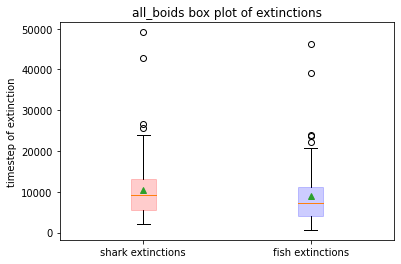

In [37]:
# box plot of extinctions
fig=plt.figure()
bp=plt.boxplot([sharks_no_none, fish_no_none], labels=["shark extinctions","fish extinctions"], showmeans=True, patch_artist=True)

i=0
for box in bp['boxes']:
    if i%2==1:
        box.set(color='blue', alpha=0.2) 
    else:
        box.set(color='red', alpha=0.2)
    i+=1

plt.ylabel("timestep of extinction")
plt.title("all_boids box plot of extinctions")
plt.show()
fig.savefig("_all_boids/plots/box_all_extinctions.png")

In [38]:
#just plotting without patch artist so below function works
bp=plt.boxplot([sharks_no_none, fish_no_none], labels=["boids\nshark extinctions","boids\nfish extinctions"], showmeans=True)
plt.close()
#getting the dataframe annotating the box plot
temp=get_box_plot_data(["boids\nshark extinctions","boids\nfish extinctions"], bp)
temp["max"]=[max(sharks_no_none),max(fish_no_none)]
temp["min"]=[min(sharks_no_none),min(fish_no_none)]
temp["number of runs without extinction"]=[boids_shark_extinct_timestep.count(None),boids_fish_extinct_timestep.count(None)]
temp

,label,lower_whisker,lower_quartile,median,mean,upper_quartile,upper_whisker,max,min,number of runs without extinction
0,boids: shark extinctions,2076.0,5603.5,9136.5,10479.69,13019.75,23908.0,49132,2076,0
1,boids: fish extinctions,643.0,4039.5,7182.0,8888.88,11067.50,20756.0,46167,643,1


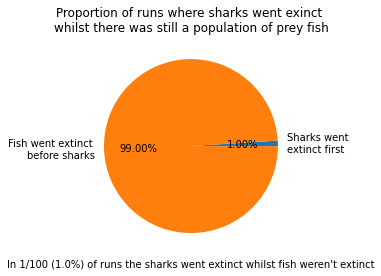

In [39]:
#Getting percentage of runs where sharks went extinct before fish
sharks_extinct_before_fish_counter=0
for i in range (num_of_experiments_for_each):
    if(boids_fish_extinct_timestep[i]==None and boids_shark_extinct_timestep[i]!=None):
        sharks_extinct_before_fish_counter+=1
        
fig = plt.figure()
counts=[sharks_extinct_before_fish_counter,num_of_experiments_for_each-sharks_extinct_before_fish_counter]
plt.pie(counts, labels = ["Sharks went \nextinct first", "Fish went extinct \nbefore sharks"], autopct='%1.2f%%')
plt.title("Proportion of runs where sharks went exinct \nwhilst there was still a population of prey fish")
plt.xlabel(f"In {str(sharks_extinct_before_fish_counter)}/{str(num_of_experiments_for_each)} ({str(round(sharks_extinct_before_fish_counter/num_of_experiments_for_each*100,2))}%) of runs the sharks went extinct whilst fish weren't extinct")
plt.show()
fig.savefig("_all_boids/plots/pie_shark_before_fish.png")
plt.close()

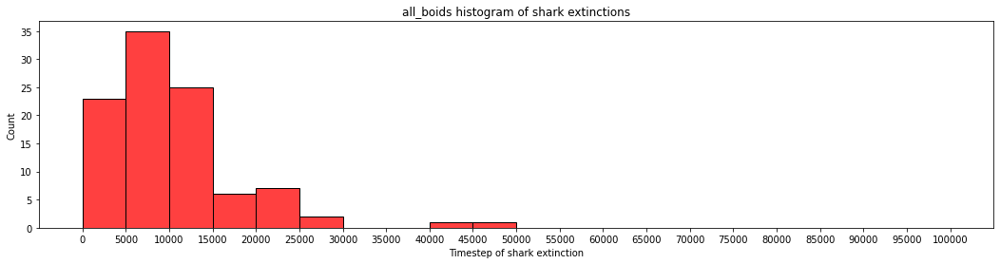

In [40]:
fig = plt.figure(figsize=(18,4))
ax=sns.histplot(data=sharks_no_none, bins=range(0,100001,5000), color = 'r')
ax.set_title("all_boids histogram of shark extinctions")
ax.set_xlabel("Timestep of shark extinction")
ax.set_xticks(range(0,100001,5000))
fig.savefig('_all_boids/plots/shark_extinctions.png')
plt.show()
plt.close()

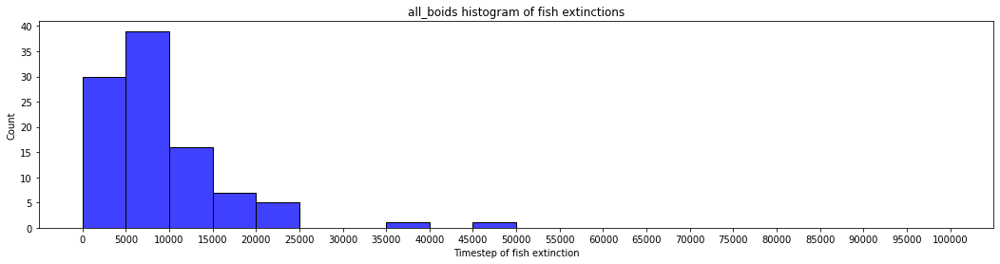

In [41]:
fig = plt.figure(figsize=(18,4))
ax=sns.histplot(data=fish_no_none, bins=range(0,100001,5000), color = 'b')
ax.set_title("all_boids histogram of fish extinctions")
ax.set_xlabel("Timestep of fish extinction")
ax.set_xticks(range(0,100001,5000))
fig.savefig('_all_boids/plots/fish_extinctions.png')
plt.show()
plt.close()

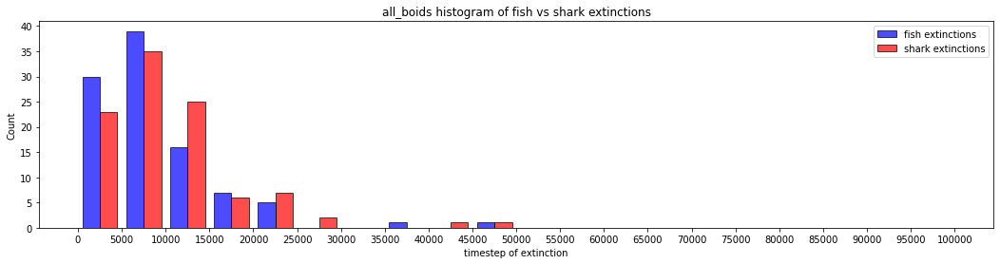

In [42]:
#plotting on top of each other
fig = plt.figure(figsize=(18,4))
plt.hist([fish_no_none, sharks_no_none], color=['b','r'], ec="k",alpha=0.7, bins=range(0,100001,5000))
plt.xticks(range(0,100001,5000))

handles = [Rectangle((0,0),1,1,color=c,ec="k", alpha=0.7) for c in ['b','r']]
labels=["fish extinctions","shark extinctions"]
plt.legend(handles, labels)

plt.title("all_boids histogram of fish vs shark extinctions")
plt.xlabel("timestep of extinction")
plt.ylabel("Count")

fig.savefig('_all_boids/plots/_all_extinctions.png')
plt.show()
plt.close()

## Inspecting mean genetic distribution over all experiments
### Solo fish

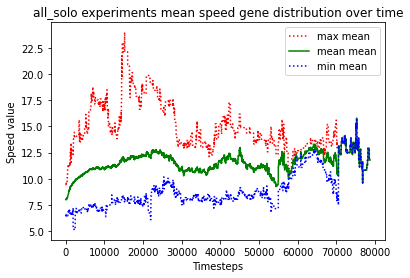

In [43]:
#getting the mean value for speed gene
temp=pd.DataFrame(data = solo_minMeanMax_speed)
mean_speed = pd.DataFrame(data = temp[1].to_list()).replace(0, np.nan)

# getting min/max/mean of the mean speed for all columns
min_mean_speed = mean_speed.min()
mean_mean_speed = mean_speed.mean()
max_mean_speed = mean_speed.max()

#plotting these for inspection of the experiments
fig = plt.figure()#figsize=(10,10))
ax = plt.axes()
plt.title("all_solo experiments mean speed gene distribution over time")
plt.xlabel("Timesteps")
plt.ylabel("Speed value")
plt.plot(max_mean_speed, ':r', label='max mean')
plt.plot(mean_mean_speed, '-g', label='mean mean')
plt.plot(min_mean_speed, ':b', label='min mean')

plt.legend()
plt.show()
fig.savefig('_all_solo/plots/speed.png')
plt.close()

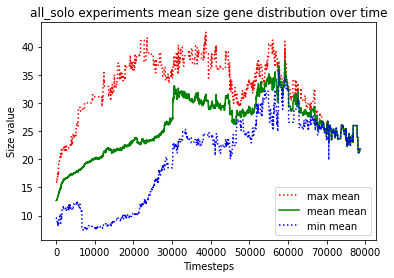

In [44]:
#getting the mean value for size gene
temp=pd.DataFrame(data = solo_minMeanMax_size)
mean_size = pd.DataFrame(data = temp[1].to_list()).replace(0, np.nan)

# getting min/max/mean of the mean size for all columns
min_mean_size = mean_size.min()
mean_mean_size = mean_size.mean()
max_mean_size = mean_size.max()

#plotting these for inspection of the experiments
fig = plt.figure()#figsize=(10,10))
ax = plt.axes()
plt.title("all_solo experiments mean size gene distribution over time")
plt.xlabel("Timesteps")
plt.ylabel("Size value")
plt.plot(max_mean_size, ':r', label='max mean')
plt.plot(mean_mean_size, '-g', label='mean mean')
plt.plot(min_mean_size, ':b', label='min mean')

plt.legend()
plt.show()
fig.savefig('_all_solo/plots/size.png')
plt.close()

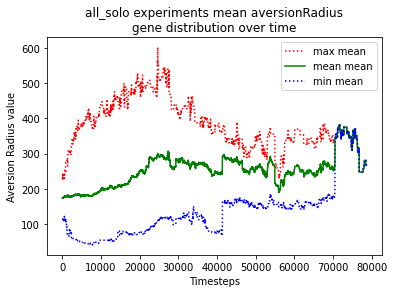

In [45]:
#getting the mean value for aversionRadius gene
temp=pd.DataFrame(data = solo_minMeanMax_aversionRadius)
mean_aversionRadius = pd.DataFrame(data = temp[1].to_list()).replace(0, np.nan)

# getting min/max/mean of the mean aversionRadius for all columns
min_mean_aversionRadius = mean_aversionRadius.min()
mean_mean_aversionRadius = mean_aversionRadius.mean()
max_mean_aversionRadius = mean_aversionRadius.max()

#plotting these for inspection of the experiments
fig = plt.figure()#figsize=(10,10))
ax = plt.axes()
plt.title("all_solo experiments mean aversionRadius\ngene distribution over time")
plt.xlabel("Timesteps")
plt.ylabel("Aversion Radius value")
plt.plot(max_mean_aversionRadius, ':r', label='max mean')
plt.plot(mean_mean_aversionRadius, '-g', label='mean mean')
plt.plot(min_mean_aversionRadius, ':b', label='min mean')

plt.legend()
plt.show()
fig.savefig('_all_solo/plots/aversionRadius.png')
plt.close()

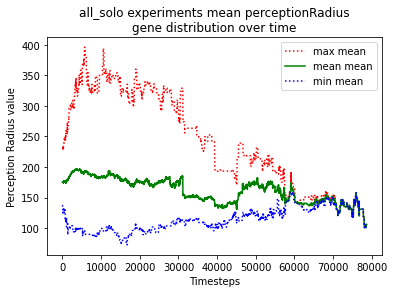

In [46]:
#getting the mean value for perceptionRadius gene
temp=pd.DataFrame(data = solo_minMeanMax_perceptionRadius)
mean_perceptionRadius = pd.DataFrame(data = temp[1].to_list()).replace(0, np.nan)

# getting min/max/mean of the mean perceptionRadius for all columns
min_mean_perceptionRadius = mean_perceptionRadius.min()
mean_mean_perceptionRadius = mean_perceptionRadius.mean()
max_mean_perceptionRadius = mean_perceptionRadius.max()

#plotting these for inspection of the experiments
fig = plt.figure()#figsize=(10,10))
ax = plt.axes()
plt.title("all_solo experiments mean perceptionRadius\ngene distribution over time")
plt.xlabel("Timesteps")
plt.ylabel("Perception Radius value")
plt.plot(max_mean_perceptionRadius, ':r', label='max mean')
plt.plot(mean_mean_perceptionRadius, '-g', label='mean mean')
plt.plot(min_mean_perceptionRadius, ':b', label='min mean')

plt.legend()
plt.show()
fig.savefig('_all_solo/plots/perceptionRadius.png')
plt.close()

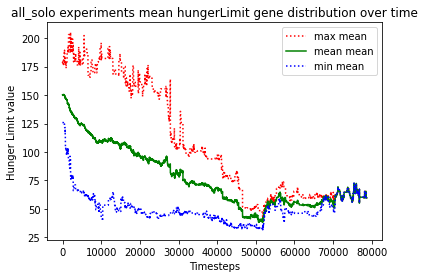

In [47]:
#getting the mean value for hungerLimit gene
temp=pd.DataFrame(data = solo_minMeanMax_hungerLimit)
mean_hungerLimit = pd.DataFrame(data = temp[1].to_list()).replace(0, np.nan)

# getting min/max/mean of the mean hungerLimit for all columns
min_mean_hungerLimit = mean_hungerLimit.min()
mean_mean_hungerLimit = mean_hungerLimit.mean()
max_mean_hungerLimit = mean_hungerLimit.max()

#plotting these for inspection of the experiments
fig = plt.figure()#figsize=(10,10))
ax = plt.axes()
plt.title("all_solo experiments mean hungerLimit gene distribution over time")
plt.xlabel("Timesteps")
plt.ylabel("Hunger Limit value")
plt.plot(max_mean_hungerLimit, ':r', label='max mean')
plt.plot(mean_mean_hungerLimit, '-g', label='mean mean')
plt.plot(min_mean_hungerLimit, ':b', label='min mean')

plt.legend()
plt.show()
fig.savefig('_all_solo/plots/hungerLimit.png')
plt.close()

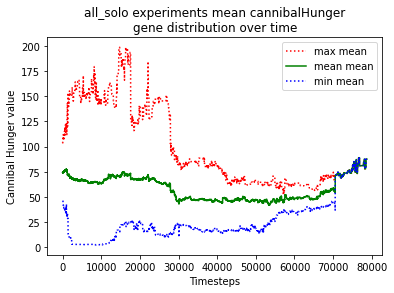

In [48]:
#getting the mean value for canibalHunger gene
temp=pd.DataFrame(data = solo_minMeanMax_canibalHunger)
mean_canibalHunger = pd.DataFrame(data = temp[1].to_list()).replace(0, np.nan)

# getting min/max/mean of the mean canibalHunger for all columns
min_mean_canibalHunger = mean_canibalHunger.min()
mean_mean_canibalHunger = mean_canibalHunger.mean()
max_mean_canibalHunger = mean_canibalHunger.max()

#plotting these for inspection of the experiments
fig = plt.figure()#figsize=(10,10))
ax = plt.axes()
plt.title("all_solo experiments mean cannibalHunger\ngene distribution over time")
plt.xlabel("Timesteps")
plt.ylabel("Cannibal Hunger value")
plt.plot(max_mean_canibalHunger, ':r', label='max mean')
plt.plot(mean_mean_canibalHunger, '-g', label='mean mean')
plt.plot(min_mean_canibalHunger, ':b', label='min mean')

plt.legend()
plt.show()
fig.savefig('_all_solo/plots/canibalHunger.png')
plt.close()

### Boids fish

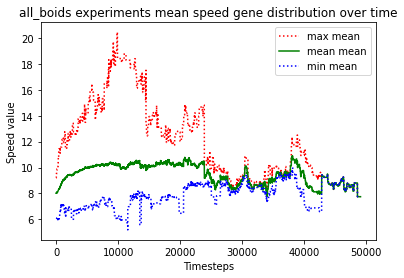

In [49]:
#getting the mean value for speed gene
temp=pd.DataFrame(data = boids_minMeanMax_speed)
mean_speed = pd.DataFrame(data = temp[1].to_list()).replace(0, np.nan)

# getting min/max/mean of the mean speed for all columns
min_mean_speed = mean_speed.min()
mean_mean_speed = mean_speed.mean()
max_mean_speed = mean_speed.max()

#plotting these for inspection of the experiments
fig = plt.figure()#figsize=(10,10))
ax = plt.axes()
plt.title("all_boids experiments mean speed gene distribution over time")
plt.xlabel("Timesteps")
plt.ylabel("Speed value")
plt.plot(max_mean_speed, ':r', label='max mean')
plt.plot(mean_mean_speed, '-g', label='mean mean')
plt.plot(min_mean_speed, ':b', label='min mean')

plt.legend()
plt.show()
fig.savefig('_all_boids/plots/speed.png')
plt.close()

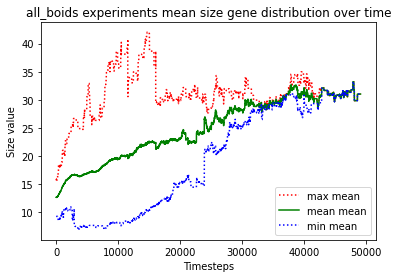

In [50]:
#getting the mean value for size gene
temp=pd.DataFrame(data = boids_minMeanMax_size)
mean_size = pd.DataFrame(data = temp[1].to_list()).replace(0, np.nan)

# getting min/max/mean of the mean size for all columns
min_mean_size = mean_size.min()
mean_mean_size = mean_size.mean()
max_mean_size = mean_size.max()

#plotting these for inspection of the experiments
fig = plt.figure()#figsize=(10,10))
ax = plt.axes()
plt.title("all_boids experiments mean size gene distribution over time")
plt.xlabel("Timesteps")
plt.ylabel("Size value")
plt.plot(max_mean_size, ':r', label='max mean')
plt.plot(mean_mean_size, '-g', label='mean mean')
plt.plot(min_mean_size, ':b', label='min mean')

plt.legend()
plt.show()
fig.savefig('_all_boids/plots/size.png')
plt.close()

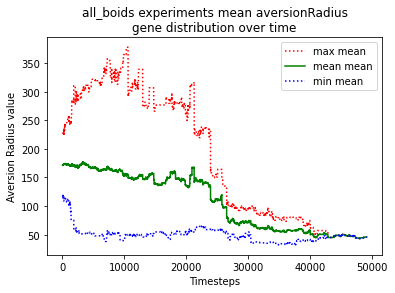

In [51]:
#getting the mean value for aversionRadius gene
temp=pd.DataFrame(data = boids_minMeanMax_aversionRadius)
mean_aversionRadius = pd.DataFrame(data = temp[1].to_list()).replace(0, np.nan)

# getting min/max/mean of the mean aversionRadius for all columns
min_mean_aversionRadius = mean_aversionRadius.min()
mean_mean_aversionRadius = mean_aversionRadius.mean()
max_mean_aversionRadius = mean_aversionRadius.max()

#plotting these for inspection of the experiments
fig = plt.figure()#figsize=(10,10))
ax = plt.axes()
plt.title("all_boids experiments mean aversionRadius\ngene distribution over time")
plt.xlabel("Timesteps")
plt.ylabel("Aversion Radius value")
plt.plot(max_mean_aversionRadius, ':r', label='max mean')
plt.plot(mean_mean_aversionRadius, '-g', label='mean mean')
plt.plot(min_mean_aversionRadius, ':b', label='min mean')

plt.legend()
plt.show()
fig.savefig('_all_boids/plots/aversionRadius.png')
plt.close()

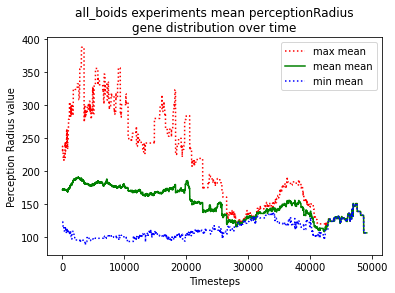

In [52]:
#getting the mean value for perceptionRadius gene
temp=pd.DataFrame(data = boids_minMeanMax_perceptionRadius)
mean_perceptionRadius = pd.DataFrame(data = temp[1].to_list()).replace(0, np.nan)

# getting min/max/mean of the mean perceptionRadius for all columns
min_mean_perceptionRadius = mean_perceptionRadius.min()
mean_mean_perceptionRadius = mean_perceptionRadius.mean()
max_mean_perceptionRadius = mean_perceptionRadius.max()

#plotting these for inspection of the experiments
fig = plt.figure()#figsize=(10,10))
ax = plt.axes()
plt.title("all_boids experiments mean perceptionRadius\ngene distribution over time")
plt.xlabel("Timesteps")
plt.ylabel("Perception Radius value")
plt.plot(max_mean_perceptionRadius, ':r', label='max mean')
plt.plot(mean_mean_perceptionRadius, '-g', label='mean mean')
plt.plot(min_mean_perceptionRadius, ':b', label='min mean')

plt.legend()
plt.show()
fig.savefig('_all_boids/plots/perceptionRadius.png')
plt.close()

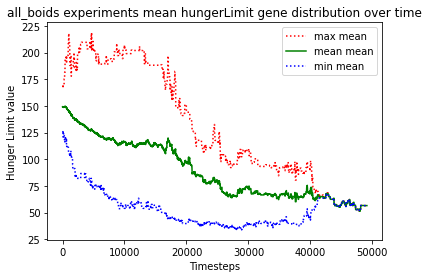

In [53]:
#getting the mean value for hungerLimit gene
temp=pd.DataFrame(data = boids_minMeanMax_hungerLimit)
mean_hungerLimit = pd.DataFrame(data = temp[1].to_list()).replace(0, np.nan)

# getting min/max/mean of the mean hungerLimit for all columns
min_mean_hungerLimit = mean_hungerLimit.min()
mean_mean_hungerLimit = mean_hungerLimit.mean()
max_mean_hungerLimit = mean_hungerLimit.max()

#plotting these for inspection of the experiments
fig = plt.figure()#figsize=(10,10))
ax = plt.axes()
plt.title("all_boids experiments mean hungerLimit gene distribution over time")
plt.xlabel("Timesteps")
plt.ylabel("Hunger Limit value")
plt.plot(max_mean_hungerLimit, ':r', label='max mean')
plt.plot(mean_mean_hungerLimit, '-g', label='mean mean')
plt.plot(min_mean_hungerLimit, ':b', label='min mean')

plt.legend()
plt.show()
fig.savefig('_all_boids/plots/hungerLimit.png')
plt.close()

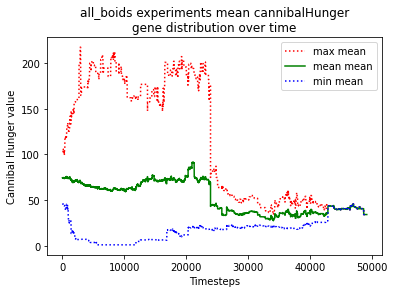

In [54]:
#getting the mean value for canibalHunger gene
temp=pd.DataFrame(data = boids_minMeanMax_canibalHunger)
mean_canibalHunger = pd.DataFrame(data = temp[1].to_list()).replace(0, np.nan)

# getting min/max/mean of the mean canibalHunger for all columns
min_mean_canibalHunger = mean_canibalHunger.min()
mean_mean_canibalHunger = mean_canibalHunger.mean()
max_mean_canibalHunger = mean_canibalHunger.max()

#plotting these for inspection of the experiments
fig = plt.figure()#figsize=(10,10))
ax = plt.axes()
plt.title("all_boids experiments mean cannibalHunger\ngene distribution over time")
plt.xlabel("Timesteps")
plt.ylabel("Cannibal Hunger value")
plt.plot(max_mean_canibalHunger, ':r', label='max mean')
plt.plot(mean_mean_canibalHunger, '-g', label='mean mean')
plt.plot(min_mean_canibalHunger, ':b', label='min mean')

plt.legend()
plt.show()
fig.savefig('_all_boids/plots/canibalHunger.png')
plt.close()

# Boids Versus Solo Comparison Charts
## Comparing populations

In [55]:
#getting the pred and fish popsizes

#for boids
temp=pd.DataFrame(data = boids_populationSizes, columns = ["pred","fish"])
boids_preds_popsizes = pd.DataFrame(data = temp["pred"].to_list()).replace(0, np.nan)
boids_fish_popsizes = pd.DataFrame(data = temp["fish"].to_list())# getting min/max/mean of all columns

boids_min_fish = boids_fish_popsizes.min()
boids_mean_fish = boids_fish_popsizes.mean()
boids_max_fish = boids_fish_popsizes.max()

boids_min_shark = boids_preds_popsizes.min()
boids_mean_shark = boids_preds_popsizes.mean()
boids_max_shark = boids_preds_popsizes.max()




#for solo
temp=pd.DataFrame(data = solo_populationSizes, columns = ["pred","fish"])
solo_preds_popsizes = pd.DataFrame(data = temp["pred"].to_list()).replace(0, np.nan)
solo_fish_popsizes = pd.DataFrame(data = temp["fish"].to_list())# getting min/max/mean of all columns

solo_min_fish = solo_fish_popsizes.min()
solo_mean_fish = solo_fish_popsizes.mean()
solo_max_fish = solo_fish_popsizes.max()

solo_min_shark = solo_preds_popsizes.min()
solo_mean_shark = solo_preds_popsizes.mean()
solo_max_shark = solo_preds_popsizes.max()

### Comparing fish populations

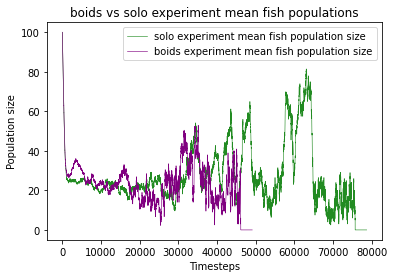

In [56]:
#plotting these for inspection of the experiments
fig = plt.figure()#figsize=(10,10))
ax = plt.axes()
plt.title("boids vs solo experiment mean fish populations")
plt.xlabel("Timesteps")
plt.ylabel("Population size")

plt.plot(solo_mean_fish, color='forestgreen', linestyle='-', lw=0.6, label='solo experiment mean fish population size')

plt.plot(boids_mean_fish, color='purple', linestyle='-', lw=0.6, label='boids experiment mean fish population size')

plt.legend()
plt.show()
fig.savefig('__boids_vs_solo/plots/_fish_mean_populations.png')
plt.close()

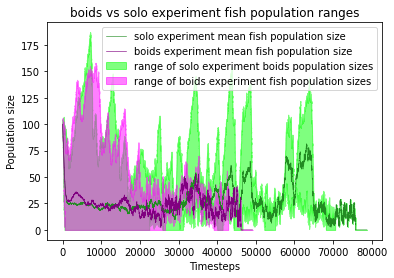

In [57]:
#plotting these for inspection of the experiments
fig = plt.figure()#figsize=(10,10))
ax = plt.axes()
plt.title("boids vs solo experiment fish population ranges")
plt.xlabel("Timesteps")
plt.ylabel("Population size")

plt.plot(solo_mean_fish, color='forestgreen', linestyle='-', lw=0.6, label='solo experiment mean fish population size')
plt.fill_between(list(range(len(solo_mean_fish))),solo_min_fish, solo_max_fish, color="lime", alpha=.5, label='range of solo experiment boids population sizes')

plt.plot(boids_mean_fish, color='purple', linestyle='-', lw=0.6, label='boids experiment mean fish population size')
plt.fill_between(list(range(len(boids_mean_fish))),boids_min_fish, boids_max_fish, color="magenta", alpha=.5, label='range of boids experiment fish population sizes')
plt.legend()
plt.show()
fig.savefig('__boids_vs_solo/plots/_fish_mean_populations_with_ranges.png')
plt.close()

In [58]:
#T-Test, checking the significant difference
t, p = ttest_ind(boids_mean_fish, solo_mean_fish)
print("T-Test on mean fish population sizes between boids and solo")
print("t = " + str(round(t,3)))#+" (higher abs score = groups are different; lower score = groups are similar)")
print("p = " + str(round(p,3)))#+" (probability that results happened by chance; lower the better)")

T-Test on mean fish population sizes between boids and solo
t = -51.594
p = 0.0


### Comparing shark populations 

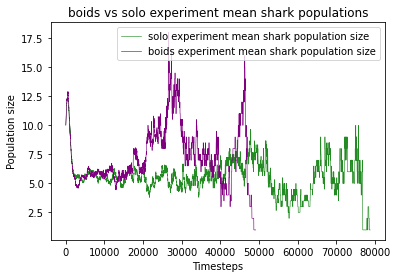

In [59]:
#plotting these for inspection of the experiments
fig = plt.figure()#figsize=(10,10))
ax = plt.axes()
plt.title("boids vs solo experiment mean shark populations")
plt.xlabel("Timesteps")
plt.ylabel("Population size")

plt.plot(solo_mean_shark, color='forestgreen', linestyle='-', lw=0.6, label='solo experiment mean shark population size')

plt.plot(boids_mean_shark, color='purple', linestyle='-', lw=0.6, label='boids experiment mean shark population size')

plt.legend()
plt.show()
fig.savefig('__boids_vs_solo/plots/_shark_mean_populations.png')
plt.close()

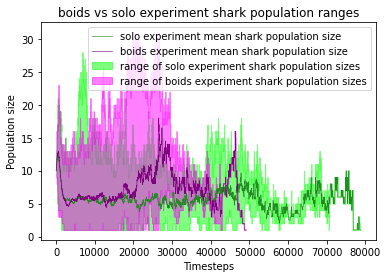

In [60]:
#plotting these for inspection of the experiments
fig = plt.figure()#figsize=(10,10))
ax = plt.axes()
plt.title("boids vs solo experiment shark population ranges")
plt.xlabel("Timesteps")
plt.ylabel("Population size")

plt.plot(solo_mean_shark, color='forestgreen', linestyle='-', lw=0.6, label='solo experiment mean shark population size')
plt.fill_between(list(range(len(solo_mean_shark))),solo_min_shark, solo_max_shark, color="lime", alpha=.5, label='range of solo experiment shark population sizes')

plt.plot(boids_mean_shark, color='purple', linestyle='-', lw=0.6, label='boids experiment mean shark population size')
plt.fill_between(list(range(len(boids_mean_shark))),boids_min_shark, boids_max_shark, color="magenta", alpha=.5, label='range of boids experiment shark population sizes')

plt.legend()
plt.show()
fig.savefig('__boids_vs_solo/plots/_shark_mean_populations_with_ranges.png')
plt.close()

In [61]:
#T-Test, checking the significant difference
t, p = ttest_ind(boids_mean_shark, solo_mean_shark)
print("T-Test on mean shark population sizes between boids and solo")
print("t = " + str(round(t,3)))#+" (higher abs score = groups are different; lower score = groups are similar)")
print("p = " + str(round(p,3)))#+" (probability that results happened by chance; lower the better)")

T-Test on mean shark population sizes between boids and solo
t = 153.604
p = 0.0


## Comparing extinction rates

In [62]:
#getting the solo and boid experiment fish and shark extinction timesteps

# SOLO
solo_fish_never_went_extinct = solo_fish_extinct_timestep.count(None)
solo_fish_no_none=solo_fish_extinct_timestep.copy()
while None in solo_fish_no_none: solo_fish_no_none.remove(None)

solo_sharks_never_went_extinct = solo_shark_extinct_timestep.count(None)
solo_sharks_no_none=solo_shark_extinct_timestep.copy()
while None in solo_sharks_no_none: solo_sharks_no_none.remove(None)
    
    
    
# BOIDS
boids_fish_never_went_extinct = boids_fish_extinct_timestep.count(None)
boids_fish_no_none=boids_fish_extinct_timestep.copy()
while None in boids_fish_no_none: boids_fish_no_none.remove(None)

boids_sharks_never_went_extinct = boids_shark_extinct_timestep.count(None)
boids_sharks_no_none=boids_shark_extinct_timestep.copy()
while None in boids_sharks_no_none: boids_sharks_no_none.remove(None)

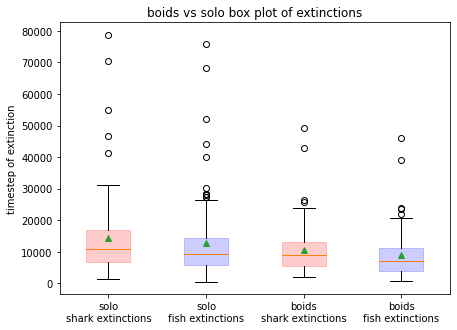

In [63]:
# box plot of extinctions
fig=plt.figure(figsize=(7,5))
bp=plt.boxplot([solo_sharks_no_none, solo_fish_no_none, boids_sharks_no_none, boids_fish_no_none], labels=["solo\nshark extinctions","solo\nfish extinctions", "boids\nshark extinctions","boids\nfish extinctions"], showmeans=True, patch_artist=True)

i=0
for box in bp['boxes']:
    if i%2==1:
        box.set(color='blue', alpha=0.2) 
    else:
        box.set(color='red', alpha=0.2)
    i+=1

plt.ylabel("timestep of extinction")
plt.title("boids vs solo box plot of extinctions")
plt.show()
fig.savefig("__boids_vs_solo/plots/box_all_extinctions.png")

In [64]:
#just plotting without patch artist so below function works
bp=plt.boxplot([solo_sharks_no_none, solo_fish_no_none, boids_sharks_no_none, boids_fish_no_none], labels=["solo\nshark extinctions","solo\nfish extinctions", "boids\nshark extinctions","boids\nfish extinctions"], showmeans=True)
plt.close()
#getting the dataframe annotating the box plot
temp=get_box_plot_data(["solo\nshark extinctions","solo\nfish extinctions","boids\nshark extinctions","boids\nfish extinctions"], bp)
temp["max"]=[max(solo_sharks_no_none),max(solo_fish_no_none),max(boids_sharks_no_none),max(boids_fish_no_none)]
temp["min"]=[min(solo_sharks_no_none),min(solo_fish_no_none),min(boids_sharks_no_none),min(boids_fish_no_none)]
temp["number of runs without extinction"]=[solo_shark_extinct_timestep.count(None),solo_fish_extinct_timestep.count(None),boids_shark_extinct_timestep.count(None),boids_fish_extinct_timestep.count(None)]
temp

,label,lower_whisker,lower_quartile,median,mean,upper_quartile,upper_whisker,max,min,number of runs without extinction
0,solo: shark extinctions,1361.0,6708.25,11027.5,14521.66,16767.50,31140.0,78732,1361,0
1,solo: fish extinctions,499.0,5926.00,9176.0,12919.39,14360.00,26259.0,75762,499,3
2,boids: shark extinctions,2076.0,5603.50,9136.5,10479.69,13019.75,23908.0,49132,2076,0
3,boids: fish extinctions,643.0,4039.50,7182.0,8888.88,11067.50,20756.0,46167,643,1


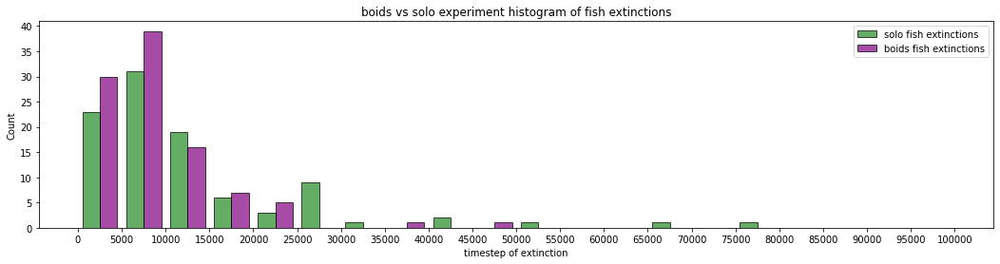

In [65]:
fig = plt.figure(figsize=(18,4))
plt.hist([solo_fish_no_none, boids_fish_no_none], color=['forestgreen','purple'], ec="k",alpha=0.7, bins=range(0,100001,5000))
plt.xticks(range(0,100001,5000))

handles = [Rectangle((0,0),1,1,color=c,ec="k", alpha=0.7) for c in ['forestgreen','purple']]
labels=["solo fish extinctions","boids fish extinctions"]
plt.legend(handles, labels)

plt.title("boids vs solo experiment histogram of fish extinctions")
plt.xlabel("timestep of extinction")
plt.ylabel("Count")

fig.savefig('__boids_vs_solo/plots/fish_extinctions.png')
plt.show()
plt.close()

In [66]:
#T-Test, checking the significant difference
t, p = ttest_ind(boids_fish_no_none, solo_fish_no_none)
print("T-Test on fish extinctions between boids and solo")
print("t = " + str(round(t,3)))#+" (higher abs score = groups are different; lower score = groups are similar)")
print("p = " + str(round(p,3)))#+" (probability that results happened by chance; lower the better)")

T-Test on fish extinctions between boids and solo
t = -2.7
p = 0.008


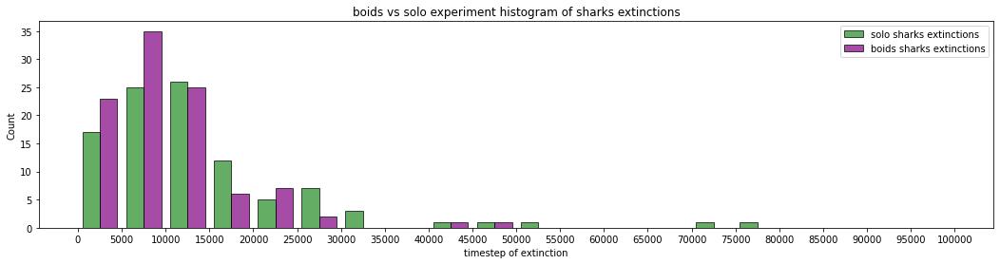

In [67]:
fig = plt.figure(figsize=(18,4))
plt.hist([solo_sharks_no_none, boids_sharks_no_none], color=['forestgreen','purple'], ec="k",alpha=0.7, bins=range(0,100001,5000))
plt.xticks(range(0,100001,5000))

handles = [Rectangle((0,0),1,1,color=c,ec="k", alpha=0.7) for c in ['forestgreen','purple']]
labels=["solo sharks extinctions","boids sharks extinctions"]
plt.legend(handles, labels)

plt.title("boids vs solo experiment histogram of sharks extinctions")
plt.xlabel("timestep of extinction")
plt.ylabel("Count")

fig.savefig('__boids_vs_solo/plots/sharks_extinctions.png')
plt.show()
plt.close()

In [68]:
#T-Test, checking the significant difference
t, p = ttest_ind(boids_sharks_no_none,solo_sharks_no_none)
print("T-Test on shark extinctions between boids and solo")
print("t = " + str(round(t,3)))#+" (higher abs score = groups are different; lower score = groups are similar)")
print("p = " + str(round(p,3)))#+" (probability that results happened by chance; lower the better)")

T-Test on shark extinctions between boids and solo
t = -2.686
p = 0.008


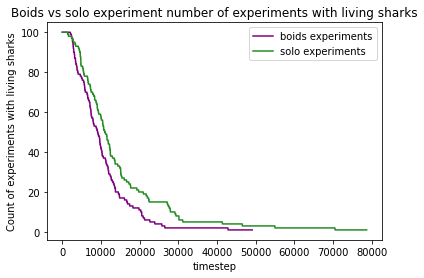

In [69]:
fig = plt.figure()
plt.title("Boids vs solo experiment number of experiments with living sharks")
plt.xlabel("timestep")
plt.ylabel("Count of experiments with living sharks")
plt.plot(boids_preds_popsizes.count(), color='purple', label = "boids experiments")
plt.plot(solo_preds_popsizes.count(), color='forestgreen', label = "solo experiments")
plt.legend()
plt.show()
fig.savefig('__boids_vs_solo/plots/_count_experiments_with_life.png')
plt.close()

In [70]:
#T-Test, checking the significant difference
t, p = ttest_ind(boids_preds_popsizes.count(), solo_preds_popsizes.count())
print("T-Test on run time of experiments between boids and solo")
print("t = " + str(round(t,3)))#+" (higher abs score = groups are different; lower score = groups are similar)")
print("p = " + str(round(p,3)))#+" (probability that results happened by chance; lower the better)")

T-Test on run time of experiments between boids and solo
t = 17.598
p = 0.0


## Comparing genes

### speed

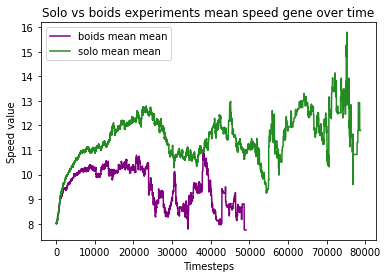

In [71]:
#getting the SOLO speed values
temp=pd.DataFrame(data = solo_minMeanMax_speed)
solo_mean_speed = pd.DataFrame(data = temp[1].to_list()).replace(0, np.nan)
solo_min_mean_speed = solo_mean_speed.min()
solo_mean_mean_speed = solo_mean_speed.mean()
solo_max_mean_speed = solo_mean_speed.max()

#getting the BOIDS speed values
temp=pd.DataFrame(data = boids_minMeanMax_speed)
boids_mean_speed = pd.DataFrame(data = temp[1].to_list()).replace(0, np.nan)
boids_min_mean_speed = boids_mean_speed.min()
boids_mean_mean_speed = boids_mean_speed.mean()
boids_max_mean_speed = boids_mean_speed.max()

#plotting these for inspection of the experiments
fig = plt.figure()#figsize=(10,10))
ax = plt.axes()
plt.title("Solo vs boids experiments mean speed gene over time")
plt.xlabel("Timesteps")
plt.ylabel("Speed value")

plt.plot(boids_mean_mean_speed, label='boids mean mean', color='purple')
plt.plot(solo_mean_mean_speed, label='solo mean mean', color='forestgreen')

plt.legend()
plt.show()
fig.savefig('__boids_vs_solo/plots/speed.png')
plt.close()

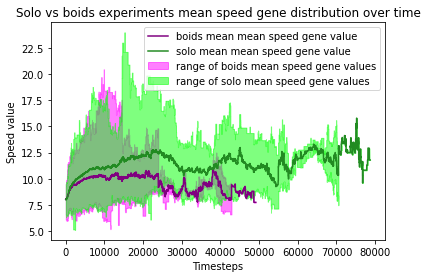

In [72]:
#plotting these for inspection of the experiments
fig = plt.figure()#figsize=(10,10))
ax = plt.axes()
plt.title("Solo vs boids experiments mean speed gene distribution over time")
plt.xlabel("Timesteps")
plt.ylabel("Speed value")

plt.plot(boids_mean_mean_speed, label='boids mean mean speed gene value', color='purple')
plt.plot(solo_mean_mean_speed, label='solo mean mean speed gene value', color='forestgreen')

plt.fill_between(list(range(len(boids_mean_mean_speed))),boids_min_mean_speed, boids_max_mean_speed, color="magenta", alpha=.5, label='range of boids mean speed gene values')
plt.fill_between(list(range(len(solo_mean_mean_speed))),solo_min_mean_speed, solo_max_mean_speed, color="lime", alpha=.5, label='range of solo mean speed gene values')

plt.legend()
plt.show()
fig.savefig('__boids_vs_solo/plots/speed_with_ranges.png')
plt.close()

In [73]:
#T-Test, checking the significant difference
t, p = ttest_ind(boids_mean_mean_speed, solo_mean_mean_speed)
print("T-Test on speed gene mean values between boids and solo")
print("t = " + str(round(t,3)))#+" (higher abs score = groups are different; lower score = groups are similar)")
print("p = " + str(round(p,3)))#+" (probability that results happened by chance; lower the better)")

T-Test on speed gene mean values between boids and solo
t = -395.314
p = 0.0


### size

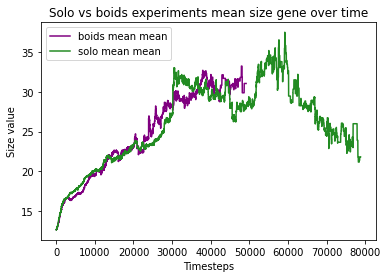

In [74]:
#getting the SOLO size values
temp=pd.DataFrame(data = solo_minMeanMax_size)
solo_mean_size = pd.DataFrame(data = temp[1].to_list()).replace(0, np.nan)
solo_min_mean_size = solo_mean_size.min()
solo_mean_mean_size = solo_mean_size.mean()
solo_max_mean_size = solo_mean_size.max()

#getting the BOIDS size values
temp=pd.DataFrame(data = boids_minMeanMax_size)
boids_mean_size = pd.DataFrame(data = temp[1].to_list()).replace(0, np.nan)
boids_min_mean_size = boids_mean_size.min()
boids_mean_mean_size = boids_mean_size.mean()
boids_max_mean_size = boids_mean_size.max()

#plotting these for inspection of the experiments
fig = plt.figure()#figsize=(10,10))
ax = plt.axes()
plt.title("Solo vs boids experiments mean size gene over time")
plt.xlabel("Timesteps")
plt.ylabel("Size value")

plt.plot(boids_mean_mean_size, label='boids mean mean', color='purple')
plt.plot(solo_mean_mean_size, label='solo mean mean', color='forestgreen')

plt.legend()
plt.show()
fig.savefig('__boids_vs_solo/plots/size.png')
plt.close()

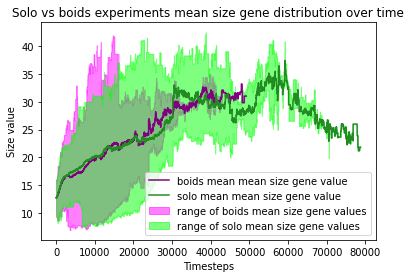

In [75]:
#plotting these for inspection of the experiments
fig = plt.figure()#figsize=(10,10))
ax = plt.axes()
plt.title("Solo vs boids experiments mean size gene distribution over time")
plt.xlabel("Timesteps")
plt.ylabel("Size value")

plt.plot(boids_mean_mean_size, label='boids mean mean size gene value', color='purple')
plt.plot(solo_mean_mean_size, label='solo mean mean size gene value', color='forestgreen')

plt.fill_between(list(range(len(boids_mean_mean_size))),boids_min_mean_size, boids_max_mean_size, color="magenta", alpha=.5, label='range of boids mean size gene values')
plt.fill_between(list(range(len(solo_mean_mean_size))),solo_min_mean_size, solo_max_mean_size, color="lime", alpha=.5, label='range of solo mean size gene values')

plt.legend()
plt.show()
fig.savefig('__boids_vs_solo/plots/size_with_ranges.png')
plt.close()

In [76]:
#T-Test, checking the significant difference
t, p = ttest_ind(boids_mean_mean_size, solo_mean_mean_size)
print("T-Test on size gene mean values between boids and solo")
print("t = " + str(round(t,3)))#+" (higher abs score = groups are different; lower score = groups are similar)")
print("p = " + str(round(p,3)))#+" (probability that results happened by chance; lower the better)")

T-Test on size gene mean values between boids and solo
t = -38.28
p = 0.0


### Aversion radius

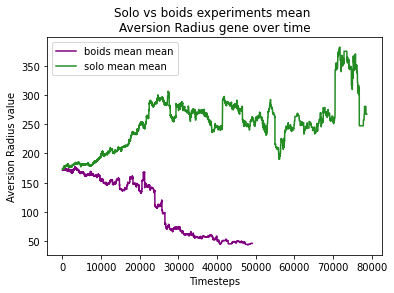

In [77]:
#getting the SOLO aversionRadius values
temp=pd.DataFrame(data = solo_minMeanMax_aversionRadius)
solo_mean_aversionRadius = pd.DataFrame(data = temp[1].to_list()).replace(0, np.nan)
solo_min_mean_aversionRadius = solo_mean_aversionRadius.min()
solo_mean_mean_aversionRadius = solo_mean_aversionRadius.mean()
solo_max_mean_aversionRadius = solo_mean_aversionRadius.max()

#getting the BOIDS aversionRadius values
temp=pd.DataFrame(data = boids_minMeanMax_aversionRadius)
boids_mean_aversionRadius = pd.DataFrame(data = temp[1].to_list()).replace(0, np.nan)
boids_min_mean_aversionRadius = boids_mean_aversionRadius.min()
boids_mean_mean_aversionRadius = boids_mean_aversionRadius.mean()
boids_max_mean_aversionRadius = boids_mean_aversionRadius.max()

#plotting these for inspection of the experiments
fig = plt.figure()#figsize=(10,10))
ax = plt.axes()
plt.title("Solo vs boids experiments mean \nAversion Radius gene over time")
plt.xlabel("Timesteps")
plt.ylabel("Aversion Radius value")

plt.plot(boids_mean_mean_aversionRadius, label='boids mean mean', color='purple')
plt.plot(solo_mean_mean_aversionRadius, label='solo mean mean', color='forestgreen')

plt.legend()
plt.show()
fig.savefig('__boids_vs_solo/plots/aversionRadius.png')
plt.close()

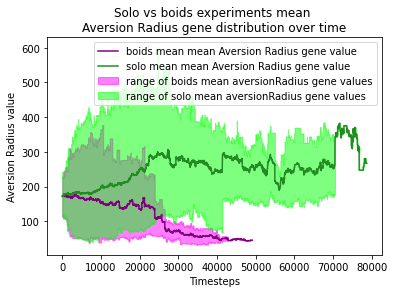

In [78]:
#plotting these for inspection of the experiments
fig = plt.figure()#figsize=(10,10))
ax = plt.axes()
plt.title("Solo vs boids experiments mean \nAversion Radius gene distribution over time")
plt.xlabel("Timesteps")
plt.ylabel("Aversion Radius value")

plt.plot(boids_mean_mean_aversionRadius, label='boids mean mean Aversion Radius gene value', color='purple')
plt.plot(solo_mean_mean_aversionRadius, label='solo mean mean Aversion Radius gene value', color='forestgreen')

plt.fill_between(list(range(len(boids_mean_mean_aversionRadius))),boids_min_mean_aversionRadius, boids_max_mean_aversionRadius, color="magenta", alpha=.5, label='range of boids mean aversionRadius gene values')
plt.fill_between(list(range(len(solo_mean_mean_aversionRadius))),solo_min_mean_aversionRadius, solo_max_mean_aversionRadius, color="lime", alpha=.5, label='range of solo mean aversionRadius gene values')

plt.legend()
plt.show()
fig.savefig('__boids_vs_solo/plots/aversionRadius_with_ranges.png')
plt.close()

In [79]:
#T-Test, checking the significant difference
t, p = ttest_ind(boids_mean_mean_aversionRadius, solo_mean_mean_aversionRadius)
print("T-Test on aversionRadius gene mean values between boids and solo")
print("t = " + str(round(t,3)))#+" (higher abs score = groups are different; lower score = groups are similar)")
print("p = " + str(round(p,3)))#+" (probability that results happened by chance; lower the better)")

T-Test on aversionRadius gene mean values between boids and solo
t = -544.14
p = 0.0


### Perception Radius

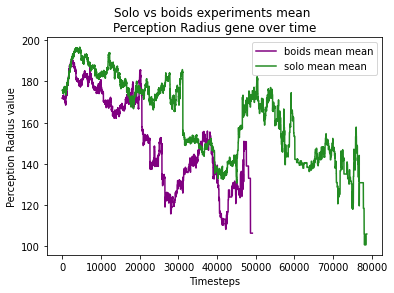

In [80]:
#getting the SOLO perceptionRadius values
temp=pd.DataFrame(data = solo_minMeanMax_perceptionRadius)
solo_mean_perceptionRadius = pd.DataFrame(data = temp[1].to_list()).replace(0, np.nan)
solo_min_mean_perceptionRadius = solo_mean_perceptionRadius.min()
solo_mean_mean_perceptionRadius = solo_mean_perceptionRadius.mean()
solo_max_mean_perceptionRadius = solo_mean_perceptionRadius.max()

#getting the BOIDS perceptionRadius values
temp=pd.DataFrame(data = boids_minMeanMax_perceptionRadius)
boids_mean_perceptionRadius = pd.DataFrame(data = temp[1].to_list()).replace(0, np.nan)
boids_min_mean_perceptionRadius = boids_mean_perceptionRadius.min()
boids_mean_mean_perceptionRadius = boids_mean_perceptionRadius.mean()
boids_max_mean_perceptionRadius = boids_mean_perceptionRadius.max()

#plotting these for inspection of the experiments
fig = plt.figure()#figsize=(10,10))
ax = plt.axes()
plt.title("Solo vs boids experiments mean \nPerception Radius gene over time")
plt.xlabel("Timesteps")
plt.ylabel("Perception Radius value")

plt.plot(boids_mean_mean_perceptionRadius, label='boids mean mean', color='purple')
plt.plot(solo_mean_mean_perceptionRadius, label='solo mean mean', color='forestgreen')

plt.legend()
plt.show()
fig.savefig('__boids_vs_solo/plots/perceptionRadius.png')
plt.close()

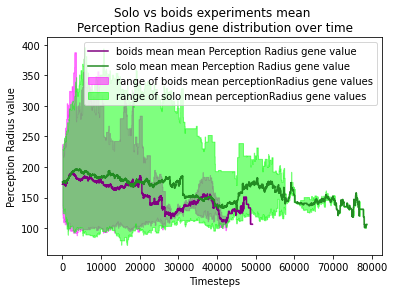

In [81]:
#plotting these for inspection of the experiments
fig = plt.figure()#figsize=(10,10))
ax = plt.axes()
plt.title("Solo vs boids experiments mean \nPerception Radius gene distribution over time")
plt.xlabel("Timesteps")
plt.ylabel("Perception Radius value")

plt.plot(boids_mean_mean_perceptionRadius, label='boids mean mean Perception Radius gene value', color='purple')
plt.plot(solo_mean_mean_perceptionRadius, label='solo mean mean Perception Radius gene value', color='forestgreen')

plt.fill_between(list(range(len(boids_mean_mean_perceptionRadius))),boids_min_mean_perceptionRadius, boids_max_mean_perceptionRadius, color="magenta", alpha=.5, label='range of boids mean perceptionRadius gene values')
plt.fill_between(list(range(len(solo_mean_mean_perceptionRadius))),solo_min_mean_perceptionRadius, solo_max_mean_perceptionRadius, color="lime", alpha=.5, label='range of solo mean perceptionRadius gene values')

plt.legend()
plt.show()
fig.savefig('__boids_vs_solo/plots/perceptionRadius_with_ranges.png')
plt.close()

In [82]:
#T-Test, checking the significant difference
t, p = ttest_ind(boids_mean_mean_perceptionRadius, solo_mean_mean_perceptionRadius)
print("T-Test on perceptionRadius gene mean values between boids and solo")
print("t = " + str(round(t,3)))#+" (higher abs score = groups are different; lower score = groups are similar)")
print("p = " + str(round(p,3)))#+" (probability that results happened by chance; lower the better)")

T-Test on perceptionRadius gene mean values between boids and solo
t = -77.579
p = 0.0


### Hunger Limit

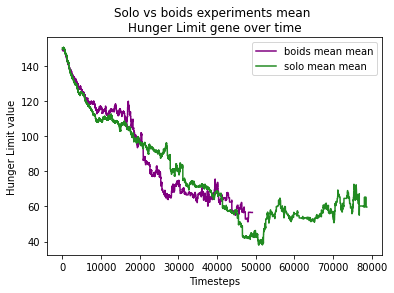

In [83]:
#getting the SOLO hungerLimit values
temp=pd.DataFrame(data = solo_minMeanMax_hungerLimit)
solo_mean_hungerLimit = pd.DataFrame(data = temp[1].to_list()).replace(0, np.nan)
solo_min_mean_hungerLimit = solo_mean_hungerLimit.min()
solo_mean_mean_hungerLimit = solo_mean_hungerLimit.mean()
solo_max_mean_hungerLimit = solo_mean_hungerLimit.max()

#getting the BOIDS hungerLimit values
temp=pd.DataFrame(data = boids_minMeanMax_hungerLimit)
boids_mean_hungerLimit = pd.DataFrame(data = temp[1].to_list()).replace(0, np.nan)
boids_min_mean_hungerLimit = boids_mean_hungerLimit.min()
boids_mean_mean_hungerLimit = boids_mean_hungerLimit.mean()
boids_max_mean_hungerLimit = boids_mean_hungerLimit.max()

#plotting these for inspection of the experiments
fig = plt.figure()#figsize=(10,10))
ax = plt.axes()
plt.title("Solo vs boids experiments mean \nHunger Limit gene over time")
plt.xlabel("Timesteps")
plt.ylabel("Hunger Limit value")

plt.plot(boids_mean_mean_hungerLimit, label='boids mean mean', color='purple')
plt.plot(solo_mean_mean_hungerLimit, label='solo mean mean', color='forestgreen')

plt.legend()
plt.show()
fig.savefig('__boids_vs_solo/plots/hungerLimit.png')
plt.close()

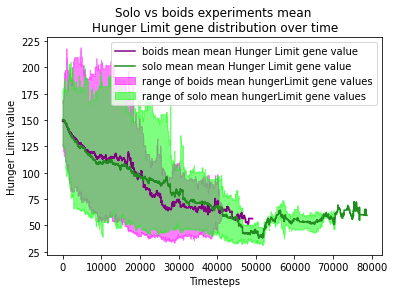

In [84]:
#plotting these for inspection of the experiments
fig = plt.figure()#figsize=(10,10))
ax = plt.axes()
plt.title("Solo vs boids experiments mean \nHunger Limit gene distribution over time")
plt.xlabel("Timesteps")
plt.ylabel("Hunger Limit value")

plt.plot(boids_mean_mean_hungerLimit, label='boids mean mean Hunger Limit gene value', color='purple')
plt.plot(solo_mean_mean_hungerLimit, label='solo mean mean Hunger Limit gene value', color='forestgreen')

plt.fill_between(list(range(len(boids_mean_mean_hungerLimit))),boids_min_mean_hungerLimit, boids_max_mean_hungerLimit, color="magenta", alpha=.5, label='range of boids mean hungerLimit gene values')
plt.fill_between(list(range(len(solo_mean_mean_hungerLimit))),solo_min_mean_hungerLimit, solo_max_mean_hungerLimit, color="lime", alpha=.5, label='range of solo mean hungerLimit gene values')

plt.legend()
plt.show()
fig.savefig('__boids_vs_solo/plots/hungerLimit_with_ranges.png')
plt.close()

In [85]:
#T-Test, checking the significant difference
t, p = ttest_ind(boids_mean_mean_hungerLimit, solo_mean_mean_hungerLimit)
print("T-Test on hungerLimit gene mean values between boids and solo")
print("t = " + str(round(t,3)))#+" (higher abs score = groups are different; lower score = groups are similar)")
print("p = " + str(round(p,3)))#+" (probability that results happened by chance; lower the better)")

T-Test on hungerLimit gene mean values between boids and solo
t = 77.108
p = 0.0


### Cannibal Hunger

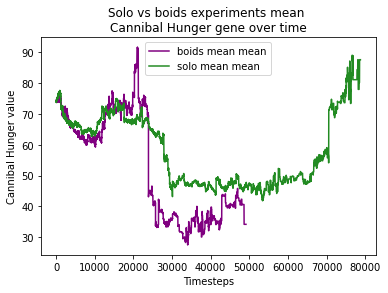

In [86]:
#getting the SOLO canibalHunger values
temp=pd.DataFrame(data = solo_minMeanMax_canibalHunger)
solo_mean_canibalHunger = pd.DataFrame(data = temp[1].to_list()).replace(0, np.nan)
solo_min_mean_canibalHunger = solo_mean_canibalHunger.min()
solo_mean_mean_canibalHunger = solo_mean_canibalHunger.mean()
solo_max_mean_canibalHunger = solo_mean_canibalHunger.max()

#getting the BOIDS canibalHunger values
temp=pd.DataFrame(data = boids_minMeanMax_canibalHunger)
boids_mean_canibalHunger = pd.DataFrame(data = temp[1].to_list()).replace(0, np.nan)
boids_min_mean_canibalHunger = boids_mean_canibalHunger.min()
boids_mean_mean_canibalHunger = boids_mean_canibalHunger.mean()
boids_max_mean_canibalHunger = boids_mean_canibalHunger.max()

#plotting these for inspection of the experiments
fig = plt.figure()#figsize=(10,10))
ax = plt.axes()
plt.title("Solo vs boids experiments mean \nCannibal Hunger gene over time")
plt.xlabel("Timesteps")
plt.ylabel("Cannibal Hunger value")

plt.plot(boids_mean_mean_canibalHunger, label='boids mean mean', color='purple')
plt.plot(solo_mean_mean_canibalHunger, label='solo mean mean', color='forestgreen')

plt.legend()
plt.show()
fig.savefig('__boids_vs_solo/plots/cannibalHunger.png')
plt.close()

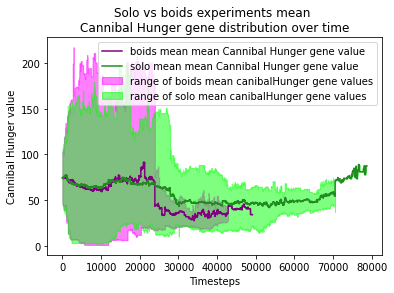

In [87]:
#plotting these for inspection of the experiments
fig = plt.figure()#figsize=(10,10))
ax = plt.axes()
plt.title("Solo vs boids experiments mean \nCannibal Hunger gene distribution over time")
plt.xlabel("Timesteps")
plt.ylabel("Cannibal Hunger value")

plt.plot(boids_mean_mean_canibalHunger, label='boids mean mean Cannibal Hunger gene value', color='purple')
plt.plot(solo_mean_mean_canibalHunger, label='solo mean mean Cannibal Hunger gene value', color='forestgreen')

plt.fill_between(list(range(len(boids_mean_mean_canibalHunger))),boids_min_mean_canibalHunger, boids_max_mean_canibalHunger, color="magenta", alpha=.5, label='range of boids mean canibalHunger gene values')
plt.fill_between(list(range(len(solo_mean_mean_canibalHunger))),solo_min_mean_canibalHunger, solo_max_mean_canibalHunger, color="lime", alpha=.5, label='range of solo mean canibalHunger gene values')

plt.legend()
plt.show()
fig.savefig('__boids_vs_solo/plots/cannibalHunger_with_ranges.png')
plt.close()

In [88]:
#T-Test, checking the significant difference
t, p = ttest_ind(boids_mean_mean_canibalHunger, solo_mean_mean_canibalHunger)
print("T-Test on cannibalHunger gene mean values between boids and solo")
print("t = " + str(round(t,3)))#+" (higher abs score = groups are different; lower score = groups are similar)")
print("p = " + str(round(p,3)))#+" (probability that results happened by chance; lower the better)")

T-Test on cannibalHunger gene mean values between boids and solo
t = -69.788
p = 0.0
